Best parameters: [500, 1e-06, 0.00028168155402645605, 0.4289759881243679, 1e-07]


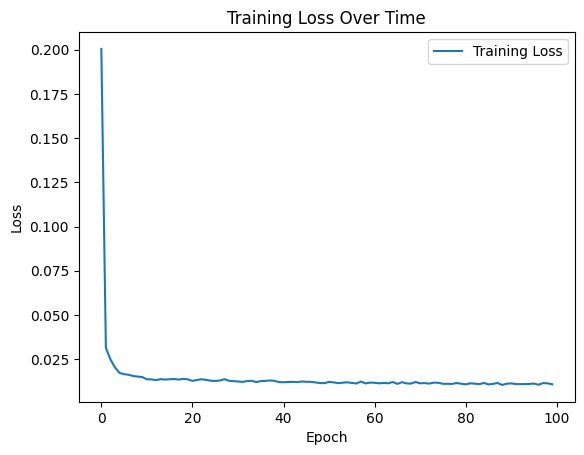

Task Train RMSE: 6.334015369415283, Train R2: 0.9998443859175512, Train MAE: 5.445367336273193
Task Test RMSE: 5.751938343048096, Test R2: 0.9998762058356068, Test MAE: 4.827002048492432
Task Train RMSE: 6.234114646911621, Train R2: 0.999847996694918, Train MAE: 5.264466762542725
Task Test RMSE: 6.173086166381836, Test R2: 0.999844638570712, Test MAE: 5.550604343414307
Task Train RMSE: 6.225558280944824, Train R2: 0.9998541626979215, Train MAE: 5.300326347351074
Task Test RMSE: 6.207569122314453, Test R2: 0.9998228213883428, Test MAE: 5.407196044921875
Task Train RMSE: 6.44921350479126, Train R2: 0.9998419023873452, Train MAE: 5.533529758453369
Task Test RMSE: 5.214835166931152, Test R2: 0.9998861147121556, Test MAE: 4.474362373352051
Task Train RMSE: 5.850654125213623, Train R2: 0.9998648744316708, Train MAE: 5.0647993087768555
Task Test RMSE: 7.526196002960205, Test R2: 0.9997991809028643, Test MAE: 6.349298000335693
Task Train RMSE: 6.337326526641846, Train R2: 0.9998519864045752, T

In [1]:
import torch
from torch import nn, optim
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split, KFold
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from skopt import gp_minimize
from skopt.space import Real, Integer
from skopt.utils import use_named_args
import matplotlib.pyplot as plt
import learn2learn as l2l
import numpy as np
import torch

np.random.seed(0)  # 设置NumPy的随机种子
torch.manual_seed(0)  # 设置PyTorch的随机种子

device = torch.device("cuda:0")  # Use GPU 0

# Hyperparameter search space
search_space = [
    Integer(500, 1500, name='hidden_size'), 
    Real(1e-11, 1e-6, "log-uniform", name='alpha'),  
    Real(1e-7, 1e-3, "log-uniform", name='beta'),
    Real(0.1, 0.8, name='dropout_rate'), 
    Real(1e-7, 1e-1, "log-uniform", name='weight_decay') 
]

# Data normalization and denormalization functions
def normalize_data(data):
    scaler = StandardScaler()
    return scaler.fit_transform(data), scaler

def normalize_feature(data, column_name):
    scaler = StandardScaler()
    scaled_data = scaler.fit_transform(data[[column_name]])
    return scaled_data, scaler

def denormalize_data(normalized_data, scaler):
    return scaler.inverse_transform(normalized_data)

# Advanced neural network architecture
class AdvancedNeuralNetwork(nn.Module):
    def __init__(self, input_size, hidden_size, dropout_rate):
        super(AdvancedNeuralNetwork, self).__init__()
        self.layer1 = nn.Linear(input_size, hidden_size)
        self.relu1 = nn.LeakyReLU()
        self.layer2 = nn.Linear(hidden_size, hidden_size // 2)
        self.relu2 = nn.LeakyReLU()
        self.layer3 = nn.Linear(hidden_size // 2, hidden_size // 4)
        self.relu3 = nn.LeakyReLU()
        self.dropout = nn.Dropout(dropout_rate)
        self.layer4 = nn.Linear(hidden_size // 4, 1)

    def forward(self, x):
        x = self.relu1(self.layer1(x))
        x = self.relu2(self.layer2(x))
        x = self.relu3(self.layer3(x))
        x = self.dropout(x)
        x = self.layer4(x)
        return x

# Task creation function
def create_tasks(data, target_column, num_tasks=50, task_size=100):
    tasks = []
    for _ in range(num_tasks):
        task_data = data.sample(task_size)
        X, y = task_data.drop(target_column, axis=1), task_data[target_column]
        tasks.append((X, y))
    return tasks

# Early stopping class
class EarlyStopping:
    def __init__(self, patience=5, delta=0):
        self.patience = patience
        self.counter = 0
        self.best_score = None
        self.early_stop = False
        self.delta = delta

    def __call__(self, val_loss, model):
        score = -val_loss
        if self.best_score is None:
            self.best_score = score
        elif score < self.best_score + self.delta:
            self.counter += 1
            if self.counter >= self.patience:
                self.early_stop = True
        else:
            self.best_score = score
            self.counter = 0

# MAML fast adaptation and meta-training
def meta_train_maml(model, tasks, alpha, beta, weight_decay, epochs=100, num_steps=1):
    early_stopping = EarlyStopping(patience=10, delta=0.01)
    optimizer = optim.Adam(model.parameters(), lr=beta, weight_decay=weight_decay)
    scheduler = optim.lr_scheduler.CosineAnnealingLR(optimizer, T_max=epochs)

    epoch_loss_list = []  # Initialize a list to store losses for each epoch

    for epoch in range(epochs):
        epoch_losses = []
        for task in tasks:
            learner = model.clone()  # Clone the model
            task_X, task_y = task
            task_X = torch.from_numpy(task_X.values).float().to(device)
            task_y = torch.from_numpy(task_y.values).float().to(device)

            # Fast adaptation
            for step in range(num_steps):
                pred_y = learner(task_X)
                loss = nn.functional.mse_loss(pred_y.squeeze(), task_y)
                learner.adapt(loss)

            # Meta-update
            optimizer.zero_grad()
            pred_y = learner(task_X)
            loss = nn.functional.mse_loss(pred_y.squeeze(), task_y)
            epoch_losses.append(loss.item())
            loss.backward()
            optimizer.step()

        scheduler.step()  # Update learning rate
        average_loss = np.mean(epoch_losses)
        epoch_loss_list.append(average_loss)  # Add each epoch's average loss to the list

        if early_stopping(average_loss, model):
            print(f"Early stopping triggered at epoch {epoch}")
            break

    return epoch_loss_list  # Return the list of epoch losses


@use_named_args(search_space)
def objective(hidden_size, alpha, beta, dropout_rate, weight_decay):
    model = AdvancedNeuralNetwork(input_size, hidden_size, dropout_rate)
    model = l2l.algorithms.MAML(model, lr=alpha).to(device)
    avg_r2 = 0

    task_r2_list = []  # 记录每个任务的 R2

    for task in tasks:
        task_X, task_y = task
        task_X_train, task_X_test, task_y_train, task_y_test = train_test_split(task_X, task_y, test_size=0.2, random_state=0)
        meta_train_maml(model, [(task_X_train, task_y_train)], alpha, beta, weight_decay, epochs=100)
        train_rmse, train_r2, train_mae, test_rmse, test_r2, test_mae = evaluate_model(model, task_X_train, task_y_train, task_X_test, task_y_test, target_scaler)
        task_r2_list.append(test_r2)  # 记录每个任务的测试 R2
        avg_r2 += test_r2

    avg_r2 /= len(tasks)
    return -avg_r2  # 这里返回负数因为 skopt 的目标函数是最小化，而我们想要最大化 R2




# Evaluation function
def evaluate_model(model, X_train, y_train, X_test, y_test, target_scaler):
    model.eval()
    with torch.no_grad():
        # Convert data to tensors
        X_train_tensor = torch.from_numpy(X_train.values).float().to(device)
        y_train_tensor = torch.from_numpy(y_train.values).float().to(device)
        X_test_tensor = torch.from_numpy(X_test.values).float().to(device)
        y_test_tensor = torch.from_numpy(y_test.values).float().to(device)

        # Get predictions
        train_predictions = model(X_train_tensor).squeeze().cpu().numpy()
        test_predictions = model(X_test_tensor).squeeze().cpu().numpy()

        # Reshape predictions for denormalization
        train_predictions_reshaped = train_predictions.reshape(-1, 1)
        test_predictions_reshaped = test_predictions.reshape(-1, 1)

        # Denormalize predictions using target_scaler
        train_predictions_denorm = denormalize_data(train_predictions_reshaped, target_scaler)
        test_predictions_denorm = denormalize_data(test_predictions_reshaped, target_scaler)

        # Denormalize actual values using target_scaler
        y_train_denorm = denormalize_data(y_train_tensor.cpu().numpy().reshape(-1, 1), target_scaler)
        y_test_denorm = denormalize_data(y_test_tensor.cpu().numpy().reshape(-1, 1), target_scaler)

        # Calculate metrics using denormalized data
        train_rmse = mean_squared_error(y_train_denorm, train_predictions_denorm, squared=False)
        train_r2 = r2_score(y_train_denorm, train_predictions_denorm)
        train_mae = mean_absolute_error(y_train_denorm, train_predictions_denorm)

        test_rmse = mean_squared_error(y_test_denorm, test_predictions_denorm, squared=False)
        test_r2 = r2_score(y_test_denorm, test_predictions_denorm)
        test_mae = mean_absolute_error(y_test_denorm, test_predictions_denorm)

    return train_rmse, train_r2, train_mae, test_rmse, test_r2, test_mae

# Load and normalize data
data = pd.read_csv("C:\\Users\\Lenovo\\Desktop\\元学习\\BT1-1.csv")
data_normalized, scaler = normalize_data(data)
target_normalized, target_scaler = normalize_feature(data, 'Biogas Production')
# Create tasks using the normalized dataset
input_size = data.shape[1] - 1 
tasks = create_tasks(pd.DataFrame(data_normalized, columns=data.columns), target_column='Biogas Production')

# Execute hyperparameter optimization
result = gp_minimize(objective, search_space, n_calls=15,random_state=0)
hidden_size, alpha, beta, dropout_rate, weight_decay = result.x
print("Best parameters:", result.x)

# Train model with optimized hyperparameters
model = AdvancedNeuralNetwork(input_size, hidden_size, dropout_rate)
model = l2l.algorithms.MAML(model, lr=alpha).to(device)
train_losses = meta_train_maml(model, tasks, alpha, beta, weight_decay, epochs=100)

# Visualize training losses
plt.plot(train_losses, label='Training Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training Loss Over Time')
plt.legend()
plt.show()

# Final model evaluation
for task in tasks:
    X, y = task
    kf = KFold(n_splits=5, shuffle=True, random_state=0)
    for train_index, test_index in kf.split(X):
        X_train, X_test = X.iloc[train_index], X.iloc[test_index]
        y_train, y_test = y.iloc[train_index], y.iloc[test_index]
        train_rmse, train_r2, train_mae, test_rmse, test_r2, test_mae = evaluate_model(model, X_train, y_train, X_test, y_test, target_scaler)
        print(f"Task Train RMSE: {train_rmse}, Train R2: {train_r2}, Train MAE: {train_mae}")
        print(f"Task Test RMSE: {test_rmse}, Test R2: {test_r2}, Test MAE: {test_mae}")


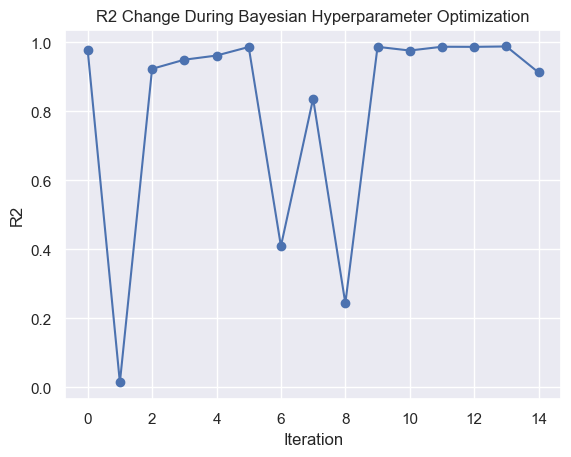

In [50]:
# 提取每次迭代的最佳 R2
best_r2_list = []
for res in result.func_vals:
    best_r2_list.append(-res)  # 注意要取负数

# 绘制 R2 的变化过程图
plt.plot(best_r2_list, marker='o')
plt.xlabel('Iteration')
plt.ylabel('R2')
plt.title('R2 Change During Bayesian Hyperparameter Optimization')
plt.show()

In [2]:
# Load and process external data for evaluation
external_data = pd.read_csv("C:\\Users\\Lenovo\\Desktop\\元学习\\BT1-2.csv")
external_data_normalized, _ = normalize_data(external_data)
external_target_normalized, _ = normalize_feature(external_data, 'Biogas Production')
external_X = torch.from_numpy(pd.DataFrame(external_data_normalized, columns=external_data.columns).drop('Biogas Production', axis=1).values).float().to(device)
external_y_normalized = torch.from_numpy(external_target_normalized).float().to(device)


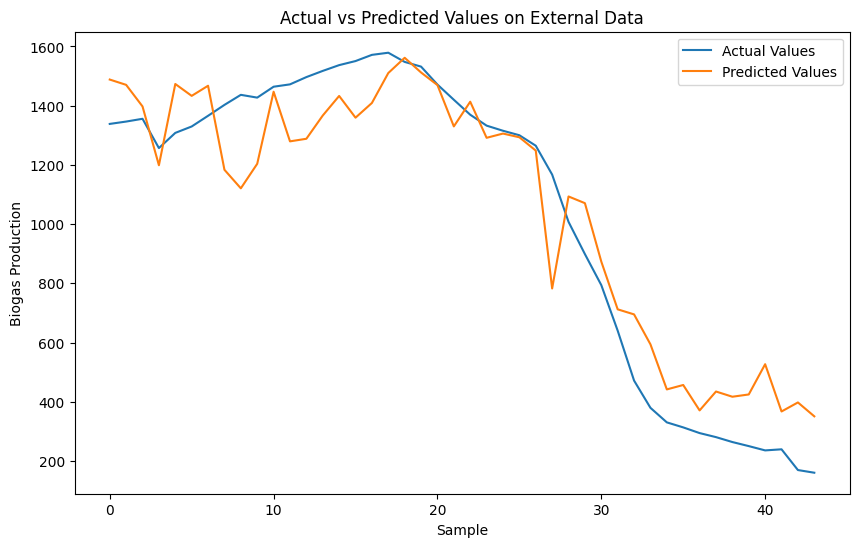

External Dataset - RMSE: 156.73165893554688, R2: 0.9047327518359923, MAE: 129.99925231933594


In [3]:

# Model prediction on external data
learner = model.clone()  # Clone the model for evaluation
learner.eval()
with torch.no_grad():
    external_predictions_normalized = learner(external_X).squeeze()
external_predictions = denormalize_data(external_predictions_normalized.cpu().numpy().reshape(-1, 1), target_scaler)
external_y = denormalize_data(external_y_normalized.cpu().numpy().reshape(-1, 1), target_scaler)

# Visualization of predictions on external data
plt.figure(figsize=(10, 6))
plt.plot(external_y, label='Actual Values')
plt.plot(external_predictions, label='Predicted Values')
plt.xlabel('Sample')
plt.ylabel('Biogas Production')
plt.title('Actual vs Predicted Values on External Data')
plt.legend()
plt.show()

# Evaluate on external dataset using denormalized data
external_rmse = mean_squared_error(external_y, external_predictions, squared=False)
external_r2 = r2_score(external_y, external_predictions)
external_mae = mean_absolute_error(external_y, external_predictions)

print(f"External Dataset - RMSE: {external_rmse}, R2: {external_r2}, MAE: {external_mae}")

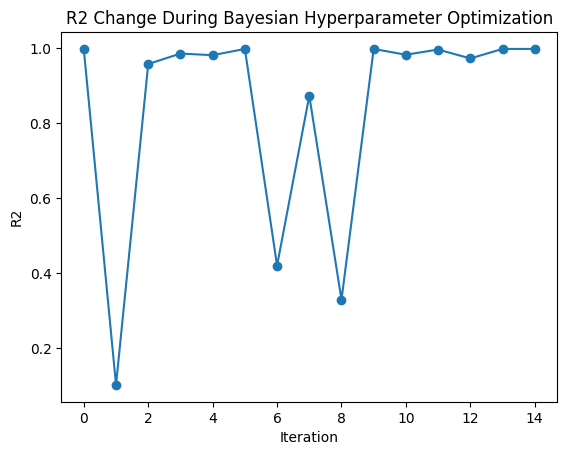

Original Dataset - RMSE: 6.250342733119575, R2: 0.999848491242489, MAE: 5.331817500673492
External Dataset - RMSE: 156.73165893554688, R2: 0.9047327518359923, MAE: 129.99925231933594


In [4]:
# 提取每次迭代的最佳 R2
best_r2_list = []
for res in result.func_vals:
    best_r2_list.append(-res)  # 注意要取负数

# 绘制 R2 的变化过程图
plt.plot(best_r2_list, marker='o')
plt.xlabel('Iteration')
plt.ylabel('R2')
plt.title('R2 Change During Bayesian Hyperparameter Optimization')
plt.show()

import torch
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from sklearn.model_selection import train_test_split

target_column = 'Biogas Production'

# 分离特征和目标变量
X = data.drop(target_column, axis=1)
y = data[target_column]
X_external = external_data.drop(target_column, axis=1)
y_external = external_data[target_column]

# 标准化数据
X_normalized, feature_scaler = normalize_data(X)
y_normalized, target_scaler = normalize_data(y.values.reshape(-1, 1))

# 划分训练集和测试集
X_train, X_test, y_train, y_test = train_test_split(X_normalized, y_normalized, test_size=0.2, random_state=0)

# 转换为 PyTorch 张量
X_train_tensor = torch.from_numpy(X_train).float().to(device)
X_test_tensor = torch.from_numpy(X_test).float().to(device)
y_train_tensor = torch.from_numpy(y_train).float().to(device)
y_test_tensor = torch.from_numpy(y_test).float().to(device)

# 标准化外部数据集
X_external_normalized, _ = normalize_data(X_external)
y_external_normalized, _ = normalize_data(y_external.values.reshape(-1, 1))

# 转换外部数据为张量
X_external_tensor = torch.from_numpy(X_external_normalized).float().to(device)
y_external_tensor = torch.from_numpy(y_external_normalized).float().to(device)

# 模型预测函数
def model_predict(model, X_tensor):
    model.eval()
    with torch.no_grad():
        return model(X_tensor).cpu().numpy()

# 获取预测值
y_pred_train = model_predict(model, X_train_tensor).flatten()
y_pred_test = model_predict(model, X_test_tensor).flatten()
y_pred_external = model_predict(model, X_external_tensor).flatten()

# 反标准化预测值和实际值
y_pred_train_denorm = denormalize_data(y_pred_train.reshape(-1, 1), target_scaler).flatten()
y_pred_test_denorm = denormalize_data(y_pred_test.reshape(-1, 1), target_scaler).flatten()
y_pred_external_denorm = denormalize_data(y_pred_external.reshape(-1, 1), target_scaler).flatten()
y_train_denorm = denormalize_data(y_train, target_scaler).flatten()
y_test_denorm = denormalize_data(y_test, target_scaler).flatten()
y_external_denorm = denormalize_data(y_external_tensor.cpu().numpy(), target_scaler).flatten()


# 合并原始数据集和外部数据集的预测值和实际值
original_data_actual = np.concatenate([y_train_denorm, y_test_denorm])
original_data_predicted = np.concatenate([y_pred_train_denorm, y_pred_test_denorm])
external_data_actual = y_external_denorm
external_data_predicted = y_pred_external_denorm

# 创建 DataFrame
combined_df = pd.DataFrame({
    'Actual': np.concatenate([original_data_actual, external_data_actual]),
    'Predicted': np.concatenate([original_data_predicted, external_data_predicted]),
    'Dataset': ['Original'] * len(original_data_actual) + ['External'] * len(external_data_actual)
})

# 计算原始数据集的指标
train_r2 = r2_score(original_data_actual, original_data_predicted)
train_rmse = mean_squared_error(original_data_actual, original_data_predicted, squared=False)
train_mae = mean_absolute_error(original_data_actual, original_data_predicted)

# 计算外部数据集的指标
external_r2 = r2_score(external_data_actual, external_data_predicted)
external_rmse = mean_squared_error(external_data_actual, external_data_predicted, squared=False)
external_mae = mean_absolute_error(external_data_actual, external_data_predicted)


print(f"Original Dataset - RMSE: {train_rmse}, R2: {train_r2}, MAE: {train_mae}")
print(f"External Dataset - RMSE: {external_rmse}, R2: {external_r2}, MAE: {external_mae}")

Best parameters: [500, 1e-06, 0.00041068245410224343, 0.1, 1e-07]


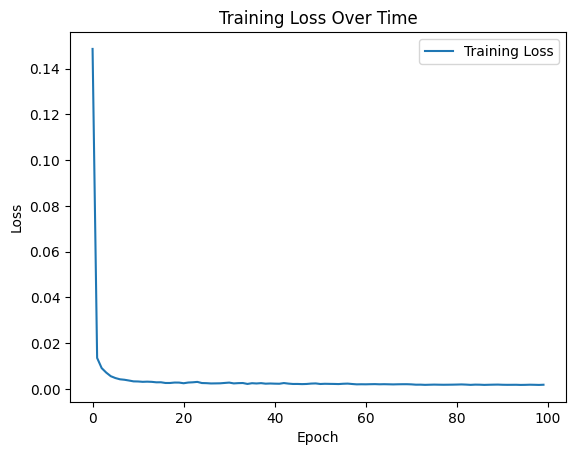

Task Train RMSE: 1.3987923860549927, Train R2: 0.9999934459968495, Train MAE: 1.1474075317382812
Task Test RMSE: 2.038952589035034, Test R2: 0.9999846597304085, Test MAE: 1.5304687023162842
Task Train RMSE: 1.5736854076385498, Train R2: 0.9999914227494365, Train MAE: 1.2223479747772217
Task Test RMSE: 1.441421627998352, Test R2: 0.999993331168451, Test MAE: 1.2307037115097046
Task Train RMSE: 1.633531093597412, Train R2: 0.9999912525701898, Train MAE: 1.2947807312011719
Task Test RMSE: 1.1445664167404175, Test R2: 0.9999944572736705, Test MAE: 0.9409759640693665
Task Train RMSE: 1.5814332962036133, Train R2: 0.9999914658538377, Train MAE: 1.237378716468811
Task Test RMSE: 1.4071190357208252, Test R2: 0.9999932329694863, Test MAE: 1.1705749034881592
Task Train RMSE: 1.5431363582611084, Train R2: 0.999991496468457, Train MAE: 1.2181838750839233
Task Test RMSE: 1.568019151687622, Test R2: 0.9999927052884028, Test MAE: 1.24737548828125
Task Train RMSE: 1.624915361404419, Train R2: 0.999989

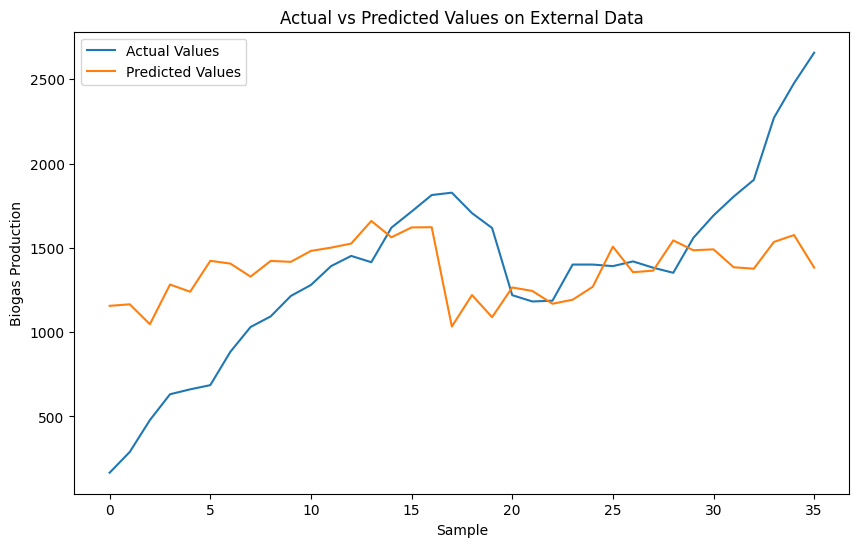

External Dataset - RMSE: 494.4248352050781, R2: 0.16722529421093502, MAE: 375.75042724609375


In [5]:
import torch
from torch import nn, optim
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split, KFold
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from skopt import gp_minimize
from skopt.space import Real, Integer
from skopt.utils import use_named_args
import matplotlib.pyplot as plt
import learn2learn as l2l
import numpy as np
import torch

np.random.seed(0)  # 设置NumPy的随机种子
torch.manual_seed(0)  # 设置PyTorch的随机种子

device = torch.device("cuda:0")  # Use GPU 0

# Hyperparameter search space
search_space = [
    Integer(500, 1500, name='hidden_size'), 
    Real(1e-11, 1e-6, "log-uniform", name='alpha'),  
    Real(1e-7, 1e-3, "log-uniform", name='beta'),
    Real(0.1, 0.8, name='dropout_rate'), 
    Real(1e-7, 1e-1, "log-uniform", name='weight_decay') 
]

# Data normalization and denormalization functions
def normalize_data(data):
    scaler = StandardScaler()
    return scaler.fit_transform(data), scaler

def normalize_feature(data, column_name):
    scaler = StandardScaler()
    scaled_data = scaler.fit_transform(data[[column_name]])
    return scaled_data, scaler

def denormalize_data(normalized_data, scaler):
    return scaler.inverse_transform(normalized_data)

# Advanced neural network architecture
class AdvancedNeuralNetwork(nn.Module):
    def __init__(self, input_size, hidden_size, dropout_rate):
        super(AdvancedNeuralNetwork, self).__init__()
        self.layer1 = nn.Linear(input_size, hidden_size)
        self.relu1 = nn.LeakyReLU()
        self.layer2 = nn.Linear(hidden_size, hidden_size // 2)
        self.relu2 = nn.LeakyReLU()
        self.layer3 = nn.Linear(hidden_size // 2, hidden_size // 4)
        self.relu3 = nn.LeakyReLU()
        self.dropout = nn.Dropout(dropout_rate)
        self.layer4 = nn.Linear(hidden_size // 4, 1)

    def forward(self, x):
        x = self.relu1(self.layer1(x))
        x = self.relu2(self.layer2(x))
        x = self.relu3(self.layer3(x))
        x = self.dropout(x)
        x = self.layer4(x)
        return x

# Task creation function
def create_tasks(data, target_column, num_tasks=50, task_size=100):
    tasks = []
    for _ in range(num_tasks):
        task_data = data.sample(task_size)
        X, y = task_data.drop(target_column, axis=1), task_data[target_column]
        tasks.append((X, y))
    return tasks

# Early stopping class
class EarlyStopping:
    def __init__(self, patience=5, delta=0):
        self.patience = patience
        self.counter = 0
        self.best_score = None
        self.early_stop = False
        self.delta = delta

    def __call__(self, val_loss, model):
        score = -val_loss
        if self.best_score is None:
            self.best_score = score
        elif score < self.best_score + self.delta:
            self.counter += 1
            if self.counter >= self.patience:
                self.early_stop = True
        else:
            self.best_score = score
            self.counter = 0

# MAML fast adaptation and meta-training
def meta_train_maml(model, tasks, alpha, beta, weight_decay, epochs=100, num_steps=1):
    early_stopping = EarlyStopping(patience=10, delta=0.01)
    optimizer = optim.Adam(model.parameters(), lr=beta, weight_decay=weight_decay)
    scheduler = optim.lr_scheduler.CosineAnnealingLR(optimizer, T_max=epochs)

    epoch_loss_list = []  # Initialize a list to store losses for each epoch

    for epoch in range(epochs):
        epoch_losses = []
        for task in tasks:
            learner = model.clone()  # Clone the model
            task_X, task_y = task
            task_X = torch.from_numpy(task_X.values).float().to(device)
            task_y = torch.from_numpy(task_y.values).float().to(device)

            # Fast adaptation
            for step in range(num_steps):
                pred_y = learner(task_X)
                loss = nn.functional.mse_loss(pred_y.squeeze(), task_y)
                learner.adapt(loss)

            # Meta-update
            optimizer.zero_grad()
            pred_y = learner(task_X)
            loss = nn.functional.mse_loss(pred_y.squeeze(), task_y)
            epoch_losses.append(loss.item())
            loss.backward()
            optimizer.step()

        scheduler.step()  # Update learning rate
        average_loss = np.mean(epoch_losses)
        epoch_loss_list.append(average_loss)  # Add each epoch's average loss to the list

        if early_stopping(average_loss, model):
            print(f"Early stopping triggered at epoch {epoch}")
            break

    return epoch_loss_list  # Return the list of epoch losses



@use_named_args(search_space)
def objective(hidden_size, alpha, beta, dropout_rate, weight_decay):
    model = AdvancedNeuralNetwork(input_size, hidden_size, dropout_rate)
    model = l2l.algorithms.MAML(model, lr=alpha).to(device)
    avg_r2 = 0

    task_r2_list = []  # 记录每个任务的 R2

    for task in tasks:
        task_X, task_y = task
        task_X_train, task_X_test, task_y_train, task_y_test = train_test_split(task_X, task_y, test_size=0.2, random_state=0)
        meta_train_maml(model, [(task_X_train, task_y_train)], alpha, beta, weight_decay, epochs=100)
        train_rmse, train_r2, train_mae, test_rmse, test_r2, test_mae = evaluate_model(model, task_X_train, task_y_train, task_X_test, task_y_test, target_scaler)
        task_r2_list.append(test_r2)  # 记录每个任务的测试 R2
        avg_r2 += test_r2

    avg_r2 /= len(tasks)
    return -avg_r2  # 这里返回负数因为 skopt 的目标函数是最小化，而我们想要最大化 R2

# Evaluation function
def evaluate_model(model, X_train, y_train, X_test, y_test, target_scaler):
    model.eval()
    with torch.no_grad():
        # Convert data to tensors
        X_train_tensor = torch.from_numpy(X_train.values).float().to(device)
        y_train_tensor = torch.from_numpy(y_train.values).float().to(device)
        X_test_tensor = torch.from_numpy(X_test.values).float().to(device)
        y_test_tensor = torch.from_numpy(y_test.values).float().to(device)

        # Get predictions
        train_predictions = model(X_train_tensor).squeeze().cpu().numpy()
        test_predictions = model(X_test_tensor).squeeze().cpu().numpy()

        # Reshape predictions for denormalization
        train_predictions_reshaped = train_predictions.reshape(-1, 1)
        test_predictions_reshaped = test_predictions.reshape(-1, 1)

        # Denormalize predictions using target_scaler
        train_predictions_denorm = denormalize_data(train_predictions_reshaped, target_scaler)
        test_predictions_denorm = denormalize_data(test_predictions_reshaped, target_scaler)

        # Denormalize actual values using target_scaler
        y_train_denorm = denormalize_data(y_train_tensor.cpu().numpy().reshape(-1, 1), target_scaler)
        y_test_denorm = denormalize_data(y_test_tensor.cpu().numpy().reshape(-1, 1), target_scaler)

        # Calculate metrics using denormalized data
        train_rmse = mean_squared_error(y_train_denorm, train_predictions_denorm, squared=False)
        train_r2 = r2_score(y_train_denorm, train_predictions_denorm)
        train_mae = mean_absolute_error(y_train_denorm, train_predictions_denorm)

        test_rmse = mean_squared_error(y_test_denorm, test_predictions_denorm, squared=False)
        test_r2 = r2_score(y_test_denorm, test_predictions_denorm)
        test_mae = mean_absolute_error(y_test_denorm, test_predictions_denorm)

    return train_rmse, train_r2, train_mae, test_rmse, test_r2, test_mae

# Load and normalize data
data = pd.read_csv("C:\\Users\\Lenovo\\Desktop\\元学习\\BT2-1.csv")
data_normalized, scaler = normalize_data(data)
target_normalized, target_scaler = normalize_feature(data, 'Biogas Production')
# Create tasks using the normalized dataset
input_size = data.shape[1] - 1 
tasks = create_tasks(pd.DataFrame(data_normalized, columns=data.columns), target_column='Biogas Production')

# Execute hyperparameter optimization
result = gp_minimize(objective, search_space, n_calls=15,random_state=0)
hidden_size, alpha, beta, dropout_rate, weight_decay = result.x
print("Best parameters:", result.x)

# Train model with optimized hyperparameters
model = AdvancedNeuralNetwork(input_size, hidden_size, dropout_rate)
model = l2l.algorithms.MAML(model, lr=alpha).to(device)
train_losses = meta_train_maml(model, tasks, alpha, beta, weight_decay, epochs=100)

# Visualize training losses
plt.plot(train_losses, label='Training Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training Loss Over Time')
plt.legend()
plt.show()

# Final model evaluation
for task in tasks:
    X, y = task
    kf = KFold(n_splits=5, shuffle=True, random_state=0)
    for train_index, test_index in kf.split(X):
        X_train, X_test = X.iloc[train_index], X.iloc[test_index]
        y_train, y_test = y.iloc[train_index], y.iloc[test_index]
        train_rmse, train_r2, train_mae, test_rmse, test_r2, test_mae = evaluate_model(model, X_train, y_train, X_test, y_test, target_scaler)
        print(f"Task Train RMSE: {train_rmse}, Train R2: {train_r2}, Train MAE: {train_mae}")
        print(f"Task Test RMSE: {test_rmse}, Test R2: {test_r2}, Test MAE: {test_mae}")


# Load and process external data for evaluation
external_data = pd.read_csv("C:\\Users\\Lenovo\\Desktop\\元学习\\BT2-2.csv")
external_data_normalized, _ = normalize_data(external_data)
external_target_normalized, _ = normalize_feature(external_data, 'Biogas Production')
external_X = torch.from_numpy(pd.DataFrame(external_data_normalized, columns=external_data.columns).drop('Biogas Production', axis=1).values).float().to(device)
external_y_normalized = torch.from_numpy(external_target_normalized).float().to(device)

# Model prediction on external data
learner = model.clone()  # Clone the model for evaluation
learner.eval()
with torch.no_grad():
    external_predictions_normalized = learner(external_X).squeeze()
external_predictions = denormalize_data(external_predictions_normalized.cpu().numpy().reshape(-1, 1), target_scaler)
external_y = denormalize_data(external_y_normalized.cpu().numpy().reshape(-1, 1), target_scaler)

# Visualization of predictions on external data
plt.figure(figsize=(10, 6))
plt.plot(external_y, label='Actual Values')
plt.plot(external_predictions, label='Predicted Values')
plt.xlabel('Sample')
plt.ylabel('Biogas Production')
plt.title('Actual vs Predicted Values on External Data')
plt.legend()
plt.show()

# Evaluate on external dataset using denormalized data
external_rmse = mean_squared_error(external_y, external_predictions, squared=False)
external_r2 = r2_score(external_y, external_predictions)
external_mae = mean_absolute_error(external_y, external_predictions)

print(f"External Dataset - RMSE: {external_rmse}, R2: {external_r2}, MAE: {external_mae}")

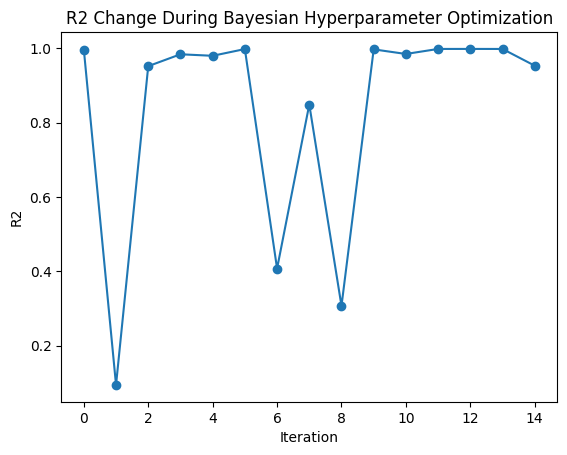

Original Dataset - RMSE: 1.5984581907611972, R2: 0.9999912957860263, MAE: 1.2600953329763085
External Dataset - RMSE: 494.4248352050781, R2: 0.16722529421093502, MAE: 375.75042724609375


In [6]:
# 提取每次迭代的最佳 R2
best_r2_list = []
for res in result.func_vals:
    best_r2_list.append(-res)  # 注意要取负数

# 绘制 R2 的变化过程图
plt.plot(best_r2_list, marker='o')
plt.xlabel('Iteration')
plt.ylabel('R2')
plt.title('R2 Change During Bayesian Hyperparameter Optimization')
plt.show()

import torch
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from sklearn.model_selection import train_test_split

target_column = 'Biogas Production'

# 分离特征和目标变量
X = data.drop(target_column, axis=1)
y = data[target_column]
X_external = external_data.drop(target_column, axis=1)
y_external = external_data[target_column]

# 标准化数据
X_normalized, feature_scaler = normalize_data(X)
y_normalized, target_scaler = normalize_data(y.values.reshape(-1, 1))

# 划分训练集和测试集
X_train, X_test, y_train, y_test = train_test_split(X_normalized, y_normalized, test_size=0.2, random_state=0)

# 转换为 PyTorch 张量
X_train_tensor = torch.from_numpy(X_train).float().to(device)
X_test_tensor = torch.from_numpy(X_test).float().to(device)
y_train_tensor = torch.from_numpy(y_train).float().to(device)
y_test_tensor = torch.from_numpy(y_test).float().to(device)

# 标准化外部数据集
X_external_normalized, _ = normalize_data(X_external)
y_external_normalized, _ = normalize_data(y_external.values.reshape(-1, 1))

# 转换外部数据为张量
X_external_tensor = torch.from_numpy(X_external_normalized).float().to(device)
y_external_tensor = torch.from_numpy(y_external_normalized).float().to(device)

# 模型预测函数
def model_predict(model, X_tensor):
    model.eval()
    with torch.no_grad():
        return model(X_tensor).cpu().numpy()

# 获取预测值
y_pred_train = model_predict(model, X_train_tensor).flatten()
y_pred_test = model_predict(model, X_test_tensor).flatten()
y_pred_external = model_predict(model, X_external_tensor).flatten()

# 反标准化预测值和实际值
y_pred_train_denorm = denormalize_data(y_pred_train.reshape(-1, 1), target_scaler).flatten()
y_pred_test_denorm = denormalize_data(y_pred_test.reshape(-1, 1), target_scaler).flatten()
y_pred_external_denorm = denormalize_data(y_pred_external.reshape(-1, 1), target_scaler).flatten()
y_train_denorm = denormalize_data(y_train, target_scaler).flatten()
y_test_denorm = denormalize_data(y_test, target_scaler).flatten()
y_external_denorm = denormalize_data(y_external_tensor.cpu().numpy(), target_scaler).flatten()


# 合并原始数据集和外部数据集的预测值和实际值
original_data_actual = np.concatenate([y_train_denorm, y_test_denorm])
original_data_predicted = np.concatenate([y_pred_train_denorm, y_pred_test_denorm])
external_data_actual = y_external_denorm
external_data_predicted = y_pred_external_denorm

# 创建 DataFrame
combined_df = pd.DataFrame({
    'Actual': np.concatenate([original_data_actual, external_data_actual]),
    'Predicted': np.concatenate([original_data_predicted, external_data_predicted]),
    'Dataset': ['Original'] * len(original_data_actual) + ['External'] * len(external_data_actual)
})

# 计算原始数据集的指标
train_r2 = r2_score(original_data_actual, original_data_predicted)
train_rmse = mean_squared_error(original_data_actual, original_data_predicted, squared=False)
train_mae = mean_absolute_error(original_data_actual, original_data_predicted)

# 计算外部数据集的指标
external_r2 = r2_score(external_data_actual, external_data_predicted)
external_rmse = mean_squared_error(external_data_actual, external_data_predicted, squared=False)
external_mae = mean_absolute_error(external_data_actual, external_data_predicted)


print(f"Original Dataset - RMSE: {train_rmse}, R2: {train_r2}, MAE: {train_mae}")
print(f"External Dataset - RMSE: {external_rmse}, R2: {external_r2}, MAE: {external_mae}")

Best parameters: [500, 1e-06, 0.001, 0.8, 1e-07]


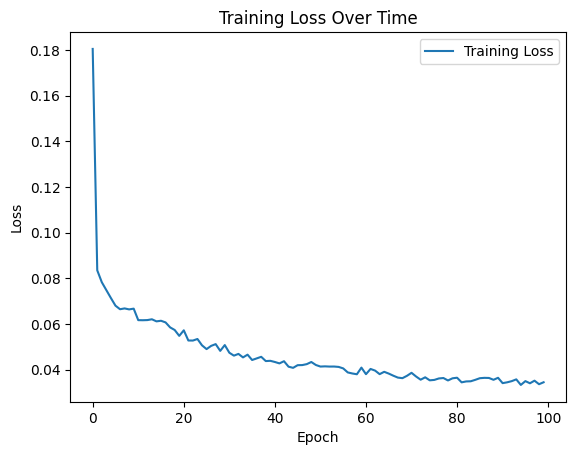

Task Train RMSE: 23.896059036254883, Train R2: 0.9986324499807382, Train MAE: 21.164064407348633
Task Test RMSE: 27.156095504760742, Test R2: 0.9983787950330206, Test MAE: 25.339046478271484
Task Train RMSE: 23.89792251586914, Train R2: 0.9986297851119077, Train MAE: 21.569072723388672
Task Test RMSE: 27.149539947509766, Test R2: 0.9984432773170062, Test MAE: 23.718997955322266
Task Train RMSE: 24.525775909423828, Train R2: 0.9985963464373304, Train MAE: 21.910751342773438
Task Test RMSE: 24.808961868286133, Test R2: 0.9985322492548775, Test MAE: 22.35227394104004
Task Train RMSE: 24.76561737060547, Train R2: 0.9985644857330034, Train MAE: 21.88381004333496
Task Test RMSE: 23.83690071105957, Test R2: 0.998673008636303, Test MAE: 22.460079193115234
Task Train RMSE: 25.779037475585938, Train R2: 0.9985208102764207, Train MAE: 23.467601776123047
Task Test RMSE: 19.060596466064453, Test R2: 0.9988799957847103, Test MAE: 16.124902725219727
Task Train RMSE: 25.7027530670166, Train R2: 0.9985

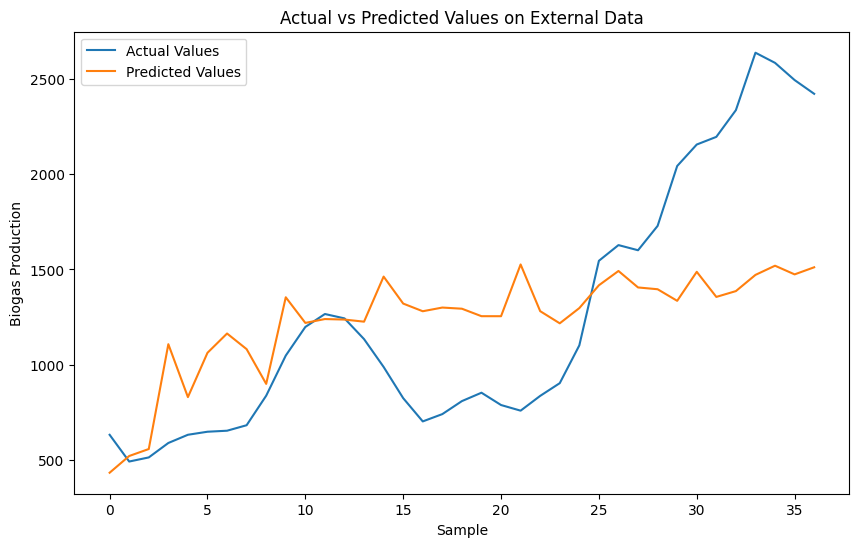

External Dataset - RMSE: 540.5690307617188, R2: 0.3348532291966416, MAE: 435.993408203125


In [7]:
import torch
from torch import nn, optim
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split, KFold
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from skopt import gp_minimize
from skopt.space import Real, Integer
from skopt.utils import use_named_args
import matplotlib.pyplot as plt
import learn2learn as l2l
import numpy as np
import torch

np.random.seed(0)  # 设置NumPy的随机种子
torch.manual_seed(0)  # 设置PyTorch的随机种子

device = torch.device("cuda:0")  # Use GPU 0

# Hyperparameter search space
search_space = [
    Integer(500, 1500, name='hidden_size'), 
    Real(1e-11, 1e-6, "log-uniform", name='alpha'),  
    Real(1e-7, 1e-3, "log-uniform", name='beta'),
    Real(0.1, 0.8, name='dropout_rate'), 
    Real(1e-7, 1e-1, "log-uniform", name='weight_decay') 
]

# Data normalization and denormalization functions
def normalize_data(data):
    scaler = StandardScaler()
    return scaler.fit_transform(data), scaler

def normalize_feature(data, column_name):
    scaler = StandardScaler()
    scaled_data = scaler.fit_transform(data[[column_name]])
    return scaled_data, scaler

def denormalize_data(normalized_data, scaler):
    return scaler.inverse_transform(normalized_data)

# Advanced neural network architecture
class AdvancedNeuralNetwork(nn.Module):
    def __init__(self, input_size, hidden_size, dropout_rate):
        super(AdvancedNeuralNetwork, self).__init__()
        self.layer1 = nn.Linear(input_size, hidden_size)
        self.relu1 = nn.LeakyReLU()
        self.layer2 = nn.Linear(hidden_size, hidden_size // 2)
        self.relu2 = nn.LeakyReLU()
        self.layer3 = nn.Linear(hidden_size // 2, hidden_size // 4)
        self.relu3 = nn.LeakyReLU()
        self.dropout = nn.Dropout(dropout_rate)
        self.layer4 = nn.Linear(hidden_size // 4, 1)

    def forward(self, x):
        x = self.relu1(self.layer1(x))
        x = self.relu2(self.layer2(x))
        x = self.relu3(self.layer3(x))
        x = self.dropout(x)
        x = self.layer4(x)
        return x

# Task creation function
def create_tasks(data, target_column, num_tasks=50, task_size=100):
    tasks = []
    for _ in range(num_tasks):
        task_data = data.sample(task_size)
        X, y = task_data.drop(target_column, axis=1), task_data[target_column]
        tasks.append((X, y))
    return tasks

# Early stopping class
class EarlyStopping:
    def __init__(self, patience=5, delta=0):
        self.patience = patience
        self.counter = 0
        self.best_score = None
        self.early_stop = False
        self.delta = delta

    def __call__(self, val_loss, model):
        score = -val_loss
        if self.best_score is None:
            self.best_score = score
        elif score < self.best_score + self.delta:
            self.counter += 1
            if self.counter >= self.patience:
                self.early_stop = True
        else:
            self.best_score = score
            self.counter = 0

# MAML fast adaptation and meta-training
def meta_train_maml(model, tasks, alpha, beta, weight_decay, epochs=100, num_steps=1):
    early_stopping = EarlyStopping(patience=10, delta=0.01)
    optimizer = optim.Adam(model.parameters(), lr=beta, weight_decay=weight_decay)
    scheduler = optim.lr_scheduler.CosineAnnealingLR(optimizer, T_max=epochs)

    epoch_loss_list = []  # Initialize a list to store losses for each epoch

    for epoch in range(epochs):
        epoch_losses = []
        for task in tasks:
            learner = model.clone()  # Clone the model
            task_X, task_y = task
            task_X = torch.from_numpy(task_X.values).float().to(device)
            task_y = torch.from_numpy(task_y.values).float().to(device)

            # Fast adaptation
            for step in range(num_steps):
                pred_y = learner(task_X)
                loss = nn.functional.mse_loss(pred_y.squeeze(), task_y)
                learner.adapt(loss)

            # Meta-update
            optimizer.zero_grad()
            pred_y = learner(task_X)
            loss = nn.functional.mse_loss(pred_y.squeeze(), task_y)
            epoch_losses.append(loss.item())
            loss.backward()
            optimizer.step()

        scheduler.step()  # Update learning rate
        average_loss = np.mean(epoch_losses)
        epoch_loss_list.append(average_loss)  # Add each epoch's average loss to the list

        if early_stopping(average_loss, model):
            print(f"Early stopping triggered at epoch {epoch}")
            break

    return epoch_loss_list  # Return the list of epoch losses



@use_named_args(search_space)
def objective(hidden_size, alpha, beta, dropout_rate, weight_decay):
    model = AdvancedNeuralNetwork(input_size, hidden_size, dropout_rate)
    model = l2l.algorithms.MAML(model, lr=alpha).to(device)
    avg_r2 = 0

    task_r2_list = []  # 记录每个任务的 R2

    for task in tasks:
        task_X, task_y = task
        task_X_train, task_X_test, task_y_train, task_y_test = train_test_split(task_X, task_y, test_size=0.2, random_state=0)
        meta_train_maml(model, [(task_X_train, task_y_train)], alpha, beta, weight_decay, epochs=100)
        train_rmse, train_r2, train_mae, test_rmse, test_r2, test_mae = evaluate_model(model, task_X_train, task_y_train, task_X_test, task_y_test, target_scaler)
        task_r2_list.append(test_r2)  # 记录每个任务的测试 R2
        avg_r2 += test_r2

    avg_r2 /= len(tasks)
    return -avg_r2  # 这里返回负数因为 skopt 的目标函数是最小化，而我们想要最大化 R2


# Evaluation function
def evaluate_model(model, X_train, y_train, X_test, y_test, target_scaler):
    model.eval()
    with torch.no_grad():
        # Convert data to tensors
        X_train_tensor = torch.from_numpy(X_train.values).float().to(device)
        y_train_tensor = torch.from_numpy(y_train.values).float().to(device)
        X_test_tensor = torch.from_numpy(X_test.values).float().to(device)
        y_test_tensor = torch.from_numpy(y_test.values).float().to(device)

        # Get predictions
        train_predictions = model(X_train_tensor).squeeze().cpu().numpy()
        test_predictions = model(X_test_tensor).squeeze().cpu().numpy()

        # Reshape predictions for denormalization
        train_predictions_reshaped = train_predictions.reshape(-1, 1)
        test_predictions_reshaped = test_predictions.reshape(-1, 1)

        # Denormalize predictions using target_scaler
        train_predictions_denorm = denormalize_data(train_predictions_reshaped, target_scaler)
        test_predictions_denorm = denormalize_data(test_predictions_reshaped, target_scaler)

        # Denormalize actual values using target_scaler
        y_train_denorm = denormalize_data(y_train_tensor.cpu().numpy().reshape(-1, 1), target_scaler)
        y_test_denorm = denormalize_data(y_test_tensor.cpu().numpy().reshape(-1, 1), target_scaler)

        # Calculate metrics using denormalized data
        train_rmse = mean_squared_error(y_train_denorm, train_predictions_denorm, squared=False)
        train_r2 = r2_score(y_train_denorm, train_predictions_denorm)
        train_mae = mean_absolute_error(y_train_denorm, train_predictions_denorm)

        test_rmse = mean_squared_error(y_test_denorm, test_predictions_denorm, squared=False)
        test_r2 = r2_score(y_test_denorm, test_predictions_denorm)
        test_mae = mean_absolute_error(y_test_denorm, test_predictions_denorm)

    return train_rmse, train_r2, train_mae, test_rmse, test_r2, test_mae

# Load and normalize data
data = pd.read_csv("C:\\Users\\Lenovo\\Desktop\\元学习\\BT3-1.csv")
data_normalized, scaler = normalize_data(data)
target_normalized, target_scaler = normalize_feature(data, 'Biogas Production')
# Create tasks using the normalized dataset
input_size = data.shape[1] - 1 
tasks = create_tasks(pd.DataFrame(data_normalized, columns=data.columns), target_column='Biogas Production')

# Execute hyperparameter optimization
result = gp_minimize(objective, search_space, n_calls=15,random_state=0)
hidden_size, alpha, beta, dropout_rate, weight_decay = result.x
print("Best parameters:", result.x)

# Train model with optimized hyperparameters
model = AdvancedNeuralNetwork(input_size, hidden_size, dropout_rate)
model = l2l.algorithms.MAML(model, lr=alpha).to(device)
train_losses = meta_train_maml(model, tasks, alpha, beta, weight_decay, epochs=100)

# Visualize training losses
plt.plot(train_losses, label='Training Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training Loss Over Time')
plt.legend()
plt.show()

# Final model evaluation
for task in tasks:
    X, y = task
    kf = KFold(n_splits=5, shuffle=True, random_state=0)
    for train_index, test_index in kf.split(X):
        X_train, X_test = X.iloc[train_index], X.iloc[test_index]
        y_train, y_test = y.iloc[train_index], y.iloc[test_index]
        train_rmse, train_r2, train_mae, test_rmse, test_r2, test_mae = evaluate_model(model, X_train, y_train, X_test, y_test, target_scaler)
        print(f"Task Train RMSE: {train_rmse}, Train R2: {train_r2}, Train MAE: {train_mae}")
        print(f"Task Test RMSE: {test_rmse}, Test R2: {test_r2}, Test MAE: {test_mae}")


# Load and process external data for evaluation
external_data = pd.read_csv("C:\\Users\\Lenovo\\Desktop\\元学习\\BT3-2.csv")
external_data_normalized, _ = normalize_data(external_data)
external_target_normalized, _ = normalize_feature(external_data, 'Biogas Production')
external_X = torch.from_numpy(pd.DataFrame(external_data_normalized, columns=external_data.columns).drop('Biogas Production', axis=1).values).float().to(device)
external_y_normalized = torch.from_numpy(external_target_normalized).float().to(device)

# Model prediction on external data
learner = model.clone()  # Clone the model for evaluation
learner.eval()
with torch.no_grad():
    external_predictions_normalized = learner(external_X).squeeze()
external_predictions = denormalize_data(external_predictions_normalized.cpu().numpy().reshape(-1, 1), target_scaler)
external_y = denormalize_data(external_y_normalized.cpu().numpy().reshape(-1, 1), target_scaler)

# Visualization of predictions on external data
plt.figure(figsize=(10, 6))
plt.plot(external_y, label='Actual Values')
plt.plot(external_predictions, label='Predicted Values')
plt.xlabel('Sample')
plt.ylabel('Biogas Production')
plt.title('Actual vs Predicted Values on External Data')
plt.legend()
plt.show()

# Evaluate on external dataset using denormalized data
external_rmse = mean_squared_error(external_y, external_predictions, squared=False)
external_r2 = r2_score(external_y, external_predictions)
external_mae = mean_absolute_error(external_y, external_predictions)

print(f"External Dataset - RMSE: {external_rmse}, R2: {external_r2}, MAE: {external_mae}")

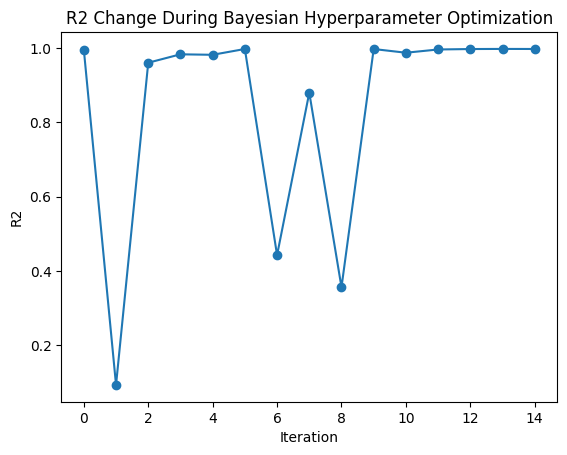

Original Dataset - RMSE: 24.976337686523234, R2: 0.9985800513109276, MAE: 22.341229039634154
External Dataset - RMSE: 540.5690307617188, R2: 0.3348532291966416, MAE: 435.993408203125


In [8]:
# 提取每次迭代的最佳 R2
best_r2_list = []
for res in result.func_vals:
    best_r2_list.append(-res)  # 注意要取负数

# 绘制 R2 的变化过程图
plt.plot(best_r2_list, marker='o')
plt.xlabel('Iteration')
plt.ylabel('R2')
plt.title('R2 Change During Bayesian Hyperparameter Optimization')
plt.show()

import torch
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from sklearn.model_selection import train_test_split

target_column = 'Biogas Production'

# 分离特征和目标变量
X = data.drop(target_column, axis=1)
y = data[target_column]
X_external = external_data.drop(target_column, axis=1)
y_external = external_data[target_column]

# 标准化数据
X_normalized, feature_scaler = normalize_data(X)
y_normalized, target_scaler = normalize_data(y.values.reshape(-1, 1))

# 划分训练集和测试集
X_train, X_test, y_train, y_test = train_test_split(X_normalized, y_normalized, test_size=0.2, random_state=0)

# 转换为 PyTorch 张量
X_train_tensor = torch.from_numpy(X_train).float().to(device)
X_test_tensor = torch.from_numpy(X_test).float().to(device)
y_train_tensor = torch.from_numpy(y_train).float().to(device)
y_test_tensor = torch.from_numpy(y_test).float().to(device)

# 标准化外部数据集
X_external_normalized, _ = normalize_data(X_external)
y_external_normalized, _ = normalize_data(y_external.values.reshape(-1, 1))

# 转换外部数据为张量
X_external_tensor = torch.from_numpy(X_external_normalized).float().to(device)
y_external_tensor = torch.from_numpy(y_external_normalized).float().to(device)

# 模型预测函数
def model_predict(model, X_tensor):
    model.eval()
    with torch.no_grad():
        return model(X_tensor).cpu().numpy()

# 获取预测值
y_pred_train = model_predict(model, X_train_tensor).flatten()
y_pred_test = model_predict(model, X_test_tensor).flatten()
y_pred_external = model_predict(model, X_external_tensor).flatten()

# 反标准化预测值和实际值
y_pred_train_denorm = denormalize_data(y_pred_train.reshape(-1, 1), target_scaler).flatten()
y_pred_test_denorm = denormalize_data(y_pred_test.reshape(-1, 1), target_scaler).flatten()
y_pred_external_denorm = denormalize_data(y_pred_external.reshape(-1, 1), target_scaler).flatten()
y_train_denorm = denormalize_data(y_train, target_scaler).flatten()
y_test_denorm = denormalize_data(y_test, target_scaler).flatten()
y_external_denorm = denormalize_data(y_external_tensor.cpu().numpy(), target_scaler).flatten()


# 合并原始数据集和外部数据集的预测值和实际值
original_data_actual = np.concatenate([y_train_denorm, y_test_denorm])
original_data_predicted = np.concatenate([y_pred_train_denorm, y_pred_test_denorm])
external_data_actual = y_external_denorm
external_data_predicted = y_pred_external_denorm

# 创建 DataFrame
combined_df = pd.DataFrame({
    'Actual': np.concatenate([original_data_actual, external_data_actual]),
    'Predicted': np.concatenate([original_data_predicted, external_data_predicted]),
    'Dataset': ['Original'] * len(original_data_actual) + ['External'] * len(external_data_actual)
})

# 计算原始数据集的指标
train_r2 = r2_score(original_data_actual, original_data_predicted)
train_rmse = mean_squared_error(original_data_actual, original_data_predicted, squared=False)
train_mae = mean_absolute_error(original_data_actual, original_data_predicted)

# 计算外部数据集的指标
external_r2 = r2_score(external_data_actual, external_data_predicted)
external_rmse = mean_squared_error(external_data_actual, external_data_predicted, squared=False)
external_mae = mean_absolute_error(external_data_actual, external_data_predicted)


print(f"Original Dataset - RMSE: {train_rmse}, R2: {train_r2}, MAE: {train_mae}")
print(f"External Dataset - RMSE: {external_rmse}, R2: {external_r2}, MAE: {external_mae}")

Best parameters: [1082, 4.8625731451155695e-09, 0.00010825862263250658, 0.1741353250314545, 6.943884941608576e-05]


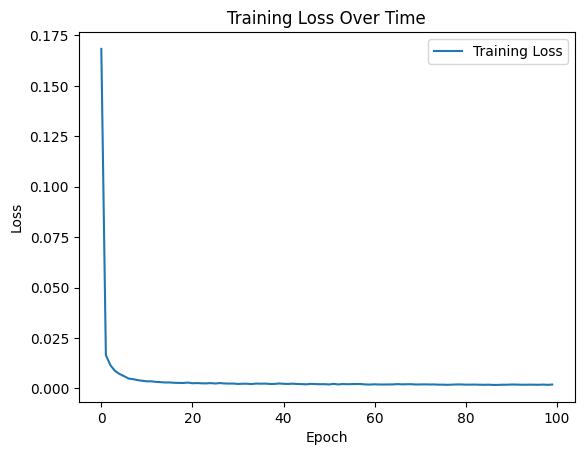

Task Train RMSE: 1.7837178707122803, Train R2: 0.999991291037367, Train MAE: 1.3270397186279297
Task Test RMSE: 3.468249559402466, Test R2: 0.9999667917309367, Test MAE: 2.249350070953369
Task Train RMSE: 2.3611156940460205, Train R2: 0.9999845114753435, Train MAE: 1.5754387378692627
Task Test RMSE: 1.5672082901000977, Test R2: 0.9999940360956018, Test MAE: 1.255763292312622
Task Train RMSE: 2.3307275772094727, Train R2: 0.9999850652315825, Train MAE: 1.5609798431396484
Task Test RMSE: 1.739668846130371, Test R2: 0.9999921055849911, Test MAE: 1.3135970830917358
Task Train RMSE: 2.2507333755493164, Train R2: 0.9999863260044038, Train MAE: 1.5136692523956299
Task Test RMSE: 2.1195242404937744, Test R2: 0.9999878632401509, Test MAE: 1.5028274059295654
Task Train RMSE: 2.3454232215881348, Train R2: 0.9999859036629278, Train MAE: 1.5803935527801514
Task Test RMSE: 1.6587921380996704, Test R2: 0.9999902193501241, Test MAE: 1.235957384109497
Task Train RMSE: 1.9454010725021362, Train R2: 0.99

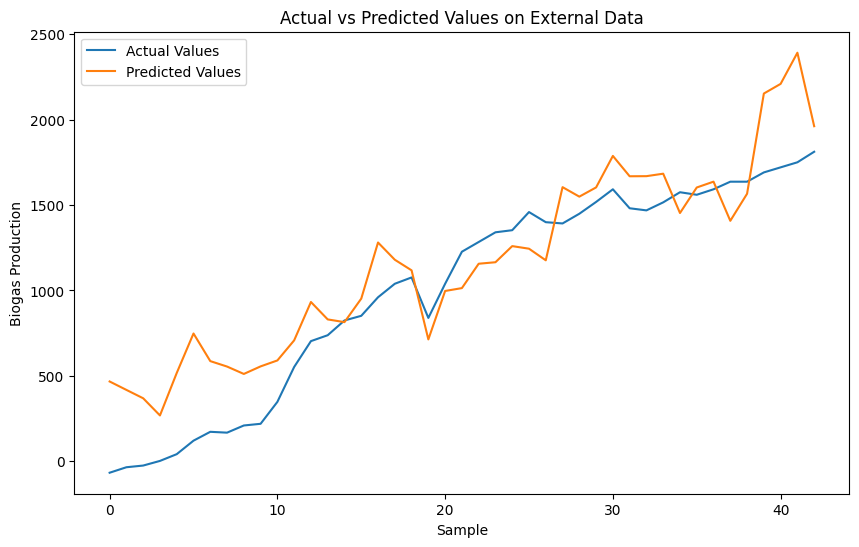

External Dataset - RMSE: 286.0028991699219, R2: 0.7785104623584754, MAE: 235.59483337402344


In [9]:
import torch
from torch import nn, optim
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split, KFold
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from skopt import gp_minimize
from skopt.space import Real, Integer
from skopt.utils import use_named_args
import matplotlib.pyplot as plt
import learn2learn as l2l
import numpy as np
import torch

np.random.seed(0)  # 设置NumPy的随机种子
torch.manual_seed(0)  # 设置PyTorch的随机种子

device = torch.device("cuda:0")  # Use GPU 0

# Hyperparameter search space
search_space = [
    Integer(500, 1500, name='hidden_size'), 
    Real(1e-11, 1e-6, "log-uniform", name='alpha'),  
    Real(1e-7, 1e-3, "log-uniform", name='beta'),
    Real(0.1, 0.8, name='dropout_rate'), 
    Real(1e-7, 1e-1, "log-uniform", name='weight_decay') 
]

# Data normalization and denormalization functions
def normalize_data(data):
    scaler = StandardScaler()
    return scaler.fit_transform(data), scaler

def normalize_feature(data, column_name):
    scaler = StandardScaler()
    scaled_data = scaler.fit_transform(data[[column_name]])
    return scaled_data, scaler

def denormalize_data(normalized_data, scaler):
    return scaler.inverse_transform(normalized_data)

# Advanced neural network architecture
class AdvancedNeuralNetwork(nn.Module):
    def __init__(self, input_size, hidden_size, dropout_rate):
        super(AdvancedNeuralNetwork, self).__init__()
        self.layer1 = nn.Linear(input_size, hidden_size)
        self.relu1 = nn.LeakyReLU()
        self.layer2 = nn.Linear(hidden_size, hidden_size // 2)
        self.relu2 = nn.LeakyReLU()
        self.layer3 = nn.Linear(hidden_size // 2, hidden_size // 4)
        self.relu3 = nn.LeakyReLU()
        self.dropout = nn.Dropout(dropout_rate)
        self.layer4 = nn.Linear(hidden_size // 4, 1)

    def forward(self, x):
        x = self.relu1(self.layer1(x))
        x = self.relu2(self.layer2(x))
        x = self.relu3(self.layer3(x))
        x = self.dropout(x)
        x = self.layer4(x)
        return x

# Task creation function
def create_tasks(data, target_column, num_tasks=50, task_size=100):
    tasks = []
    for _ in range(num_tasks):
        task_data = data.sample(task_size)
        X, y = task_data.drop(target_column, axis=1), task_data[target_column]
        tasks.append((X, y))
    return tasks

# Early stopping class
class EarlyStopping:
    def __init__(self, patience=5, delta=0):
        self.patience = patience
        self.counter = 0
        self.best_score = None
        self.early_stop = False
        self.delta = delta

    def __call__(self, val_loss, model):
        score = -val_loss
        if self.best_score is None:
            self.best_score = score
        elif score < self.best_score + self.delta:
            self.counter += 1
            if self.counter >= self.patience:
                self.early_stop = True
        else:
            self.best_score = score
            self.counter = 0

# MAML fast adaptation and meta-training
def meta_train_maml(model, tasks, alpha, beta, weight_decay, epochs=100, num_steps=1):
    early_stopping = EarlyStopping(patience=10, delta=0.01)
    optimizer = optim.Adam(model.parameters(), lr=beta, weight_decay=weight_decay)
    scheduler = optim.lr_scheduler.CosineAnnealingLR(optimizer, T_max=epochs)

    epoch_loss_list = []  # Initialize a list to store losses for each epoch

    for epoch in range(epochs):
        epoch_losses = []
        for task in tasks:
            learner = model.clone()  # Clone the model
            task_X, task_y = task
            task_X = torch.from_numpy(task_X.values).float().to(device)
            task_y = torch.from_numpy(task_y.values).float().to(device)

            # Fast adaptation
            for step in range(num_steps):
                pred_y = learner(task_X)
                loss = nn.functional.mse_loss(pred_y.squeeze(), task_y)
                learner.adapt(loss)

            # Meta-update
            optimizer.zero_grad()
            pred_y = learner(task_X)
            loss = nn.functional.mse_loss(pred_y.squeeze(), task_y)
            epoch_losses.append(loss.item())
            loss.backward()
            optimizer.step()

        scheduler.step()  # Update learning rate
        average_loss = np.mean(epoch_losses)
        epoch_loss_list.append(average_loss)  # Add each epoch's average loss to the list

        if early_stopping(average_loss, model):
            print(f"Early stopping triggered at epoch {epoch}")
            break

    return epoch_loss_list  # Return the list of epoch losses



@use_named_args(search_space)
def objective(hidden_size, alpha, beta, dropout_rate, weight_decay):
    model = AdvancedNeuralNetwork(input_size, hidden_size, dropout_rate)
    model = l2l.algorithms.MAML(model, lr=alpha).to(device)
    avg_r2 = 0

    task_r2_list = []  # 记录每个任务的 R2

    for task in tasks:
        task_X, task_y = task
        task_X_train, task_X_test, task_y_train, task_y_test = train_test_split(task_X, task_y, test_size=0.2, random_state=0)
        meta_train_maml(model, [(task_X_train, task_y_train)], alpha, beta, weight_decay, epochs=100)
        train_rmse, train_r2, train_mae, test_rmse, test_r2, test_mae = evaluate_model(model, task_X_train, task_y_train, task_X_test, task_y_test, target_scaler)
        task_r2_list.append(test_r2)  # 记录每个任务的测试 R2
        avg_r2 += test_r2

    avg_r2 /= len(tasks)
    return -avg_r2  # 这里返回负数因为 skopt 的目标函数是最小化，而我们想要最大化 R2


# Evaluation function
def evaluate_model(model, X_train, y_train, X_test, y_test, target_scaler):
    model.eval()
    with torch.no_grad():
        # Convert data to tensors
        X_train_tensor = torch.from_numpy(X_train.values).float().to(device)
        y_train_tensor = torch.from_numpy(y_train.values).float().to(device)
        X_test_tensor = torch.from_numpy(X_test.values).float().to(device)
        y_test_tensor = torch.from_numpy(y_test.values).float().to(device)

        # Get predictions
        train_predictions = model(X_train_tensor).squeeze().cpu().numpy()
        test_predictions = model(X_test_tensor).squeeze().cpu().numpy()

        # Reshape predictions for denormalization
        train_predictions_reshaped = train_predictions.reshape(-1, 1)
        test_predictions_reshaped = test_predictions.reshape(-1, 1)

        # Denormalize predictions using target_scaler
        train_predictions_denorm = denormalize_data(train_predictions_reshaped, target_scaler)
        test_predictions_denorm = denormalize_data(test_predictions_reshaped, target_scaler)

        # Denormalize actual values using target_scaler
        y_train_denorm = denormalize_data(y_train_tensor.cpu().numpy().reshape(-1, 1), target_scaler)
        y_test_denorm = denormalize_data(y_test_tensor.cpu().numpy().reshape(-1, 1), target_scaler)

        # Calculate metrics using denormalized data
        train_rmse = mean_squared_error(y_train_denorm, train_predictions_denorm, squared=False)
        train_r2 = r2_score(y_train_denorm, train_predictions_denorm)
        train_mae = mean_absolute_error(y_train_denorm, train_predictions_denorm)

        test_rmse = mean_squared_error(y_test_denorm, test_predictions_denorm, squared=False)
        test_r2 = r2_score(y_test_denorm, test_predictions_denorm)
        test_mae = mean_absolute_error(y_test_denorm, test_predictions_denorm)

    return train_rmse, train_r2, train_mae, test_rmse, test_r2, test_mae

# Load and normalize data
data = pd.read_csv("C:\\Users\\Lenovo\\Desktop\\元学习\\BT4-1.csv")
data_normalized, scaler = normalize_data(data)
target_normalized, target_scaler = normalize_feature(data, 'Biogas Production')
# Create tasks using the normalized dataset
input_size = data.shape[1] - 1 
tasks = create_tasks(pd.DataFrame(data_normalized, columns=data.columns), target_column='Biogas Production')

# Execute hyperparameter optimization
result = gp_minimize(objective, search_space, n_calls=15,random_state=0)
hidden_size, alpha, beta, dropout_rate, weight_decay = result.x
print("Best parameters:", result.x)

# Train model with optimized hyperparameters
model = AdvancedNeuralNetwork(input_size, hidden_size, dropout_rate)
model = l2l.algorithms.MAML(model, lr=alpha).to(device)
train_losses = meta_train_maml(model, tasks, alpha, beta, weight_decay, epochs=100)

# Visualize training losses
plt.plot(train_losses, label='Training Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training Loss Over Time')
plt.legend()
plt.show()

# Final model evaluation
for task in tasks:
    X, y = task
    kf = KFold(n_splits=5, shuffle=True, random_state=0)
    for train_index, test_index in kf.split(X):
        X_train, X_test = X.iloc[train_index], X.iloc[test_index]
        y_train, y_test = y.iloc[train_index], y.iloc[test_index]
        train_rmse, train_r2, train_mae, test_rmse, test_r2, test_mae = evaluate_model(model, X_train, y_train, X_test, y_test, target_scaler)
        print(f"Task Train RMSE: {train_rmse}, Train R2: {train_r2}, Train MAE: {train_mae}")
        print(f"Task Test RMSE: {test_rmse}, Test R2: {test_r2}, Test MAE: {test_mae}")


# Load and process external data for evaluation
external_data = pd.read_csv("C:\\Users\\Lenovo\\Desktop\\元学习\\BT4-2.csv")
external_data_normalized, _ = normalize_data(external_data)
external_target_normalized, _ = normalize_feature(external_data, 'Biogas Production')
external_X = torch.from_numpy(pd.DataFrame(external_data_normalized, columns=external_data.columns).drop('Biogas Production', axis=1).values).float().to(device)
external_y_normalized = torch.from_numpy(external_target_normalized).float().to(device)

# Model prediction on external data
learner = model.clone()  # Clone the model for evaluation
learner.eval()
with torch.no_grad():
    external_predictions_normalized = learner(external_X).squeeze()
external_predictions = denormalize_data(external_predictions_normalized.cpu().numpy().reshape(-1, 1), target_scaler)
external_y = denormalize_data(external_y_normalized.cpu().numpy().reshape(-1, 1), target_scaler)

# Visualization of predictions on external data
plt.figure(figsize=(10, 6))
plt.plot(external_y, label='Actual Values')
plt.plot(external_predictions, label='Predicted Values')
plt.xlabel('Sample')
plt.ylabel('Biogas Production')
plt.title('Actual vs Predicted Values on External Data')
plt.legend()
plt.show()

# Evaluate on external dataset using denormalized data
external_rmse = mean_squared_error(external_y, external_predictions, squared=False)
external_r2 = r2_score(external_y, external_predictions)
external_mae = mean_absolute_error(external_y, external_predictions)

print(f"External Dataset - RMSE: {external_rmse}, R2: {external_r2}, MAE: {external_mae}")

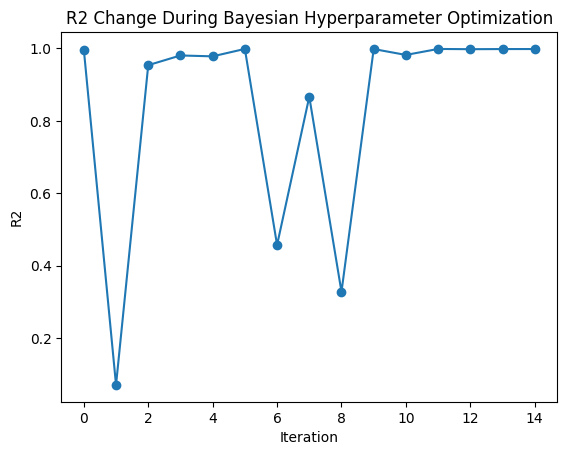

Original Dataset - RMSE: 2.140482542327067, R2: 0.9999875938877224, MAE: 1.4705966056106434
External Dataset - RMSE: 286.0028991699219, R2: 0.7785104623584754, MAE: 235.59483337402344


In [10]:
# 提取每次迭代的最佳 R2
best_r2_list = []
for res in result.func_vals:
    best_r2_list.append(-res)  # 注意要取负数

# 绘制 R2 的变化过程图
plt.plot(best_r2_list, marker='o')
plt.xlabel('Iteration')
plt.ylabel('R2')
plt.title('R2 Change During Bayesian Hyperparameter Optimization')
plt.show()

import torch
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from sklearn.model_selection import train_test_split

target_column = 'Biogas Production'

# 分离特征和目标变量
X = data.drop(target_column, axis=1)
y = data[target_column]
X_external = external_data.drop(target_column, axis=1)
y_external = external_data[target_column]

# 标准化数据
X_normalized, feature_scaler = normalize_data(X)
y_normalized, target_scaler = normalize_data(y.values.reshape(-1, 1))

# 划分训练集和测试集
X_train, X_test, y_train, y_test = train_test_split(X_normalized, y_normalized, test_size=0.2, random_state=0)

# 转换为 PyTorch 张量
X_train_tensor = torch.from_numpy(X_train).float().to(device)
X_test_tensor = torch.from_numpy(X_test).float().to(device)
y_train_tensor = torch.from_numpy(y_train).float().to(device)
y_test_tensor = torch.from_numpy(y_test).float().to(device)

# 标准化外部数据集
X_external_normalized, _ = normalize_data(X_external)
y_external_normalized, _ = normalize_data(y_external.values.reshape(-1, 1))

# 转换外部数据为张量
X_external_tensor = torch.from_numpy(X_external_normalized).float().to(device)
y_external_tensor = torch.from_numpy(y_external_normalized).float().to(device)

# 模型预测函数
def model_predict(model, X_tensor):
    model.eval()
    with torch.no_grad():
        return model(X_tensor).cpu().numpy()

# 获取预测值
y_pred_train = model_predict(model, X_train_tensor).flatten()
y_pred_test = model_predict(model, X_test_tensor).flatten()
y_pred_external = model_predict(model, X_external_tensor).flatten()

# 反标准化预测值和实际值
y_pred_train_denorm = denormalize_data(y_pred_train.reshape(-1, 1), target_scaler).flatten()
y_pred_test_denorm = denormalize_data(y_pred_test.reshape(-1, 1), target_scaler).flatten()
y_pred_external_denorm = denormalize_data(y_pred_external.reshape(-1, 1), target_scaler).flatten()
y_train_denorm = denormalize_data(y_train, target_scaler).flatten()
y_test_denorm = denormalize_data(y_test, target_scaler).flatten()
y_external_denorm = denormalize_data(y_external_tensor.cpu().numpy(), target_scaler).flatten()


# 合并原始数据集和外部数据集的预测值和实际值
original_data_actual = np.concatenate([y_train_denorm, y_test_denorm])
original_data_predicted = np.concatenate([y_pred_train_denorm, y_pred_test_denorm])
external_data_actual = y_external_denorm
external_data_predicted = y_pred_external_denorm

# 创建 DataFrame
combined_df = pd.DataFrame({
    'Actual': np.concatenate([original_data_actual, external_data_actual]),
    'Predicted': np.concatenate([original_data_predicted, external_data_predicted]),
    'Dataset': ['Original'] * len(original_data_actual) + ['External'] * len(external_data_actual)
})

# 计算原始数据集的指标
train_r2 = r2_score(original_data_actual, original_data_predicted)
train_rmse = mean_squared_error(original_data_actual, original_data_predicted, squared=False)
train_mae = mean_absolute_error(original_data_actual, original_data_predicted)

# 计算外部数据集的指标
external_r2 = r2_score(external_data_actual, external_data_predicted)
external_rmse = mean_squared_error(external_data_actual, external_data_predicted, squared=False)
external_mae = mean_absolute_error(external_data_actual, external_data_predicted)


print(f"Original Dataset - RMSE: {train_rmse}, R2: {train_r2}, MAE: {train_mae}")
print(f"External Dataset - RMSE: {external_rmse}, R2: {external_r2}, MAE: {external_mae}")

GAN

Best parameters: [1500, 1e-06, 0.001, 0.8, 1e-07]


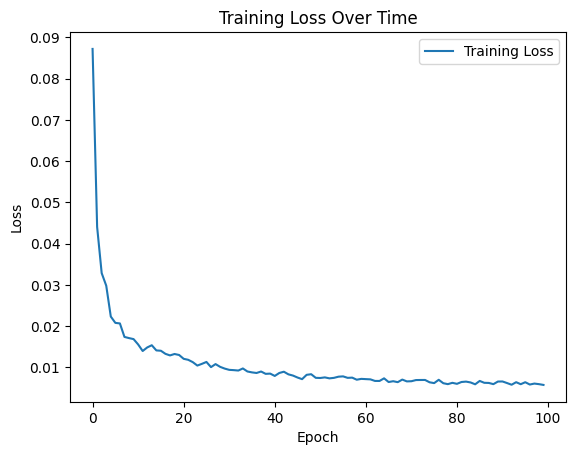

Task Train RMSE: 7.399575233459473, Train R2: 0.9988674971193391, Train MAE: 4.87180233001709
Task Test RMSE: 3.786107301712036, Test R2: 0.9983158765006176, Test MAE: 3.485739231109619
Task Train RMSE: 5.360780715942383, Train R2: 0.9990487802272447, Train MAE: 4.350295066833496
Task Test RMSE: 10.881065368652344, Test R2: 0.9986068029762354, Test MAE: 5.571764945983887
Task Train RMSE: 7.210797309875488, Train R2: 0.9988291706042657, Train MAE: 4.752558708190918
Task Test RMSE: 5.036566257476807, Test R2: 0.9991321496173385, Test MAE: 3.96270751953125
Task Train RMSE: 7.216528415679932, Train R2: 0.9988477492548464, Train MAE: 4.616879940032959
Task Test RMSE: 5.003630638122559, Test R2: 0.9990391092536071, Test MAE: 4.50543212890625
Task Train RMSE: 6.766376495361328, Train R2: 0.9988071885665898, Train MAE: 4.38140344619751
Task Test RMSE: 7.086184501647949, Test R2: 0.9990463717077914, Test MAE: 5.44732666015625
Task Train RMSE: 4.945869445800781, Train R2: 0.9995121257196494, Tra

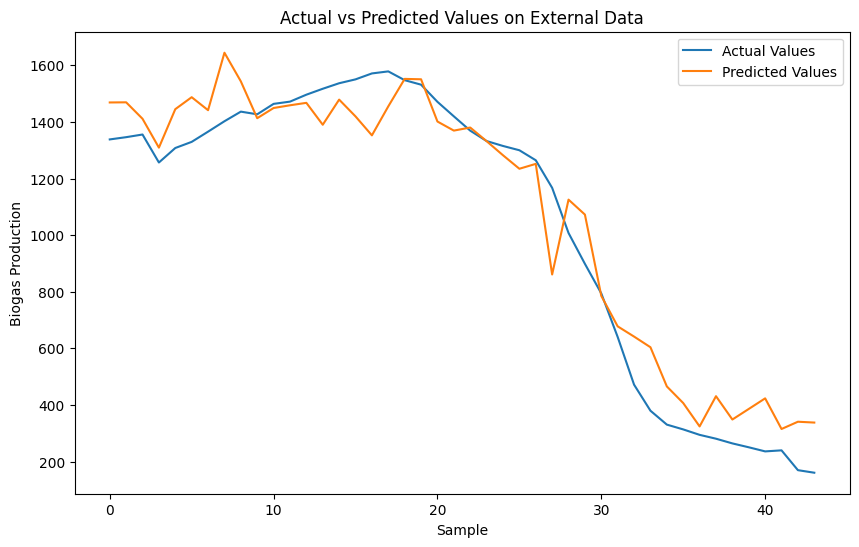

External Dataset - RMSE: 123.21638488769531, R2: 0.9411201085196951, MAE: 98.94302368164062


In [11]:
import torch
from torch import nn, optim
import torch.nn.functional as F
import numpy as np
import pandas as pd
from sklearn.preprocessing import StandardScaler
import learn2learn as l2l
from sklearn.model_selection import train_test_split, KFold
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from skopt import gp_minimize
from skopt.space import Real, Integer
from skopt.utils import use_named_args
import matplotlib.pyplot as plt
from torch.utils.data import DataLoader, TensorDataset

# 设置随机种子
np.random.seed(0)
torch.manual_seed(0)

device = torch.device("cuda:0")  # Use GPU 0

# Hyperparameter search space
search_space = [
    Integer(500, 1500, name='hidden_size'), 
    Real(1e-11, 1e-6, "log-uniform", name='alpha'),  
    Real(1e-7, 1e-3, "log-uniform", name='beta'),
    Real(0.1, 0.8, name='dropout_rate'), 
    Real(1e-7, 1e-1, "log-uniform", name='weight_decay') 
]

# Data normalization and denormalization functions
def normalize_data(data):
    scaler = StandardScaler()
    return scaler.fit_transform(data), scaler

def normalize_feature(data, column_name):
    scaler = StandardScaler()
    scaled_data = scaler.fit_transform(data[[column_name]])
    return scaled_data, scaler

def denormalize_data(normalized_data, scaler):
    return scaler.inverse_transform(normalized_data)

# 加载和规范化数据
data = pd.read_csv("C:\\Users\\Lenovo\\Desktop\\元学习\\BT1-1.csv")
data_normalized, scaler = normalize_data(data)

# 假设您的目标列名为'GI(%)'
target_normalized, target_scaler = normalize_data(data[['Biogas Production']].values)
# 元学习模型定义
class AdvancedNeuralNetwork(nn.Module):
    def __init__(self, input_size, hidden_size, dropout_rate):
        super(AdvancedNeuralNetwork, self).__init__()
        self.layer1 = nn.Linear(input_size, hidden_size)
        self.relu1 = nn.LeakyReLU()
        self.layer2 = nn.Linear(hidden_size, hidden_size // 2)
        self.relu2 = nn.LeakyReLU()
        self.layer3 = nn.Linear(hidden_size // 2, hidden_size // 4)
        self.relu3 = nn.LeakyReLU()
        self.dropout = nn.Dropout(dropout_rate)
        self.layer4 = nn.Linear(hidden_size // 4, 1)

    def forward(self, x):
        x = self.relu1(self.layer1(x))
        x = self.relu2(self.layer2(x))
        x = self.relu3(self.layer3(x))
        x = self.dropout(x)
        x = self.layer4(x)
        return x

# 其他辅助函数和类（如EarlyStopping, create_tasks等）根据需要添加
# Task creation function
def create_tasks(data, target_column, num_tasks=50, task_size=100):
    tasks = []
    for _ in range(num_tasks):
        task_data = data.sample(task_size)
        X, y = task_data.drop(target_column, axis=1), task_data[target_column]
        tasks.append((X, y))
    return tasks

# Early stopping class
class EarlyStopping:
    def __init__(self, patience=5, delta=0):
        self.patience = patience
        self.counter = 0
        self.best_score = None
        self.early_stop = False
        self.delta = delta

    def __call__(self, val_loss, model):
        score = -val_loss
        if self.best_score is None:
            self.best_score = score
        elif score < self.best_score + self.delta:
            self.counter += 1
            if self.counter >= self.patience:
                self.early_stop = True
        else:
            self.best_score = score
            self.counter = 0

# GAN的生成器定义
class Generator(nn.Module):
    def __init__(self, input_size, hidden_dim, output_size):
        super(Generator, self).__init__()
        self.fc1 = nn.Linear(input_size, hidden_dim)
        self.fc2 = nn.Linear(hidden_dim, hidden_dim * 2)
        self.fc3 = nn.Linear(hidden_dim * 2, hidden_dim * 4)
        self.fc4 = nn.Linear(hidden_dim * 4, output_size)

    def forward(self, x):
        x = F.leaky_relu(self.fc1(x), 0.2)
        x = F.leaky_relu(self.fc2(x), 0.2)
        x = F.leaky_relu(self.fc3(x), 0.2)
        x = torch.tanh(self.fc4(x))
        return x

# GAN的判别器定义
class Discriminator(nn.Module):
    def __init__(self, input_size, hidden_dim):
        super(Discriminator, self).__init__()
        self.fc1 = nn.Linear(input_size, hidden_dim * 4)
        self.fc2 = nn.Linear(hidden_dim * 4, hidden_dim * 2)
        self.fc3 = nn.Linear(hidden_dim * 2, hidden_dim)
        self.fc4 = nn.Linear(hidden_dim, 1)

    def forward(self, x):
        x = F.leaky_relu(self.fc1(x), 0.2)
        x = F.leaky_relu(self.fc2(x), 0.2)
        x = F.leaky_relu(self.fc3(x), 0.2)
        x = torch.sigmoid(self.fc4(x))
        return x

# MAML fast adaptation and meta-training
def meta_train_maml(model, tasks, alpha, beta, weight_decay, epochs=100, num_steps=1):
    early_stopping = EarlyStopping(patience=10, delta=0.01)
    optimizer = optim.Adam(model.parameters(), lr=beta, weight_decay=weight_decay)
    scheduler = optim.lr_scheduler.CosineAnnealingLR(optimizer, T_max=epochs)

    epoch_loss_list = []  # Initialize a list to store losses for each epoch

    for epoch in range(epochs):
        epoch_losses = []
        for task in tasks:
            learner = model.clone()  # Clone the model
            task_X, task_y = task
            task_X = torch.from_numpy(task_X.values).float().to(device)
            task_y = torch.from_numpy(task_y.values).float().to(device)

            # Fast adaptation
            for step in range(num_steps):
                pred_y = learner(task_X)
                loss = nn.functional.mse_loss(pred_y.squeeze(), task_y)
                learner.adapt(loss)

            # Meta-update
            optimizer.zero_grad()
            pred_y = learner(task_X)
            loss = nn.functional.mse_loss(pred_y.squeeze(), task_y)
            epoch_losses.append(loss.item())
            loss.backward()
            optimizer.step()

        scheduler.step()  # Update learning rate
        average_loss = np.mean(epoch_losses)
        epoch_loss_list.append(average_loss)  # Add each epoch's average loss to the list

        if early_stopping(average_loss, model):
            print(f"Early stopping triggered at epoch {epoch}")
            break

    return epoch_loss_list  # Return the list of epoch losses



@use_named_args(search_space)
def objective(hidden_size, alpha, beta, dropout_rate, weight_decay):
    model = AdvancedNeuralNetwork(input_size, hidden_size, dropout_rate)
    model = l2l.algorithms.MAML(model, lr=alpha).to(device)
    avg_r2 = 0

    task_r2_list = []  # 记录每个任务的 R2

    for task in tasks:
        task_X, task_y = task
        task_X_train, task_X_test, task_y_train, task_y_test = train_test_split(task_X, task_y, test_size=0.2, random_state=0)
        meta_train_maml(model, [(task_X_train, task_y_train)], alpha, beta, weight_decay, epochs=100)
        train_rmse, train_r2, train_mae, test_rmse, test_r2, test_mae = evaluate_model(model, task_X_train, task_y_train, task_X_test, task_y_test, target_scaler)
        task_r2_list.append(test_r2)  # 记录每个任务的测试 R2
        avg_r2 += test_r2

    avg_r2 /= len(tasks)
    return -avg_r2  # 这里返回负数因为 skopt 的目标函数是最小化，而我们想要最大化 R2

# Evaluation function
def evaluate_model(model, X_train, y_train, X_test, y_test, target_scaler):
    model.eval()
    with torch.no_grad():
        # Convert data to tensors
        X_train_tensor = torch.from_numpy(X_train.values).float().to(device)
        y_train_tensor = torch.from_numpy(y_train.values).float().to(device)
        X_test_tensor = torch.from_numpy(X_test.values).float().to(device)
        y_test_tensor = torch.from_numpy(y_test.values).float().to(device)

        # Get predictions
        train_predictions = model(X_train_tensor).squeeze().cpu().numpy()
        test_predictions = model(X_test_tensor).squeeze().cpu().numpy()

        # Reshape predictions for denormalization
        train_predictions_reshaped = train_predictions.reshape(-1, 1)
        test_predictions_reshaped = test_predictions.reshape(-1, 1)

        # Denormalize predictions using target_scaler
        train_predictions_denorm = denormalize_data(train_predictions_reshaped, target_scaler)
        test_predictions_denorm = denormalize_data(test_predictions_reshaped, target_scaler)

        # Denormalize actual values using target_scaler
        y_train_denorm = denormalize_data(y_train_tensor.cpu().numpy().reshape(-1, 1), target_scaler)
        y_test_denorm = denormalize_data(y_test_tensor.cpu().numpy().reshape(-1, 1), target_scaler)

        # Calculate metrics using denormalized data
        train_rmse = mean_squared_error(y_train_denorm, train_predictions_denorm, squared=False)
        train_r2 = r2_score(y_train_denorm, train_predictions_denorm)
        train_mae = mean_absolute_error(y_train_denorm, train_predictions_denorm)

        test_rmse = mean_squared_error(y_test_denorm, test_predictions_denorm, squared=False)
        test_r2 = r2_score(y_test_denorm, test_predictions_denorm)
        test_mae = mean_absolute_error(y_test_denorm, test_predictions_denorm)

    return train_rmse, train_r2, train_mae, test_rmse, test_r2, test_mae

# 设置GAN训练参数
z_dim = 100  # 潜在空间的维度
gen_hidden_dim = 128
dis_hidden_dim = 128
lr = 0.0002
batch_size = 64
num_epochs = 50

# 初始化模型
generator = Generator(z_dim, gen_hidden_dim, data_normalized.shape[1]).to(device)
discriminator = Discriminator(data_normalized.shape[1], dis_hidden_dim).to(device)

# 优化器
optim_g = optim.Adam(generator.parameters(), lr=lr)
optim_d = optim.Adam(discriminator.parameters(), lr=lr)

tensor_data = torch.Tensor(data_normalized)
data_loader = DataLoader(tensor_data, batch_size=batch_size, shuffle=True)

# GAN训练循环
for epoch in range(num_epochs):
    for batch in data_loader:
        current_batch_size = len(batch)  # Get the actual batch size
        real_data = batch.to(device)
        real_labels = torch.ones(current_batch_size, 1).to(device)  # Adjust label size based on batch
        fake_data = generator(torch.randn(current_batch_size, z_dim).to(device))  # Generate fake data based on current batch size
        fake_labels = torch.zeros(current_batch_size, 1).to(device)  # Adjust fake label size

        # 训练判别器
        optim_d.zero_grad()
        real_output = discriminator(real_data)
        fake_output = discriminator(fake_data)
        d_loss_real = nn.BCEWithLogitsLoss()(real_output, real_labels)
        d_loss_fake = nn.BCEWithLogitsLoss()(fake_output, fake_labels)
        d_loss = d_loss_real + d_loss_fake
        d_loss.backward()
        optim_d.step()

        # 训练生成器
        optim_g.zero_grad()
        fake_data = generator(torch.randn(current_batch_size, z_dim).to(device))  # Regenerate fake data
        fake_output = discriminator(fake_data)
        g_loss = nn.BCEWithLogitsLoss()(fake_output, real_labels)  # Use real_labels here
        g_loss.backward()
        optim_g.step()

# 假设您想生成一定数量的新样本
number_of_generated_samples = 500

# 生成新的数据样本
generated_samples = []
for _ in range(number_of_generated_samples):
    z = torch.randn(1, z_dim).to(device)
    generated_sample = generator(z).detach().cpu().numpy()
    generated_samples.append(generated_sample.reshape(-1))

generated_samples = np.array(generated_samples)

# 将生成的样本合并到现有数据中
extended_data = np.vstack([data_normalized, generated_samples])

# 创建增强的数据集任务
# 这里假设您已经定义了创建任务的函数
input_size = data.shape[1] - 1 
tasks = create_tasks(pd.DataFrame(extended_data, columns=data.columns), target_column='Biogas Production')
# Execute hyperparameter optimization
result = gp_minimize(objective, search_space, n_calls=15,random_state=0)
hidden_size, alpha, beta, dropout_rate, weight_decay = result.x
print("Best parameters:", result.x)

# Train model with optimized hyperparameters
model = AdvancedNeuralNetwork(input_size, hidden_size, dropout_rate)
model = l2l.algorithms.MAML(model, lr=alpha).to(device)
train_losses = meta_train_maml(model, tasks, alpha, beta, weight_decay, epochs=100)

# Visualize training losses
plt.plot(train_losses, label='Training Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training Loss Over Time')
plt.legend()
plt.show()

# Final model evaluation
for task in tasks:
    X, y = task
    kf = KFold(n_splits=5, shuffle=True, random_state=0)
    for train_index, test_index in kf.split(X):
        X_train, X_test = X.iloc[train_index], X.iloc[test_index]
        y_train, y_test = y.iloc[train_index], y.iloc[test_index]
        train_rmse, train_r2, train_mae, test_rmse, test_r2, test_mae = evaluate_model(model, X_train, y_train, X_test, y_test, target_scaler)
        print(f"Task Train RMSE: {train_rmse}, Train R2: {train_r2}, Train MAE: {train_mae}")
        print(f"Task Test RMSE: {test_rmse}, Test R2: {test_r2}, Test MAE: {test_mae}")
# Load and process external data for evaluation
external_data = pd.read_csv("C:\\Users\\Lenovo\\Desktop\\元学习\\BT1-2.csv")
external_data_normalized, _ = normalize_data(external_data)
external_target_normalized, _ = normalize_feature(external_data, 'Biogas Production')
external_X = torch.from_numpy(pd.DataFrame(external_data_normalized, columns=external_data.columns).drop('Biogas Production', axis=1).values).float().to(device)
external_y_normalized = torch.from_numpy(external_target_normalized).float().to(device)

# Model prediction on external data
learner = model.clone()  # Clone the model for evaluation
learner.eval()
with torch.no_grad():
    external_predictions_normalized = learner(external_X).squeeze()
external_predictions = denormalize_data(external_predictions_normalized.cpu().numpy().reshape(-1, 1), target_scaler)
external_y = denormalize_data(external_y_normalized.cpu().numpy().reshape(-1, 1), target_scaler)

# Visualization of predictions on external data
plt.figure(figsize=(10, 6))
plt.plot(external_y, label='Actual Values')
plt.plot(external_predictions, label='Predicted Values')
plt.xlabel('Sample')
plt.ylabel('Biogas Production')
plt.title('Actual vs Predicted Values on External Data')
plt.legend()
plt.show()

# Evaluate on external dataset using denormalized data
external_rmse = mean_squared_error(external_y, external_predictions, squared=False)
external_r2 = r2_score(external_y, external_predictions)
external_mae = mean_absolute_error(external_y, external_predictions)

print(f"External Dataset - RMSE: {external_rmse}, R2: {external_r2}, MAE: {external_mae}")

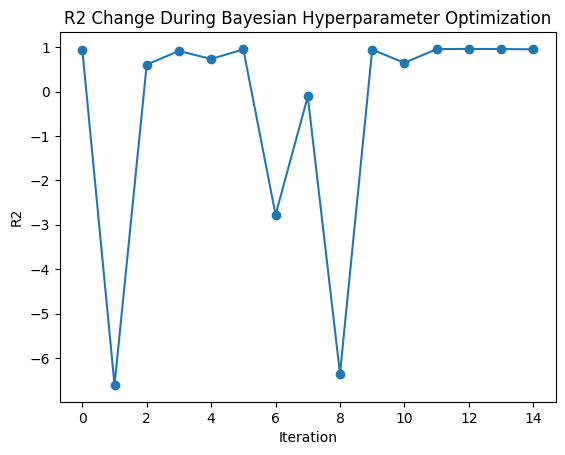

Original Dataset - RMSE: 12.669152362455536, R2: 0.9993775203036893, MAE: 8.590825268975621
External Dataset - RMSE: 123.21638488769531, R2: 0.9411201085196951, MAE: 98.94302368164062


In [12]:
# 提取每次迭代的最佳 R2
best_r2_list = []
for res in result.func_vals:
    best_r2_list.append(-res)  # 注意要取负数

# 绘制 R2 的变化过程图
plt.plot(best_r2_list, marker='o')
plt.xlabel('Iteration')
plt.ylabel('R2')
plt.title('R2 Change During Bayesian Hyperparameter Optimization')
plt.show()

import torch
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from sklearn.model_selection import train_test_split

target_column = 'Biogas Production'

# 分离特征和目标变量
X = data.drop(target_column, axis=1)
y = data[target_column]
X_external = external_data.drop(target_column, axis=1)
y_external = external_data[target_column]

# 标准化数据
X_normalized, feature_scaler = normalize_data(X)
y_normalized, target_scaler = normalize_data(y.values.reshape(-1, 1))

# 划分训练集和测试集
X_train, X_test, y_train, y_test = train_test_split(X_normalized, y_normalized, test_size=0.2, random_state=0)

# 转换为 PyTorch 张量
X_train_tensor = torch.from_numpy(X_train).float().to(device)
X_test_tensor = torch.from_numpy(X_test).float().to(device)
y_train_tensor = torch.from_numpy(y_train).float().to(device)
y_test_tensor = torch.from_numpy(y_test).float().to(device)

# 标准化外部数据集
X_external_normalized, _ = normalize_data(X_external)
y_external_normalized, _ = normalize_data(y_external.values.reshape(-1, 1))

# 转换外部数据为张量
X_external_tensor = torch.from_numpy(X_external_normalized).float().to(device)
y_external_tensor = torch.from_numpy(y_external_normalized).float().to(device)

# 模型预测函数
def model_predict(model, X_tensor):
    model.eval()
    with torch.no_grad():
        return model(X_tensor).cpu().numpy()

# 获取预测值
y_pred_train = model_predict(model, X_train_tensor).flatten()
y_pred_test = model_predict(model, X_test_tensor).flatten()
y_pred_external = model_predict(model, X_external_tensor).flatten()

# 反标准化预测值和实际值
y_pred_train_denorm = denormalize_data(y_pred_train.reshape(-1, 1), target_scaler).flatten()
y_pred_test_denorm = denormalize_data(y_pred_test.reshape(-1, 1), target_scaler).flatten()
y_pred_external_denorm = denormalize_data(y_pred_external.reshape(-1, 1), target_scaler).flatten()
y_train_denorm = denormalize_data(y_train, target_scaler).flatten()
y_test_denorm = denormalize_data(y_test, target_scaler).flatten()
y_external_denorm = denormalize_data(y_external_tensor.cpu().numpy(), target_scaler).flatten()


# 合并原始数据集和外部数据集的预测值和实际值
original_data_actual = np.concatenate([y_train_denorm, y_test_denorm])
original_data_predicted = np.concatenate([y_pred_train_denorm, y_pred_test_denorm])
external_data_actual = y_external_denorm
external_data_predicted = y_pred_external_denorm

# 创建 DataFrame
combined_df = pd.DataFrame({
    'Actual': np.concatenate([original_data_actual, external_data_actual]),
    'Predicted': np.concatenate([original_data_predicted, external_data_predicted]),
    'Dataset': ['Original'] * len(original_data_actual) + ['External'] * len(external_data_actual)
})

# 计算原始数据集的指标
train_r2 = r2_score(original_data_actual, original_data_predicted)
train_rmse = mean_squared_error(original_data_actual, original_data_predicted, squared=False)
train_mae = mean_absolute_error(original_data_actual, original_data_predicted)

# 计算外部数据集的指标
external_r2 = r2_score(external_data_actual, external_data_predicted)
external_rmse = mean_squared_error(external_data_actual, external_data_predicted, squared=False)
external_mae = mean_absolute_error(external_data_actual, external_data_predicted)


print(f"Original Dataset - RMSE: {train_rmse}, R2: {train_r2}, MAE: {train_mae}")
print(f"External Dataset - RMSE: {external_rmse}, R2: {external_r2}, MAE: {external_mae}")

Best parameters: [1500, 1e-06, 1.0029687261054178e-05, 0.1, 1e-07]


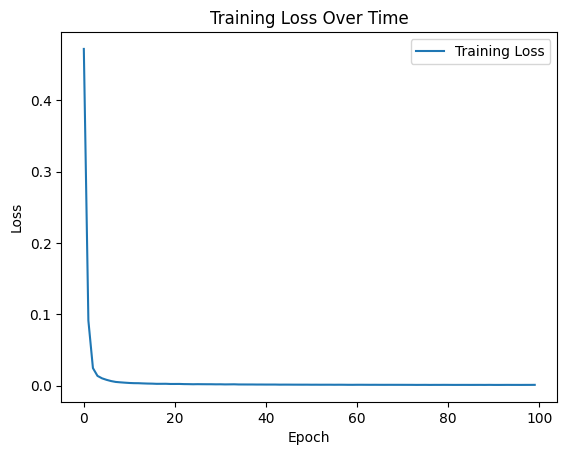

Task Train RMSE: 9.638254165649414, Train R2: 0.9989805029122903, Train MAE: 3.8092308044433594
Task Test RMSE: 6.3068037033081055, Test R2: 0.9996815308876867, Test MAE: 3.413586378097534
Task Train RMSE: 9.744552612304688, Train R2: 0.9992123509219158, Train MAE: 3.871506452560425
Task Test RMSE: 5.6155500411987305, Test R2: 0.995618856054754, Test MAE: 3.1644928455352783
Task Train RMSE: 9.824800491333008, Train R2: 0.9990343320618027, Train MAE: 3.9444236755371094
Task Test RMSE: 5.0252156257629395, Test R2: 0.9997266639297676, Test MAE: 2.872824192047119
Task Train RMSE: 5.409165382385254, Train R2: 0.9995786287434822, Train MAE: 3.016010284423828
Task Test RMSE: 17.155860900878906, Test R2: 0.9985830547402881, Test MAE: 6.586489677429199
Task Train RMSE: 9.885420799255371, Train R2: 0.9991198525565778, Train MAE: 4.009344577789307
Task Test RMSE: 4.52476167678833, Test R2: 0.9995501684809815, Test MAE: 2.6131439208984375
Task Train RMSE: 7.571975231170654, Train R2: 0.99953776911

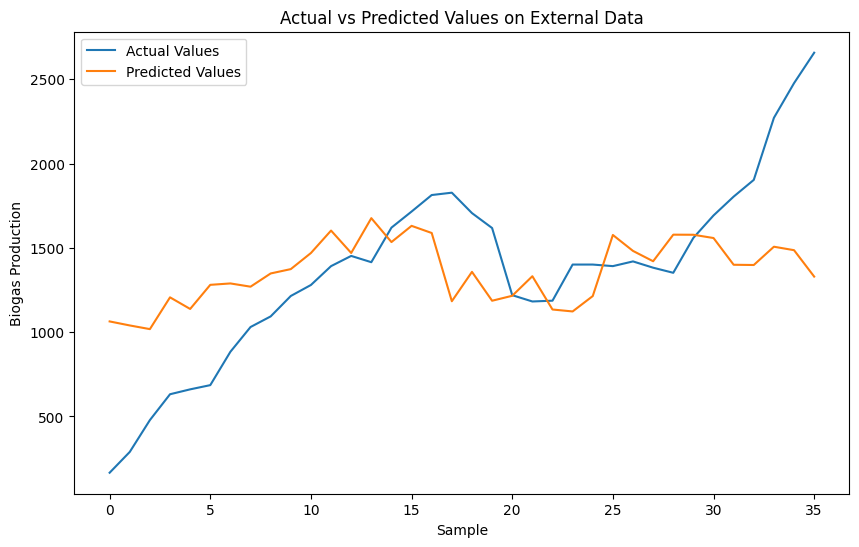

External Dataset - RMSE: 465.95440673828125, R2: 0.26037123541693974, MAE: 353.3341064453125


In [13]:
import torch
from torch import nn, optim
import torch.nn.functional as F
import numpy as np
import pandas as pd
from sklearn.preprocessing import StandardScaler
import learn2learn as l2l
from sklearn.model_selection import train_test_split, KFold
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from skopt import gp_minimize
from skopt.space import Real, Integer
from skopt.utils import use_named_args
import matplotlib.pyplot as plt
from torch.utils.data import DataLoader, TensorDataset

# 设置随机种子
np.random.seed(0)
torch.manual_seed(0)

device = torch.device("cuda:0")  # Use GPU 0

# Hyperparameter search space
search_space = [
    Integer(500, 1500, name='hidden_size'), 
    Real(1e-11, 1e-6, "log-uniform", name='alpha'),  
    Real(1e-7, 1e-3, "log-uniform", name='beta'),
    Real(0.1, 0.8, name='dropout_rate'), 
    Real(1e-7, 1e-1, "log-uniform", name='weight_decay') 
]

# Data normalization and denormalization functions
def normalize_data(data):
    scaler = StandardScaler()
    return scaler.fit_transform(data), scaler

def normalize_feature(data, column_name):
    scaler = StandardScaler()
    scaled_data = scaler.fit_transform(data[[column_name]])
    return scaled_data, scaler

def denormalize_data(normalized_data, scaler):
    return scaler.inverse_transform(normalized_data)

# 加载和规范化数据
data = pd.read_csv("C:\\Users\\Lenovo\\Desktop\\元学习\\BT2-1.csv")
data_normalized, scaler = normalize_data(data)

# 假设您的目标列名为'GI(%)'
target_normalized, target_scaler = normalize_data(data[['Biogas Production']].values)
# 元学习模型定义
class AdvancedNeuralNetwork(nn.Module):
    def __init__(self, input_size, hidden_size, dropout_rate):
        super(AdvancedNeuralNetwork, self).__init__()
        self.layer1 = nn.Linear(input_size, hidden_size)
        self.relu1 = nn.LeakyReLU()
        self.layer2 = nn.Linear(hidden_size, hidden_size // 2)
        self.relu2 = nn.LeakyReLU()
        self.layer3 = nn.Linear(hidden_size // 2, hidden_size // 4)
        self.relu3 = nn.LeakyReLU()
        self.dropout = nn.Dropout(dropout_rate)
        self.layer4 = nn.Linear(hidden_size // 4, 1)

    def forward(self, x):
        x = self.relu1(self.layer1(x))
        x = self.relu2(self.layer2(x))
        x = self.relu3(self.layer3(x))
        x = self.dropout(x)
        x = self.layer4(x)
        return x

# 其他辅助函数和类（如EarlyStopping, create_tasks等）根据需要添加
# Task creation function
def create_tasks(data, target_column, num_tasks=50, task_size=100):
    tasks = []
    for _ in range(num_tasks):
        task_data = data.sample(task_size)
        X, y = task_data.drop(target_column, axis=1), task_data[target_column]
        tasks.append((X, y))
    return tasks

# Early stopping class
class EarlyStopping:
    def __init__(self, patience=5, delta=0):
        self.patience = patience
        self.counter = 0
        self.best_score = None
        self.early_stop = False
        self.delta = delta

    def __call__(self, val_loss, model):
        score = -val_loss
        if self.best_score is None:
            self.best_score = score
        elif score < self.best_score + self.delta:
            self.counter += 1
            if self.counter >= self.patience:
                self.early_stop = True
        else:
            self.best_score = score
            self.counter = 0

# GAN的生成器定义
class Generator(nn.Module):
    def __init__(self, input_size, hidden_dim, output_size):
        super(Generator, self).__init__()
        self.fc1 = nn.Linear(input_size, hidden_dim)
        self.fc2 = nn.Linear(hidden_dim, hidden_dim * 2)
        self.fc3 = nn.Linear(hidden_dim * 2, hidden_dim * 4)
        self.fc4 = nn.Linear(hidden_dim * 4, output_size)

    def forward(self, x):
        x = F.leaky_relu(self.fc1(x), 0.2)
        x = F.leaky_relu(self.fc2(x), 0.2)
        x = F.leaky_relu(self.fc3(x), 0.2)
        x = torch.tanh(self.fc4(x))
        return x

# GAN的判别器定义
class Discriminator(nn.Module):
    def __init__(self, input_size, hidden_dim):
        super(Discriminator, self).__init__()
        self.fc1 = nn.Linear(input_size, hidden_dim * 4)
        self.fc2 = nn.Linear(hidden_dim * 4, hidden_dim * 2)
        self.fc3 = nn.Linear(hidden_dim * 2, hidden_dim)
        self.fc4 = nn.Linear(hidden_dim, 1)

    def forward(self, x):
        x = F.leaky_relu(self.fc1(x), 0.2)
        x = F.leaky_relu(self.fc2(x), 0.2)
        x = F.leaky_relu(self.fc3(x), 0.2)
        x = torch.sigmoid(self.fc4(x))
        return x

# MAML fast adaptation and meta-training
def meta_train_maml(model, tasks, alpha, beta, weight_decay, epochs=100, num_steps=1):
    early_stopping = EarlyStopping(patience=10, delta=0.01)
    optimizer = optim.Adam(model.parameters(), lr=beta, weight_decay=weight_decay)
    scheduler = optim.lr_scheduler.CosineAnnealingLR(optimizer, T_max=epochs)

    epoch_loss_list = []  # Initialize a list to store losses for each epoch

    for epoch in range(epochs):
        epoch_losses = []
        for task in tasks:
            learner = model.clone()  # Clone the model
            task_X, task_y = task
            task_X = torch.from_numpy(task_X.values).float().to(device)
            task_y = torch.from_numpy(task_y.values).float().to(device)

            # Fast adaptation
            for step in range(num_steps):
                pred_y = learner(task_X)
                loss = nn.functional.mse_loss(pred_y.squeeze(), task_y)
                learner.adapt(loss)

            # Meta-update
            optimizer.zero_grad()
            pred_y = learner(task_X)
            loss = nn.functional.mse_loss(pred_y.squeeze(), task_y)
            epoch_losses.append(loss.item())
            loss.backward()
            optimizer.step()

        scheduler.step()  # Update learning rate
        average_loss = np.mean(epoch_losses)
        epoch_loss_list.append(average_loss)  # Add each epoch's average loss to the list

        if early_stopping(average_loss, model):
            print(f"Early stopping triggered at epoch {epoch}")
            break

    return epoch_loss_list  # Return the list of epoch losses



@use_named_args(search_space)
def objective(hidden_size, alpha, beta, dropout_rate, weight_decay):
    model = AdvancedNeuralNetwork(input_size, hidden_size, dropout_rate)
    model = l2l.algorithms.MAML(model, lr=alpha).to(device)
    avg_r2 = 0

    task_r2_list = []  # 记录每个任务的 R2

    for task in tasks:
        task_X, task_y = task
        task_X_train, task_X_test, task_y_train, task_y_test = train_test_split(task_X, task_y, test_size=0.2, random_state=0)
        meta_train_maml(model, [(task_X_train, task_y_train)], alpha, beta, weight_decay, epochs=100)
        train_rmse, train_r2, train_mae, test_rmse, test_r2, test_mae = evaluate_model(model, task_X_train, task_y_train, task_X_test, task_y_test, target_scaler)
        task_r2_list.append(test_r2)  # 记录每个任务的测试 R2
        avg_r2 += test_r2

    avg_r2 /= len(tasks)
    return -avg_r2  # 这里返回负数因为 skopt 的目标函数是最小化，而我们想要最大化 R2

# Evaluation function
def evaluate_model(model, X_train, y_train, X_test, y_test, target_scaler):
    model.eval()
    with torch.no_grad():
        # Convert data to tensors
        X_train_tensor = torch.from_numpy(X_train.values).float().to(device)
        y_train_tensor = torch.from_numpy(y_train.values).float().to(device)
        X_test_tensor = torch.from_numpy(X_test.values).float().to(device)
        y_test_tensor = torch.from_numpy(y_test.values).float().to(device)

        # Get predictions
        train_predictions = model(X_train_tensor).squeeze().cpu().numpy()
        test_predictions = model(X_test_tensor).squeeze().cpu().numpy()

        # Reshape predictions for denormalization
        train_predictions_reshaped = train_predictions.reshape(-1, 1)
        test_predictions_reshaped = test_predictions.reshape(-1, 1)

        # Denormalize predictions using target_scaler
        train_predictions_denorm = denormalize_data(train_predictions_reshaped, target_scaler)
        test_predictions_denorm = denormalize_data(test_predictions_reshaped, target_scaler)

        # Denormalize actual values using target_scaler
        y_train_denorm = denormalize_data(y_train_tensor.cpu().numpy().reshape(-1, 1), target_scaler)
        y_test_denorm = denormalize_data(y_test_tensor.cpu().numpy().reshape(-1, 1), target_scaler)

        # Calculate metrics using denormalized data
        train_rmse = mean_squared_error(y_train_denorm, train_predictions_denorm, squared=False)
        train_r2 = r2_score(y_train_denorm, train_predictions_denorm)
        train_mae = mean_absolute_error(y_train_denorm, train_predictions_denorm)

        test_rmse = mean_squared_error(y_test_denorm, test_predictions_denorm, squared=False)
        test_r2 = r2_score(y_test_denorm, test_predictions_denorm)
        test_mae = mean_absolute_error(y_test_denorm, test_predictions_denorm)

    return train_rmse, train_r2, train_mae, test_rmse, test_r2, test_mae

# 设置GAN训练参数
z_dim = 100  # 潜在空间的维度
gen_hidden_dim = 128
dis_hidden_dim = 128
lr = 0.0002
batch_size = 64
num_epochs = 50

# 初始化模型
generator = Generator(z_dim, gen_hidden_dim, data_normalized.shape[1]).to(device)
discriminator = Discriminator(data_normalized.shape[1], dis_hidden_dim).to(device)

# 优化器
optim_g = optim.Adam(generator.parameters(), lr=lr)
optim_d = optim.Adam(discriminator.parameters(), lr=lr)

tensor_data = torch.Tensor(data_normalized)
data_loader = DataLoader(tensor_data, batch_size=batch_size, shuffle=True)

# GAN训练循环
for epoch in range(num_epochs):
    for batch in data_loader:
        current_batch_size = len(batch)  # Get the actual batch size
        real_data = batch.to(device)
        real_labels = torch.ones(current_batch_size, 1).to(device)  # Adjust label size based on batch
        fake_data = generator(torch.randn(current_batch_size, z_dim).to(device))  # Generate fake data based on current batch size
        fake_labels = torch.zeros(current_batch_size, 1).to(device)  # Adjust fake label size

        # 训练判别器
        optim_d.zero_grad()
        real_output = discriminator(real_data)
        fake_output = discriminator(fake_data)
        d_loss_real = nn.BCEWithLogitsLoss()(real_output, real_labels)
        d_loss_fake = nn.BCEWithLogitsLoss()(fake_output, fake_labels)
        d_loss = d_loss_real + d_loss_fake
        d_loss.backward()
        optim_d.step()

        # 训练生成器
        optim_g.zero_grad()
        fake_data = generator(torch.randn(current_batch_size, z_dim).to(device))  # Regenerate fake data
        fake_output = discriminator(fake_data)
        g_loss = nn.BCEWithLogitsLoss()(fake_output, real_labels)  # Use real_labels here
        g_loss.backward()
        optim_g.step()

# 假设您想生成一定数量的新样本
number_of_generated_samples = 500

# 生成新的数据样本
generated_samples = []
for _ in range(number_of_generated_samples):
    z = torch.randn(1, z_dim).to(device)
    generated_sample = generator(z).detach().cpu().numpy()
    generated_samples.append(generated_sample.reshape(-1))

generated_samples = np.array(generated_samples)

# 将生成的样本合并到现有数据中
extended_data = np.vstack([data_normalized, generated_samples])

# 创建增强的数据集任务
# 这里假设您已经定义了创建任务的函数
input_size = data.shape[1] - 1 
tasks = create_tasks(pd.DataFrame(extended_data, columns=data.columns), target_column='Biogas Production')
# Execute hyperparameter optimization
result = gp_minimize(objective, search_space, n_calls=15,random_state=0)
hidden_size, alpha, beta, dropout_rate, weight_decay = result.x
print("Best parameters:", result.x)

# Train model with optimized hyperparameters
model = AdvancedNeuralNetwork(input_size, hidden_size, dropout_rate)
model = l2l.algorithms.MAML(model, lr=alpha).to(device)
train_losses = meta_train_maml(model, tasks, alpha, beta, weight_decay, epochs=100)

# Visualize training losses
plt.plot(train_losses, label='Training Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training Loss Over Time')
plt.legend()
plt.show()

# Final model evaluation
for task in tasks:
    X, y = task
    kf = KFold(n_splits=5, shuffle=True, random_state=0)
    for train_index, test_index in kf.split(X):
        X_train, X_test = X.iloc[train_index], X.iloc[test_index]
        y_train, y_test = y.iloc[train_index], y.iloc[test_index]
        train_rmse, train_r2, train_mae, test_rmse, test_r2, test_mae = evaluate_model(model, X_train, y_train, X_test, y_test, target_scaler)
        print(f"Task Train RMSE: {train_rmse}, Train R2: {train_r2}, Train MAE: {train_mae}")
        print(f"Task Test RMSE: {test_rmse}, Test R2: {test_r2}, Test MAE: {test_mae}")
# Load and process external data for evaluation
external_data = pd.read_csv("C:\\Users\\Lenovo\\Desktop\\元学习\\BT2-2.csv")
external_data_normalized, _ = normalize_data(external_data)
external_target_normalized, _ = normalize_feature(external_data, 'Biogas Production')
external_X = torch.from_numpy(pd.DataFrame(external_data_normalized, columns=external_data.columns).drop('Biogas Production', axis=1).values).float().to(device)
external_y_normalized = torch.from_numpy(external_target_normalized).float().to(device)

# Model prediction on external data
learner = model.clone()  # Clone the model for evaluation
learner.eval()
with torch.no_grad():
    external_predictions_normalized = learner(external_X).squeeze()
external_predictions = denormalize_data(external_predictions_normalized.cpu().numpy().reshape(-1, 1), target_scaler)
external_y = denormalize_data(external_y_normalized.cpu().numpy().reshape(-1, 1), target_scaler)

# Visualization of predictions on external data
plt.figure(figsize=(10, 6))
plt.plot(external_y, label='Actual Values')
plt.plot(external_predictions, label='Predicted Values')
plt.xlabel('Sample')
plt.ylabel('Biogas Production')
plt.title('Actual vs Predicted Values on External Data')
plt.legend()
plt.show()

# Evaluate on external dataset using denormalized data
external_rmse = mean_squared_error(external_y, external_predictions, squared=False)
external_r2 = r2_score(external_y, external_predictions)
external_mae = mean_absolute_error(external_y, external_predictions)

print(f"External Dataset - RMSE: {external_rmse}, R2: {external_r2}, MAE: {external_mae}")

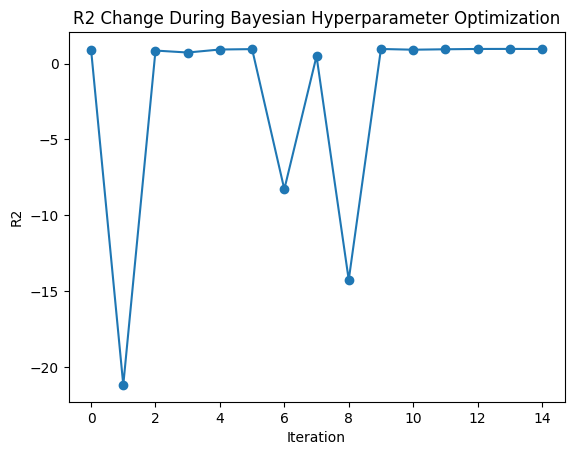

Original Dataset - RMSE: 18.408820200125117, R2: 0.9988455399524513, MAE: 12.038668547599547
External Dataset - RMSE: 465.95440673828125, R2: 0.26037123541693974, MAE: 353.3341064453125


In [14]:
# 提取每次迭代的最佳 R2
best_r2_list = []
for res in result.func_vals:
    best_r2_list.append(-res)  # 注意要取负数

# 绘制 R2 的变化过程图
plt.plot(best_r2_list, marker='o')
plt.xlabel('Iteration')
plt.ylabel('R2')
plt.title('R2 Change During Bayesian Hyperparameter Optimization')
plt.show()

import torch
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from sklearn.model_selection import train_test_split

target_column = 'Biogas Production'

# 分离特征和目标变量
X = data.drop(target_column, axis=1)
y = data[target_column]
X_external = external_data.drop(target_column, axis=1)
y_external = external_data[target_column]

# 标准化数据
X_normalized, feature_scaler = normalize_data(X)
y_normalized, target_scaler = normalize_data(y.values.reshape(-1, 1))

# 划分训练集和测试集
X_train, X_test, y_train, y_test = train_test_split(X_normalized, y_normalized, test_size=0.2, random_state=0)

# 转换为 PyTorch 张量
X_train_tensor = torch.from_numpy(X_train).float().to(device)
X_test_tensor = torch.from_numpy(X_test).float().to(device)
y_train_tensor = torch.from_numpy(y_train).float().to(device)
y_test_tensor = torch.from_numpy(y_test).float().to(device)

# 标准化外部数据集
X_external_normalized, _ = normalize_data(X_external)
y_external_normalized, _ = normalize_data(y_external.values.reshape(-1, 1))

# 转换外部数据为张量
X_external_tensor = torch.from_numpy(X_external_normalized).float().to(device)
y_external_tensor = torch.from_numpy(y_external_normalized).float().to(device)

# 模型预测函数
def model_predict(model, X_tensor):
    model.eval()
    with torch.no_grad():
        return model(X_tensor).cpu().numpy()

# 获取预测值
y_pred_train = model_predict(model, X_train_tensor).flatten()
y_pred_test = model_predict(model, X_test_tensor).flatten()
y_pred_external = model_predict(model, X_external_tensor).flatten()

# 反标准化预测值和实际值
y_pred_train_denorm = denormalize_data(y_pred_train.reshape(-1, 1), target_scaler).flatten()
y_pred_test_denorm = denormalize_data(y_pred_test.reshape(-1, 1), target_scaler).flatten()
y_pred_external_denorm = denormalize_data(y_pred_external.reshape(-1, 1), target_scaler).flatten()
y_train_denorm = denormalize_data(y_train, target_scaler).flatten()
y_test_denorm = denormalize_data(y_test, target_scaler).flatten()
y_external_denorm = denormalize_data(y_external_tensor.cpu().numpy(), target_scaler).flatten()


# 合并原始数据集和外部数据集的预测值和实际值
original_data_actual = np.concatenate([y_train_denorm, y_test_denorm])
original_data_predicted = np.concatenate([y_pred_train_denorm, y_pred_test_denorm])
external_data_actual = y_external_denorm
external_data_predicted = y_pred_external_denorm

# 创建 DataFrame
combined_df = pd.DataFrame({
    'Actual': np.concatenate([original_data_actual, external_data_actual]),
    'Predicted': np.concatenate([original_data_predicted, external_data_predicted]),
    'Dataset': ['Original'] * len(original_data_actual) + ['External'] * len(external_data_actual)
})

# 计算原始数据集的指标
train_r2 = r2_score(original_data_actual, original_data_predicted)
train_rmse = mean_squared_error(original_data_actual, original_data_predicted, squared=False)
train_mae = mean_absolute_error(original_data_actual, original_data_predicted)

# 计算外部数据集的指标
external_r2 = r2_score(external_data_actual, external_data_predicted)
external_rmse = mean_squared_error(external_data_actual, external_data_predicted, squared=False)
external_mae = mean_absolute_error(external_data_actual, external_data_predicted)


print(f"Original Dataset - RMSE: {train_rmse}, R2: {train_r2}, MAE: {train_mae}")
print(f"External Dataset - RMSE: {external_rmse}, R2: {external_r2}, MAE: {external_mae}")

Best parameters: [1500, 2.124364225046061e-11, 3.374741902601247e-05, 0.8, 1e-07]


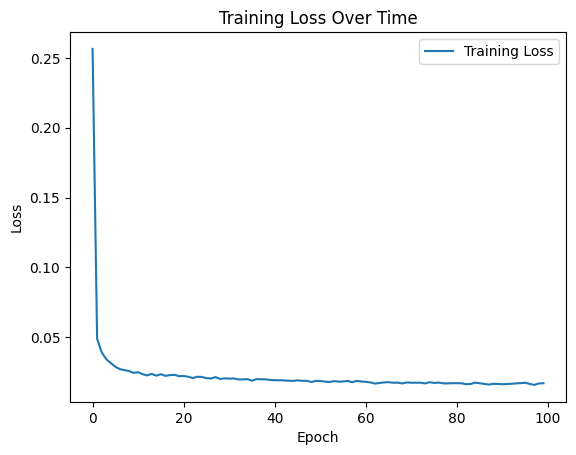

Task Train RMSE: 18.342878341674805, Train R2: 0.997388170524524, Train MAE: 14.680096626281738
Task Test RMSE: 11.649828910827637, Test R2: 0.999261394339703, Test MAE: 10.898422241210938
Task Train RMSE: 17.859943389892578, Train R2: 0.9981677522577797, Train MAE: 14.225706100463867
Task Test RMSE: 14.340580940246582, Test R2: 0.96046420684084, Test MAE: 12.715954780578613
Task Train RMSE: 16.692161560058594, Train R2: 0.9980421895628997, Train MAE: 13.379846572875977
Task Test RMSE: 19.158525466918945, Test R2: 0.9973239518933549, Test MAE: 16.099384307861328
Task Train RMSE: 14.792442321777344, Train R2: 0.9978587683296798, Train MAE: 13.025575637817383
Task Test RMSE: 24.623085021972656, Test R2: 0.9979202797768881, Test MAE: 17.516464233398438
Task Train RMSE: 18.129507064819336, Train R2: 0.9979522565337774, Train MAE: 14.307546615600586
Task Test RMSE: 12.916913032531738, Test R2: 0.9974242355908308, Test MAE: 12.388592720031738
Task Train RMSE: 17.813480377197266, Train R2: 0.

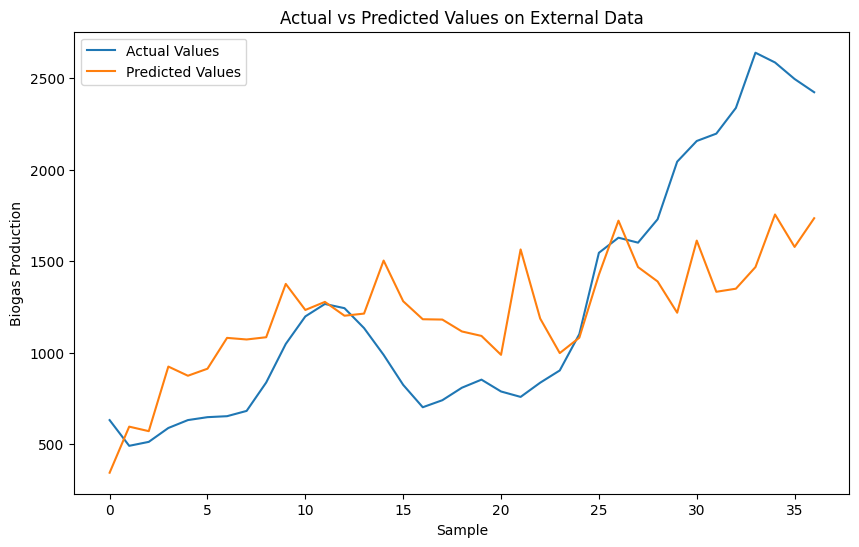

External Dataset - RMSE: 491.692626953125, R2: 0.4496962070795938, MAE: 385.67364501953125


In [15]:
import torch
from torch import nn, optim
import torch.nn.functional as F
import numpy as np
import pandas as pd
from sklearn.preprocessing import StandardScaler
import learn2learn as l2l
from sklearn.model_selection import train_test_split, KFold
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from skopt import gp_minimize
from skopt.space import Real, Integer
from skopt.utils import use_named_args
import matplotlib.pyplot as plt
from torch.utils.data import DataLoader, TensorDataset

# 设置随机种子
np.random.seed(0)
torch.manual_seed(0)

device = torch.device("cuda:0")  # Use GPU 0

# Hyperparameter search space
search_space = [
    Integer(500, 1500, name='hidden_size'), 
    Real(1e-11, 1e-6, "log-uniform", name='alpha'),  
    Real(1e-7, 1e-3, "log-uniform", name='beta'),
    Real(0.1, 0.8, name='dropout_rate'), 
    Real(1e-7, 1e-1, "log-uniform", name='weight_decay') 
]

# Data normalization and denormalization functions
def normalize_data(data):
    scaler = StandardScaler()
    return scaler.fit_transform(data), scaler

def normalize_feature(data, column_name):
    scaler = StandardScaler()
    scaled_data = scaler.fit_transform(data[[column_name]])
    return scaled_data, scaler

def denormalize_data(normalized_data, scaler):
    return scaler.inverse_transform(normalized_data)

# 加载和规范化数据
data = pd.read_csv("C:\\Users\\Lenovo\\Desktop\\元学习\\BT3-1.csv")
data_normalized, scaler = normalize_data(data)

# 假设您的目标列名为'GI(%)'
target_normalized, target_scaler = normalize_data(data[['Biogas Production']].values)
# 元学习模型定义
class AdvancedNeuralNetwork(nn.Module):
    def __init__(self, input_size, hidden_size, dropout_rate):
        super(AdvancedNeuralNetwork, self).__init__()
        self.layer1 = nn.Linear(input_size, hidden_size)
        self.relu1 = nn.LeakyReLU()
        self.layer2 = nn.Linear(hidden_size, hidden_size // 2)
        self.relu2 = nn.LeakyReLU()
        self.layer3 = nn.Linear(hidden_size // 2, hidden_size // 4)
        self.relu3 = nn.LeakyReLU()
        self.dropout = nn.Dropout(dropout_rate)
        self.layer4 = nn.Linear(hidden_size // 4, 1)

    def forward(self, x):
        x = self.relu1(self.layer1(x))
        x = self.relu2(self.layer2(x))
        x = self.relu3(self.layer3(x))
        x = self.dropout(x)
        x = self.layer4(x)
        return x

# 其他辅助函数和类（如EarlyStopping, create_tasks等）根据需要添加
# Task creation function
def create_tasks(data, target_column, num_tasks=50, task_size=100):
    tasks = []
    for _ in range(num_tasks):
        task_data = data.sample(task_size)
        X, y = task_data.drop(target_column, axis=1), task_data[target_column]
        tasks.append((X, y))
    return tasks

# Early stopping class
class EarlyStopping:
    def __init__(self, patience=5, delta=0):
        self.patience = patience
        self.counter = 0
        self.best_score = None
        self.early_stop = False
        self.delta = delta

    def __call__(self, val_loss, model):
        score = -val_loss
        if self.best_score is None:
            self.best_score = score
        elif score < self.best_score + self.delta:
            self.counter += 1
            if self.counter >= self.patience:
                self.early_stop = True
        else:
            self.best_score = score
            self.counter = 0

# GAN的生成器定义
class Generator(nn.Module):
    def __init__(self, input_size, hidden_dim, output_size):
        super(Generator, self).__init__()
        self.fc1 = nn.Linear(input_size, hidden_dim)
        self.fc2 = nn.Linear(hidden_dim, hidden_dim * 2)
        self.fc3 = nn.Linear(hidden_dim * 2, hidden_dim * 4)
        self.fc4 = nn.Linear(hidden_dim * 4, output_size)

    def forward(self, x):
        x = F.leaky_relu(self.fc1(x), 0.2)
        x = F.leaky_relu(self.fc2(x), 0.2)
        x = F.leaky_relu(self.fc3(x), 0.2)
        x = torch.tanh(self.fc4(x))
        return x

# GAN的判别器定义
class Discriminator(nn.Module):
    def __init__(self, input_size, hidden_dim):
        super(Discriminator, self).__init__()
        self.fc1 = nn.Linear(input_size, hidden_dim * 4)
        self.fc2 = nn.Linear(hidden_dim * 4, hidden_dim * 2)
        self.fc3 = nn.Linear(hidden_dim * 2, hidden_dim)
        self.fc4 = nn.Linear(hidden_dim, 1)

    def forward(self, x):
        x = F.leaky_relu(self.fc1(x), 0.2)
        x = F.leaky_relu(self.fc2(x), 0.2)
        x = F.leaky_relu(self.fc3(x), 0.2)
        x = torch.sigmoid(self.fc4(x))
        return x

# MAML fast adaptation and meta-training
def meta_train_maml(model, tasks, alpha, beta, weight_decay, epochs=100, num_steps=1):
    early_stopping = EarlyStopping(patience=10, delta=0.01)
    optimizer = optim.Adam(model.parameters(), lr=beta, weight_decay=weight_decay)
    scheduler = optim.lr_scheduler.CosineAnnealingLR(optimizer, T_max=epochs)

    epoch_loss_list = []  # Initialize a list to store losses for each epoch

    for epoch in range(epochs):
        epoch_losses = []
        for task in tasks:
            learner = model.clone()  # Clone the model
            task_X, task_y = task
            task_X = torch.from_numpy(task_X.values).float().to(device)
            task_y = torch.from_numpy(task_y.values).float().to(device)

            # Fast adaptation
            for step in range(num_steps):
                pred_y = learner(task_X)
                loss = nn.functional.mse_loss(pred_y.squeeze(), task_y)
                learner.adapt(loss)

            # Meta-update
            optimizer.zero_grad()
            pred_y = learner(task_X)
            loss = nn.functional.mse_loss(pred_y.squeeze(), task_y)
            epoch_losses.append(loss.item())
            loss.backward()
            optimizer.step()

        scheduler.step()  # Update learning rate
        average_loss = np.mean(epoch_losses)
        epoch_loss_list.append(average_loss)  # Add each epoch's average loss to the list

        if early_stopping(average_loss, model):
            print(f"Early stopping triggered at epoch {epoch}")
            break

    return epoch_loss_list  # Return the list of epoch losses



@use_named_args(search_space)
def objective(hidden_size, alpha, beta, dropout_rate, weight_decay):
    model = AdvancedNeuralNetwork(input_size, hidden_size, dropout_rate)
    model = l2l.algorithms.MAML(model, lr=alpha).to(device)
    avg_r2 = 0

    task_r2_list = []  # 记录每个任务的 R2

    for task in tasks:
        task_X, task_y = task
        task_X_train, task_X_test, task_y_train, task_y_test = train_test_split(task_X, task_y, test_size=0.2, random_state=0)
        meta_train_maml(model, [(task_X_train, task_y_train)], alpha, beta, weight_decay, epochs=100)
        train_rmse, train_r2, train_mae, test_rmse, test_r2, test_mae = evaluate_model(model, task_X_train, task_y_train, task_X_test, task_y_test, target_scaler)
        task_r2_list.append(test_r2)  # 记录每个任务的测试 R2
        avg_r2 += test_r2

    avg_r2 /= len(tasks)
    return -avg_r2  # 这里返回负数因为 skopt 的目标函数是最小化，而我们想要最大化 R2

# Evaluation function
def evaluate_model(model, X_train, y_train, X_test, y_test, target_scaler):
    model.eval()
    with torch.no_grad():
        # Convert data to tensors
        X_train_tensor = torch.from_numpy(X_train.values).float().to(device)
        y_train_tensor = torch.from_numpy(y_train.values).float().to(device)
        X_test_tensor = torch.from_numpy(X_test.values).float().to(device)
        y_test_tensor = torch.from_numpy(y_test.values).float().to(device)

        # Get predictions
        train_predictions = model(X_train_tensor).squeeze().cpu().numpy()
        test_predictions = model(X_test_tensor).squeeze().cpu().numpy()

        # Reshape predictions for denormalization
        train_predictions_reshaped = train_predictions.reshape(-1, 1)
        test_predictions_reshaped = test_predictions.reshape(-1, 1)

        # Denormalize predictions using target_scaler
        train_predictions_denorm = denormalize_data(train_predictions_reshaped, target_scaler)
        test_predictions_denorm = denormalize_data(test_predictions_reshaped, target_scaler)

        # Denormalize actual values using target_scaler
        y_train_denorm = denormalize_data(y_train_tensor.cpu().numpy().reshape(-1, 1), target_scaler)
        y_test_denorm = denormalize_data(y_test_tensor.cpu().numpy().reshape(-1, 1), target_scaler)

        # Calculate metrics using denormalized data
        train_rmse = mean_squared_error(y_train_denorm, train_predictions_denorm, squared=False)
        train_r2 = r2_score(y_train_denorm, train_predictions_denorm)
        train_mae = mean_absolute_error(y_train_denorm, train_predictions_denorm)

        test_rmse = mean_squared_error(y_test_denorm, test_predictions_denorm, squared=False)
        test_r2 = r2_score(y_test_denorm, test_predictions_denorm)
        test_mae = mean_absolute_error(y_test_denorm, test_predictions_denorm)

    return train_rmse, train_r2, train_mae, test_rmse, test_r2, test_mae

# 设置GAN训练参数
z_dim = 100  # 潜在空间的维度
gen_hidden_dim = 128
dis_hidden_dim = 128
lr = 0.0002
batch_size = 64
num_epochs = 50

# 初始化模型
generator = Generator(z_dim, gen_hidden_dim, data_normalized.shape[1]).to(device)
discriminator = Discriminator(data_normalized.shape[1], dis_hidden_dim).to(device)

# 优化器
optim_g = optim.Adam(generator.parameters(), lr=lr)
optim_d = optim.Adam(discriminator.parameters(), lr=lr)

tensor_data = torch.Tensor(data_normalized)
data_loader = DataLoader(tensor_data, batch_size=batch_size, shuffle=True)

# GAN训练循环
for epoch in range(num_epochs):
    for batch in data_loader:
        current_batch_size = len(batch)  # Get the actual batch size
        real_data = batch.to(device)
        real_labels = torch.ones(current_batch_size, 1).to(device)  # Adjust label size based on batch
        fake_data = generator(torch.randn(current_batch_size, z_dim).to(device))  # Generate fake data based on current batch size
        fake_labels = torch.zeros(current_batch_size, 1).to(device)  # Adjust fake label size

        # 训练判别器
        optim_d.zero_grad()
        real_output = discriminator(real_data)
        fake_output = discriminator(fake_data)
        d_loss_real = nn.BCEWithLogitsLoss()(real_output, real_labels)
        d_loss_fake = nn.BCEWithLogitsLoss()(fake_output, fake_labels)
        d_loss = d_loss_real + d_loss_fake
        d_loss.backward()
        optim_d.step()

        # 训练生成器
        optim_g.zero_grad()
        fake_data = generator(torch.randn(current_batch_size, z_dim).to(device))  # Regenerate fake data
        fake_output = discriminator(fake_data)
        g_loss = nn.BCEWithLogitsLoss()(fake_output, real_labels)  # Use real_labels here
        g_loss.backward()
        optim_g.step()

# 假设您想生成一定数量的新样本
number_of_generated_samples = 500

# 生成新的数据样本
generated_samples = []
for _ in range(number_of_generated_samples):
    z = torch.randn(1, z_dim).to(device)
    generated_sample = generator(z).detach().cpu().numpy()
    generated_samples.append(generated_sample.reshape(-1))

generated_samples = np.array(generated_samples)

# 将生成的样本合并到现有数据中
extended_data = np.vstack([data_normalized, generated_samples])

# 创建增强的数据集任务
# 这里假设您已经定义了创建任务的函数
input_size = data.shape[1] - 1 
tasks = create_tasks(pd.DataFrame(extended_data, columns=data.columns), target_column='Biogas Production')
# Execute hyperparameter optimization
result = gp_minimize(objective, search_space, n_calls=15,random_state=0)
hidden_size, alpha, beta, dropout_rate, weight_decay = result.x
print("Best parameters:", result.x)

# Train model with optimized hyperparameters
model = AdvancedNeuralNetwork(input_size, hidden_size, dropout_rate)
model = l2l.algorithms.MAML(model, lr=alpha).to(device)
train_losses = meta_train_maml(model, tasks, alpha, beta, weight_decay, epochs=100)

# Visualize training losses
plt.plot(train_losses, label='Training Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training Loss Over Time')
plt.legend()
plt.show()

# Final model evaluation
for task in tasks:
    X, y = task
    kf = KFold(n_splits=5, shuffle=True, random_state=0)
    for train_index, test_index in kf.split(X):
        X_train, X_test = X.iloc[train_index], X.iloc[test_index]
        y_train, y_test = y.iloc[train_index], y.iloc[test_index]
        train_rmse, train_r2, train_mae, test_rmse, test_r2, test_mae = evaluate_model(model, X_train, y_train, X_test, y_test, target_scaler)
        print(f"Task Train RMSE: {train_rmse}, Train R2: {train_r2}, Train MAE: {train_mae}")
        print(f"Task Test RMSE: {test_rmse}, Test R2: {test_r2}, Test MAE: {test_mae}")
# Load and process external data for evaluation
external_data = pd.read_csv("C:\\Users\\Lenovo\\Desktop\\元学习\\BT3-2.csv")
external_data_normalized, _ = normalize_data(external_data)
external_target_normalized, _ = normalize_feature(external_data, 'Biogas Production')
external_X = torch.from_numpy(pd.DataFrame(external_data_normalized, columns=external_data.columns).drop('Biogas Production', axis=1).values).float().to(device)
external_y_normalized = torch.from_numpy(external_target_normalized).float().to(device)

# Model prediction on external data
learner = model.clone()  # Clone the model for evaluation
learner.eval()
with torch.no_grad():
    external_predictions_normalized = learner(external_X).squeeze()
external_predictions = denormalize_data(external_predictions_normalized.cpu().numpy().reshape(-1, 1), target_scaler)
external_y = denormalize_data(external_y_normalized.cpu().numpy().reshape(-1, 1), target_scaler)

# Visualization of predictions on external data
plt.figure(figsize=(10, 6))
plt.plot(external_y, label='Actual Values')
plt.plot(external_predictions, label='Predicted Values')
plt.xlabel('Sample')
plt.ylabel('Biogas Production')
plt.title('Actual vs Predicted Values on External Data')
plt.legend()
plt.show()

# Evaluate on external dataset using denormalized data
external_rmse = mean_squared_error(external_y, external_predictions, squared=False)
external_r2 = r2_score(external_y, external_predictions)
external_mae = mean_absolute_error(external_y, external_predictions)

print(f"External Dataset - RMSE: {external_rmse}, R2: {external_r2}, MAE: {external_mae}")

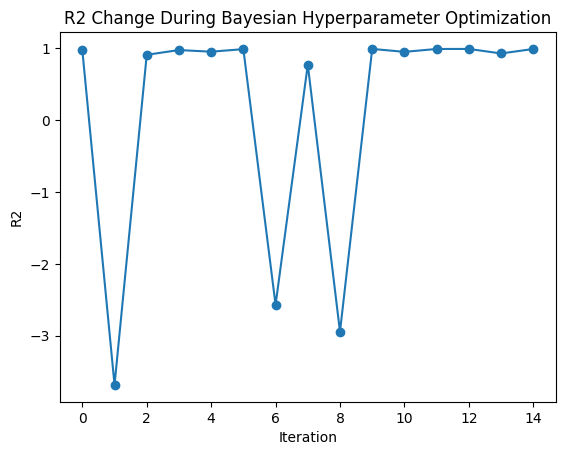

Original Dataset - RMSE: 31.25569682269544, R2: 0.9977763137672284, MAE: 22.993894638433698
External Dataset - RMSE: 491.692626953125, R2: 0.4496962070795938, MAE: 385.67364501953125


In [16]:
# 提取每次迭代的最佳 R2
best_r2_list = []
for res in result.func_vals:
    best_r2_list.append(-res)  # 注意要取负数

# 绘制 R2 的变化过程图
plt.plot(best_r2_list, marker='o')
plt.xlabel('Iteration')
plt.ylabel('R2')
plt.title('R2 Change During Bayesian Hyperparameter Optimization')
plt.show()

import torch
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from sklearn.model_selection import train_test_split

target_column = 'Biogas Production'

# 分离特征和目标变量
X = data.drop(target_column, axis=1)
y = data[target_column]
X_external = external_data.drop(target_column, axis=1)
y_external = external_data[target_column]

# 标准化数据
X_normalized, feature_scaler = normalize_data(X)
y_normalized, target_scaler = normalize_data(y.values.reshape(-1, 1))

# 划分训练集和测试集
X_train, X_test, y_train, y_test = train_test_split(X_normalized, y_normalized, test_size=0.2, random_state=0)

# 转换为 PyTorch 张量
X_train_tensor = torch.from_numpy(X_train).float().to(device)
X_test_tensor = torch.from_numpy(X_test).float().to(device)
y_train_tensor = torch.from_numpy(y_train).float().to(device)
y_test_tensor = torch.from_numpy(y_test).float().to(device)

# 标准化外部数据集
X_external_normalized, _ = normalize_data(X_external)
y_external_normalized, _ = normalize_data(y_external.values.reshape(-1, 1))

# 转换外部数据为张量
X_external_tensor = torch.from_numpy(X_external_normalized).float().to(device)
y_external_tensor = torch.from_numpy(y_external_normalized).float().to(device)

# 模型预测函数
def model_predict(model, X_tensor):
    model.eval()
    with torch.no_grad():
        return model(X_tensor).cpu().numpy()

# 获取预测值
y_pred_train = model_predict(model, X_train_tensor).flatten()
y_pred_test = model_predict(model, X_test_tensor).flatten()
y_pred_external = model_predict(model, X_external_tensor).flatten()

# 反标准化预测值和实际值
y_pred_train_denorm = denormalize_data(y_pred_train.reshape(-1, 1), target_scaler).flatten()
y_pred_test_denorm = denormalize_data(y_pred_test.reshape(-1, 1), target_scaler).flatten()
y_pred_external_denorm = denormalize_data(y_pred_external.reshape(-1, 1), target_scaler).flatten()
y_train_denorm = denormalize_data(y_train, target_scaler).flatten()
y_test_denorm = denormalize_data(y_test, target_scaler).flatten()
y_external_denorm = denormalize_data(y_external_tensor.cpu().numpy(), target_scaler).flatten()


# 合并原始数据集和外部数据集的预测值和实际值
original_data_actual = np.concatenate([y_train_denorm, y_test_denorm])
original_data_predicted = np.concatenate([y_pred_train_denorm, y_pred_test_denorm])
external_data_actual = y_external_denorm
external_data_predicted = y_pred_external_denorm

# 创建 DataFrame
combined_df = pd.DataFrame({
    'Actual': np.concatenate([original_data_actual, external_data_actual]),
    'Predicted': np.concatenate([original_data_predicted, external_data_predicted]),
    'Dataset': ['Original'] * len(original_data_actual) + ['External'] * len(external_data_actual)
})

# 计算原始数据集的指标
train_r2 = r2_score(original_data_actual, original_data_predicted)
train_rmse = mean_squared_error(original_data_actual, original_data_predicted, squared=False)
train_mae = mean_absolute_error(original_data_actual, original_data_predicted)

# 计算外部数据集的指标
external_r2 = r2_score(external_data_actual, external_data_predicted)
external_rmse = mean_squared_error(external_data_actual, external_data_predicted, squared=False)
external_mae = mean_absolute_error(external_data_actual, external_data_predicted)


print(f"Original Dataset - RMSE: {train_rmse}, R2: {train_r2}, MAE: {train_mae}")
print(f"External Dataset - RMSE: {external_rmse}, R2: {external_r2}, MAE: {external_mae}")

Best parameters: [793, 1e-11, 0.00012726989661046066, 0.8, 1e-07]


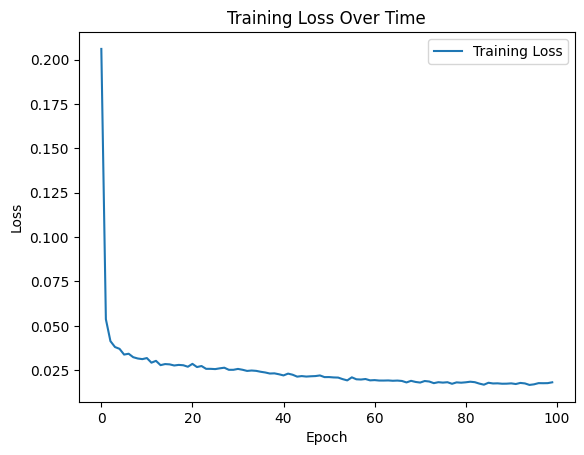

Task Train RMSE: 21.057100296020508, Train R2: 0.9969102303121002, Train MAE: 16.096160888671875
Task Test RMSE: 21.13509750366211, Test R2: 0.9949176001201878, Test MAE: 15.48998737335205
Task Train RMSE: 21.567581176757812, Train R2: 0.9969607189678942, Train MAE: 16.08833885192871
Task Test RMSE: 18.96455955505371, Test R2: 0.9939520450763031, Test MAE: 15.521258354187012
Task Train RMSE: 21.672977447509766, Train R2: 0.9962962000169598, Train MAE: 16.104324340820312
Task Test RMSE: 18.477699279785156, Test R2: 0.9979376354717906, Test MAE: 15.457326889038086
Task Train RMSE: 22.350242614746094, Train R2: 0.9963834159364137, Train MAE: 17.01299285888672
Task Test RMSE: 14.905123710632324, Test R2: 0.9980369752854978, Test MAE: 11.822641372680664
Task Train RMSE: 18.50629425048828, Train R2: 0.9969014304772859, Train MAE: 14.572790145874023
Task Test RMSE: 29.160968780517578, Test R2: 0.9962927451392329, Test MAE: 21.583423614501953
Task Train RMSE: 23.761964797973633, Train R2: 0.99

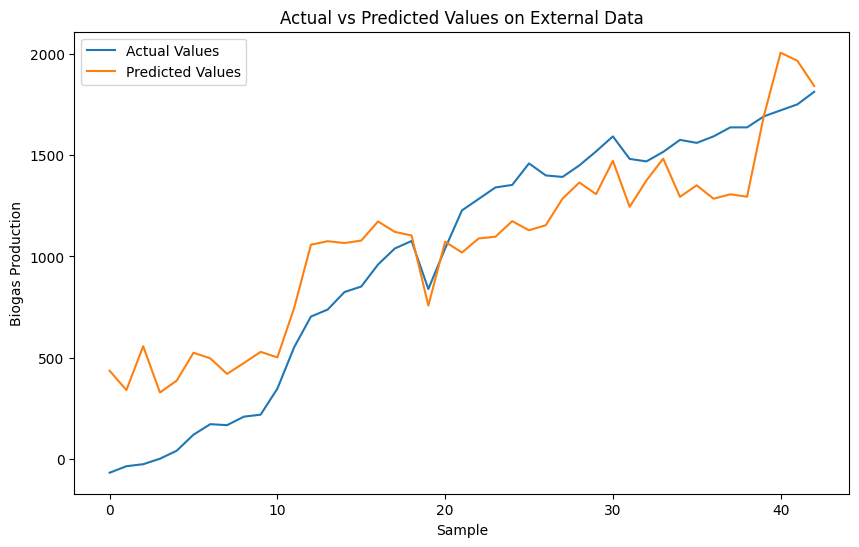

External Dataset - RMSE: 263.3700256347656, R2: 0.8121786144587597, MAE: 230.60890197753906


In [17]:
import torch
from torch import nn, optim
import torch.nn.functional as F
import numpy as np
import pandas as pd
from sklearn.preprocessing import StandardScaler
import learn2learn as l2l
from sklearn.model_selection import train_test_split, KFold
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from skopt import gp_minimize
from skopt.space import Real, Integer
from skopt.utils import use_named_args
import matplotlib.pyplot as plt
from torch.utils.data import DataLoader, TensorDataset

# 设置随机种子
np.random.seed(0)
torch.manual_seed(0)

device = torch.device("cuda:0")  # Use GPU 0

# Hyperparameter search space
search_space = [
    Integer(500, 1500, name='hidden_size'), 
    Real(1e-11, 1e-6, "log-uniform", name='alpha'),  
    Real(1e-7, 1e-3, "log-uniform", name='beta'),
    Real(0.1, 0.8, name='dropout_rate'), 
    Real(1e-7, 1e-1, "log-uniform", name='weight_decay') 
]

# Data normalization and denormalization functions
def normalize_data(data):
    scaler = StandardScaler()
    return scaler.fit_transform(data), scaler

def normalize_feature(data, column_name):
    scaler = StandardScaler()
    scaled_data = scaler.fit_transform(data[[column_name]])
    return scaled_data, scaler

def denormalize_data(normalized_data, scaler):
    return scaler.inverse_transform(normalized_data)

# 加载和规范化数据
data = pd.read_csv("C:\\Users\\Lenovo\\Desktop\\元学习\\BT4-1.csv")
data_normalized, scaler = normalize_data(data)

target_normalized, target_scaler = normalize_data(data[['Biogas Production']].values)
# 元学习模型定义
class AdvancedNeuralNetwork(nn.Module):
    def __init__(self, input_size, hidden_size, dropout_rate):
        super(AdvancedNeuralNetwork, self).__init__()
        self.layer1 = nn.Linear(input_size, hidden_size)
        self.relu1 = nn.LeakyReLU()
        self.layer2 = nn.Linear(hidden_size, hidden_size // 2)
        self.relu2 = nn.LeakyReLU()
        self.layer3 = nn.Linear(hidden_size // 2, hidden_size // 4)
        self.relu3 = nn.LeakyReLU()
        self.dropout = nn.Dropout(dropout_rate)
        self.layer4 = nn.Linear(hidden_size // 4, 1)

    def forward(self, x):
        x = self.relu1(self.layer1(x))
        x = self.relu2(self.layer2(x))
        x = self.relu3(self.layer3(x))
        x = self.dropout(x)
        x = self.layer4(x)
        return x

# 其他辅助函数和类（如EarlyStopping, create_tasks等）根据需要添加
# Task creation function
def create_tasks(data, target_column, num_tasks=50, task_size=100):
    tasks = []
    for _ in range(num_tasks):
        task_data = data.sample(task_size)
        X, y = task_data.drop(target_column, axis=1), task_data[target_column]
        tasks.append((X, y))
    return tasks

# Early stopping class
class EarlyStopping:
    def __init__(self, patience=5, delta=0):
        self.patience = patience
        self.counter = 0
        self.best_score = None
        self.early_stop = False
        self.delta = delta

    def __call__(self, val_loss, model):
        score = -val_loss
        if self.best_score is None:
            self.best_score = score
        elif score < self.best_score + self.delta:
            self.counter += 1
            if self.counter >= self.patience:
                self.early_stop = True
        else:
            self.best_score = score
            self.counter = 0

# GAN的生成器定义
class Generator(nn.Module):
    def __init__(self, input_size, hidden_dim, output_size):
        super(Generator, self).__init__()
        self.fc1 = nn.Linear(input_size, hidden_dim)
        self.fc2 = nn.Linear(hidden_dim, hidden_dim * 2)
        self.fc3 = nn.Linear(hidden_dim * 2, hidden_dim * 4)
        self.fc4 = nn.Linear(hidden_dim * 4, output_size)

    def forward(self, x):
        x = F.leaky_relu(self.fc1(x), 0.2)
        x = F.leaky_relu(self.fc2(x), 0.2)
        x = F.leaky_relu(self.fc3(x), 0.2)
        x = torch.tanh(self.fc4(x))
        return x

# GAN的判别器定义
class Discriminator(nn.Module):
    def __init__(self, input_size, hidden_dim):
        super(Discriminator, self).__init__()
        self.fc1 = nn.Linear(input_size, hidden_dim * 4)
        self.fc2 = nn.Linear(hidden_dim * 4, hidden_dim * 2)
        self.fc3 = nn.Linear(hidden_dim * 2, hidden_dim)
        self.fc4 = nn.Linear(hidden_dim, 1)

    def forward(self, x):
        x = F.leaky_relu(self.fc1(x), 0.2)
        x = F.leaky_relu(self.fc2(x), 0.2)
        x = F.leaky_relu(self.fc3(x), 0.2)
        x = torch.sigmoid(self.fc4(x))
        return x

# MAML fast adaptation and meta-training
def meta_train_maml(model, tasks, alpha, beta, weight_decay, epochs=100, num_steps=1):
    early_stopping = EarlyStopping(patience=10, delta=0.01)
    optimizer = optim.Adam(model.parameters(), lr=beta, weight_decay=weight_decay)
    scheduler = optim.lr_scheduler.CosineAnnealingLR(optimizer, T_max=epochs)

    epoch_loss_list = []  # Initialize a list to store losses for each epoch

    for epoch in range(epochs):
        epoch_losses = []
        for task in tasks:
            learner = model.clone()  # Clone the model
            task_X, task_y = task
            task_X = torch.from_numpy(task_X.values).float().to(device)
            task_y = torch.from_numpy(task_y.values).float().to(device)

            # Fast adaptation
            for step in range(num_steps):
                pred_y = learner(task_X)
                loss = nn.functional.mse_loss(pred_y.squeeze(), task_y)
                learner.adapt(loss)

            # Meta-update
            optimizer.zero_grad()
            pred_y = learner(task_X)
            loss = nn.functional.mse_loss(pred_y.squeeze(), task_y)
            epoch_losses.append(loss.item())
            loss.backward()
            optimizer.step()

        scheduler.step()  # Update learning rate
        average_loss = np.mean(epoch_losses)
        epoch_loss_list.append(average_loss)  # Add each epoch's average loss to the list

        if early_stopping(average_loss, model):
            print(f"Early stopping triggered at epoch {epoch}")
            break

    return epoch_loss_list  # Return the list of epoch losses



@use_named_args(search_space)
def objective(hidden_size, alpha, beta, dropout_rate, weight_decay):
    model = AdvancedNeuralNetwork(input_size, hidden_size, dropout_rate)
    model = l2l.algorithms.MAML(model, lr=alpha).to(device)
    avg_r2 = 0

    task_r2_list = []  # 记录每个任务的 R2

    for task in tasks:
        task_X, task_y = task
        task_X_train, task_X_test, task_y_train, task_y_test = train_test_split(task_X, task_y, test_size=0.2, random_state=0)
        meta_train_maml(model, [(task_X_train, task_y_train)], alpha, beta, weight_decay, epochs=100)
        train_rmse, train_r2, train_mae, test_rmse, test_r2, test_mae = evaluate_model(model, task_X_train, task_y_train, task_X_test, task_y_test, target_scaler)
        task_r2_list.append(test_r2)  # 记录每个任务的测试 R2
        avg_r2 += test_r2

    avg_r2 /= len(tasks)
    return -avg_r2  # 这里返回负数因为 skopt 的目标函数是最小化，而我们想要最大化 R2

# Evaluation function
def evaluate_model(model, X_train, y_train, X_test, y_test, target_scaler):
    model.eval()
    with torch.no_grad():
        # Convert data to tensors
        X_train_tensor = torch.from_numpy(X_train.values).float().to(device)
        y_train_tensor = torch.from_numpy(y_train.values).float().to(device)
        X_test_tensor = torch.from_numpy(X_test.values).float().to(device)
        y_test_tensor = torch.from_numpy(y_test.values).float().to(device)

        # Get predictions
        train_predictions = model(X_train_tensor).squeeze().cpu().numpy()
        test_predictions = model(X_test_tensor).squeeze().cpu().numpy()

        # Reshape predictions for denormalization
        train_predictions_reshaped = train_predictions.reshape(-1, 1)
        test_predictions_reshaped = test_predictions.reshape(-1, 1)

        # Denormalize predictions using target_scaler
        train_predictions_denorm = denormalize_data(train_predictions_reshaped, target_scaler)
        test_predictions_denorm = denormalize_data(test_predictions_reshaped, target_scaler)

        # Denormalize actual values using target_scaler
        y_train_denorm = denormalize_data(y_train_tensor.cpu().numpy().reshape(-1, 1), target_scaler)
        y_test_denorm = denormalize_data(y_test_tensor.cpu().numpy().reshape(-1, 1), target_scaler)

        # Calculate metrics using denormalized data
        train_rmse = mean_squared_error(y_train_denorm, train_predictions_denorm, squared=False)
        train_r2 = r2_score(y_train_denorm, train_predictions_denorm)
        train_mae = mean_absolute_error(y_train_denorm, train_predictions_denorm)

        test_rmse = mean_squared_error(y_test_denorm, test_predictions_denorm, squared=False)
        test_r2 = r2_score(y_test_denorm, test_predictions_denorm)
        test_mae = mean_absolute_error(y_test_denorm, test_predictions_denorm)

    return train_rmse, train_r2, train_mae, test_rmse, test_r2, test_mae

# 设置GAN训练参数
z_dim = 100  # 潜在空间的维度
gen_hidden_dim = 128
dis_hidden_dim = 128
lr = 0.0002
batch_size = 64
num_epochs = 50

# 初始化模型
generator = Generator(z_dim, gen_hidden_dim, data_normalized.shape[1]).to(device)
discriminator = Discriminator(data_normalized.shape[1], dis_hidden_dim).to(device)

# 优化器
optim_g = optim.Adam(generator.parameters(), lr=lr)
optim_d = optim.Adam(discriminator.parameters(), lr=lr)

tensor_data = torch.Tensor(data_normalized)
data_loader = DataLoader(tensor_data, batch_size=batch_size, shuffle=True)

# GAN训练循环
for epoch in range(num_epochs):
    for batch in data_loader:
        current_batch_size = len(batch)  # Get the actual batch size
        real_data = batch.to(device)
        real_labels = torch.ones(current_batch_size, 1).to(device)  # Adjust label size based on batch
        fake_data = generator(torch.randn(current_batch_size, z_dim).to(device))  # Generate fake data based on current batch size
        fake_labels = torch.zeros(current_batch_size, 1).to(device)  # Adjust fake label size

        # 训练判别器
        optim_d.zero_grad()
        real_output = discriminator(real_data)
        fake_output = discriminator(fake_data)
        d_loss_real = nn.BCEWithLogitsLoss()(real_output, real_labels)
        d_loss_fake = nn.BCEWithLogitsLoss()(fake_output, fake_labels)
        d_loss = d_loss_real + d_loss_fake
        d_loss.backward()
        optim_d.step()

        # 训练生成器
        optim_g.zero_grad()
        fake_data = generator(torch.randn(current_batch_size, z_dim).to(device))  # Regenerate fake data
        fake_output = discriminator(fake_data)
        g_loss = nn.BCEWithLogitsLoss()(fake_output, real_labels)  # Use real_labels here
        g_loss.backward()
        optim_g.step()

# 假设您想生成一定数量的新样本
number_of_generated_samples = 500

# 生成新的数据样本
generated_samples = []
for _ in range(number_of_generated_samples):
    z = torch.randn(1, z_dim).to(device)
    generated_sample = generator(z).detach().cpu().numpy()
    generated_samples.append(generated_sample.reshape(-1))

generated_samples = np.array(generated_samples)

# 将生成的样本合并到现有数据中
extended_data = np.vstack([data_normalized, generated_samples])

# 创建增强的数据集任务
# 这里假设您已经定义了创建任务的函数
input_size = data.shape[1] - 1 
tasks = create_tasks(pd.DataFrame(extended_data, columns=data.columns), target_column='Biogas Production')
# Execute hyperparameter optimization
result = gp_minimize(objective, search_space, n_calls=15,random_state=0)
hidden_size, alpha, beta, dropout_rate, weight_decay = result.x
print("Best parameters:", result.x)

# Train model with optimized hyperparameters
model = AdvancedNeuralNetwork(input_size, hidden_size, dropout_rate)
model = l2l.algorithms.MAML(model, lr=alpha).to(device)
train_losses = meta_train_maml(model, tasks, alpha, beta, weight_decay, epochs=100)

# Visualize training losses
plt.plot(train_losses, label='Training Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training Loss Over Time')
plt.legend()
plt.show()

# Final model evaluation
for task in tasks:
    X, y = task
    kf = KFold(n_splits=5, shuffle=True, random_state=0)
    for train_index, test_index in kf.split(X):
        X_train, X_test = X.iloc[train_index], X.iloc[test_index]
        y_train, y_test = y.iloc[train_index], y.iloc[test_index]
        train_rmse, train_r2, train_mae, test_rmse, test_r2, test_mae = evaluate_model(model, X_train, y_train, X_test, y_test, target_scaler)
        print(f"Task Train RMSE: {train_rmse}, Train R2: {train_r2}, Train MAE: {train_mae}")
        print(f"Task Test RMSE: {test_rmse}, Test R2: {test_r2}, Test MAE: {test_mae}")
# Load and process external data for evaluation
external_data = pd.read_csv("C:\\Users\\Lenovo\\Desktop\\元学习\\BT4-2.csv")
external_data_normalized, _ = normalize_data(external_data)
external_target_normalized, _ = normalize_feature(external_data, 'Biogas Production')
external_X = torch.from_numpy(pd.DataFrame(external_data_normalized, columns=external_data.columns).drop('Biogas Production', axis=1).values).float().to(device)
external_y_normalized = torch.from_numpy(external_target_normalized).float().to(device)

# Model prediction on external data
learner = model.clone()  # Clone the model for evaluation
learner.eval()
with torch.no_grad():
    external_predictions_normalized = learner(external_X).squeeze()
external_predictions = denormalize_data(external_predictions_normalized.cpu().numpy().reshape(-1, 1), target_scaler)
external_y = denormalize_data(external_y_normalized.cpu().numpy().reshape(-1, 1), target_scaler)

# Visualization of predictions on external data
plt.figure(figsize=(10, 6))
plt.plot(external_y, label='Actual Values')
plt.plot(external_predictions, label='Predicted Values')
plt.xlabel('Sample')
plt.ylabel('Biogas Production')
plt.title('Actual vs Predicted Values on External Data')
plt.legend()
plt.show()

# Evaluate on external dataset using denormalized data
external_rmse = mean_squared_error(external_y, external_predictions, squared=False)
external_r2 = r2_score(external_y, external_predictions)
external_mae = mean_absolute_error(external_y, external_predictions)

print(f"External Dataset - RMSE: {external_rmse}, R2: {external_r2}, MAE: {external_mae}")

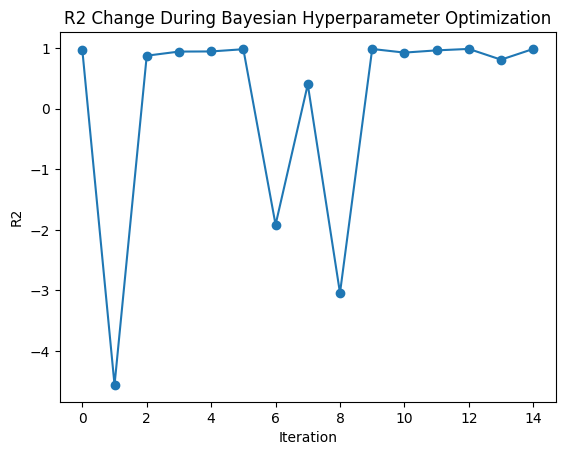

Original Dataset - RMSE: 30.188423781569405, R2: 0.9975322952163674, MAE: 23.571741171290732
External Dataset - RMSE: 263.3700256347656, R2: 0.8121786144587597, MAE: 230.60890197753906


In [18]:
# 提取每次迭代的最佳 R2
best_r2_list = []
for res in result.func_vals:
    best_r2_list.append(-res)  # 注意要取负数

# 绘制 R2 的变化过程图
plt.plot(best_r2_list, marker='o')
plt.xlabel('Iteration')
plt.ylabel('R2')
plt.title('R2 Change During Bayesian Hyperparameter Optimization')
plt.show()

import torch
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from sklearn.model_selection import train_test_split

target_column = 'Biogas Production'

# 分离特征和目标变量
X = data.drop(target_column, axis=1)
y = data[target_column]
X_external = external_data.drop(target_column, axis=1)
y_external = external_data[target_column]

# 标准化数据
X_normalized, feature_scaler = normalize_data(X)
y_normalized, target_scaler = normalize_data(y.values.reshape(-1, 1))

# 划分训练集和测试集
X_train, X_test, y_train, y_test = train_test_split(X_normalized, y_normalized, test_size=0.2, random_state=0)

# 转换为 PyTorch 张量
X_train_tensor = torch.from_numpy(X_train).float().to(device)
X_test_tensor = torch.from_numpy(X_test).float().to(device)
y_train_tensor = torch.from_numpy(y_train).float().to(device)
y_test_tensor = torch.from_numpy(y_test).float().to(device)

# 标准化外部数据集
X_external_normalized, _ = normalize_data(X_external)
y_external_normalized, _ = normalize_data(y_external.values.reshape(-1, 1))

# 转换外部数据为张量
X_external_tensor = torch.from_numpy(X_external_normalized).float().to(device)
y_external_tensor = torch.from_numpy(y_external_normalized).float().to(device)

# 模型预测函数
def model_predict(model, X_tensor):
    model.eval()
    with torch.no_grad():
        return model(X_tensor).cpu().numpy()

# 获取预测值
y_pred_train = model_predict(model, X_train_tensor).flatten()
y_pred_test = model_predict(model, X_test_tensor).flatten()
y_pred_external = model_predict(model, X_external_tensor).flatten()

# 反标准化预测值和实际值
y_pred_train_denorm = denormalize_data(y_pred_train.reshape(-1, 1), target_scaler).flatten()
y_pred_test_denorm = denormalize_data(y_pred_test.reshape(-1, 1), target_scaler).flatten()
y_pred_external_denorm = denormalize_data(y_pred_external.reshape(-1, 1), target_scaler).flatten()
y_train_denorm = denormalize_data(y_train, target_scaler).flatten()
y_test_denorm = denormalize_data(y_test, target_scaler).flatten()
y_external_denorm = denormalize_data(y_external_tensor.cpu().numpy(), target_scaler).flatten()


# 合并原始数据集和外部数据集的预测值和实际值
original_data_actual = np.concatenate([y_train_denorm, y_test_denorm])
original_data_predicted = np.concatenate([y_pred_train_denorm, y_pred_test_denorm])
external_data_actual = y_external_denorm
external_data_predicted = y_pred_external_denorm

# 创建 DataFrame
combined_df = pd.DataFrame({
    'Actual': np.concatenate([original_data_actual, external_data_actual]),
    'Predicted': np.concatenate([original_data_predicted, external_data_predicted]),
    'Dataset': ['Original'] * len(original_data_actual) + ['External'] * len(external_data_actual)
})

# 计算原始数据集的指标
train_r2 = r2_score(original_data_actual, original_data_predicted)
train_rmse = mean_squared_error(original_data_actual, original_data_predicted, squared=False)
train_mae = mean_absolute_error(original_data_actual, original_data_predicted)

# 计算外部数据集的指标
external_r2 = r2_score(external_data_actual, external_data_predicted)
external_rmse = mean_squared_error(external_data_actual, external_data_predicted, squared=False)
external_mae = mean_absolute_error(external_data_actual, external_data_predicted)


print(f"Original Dataset - RMSE: {train_rmse}, R2: {train_r2}, MAE: {train_mae}")
print(f"External Dataset - RMSE: {external_rmse}, R2: {external_r2}, MAE: {external_mae}")

减少训练样本

使用两部分数据集进行训练

Best parameters: [500, 1e-06, 0.001, 0.8, 1e-07]


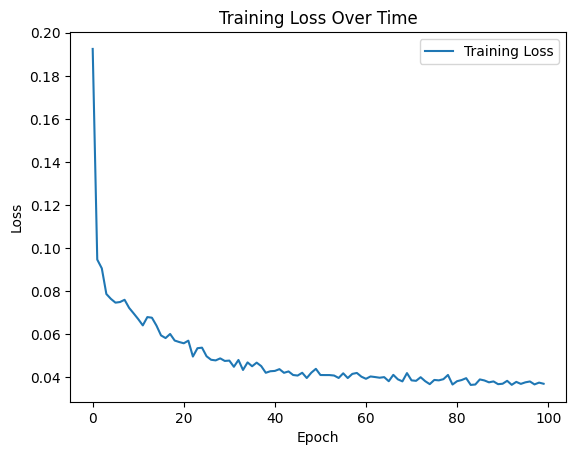

Task Train RMSE: 30.492555618286133, Train R2: 0.9979767727273116, Train MAE: 28.374164581298828
Task Test RMSE: 25.97115135192871, Test R2: 0.9985438769289184, Test MAE: 24.23870277404785
Task Train RMSE: 28.727476119995117, Train R2: 0.9981539305865538, Train MAE: 27.03505516052246
Task Test RMSE: 33.0546760559082, Test R2: 0.9977256587118833, Test MAE: 29.595104217529297
Task Train RMSE: 29.284605026245117, Train R2: 0.9981085356743611, Train MAE: 27.02880859375
Task Test RMSE: 31.037578582763672, Test R2: 0.9980126503971527, Test MAE: 29.620086669921875
Task Train RMSE: 29.593107223510742, Train R2: 0.9980811615590272, Train MAE: 27.1734619140625
Task Test RMSE: 29.84421157836914, Test R2: 0.9981209750876847, Test MAE: 29.0414981842041
Task Train RMSE: 30.08786964416504, Train R2: 0.9981222956354513, Train MAE: 28.123844146728516
Task Test RMSE: 27.795026779174805, Test R2: 0.9977864546604289, Test MAE: 25.239953994750977
Task Train RMSE: 29.85718536376953, Train R2: 0.998296632590

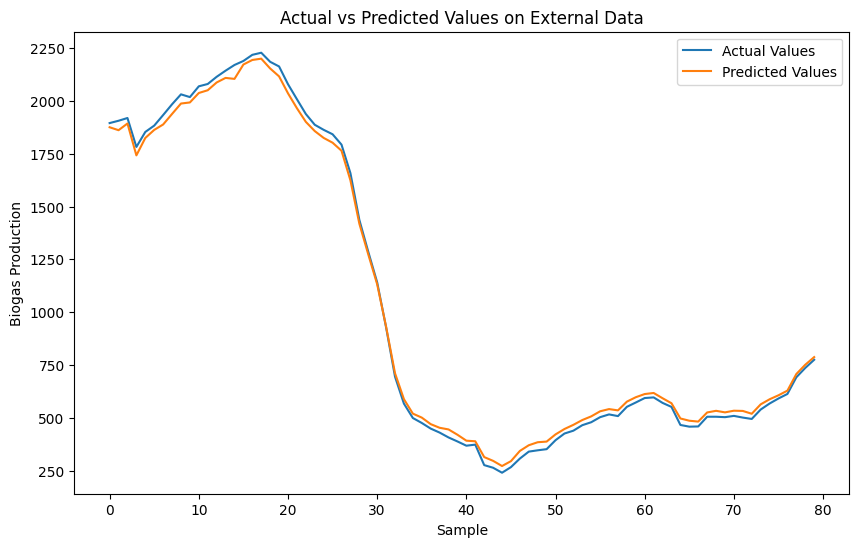

External Dataset - RMSE: 29.35515022277832, R2: 0.998357559671398, MAE: 27.610111236572266


In [20]:
import torch
from torch import nn, optim
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split, KFold
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from skopt import gp_minimize
from skopt.space import Real, Integer
from skopt.utils import use_named_args
import matplotlib.pyplot as plt
import learn2learn as l2l
import numpy as np
import torch

np.random.seed(0)  # 设置NumPy的随机种子
torch.manual_seed(0)  # 设置PyTorch的随机种子

device = torch.device("cuda:0")  # Use GPU 0

# Hyperparameter search space
search_space = [
    Integer(500, 1500, name='hidden_size'), 
    Real(1e-11, 1e-6, "log-uniform", name='alpha'),  
    Real(1e-7, 1e-3, "log-uniform", name='beta'),
    Real(0.1, 0.8, name='dropout_rate'), 
    Real(1e-7, 1e-1, "log-uniform", name='weight_decay') 
]

# Data normalization and denormalization functions
def normalize_data(data):
    scaler = StandardScaler()
    return scaler.fit_transform(data), scaler

def normalize_feature(data, column_name):
    scaler = StandardScaler()
    scaled_data = scaler.fit_transform(data[[column_name]])
    return scaled_data, scaler

def denormalize_data(normalized_data, scaler):
    return scaler.inverse_transform(normalized_data)

# Advanced neural network architecture
class AdvancedNeuralNetwork(nn.Module):
    def __init__(self, input_size, hidden_size, dropout_rate):
        super(AdvancedNeuralNetwork, self).__init__()
        self.layer1 = nn.Linear(input_size, hidden_size)
        self.relu1 = nn.LeakyReLU()
        self.layer2 = nn.Linear(hidden_size, hidden_size // 2)
        self.relu2 = nn.LeakyReLU()
        self.layer3 = nn.Linear(hidden_size // 2, hidden_size // 4)
        self.relu3 = nn.LeakyReLU()
        self.dropout = nn.Dropout(dropout_rate)
        self.layer4 = nn.Linear(hidden_size // 4, 1)

    def forward(self, x):
        x = self.relu1(self.layer1(x))
        x = self.relu2(self.layer2(x))
        x = self.relu3(self.layer3(x))
        x = self.dropout(x)
        x = self.layer4(x)
        return x

# Task creation function
def create_tasks(data, target_column, num_tasks=50, task_size=50):
    tasks = []
    for _ in range(num_tasks):
        task_data = data.sample(task_size)
        X, y = task_data.drop(target_column, axis=1), task_data[target_column]
        tasks.append((X, y))
    return tasks

# Early stopping class
class EarlyStopping:
    def __init__(self, patience=5, delta=0):
        self.patience = patience
        self.counter = 0
        self.best_score = None
        self.early_stop = False
        self.delta = delta

    def __call__(self, val_loss, model):
        score = -val_loss
        if self.best_score is None:
            self.best_score = score
        elif score < self.best_score + self.delta:
            self.counter += 1
            if self.counter >= self.patience:
                self.early_stop = True
        else:
            self.best_score = score
            self.counter = 0

# MAML fast adaptation and meta-training
def meta_train_maml(model, tasks, alpha, beta, weight_decay, epochs=100, num_steps=1):
    early_stopping = EarlyStopping(patience=10, delta=0.01)
    optimizer = optim.Adam(model.parameters(), lr=beta, weight_decay=weight_decay)
    scheduler = optim.lr_scheduler.CosineAnnealingLR(optimizer, T_max=epochs)

    epoch_loss_list = []  # Initialize a list to store losses for each epoch

    for epoch in range(epochs):
        epoch_losses = []
        for task in tasks:
            learner = model.clone()  # Clone the model
            task_X, task_y = task
            task_X = torch.from_numpy(task_X.values).float().to(device)
            task_y = torch.from_numpy(task_y.values).float().to(device)

            # Fast adaptation
            for step in range(num_steps):
                pred_y = learner(task_X)
                loss = nn.functional.mse_loss(pred_y.squeeze(), task_y)
                learner.adapt(loss)

            # Meta-update
            optimizer.zero_grad()
            pred_y = learner(task_X)
            loss = nn.functional.mse_loss(pred_y.squeeze(), task_y)
            epoch_losses.append(loss.item())
            loss.backward()
            optimizer.step()

        scheduler.step()  # Update learning rate
        average_loss = np.mean(epoch_losses)
        epoch_loss_list.append(average_loss)  # Add each epoch's average loss to the list

        if early_stopping(average_loss, model):
            print(f"Early stopping triggered at epoch {epoch}")
            break

    return epoch_loss_list  # Return the list of epoch losses



@use_named_args(search_space)
def objective(hidden_size, alpha, beta, dropout_rate, weight_decay):
    model = AdvancedNeuralNetwork(input_size, hidden_size, dropout_rate)
    model = l2l.algorithms.MAML(model, lr=alpha).to(device)
    avg_r2 = 0

    task_r2_list = []  # 记录每个任务的 R2

    for task in tasks:
        task_X, task_y = task
        task_X_train, task_X_test, task_y_train, task_y_test = train_test_split(task_X, task_y, test_size=0.2, random_state=0)
        meta_train_maml(model, [(task_X_train, task_y_train)], alpha, beta, weight_decay, epochs=100)
        train_rmse, train_r2, train_mae, test_rmse, test_r2, test_mae = evaluate_model(model, task_X_train, task_y_train, task_X_test, task_y_test, target_scaler)
        task_r2_list.append(test_r2)  # 记录每个任务的测试 R2
        avg_r2 += test_r2

    avg_r2 /= len(tasks)
    return -avg_r2  # 这里返回负数因为 skopt 的目标函数是最小化，而我们想要最大化 R2

# Evaluation function
def evaluate_model(model, X_train, y_train, X_test, y_test, target_scaler):
    model.eval()
    with torch.no_grad():
        # Convert data to tensors
        X_train_tensor = torch.from_numpy(X_train.values).float().to(device)
        y_train_tensor = torch.from_numpy(y_train.values).float().to(device)
        X_test_tensor = torch.from_numpy(X_test.values).float().to(device)
        y_test_tensor = torch.from_numpy(y_test.values).float().to(device)

        # Get predictions
        train_predictions = model(X_train_tensor).squeeze().cpu().numpy()
        test_predictions = model(X_test_tensor).squeeze().cpu().numpy()

        # Reshape predictions for denormalization
        train_predictions_reshaped = train_predictions.reshape(-1, 1)
        test_predictions_reshaped = test_predictions.reshape(-1, 1)

        # Denormalize predictions using target_scaler
        train_predictions_denorm = denormalize_data(train_predictions_reshaped, target_scaler)
        test_predictions_denorm = denormalize_data(test_predictions_reshaped, target_scaler)

        # Denormalize actual values using target_scaler
        y_train_denorm = denormalize_data(y_train_tensor.cpu().numpy().reshape(-1, 1), target_scaler)
        y_test_denorm = denormalize_data(y_test_tensor.cpu().numpy().reshape(-1, 1), target_scaler)

        # Calculate metrics using denormalized data
        train_rmse = mean_squared_error(y_train_denorm, train_predictions_denorm, squared=False)
        train_r2 = r2_score(y_train_denorm, train_predictions_denorm)
        train_mae = mean_absolute_error(y_train_denorm, train_predictions_denorm)

        test_rmse = mean_squared_error(y_test_denorm, test_predictions_denorm, squared=False)
        test_r2 = r2_score(y_test_denorm, test_predictions_denorm)
        test_mae = mean_absolute_error(y_test_denorm, test_predictions_denorm)

    return train_rmse, train_r2, train_mae, test_rmse, test_r2, test_mae

# Load and normalize data
data = pd.read_csv("C:\\Users\\Lenovo\\Desktop\\元学习\\BT(2)1-1.csv")
data_normalized, scaler = normalize_data(data)
target_normalized, target_scaler = normalize_feature(data, 'Biogas Production')
# Create tasks using the normalized dataset
input_size = data.shape[1] - 1 
tasks = create_tasks(pd.DataFrame(data_normalized, columns=data.columns), target_column='Biogas Production')

# Execute hyperparameter optimization
result = gp_minimize(objective, search_space, n_calls=15,random_state=0)
hidden_size, alpha, beta, dropout_rate, weight_decay = result.x
print("Best parameters:", result.x)

# Train model with optimized hyperparameters
model = AdvancedNeuralNetwork(input_size, hidden_size, dropout_rate)
model = l2l.algorithms.MAML(model, lr=alpha).to(device)
train_losses = meta_train_maml(model, tasks, alpha, beta, weight_decay, epochs=100)

# Visualize training losses
plt.plot(train_losses, label='Training Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training Loss Over Time')
plt.legend()
plt.show()

# Final model evaluation
for task in tasks:
    X, y = task
    kf = KFold(n_splits=5, shuffle=True, random_state=0)
    for train_index, test_index in kf.split(X):
        X_train, X_test = X.iloc[train_index], X.iloc[test_index]
        y_train, y_test = y.iloc[train_index], y.iloc[test_index]
        train_rmse, train_r2, train_mae, test_rmse, test_r2, test_mae = evaluate_model(model, X_train, y_train, X_test, y_test, target_scaler)
        print(f"Task Train RMSE: {train_rmse}, Train R2: {train_r2}, Train MAE: {train_mae}")
        print(f"Task Test RMSE: {test_rmse}, Test R2: {test_r2}, Test MAE: {test_mae}")


# Load and process external data for evaluation
external_data = pd.read_csv("C:\\Users\\Lenovo\\Desktop\\元学习\\BT(2)1-2.csv")
external_data_normalized, _ = normalize_data(external_data)
external_target_normalized, _ = normalize_feature(external_data, 'Biogas Production')
external_X = torch.from_numpy(pd.DataFrame(external_data_normalized, columns=external_data.columns).drop('Biogas Production', axis=1).values).float().to(device)
external_y_normalized = torch.from_numpy(external_target_normalized).float().to(device)

# Model prediction on external data
learner = model.clone()  # Clone the model for evaluation
learner.eval()
with torch.no_grad():
    external_predictions_normalized = learner(external_X).squeeze()
external_predictions = denormalize_data(external_predictions_normalized.cpu().numpy().reshape(-1, 1), target_scaler)
external_y = denormalize_data(external_y_normalized.cpu().numpy().reshape(-1, 1), target_scaler)

# Visualization of predictions on external data
plt.figure(figsize=(10, 6))
plt.plot(external_y, label='Actual Values')
plt.plot(external_predictions, label='Predicted Values')
plt.xlabel('Sample')
plt.ylabel('Biogas Production')
plt.title('Actual vs Predicted Values on External Data')
plt.legend()
plt.show()

# Evaluate on external dataset using denormalized data
external_rmse = mean_squared_error(external_y, external_predictions, squared=False)
external_r2 = r2_score(external_y, external_predictions)
external_mae = mean_absolute_error(external_y, external_predictions)

print(f"External Dataset - RMSE: {external_rmse}, R2: {external_r2}, MAE: {external_mae}")

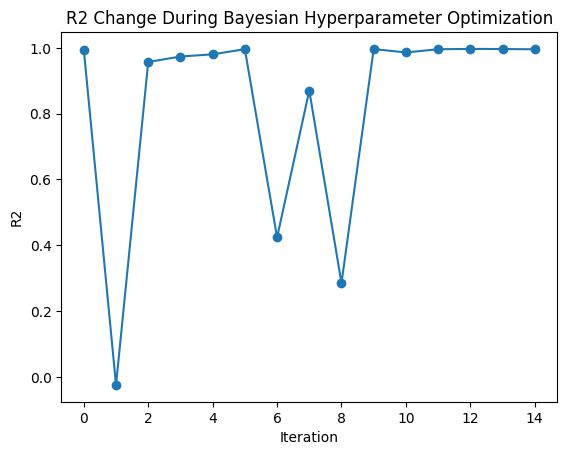

Original Dataset - RMSE: 29.355144073483128, R2: 0.9983575603546312, MAE: 27.610105041503907
External Dataset - RMSE: 29.35515022277832, R2: 0.998357559671398, MAE: 27.610111236572266


In [21]:
# 提取每次迭代的最佳 R2
best_r2_list = []
for res in result.func_vals:
    best_r2_list.append(-res)  # 注意要取负数

# 绘制 R2 的变化过程图
plt.plot(best_r2_list, marker='o')
plt.xlabel('Iteration')
plt.ylabel('R2')
plt.title('R2 Change During Bayesian Hyperparameter Optimization')
plt.show()

import torch
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from sklearn.model_selection import train_test_split

target_column = 'Biogas Production'

# 分离特征和目标变量
X = data.drop(target_column, axis=1)
y = data[target_column]
X_external = external_data.drop(target_column, axis=1)
y_external = external_data[target_column]

# 标准化数据
X_normalized, feature_scaler = normalize_data(X)
y_normalized, target_scaler = normalize_data(y.values.reshape(-1, 1))

# 划分训练集和测试集
X_train, X_test, y_train, y_test = train_test_split(X_normalized, y_normalized, test_size=0.2, random_state=0)

# 转换为 PyTorch 张量
X_train_tensor = torch.from_numpy(X_train).float().to(device)
X_test_tensor = torch.from_numpy(X_test).float().to(device)
y_train_tensor = torch.from_numpy(y_train).float().to(device)
y_test_tensor = torch.from_numpy(y_test).float().to(device)

# 标准化外部数据集
X_external_normalized, _ = normalize_data(X_external)
y_external_normalized, _ = normalize_data(y_external.values.reshape(-1, 1))

# 转换外部数据为张量
X_external_tensor = torch.from_numpy(X_external_normalized).float().to(device)
y_external_tensor = torch.from_numpy(y_external_normalized).float().to(device)

# 模型预测函数
def model_predict(model, X_tensor):
    model.eval()
    with torch.no_grad():
        return model(X_tensor).cpu().numpy()

# 获取预测值
y_pred_train = model_predict(model, X_train_tensor).flatten()
y_pred_test = model_predict(model, X_test_tensor).flatten()
y_pred_external = model_predict(model, X_external_tensor).flatten()

# 反标准化预测值和实际值
y_pred_train_denorm = denormalize_data(y_pred_train.reshape(-1, 1), target_scaler).flatten()
y_pred_test_denorm = denormalize_data(y_pred_test.reshape(-1, 1), target_scaler).flatten()
y_pred_external_denorm = denormalize_data(y_pred_external.reshape(-1, 1), target_scaler).flatten()
y_train_denorm = denormalize_data(y_train, target_scaler).flatten()
y_test_denorm = denormalize_data(y_test, target_scaler).flatten()
y_external_denorm = denormalize_data(y_external_tensor.cpu().numpy(), target_scaler).flatten()


# 合并原始数据集和外部数据集的预测值和实际值
original_data_actual = np.concatenate([y_train_denorm, y_test_denorm])
original_data_predicted = np.concatenate([y_pred_train_denorm, y_pred_test_denorm])
external_data_actual = y_external_denorm
external_data_predicted = y_pred_external_denorm

# 创建 DataFrame
combined_df = pd.DataFrame({
    'Actual': np.concatenate([original_data_actual, external_data_actual]),
    'Predicted': np.concatenate([original_data_predicted, external_data_predicted]),
    'Dataset': ['Original'] * len(original_data_actual) + ['External'] * len(external_data_actual)
})

# 计算原始数据集的指标
train_r2 = r2_score(original_data_actual, original_data_predicted)
train_rmse = mean_squared_error(original_data_actual, original_data_predicted, squared=False)
train_mae = mean_absolute_error(original_data_actual, original_data_predicted)

# 计算外部数据集的指标
external_r2 = r2_score(external_data_actual, external_data_predicted)
external_rmse = mean_squared_error(external_data_actual, external_data_predicted, squared=False)
external_mae = mean_absolute_error(external_data_actual, external_data_predicted)


print(f"Original Dataset - RMSE: {train_rmse}, R2: {train_r2}, MAE: {train_mae}")
print(f"External Dataset - RMSE: {external_rmse}, R2: {external_r2}, MAE: {external_mae}")

Best parameters: [500, 1e-11, 0.0003730189376973287, 0.1, 1e-07]


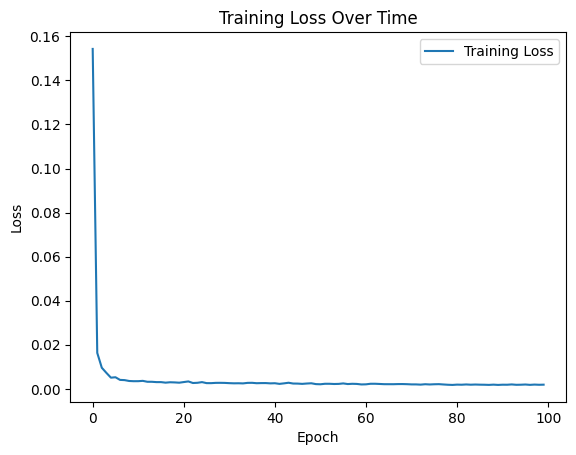

Task Train RMSE: 2.042811632156372, Train R2: 0.9999884274146308, Train MAE: 1.6226409673690796
Task Test RMSE: 2.2020251750946045, Test R2: 0.9999834119126103, Test MAE: 1.8476378917694092
Task Train RMSE: 2.220822811126709, Train R2: 0.9999859775765351, Train MAE: 1.806359887123108
Task Test RMSE: 1.3464959859848022, Test R2: 0.999988973544333, Test MAE: 1.1127440929412842
Task Train RMSE: 1.9576799869537354, Train R2: 0.9999892570695464, Train MAE: 1.5728423595428467
Task Test RMSE: 2.492216110229492, Test R2: 0.9999778034407985, Test MAE: 2.04681396484375
Task Train RMSE: 2.2091565132141113, Train R2: 0.9999859041174436, Train MAE: 1.7890456914901733
Task Test RMSE: 1.421200156211853, Test R2: 0.9999942316640245, Test MAE: 1.1820251941680908
Task Train RMSE: 1.92955482006073, Train R2: 0.999987726260949, Train MAE: 1.5473006963729858
Task Test RMSE: 2.5785372257232666, Test R2: 0.9999488500301469, Test MAE: 2.149035692214966
Task Train RMSE: 2.0567116737365723, Train R2: 0.99998651

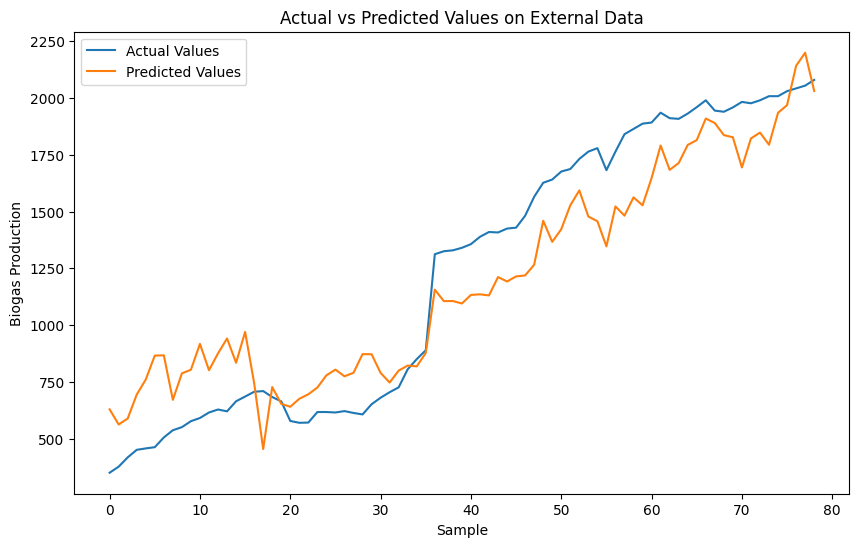

External Dataset - RMSE: 211.9403533935547, R2: 0.8760317881539311, MAE: 189.6158905029297


In [22]:
import torch
from torch import nn, optim
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split, KFold
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from skopt import gp_minimize
from skopt.space import Real, Integer
from skopt.utils import use_named_args
import matplotlib.pyplot as plt
import learn2learn as l2l
import numpy as np
import torch

np.random.seed(0)  # 设置NumPy的随机种子
torch.manual_seed(0)  # 设置PyTorch的随机种子

device = torch.device("cuda:0")  # Use GPU 0

# Hyperparameter search space
search_space = [
    Integer(500, 1500, name='hidden_size'), 
    Real(1e-11, 1e-6, "log-uniform", name='alpha'),  
    Real(1e-7, 1e-3, "log-uniform", name='beta'),
    Real(0.1, 0.8, name='dropout_rate'), 
    Real(1e-7, 1e-1, "log-uniform", name='weight_decay') 
]

# Data normalization and denormalization functions
def normalize_data(data):
    scaler = StandardScaler()
    return scaler.fit_transform(data), scaler

def normalize_feature(data, column_name):
    scaler = StandardScaler()
    scaled_data = scaler.fit_transform(data[[column_name]])
    return scaled_data, scaler

def denormalize_data(normalized_data, scaler):
    return scaler.inverse_transform(normalized_data)

# Advanced neural network architecture
class AdvancedNeuralNetwork(nn.Module):
    def __init__(self, input_size, hidden_size, dropout_rate):
        super(AdvancedNeuralNetwork, self).__init__()
        self.layer1 = nn.Linear(input_size, hidden_size)
        self.relu1 = nn.LeakyReLU()
        self.layer2 = nn.Linear(hidden_size, hidden_size // 2)
        self.relu2 = nn.LeakyReLU()
        self.layer3 = nn.Linear(hidden_size // 2, hidden_size // 4)
        self.relu3 = nn.LeakyReLU()
        self.dropout = nn.Dropout(dropout_rate)
        self.layer4 = nn.Linear(hidden_size // 4, 1)

    def forward(self, x):
        x = self.relu1(self.layer1(x))
        x = self.relu2(self.layer2(x))
        x = self.relu3(self.layer3(x))
        x = self.dropout(x)
        x = self.layer4(x)
        return x

# Task creation function
def create_tasks(data, target_column, num_tasks=50, task_size=50):
    tasks = []
    for _ in range(num_tasks):
        task_data = data.sample(task_size)
        X, y = task_data.drop(target_column, axis=1), task_data[target_column]
        tasks.append((X, y))
    return tasks

# Early stopping class
class EarlyStopping:
    def __init__(self, patience=5, delta=0):
        self.patience = patience
        self.counter = 0
        self.best_score = None
        self.early_stop = False
        self.delta = delta

    def __call__(self, val_loss, model):
        score = -val_loss
        if self.best_score is None:
            self.best_score = score
        elif score < self.best_score + self.delta:
            self.counter += 1
            if self.counter >= self.patience:
                self.early_stop = True
        else:
            self.best_score = score
            self.counter = 0

# MAML fast adaptation and meta-training
def meta_train_maml(model, tasks, alpha, beta, weight_decay, epochs=100, num_steps=1):
    early_stopping = EarlyStopping(patience=10, delta=0.01)
    optimizer = optim.Adam(model.parameters(), lr=beta, weight_decay=weight_decay)
    scheduler = optim.lr_scheduler.CosineAnnealingLR(optimizer, T_max=epochs)

    epoch_loss_list = []  # Initialize a list to store losses for each epoch

    for epoch in range(epochs):
        epoch_losses = []
        for task in tasks:
            learner = model.clone()  # Clone the model
            task_X, task_y = task
            task_X = torch.from_numpy(task_X.values).float().to(device)
            task_y = torch.from_numpy(task_y.values).float().to(device)

            # Fast adaptation
            for step in range(num_steps):
                pred_y = learner(task_X)
                loss = nn.functional.mse_loss(pred_y.squeeze(), task_y)
                learner.adapt(loss)

            # Meta-update
            optimizer.zero_grad()
            pred_y = learner(task_X)
            loss = nn.functional.mse_loss(pred_y.squeeze(), task_y)
            epoch_losses.append(loss.item())
            loss.backward()
            optimizer.step()

        scheduler.step()  # Update learning rate
        average_loss = np.mean(epoch_losses)
        epoch_loss_list.append(average_loss)  # Add each epoch's average loss to the list

        if early_stopping(average_loss, model):
            print(f"Early stopping triggered at epoch {epoch}")
            break

    return epoch_loss_list  # Return the list of epoch losses



@use_named_args(search_space)
def objective(hidden_size, alpha, beta, dropout_rate, weight_decay):
    model = AdvancedNeuralNetwork(input_size, hidden_size, dropout_rate)
    model = l2l.algorithms.MAML(model, lr=alpha).to(device)
    avg_r2 = 0

    task_r2_list = []  # 记录每个任务的 R2

    for task in tasks:
        task_X, task_y = task
        task_X_train, task_X_test, task_y_train, task_y_test = train_test_split(task_X, task_y, test_size=0.2, random_state=0)
        meta_train_maml(model, [(task_X_train, task_y_train)], alpha, beta, weight_decay, epochs=100)
        train_rmse, train_r2, train_mae, test_rmse, test_r2, test_mae = evaluate_model(model, task_X_train, task_y_train, task_X_test, task_y_test, target_scaler)
        task_r2_list.append(test_r2)  # 记录每个任务的测试 R2
        avg_r2 += test_r2

    avg_r2 /= len(tasks)
    return -avg_r2  # 这里返回负数因为 skopt 的目标函数是最小化，而我们想要最大化 R2


# Evaluation function
def evaluate_model(model, X_train, y_train, X_test, y_test, target_scaler):
    model.eval()
    with torch.no_grad():
        # Convert data to tensors
        X_train_tensor = torch.from_numpy(X_train.values).float().to(device)
        y_train_tensor = torch.from_numpy(y_train.values).float().to(device)
        X_test_tensor = torch.from_numpy(X_test.values).float().to(device)
        y_test_tensor = torch.from_numpy(y_test.values).float().to(device)

        # Get predictions
        train_predictions = model(X_train_tensor).squeeze().cpu().numpy()
        test_predictions = model(X_test_tensor).squeeze().cpu().numpy()

        # Reshape predictions for denormalization
        train_predictions_reshaped = train_predictions.reshape(-1, 1)
        test_predictions_reshaped = test_predictions.reshape(-1, 1)

        # Denormalize predictions using target_scaler
        train_predictions_denorm = denormalize_data(train_predictions_reshaped, target_scaler)
        test_predictions_denorm = denormalize_data(test_predictions_reshaped, target_scaler)

        # Denormalize actual values using target_scaler
        y_train_denorm = denormalize_data(y_train_tensor.cpu().numpy().reshape(-1, 1), target_scaler)
        y_test_denorm = denormalize_data(y_test_tensor.cpu().numpy().reshape(-1, 1), target_scaler)

        # Calculate metrics using denormalized data
        train_rmse = mean_squared_error(y_train_denorm, train_predictions_denorm, squared=False)
        train_r2 = r2_score(y_train_denorm, train_predictions_denorm)
        train_mae = mean_absolute_error(y_train_denorm, train_predictions_denorm)

        test_rmse = mean_squared_error(y_test_denorm, test_predictions_denorm, squared=False)
        test_r2 = r2_score(y_test_denorm, test_predictions_denorm)
        test_mae = mean_absolute_error(y_test_denorm, test_predictions_denorm)

    return train_rmse, train_r2, train_mae, test_rmse, test_r2, test_mae

# Load and normalize data
data = pd.read_csv("C:\\Users\\Lenovo\\Desktop\\元学习\\BT(2)2-1.csv")
data_normalized, scaler = normalize_data(data)
target_normalized, target_scaler = normalize_feature(data, 'Biogas Production')
# Create tasks using the normalized dataset
input_size = data.shape[1] - 1 
tasks = create_tasks(pd.DataFrame(data_normalized, columns=data.columns), target_column='Biogas Production')

# Execute hyperparameter optimization
result = gp_minimize(objective, search_space, n_calls=15,random_state=0)
hidden_size, alpha, beta, dropout_rate, weight_decay = result.x
print("Best parameters:", result.x)

# Train model with optimized hyperparameters
model = AdvancedNeuralNetwork(input_size, hidden_size, dropout_rate)
model = l2l.algorithms.MAML(model, lr=alpha).to(device)
train_losses = meta_train_maml(model, tasks, alpha, beta, weight_decay, epochs=100)

# Visualize training losses
plt.plot(train_losses, label='Training Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training Loss Over Time')
plt.legend()
plt.show()

# Final model evaluation
for task in tasks:
    X, y = task
    kf = KFold(n_splits=5, shuffle=True, random_state=0)
    for train_index, test_index in kf.split(X):
        X_train, X_test = X.iloc[train_index], X.iloc[test_index]
        y_train, y_test = y.iloc[train_index], y.iloc[test_index]
        train_rmse, train_r2, train_mae, test_rmse, test_r2, test_mae = evaluate_model(model, X_train, y_train, X_test, y_test, target_scaler)
        print(f"Task Train RMSE: {train_rmse}, Train R2: {train_r2}, Train MAE: {train_mae}")
        print(f"Task Test RMSE: {test_rmse}, Test R2: {test_r2}, Test MAE: {test_mae}")


# Load and process external data for evaluation
external_data = pd.read_csv("C:\\Users\\Lenovo\\Desktop\\元学习\\BT(2)2-2.csv")
external_data_normalized, _ = normalize_data(external_data)
external_target_normalized, _ = normalize_feature(external_data, 'Biogas Production')
external_X = torch.from_numpy(pd.DataFrame(external_data_normalized, columns=external_data.columns).drop('Biogas Production', axis=1).values).float().to(device)
external_y_normalized = torch.from_numpy(external_target_normalized).float().to(device)

# Model prediction on external data
learner = model.clone()  # Clone the model for evaluation
learner.eval()
with torch.no_grad():
    external_predictions_normalized = learner(external_X).squeeze()
external_predictions = denormalize_data(external_predictions_normalized.cpu().numpy().reshape(-1, 1), target_scaler)
external_y = denormalize_data(external_y_normalized.cpu().numpy().reshape(-1, 1), target_scaler)

# Visualization of predictions on external data
plt.figure(figsize=(10, 6))
plt.plot(external_y, label='Actual Values')
plt.plot(external_predictions, label='Predicted Values')
plt.xlabel('Sample')
plt.ylabel('Biogas Production')
plt.title('Actual vs Predicted Values on External Data')
plt.legend()
plt.show()

# Evaluate on external dataset using denormalized data
external_rmse = mean_squared_error(external_y, external_predictions, squared=False)
external_r2 = r2_score(external_y, external_predictions)
external_mae = mean_absolute_error(external_y, external_predictions)

print(f"External Dataset - RMSE: {external_rmse}, R2: {external_r2}, MAE: {external_mae}")

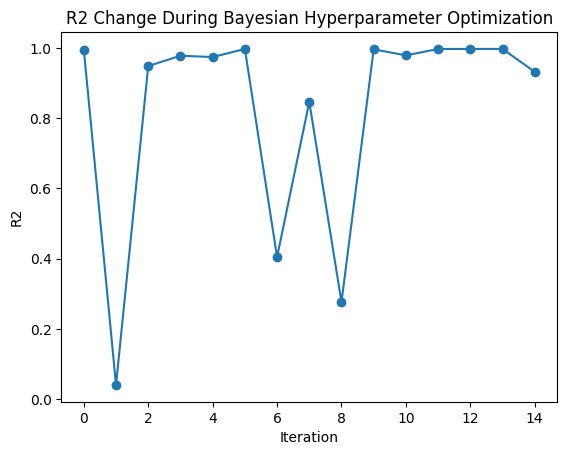

Original Dataset - RMSE: 2.079031925496191, R2: 0.9999880709622465, MAE: 1.6529841218171253
External Dataset - RMSE: 211.9403533935547, R2: 0.8760317881539311, MAE: 189.6158905029297


In [23]:
# 提取每次迭代的最佳 R2
best_r2_list = []
for res in result.func_vals:
    best_r2_list.append(-res)  # 注意要取负数

# 绘制 R2 的变化过程图
plt.plot(best_r2_list, marker='o')
plt.xlabel('Iteration')
plt.ylabel('R2')
plt.title('R2 Change During Bayesian Hyperparameter Optimization')
plt.show()

import torch
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from sklearn.model_selection import train_test_split

target_column = 'Biogas Production'

# 分离特征和目标变量
X = data.drop(target_column, axis=1)
y = data[target_column]
X_external = external_data.drop(target_column, axis=1)
y_external = external_data[target_column]

# 标准化数据
X_normalized, feature_scaler = normalize_data(X)
y_normalized, target_scaler = normalize_data(y.values.reshape(-1, 1))

# 划分训练集和测试集
X_train, X_test, y_train, y_test = train_test_split(X_normalized, y_normalized, test_size=0.2, random_state=0)

# 转换为 PyTorch 张量
X_train_tensor = torch.from_numpy(X_train).float().to(device)
X_test_tensor = torch.from_numpy(X_test).float().to(device)
y_train_tensor = torch.from_numpy(y_train).float().to(device)
y_test_tensor = torch.from_numpy(y_test).float().to(device)

# 标准化外部数据集
X_external_normalized, _ = normalize_data(X_external)
y_external_normalized, _ = normalize_data(y_external.values.reshape(-1, 1))

# 转换外部数据为张量
X_external_tensor = torch.from_numpy(X_external_normalized).float().to(device)
y_external_tensor = torch.from_numpy(y_external_normalized).float().to(device)

# 模型预测函数
def model_predict(model, X_tensor):
    model.eval()
    with torch.no_grad():
        return model(X_tensor).cpu().numpy()

# 获取预测值
y_pred_train = model_predict(model, X_train_tensor).flatten()
y_pred_test = model_predict(model, X_test_tensor).flatten()
y_pred_external = model_predict(model, X_external_tensor).flatten()

# 反标准化预测值和实际值
y_pred_train_denorm = denormalize_data(y_pred_train.reshape(-1, 1), target_scaler).flatten()
y_pred_test_denorm = denormalize_data(y_pred_test.reshape(-1, 1), target_scaler).flatten()
y_pred_external_denorm = denormalize_data(y_pred_external.reshape(-1, 1), target_scaler).flatten()
y_train_denorm = denormalize_data(y_train, target_scaler).flatten()
y_test_denorm = denormalize_data(y_test, target_scaler).flatten()
y_external_denorm = denormalize_data(y_external_tensor.cpu().numpy(), target_scaler).flatten()


# 合并原始数据集和外部数据集的预测值和实际值
original_data_actual = np.concatenate([y_train_denorm, y_test_denorm])
original_data_predicted = np.concatenate([y_pred_train_denorm, y_pred_test_denorm])
external_data_actual = y_external_denorm
external_data_predicted = y_pred_external_denorm

# 创建 DataFrame
combined_df = pd.DataFrame({
    'Actual': np.concatenate([original_data_actual, external_data_actual]),
    'Predicted': np.concatenate([original_data_predicted, external_data_predicted]),
    'Dataset': ['Original'] * len(original_data_actual) + ['External'] * len(external_data_actual)
})

# 计算原始数据集的指标
train_r2 = r2_score(original_data_actual, original_data_predicted)
train_rmse = mean_squared_error(original_data_actual, original_data_predicted, squared=False)
train_mae = mean_absolute_error(original_data_actual, original_data_predicted)

# 计算外部数据集的指标
external_r2 = r2_score(external_data_actual, external_data_predicted)
external_rmse = mean_squared_error(external_data_actual, external_data_predicted, squared=False)
external_mae = mean_absolute_error(external_data_actual, external_data_predicted)


print(f"Original Dataset - RMSE: {train_rmse}, R2: {train_r2}, MAE: {train_mae}")
print(f"External Dataset - RMSE: {external_rmse}, R2: {external_r2}, MAE: {external_mae}")

Best parameters: [500, 1e-06, 0.00043253684535966483, 0.1, 1e-07]


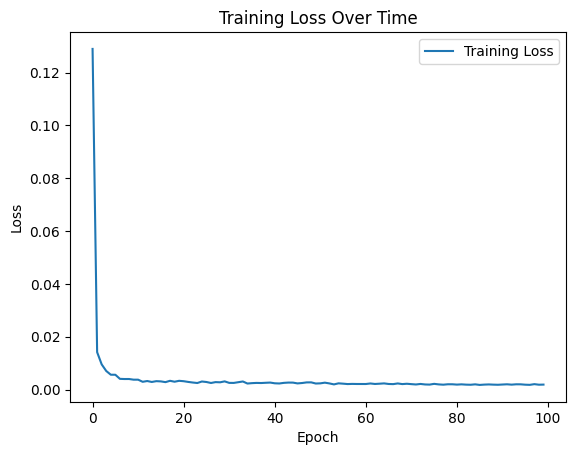

Task Train RMSE: 1.5417636632919312, Train R2: 0.9999928653515633, Train MAE: 1.0851211547851562
Task Test RMSE: 1.0320754051208496, Test R2: 0.999982494704635, Test MAE: 0.737805187702179
Task Train RMSE: 1.4903476238250732, Train R2: 0.9999916735481449, Train MAE: 1.0341079235076904
Task Test RMSE: 1.299477458000183, Test R2: 0.9999955025931215, Test MAE: 0.9418090581893921
Task Train RMSE: 1.3546146154403687, Train R2: 0.9999932959628848, Train MAE: 0.9997817873954773
Task Test RMSE: 1.798135757446289, Test R2: 0.9999907232096301, Test MAE: 1.079126000404358
Task Train RMSE: 1.3202341794967651, Train R2: 0.999994323442696, Train MAE: 0.8948639035224915
Task Test RMSE: 1.8976860046386719, Test R2: 0.9999832031023369, Test MAE: 1.498834252357483
Task Train RMSE: 1.5482617616653442, Train R2: 0.999990960207753, Train MAE: 1.0644149780273438
Task Test RMSE: 0.9923794865608215, Test R2: 0.9999974675802796, Test MAE: 0.82061767578125
Task Train RMSE: 1.4922857284545898, Train R2: 0.999988

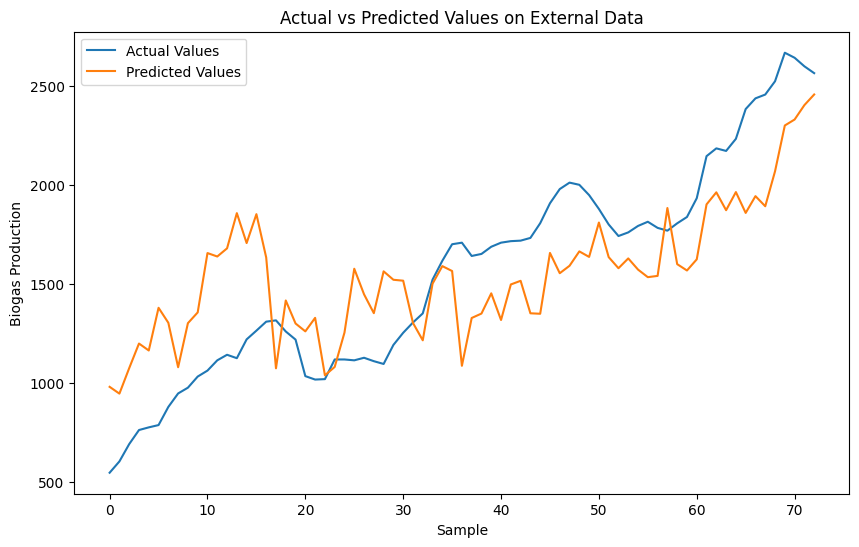

External Dataset - RMSE: 345.2839050292969, R2: 0.5812014486301575, MAE: 305.2010192871094


In [24]:
import torch
from torch import nn, optim
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split, KFold
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from skopt import gp_minimize
from skopt.space import Real, Integer
from skopt.utils import use_named_args
import matplotlib.pyplot as plt
import learn2learn as l2l
import numpy as np
import torch

np.random.seed(0)  # 设置NumPy的随机种子
torch.manual_seed(0)  # 设置PyTorch的随机种子

device = torch.device("cuda:0")  # Use GPU 0

# Hyperparameter search space
search_space = [
    Integer(500, 1500, name='hidden_size'), 
    Real(1e-11, 1e-6, "log-uniform", name='alpha'),  
    Real(1e-7, 1e-3, "log-uniform", name='beta'),
    Real(0.1, 0.8, name='dropout_rate'), 
    Real(1e-7, 1e-1, "log-uniform", name='weight_decay') 
]

# Data normalization and denormalization functions
def normalize_data(data):
    scaler = StandardScaler()
    return scaler.fit_transform(data), scaler

def normalize_feature(data, column_name):
    scaler = StandardScaler()
    scaled_data = scaler.fit_transform(data[[column_name]])
    return scaled_data, scaler

def denormalize_data(normalized_data, scaler):
    return scaler.inverse_transform(normalized_data)

# Advanced neural network architecture
class AdvancedNeuralNetwork(nn.Module):
    def __init__(self, input_size, hidden_size, dropout_rate):
        super(AdvancedNeuralNetwork, self).__init__()
        self.layer1 = nn.Linear(input_size, hidden_size)
        self.relu1 = nn.LeakyReLU()
        self.layer2 = nn.Linear(hidden_size, hidden_size // 2)
        self.relu2 = nn.LeakyReLU()
        self.layer3 = nn.Linear(hidden_size // 2, hidden_size // 4)
        self.relu3 = nn.LeakyReLU()
        self.dropout = nn.Dropout(dropout_rate)
        self.layer4 = nn.Linear(hidden_size // 4, 1)

    def forward(self, x):
        x = self.relu1(self.layer1(x))
        x = self.relu2(self.layer2(x))
        x = self.relu3(self.layer3(x))
        x = self.dropout(x)
        x = self.layer4(x)
        return x

# Task creation function
def create_tasks(data, target_column, num_tasks=50, task_size=50):
    tasks = []
    for _ in range(num_tasks):
        task_data = data.sample(task_size)
        X, y = task_data.drop(target_column, axis=1), task_data[target_column]
        tasks.append((X, y))
    return tasks

# Early stopping class
class EarlyStopping:
    def __init__(self, patience=5, delta=0):
        self.patience = patience
        self.counter = 0
        self.best_score = None
        self.early_stop = False
        self.delta = delta

    def __call__(self, val_loss, model):
        score = -val_loss
        if self.best_score is None:
            self.best_score = score
        elif score < self.best_score + self.delta:
            self.counter += 1
            if self.counter >= self.patience:
                self.early_stop = True
        else:
            self.best_score = score
            self.counter = 0

# MAML fast adaptation and meta-training
def meta_train_maml(model, tasks, alpha, beta, weight_decay, epochs=100, num_steps=1):
    early_stopping = EarlyStopping(patience=10, delta=0.01)
    optimizer = optim.Adam(model.parameters(), lr=beta, weight_decay=weight_decay)
    scheduler = optim.lr_scheduler.CosineAnnealingLR(optimizer, T_max=epochs)

    epoch_loss_list = []  # Initialize a list to store losses for each epoch

    for epoch in range(epochs):
        epoch_losses = []
        for task in tasks:
            learner = model.clone()  # Clone the model
            task_X, task_y = task
            task_X = torch.from_numpy(task_X.values).float().to(device)
            task_y = torch.from_numpy(task_y.values).float().to(device)

            # Fast adaptation
            for step in range(num_steps):
                pred_y = learner(task_X)
                loss = nn.functional.mse_loss(pred_y.squeeze(), task_y)
                learner.adapt(loss)

            # Meta-update
            optimizer.zero_grad()
            pred_y = learner(task_X)
            loss = nn.functional.mse_loss(pred_y.squeeze(), task_y)
            epoch_losses.append(loss.item())
            loss.backward()
            optimizer.step()

        scheduler.step()  # Update learning rate
        average_loss = np.mean(epoch_losses)
        epoch_loss_list.append(average_loss)  # Add each epoch's average loss to the list

        if early_stopping(average_loss, model):
            print(f"Early stopping triggered at epoch {epoch}")
            break

    return epoch_loss_list  # Return the list of epoch losses



@use_named_args(search_space)
def objective(hidden_size, alpha, beta, dropout_rate, weight_decay):
    model = AdvancedNeuralNetwork(input_size, hidden_size, dropout_rate)
    model = l2l.algorithms.MAML(model, lr=alpha).to(device)
    avg_r2 = 0

    task_r2_list = []  # 记录每个任务的 R2

    for task in tasks:
        task_X, task_y = task
        task_X_train, task_X_test, task_y_train, task_y_test = train_test_split(task_X, task_y, test_size=0.2, random_state=0)
        meta_train_maml(model, [(task_X_train, task_y_train)], alpha, beta, weight_decay, epochs=100)
        train_rmse, train_r2, train_mae, test_rmse, test_r2, test_mae = evaluate_model(model, task_X_train, task_y_train, task_X_test, task_y_test, target_scaler)
        task_r2_list.append(test_r2)  # 记录每个任务的测试 R2
        avg_r2 += test_r2

    avg_r2 /= len(tasks)
    return -avg_r2  # 这里返回负数因为 skopt 的目标函数是最小化，而我们想要最大化 R2


# Evaluation function
def evaluate_model(model, X_train, y_train, X_test, y_test, target_scaler):
    model.eval()
    with torch.no_grad():
        # Convert data to tensors
        X_train_tensor = torch.from_numpy(X_train.values).float().to(device)
        y_train_tensor = torch.from_numpy(y_train.values).float().to(device)
        X_test_tensor = torch.from_numpy(X_test.values).float().to(device)
        y_test_tensor = torch.from_numpy(y_test.values).float().to(device)

        # Get predictions
        train_predictions = model(X_train_tensor).squeeze().cpu().numpy()
        test_predictions = model(X_test_tensor).squeeze().cpu().numpy()

        # Reshape predictions for denormalization
        train_predictions_reshaped = train_predictions.reshape(-1, 1)
        test_predictions_reshaped = test_predictions.reshape(-1, 1)

        # Denormalize predictions using target_scaler
        train_predictions_denorm = denormalize_data(train_predictions_reshaped, target_scaler)
        test_predictions_denorm = denormalize_data(test_predictions_reshaped, target_scaler)

        # Denormalize actual values using target_scaler
        y_train_denorm = denormalize_data(y_train_tensor.cpu().numpy().reshape(-1, 1), target_scaler)
        y_test_denorm = denormalize_data(y_test_tensor.cpu().numpy().reshape(-1, 1), target_scaler)

        # Calculate metrics using denormalized data
        train_rmse = mean_squared_error(y_train_denorm, train_predictions_denorm, squared=False)
        train_r2 = r2_score(y_train_denorm, train_predictions_denorm)
        train_mae = mean_absolute_error(y_train_denorm, train_predictions_denorm)

        test_rmse = mean_squared_error(y_test_denorm, test_predictions_denorm, squared=False)
        test_r2 = r2_score(y_test_denorm, test_predictions_denorm)
        test_mae = mean_absolute_error(y_test_denorm, test_predictions_denorm)

    return train_rmse, train_r2, train_mae, test_rmse, test_r2, test_mae

# Load and normalize data
data = pd.read_csv("C:\\Users\\Lenovo\\Desktop\\元学习\\BT(2)3-1.csv")
data_normalized, scaler = normalize_data(data)
target_normalized, target_scaler = normalize_feature(data, 'Biogas Production')
# Create tasks using the normalized dataset
input_size = data.shape[1] - 1 
tasks = create_tasks(pd.DataFrame(data_normalized, columns=data.columns), target_column='Biogas Production')

# Execute hyperparameter optimization
result = gp_minimize(objective, search_space, n_calls=15,random_state=0)
hidden_size, alpha, beta, dropout_rate, weight_decay = result.x
print("Best parameters:", result.x)

# Train model with optimized hyperparameters
model = AdvancedNeuralNetwork(input_size, hidden_size, dropout_rate)
model = l2l.algorithms.MAML(model, lr=alpha).to(device)
train_losses = meta_train_maml(model, tasks, alpha, beta, weight_decay, epochs=100)

# Visualize training losses
plt.plot(train_losses, label='Training Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training Loss Over Time')
plt.legend()
plt.show()

# Final model evaluation
for task in tasks:
    X, y = task
    kf = KFold(n_splits=5, shuffle=True, random_state=0)
    for train_index, test_index in kf.split(X):
        X_train, X_test = X.iloc[train_index], X.iloc[test_index]
        y_train, y_test = y.iloc[train_index], y.iloc[test_index]
        train_rmse, train_r2, train_mae, test_rmse, test_r2, test_mae = evaluate_model(model, X_train, y_train, X_test, y_test, target_scaler)
        print(f"Task Train RMSE: {train_rmse}, Train R2: {train_r2}, Train MAE: {train_mae}")
        print(f"Task Test RMSE: {test_rmse}, Test R2: {test_r2}, Test MAE: {test_mae}")


# Load and process external data for evaluation
external_data = pd.read_csv("C:\\Users\\Lenovo\\Desktop\\元学习\\BT(2)3-2.csv")
external_data_normalized, _ = normalize_data(external_data)
external_target_normalized, _ = normalize_feature(external_data, 'Biogas Production')
external_X = torch.from_numpy(pd.DataFrame(external_data_normalized, columns=external_data.columns).drop('Biogas Production', axis=1).values).float().to(device)
external_y_normalized = torch.from_numpy(external_target_normalized).float().to(device)

# Model prediction on external data
learner = model.clone()  # Clone the model for evaluation
learner.eval()
with torch.no_grad():
    external_predictions_normalized = learner(external_X).squeeze()
external_predictions = denormalize_data(external_predictions_normalized.cpu().numpy().reshape(-1, 1), target_scaler)
external_y = denormalize_data(external_y_normalized.cpu().numpy().reshape(-1, 1), target_scaler)

# Visualization of predictions on external data
plt.figure(figsize=(10, 6))
plt.plot(external_y, label='Actual Values')
plt.plot(external_predictions, label='Predicted Values')
plt.xlabel('Sample')
plt.ylabel('Biogas Production')
plt.title('Actual vs Predicted Values on External Data')
plt.legend()
plt.show()

# Evaluate on external dataset using denormalized data
external_rmse = mean_squared_error(external_y, external_predictions, squared=False)
external_r2 = r2_score(external_y, external_predictions)
external_mae = mean_absolute_error(external_y, external_predictions)

print(f"External Dataset - RMSE: {external_rmse}, R2: {external_r2}, MAE: {external_mae}")

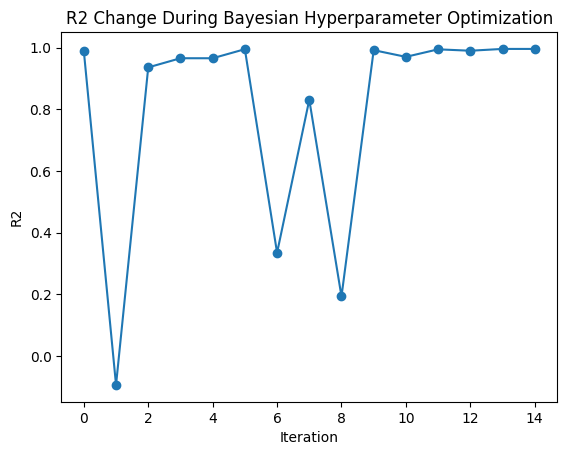

Original Dataset - RMSE: 1.4778512392043766, R2: 0.9999923279051959, MAE: 1.0492049995510064
External Dataset - RMSE: 345.2839050292969, R2: 0.5812014486301575, MAE: 305.2010192871094


In [25]:
# 提取每次迭代的最佳 R2
best_r2_list = []
for res in result.func_vals:
    best_r2_list.append(-res)  # 注意要取负数

# 绘制 R2 的变化过程图
plt.plot(best_r2_list, marker='o')
plt.xlabel('Iteration')
plt.ylabel('R2')
plt.title('R2 Change During Bayesian Hyperparameter Optimization')
plt.show()

import torch
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from sklearn.model_selection import train_test_split

target_column = 'Biogas Production'

# 分离特征和目标变量
X = data.drop(target_column, axis=1)
y = data[target_column]
X_external = external_data.drop(target_column, axis=1)
y_external = external_data[target_column]

# 标准化数据
X_normalized, feature_scaler = normalize_data(X)
y_normalized, target_scaler = normalize_data(y.values.reshape(-1, 1))

# 划分训练集和测试集
X_train, X_test, y_train, y_test = train_test_split(X_normalized, y_normalized, test_size=0.2, random_state=0)

# 转换为 PyTorch 张量
X_train_tensor = torch.from_numpy(X_train).float().to(device)
X_test_tensor = torch.from_numpy(X_test).float().to(device)
y_train_tensor = torch.from_numpy(y_train).float().to(device)
y_test_tensor = torch.from_numpy(y_test).float().to(device)

# 标准化外部数据集
X_external_normalized, _ = normalize_data(X_external)
y_external_normalized, _ = normalize_data(y_external.values.reshape(-1, 1))

# 转换外部数据为张量
X_external_tensor = torch.from_numpy(X_external_normalized).float().to(device)
y_external_tensor = torch.from_numpy(y_external_normalized).float().to(device)

# 模型预测函数
def model_predict(model, X_tensor):
    model.eval()
    with torch.no_grad():
        return model(X_tensor).cpu().numpy()

# 获取预测值
y_pred_train = model_predict(model, X_train_tensor).flatten()
y_pred_test = model_predict(model, X_test_tensor).flatten()
y_pred_external = model_predict(model, X_external_tensor).flatten()

# 反标准化预测值和实际值
y_pred_train_denorm = denormalize_data(y_pred_train.reshape(-1, 1), target_scaler).flatten()
y_pred_test_denorm = denormalize_data(y_pred_test.reshape(-1, 1), target_scaler).flatten()
y_pred_external_denorm = denormalize_data(y_pred_external.reshape(-1, 1), target_scaler).flatten()
y_train_denorm = denormalize_data(y_train, target_scaler).flatten()
y_test_denorm = denormalize_data(y_test, target_scaler).flatten()
y_external_denorm = denormalize_data(y_external_tensor.cpu().numpy(), target_scaler).flatten()


# 合并原始数据集和外部数据集的预测值和实际值
original_data_actual = np.concatenate([y_train_denorm, y_test_denorm])
original_data_predicted = np.concatenate([y_pred_train_denorm, y_pred_test_denorm])
external_data_actual = y_external_denorm
external_data_predicted = y_pred_external_denorm

# 创建 DataFrame
combined_df = pd.DataFrame({
    'Actual': np.concatenate([original_data_actual, external_data_actual]),
    'Predicted': np.concatenate([original_data_predicted, external_data_predicted]),
    'Dataset': ['Original'] * len(original_data_actual) + ['External'] * len(external_data_actual)
})

# 计算原始数据集的指标
train_r2 = r2_score(original_data_actual, original_data_predicted)
train_rmse = mean_squared_error(original_data_actual, original_data_predicted, squared=False)
train_mae = mean_absolute_error(original_data_actual, original_data_predicted)

# 计算外部数据集的指标
external_r2 = r2_score(external_data_actual, external_data_predicted)
external_rmse = mean_squared_error(external_data_actual, external_data_predicted, squared=False)
external_mae = mean_absolute_error(external_data_actual, external_data_predicted)


print(f"Original Dataset - RMSE: {train_rmse}, R2: {train_r2}, MAE: {train_mae}")
print(f"External Dataset - RMSE: {external_rmse}, R2: {external_r2}, MAE: {external_mae}")

Best parameters: [1043, 4.5760312627352067e-10, 0.00010150868235680605, 0.8, 1e-07]


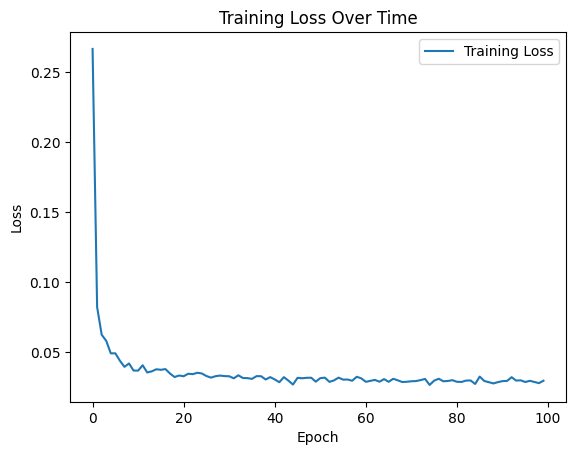

Task Train RMSE: 7.224573612213135, Train R2: 0.9990647222459684, Train MAE: 5.708006858825684
Task Test RMSE: 8.465388298034668, Test R2: 0.9989837952379164, Test MAE: 7.101635932922363
Task Train RMSE: 7.685822010040283, Train R2: 0.9990108740491551, Train MAE: 6.196852684020996
Task Test RMSE: 6.6447834968566895, Test R2: 0.9989858735661004, Test MAE: 5.146237373352051
Task Train RMSE: 7.699111461639404, Train R2: 0.9990375979113154, Train MAE: 6.022846221923828
Task Test RMSE: 6.582958221435547, Test R2: 0.9990746177006096, Test MAE: 5.842276096343994
Task Train RMSE: 7.103559970855713, Train R2: 0.9990553856175892, Train MAE: 5.737454414367676
Task Test RMSE: 8.865580558776855, Test R2: 0.9988702981892678, Test MAE: 6.983850002288818
Task Train RMSE: 7.709564685821533, Train R2: 0.9990440162092971, Train MAE: 6.268497467041016
Task Test RMSE: 6.533842086791992, Test R2: 0.9990266164700796, Test MAE: 4.859667778015137
Task Train RMSE: 6.990911483764648, Train R2: 0.9991150585313937

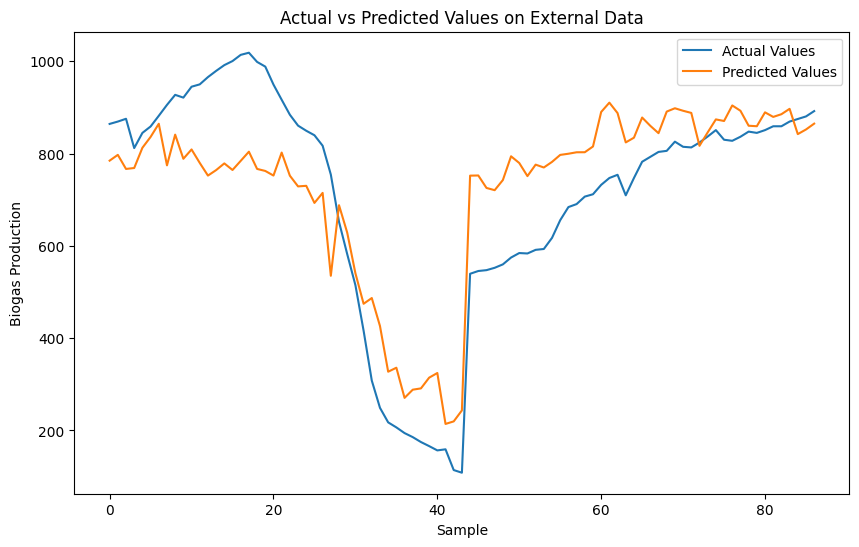

External Dataset - RMSE: 131.64590454101562, R2: 0.7163391514345316, MAE: 113.56107330322266


In [26]:
import torch
from torch import nn, optim
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split, KFold
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from skopt import gp_minimize
from skopt.space import Real, Integer
from skopt.utils import use_named_args
import matplotlib.pyplot as plt
import learn2learn as l2l
import numpy as np
import torch

np.random.seed(0)  # 设置NumPy的随机种子
torch.manual_seed(0)  # 设置PyTorch的随机种子

device = torch.device("cuda:0")  # Use GPU 0

# Hyperparameter search space
search_space = [
    Integer(500, 1500, name='hidden_size'), 
    Real(1e-11, 1e-6, "log-uniform", name='alpha'),  
    Real(1e-7, 1e-3, "log-uniform", name='beta'),
    Real(0.1, 0.8, name='dropout_rate'), 
    Real(1e-7, 1e-1, "log-uniform", name='weight_decay') 
]

# Data normalization and denormalization functions
def normalize_data(data):
    scaler = StandardScaler()
    return scaler.fit_transform(data), scaler

def normalize_feature(data, column_name):
    scaler = StandardScaler()
    scaled_data = scaler.fit_transform(data[[column_name]])
    return scaled_data, scaler

def denormalize_data(normalized_data, scaler):
    return scaler.inverse_transform(normalized_data)

# Advanced neural network architecture
class AdvancedNeuralNetwork(nn.Module):
    def __init__(self, input_size, hidden_size, dropout_rate):
        super(AdvancedNeuralNetwork, self).__init__()
        self.layer1 = nn.Linear(input_size, hidden_size)
        self.relu1 = nn.LeakyReLU()
        self.layer2 = nn.Linear(hidden_size, hidden_size // 2)
        self.relu2 = nn.LeakyReLU()
        self.layer3 = nn.Linear(hidden_size // 2, hidden_size // 4)
        self.relu3 = nn.LeakyReLU()
        self.dropout = nn.Dropout(dropout_rate)
        self.layer4 = nn.Linear(hidden_size // 4, 1)

    def forward(self, x):
        x = self.relu1(self.layer1(x))
        x = self.relu2(self.layer2(x))
        x = self.relu3(self.layer3(x))
        x = self.dropout(x)
        x = self.layer4(x)
        return x

# Task creation function
def create_tasks(data, target_column, num_tasks=50, task_size=50):
    tasks = []
    for _ in range(num_tasks):
        task_data = data.sample(task_size)
        X, y = task_data.drop(target_column, axis=1), task_data[target_column]
        tasks.append((X, y))
    return tasks

# Early stopping class
class EarlyStopping:
    def __init__(self, patience=5, delta=0):
        self.patience = patience
        self.counter = 0
        self.best_score = None
        self.early_stop = False
        self.delta = delta

    def __call__(self, val_loss, model):
        score = -val_loss
        if self.best_score is None:
            self.best_score = score
        elif score < self.best_score + self.delta:
            self.counter += 1
            if self.counter >= self.patience:
                self.early_stop = True
        else:
            self.best_score = score
            self.counter = 0

# MAML fast adaptation and meta-training
def meta_train_maml(model, tasks, alpha, beta, weight_decay, epochs=100, num_steps=1):
    early_stopping = EarlyStopping(patience=10, delta=0.01)
    optimizer = optim.Adam(model.parameters(), lr=beta, weight_decay=weight_decay)
    scheduler = optim.lr_scheduler.CosineAnnealingLR(optimizer, T_max=epochs)

    epoch_loss_list = []  # Initialize a list to store losses for each epoch

    for epoch in range(epochs):
        epoch_losses = []
        for task in tasks:
            learner = model.clone()  # Clone the model
            task_X, task_y = task
            task_X = torch.from_numpy(task_X.values).float().to(device)
            task_y = torch.from_numpy(task_y.values).float().to(device)

            # Fast adaptation
            for step in range(num_steps):
                pred_y = learner(task_X)
                loss = nn.functional.mse_loss(pred_y.squeeze(), task_y)
                learner.adapt(loss)

            # Meta-update
            optimizer.zero_grad()
            pred_y = learner(task_X)
            loss = nn.functional.mse_loss(pred_y.squeeze(), task_y)
            epoch_losses.append(loss.item())
            loss.backward()
            optimizer.step()

        scheduler.step()  # Update learning rate
        average_loss = np.mean(epoch_losses)
        epoch_loss_list.append(average_loss)  # Add each epoch's average loss to the list

        if early_stopping(average_loss, model):
            print(f"Early stopping triggered at epoch {epoch}")
            break

    return epoch_loss_list  # Return the list of epoch losses



@use_named_args(search_space)
def objective(hidden_size, alpha, beta, dropout_rate, weight_decay):
    model = AdvancedNeuralNetwork(input_size, hidden_size, dropout_rate)
    model = l2l.algorithms.MAML(model, lr=alpha).to(device)
    avg_r2 = 0

    task_r2_list = []  # 记录每个任务的 R2

    for task in tasks:
        task_X, task_y = task
        task_X_train, task_X_test, task_y_train, task_y_test = train_test_split(task_X, task_y, test_size=0.2, random_state=0)
        meta_train_maml(model, [(task_X_train, task_y_train)], alpha, beta, weight_decay, epochs=100)
        train_rmse, train_r2, train_mae, test_rmse, test_r2, test_mae = evaluate_model(model, task_X_train, task_y_train, task_X_test, task_y_test, target_scaler)
        task_r2_list.append(test_r2)  # 记录每个任务的测试 R2
        avg_r2 += test_r2

    avg_r2 /= len(tasks)
    return -avg_r2  # 这里返回负数因为 skopt 的目标函数是最小化，而我们想要最大化 R2


# Evaluation function
def evaluate_model(model, X_train, y_train, X_test, y_test, target_scaler):
    model.eval()
    with torch.no_grad():
        # Convert data to tensors
        X_train_tensor = torch.from_numpy(X_train.values).float().to(device)
        y_train_tensor = torch.from_numpy(y_train.values).float().to(device)
        X_test_tensor = torch.from_numpy(X_test.values).float().to(device)
        y_test_tensor = torch.from_numpy(y_test.values).float().to(device)

        # Get predictions
        train_predictions = model(X_train_tensor).squeeze().cpu().numpy()
        test_predictions = model(X_test_tensor).squeeze().cpu().numpy()

        # Reshape predictions for denormalization
        train_predictions_reshaped = train_predictions.reshape(-1, 1)
        test_predictions_reshaped = test_predictions.reshape(-1, 1)

        # Denormalize predictions using target_scaler
        train_predictions_denorm = denormalize_data(train_predictions_reshaped, target_scaler)
        test_predictions_denorm = denormalize_data(test_predictions_reshaped, target_scaler)

        # Denormalize actual values using target_scaler
        y_train_denorm = denormalize_data(y_train_tensor.cpu().numpy().reshape(-1, 1), target_scaler)
        y_test_denorm = denormalize_data(y_test_tensor.cpu().numpy().reshape(-1, 1), target_scaler)

        # Calculate metrics using denormalized data
        train_rmse = mean_squared_error(y_train_denorm, train_predictions_denorm, squared=False)
        train_r2 = r2_score(y_train_denorm, train_predictions_denorm)
        train_mae = mean_absolute_error(y_train_denorm, train_predictions_denorm)

        test_rmse = mean_squared_error(y_test_denorm, test_predictions_denorm, squared=False)
        test_r2 = r2_score(y_test_denorm, test_predictions_denorm)
        test_mae = mean_absolute_error(y_test_denorm, test_predictions_denorm)

    return train_rmse, train_r2, train_mae, test_rmse, test_r2, test_mae

# Load and normalize data
data = pd.read_csv("C:\\Users\\Lenovo\\Desktop\\元学习\\BT(2)4-1.csv")
data_normalized, scaler = normalize_data(data)
target_normalized, target_scaler = normalize_feature(data, 'Biogas Production')
# Create tasks using the normalized dataset
input_size = data.shape[1] - 1 
tasks = create_tasks(pd.DataFrame(data_normalized, columns=data.columns), target_column='Biogas Production')

# Execute hyperparameter optimization
result = gp_minimize(objective, search_space, n_calls=15,random_state=0)
hidden_size, alpha, beta, dropout_rate, weight_decay = result.x
print("Best parameters:", result.x)

# Train model with optimized hyperparameters
model = AdvancedNeuralNetwork(input_size, hidden_size, dropout_rate)
model = l2l.algorithms.MAML(model, lr=alpha).to(device)
train_losses = meta_train_maml(model, tasks, alpha, beta, weight_decay, epochs=100)

# Visualize training losses
plt.plot(train_losses, label='Training Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training Loss Over Time')
plt.legend()
plt.show()

# Final model evaluation
for task in tasks:
    X, y = task
    kf = KFold(n_splits=5, shuffle=True, random_state=0)
    for train_index, test_index in kf.split(X):
        X_train, X_test = X.iloc[train_index], X.iloc[test_index]
        y_train, y_test = y.iloc[train_index], y.iloc[test_index]
        train_rmse, train_r2, train_mae, test_rmse, test_r2, test_mae = evaluate_model(model, X_train, y_train, X_test, y_test, target_scaler)
        print(f"Task Train RMSE: {train_rmse}, Train R2: {train_r2}, Train MAE: {train_mae}")
        print(f"Task Test RMSE: {test_rmse}, Test R2: {test_r2}, Test MAE: {test_mae}")


# Load and process external data for evaluation
external_data = pd.read_csv("C:\\Users\\Lenovo\\Desktop\\元学习\\BT(2)4-2.csv")
external_data_normalized, _ = normalize_data(external_data)
external_target_normalized, _ = normalize_feature(external_data, 'Biogas Production')
external_X = torch.from_numpy(pd.DataFrame(external_data_normalized, columns=external_data.columns).drop('Biogas Production', axis=1).values).float().to(device)
external_y_normalized = torch.from_numpy(external_target_normalized).float().to(device)

# Model prediction on external data
learner = model.clone()  # Clone the model for evaluation
learner.eval()
with torch.no_grad():
    external_predictions_normalized = learner(external_X).squeeze()
external_predictions = denormalize_data(external_predictions_normalized.cpu().numpy().reshape(-1, 1), target_scaler)
external_y = denormalize_data(external_y_normalized.cpu().numpy().reshape(-1, 1), target_scaler)

# Visualization of predictions on external data
plt.figure(figsize=(10, 6))
plt.plot(external_y, label='Actual Values')
plt.plot(external_predictions, label='Predicted Values')
plt.xlabel('Sample')
plt.ylabel('Biogas Production')
plt.title('Actual vs Predicted Values on External Data')
plt.legend()
plt.show()

# Evaluate on external dataset using denormalized data
external_rmse = mean_squared_error(external_y, external_predictions, squared=False)
external_r2 = r2_score(external_y, external_predictions)
external_mae = mean_absolute_error(external_y, external_predictions)

print(f"External Dataset - RMSE: {external_rmse}, R2: {external_r2}, MAE: {external_mae}")

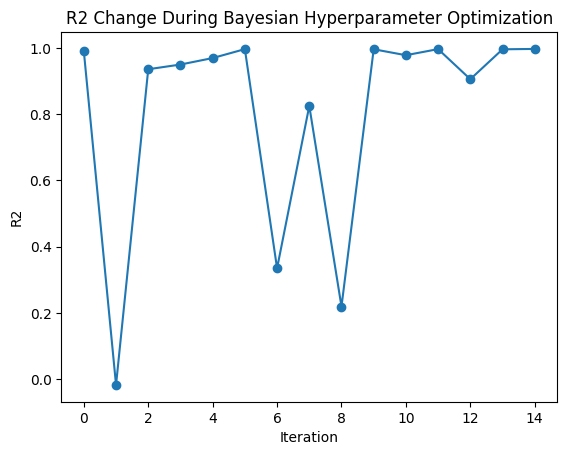

Original Dataset - RMSE: 7.4833824229789085, R2: 0.9990833984822758, MAE: 6.016642782132923
External Dataset - RMSE: 131.64590454101562, R2: 0.7163391514345316, MAE: 113.56107330322266


In [27]:
# 提取每次迭代的最佳 R2
best_r2_list = []
for res in result.func_vals:
    best_r2_list.append(-res)  # 注意要取负数

# 绘制 R2 的变化过程图
plt.plot(best_r2_list, marker='o')
plt.xlabel('Iteration')
plt.ylabel('R2')
plt.title('R2 Change During Bayesian Hyperparameter Optimization')
plt.show()

import torch
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from sklearn.model_selection import train_test_split

target_column = 'Biogas Production'

# 分离特征和目标变量
X = data.drop(target_column, axis=1)
y = data[target_column]
X_external = external_data.drop(target_column, axis=1)
y_external = external_data[target_column]

# 标准化数据
X_normalized, feature_scaler = normalize_data(X)
y_normalized, target_scaler = normalize_data(y.values.reshape(-1, 1))

# 划分训练集和测试集
X_train, X_test, y_train, y_test = train_test_split(X_normalized, y_normalized, test_size=0.2, random_state=0)

# 转换为 PyTorch 张量
X_train_tensor = torch.from_numpy(X_train).float().to(device)
X_test_tensor = torch.from_numpy(X_test).float().to(device)
y_train_tensor = torch.from_numpy(y_train).float().to(device)
y_test_tensor = torch.from_numpy(y_test).float().to(device)

# 标准化外部数据集
X_external_normalized, _ = normalize_data(X_external)
y_external_normalized, _ = normalize_data(y_external.values.reshape(-1, 1))

# 转换外部数据为张量
X_external_tensor = torch.from_numpy(X_external_normalized).float().to(device)
y_external_tensor = torch.from_numpy(y_external_normalized).float().to(device)

# 模型预测函数
def model_predict(model, X_tensor):
    model.eval()
    with torch.no_grad():
        return model(X_tensor).cpu().numpy()

# 获取预测值
y_pred_train = model_predict(model, X_train_tensor).flatten()
y_pred_test = model_predict(model, X_test_tensor).flatten()
y_pred_external = model_predict(model, X_external_tensor).flatten()

# 反标准化预测值和实际值
y_pred_train_denorm = denormalize_data(y_pred_train.reshape(-1, 1), target_scaler).flatten()
y_pred_test_denorm = denormalize_data(y_pred_test.reshape(-1, 1), target_scaler).flatten()
y_pred_external_denorm = denormalize_data(y_pred_external.reshape(-1, 1), target_scaler).flatten()
y_train_denorm = denormalize_data(y_train, target_scaler).flatten()
y_test_denorm = denormalize_data(y_test, target_scaler).flatten()
y_external_denorm = denormalize_data(y_external_tensor.cpu().numpy(), target_scaler).flatten()


# 合并原始数据集和外部数据集的预测值和实际值
original_data_actual = np.concatenate([y_train_denorm, y_test_denorm])
original_data_predicted = np.concatenate([y_pred_train_denorm, y_pred_test_denorm])
external_data_actual = y_external_denorm
external_data_predicted = y_pred_external_denorm

# 创建 DataFrame
combined_df = pd.DataFrame({
    'Actual': np.concatenate([original_data_actual, external_data_actual]),
    'Predicted': np.concatenate([original_data_predicted, external_data_predicted]),
    'Dataset': ['Original'] * len(original_data_actual) + ['External'] * len(external_data_actual)
})

# 计算原始数据集的指标
train_r2 = r2_score(original_data_actual, original_data_predicted)
train_rmse = mean_squared_error(original_data_actual, original_data_predicted, squared=False)
train_mae = mean_absolute_error(original_data_actual, original_data_predicted)

# 计算外部数据集的指标
external_r2 = r2_score(external_data_actual, external_data_predicted)
external_rmse = mean_squared_error(external_data_actual, external_data_predicted, squared=False)
external_mae = mean_absolute_error(external_data_actual, external_data_predicted)


print(f"Original Dataset - RMSE: {train_rmse}, R2: {train_r2}, MAE: {train_mae}")
print(f"External Dataset - RMSE: {external_rmse}, R2: {external_r2}, MAE: {external_mae}")

Best parameters: [1500, 1e-11, 0.001, 0.8, 1e-07]


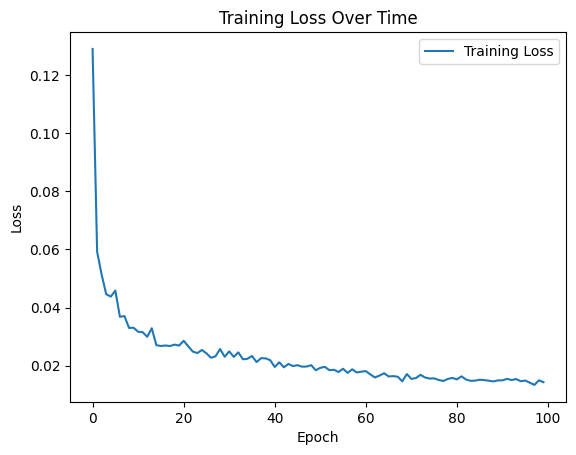

Task Train RMSE: 10.292584419250488, Train R2: 0.9997067927239861, Train MAE: 9.078150749206543
Task Test RMSE: 9.526354789733887, Test R2: 0.9997212602688466, Test MAE: 7.847601413726807
Task Train RMSE: 10.199199676513672, Train R2: 0.9997036297879125, Train MAE: 8.823393821716309
Task Test RMSE: 9.919955253601074, Test R2: 0.9997318214252016, Test MAE: 8.866610527038574
Task Train RMSE: 10.348064422607422, Train R2: 0.9996987035385042, Train MAE: 9.024922370910645
Task Test RMSE: 9.2828369140625, Test R2: 0.9997359756114265, Test MAE: 8.060522079467773
Task Train RMSE: 9.568861961364746, Train R2: 0.9997260043913335, Train MAE: 8.25603199005127
Task Test RMSE: 12.175722122192383, Test R2: 0.9996582091646212, Test MAE: 11.136077880859375
Task Train RMSE: 10.290471076965332, Train R2: 0.9997105752551577, Train MAE: 8.977693557739258
Task Test RMSE: 9.535447120666504, Test R2: 0.9996576944643908, Test MAE: 8.249404907226562
Task Train RMSE: 11.454508781433105, Train R2: 0.9996458724273

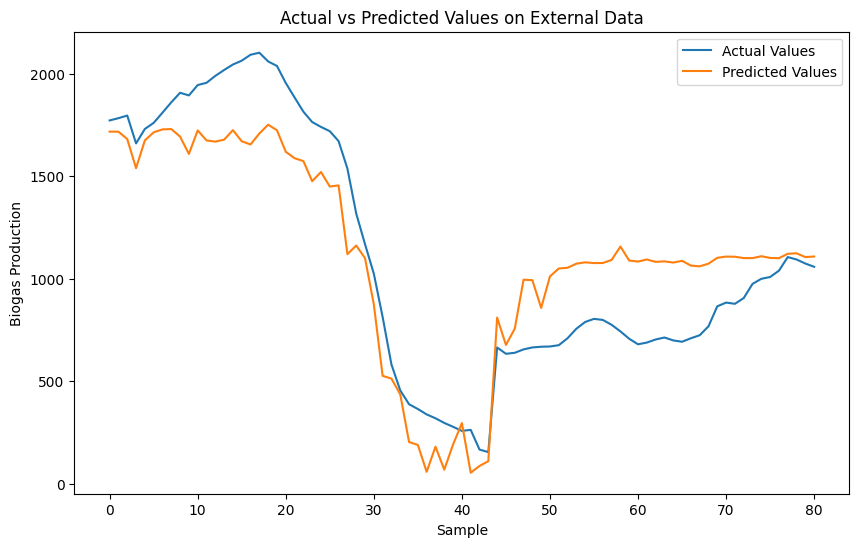

External Dataset - RMSE: 256.63116455078125, R2: 0.8150041637858879, MAE: 224.8607177734375


In [28]:
import torch
from torch import nn, optim
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split, KFold
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from skopt import gp_minimize
from skopt.space import Real, Integer
from skopt.utils import use_named_args
import matplotlib.pyplot as plt
import learn2learn as l2l
import numpy as np
import torch

np.random.seed(0)  # 设置NumPy的随机种子
torch.manual_seed(0)  # 设置PyTorch的随机种子

device = torch.device("cuda:0")  # Use GPU 0

# Hyperparameter search space
search_space = [
    Integer(500, 1500, name='hidden_size'), 
    Real(1e-11, 1e-6, "log-uniform", name='alpha'),  
    Real(1e-7, 1e-3, "log-uniform", name='beta'),
    Real(0.1, 0.8, name='dropout_rate'), 
    Real(1e-7, 1e-1, "log-uniform", name='weight_decay') 
]

# Data normalization and denormalization functions
def normalize_data(data):
    scaler = StandardScaler()
    return scaler.fit_transform(data), scaler

def normalize_feature(data, column_name):
    scaler = StandardScaler()
    scaled_data = scaler.fit_transform(data[[column_name]])
    return scaled_data, scaler

def denormalize_data(normalized_data, scaler):
    return scaler.inverse_transform(normalized_data)

# Advanced neural network architecture
class AdvancedNeuralNetwork(nn.Module):
    def __init__(self, input_size, hidden_size, dropout_rate):
        super(AdvancedNeuralNetwork, self).__init__()
        self.layer1 = nn.Linear(input_size, hidden_size)
        self.relu1 = nn.LeakyReLU()
        self.layer2 = nn.Linear(hidden_size, hidden_size // 2)
        self.relu2 = nn.LeakyReLU()
        self.layer3 = nn.Linear(hidden_size // 2, hidden_size // 4)
        self.relu3 = nn.LeakyReLU()
        self.dropout = nn.Dropout(dropout_rate)
        self.layer4 = nn.Linear(hidden_size // 4, 1)

    def forward(self, x):
        x = self.relu1(self.layer1(x))
        x = self.relu2(self.layer2(x))
        x = self.relu3(self.layer3(x))
        x = self.dropout(x)
        x = self.layer4(x)
        return x

# Task creation function
def create_tasks(data, target_column, num_tasks=50, task_size=50):
    tasks = []
    for _ in range(num_tasks):
        task_data = data.sample(task_size)
        X, y = task_data.drop(target_column, axis=1), task_data[target_column]
        tasks.append((X, y))
    return tasks

# Early stopping class
class EarlyStopping:
    def __init__(self, patience=5, delta=0):
        self.patience = patience
        self.counter = 0
        self.best_score = None
        self.early_stop = False
        self.delta = delta

    def __call__(self, val_loss, model):
        score = -val_loss
        if self.best_score is None:
            self.best_score = score
        elif score < self.best_score + self.delta:
            self.counter += 1
            if self.counter >= self.patience:
                self.early_stop = True
        else:
            self.best_score = score
            self.counter = 0

# MAML fast adaptation and meta-training
def meta_train_maml(model, tasks, alpha, beta, weight_decay, epochs=100, num_steps=1):
    early_stopping = EarlyStopping(patience=10, delta=0.01)
    optimizer = optim.Adam(model.parameters(), lr=beta, weight_decay=weight_decay)
    scheduler = optim.lr_scheduler.CosineAnnealingLR(optimizer, T_max=epochs)

    epoch_loss_list = []  # Initialize a list to store losses for each epoch

    for epoch in range(epochs):
        epoch_losses = []
        for task in tasks:
            learner = model.clone()  # Clone the model
            task_X, task_y = task
            task_X = torch.from_numpy(task_X.values).float().to(device)
            task_y = torch.from_numpy(task_y.values).float().to(device)

            # Fast adaptation
            for step in range(num_steps):
                pred_y = learner(task_X)
                loss = nn.functional.mse_loss(pred_y.squeeze(), task_y)
                learner.adapt(loss)

            # Meta-update
            optimizer.zero_grad()
            pred_y = learner(task_X)
            loss = nn.functional.mse_loss(pred_y.squeeze(), task_y)
            epoch_losses.append(loss.item())
            loss.backward()
            optimizer.step()

        scheduler.step()  # Update learning rate
        average_loss = np.mean(epoch_losses)
        epoch_loss_list.append(average_loss)  # Add each epoch's average loss to the list

        if early_stopping(average_loss, model):
            print(f"Early stopping triggered at epoch {epoch}")
            break

    return epoch_loss_list  # Return the list of epoch losses



@use_named_args(search_space)
def objective(hidden_size, alpha, beta, dropout_rate, weight_decay):
    model = AdvancedNeuralNetwork(input_size, hidden_size, dropout_rate)
    model = l2l.algorithms.MAML(model, lr=alpha).to(device)
    avg_r2 = 0

    task_r2_list = []  # 记录每个任务的 R2

    for task in tasks:
        task_X, task_y = task
        task_X_train, task_X_test, task_y_train, task_y_test = train_test_split(task_X, task_y, test_size=0.2, random_state=0)
        meta_train_maml(model, [(task_X_train, task_y_train)], alpha, beta, weight_decay, epochs=100)
        train_rmse, train_r2, train_mae, test_rmse, test_r2, test_mae = evaluate_model(model, task_X_train, task_y_train, task_X_test, task_y_test, target_scaler)
        task_r2_list.append(test_r2)  # 记录每个任务的测试 R2
        avg_r2 += test_r2

    avg_r2 /= len(tasks)
    return -avg_r2  # 这里返回负数因为 skopt 的目标函数是最小化，而我们想要最大化 R2


# Evaluation function
def evaluate_model(model, X_train, y_train, X_test, y_test, target_scaler):
    model.eval()
    with torch.no_grad():
        # Convert data to tensors
        X_train_tensor = torch.from_numpy(X_train.values).float().to(device)
        y_train_tensor = torch.from_numpy(y_train.values).float().to(device)
        X_test_tensor = torch.from_numpy(X_test.values).float().to(device)
        y_test_tensor = torch.from_numpy(y_test.values).float().to(device)

        # Get predictions
        train_predictions = model(X_train_tensor).squeeze().cpu().numpy()
        test_predictions = model(X_test_tensor).squeeze().cpu().numpy()

        # Reshape predictions for denormalization
        train_predictions_reshaped = train_predictions.reshape(-1, 1)
        test_predictions_reshaped = test_predictions.reshape(-1, 1)

        # Denormalize predictions using target_scaler
        train_predictions_denorm = denormalize_data(train_predictions_reshaped, target_scaler)
        test_predictions_denorm = denormalize_data(test_predictions_reshaped, target_scaler)

        # Denormalize actual values using target_scaler
        y_train_denorm = denormalize_data(y_train_tensor.cpu().numpy().reshape(-1, 1), target_scaler)
        y_test_denorm = denormalize_data(y_test_tensor.cpu().numpy().reshape(-1, 1), target_scaler)

        # Calculate metrics using denormalized data
        train_rmse = mean_squared_error(y_train_denorm, train_predictions_denorm, squared=False)
        train_r2 = r2_score(y_train_denorm, train_predictions_denorm)
        train_mae = mean_absolute_error(y_train_denorm, train_predictions_denorm)

        test_rmse = mean_squared_error(y_test_denorm, test_predictions_denorm, squared=False)
        test_r2 = r2_score(y_test_denorm, test_predictions_denorm)
        test_mae = mean_absolute_error(y_test_denorm, test_predictions_denorm)

    return train_rmse, train_r2, train_mae, test_rmse, test_r2, test_mae

# Load and normalize data
data = pd.read_csv("C:\\Users\\Lenovo\\Desktop\\元学习\\BT(2)5-1.csv")
data_normalized, scaler = normalize_data(data)
target_normalized, target_scaler = normalize_feature(data, 'Biogas Production')
# Create tasks using the normalized dataset
input_size = data.shape[1] - 1 
tasks = create_tasks(pd.DataFrame(data_normalized, columns=data.columns), target_column='Biogas Production')

# Execute hyperparameter optimization
result = gp_minimize(objective, search_space, n_calls=15,random_state=0)
hidden_size, alpha, beta, dropout_rate, weight_decay = result.x
print("Best parameters:", result.x)

# Train model with optimized hyperparameters
model = AdvancedNeuralNetwork(input_size, hidden_size, dropout_rate)
model = l2l.algorithms.MAML(model, lr=alpha).to(device)
train_losses = meta_train_maml(model, tasks, alpha, beta, weight_decay, epochs=100)

# Visualize training losses
plt.plot(train_losses, label='Training Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training Loss Over Time')
plt.legend()
plt.show()

# Final model evaluation
for task in tasks:
    X, y = task
    kf = KFold(n_splits=5, shuffle=True, random_state=0)
    for train_index, test_index in kf.split(X):
        X_train, X_test = X.iloc[train_index], X.iloc[test_index]
        y_train, y_test = y.iloc[train_index], y.iloc[test_index]
        train_rmse, train_r2, train_mae, test_rmse, test_r2, test_mae = evaluate_model(model, X_train, y_train, X_test, y_test, target_scaler)
        print(f"Task Train RMSE: {train_rmse}, Train R2: {train_r2}, Train MAE: {train_mae}")
        print(f"Task Test RMSE: {test_rmse}, Test R2: {test_r2}, Test MAE: {test_mae}")


# Load and process external data for evaluation
external_data = pd.read_csv("C:\\Users\\Lenovo\\Desktop\\元学习\\BT(2)5-2.csv")
external_data_normalized, _ = normalize_data(external_data)
external_target_normalized, _ = normalize_feature(external_data, 'Biogas Production')
external_X = torch.from_numpy(pd.DataFrame(external_data_normalized, columns=external_data.columns).drop('Biogas Production', axis=1).values).float().to(device)
external_y_normalized = torch.from_numpy(external_target_normalized).float().to(device)

# Model prediction on external data
learner = model.clone()  # Clone the model for evaluation
learner.eval()
with torch.no_grad():
    external_predictions_normalized = learner(external_X).squeeze()
external_predictions = denormalize_data(external_predictions_normalized.cpu().numpy().reshape(-1, 1), target_scaler)
external_y = denormalize_data(external_y_normalized.cpu().numpy().reshape(-1, 1), target_scaler)

# Visualization of predictions on external data
plt.figure(figsize=(10, 6))
plt.plot(external_y, label='Actual Values')
plt.plot(external_predictions, label='Predicted Values')
plt.xlabel('Sample')
plt.ylabel('Biogas Production')
plt.title('Actual vs Predicted Values on External Data')
plt.legend()
plt.show()

# Evaluate on external dataset using denormalized data
external_rmse = mean_squared_error(external_y, external_predictions, squared=False)
external_r2 = r2_score(external_y, external_predictions)
external_mae = mean_absolute_error(external_y, external_predictions)

print(f"External Dataset - RMSE: {external_rmse}, R2: {external_r2}, MAE: {external_mae}")

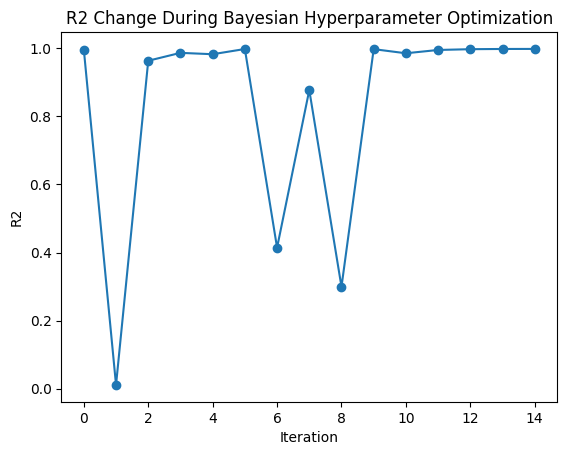

Original Dataset - RMSE: 10.610677616098114, R2: 0.9996837507493298, MAE: 9.328087513597705
External Dataset - RMSE: 256.63116455078125, R2: 0.8150041637858879, MAE: 224.8607177734375


In [29]:
# 提取每次迭代的最佳 R2
best_r2_list = []
for res in result.func_vals:
    best_r2_list.append(-res)  # 注意要取负数

# 绘制 R2 的变化过程图
plt.plot(best_r2_list, marker='o')
plt.xlabel('Iteration')
plt.ylabel('R2')
plt.title('R2 Change During Bayesian Hyperparameter Optimization')
plt.show()

import torch
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from sklearn.model_selection import train_test_split

target_column = 'Biogas Production'

# 分离特征和目标变量
X = data.drop(target_column, axis=1)
y = data[target_column]
X_external = external_data.drop(target_column, axis=1)
y_external = external_data[target_column]

# 标准化数据
X_normalized, feature_scaler = normalize_data(X)
y_normalized, target_scaler = normalize_data(y.values.reshape(-1, 1))

# 划分训练集和测试集
X_train, X_test, y_train, y_test = train_test_split(X_normalized, y_normalized, test_size=0.2, random_state=0)

# 转换为 PyTorch 张量
X_train_tensor = torch.from_numpy(X_train).float().to(device)
X_test_tensor = torch.from_numpy(X_test).float().to(device)
y_train_tensor = torch.from_numpy(y_train).float().to(device)
y_test_tensor = torch.from_numpy(y_test).float().to(device)

# 标准化外部数据集
X_external_normalized, _ = normalize_data(X_external)
y_external_normalized, _ = normalize_data(y_external.values.reshape(-1, 1))

# 转换外部数据为张量
X_external_tensor = torch.from_numpy(X_external_normalized).float().to(device)
y_external_tensor = torch.from_numpy(y_external_normalized).float().to(device)

# 模型预测函数
def model_predict(model, X_tensor):
    model.eval()
    with torch.no_grad():
        return model(X_tensor).cpu().numpy()

# 获取预测值
y_pred_train = model_predict(model, X_train_tensor).flatten()
y_pred_test = model_predict(model, X_test_tensor).flatten()
y_pred_external = model_predict(model, X_external_tensor).flatten()

# 反标准化预测值和实际值
y_pred_train_denorm = denormalize_data(y_pred_train.reshape(-1, 1), target_scaler).flatten()
y_pred_test_denorm = denormalize_data(y_pred_test.reshape(-1, 1), target_scaler).flatten()
y_pred_external_denorm = denormalize_data(y_pred_external.reshape(-1, 1), target_scaler).flatten()
y_train_denorm = denormalize_data(y_train, target_scaler).flatten()
y_test_denorm = denormalize_data(y_test, target_scaler).flatten()
y_external_denorm = denormalize_data(y_external_tensor.cpu().numpy(), target_scaler).flatten()


# 合并原始数据集和外部数据集的预测值和实际值
original_data_actual = np.concatenate([y_train_denorm, y_test_denorm])
original_data_predicted = np.concatenate([y_pred_train_denorm, y_pred_test_denorm])
external_data_actual = y_external_denorm
external_data_predicted = y_pred_external_denorm

# 创建 DataFrame
combined_df = pd.DataFrame({
    'Actual': np.concatenate([original_data_actual, external_data_actual]),
    'Predicted': np.concatenate([original_data_predicted, external_data_predicted]),
    'Dataset': ['Original'] * len(original_data_actual) + ['External'] * len(external_data_actual)
})

# 计算原始数据集的指标
train_r2 = r2_score(original_data_actual, original_data_predicted)
train_rmse = mean_squared_error(original_data_actual, original_data_predicted, squared=False)
train_mae = mean_absolute_error(original_data_actual, original_data_predicted)

# 计算外部数据集的指标
external_r2 = r2_score(external_data_actual, external_data_predicted)
external_rmse = mean_squared_error(external_data_actual, external_data_predicted, squared=False)
external_mae = mean_absolute_error(external_data_actual, external_data_predicted)


print(f"Original Dataset - RMSE: {train_rmse}, R2: {train_r2}, MAE: {train_mae}")
print(f"External Dataset - RMSE: {external_rmse}, R2: {external_r2}, MAE: {external_mae}")

Best parameters: [1082, 4.8625731451155695e-09, 0.00010825862263250658, 0.1741353250314545, 6.943884941608576e-05]


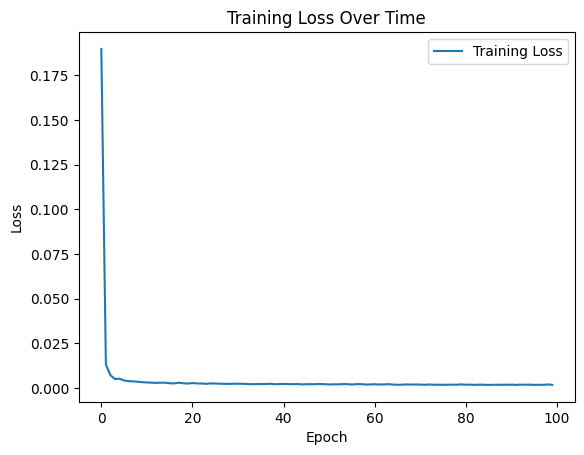

Task Train RMSE: 1.242942214012146, Train R2: 0.9999905943856282, Train MAE: 1.0168640613555908
Task Test RMSE: 1.1989198923110962, Test R2: 0.9999901030617404, Test MAE: 0.96124267578125
Task Train RMSE: 1.2127420902252197, Train R2: 0.99999109157238, Train MAE: 0.9832245111465454
Task Test RMSE: 1.3168296813964844, Test R2: 0.999988000185929, Test MAE: 1.095794677734375
Task Train RMSE: 1.275676965713501, Train R2: 0.9999899580573766, Train MAE: 1.0490630865097046
Task Test RMSE: 1.0524259805679321, Test R2: 0.999992489429733, Test MAE: 0.832440197467804
Task Train RMSE: 1.1552469730377197, Train R2: 0.9999911591433813, Train MAE: 0.9320098757743835
Task Test RMSE: 1.5095211267471313, Test R2: 0.9999886481967977, Test MAE: 1.300665259361267
Task Train RMSE: 1.280403971672058, Train R2: 0.999989836575133, Train MAE: 1.0475372076034546
Task Test RMSE: 1.0292197465896606, Test R2: 0.9999922975418746, Test MAE: 0.838549792766571
Task Train RMSE: 1.3787461519241333, Train R2: 0.9999890422

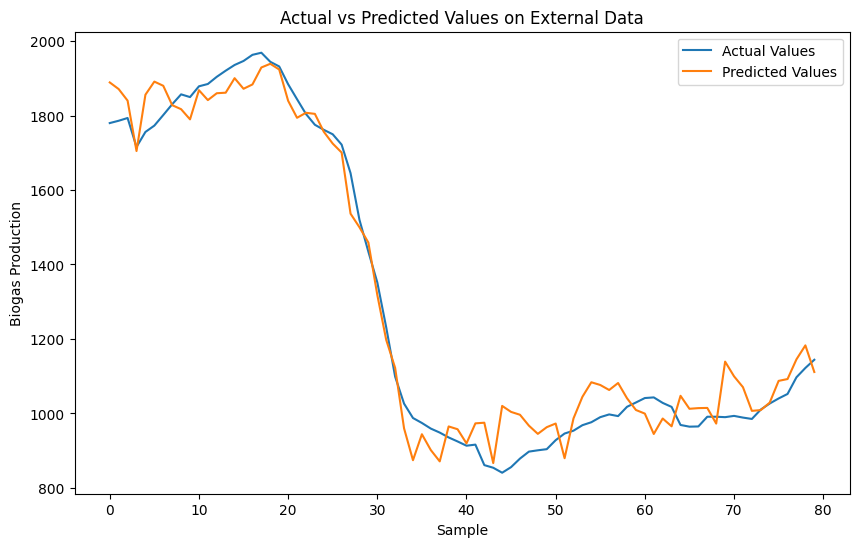

External Dataset - RMSE: 66.15377044677734, R2: 0.9740988272727927, MAE: 54.30479049682617


In [30]:
import torch
from torch import nn, optim
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split, KFold
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from skopt import gp_minimize
from skopt.space import Real, Integer
from skopt.utils import use_named_args
import matplotlib.pyplot as plt
import learn2learn as l2l
import numpy as np
import torch

np.random.seed(0)  # 设置NumPy的随机种子
torch.manual_seed(0)  # 设置PyTorch的随机种子

device = torch.device("cuda:0")  # Use GPU 0

# Hyperparameter search space
search_space = [
    Integer(500, 1500, name='hidden_size'), 
    Real(1e-11, 1e-6, "log-uniform", name='alpha'),  
    Real(1e-7, 1e-3, "log-uniform", name='beta'),
    Real(0.1, 0.8, name='dropout_rate'), 
    Real(1e-7, 1e-1, "log-uniform", name='weight_decay') 
]

# Data normalization and denormalization functions
def normalize_data(data):
    scaler = StandardScaler()
    return scaler.fit_transform(data), scaler

def normalize_feature(data, column_name):
    scaler = StandardScaler()
    scaled_data = scaler.fit_transform(data[[column_name]])
    return scaled_data, scaler

def denormalize_data(normalized_data, scaler):
    return scaler.inverse_transform(normalized_data)

# Advanced neural network architecture
class AdvancedNeuralNetwork(nn.Module):
    def __init__(self, input_size, hidden_size, dropout_rate):
        super(AdvancedNeuralNetwork, self).__init__()
        self.layer1 = nn.Linear(input_size, hidden_size)
        self.relu1 = nn.LeakyReLU()
        self.layer2 = nn.Linear(hidden_size, hidden_size // 2)
        self.relu2 = nn.LeakyReLU()
        self.layer3 = nn.Linear(hidden_size // 2, hidden_size // 4)
        self.relu3 = nn.LeakyReLU()
        self.dropout = nn.Dropout(dropout_rate)
        self.layer4 = nn.Linear(hidden_size // 4, 1)

    def forward(self, x):
        x = self.relu1(self.layer1(x))
        x = self.relu2(self.layer2(x))
        x = self.relu3(self.layer3(x))
        x = self.dropout(x)
        x = self.layer4(x)
        return x

# Task creation function
def create_tasks(data, target_column, num_tasks=50, task_size=50):
    tasks = []
    for _ in range(num_tasks):
        task_data = data.sample(task_size)
        X, y = task_data.drop(target_column, axis=1), task_data[target_column]
        tasks.append((X, y))
    return tasks

# Early stopping class
class EarlyStopping:
    def __init__(self, patience=5, delta=0):
        self.patience = patience
        self.counter = 0
        self.best_score = None
        self.early_stop = False
        self.delta = delta

    def __call__(self, val_loss, model):
        score = -val_loss
        if self.best_score is None:
            self.best_score = score
        elif score < self.best_score + self.delta:
            self.counter += 1
            if self.counter >= self.patience:
                self.early_stop = True
        else:
            self.best_score = score
            self.counter = 0

# MAML fast adaptation and meta-training
def meta_train_maml(model, tasks, alpha, beta, weight_decay, epochs=100, num_steps=1):
    early_stopping = EarlyStopping(patience=10, delta=0.01)
    optimizer = optim.Adam(model.parameters(), lr=beta, weight_decay=weight_decay)
    scheduler = optim.lr_scheduler.CosineAnnealingLR(optimizer, T_max=epochs)

    epoch_loss_list = []  # Initialize a list to store losses for each epoch

    for epoch in range(epochs):
        epoch_losses = []
        for task in tasks:
            learner = model.clone()  # Clone the model
            task_X, task_y = task
            task_X = torch.from_numpy(task_X.values).float().to(device)
            task_y = torch.from_numpy(task_y.values).float().to(device)

            # Fast adaptation
            for step in range(num_steps):
                pred_y = learner(task_X)
                loss = nn.functional.mse_loss(pred_y.squeeze(), task_y)
                learner.adapt(loss)

            # Meta-update
            optimizer.zero_grad()
            pred_y = learner(task_X)
            loss = nn.functional.mse_loss(pred_y.squeeze(), task_y)
            epoch_losses.append(loss.item())
            loss.backward()
            optimizer.step()

        scheduler.step()  # Update learning rate
        average_loss = np.mean(epoch_losses)
        epoch_loss_list.append(average_loss)  # Add each epoch's average loss to the list

        if early_stopping(average_loss, model):
            print(f"Early stopping triggered at epoch {epoch}")
            break

    return epoch_loss_list  # Return the list of epoch losses



@use_named_args(search_space)
def objective(hidden_size, alpha, beta, dropout_rate, weight_decay):
    model = AdvancedNeuralNetwork(input_size, hidden_size, dropout_rate)
    model = l2l.algorithms.MAML(model, lr=alpha).to(device)
    avg_r2 = 0

    task_r2_list = []  # 记录每个任务的 R2

    for task in tasks:
        task_X, task_y = task
        task_X_train, task_X_test, task_y_train, task_y_test = train_test_split(task_X, task_y, test_size=0.2, random_state=0)
        meta_train_maml(model, [(task_X_train, task_y_train)], alpha, beta, weight_decay, epochs=100)
        train_rmse, train_r2, train_mae, test_rmse, test_r2, test_mae = evaluate_model(model, task_X_train, task_y_train, task_X_test, task_y_test, target_scaler)
        task_r2_list.append(test_r2)  # 记录每个任务的测试 R2
        avg_r2 += test_r2

    avg_r2 /= len(tasks)
    return -avg_r2  # 这里返回负数因为 skopt 的目标函数是最小化，而我们想要最大化 R2


# Evaluation function
def evaluate_model(model, X_train, y_train, X_test, y_test, target_scaler):
    model.eval()
    with torch.no_grad():
        # Convert data to tensors
        X_train_tensor = torch.from_numpy(X_train.values).float().to(device)
        y_train_tensor = torch.from_numpy(y_train.values).float().to(device)
        X_test_tensor = torch.from_numpy(X_test.values).float().to(device)
        y_test_tensor = torch.from_numpy(y_test.values).float().to(device)

        # Get predictions
        train_predictions = model(X_train_tensor).squeeze().cpu().numpy()
        test_predictions = model(X_test_tensor).squeeze().cpu().numpy()

        # Reshape predictions for denormalization
        train_predictions_reshaped = train_predictions.reshape(-1, 1)
        test_predictions_reshaped = test_predictions.reshape(-1, 1)

        # Denormalize predictions using target_scaler
        train_predictions_denorm = denormalize_data(train_predictions_reshaped, target_scaler)
        test_predictions_denorm = denormalize_data(test_predictions_reshaped, target_scaler)

        # Denormalize actual values using target_scaler
        y_train_denorm = denormalize_data(y_train_tensor.cpu().numpy().reshape(-1, 1), target_scaler)
        y_test_denorm = denormalize_data(y_test_tensor.cpu().numpy().reshape(-1, 1), target_scaler)

        # Calculate metrics using denormalized data
        train_rmse = mean_squared_error(y_train_denorm, train_predictions_denorm, squared=False)
        train_r2 = r2_score(y_train_denorm, train_predictions_denorm)
        train_mae = mean_absolute_error(y_train_denorm, train_predictions_denorm)

        test_rmse = mean_squared_error(y_test_denorm, test_predictions_denorm, squared=False)
        test_r2 = r2_score(y_test_denorm, test_predictions_denorm)
        test_mae = mean_absolute_error(y_test_denorm, test_predictions_denorm)

    return train_rmse, train_r2, train_mae, test_rmse, test_r2, test_mae

# Load and normalize data
data = pd.read_csv("C:\\Users\\Lenovo\\Desktop\\元学习\\BT(2)6-1.csv")
data_normalized, scaler = normalize_data(data)
target_normalized, target_scaler = normalize_feature(data, 'Biogas Production')
# Create tasks using the normalized dataset
input_size = data.shape[1] - 1 
tasks = create_tasks(pd.DataFrame(data_normalized, columns=data.columns), target_column='Biogas Production')

# Execute hyperparameter optimization
result = gp_minimize(objective, search_space, n_calls=15,random_state=0)
hidden_size, alpha, beta, dropout_rate, weight_decay = result.x
print("Best parameters:", result.x)

# Train model with optimized hyperparameters
model = AdvancedNeuralNetwork(input_size, hidden_size, dropout_rate)
model = l2l.algorithms.MAML(model, lr=alpha).to(device)
train_losses = meta_train_maml(model, tasks, alpha, beta, weight_decay, epochs=100)

# Visualize training losses
plt.plot(train_losses, label='Training Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training Loss Over Time')
plt.legend()
plt.show()

# Final model evaluation
for task in tasks:
    X, y = task
    kf = KFold(n_splits=5, shuffle=True, random_state=0)
    for train_index, test_index in kf.split(X):
        X_train, X_test = X.iloc[train_index], X.iloc[test_index]
        y_train, y_test = y.iloc[train_index], y.iloc[test_index]
        train_rmse, train_r2, train_mae, test_rmse, test_r2, test_mae = evaluate_model(model, X_train, y_train, X_test, y_test, target_scaler)
        print(f"Task Train RMSE: {train_rmse}, Train R2: {train_r2}, Train MAE: {train_mae}")
        print(f"Task Test RMSE: {test_rmse}, Test R2: {test_r2}, Test MAE: {test_mae}")


# Load and process external data for evaluation
external_data = pd.read_csv("C:\\Users\\Lenovo\\Desktop\\元学习\\BT(2)6-2.csv")
external_data_normalized, _ = normalize_data(external_data)
external_target_normalized, _ = normalize_feature(external_data, 'Biogas Production')
external_X = torch.from_numpy(pd.DataFrame(external_data_normalized, columns=external_data.columns).drop('Biogas Production', axis=1).values).float().to(device)
external_y_normalized = torch.from_numpy(external_target_normalized).float().to(device)

# Model prediction on external data
learner = model.clone()  # Clone the model for evaluation
learner.eval()
with torch.no_grad():
    external_predictions_normalized = learner(external_X).squeeze()
external_predictions = denormalize_data(external_predictions_normalized.cpu().numpy().reshape(-1, 1), target_scaler)
external_y = denormalize_data(external_y_normalized.cpu().numpy().reshape(-1, 1), target_scaler)

# Visualization of predictions on external data
plt.figure(figsize=(10, 6))
plt.plot(external_y, label='Actual Values')
plt.plot(external_predictions, label='Predicted Values')
plt.xlabel('Sample')
plt.ylabel('Biogas Production')
plt.title('Actual vs Predicted Values on External Data')
plt.legend()
plt.show()

# Evaluate on external dataset using denormalized data
external_rmse = mean_squared_error(external_y, external_predictions, squared=False)
external_r2 = r2_score(external_y, external_predictions)
external_mae = mean_absolute_error(external_y, external_predictions)

print(f"External Dataset - RMSE: {external_rmse}, R2: {external_r2}, MAE: {external_mae}")

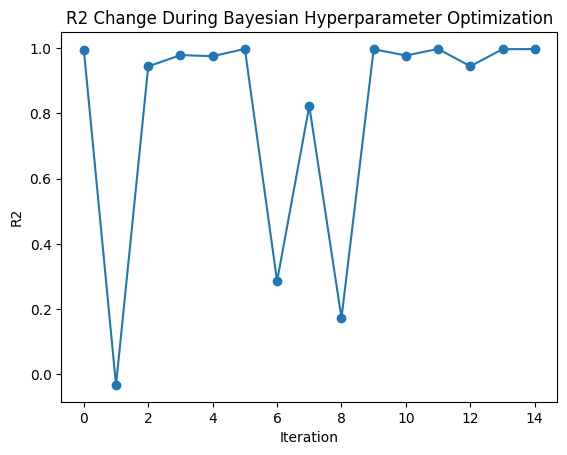

Original Dataset - RMSE: 1.2726578817919334, R2: 0.9999904140864657, MAE: 1.0413947448730396
External Dataset - RMSE: 66.15377044677734, R2: 0.9740988272727927, MAE: 54.30479049682617


In [31]:
# 提取每次迭代的最佳 R2
best_r2_list = []
for res in result.func_vals:
    best_r2_list.append(-res)  # 注意要取负数

# 绘制 R2 的变化过程图
plt.plot(best_r2_list, marker='o')
plt.xlabel('Iteration')
plt.ylabel('R2')
plt.title('R2 Change During Bayesian Hyperparameter Optimization')
plt.show()

import torch
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from sklearn.model_selection import train_test_split

target_column = 'Biogas Production'

# 分离特征和目标变量
X = data.drop(target_column, axis=1)
y = data[target_column]
X_external = external_data.drop(target_column, axis=1)
y_external = external_data[target_column]

# 标准化数据
X_normalized, feature_scaler = normalize_data(X)
y_normalized, target_scaler = normalize_data(y.values.reshape(-1, 1))

# 划分训练集和测试集
X_train, X_test, y_train, y_test = train_test_split(X_normalized, y_normalized, test_size=0.2, random_state=0)

# 转换为 PyTorch 张量
X_train_tensor = torch.from_numpy(X_train).float().to(device)
X_test_tensor = torch.from_numpy(X_test).float().to(device)
y_train_tensor = torch.from_numpy(y_train).float().to(device)
y_test_tensor = torch.from_numpy(y_test).float().to(device)

# 标准化外部数据集
X_external_normalized, _ = normalize_data(X_external)
y_external_normalized, _ = normalize_data(y_external.values.reshape(-1, 1))

# 转换外部数据为张量
X_external_tensor = torch.from_numpy(X_external_normalized).float().to(device)
y_external_tensor = torch.from_numpy(y_external_normalized).float().to(device)

# 模型预测函数
def model_predict(model, X_tensor):
    model.eval()
    with torch.no_grad():
        return model(X_tensor).cpu().numpy()

# 获取预测值
y_pred_train = model_predict(model, X_train_tensor).flatten()
y_pred_test = model_predict(model, X_test_tensor).flatten()
y_pred_external = model_predict(model, X_external_tensor).flatten()

# 反标准化预测值和实际值
y_pred_train_denorm = denormalize_data(y_pred_train.reshape(-1, 1), target_scaler).flatten()
y_pred_test_denorm = denormalize_data(y_pred_test.reshape(-1, 1), target_scaler).flatten()
y_pred_external_denorm = denormalize_data(y_pred_external.reshape(-1, 1), target_scaler).flatten()
y_train_denorm = denormalize_data(y_train, target_scaler).flatten()
y_test_denorm = denormalize_data(y_test, target_scaler).flatten()
y_external_denorm = denormalize_data(y_external_tensor.cpu().numpy(), target_scaler).flatten()


# 合并原始数据集和外部数据集的预测值和实际值
original_data_actual = np.concatenate([y_train_denorm, y_test_denorm])
original_data_predicted = np.concatenate([y_pred_train_denorm, y_pred_test_denorm])
external_data_actual = y_external_denorm
external_data_predicted = y_pred_external_denorm

# 创建 DataFrame
combined_df = pd.DataFrame({
    'Actual': np.concatenate([original_data_actual, external_data_actual]),
    'Predicted': np.concatenate([original_data_predicted, external_data_predicted]),
    'Dataset': ['Original'] * len(original_data_actual) + ['External'] * len(external_data_actual)
})

# 计算原始数据集的指标
train_r2 = r2_score(original_data_actual, original_data_predicted)
train_rmse = mean_squared_error(original_data_actual, original_data_predicted, squared=False)
train_mae = mean_absolute_error(original_data_actual, original_data_predicted)

# 计算外部数据集的指标
external_r2 = r2_score(external_data_actual, external_data_predicted)
external_rmse = mean_squared_error(external_data_actual, external_data_predicted, squared=False)
external_mae = mean_absolute_error(external_data_actual, external_data_predicted)


print(f"Original Dataset - RMSE: {train_rmse}, R2: {train_r2}, MAE: {train_mae}")
print(f"External Dataset - RMSE: {external_rmse}, R2: {external_r2}, MAE: {external_mae}")

GAN

Best parameters: [671, 6.176761533672798e-10, 0.00010063396049315316, 0.5254814681008275, 8.918326627754476e-06]


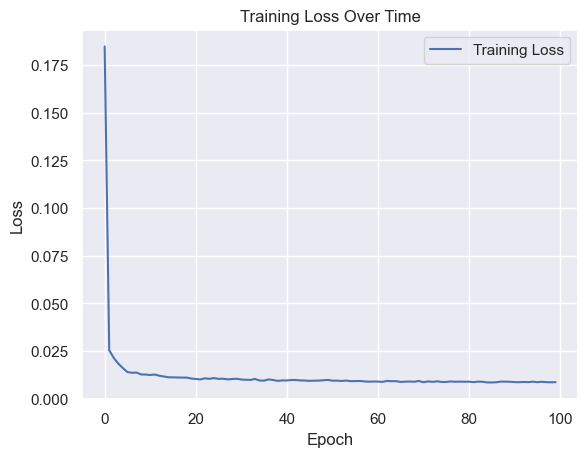

Task Train RMSE: 10.843953132629395, Train R2: 0.9994710589182008, Train MAE: 9.078165054321289
Task Test RMSE: 11.750282287597656, Test R2: 0.9989465836253928, Test MAE: 10.504547119140625
Task Train RMSE: 11.241021156311035, Train R2: 0.9993887214763778, Train MAE: 9.504528999328613
Task Test RMSE: 10.148517608642578, Test R2: 0.9994727883599441, Test MAE: 8.799099922180176
Task Train RMSE: 11.140998840332031, Train R2: 0.9992792978420758, Train MAE: 9.45006275177002
Task Test RMSE: 10.58051586151123, Test R2: 0.999655773027902, Test MAE: 9.01696491241455
Task Train RMSE: 11.058245658874512, Train R2: 0.9994656094516805, Train MAE: 9.573768615722656
Task Test RMSE: 10.922285079956055, Test R2: 0.9987175693082929, Test MAE: 8.522168159484863
Task Train RMSE: 10.866284370422363, Train R2: 0.9993807139764359, Train MAE: 9.210689544677734
Task Test RMSE: 11.66747760772705, Test R2: 0.999463441667346, Test MAE: 9.974451065063477
Task Train RMSE: 12.123290061950684, Train R2: 0.99928715551

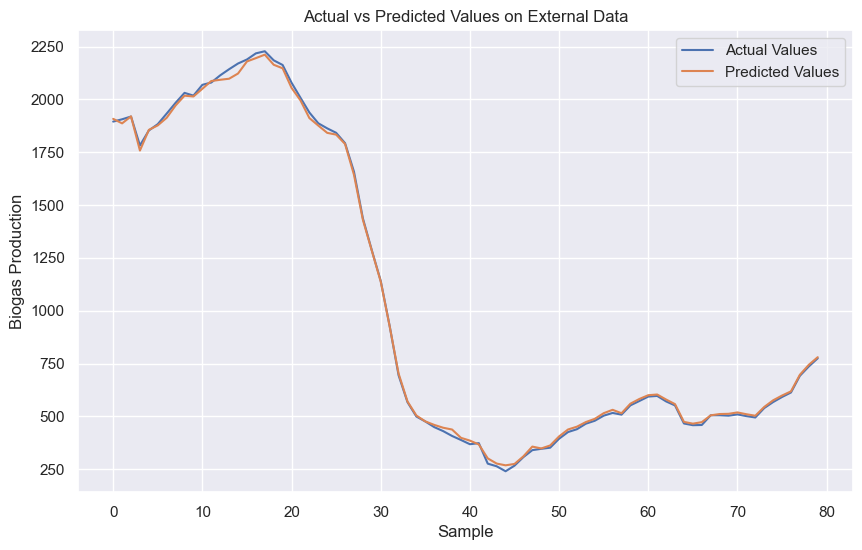

External Dataset - RMSE: 14.60268783569336, R2: 0.9995935691731099, MAE: 11.672844886779785


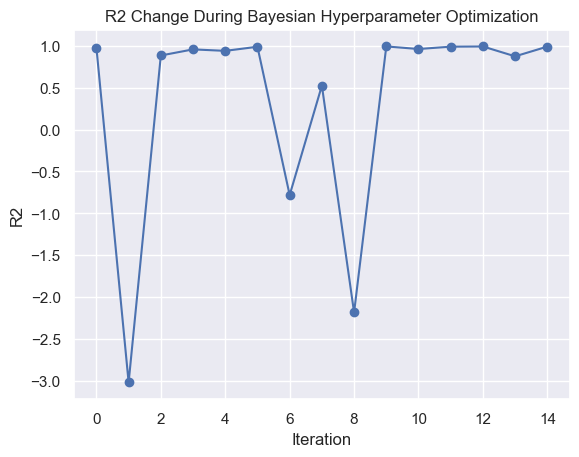

Original Dataset - RMSE: 14.60269309777116, R2: 0.9995935689279918, MAE: 11.672843231201174
External Dataset - RMSE: 14.60268783569336, R2: 0.9995935691731099, MAE: 11.672844886779785


In [24]:
import torch
from torch import nn, optim
import torch.nn.functional as F
import numpy as np
import pandas as pd
from sklearn.preprocessing import StandardScaler
import learn2learn as l2l
from sklearn.model_selection import train_test_split, KFold
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from skopt import gp_minimize
from skopt.space import Real, Integer
from skopt.utils import use_named_args
import matplotlib.pyplot as plt
from torch.utils.data import DataLoader, TensorDataset

# 设置随机种子
np.random.seed(0)
torch.manual_seed(0)

device = torch.device("cuda:0")  # Use GPU 0

# Hyperparameter search space
search_space = [
    Integer(500, 1500, name='hidden_size'), 
    Real(1e-11, 1e-6, "log-uniform", name='alpha'),  
    Real(1e-7, 1e-3, "log-uniform", name='beta'),
    Real(0.1, 0.8, name='dropout_rate'), 
    Real(1e-7, 1e-1, "log-uniform", name='weight_decay') 
]

# Data normalization and denormalization functions
def normalize_data(data):
    scaler = StandardScaler()
    return scaler.fit_transform(data), scaler

def normalize_feature(data, column_name):
    scaler = StandardScaler()
    scaled_data = scaler.fit_transform(data[[column_name]])
    return scaled_data, scaler

def denormalize_data(normalized_data, scaler):
    return scaler.inverse_transform(normalized_data)

# 加载和规范化数据
data = pd.read_csv("C:\\Users\\Lenovo\\Desktop\\元学习\\BT(2)1-1.csv")
data_normalized, scaler = normalize_data(data)

# 假设您的目标列名为'GI(%)'
target_normalized, target_scaler = normalize_data(data[['Biogas Production']].values)
# 元学习模型定义
class AdvancedNeuralNetwork(nn.Module):
    def __init__(self, input_size, hidden_size, dropout_rate):
        super(AdvancedNeuralNetwork, self).__init__()
        self.layer1 = nn.Linear(input_size, hidden_size)
        self.relu1 = nn.LeakyReLU()
        self.layer2 = nn.Linear(hidden_size, hidden_size // 2)
        self.relu2 = nn.LeakyReLU()
        self.layer3 = nn.Linear(hidden_size // 2, hidden_size // 4)
        self.relu3 = nn.LeakyReLU()
        self.dropout = nn.Dropout(dropout_rate)
        self.layer4 = nn.Linear(hidden_size // 4, 1)

    def forward(self, x):
        x = self.relu1(self.layer1(x))
        x = self.relu2(self.layer2(x))
        x = self.relu3(self.layer3(x))
        x = self.dropout(x)
        x = self.layer4(x)
        return x

# 其他辅助函数和类（如EarlyStopping, create_tasks等）根据需要添加
# Task creation function
def create_tasks(data, target_column, num_tasks=50, task_size=100):
    tasks = []
    for _ in range(num_tasks):
        task_data = data.sample(task_size)
        X, y = task_data.drop(target_column, axis=1), task_data[target_column]
        tasks.append((X, y))
    return tasks

# Early stopping class
class EarlyStopping:
    def __init__(self, patience=5, delta=0):
        self.patience = patience
        self.counter = 0
        self.best_score = None
        self.early_stop = False
        self.delta = delta

    def __call__(self, val_loss, model):
        score = -val_loss
        if self.best_score is None:
            self.best_score = score
        elif score < self.best_score + self.delta:
            self.counter += 1
            if self.counter >= self.patience:
                self.early_stop = True
        else:
            self.best_score = score
            self.counter = 0

# GAN的生成器定义
class Generator(nn.Module):
    def __init__(self, input_size, hidden_dim, output_size):
        super(Generator, self).__init__()
        self.fc1 = nn.Linear(input_size, hidden_dim)
        self.fc2 = nn.Linear(hidden_dim, hidden_dim * 2)
        self.fc3 = nn.Linear(hidden_dim * 2, hidden_dim * 4)
        self.fc4 = nn.Linear(hidden_dim * 4, output_size)

    def forward(self, x):
        x = F.leaky_relu(self.fc1(x), 0.2)
        x = F.leaky_relu(self.fc2(x), 0.2)
        x = F.leaky_relu(self.fc3(x), 0.2)
        x = torch.tanh(self.fc4(x))
        return x

# GAN的判别器定义
class Discriminator(nn.Module):
    def __init__(self, input_size, hidden_dim):
        super(Discriminator, self).__init__()
        self.fc1 = nn.Linear(input_size, hidden_dim * 4)
        self.fc2 = nn.Linear(hidden_dim * 4, hidden_dim * 2)
        self.fc3 = nn.Linear(hidden_dim * 2, hidden_dim)
        self.fc4 = nn.Linear(hidden_dim, 1)

    def forward(self, x):
        x = F.leaky_relu(self.fc1(x), 0.2)
        x = F.leaky_relu(self.fc2(x), 0.2)
        x = F.leaky_relu(self.fc3(x), 0.2)
        x = torch.sigmoid(self.fc4(x))
        return x

# MAML fast adaptation and meta-training
def meta_train_maml(model, tasks, alpha, beta, weight_decay, epochs=100, num_steps=1):
    early_stopping = EarlyStopping(patience=10, delta=0.01)
    optimizer = optim.Adam(model.parameters(), lr=beta, weight_decay=weight_decay)
    scheduler = optim.lr_scheduler.CosineAnnealingLR(optimizer, T_max=epochs)

    epoch_loss_list = []  # Initialize a list to store losses for each epoch

    for epoch in range(epochs):
        epoch_losses = []
        for task in tasks:
            learner = model.clone()  # Clone the model
            task_X, task_y = task
            task_X = torch.from_numpy(task_X.values).float().to(device)
            task_y = torch.from_numpy(task_y.values).float().to(device)

            # Fast adaptation
            for step in range(num_steps):
                pred_y = learner(task_X)
                loss = nn.functional.mse_loss(pred_y.squeeze(), task_y)
                learner.adapt(loss)

            # Meta-update
            optimizer.zero_grad()
            pred_y = learner(task_X)
            loss = nn.functional.mse_loss(pred_y.squeeze(), task_y)
            epoch_losses.append(loss.item())
            loss.backward()
            optimizer.step()

        scheduler.step()  # Update learning rate
        average_loss = np.mean(epoch_losses)
        epoch_loss_list.append(average_loss)  # Add each epoch's average loss to the list

        if early_stopping(average_loss, model):
            print(f"Early stopping triggered at epoch {epoch}")
            break

    return epoch_loss_list  # Return the list of epoch losses



@use_named_args(search_space)
def objective(hidden_size, alpha, beta, dropout_rate, weight_decay):
    model = AdvancedNeuralNetwork(input_size, hidden_size, dropout_rate)
    model = l2l.algorithms.MAML(model, lr=alpha).to(device)
    avg_r2 = 0

    task_r2_list = []  # 记录每个任务的 R2

    for task in tasks:
        task_X, task_y = task
        task_X_train, task_X_test, task_y_train, task_y_test = train_test_split(task_X, task_y, test_size=0.2, random_state=0)
        meta_train_maml(model, [(task_X_train, task_y_train)], alpha, beta, weight_decay, epochs=100)
        train_rmse, train_r2, train_mae, test_rmse, test_r2, test_mae = evaluate_model(model, task_X_train, task_y_train, task_X_test, task_y_test, target_scaler)
        task_r2_list.append(test_r2)  # 记录每个任务的测试 R2
        avg_r2 += test_r2

    avg_r2 /= len(tasks)
    return -avg_r2  # 这里返回负数因为 skopt 的目标函数是最小化，而我们想要最大化 R2

# Evaluation function
def evaluate_model(model, X_train, y_train, X_test, y_test, target_scaler):
    model.eval()
    with torch.no_grad():
        # Convert data to tensors
        X_train_tensor = torch.from_numpy(X_train.values).float().to(device)
        y_train_tensor = torch.from_numpy(y_train.values).float().to(device)
        X_test_tensor = torch.from_numpy(X_test.values).float().to(device)
        y_test_tensor = torch.from_numpy(y_test.values).float().to(device)

        # Get predictions
        train_predictions = model(X_train_tensor).squeeze().cpu().numpy()
        test_predictions = model(X_test_tensor).squeeze().cpu().numpy()

        # Reshape predictions for denormalization
        train_predictions_reshaped = train_predictions.reshape(-1, 1)
        test_predictions_reshaped = test_predictions.reshape(-1, 1)

        # Denormalize predictions using target_scaler
        train_predictions_denorm = denormalize_data(train_predictions_reshaped, target_scaler)
        test_predictions_denorm = denormalize_data(test_predictions_reshaped, target_scaler)

        # Denormalize actual values using target_scaler
        y_train_denorm = denormalize_data(y_train_tensor.cpu().numpy().reshape(-1, 1), target_scaler)
        y_test_denorm = denormalize_data(y_test_tensor.cpu().numpy().reshape(-1, 1), target_scaler)

        # Calculate metrics using denormalized data
        train_rmse = mean_squared_error(y_train_denorm, train_predictions_denorm, squared=False)
        train_r2 = r2_score(y_train_denorm, train_predictions_denorm)
        train_mae = mean_absolute_error(y_train_denorm, train_predictions_denorm)

        test_rmse = mean_squared_error(y_test_denorm, test_predictions_denorm, squared=False)
        test_r2 = r2_score(y_test_denorm, test_predictions_denorm)
        test_mae = mean_absolute_error(y_test_denorm, test_predictions_denorm)

    return train_rmse, train_r2, train_mae, test_rmse, test_r2, test_mae

# 设置GAN训练参数
z_dim = 100  # 潜在空间的维度
gen_hidden_dim = 128
dis_hidden_dim = 128
lr = 0.0002
batch_size = 64
num_epochs = 50

# 初始化模型
generator = Generator(z_dim, gen_hidden_dim, data_normalized.shape[1]).to(device)
discriminator = Discriminator(data_normalized.shape[1], dis_hidden_dim).to(device)

# 优化器
optim_g = optim.Adam(generator.parameters(), lr=lr)
optim_d = optim.Adam(discriminator.parameters(), lr=lr)

tensor_data = torch.Tensor(data_normalized)
data_loader = DataLoader(tensor_data, batch_size=batch_size, shuffle=True)

# GAN训练循环
for epoch in range(num_epochs):
    for batch in data_loader:
        current_batch_size = len(batch)  # Get the actual batch size
        real_data = batch.to(device)
        real_labels = torch.ones(current_batch_size, 1).to(device)  # Adjust label size based on batch
        fake_data = generator(torch.randn(current_batch_size, z_dim).to(device))  # Generate fake data based on current batch size
        fake_labels = torch.zeros(current_batch_size, 1).to(device)  # Adjust fake label size

        # 训练判别器
        optim_d.zero_grad()
        real_output = discriminator(real_data)
        fake_output = discriminator(fake_data)
        d_loss_real = nn.BCEWithLogitsLoss()(real_output, real_labels)
        d_loss_fake = nn.BCEWithLogitsLoss()(fake_output, fake_labels)
        d_loss = d_loss_real + d_loss_fake
        d_loss.backward()
        optim_d.step()

        # 训练生成器
        optim_g.zero_grad()
        fake_data = generator(torch.randn(current_batch_size, z_dim).to(device))  # Regenerate fake data
        fake_output = discriminator(fake_data)
        g_loss = nn.BCEWithLogitsLoss()(fake_output, real_labels)  # Use real_labels here
        g_loss.backward()
        optim_g.step()

# 假设您想生成一定数量的新样本
number_of_generated_samples = 300

# 生成新的数据样本
generated_samples = []
for _ in range(number_of_generated_samples):
    z = torch.randn(1, z_dim).to(device)
    generated_sample = generator(z).detach().cpu().numpy()
    generated_samples.append(generated_sample.reshape(-1))

generated_samples = np.array(generated_samples)

# 将生成的样本合并到现有数据中
extended_data = np.vstack([data_normalized, generated_samples])

# 创建增强的数据集任务
# 这里假设您已经定义了创建任务的函数
input_size = data.shape[1] - 1 
tasks = create_tasks(pd.DataFrame(extended_data, columns=data.columns), target_column='Biogas Production')
# Execute hyperparameter optimization
result = gp_minimize(objective, search_space, n_calls=15,random_state=0)
hidden_size, alpha, beta, dropout_rate, weight_decay = result.x
print("Best parameters:", result.x)

# Train model with optimized hyperparameters
model = AdvancedNeuralNetwork(input_size, hidden_size, dropout_rate)
model = l2l.algorithms.MAML(model, lr=alpha).to(device)
train_losses = meta_train_maml(model, tasks, alpha, beta, weight_decay, epochs=100)

# Visualize training losses
plt.plot(train_losses, label='Training Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training Loss Over Time')
plt.legend()
plt.show()

# Final model evaluation
for task in tasks:
    X, y = task
    kf = KFold(n_splits=5, shuffle=True, random_state=0)
    for train_index, test_index in kf.split(X):
        X_train, X_test = X.iloc[train_index], X.iloc[test_index]
        y_train, y_test = y.iloc[train_index], y.iloc[test_index]
        train_rmse, train_r2, train_mae, test_rmse, test_r2, test_mae = evaluate_model(model, X_train, y_train, X_test, y_test, target_scaler)
        print(f"Task Train RMSE: {train_rmse}, Train R2: {train_r2}, Train MAE: {train_mae}")
        print(f"Task Test RMSE: {test_rmse}, Test R2: {test_r2}, Test MAE: {test_mae}")
# Load and process external data for evaluation
external_data = pd.read_csv("C:\\Users\\Lenovo\\Desktop\\元学习\\BT(2)1-2.csv")
external_data_normalized, _ = normalize_data(external_data)
external_target_normalized, _ = normalize_feature(external_data, 'Biogas Production')
external_X = torch.from_numpy(pd.DataFrame(external_data_normalized, columns=external_data.columns).drop('Biogas Production', axis=1).values).float().to(device)
external_y_normalized = torch.from_numpy(external_target_normalized).float().to(device)

# Model prediction on external data
learner = model.clone()  # Clone the model for evaluation
learner.eval()
with torch.no_grad():
    external_predictions_normalized = learner(external_X).squeeze()
external_predictions = denormalize_data(external_predictions_normalized.cpu().numpy().reshape(-1, 1), target_scaler)
external_y = denormalize_data(external_y_normalized.cpu().numpy().reshape(-1, 1), target_scaler)

# Visualization of predictions on external data
plt.figure(figsize=(10, 6))
plt.plot(external_y, label='Actual Values')
plt.plot(external_predictions, label='Predicted Values')
plt.xlabel('Sample')
plt.ylabel('Biogas Production')
plt.title('Actual vs Predicted Values on External Data')
plt.legend()
plt.show()

# Evaluate on external dataset using denormalized data
external_rmse = mean_squared_error(external_y, external_predictions, squared=False)
external_r2 = r2_score(external_y, external_predictions)
external_mae = mean_absolute_error(external_y, external_predictions)

print(f"External Dataset - RMSE: {external_rmse}, R2: {external_r2}, MAE: {external_mae}")

# 提取每次迭代的最佳 R2
best_r2_list = []
for res in result.func_vals:
    best_r2_list.append(-res)  # 注意要取负数

# 绘制 R2 的变化过程图
plt.plot(best_r2_list, marker='o')
plt.xlabel('Iteration')
plt.ylabel('R2')
plt.title('R2 Change During Bayesian Hyperparameter Optimization')
plt.show()

import torch
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from sklearn.model_selection import train_test_split

target_column = 'Biogas Production'

# 分离特征和目标变量
X = data.drop(target_column, axis=1)
y = data[target_column]
X_external = external_data.drop(target_column, axis=1)
y_external = external_data[target_column]

# 标准化数据
X_normalized, feature_scaler = normalize_data(X)
y_normalized, target_scaler = normalize_data(y.values.reshape(-1, 1))

# 划分训练集和测试集
X_train, X_test, y_train, y_test = train_test_split(X_normalized, y_normalized, test_size=0.2, random_state=0)

# 转换为 PyTorch 张量
X_train_tensor = torch.from_numpy(X_train).float().to(device)
X_test_tensor = torch.from_numpy(X_test).float().to(device)
y_train_tensor = torch.from_numpy(y_train).float().to(device)
y_test_tensor = torch.from_numpy(y_test).float().to(device)

# 标准化外部数据集
X_external_normalized, _ = normalize_data(X_external)
y_external_normalized, _ = normalize_data(y_external.values.reshape(-1, 1))

# 转换外部数据为张量
X_external_tensor = torch.from_numpy(X_external_normalized).float().to(device)
y_external_tensor = torch.from_numpy(y_external_normalized).float().to(device)

# 模型预测函数
def model_predict(model, X_tensor):
    model.eval()
    with torch.no_grad():
        return model(X_tensor).cpu().numpy()

# 获取预测值
y_pred_train = model_predict(model, X_train_tensor).flatten()
y_pred_test = model_predict(model, X_test_tensor).flatten()
y_pred_external = model_predict(model, X_external_tensor).flatten()

# 反标准化预测值和实际值
y_pred_train_denorm = denormalize_data(y_pred_train.reshape(-1, 1), target_scaler).flatten()
y_pred_test_denorm = denormalize_data(y_pred_test.reshape(-1, 1), target_scaler).flatten()
y_pred_external_denorm = denormalize_data(y_pred_external.reshape(-1, 1), target_scaler).flatten()
y_train_denorm = denormalize_data(y_train, target_scaler).flatten()
y_test_denorm = denormalize_data(y_test, target_scaler).flatten()
y_external_denorm = denormalize_data(y_external_tensor.cpu().numpy(), target_scaler).flatten()


# 合并原始数据集和外部数据集的预测值和实际值
original_data_actual = np.concatenate([y_train_denorm, y_test_denorm])
original_data_predicted = np.concatenate([y_pred_train_denorm, y_pred_test_denorm])
external_data_actual = y_external_denorm
external_data_predicted = y_pred_external_denorm

# 创建 DataFrame
combined_df = pd.DataFrame({
    'Actual': np.concatenate([original_data_actual, external_data_actual]),
    'Predicted': np.concatenate([original_data_predicted, external_data_predicted]),
    'Dataset': ['Original'] * len(original_data_actual) + ['External'] * len(external_data_actual)
})

# 计算原始数据集的指标
train_r2 = r2_score(original_data_actual, original_data_predicted)
train_rmse = mean_squared_error(original_data_actual, original_data_predicted, squared=False)
train_mae = mean_absolute_error(original_data_actual, original_data_predicted)

# 计算外部数据集的指标
external_r2 = r2_score(external_data_actual, external_data_predicted)
external_rmse = mean_squared_error(external_data_actual, external_data_predicted, squared=False)
external_mae = mean_absolute_error(external_data_actual, external_data_predicted)


print(f"Original Dataset - RMSE: {train_rmse}, R2: {train_r2}, MAE: {train_mae}")
print(f"External Dataset - RMSE: {external_rmse}, R2: {external_r2}, MAE: {external_mae}")

Best parameters: [1500, 1e-06, 0.001, 0.8, 1e-07]


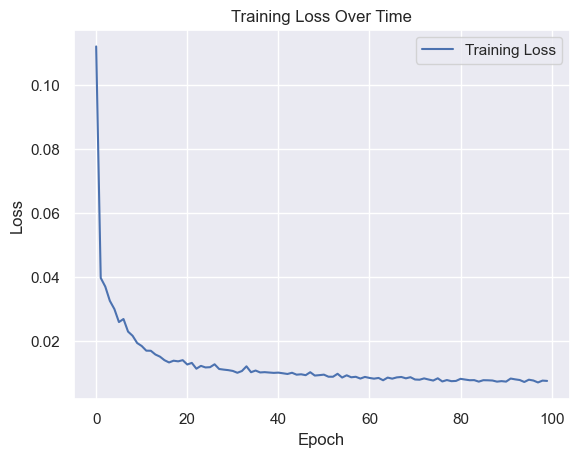

Task Train RMSE: 7.750105381011963, Train R2: 0.9996599241085807, Train MAE: 5.525820732116699
Task Test RMSE: 8.166890144348145, Test R2: 0.9991991185737621, Test MAE: 4.827108860015869
Task Train RMSE: 8.224553108215332, Train R2: 0.9996141052428975, Train MAE: 5.5284104347229
Task Test RMSE: 6.031713008880615, Test R2: 0.9995972230257191, Test MAE: 4.816754341125488
Task Train RMSE: 6.919387340545654, Train R2: 0.9995535577296667, Train MAE: 4.86713171005249
Task Test RMSE: 10.744443893432617, Test R2: 0.9996250123110271, Test MAE: 7.461859226226807
Task Train RMSE: 7.934553146362305, Train R2: 0.9996152820106643, Train MAE: 5.4448394775390625
Task Test RMSE: 7.424709796905518, Test R2: 0.9996081800744334, Test MAE: 5.151055812835693
Task Train RMSE: 8.271163940429688, Train R2: 0.9995982421718219, Train MAE: 5.564187049865723
Task Test RMSE: 5.771132946014404, Test R2: 0.9997068075625142, Test MAE: 4.673642158508301
Task Train RMSE: 8.237963676452637, Train R2: 0.9996911436845578, 

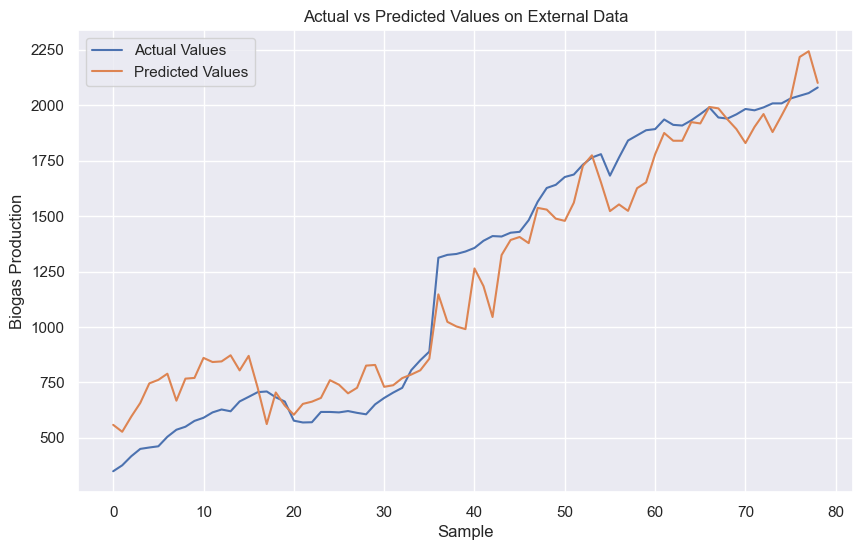

External Dataset - RMSE: 161.58387756347656, R2: 0.9279425049167818, MAE: 129.95504760742188


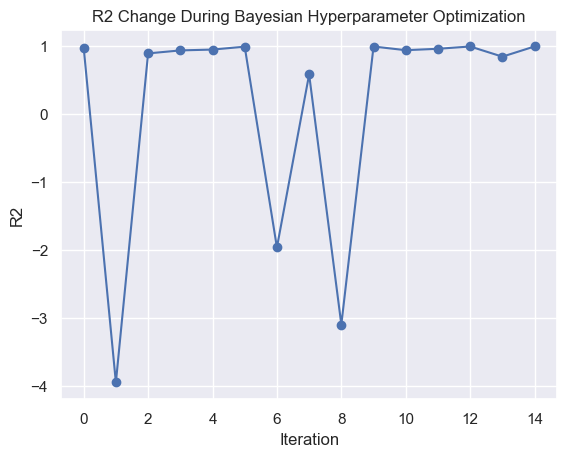

Original Dataset - RMSE: 12.748845906657074, R2: 0.999551435561825, MAE: 9.042239161361879
External Dataset - RMSE: 161.58387756347656, R2: 0.9279425049167818, MAE: 129.95504760742188


In [25]:
import torch
from torch import nn, optim
import torch.nn.functional as F
import numpy as np
import pandas as pd
from sklearn.preprocessing import StandardScaler
import learn2learn as l2l
from sklearn.model_selection import train_test_split, KFold
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from skopt import gp_minimize
from skopt.space import Real, Integer
from skopt.utils import use_named_args
import matplotlib.pyplot as plt
from torch.utils.data import DataLoader, TensorDataset

# 设置随机种子
np.random.seed(0)
torch.manual_seed(0)

device = torch.device("cuda:0")  # Use GPU 0

# Hyperparameter search space
search_space = [
    Integer(500, 1500, name='hidden_size'), 
    Real(1e-11, 1e-6, "log-uniform", name='alpha'),  
    Real(1e-7, 1e-3, "log-uniform", name='beta'),
    Real(0.1, 0.8, name='dropout_rate'), 
    Real(1e-7, 1e-1, "log-uniform", name='weight_decay') 
]

# Data normalization and denormalization functions
def normalize_data(data):
    scaler = StandardScaler()
    return scaler.fit_transform(data), scaler

def normalize_feature(data, column_name):
    scaler = StandardScaler()
    scaled_data = scaler.fit_transform(data[[column_name]])
    return scaled_data, scaler

def denormalize_data(normalized_data, scaler):
    return scaler.inverse_transform(normalized_data)

# 加载和规范化数据
data = pd.read_csv("C:\\Users\\Lenovo\\Desktop\\元学习\\BT(2)2-1.csv")
data_normalized, scaler = normalize_data(data)

# 假设您的目标列名为'GI(%)'
target_normalized, target_scaler = normalize_data(data[['Biogas Production']].values)
# 元学习模型定义
class AdvancedNeuralNetwork(nn.Module):
    def __init__(self, input_size, hidden_size, dropout_rate):
        super(AdvancedNeuralNetwork, self).__init__()
        self.layer1 = nn.Linear(input_size, hidden_size)
        self.relu1 = nn.LeakyReLU()
        self.layer2 = nn.Linear(hidden_size, hidden_size // 2)
        self.relu2 = nn.LeakyReLU()
        self.layer3 = nn.Linear(hidden_size // 2, hidden_size // 4)
        self.relu3 = nn.LeakyReLU()
        self.dropout = nn.Dropout(dropout_rate)
        self.layer4 = nn.Linear(hidden_size // 4, 1)

    def forward(self, x):
        x = self.relu1(self.layer1(x))
        x = self.relu2(self.layer2(x))
        x = self.relu3(self.layer3(x))
        x = self.dropout(x)
        x = self.layer4(x)
        return x

# 其他辅助函数和类（如EarlyStopping, create_tasks等）根据需要添加
# Task creation function
def create_tasks(data, target_column, num_tasks=50, task_size=100):
    tasks = []
    for _ in range(num_tasks):
        task_data = data.sample(task_size)
        X, y = task_data.drop(target_column, axis=1), task_data[target_column]
        tasks.append((X, y))
    return tasks

# Early stopping class
class EarlyStopping:
    def __init__(self, patience=5, delta=0):
        self.patience = patience
        self.counter = 0
        self.best_score = None
        self.early_stop = False
        self.delta = delta

    def __call__(self, val_loss, model):
        score = -val_loss
        if self.best_score is None:
            self.best_score = score
        elif score < self.best_score + self.delta:
            self.counter += 1
            if self.counter >= self.patience:
                self.early_stop = True
        else:
            self.best_score = score
            self.counter = 0

# GAN的生成器定义
class Generator(nn.Module):
    def __init__(self, input_size, hidden_dim, output_size):
        super(Generator, self).__init__()
        self.fc1 = nn.Linear(input_size, hidden_dim)
        self.fc2 = nn.Linear(hidden_dim, hidden_dim * 2)
        self.fc3 = nn.Linear(hidden_dim * 2, hidden_dim * 4)
        self.fc4 = nn.Linear(hidden_dim * 4, output_size)

    def forward(self, x):
        x = F.leaky_relu(self.fc1(x), 0.2)
        x = F.leaky_relu(self.fc2(x), 0.2)
        x = F.leaky_relu(self.fc3(x), 0.2)
        x = torch.tanh(self.fc4(x))
        return x

# GAN的判别器定义
class Discriminator(nn.Module):
    def __init__(self, input_size, hidden_dim):
        super(Discriminator, self).__init__()
        self.fc1 = nn.Linear(input_size, hidden_dim * 4)
        self.fc2 = nn.Linear(hidden_dim * 4, hidden_dim * 2)
        self.fc3 = nn.Linear(hidden_dim * 2, hidden_dim)
        self.fc4 = nn.Linear(hidden_dim, 1)

    def forward(self, x):
        x = F.leaky_relu(self.fc1(x), 0.2)
        x = F.leaky_relu(self.fc2(x), 0.2)
        x = F.leaky_relu(self.fc3(x), 0.2)
        x = torch.sigmoid(self.fc4(x))
        return x

# MAML fast adaptation and meta-training
def meta_train_maml(model, tasks, alpha, beta, weight_decay, epochs=100, num_steps=1):
    early_stopping = EarlyStopping(patience=10, delta=0.01)
    optimizer = optim.Adam(model.parameters(), lr=beta, weight_decay=weight_decay)
    scheduler = optim.lr_scheduler.CosineAnnealingLR(optimizer, T_max=epochs)

    epoch_loss_list = []  # Initialize a list to store losses for each epoch

    for epoch in range(epochs):
        epoch_losses = []
        for task in tasks:
            learner = model.clone()  # Clone the model
            task_X, task_y = task
            task_X = torch.from_numpy(task_X.values).float().to(device)
            task_y = torch.from_numpy(task_y.values).float().to(device)

            # Fast adaptation
            for step in range(num_steps):
                pred_y = learner(task_X)
                loss = nn.functional.mse_loss(pred_y.squeeze(), task_y)
                learner.adapt(loss)

            # Meta-update
            optimizer.zero_grad()
            pred_y = learner(task_X)
            loss = nn.functional.mse_loss(pred_y.squeeze(), task_y)
            epoch_losses.append(loss.item())
            loss.backward()
            optimizer.step()

        scheduler.step()  # Update learning rate
        average_loss = np.mean(epoch_losses)
        epoch_loss_list.append(average_loss)  # Add each epoch's average loss to the list

        if early_stopping(average_loss, model):
            print(f"Early stopping triggered at epoch {epoch}")
            break

    return epoch_loss_list  # Return the list of epoch losses



@use_named_args(search_space)
def objective(hidden_size, alpha, beta, dropout_rate, weight_decay):
    model = AdvancedNeuralNetwork(input_size, hidden_size, dropout_rate)
    model = l2l.algorithms.MAML(model, lr=alpha).to(device)
    avg_r2 = 0

    task_r2_list = []  # 记录每个任务的 R2

    for task in tasks:
        task_X, task_y = task
        task_X_train, task_X_test, task_y_train, task_y_test = train_test_split(task_X, task_y, test_size=0.2, random_state=0)
        meta_train_maml(model, [(task_X_train, task_y_train)], alpha, beta, weight_decay, epochs=100)
        train_rmse, train_r2, train_mae, test_rmse, test_r2, test_mae = evaluate_model(model, task_X_train, task_y_train, task_X_test, task_y_test, target_scaler)
        task_r2_list.append(test_r2)  # 记录每个任务的测试 R2
        avg_r2 += test_r2

    avg_r2 /= len(tasks)
    return -avg_r2  # 这里返回负数因为 skopt 的目标函数是最小化，而我们想要最大化 R2

# Evaluation function
def evaluate_model(model, X_train, y_train, X_test, y_test, target_scaler):
    model.eval()
    with torch.no_grad():
        # Convert data to tensors
        X_train_tensor = torch.from_numpy(X_train.values).float().to(device)
        y_train_tensor = torch.from_numpy(y_train.values).float().to(device)
        X_test_tensor = torch.from_numpy(X_test.values).float().to(device)
        y_test_tensor = torch.from_numpy(y_test.values).float().to(device)

        # Get predictions
        train_predictions = model(X_train_tensor).squeeze().cpu().numpy()
        test_predictions = model(X_test_tensor).squeeze().cpu().numpy()

        # Reshape predictions for denormalization
        train_predictions_reshaped = train_predictions.reshape(-1, 1)
        test_predictions_reshaped = test_predictions.reshape(-1, 1)

        # Denormalize predictions using target_scaler
        train_predictions_denorm = denormalize_data(train_predictions_reshaped, target_scaler)
        test_predictions_denorm = denormalize_data(test_predictions_reshaped, target_scaler)

        # Denormalize actual values using target_scaler
        y_train_denorm = denormalize_data(y_train_tensor.cpu().numpy().reshape(-1, 1), target_scaler)
        y_test_denorm = denormalize_data(y_test_tensor.cpu().numpy().reshape(-1, 1), target_scaler)

        # Calculate metrics using denormalized data
        train_rmse = mean_squared_error(y_train_denorm, train_predictions_denorm, squared=False)
        train_r2 = r2_score(y_train_denorm, train_predictions_denorm)
        train_mae = mean_absolute_error(y_train_denorm, train_predictions_denorm)

        test_rmse = mean_squared_error(y_test_denorm, test_predictions_denorm, squared=False)
        test_r2 = r2_score(y_test_denorm, test_predictions_denorm)
        test_mae = mean_absolute_error(y_test_denorm, test_predictions_denorm)

    return train_rmse, train_r2, train_mae, test_rmse, test_r2, test_mae

# 设置GAN训练参数
z_dim = 100  # 潜在空间的维度
gen_hidden_dim = 128
dis_hidden_dim = 128
lr = 0.0002
batch_size = 64
num_epochs = 50

# 初始化模型
generator = Generator(z_dim, gen_hidden_dim, data_normalized.shape[1]).to(device)
discriminator = Discriminator(data_normalized.shape[1], dis_hidden_dim).to(device)

# 优化器
optim_g = optim.Adam(generator.parameters(), lr=lr)
optim_d = optim.Adam(discriminator.parameters(), lr=lr)

tensor_data = torch.Tensor(data_normalized)
data_loader = DataLoader(tensor_data, batch_size=batch_size, shuffle=True)

# GAN训练循环
for epoch in range(num_epochs):
    for batch in data_loader:
        current_batch_size = len(batch)  # Get the actual batch size
        real_data = batch.to(device)
        real_labels = torch.ones(current_batch_size, 1).to(device)  # Adjust label size based on batch
        fake_data = generator(torch.randn(current_batch_size, z_dim).to(device))  # Generate fake data based on current batch size
        fake_labels = torch.zeros(current_batch_size, 1).to(device)  # Adjust fake label size

        # 训练判别器
        optim_d.zero_grad()
        real_output = discriminator(real_data)
        fake_output = discriminator(fake_data)
        d_loss_real = nn.BCEWithLogitsLoss()(real_output, real_labels)
        d_loss_fake = nn.BCEWithLogitsLoss()(fake_output, fake_labels)
        d_loss = d_loss_real + d_loss_fake
        d_loss.backward()
        optim_d.step()

        # 训练生成器
        optim_g.zero_grad()
        fake_data = generator(torch.randn(current_batch_size, z_dim).to(device))  # Regenerate fake data
        fake_output = discriminator(fake_data)
        g_loss = nn.BCEWithLogitsLoss()(fake_output, real_labels)  # Use real_labels here
        g_loss.backward()
        optim_g.step()

# 假设您想生成一定数量的新样本
number_of_generated_samples = 300

# 生成新的数据样本
generated_samples = []
for _ in range(number_of_generated_samples):
    z = torch.randn(1, z_dim).to(device)
    generated_sample = generator(z).detach().cpu().numpy()
    generated_samples.append(generated_sample.reshape(-1))

generated_samples = np.array(generated_samples)

# 将生成的样本合并到现有数据中
extended_data = np.vstack([data_normalized, generated_samples])

# 创建增强的数据集任务
# 这里假设您已经定义了创建任务的函数
input_size = data.shape[1] - 1 
tasks = create_tasks(pd.DataFrame(extended_data, columns=data.columns), target_column='Biogas Production')
# Execute hyperparameter optimization
result = gp_minimize(objective, search_space, n_calls=15,random_state=0)
hidden_size, alpha, beta, dropout_rate, weight_decay = result.x
print("Best parameters:", result.x)

# Train model with optimized hyperparameters
model = AdvancedNeuralNetwork(input_size, hidden_size, dropout_rate)
model = l2l.algorithms.MAML(model, lr=alpha).to(device)
train_losses = meta_train_maml(model, tasks, alpha, beta, weight_decay, epochs=100)

# Visualize training losses
plt.plot(train_losses, label='Training Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training Loss Over Time')
plt.legend()
plt.show()

# Final model evaluation
for task in tasks:
    X, y = task
    kf = KFold(n_splits=5, shuffle=True, random_state=0)
    for train_index, test_index in kf.split(X):
        X_train, X_test = X.iloc[train_index], X.iloc[test_index]
        y_train, y_test = y.iloc[train_index], y.iloc[test_index]
        train_rmse, train_r2, train_mae, test_rmse, test_r2, test_mae = evaluate_model(model, X_train, y_train, X_test, y_test, target_scaler)
        print(f"Task Train RMSE: {train_rmse}, Train R2: {train_r2}, Train MAE: {train_mae}")
        print(f"Task Test RMSE: {test_rmse}, Test R2: {test_r2}, Test MAE: {test_mae}")
# Load and process external data for evaluation
external_data = pd.read_csv("C:\\Users\\Lenovo\\Desktop\\元学习\\BT(2)2-2.csv")
external_data_normalized, _ = normalize_data(external_data)
external_target_normalized, _ = normalize_feature(external_data, 'Biogas Production')
external_X = torch.from_numpy(pd.DataFrame(external_data_normalized, columns=external_data.columns).drop('Biogas Production', axis=1).values).float().to(device)
external_y_normalized = torch.from_numpy(external_target_normalized).float().to(device)

# Model prediction on external data
learner = model.clone()  # Clone the model for evaluation
learner.eval()
with torch.no_grad():
    external_predictions_normalized = learner(external_X).squeeze()
external_predictions = denormalize_data(external_predictions_normalized.cpu().numpy().reshape(-1, 1), target_scaler)
external_y = denormalize_data(external_y_normalized.cpu().numpy().reshape(-1, 1), target_scaler)

# Visualization of predictions on external data
plt.figure(figsize=(10, 6))
plt.plot(external_y, label='Actual Values')
plt.plot(external_predictions, label='Predicted Values')
plt.xlabel('Sample')
plt.ylabel('Biogas Production')
plt.title('Actual vs Predicted Values on External Data')
plt.legend()
plt.show()

# Evaluate on external dataset using denormalized data
external_rmse = mean_squared_error(external_y, external_predictions, squared=False)
external_r2 = r2_score(external_y, external_predictions)
external_mae = mean_absolute_error(external_y, external_predictions)

print(f"External Dataset - RMSE: {external_rmse}, R2: {external_r2}, MAE: {external_mae}")

# 提取每次迭代的最佳 R2
best_r2_list = []
for res in result.func_vals:
    best_r2_list.append(-res)  # 注意要取负数

# 绘制 R2 的变化过程图
plt.plot(best_r2_list, marker='o')
plt.xlabel('Iteration')
plt.ylabel('R2')
plt.title('R2 Change During Bayesian Hyperparameter Optimization')
plt.show()

import torch
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from sklearn.model_selection import train_test_split

target_column = 'Biogas Production'

# 分离特征和目标变量
X = data.drop(target_column, axis=1)
y = data[target_column]
X_external = external_data.drop(target_column, axis=1)
y_external = external_data[target_column]

# 标准化数据
X_normalized, feature_scaler = normalize_data(X)
y_normalized, target_scaler = normalize_data(y.values.reshape(-1, 1))

# 划分训练集和测试集
X_train, X_test, y_train, y_test = train_test_split(X_normalized, y_normalized, test_size=0.2, random_state=0)

# 转换为 PyTorch 张量
X_train_tensor = torch.from_numpy(X_train).float().to(device)
X_test_tensor = torch.from_numpy(X_test).float().to(device)
y_train_tensor = torch.from_numpy(y_train).float().to(device)
y_test_tensor = torch.from_numpy(y_test).float().to(device)

# 标准化外部数据集
X_external_normalized, _ = normalize_data(X_external)
y_external_normalized, _ = normalize_data(y_external.values.reshape(-1, 1))

# 转换外部数据为张量
X_external_tensor = torch.from_numpy(X_external_normalized).float().to(device)
y_external_tensor = torch.from_numpy(y_external_normalized).float().to(device)

# 模型预测函数
def model_predict(model, X_tensor):
    model.eval()
    with torch.no_grad():
        return model(X_tensor).cpu().numpy()

# 获取预测值
y_pred_train = model_predict(model, X_train_tensor).flatten()
y_pred_test = model_predict(model, X_test_tensor).flatten()
y_pred_external = model_predict(model, X_external_tensor).flatten()

# 反标准化预测值和实际值
y_pred_train_denorm = denormalize_data(y_pred_train.reshape(-1, 1), target_scaler).flatten()
y_pred_test_denorm = denormalize_data(y_pred_test.reshape(-1, 1), target_scaler).flatten()
y_pred_external_denorm = denormalize_data(y_pred_external.reshape(-1, 1), target_scaler).flatten()
y_train_denorm = denormalize_data(y_train, target_scaler).flatten()
y_test_denorm = denormalize_data(y_test, target_scaler).flatten()
y_external_denorm = denormalize_data(y_external_tensor.cpu().numpy(), target_scaler).flatten()


# 合并原始数据集和外部数据集的预测值和实际值
original_data_actual = np.concatenate([y_train_denorm, y_test_denorm])
original_data_predicted = np.concatenate([y_pred_train_denorm, y_pred_test_denorm])
external_data_actual = y_external_denorm
external_data_predicted = y_pred_external_denorm

# 创建 DataFrame
combined_df = pd.DataFrame({
    'Actual': np.concatenate([original_data_actual, external_data_actual]),
    'Predicted': np.concatenate([original_data_predicted, external_data_predicted]),
    'Dataset': ['Original'] * len(original_data_actual) + ['External'] * len(external_data_actual)
})

# 计算原始数据集的指标
train_r2 = r2_score(original_data_actual, original_data_predicted)
train_rmse = mean_squared_error(original_data_actual, original_data_predicted, squared=False)
train_mae = mean_absolute_error(original_data_actual, original_data_predicted)

# 计算外部数据集的指标
external_r2 = r2_score(external_data_actual, external_data_predicted)
external_rmse = mean_squared_error(external_data_actual, external_data_predicted, squared=False)
external_mae = mean_absolute_error(external_data_actual, external_data_predicted)


print(f"Original Dataset - RMSE: {train_rmse}, R2: {train_r2}, MAE: {train_mae}")
print(f"External Dataset - RMSE: {external_rmse}, R2: {external_r2}, MAE: {external_mae}")

Best parameters: [1500, 1e-11, 2.75504991674046e-05, 0.1, 1e-07]


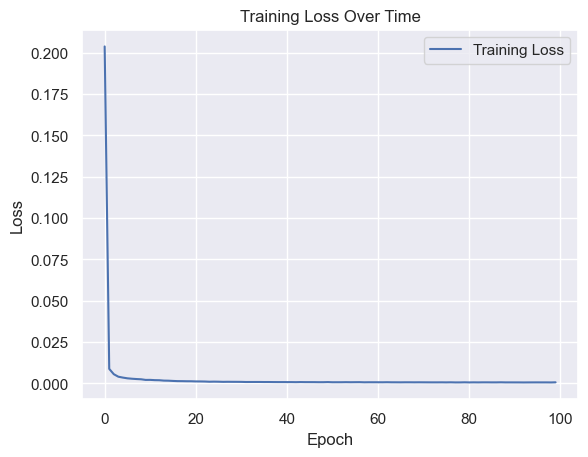

Task Train RMSE: 2.017331600189209, Train R2: 0.9999670173799907, Train MAE: 1.4539597034454346
Task Test RMSE: 1.806948184967041, Test R2: 0.9999584062781338, Test MAE: 1.443139672279358
Task Train RMSE: 1.8908662796020508, Train R2: 0.9999651078737649, Train MAE: 1.4026870727539062
Task Test RMSE: 2.2895431518554688, Test R2: 0.9999674823658043, Test MAE: 1.648217797279358
Task Train RMSE: 2.084926128387451, Train R2: 0.9999590657128967, Train MAE: 1.5235412120819092
Task Test RMSE: 1.4682708978652954, Test R2: 0.9999855675767004, Test MAE: 1.164788842201233
Task Train RMSE: 2.0584049224853516, Train R2: 0.9999651162946808, Train MAE: 1.4876617193222046
Task Test RMSE: 1.6110271215438843, Test R2: 0.9999707133000241, Test MAE: 1.308343529701233
Task Train RMSE: 1.8205926418304443, Train R2: 0.9999726939823681, Train MAE: 1.3911163806915283
Task Test RMSE: 2.5070443153381348, Test R2: 0.9999299241927241, Test MAE: 1.694494605064392
Task Train RMSE: 1.9755445718765259, Train R2: 0.9999

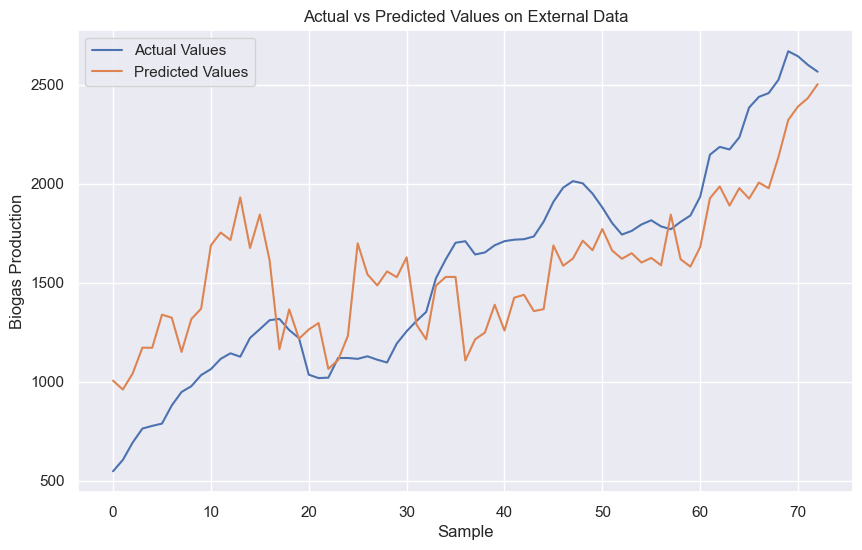

External Dataset - RMSE: 349.3854064941406, R2: 0.5711928396808954, MAE: 305.3836975097656


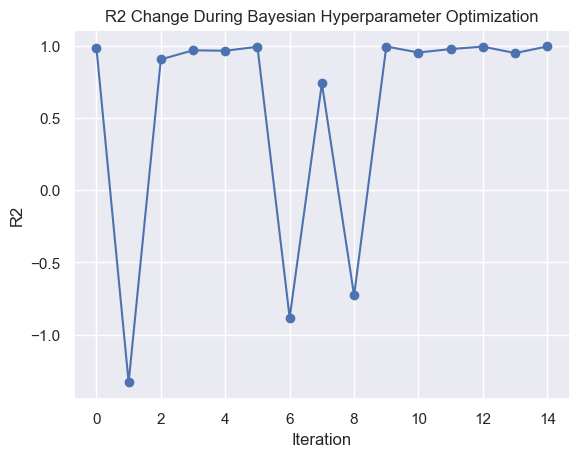

Original Dataset - RMSE: 2.288712521504178, R2: 0.9999815992717355, MAE: 1.508321406923489
External Dataset - RMSE: 349.3854064941406, R2: 0.5711928396808954, MAE: 305.3836975097656


In [26]:
import torch
from torch import nn, optim
import torch.nn.functional as F
import numpy as np
import pandas as pd
from sklearn.preprocessing import StandardScaler
import learn2learn as l2l
from sklearn.model_selection import train_test_split, KFold
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from skopt import gp_minimize
from skopt.space import Real, Integer
from skopt.utils import use_named_args
import matplotlib.pyplot as plt
from torch.utils.data import DataLoader, TensorDataset

# 设置随机种子
np.random.seed(0)
torch.manual_seed(0)

device = torch.device("cuda:0")  # Use GPU 0

# Hyperparameter search space
search_space = [
    Integer(500, 1500, name='hidden_size'), 
    Real(1e-11, 1e-6, "log-uniform", name='alpha'),  
    Real(1e-7, 1e-3, "log-uniform", name='beta'),
    Real(0.1, 0.8, name='dropout_rate'), 
    Real(1e-7, 1e-1, "log-uniform", name='weight_decay') 
]

# Data normalization and denormalization functions
def normalize_data(data):
    scaler = StandardScaler()
    return scaler.fit_transform(data), scaler

def normalize_feature(data, column_name):
    scaler = StandardScaler()
    scaled_data = scaler.fit_transform(data[[column_name]])
    return scaled_data, scaler

def denormalize_data(normalized_data, scaler):
    return scaler.inverse_transform(normalized_data)


# 元学习模型定义
class AdvancedNeuralNetwork(nn.Module):
    def __init__(self, input_size, hidden_size, dropout_rate):
        super(AdvancedNeuralNetwork, self).__init__()
        self.layer1 = nn.Linear(input_size, hidden_size)
        self.relu1 = nn.LeakyReLU()
        self.layer2 = nn.Linear(hidden_size, hidden_size // 2)
        self.relu2 = nn.LeakyReLU()
        self.layer3 = nn.Linear(hidden_size // 2, hidden_size // 4)
        self.relu3 = nn.LeakyReLU()
        self.dropout = nn.Dropout(dropout_rate)
        self.layer4 = nn.Linear(hidden_size // 4, 1)

    def forward(self, x):
        x = self.relu1(self.layer1(x))
        x = self.relu2(self.layer2(x))
        x = self.relu3(self.layer3(x))
        x = self.dropout(x)
        x = self.layer4(x)
        return x

# 其他辅助函数和类（如EarlyStopping, create_tasks等）根据需要添加
# Task creation function
def create_tasks(data, target_column, num_tasks=50, task_size=100):
    tasks = []
    for _ in range(num_tasks):
        task_data = data.sample(task_size)
        X, y = task_data.drop(target_column, axis=1), task_data[target_column]
        tasks.append((X, y))
    return tasks

# Early stopping class
class EarlyStopping:
    def __init__(self, patience=5, delta=0):
        self.patience = patience
        self.counter = 0
        self.best_score = None
        self.early_stop = False
        self.delta = delta

    def __call__(self, val_loss, model):
        score = -val_loss
        if self.best_score is None:
            self.best_score = score
        elif score < self.best_score + self.delta:
            self.counter += 1
            if self.counter >= self.patience:
                self.early_stop = True
        else:
            self.best_score = score
            self.counter = 0

# GAN的生成器定义
class Generator(nn.Module):
    def __init__(self, input_size, hidden_dim, output_size):
        super(Generator, self).__init__()
        self.fc1 = nn.Linear(input_size, hidden_dim)
        self.fc2 = nn.Linear(hidden_dim, hidden_dim * 2)
        self.fc3 = nn.Linear(hidden_dim * 2, hidden_dim * 4)
        self.fc4 = nn.Linear(hidden_dim * 4, output_size)

    def forward(self, x):
        x = F.leaky_relu(self.fc1(x), 0.2)
        x = F.leaky_relu(self.fc2(x), 0.2)
        x = F.leaky_relu(self.fc3(x), 0.2)
        x = torch.tanh(self.fc4(x))
        return x

# GAN的判别器定义
class Discriminator(nn.Module):
    def __init__(self, input_size, hidden_dim):
        super(Discriminator, self).__init__()
        self.fc1 = nn.Linear(input_size, hidden_dim * 4)
        self.fc2 = nn.Linear(hidden_dim * 4, hidden_dim * 2)
        self.fc3 = nn.Linear(hidden_dim * 2, hidden_dim)
        self.fc4 = nn.Linear(hidden_dim, 1)

    def forward(self, x):
        x = F.leaky_relu(self.fc1(x), 0.2)
        x = F.leaky_relu(self.fc2(x), 0.2)
        x = F.leaky_relu(self.fc3(x), 0.2)
        x = torch.sigmoid(self.fc4(x))
        return x

# MAML fast adaptation and meta-training
def meta_train_maml(model, tasks, alpha, beta, weight_decay, epochs=100, num_steps=1):
    early_stopping = EarlyStopping(patience=10, delta=0.01)
    optimizer = optim.Adam(model.parameters(), lr=beta, weight_decay=weight_decay)
    scheduler = optim.lr_scheduler.CosineAnnealingLR(optimizer, T_max=epochs)

    epoch_loss_list = []  # Initialize a list to store losses for each epoch

    for epoch in range(epochs):
        epoch_losses = []
        for task in tasks:
            learner = model.clone()  # Clone the model
            task_X, task_y = task
            task_X = torch.from_numpy(task_X.values).float().to(device)
            task_y = torch.from_numpy(task_y.values).float().to(device)

            # Fast adaptation
            for step in range(num_steps):
                pred_y = learner(task_X)
                loss = nn.functional.mse_loss(pred_y.squeeze(), task_y)
                learner.adapt(loss)

            # Meta-update
            optimizer.zero_grad()
            pred_y = learner(task_X)
            loss = nn.functional.mse_loss(pred_y.squeeze(), task_y)
            epoch_losses.append(loss.item())
            loss.backward()
            optimizer.step()

        scheduler.step()  # Update learning rate
        average_loss = np.mean(epoch_losses)
        epoch_loss_list.append(average_loss)  # Add each epoch's average loss to the list

        if early_stopping(average_loss, model):
            print(f"Early stopping triggered at epoch {epoch}")
            break

    return epoch_loss_list  # Return the list of epoch losses



@use_named_args(search_space)
def objective(hidden_size, alpha, beta, dropout_rate, weight_decay):
    model = AdvancedNeuralNetwork(input_size, hidden_size, dropout_rate)
    model = l2l.algorithms.MAML(model, lr=alpha).to(device)
    avg_r2 = 0

    task_r2_list = []  # 记录每个任务的 R2

    for task in tasks:
        task_X, task_y = task
        task_X_train, task_X_test, task_y_train, task_y_test = train_test_split(task_X, task_y, test_size=0.2, random_state=0)
        meta_train_maml(model, [(task_X_train, task_y_train)], alpha, beta, weight_decay, epochs=100)
        train_rmse, train_r2, train_mae, test_rmse, test_r2, test_mae = evaluate_model(model, task_X_train, task_y_train, task_X_test, task_y_test, target_scaler)
        task_r2_list.append(test_r2)  # 记录每个任务的测试 R2
        avg_r2 += test_r2

    avg_r2 /= len(tasks)
    return -avg_r2  # 这里返回负数因为 skopt 的目标函数是最小化，而我们想要最大化 R2

# Evaluation function
def evaluate_model(model, X_train, y_train, X_test, y_test, target_scaler):
    model.eval()
    with torch.no_grad():
        # Convert data to tensors
        X_train_tensor = torch.from_numpy(X_train.values).float().to(device)
        y_train_tensor = torch.from_numpy(y_train.values).float().to(device)
        X_test_tensor = torch.from_numpy(X_test.values).float().to(device)
        y_test_tensor = torch.from_numpy(y_test.values).float().to(device)

        # Get predictions
        train_predictions = model(X_train_tensor).squeeze().cpu().numpy()
        test_predictions = model(X_test_tensor).squeeze().cpu().numpy()

        # Reshape predictions for denormalization
        train_predictions_reshaped = train_predictions.reshape(-1, 1)
        test_predictions_reshaped = test_predictions.reshape(-1, 1)

        # Denormalize predictions using target_scaler
        train_predictions_denorm = denormalize_data(train_predictions_reshaped, target_scaler)
        test_predictions_denorm = denormalize_data(test_predictions_reshaped, target_scaler)

        # Denormalize actual values using target_scaler
        y_train_denorm = denormalize_data(y_train_tensor.cpu().numpy().reshape(-1, 1), target_scaler)
        y_test_denorm = denormalize_data(y_test_tensor.cpu().numpy().reshape(-1, 1), target_scaler)

        # Calculate metrics using denormalized data
        train_rmse = mean_squared_error(y_train_denorm, train_predictions_denorm, squared=False)
        train_r2 = r2_score(y_train_denorm, train_predictions_denorm)
        train_mae = mean_absolute_error(y_train_denorm, train_predictions_denorm)

        test_rmse = mean_squared_error(y_test_denorm, test_predictions_denorm, squared=False)
        test_r2 = r2_score(y_test_denorm, test_predictions_denorm)
        test_mae = mean_absolute_error(y_test_denorm, test_predictions_denorm)

    return train_rmse, train_r2, train_mae, test_rmse, test_r2, test_mae


# 加载和规范化数据
data = pd.read_csv("C:\\Users\\Lenovo\\Desktop\\元学习\\BT(2)3-1.csv")
data_normalized, scaler = normalize_data(data)

# 假设您的目标列名为'GI(%)'
target_normalized, target_scaler = normalize_data(data[['Biogas Production']].values)
external_data = pd.read_csv("C:\\Users\\Lenovo\\Desktop\\元学习\\BT(2)3-2.csv")

# 设置GAN训练参数
z_dim = 100  # 潜在空间的维度
gen_hidden_dim = 128
dis_hidden_dim = 128
lr = 0.0002
batch_size = 64
num_epochs = 50

# 初始化模型
generator = Generator(z_dim, gen_hidden_dim, data_normalized.shape[1]).to(device)
discriminator = Discriminator(data_normalized.shape[1], dis_hidden_dim).to(device)

# 优化器
optim_g = optim.Adam(generator.parameters(), lr=lr)
optim_d = optim.Adam(discriminator.parameters(), lr=lr)

tensor_data = torch.Tensor(data_normalized)
data_loader = DataLoader(tensor_data, batch_size=batch_size, shuffle=True)

# GAN训练循环
for epoch in range(num_epochs):
    for batch in data_loader:
        current_batch_size = len(batch)  # Get the actual batch size
        real_data = batch.to(device)
        real_labels = torch.ones(current_batch_size, 1).to(device)  # Adjust label size based on batch
        fake_data = generator(torch.randn(current_batch_size, z_dim).to(device))  # Generate fake data based on current batch size
        fake_labels = torch.zeros(current_batch_size, 1).to(device)  # Adjust fake label size

        # 训练判别器
        optim_d.zero_grad()
        real_output = discriminator(real_data)
        fake_output = discriminator(fake_data)
        d_loss_real = nn.BCEWithLogitsLoss()(real_output, real_labels)
        d_loss_fake = nn.BCEWithLogitsLoss()(fake_output, fake_labels)
        d_loss = d_loss_real + d_loss_fake
        d_loss.backward()
        optim_d.step()

        # 训练生成器
        optim_g.zero_grad()
        fake_data = generator(torch.randn(current_batch_size, z_dim).to(device))  # Regenerate fake data
        fake_output = discriminator(fake_data)
        g_loss = nn.BCEWithLogitsLoss()(fake_output, real_labels)  # Use real_labels here
        g_loss.backward()
        optim_g.step()

# 假设您想生成一定数量的新样本
number_of_generated_samples = 300

# 生成新的数据样本
generated_samples = []
for _ in range(number_of_generated_samples):
    z = torch.randn(1, z_dim).to(device)
    generated_sample = generator(z).detach().cpu().numpy()
    generated_samples.append(generated_sample.reshape(-1))

generated_samples = np.array(generated_samples)

# 将生成的样本合并到现有数据中
extended_data = np.vstack([data_normalized, generated_samples])

# 创建增强的数据集任务
# 这里假设您已经定义了创建任务的函数
input_size = data.shape[1] - 1 
tasks = create_tasks(pd.DataFrame(extended_data, columns=data.columns), target_column='Biogas Production')
# Execute hyperparameter optimization
result = gp_minimize(objective, search_space, n_calls=15,random_state=0)
hidden_size, alpha, beta, dropout_rate, weight_decay = result.x
print("Best parameters:", result.x)

# Train model with optimized hyperparameters
model = AdvancedNeuralNetwork(input_size, hidden_size, dropout_rate)
model = l2l.algorithms.MAML(model, lr=alpha).to(device)
train_losses = meta_train_maml(model, tasks, alpha, beta, weight_decay, epochs=100)

# Visualize training losses
plt.plot(train_losses, label='Training Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training Loss Over Time')
plt.legend()
plt.show()

# Final model evaluation
for task in tasks:
    X, y = task
    kf = KFold(n_splits=5, shuffle=True, random_state=0)
    for train_index, test_index in kf.split(X):
        X_train, X_test = X.iloc[train_index], X.iloc[test_index]
        y_train, y_test = y.iloc[train_index], y.iloc[test_index]
        train_rmse, train_r2, train_mae, test_rmse, test_r2, test_mae = evaluate_model(model, X_train, y_train, X_test, y_test, target_scaler)
        print(f"Task Train RMSE: {train_rmse}, Train R2: {train_r2}, Train MAE: {train_mae}")
        print(f"Task Test RMSE: {test_rmse}, Test R2: {test_r2}, Test MAE: {test_mae}")
# Load and process external data for evaluation
external_data_normalized, _ = normalize_data(external_data)
external_target_normalized, _ = normalize_feature(external_data, 'Biogas Production')
external_X = torch.from_numpy(pd.DataFrame(external_data_normalized, columns=external_data.columns).drop('Biogas Production', axis=1).values).float().to(device)
external_y_normalized = torch.from_numpy(external_target_normalized).float().to(device)

# Model prediction on external data
learner = model.clone()  # Clone the model for evaluation
learner.eval()
with torch.no_grad():
    external_predictions_normalized = learner(external_X).squeeze()
external_predictions = denormalize_data(external_predictions_normalized.cpu().numpy().reshape(-1, 1), target_scaler)
external_y = denormalize_data(external_y_normalized.cpu().numpy().reshape(-1, 1), target_scaler)

# Visualization of predictions on external data
plt.figure(figsize=(10, 6))
plt.plot(external_y, label='Actual Values')
plt.plot(external_predictions, label='Predicted Values')
plt.xlabel('Sample')
plt.ylabel('Biogas Production')
plt.title('Actual vs Predicted Values on External Data')
plt.legend()
plt.show()

# Evaluate on external dataset using denormalized data
external_rmse = mean_squared_error(external_y, external_predictions, squared=False)
external_r2 = r2_score(external_y, external_predictions)
external_mae = mean_absolute_error(external_y, external_predictions)

print(f"External Dataset - RMSE: {external_rmse}, R2: {external_r2}, MAE: {external_mae}")

# 提取每次迭代的最佳 R2
best_r2_list = []
for res in result.func_vals:
    best_r2_list.append(-res)  # 注意要取负数

# 绘制 R2 的变化过程图
plt.plot(best_r2_list, marker='o')
plt.xlabel('Iteration')
plt.ylabel('R2')
plt.title('R2 Change During Bayesian Hyperparameter Optimization')
plt.show()

import torch
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from sklearn.model_selection import train_test_split

target_column = 'Biogas Production'

# 分离特征和目标变量
X = data.drop(target_column, axis=1)
y = data[target_column]
X_external = external_data.drop(target_column, axis=1)
y_external = external_data[target_column]

# 标准化数据
X_normalized, feature_scaler = normalize_data(X)
y_normalized, target_scaler = normalize_data(y.values.reshape(-1, 1))

# 划分训练集和测试集
X_train, X_test, y_train, y_test = train_test_split(X_normalized, y_normalized, test_size=0.2, random_state=0)

# 转换为 PyTorch 张量
X_train_tensor = torch.from_numpy(X_train).float().to(device)
X_test_tensor = torch.from_numpy(X_test).float().to(device)
y_train_tensor = torch.from_numpy(y_train).float().to(device)
y_test_tensor = torch.from_numpy(y_test).float().to(device)

# 标准化外部数据集
X_external_normalized, _ = normalize_data(X_external)
y_external_normalized, _ = normalize_data(y_external.values.reshape(-1, 1))

# 转换外部数据为张量
X_external_tensor = torch.from_numpy(X_external_normalized).float().to(device)
y_external_tensor = torch.from_numpy(y_external_normalized).float().to(device)

# 模型预测函数
def model_predict(model, X_tensor):
    model.eval()
    with torch.no_grad():
        return model(X_tensor).cpu().numpy()

# 获取预测值
y_pred_train = model_predict(model, X_train_tensor).flatten()
y_pred_test = model_predict(model, X_test_tensor).flatten()
y_pred_external = model_predict(model, X_external_tensor).flatten()

# 反标准化预测值和实际值
y_pred_train_denorm = denormalize_data(y_pred_train.reshape(-1, 1), target_scaler).flatten()
y_pred_test_denorm = denormalize_data(y_pred_test.reshape(-1, 1), target_scaler).flatten()
y_pred_external_denorm = denormalize_data(y_pred_external.reshape(-1, 1), target_scaler).flatten()
y_train_denorm = denormalize_data(y_train, target_scaler).flatten()
y_test_denorm = denormalize_data(y_test, target_scaler).flatten()
y_external_denorm = denormalize_data(y_external_tensor.cpu().numpy(), target_scaler).flatten()


# 合并原始数据集和外部数据集的预测值和实际值
original_data_actual = np.concatenate([y_train_denorm, y_test_denorm])
original_data_predicted = np.concatenate([y_pred_train_denorm, y_pred_test_denorm])
external_data_actual = y_external_denorm
external_data_predicted = y_pred_external_denorm

# 创建 DataFrame
combined_df = pd.DataFrame({
    'Actual': np.concatenate([original_data_actual, external_data_actual]),
    'Predicted': np.concatenate([original_data_predicted, external_data_predicted]),
    'Dataset': ['Original'] * len(original_data_actual) + ['External'] * len(external_data_actual)
})

# 计算原始数据集的指标
train_r2 = r2_score(original_data_actual, original_data_predicted)
train_rmse = mean_squared_error(original_data_actual, original_data_predicted, squared=False)
train_mae = mean_absolute_error(original_data_actual, original_data_predicted)

# 计算外部数据集的指标
external_r2 = r2_score(external_data_actual, external_data_predicted)
external_rmse = mean_squared_error(external_data_actual, external_data_predicted, squared=False)
external_mae = mean_absolute_error(external_data_actual, external_data_predicted)


print(f"Original Dataset - RMSE: {train_rmse}, R2: {train_r2}, MAE: {train_mae}")
print(f"External Dataset - RMSE: {external_rmse}, R2: {external_r2}, MAE: {external_mae}")

Best parameters: [1500, 1e-06, 0.001, 0.8, 1e-07]


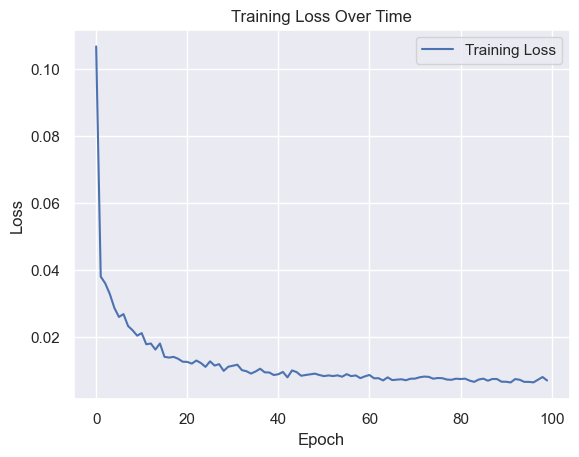

Task Train RMSE: 2.7374396324157715, Train R2: 0.9996569278737536, Train MAE: 1.9475395679473877
Task Test RMSE: 2.594003915786743, Test R2: 0.9997623246174927, Test MAE: 2.1053757667541504
Task Train RMSE: 2.860175609588623, Train R2: 0.999708326730988, Train MAE: 2.0380287170410156
Task Test RMSE: 1.9951775074005127, Test R2: 0.9959426982115525, Test MAE: 1.7434203624725342
Task Train RMSE: 2.5621893405914307, Train R2: 0.9997181838200487, Train MAE: 1.9675827026367188
Task Test RMSE: 3.231703042984009, Test R2: 0.9995804137050887, Test MAE: 2.0251998901367188
Task Train RMSE: 2.684950590133667, Train R2: 0.9996870820228656, Train MAE: 2.0255680084228516
Task Test RMSE: 2.80487060546875, Test R2: 0.9996832687029389, Test MAE: 1.7932602167129517
Task Train RMSE: 2.6935441493988037, Train R2: 0.9996590822658245, Train MAE: 1.9168117046356201
Task Test RMSE: 2.7717161178588867, Test R2: 0.9997438170225805, Test MAE: 2.2282791137695312
Task Train RMSE: 3.7046384811401367, Train R2: 0.999

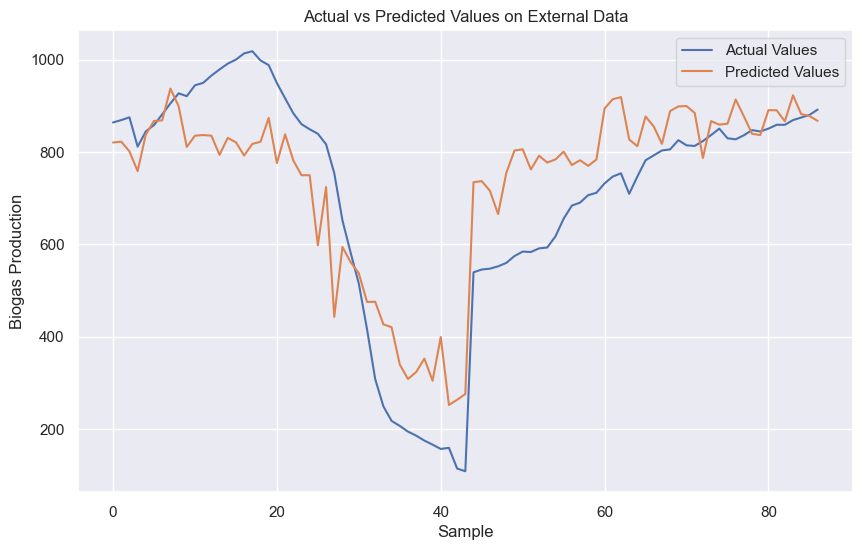

External Dataset - RMSE: 128.90895080566406, R2: 0.7280112373487098, MAE: 107.60385131835938


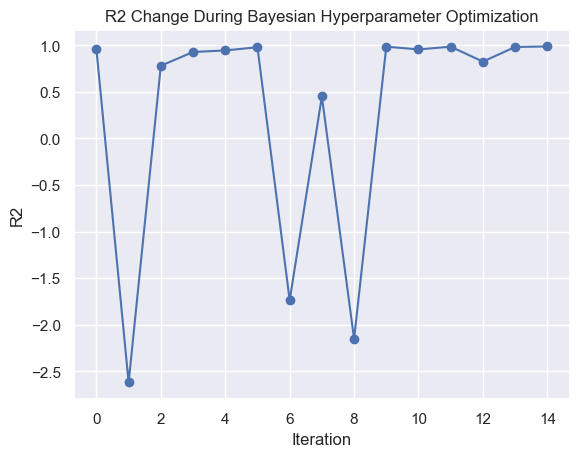

Original Dataset - RMSE: 5.544122756944007, R2: 0.9994969045743816, MAE: 4.018162089308649
External Dataset - RMSE: 128.90895080566406, R2: 0.7280112373487098, MAE: 107.60385131835938


In [27]:
import torch
from torch import nn, optim
import torch.nn.functional as F
import numpy as np
import pandas as pd
from sklearn.preprocessing import StandardScaler
import learn2learn as l2l
from sklearn.model_selection import train_test_split, KFold
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from skopt import gp_minimize
from skopt.space import Real, Integer
from skopt.utils import use_named_args
import matplotlib.pyplot as plt
from torch.utils.data import DataLoader, TensorDataset

# 设置随机种子
np.random.seed(0)
torch.manual_seed(0)

device = torch.device("cuda:0")  # Use GPU 0

# Hyperparameter search space
search_space = [
    Integer(500, 1500, name='hidden_size'), 
    Real(1e-11, 1e-6, "log-uniform", name='alpha'),  
    Real(1e-7, 1e-3, "log-uniform", name='beta'),
    Real(0.1, 0.8, name='dropout_rate'), 
    Real(1e-7, 1e-1, "log-uniform", name='weight_decay') 
]

# Data normalization and denormalization functions
def normalize_data(data):
    scaler = StandardScaler()
    return scaler.fit_transform(data), scaler

def normalize_feature(data, column_name):
    scaler = StandardScaler()
    scaled_data = scaler.fit_transform(data[[column_name]])
    return scaled_data, scaler

def denormalize_data(normalized_data, scaler):
    return scaler.inverse_transform(normalized_data)


# 元学习模型定义
class AdvancedNeuralNetwork(nn.Module):
    def __init__(self, input_size, hidden_size, dropout_rate):
        super(AdvancedNeuralNetwork, self).__init__()
        self.layer1 = nn.Linear(input_size, hidden_size)
        self.relu1 = nn.LeakyReLU()
        self.layer2 = nn.Linear(hidden_size, hidden_size // 2)
        self.relu2 = nn.LeakyReLU()
        self.layer3 = nn.Linear(hidden_size // 2, hidden_size // 4)
        self.relu3 = nn.LeakyReLU()
        self.dropout = nn.Dropout(dropout_rate)
        self.layer4 = nn.Linear(hidden_size // 4, 1)

    def forward(self, x):
        x = self.relu1(self.layer1(x))
        x = self.relu2(self.layer2(x))
        x = self.relu3(self.layer3(x))
        x = self.dropout(x)
        x = self.layer4(x)
        return x

# 其他辅助函数和类（如EarlyStopping, create_tasks等）根据需要添加
# Task creation function
def create_tasks(data, target_column, num_tasks=50, task_size=100):
    tasks = []
    for _ in range(num_tasks):
        task_data = data.sample(task_size)
        X, y = task_data.drop(target_column, axis=1), task_data[target_column]
        tasks.append((X, y))
    return tasks

# Early stopping class
class EarlyStopping:
    def __init__(self, patience=5, delta=0):
        self.patience = patience
        self.counter = 0
        self.best_score = None
        self.early_stop = False
        self.delta = delta

    def __call__(self, val_loss, model):
        score = -val_loss
        if self.best_score is None:
            self.best_score = score
        elif score < self.best_score + self.delta:
            self.counter += 1
            if self.counter >= self.patience:
                self.early_stop = True
        else:
            self.best_score = score
            self.counter = 0

# GAN的生成器定义
class Generator(nn.Module):
    def __init__(self, input_size, hidden_dim, output_size):
        super(Generator, self).__init__()
        self.fc1 = nn.Linear(input_size, hidden_dim)
        self.fc2 = nn.Linear(hidden_dim, hidden_dim * 2)
        self.fc3 = nn.Linear(hidden_dim * 2, hidden_dim * 4)
        self.fc4 = nn.Linear(hidden_dim * 4, output_size)

    def forward(self, x):
        x = F.leaky_relu(self.fc1(x), 0.2)
        x = F.leaky_relu(self.fc2(x), 0.2)
        x = F.leaky_relu(self.fc3(x), 0.2)
        x = torch.tanh(self.fc4(x))
        return x

# GAN的判别器定义
class Discriminator(nn.Module):
    def __init__(self, input_size, hidden_dim):
        super(Discriminator, self).__init__()
        self.fc1 = nn.Linear(input_size, hidden_dim * 4)
        self.fc2 = nn.Linear(hidden_dim * 4, hidden_dim * 2)
        self.fc3 = nn.Linear(hidden_dim * 2, hidden_dim)
        self.fc4 = nn.Linear(hidden_dim, 1)

    def forward(self, x):
        x = F.leaky_relu(self.fc1(x), 0.2)
        x = F.leaky_relu(self.fc2(x), 0.2)
        x = F.leaky_relu(self.fc3(x), 0.2)
        x = torch.sigmoid(self.fc4(x))
        return x

# MAML fast adaptation and meta-training
def meta_train_maml(model, tasks, alpha, beta, weight_decay, epochs=100, num_steps=1):
    early_stopping = EarlyStopping(patience=10, delta=0.01)
    optimizer = optim.Adam(model.parameters(), lr=beta, weight_decay=weight_decay)
    scheduler = optim.lr_scheduler.CosineAnnealingLR(optimizer, T_max=epochs)

    epoch_loss_list = []  # Initialize a list to store losses for each epoch

    for epoch in range(epochs):
        epoch_losses = []
        for task in tasks:
            learner = model.clone()  # Clone the model
            task_X, task_y = task
            task_X = torch.from_numpy(task_X.values).float().to(device)
            task_y = torch.from_numpy(task_y.values).float().to(device)

            # Fast adaptation
            for step in range(num_steps):
                pred_y = learner(task_X)
                loss = nn.functional.mse_loss(pred_y.squeeze(), task_y)
                learner.adapt(loss)

            # Meta-update
            optimizer.zero_grad()
            pred_y = learner(task_X)
            loss = nn.functional.mse_loss(pred_y.squeeze(), task_y)
            epoch_losses.append(loss.item())
            loss.backward()
            optimizer.step()

        scheduler.step()  # Update learning rate
        average_loss = np.mean(epoch_losses)
        epoch_loss_list.append(average_loss)  # Add each epoch's average loss to the list

        if early_stopping(average_loss, model):
            print(f"Early stopping triggered at epoch {epoch}")
            break

    return epoch_loss_list  # Return the list of epoch losses



@use_named_args(search_space)
def objective(hidden_size, alpha, beta, dropout_rate, weight_decay):
    model = AdvancedNeuralNetwork(input_size, hidden_size, dropout_rate)
    model = l2l.algorithms.MAML(model, lr=alpha).to(device)
    avg_r2 = 0

    task_r2_list = []  # 记录每个任务的 R2

    for task in tasks:
        task_X, task_y = task
        task_X_train, task_X_test, task_y_train, task_y_test = train_test_split(task_X, task_y, test_size=0.2, random_state=0)
        meta_train_maml(model, [(task_X_train, task_y_train)], alpha, beta, weight_decay, epochs=100)
        train_rmse, train_r2, train_mae, test_rmse, test_r2, test_mae = evaluate_model(model, task_X_train, task_y_train, task_X_test, task_y_test, target_scaler)
        task_r2_list.append(test_r2)  # 记录每个任务的测试 R2
        avg_r2 += test_r2

    avg_r2 /= len(tasks)
    return -avg_r2  # 这里返回负数因为 skopt 的目标函数是最小化，而我们想要最大化 R2

# Evaluation function
def evaluate_model(model, X_train, y_train, X_test, y_test, target_scaler):
    model.eval()
    with torch.no_grad():
        # Convert data to tensors
        X_train_tensor = torch.from_numpy(X_train.values).float().to(device)
        y_train_tensor = torch.from_numpy(y_train.values).float().to(device)
        X_test_tensor = torch.from_numpy(X_test.values).float().to(device)
        y_test_tensor = torch.from_numpy(y_test.values).float().to(device)

        # Get predictions
        train_predictions = model(X_train_tensor).squeeze().cpu().numpy()
        test_predictions = model(X_test_tensor).squeeze().cpu().numpy()

        # Reshape predictions for denormalization
        train_predictions_reshaped = train_predictions.reshape(-1, 1)
        test_predictions_reshaped = test_predictions.reshape(-1, 1)

        # Denormalize predictions using target_scaler
        train_predictions_denorm = denormalize_data(train_predictions_reshaped, target_scaler)
        test_predictions_denorm = denormalize_data(test_predictions_reshaped, target_scaler)

        # Denormalize actual values using target_scaler
        y_train_denorm = denormalize_data(y_train_tensor.cpu().numpy().reshape(-1, 1), target_scaler)
        y_test_denorm = denormalize_data(y_test_tensor.cpu().numpy().reshape(-1, 1), target_scaler)

        # Calculate metrics using denormalized data
        train_rmse = mean_squared_error(y_train_denorm, train_predictions_denorm, squared=False)
        train_r2 = r2_score(y_train_denorm, train_predictions_denorm)
        train_mae = mean_absolute_error(y_train_denorm, train_predictions_denorm)

        test_rmse = mean_squared_error(y_test_denorm, test_predictions_denorm, squared=False)
        test_r2 = r2_score(y_test_denorm, test_predictions_denorm)
        test_mae = mean_absolute_error(y_test_denorm, test_predictions_denorm)

    return train_rmse, train_r2, train_mae, test_rmse, test_r2, test_mae


# 加载和规范化数据
data = pd.read_csv("C:\\Users\\Lenovo\\Desktop\\元学习\\BT(2)4-1.csv")
data_normalized, scaler = normalize_data(data)

# 假设您的目标列名为'GI(%)'
target_normalized, target_scaler = normalize_data(data[['Biogas Production']].values)
external_data = pd.read_csv("C:\\Users\\Lenovo\\Desktop\\元学习\\BT(2)4-2.csv")

# 设置GAN训练参数
z_dim = 100  # 潜在空间的维度
gen_hidden_dim = 128
dis_hidden_dim = 128
lr = 0.0002
batch_size = 64
num_epochs = 50

# 初始化模型
generator = Generator(z_dim, gen_hidden_dim, data_normalized.shape[1]).to(device)
discriminator = Discriminator(data_normalized.shape[1], dis_hidden_dim).to(device)

# 优化器
optim_g = optim.Adam(generator.parameters(), lr=lr)
optim_d = optim.Adam(discriminator.parameters(), lr=lr)

tensor_data = torch.Tensor(data_normalized)
data_loader = DataLoader(tensor_data, batch_size=batch_size, shuffle=True)

# GAN训练循环
for epoch in range(num_epochs):
    for batch in data_loader:
        current_batch_size = len(batch)  # Get the actual batch size
        real_data = batch.to(device)
        real_labels = torch.ones(current_batch_size, 1).to(device)  # Adjust label size based on batch
        fake_data = generator(torch.randn(current_batch_size, z_dim).to(device))  # Generate fake data based on current batch size
        fake_labels = torch.zeros(current_batch_size, 1).to(device)  # Adjust fake label size

        # 训练判别器
        optim_d.zero_grad()
        real_output = discriminator(real_data)
        fake_output = discriminator(fake_data)
        d_loss_real = nn.BCEWithLogitsLoss()(real_output, real_labels)
        d_loss_fake = nn.BCEWithLogitsLoss()(fake_output, fake_labels)
        d_loss = d_loss_real + d_loss_fake
        d_loss.backward()
        optim_d.step()

        # 训练生成器
        optim_g.zero_grad()
        fake_data = generator(torch.randn(current_batch_size, z_dim).to(device))  # Regenerate fake data
        fake_output = discriminator(fake_data)
        g_loss = nn.BCEWithLogitsLoss()(fake_output, real_labels)  # Use real_labels here
        g_loss.backward()
        optim_g.step()

# 假设您想生成一定数量的新样本
number_of_generated_samples = 300

# 生成新的数据样本
generated_samples = []
for _ in range(number_of_generated_samples):
    z = torch.randn(1, z_dim).to(device)
    generated_sample = generator(z).detach().cpu().numpy()
    generated_samples.append(generated_sample.reshape(-1))

generated_samples = np.array(generated_samples)

# 将生成的样本合并到现有数据中
extended_data = np.vstack([data_normalized, generated_samples])

# 创建增强的数据集任务
# 这里假设您已经定义了创建任务的函数
input_size = data.shape[1] - 1 
tasks = create_tasks(pd.DataFrame(extended_data, columns=data.columns), target_column='Biogas Production')
# Execute hyperparameter optimization
result = gp_minimize(objective, search_space, n_calls=15,random_state=0)
hidden_size, alpha, beta, dropout_rate, weight_decay = result.x
print("Best parameters:", result.x)

# Train model with optimized hyperparameters
model = AdvancedNeuralNetwork(input_size, hidden_size, dropout_rate)
model = l2l.algorithms.MAML(model, lr=alpha).to(device)
train_losses = meta_train_maml(model, tasks, alpha, beta, weight_decay, epochs=100)

# Visualize training losses
plt.plot(train_losses, label='Training Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training Loss Over Time')
plt.legend()
plt.show()

# Final model evaluation
for task in tasks:
    X, y = task
    kf = KFold(n_splits=5, shuffle=True, random_state=0)
    for train_index, test_index in kf.split(X):
        X_train, X_test = X.iloc[train_index], X.iloc[test_index]
        y_train, y_test = y.iloc[train_index], y.iloc[test_index]
        train_rmse, train_r2, train_mae, test_rmse, test_r2, test_mae = evaluate_model(model, X_train, y_train, X_test, y_test, target_scaler)
        print(f"Task Train RMSE: {train_rmse}, Train R2: {train_r2}, Train MAE: {train_mae}")
        print(f"Task Test RMSE: {test_rmse}, Test R2: {test_r2}, Test MAE: {test_mae}")
# Load and process external data for evaluation
external_data_normalized, _ = normalize_data(external_data)
external_target_normalized, _ = normalize_feature(external_data, 'Biogas Production')
external_X = torch.from_numpy(pd.DataFrame(external_data_normalized, columns=external_data.columns).drop('Biogas Production', axis=1).values).float().to(device)
external_y_normalized = torch.from_numpy(external_target_normalized).float().to(device)

# Model prediction on external data
learner = model.clone()  # Clone the model for evaluation
learner.eval()
with torch.no_grad():
    external_predictions_normalized = learner(external_X).squeeze()
external_predictions = denormalize_data(external_predictions_normalized.cpu().numpy().reshape(-1, 1), target_scaler)
external_y = denormalize_data(external_y_normalized.cpu().numpy().reshape(-1, 1), target_scaler)

# Visualization of predictions on external data
plt.figure(figsize=(10, 6))
plt.plot(external_y, label='Actual Values')
plt.plot(external_predictions, label='Predicted Values')
plt.xlabel('Sample')
plt.ylabel('Biogas Production')
plt.title('Actual vs Predicted Values on External Data')
plt.legend()
plt.show()

# Evaluate on external dataset using denormalized data
external_rmse = mean_squared_error(external_y, external_predictions, squared=False)
external_r2 = r2_score(external_y, external_predictions)
external_mae = mean_absolute_error(external_y, external_predictions)

print(f"External Dataset - RMSE: {external_rmse}, R2: {external_r2}, MAE: {external_mae}")

# 提取每次迭代的最佳 R2
best_r2_list = []
for res in result.func_vals:
    best_r2_list.append(-res)  # 注意要取负数

# 绘制 R2 的变化过程图
plt.plot(best_r2_list, marker='o')
plt.xlabel('Iteration')
plt.ylabel('R2')
plt.title('R2 Change During Bayesian Hyperparameter Optimization')
plt.show()

import torch
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from sklearn.model_selection import train_test_split

target_column = 'Biogas Production'

# 分离特征和目标变量
X = data.drop(target_column, axis=1)
y = data[target_column]
X_external = external_data.drop(target_column, axis=1)
y_external = external_data[target_column]

# 标准化数据
X_normalized, feature_scaler = normalize_data(X)
y_normalized, target_scaler = normalize_data(y.values.reshape(-1, 1))

# 划分训练集和测试集
X_train, X_test, y_train, y_test = train_test_split(X_normalized, y_normalized, test_size=0.2, random_state=0)

# 转换为 PyTorch 张量
X_train_tensor = torch.from_numpy(X_train).float().to(device)
X_test_tensor = torch.from_numpy(X_test).float().to(device)
y_train_tensor = torch.from_numpy(y_train).float().to(device)
y_test_tensor = torch.from_numpy(y_test).float().to(device)

# 标准化外部数据集
X_external_normalized, _ = normalize_data(X_external)
y_external_normalized, _ = normalize_data(y_external.values.reshape(-1, 1))

# 转换外部数据为张量
X_external_tensor = torch.from_numpy(X_external_normalized).float().to(device)
y_external_tensor = torch.from_numpy(y_external_normalized).float().to(device)

# 模型预测函数
def model_predict(model, X_tensor):
    model.eval()
    with torch.no_grad():
        return model(X_tensor).cpu().numpy()

# 获取预测值
y_pred_train = model_predict(model, X_train_tensor).flatten()
y_pred_test = model_predict(model, X_test_tensor).flatten()
y_pred_external = model_predict(model, X_external_tensor).flatten()

# 反标准化预测值和实际值
y_pred_train_denorm = denormalize_data(y_pred_train.reshape(-1, 1), target_scaler).flatten()
y_pred_test_denorm = denormalize_data(y_pred_test.reshape(-1, 1), target_scaler).flatten()
y_pred_external_denorm = denormalize_data(y_pred_external.reshape(-1, 1), target_scaler).flatten()
y_train_denorm = denormalize_data(y_train, target_scaler).flatten()
y_test_denorm = denormalize_data(y_test, target_scaler).flatten()
y_external_denorm = denormalize_data(y_external_tensor.cpu().numpy(), target_scaler).flatten()


# 合并原始数据集和外部数据集的预测值和实际值
original_data_actual = np.concatenate([y_train_denorm, y_test_denorm])
original_data_predicted = np.concatenate([y_pred_train_denorm, y_pred_test_denorm])
external_data_actual = y_external_denorm
external_data_predicted = y_pred_external_denorm

# 创建 DataFrame
combined_df = pd.DataFrame({
    'Actual': np.concatenate([original_data_actual, external_data_actual]),
    'Predicted': np.concatenate([original_data_predicted, external_data_predicted]),
    'Dataset': ['Original'] * len(original_data_actual) + ['External'] * len(external_data_actual)
})

# 计算原始数据集的指标
train_r2 = r2_score(original_data_actual, original_data_predicted)
train_rmse = mean_squared_error(original_data_actual, original_data_predicted, squared=False)
train_mae = mean_absolute_error(original_data_actual, original_data_predicted)

# 计算外部数据集的指标
external_r2 = r2_score(external_data_actual, external_data_predicted)
external_rmse = mean_squared_error(external_data_actual, external_data_predicted, squared=False)
external_mae = mean_absolute_error(external_data_actual, external_data_predicted)


print(f"Original Dataset - RMSE: {train_rmse}, R2: {train_r2}, MAE: {train_mae}")
print(f"External Dataset - RMSE: {external_rmse}, R2: {external_r2}, MAE: {external_mae}")

Best parameters: [1500, 1e-06, 0.0002055044162243269, 0.2730324098295857, 1e-07]


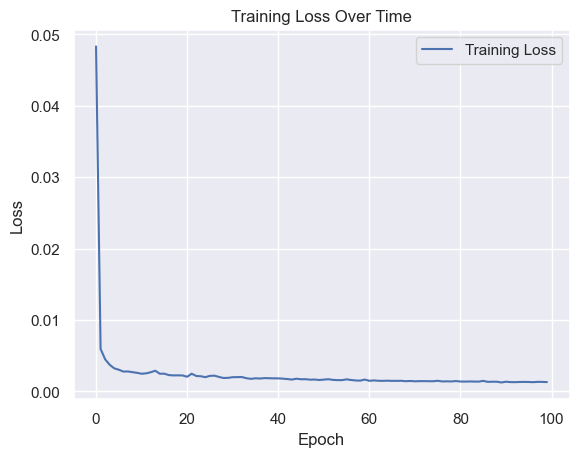

Task Train RMSE: 3.613823890686035, Train R2: 0.9999170250283789, Train MAE: 2.8069088459014893
Task Test RMSE: 3.202186107635498, Test R2: 0.9998638557261809, Test MAE: 2.3721466064453125
Task Train RMSE: 3.292546510696411, Train R2: 0.999932239003406, Train MAE: 2.5107645988464355
Task Test RMSE: 4.3737077713012695, Test R2: 0.9997233837877787, Test MAE: 3.556720018386841
Task Train RMSE: 3.622304916381836, Train R2: 0.9998600628295551, Train MAE: 2.763643741607666
Task Test RMSE: 3.1636195182800293, Test R2: 0.9999674184877668, Test MAE: 2.5452163219451904
Task Train RMSE: 3.35786509513855, Train R2: 0.9999187703638632, Train MAE: 2.5946056842803955
Task Test RMSE: 4.170369625091553, Test R2: 0.9998872935598843, Test MAE: 3.2213714122772217
Task Train RMSE: 3.767747402191162, Train R2: 0.9999107173907605, Train MAE: 2.9238619804382324
Task Test RMSE: 2.3893871307373047, Test R2: 0.9999160116354265, Test MAE: 1.9043304920196533
Task Train RMSE: 5.012220859527588, Train R2: 0.99985202

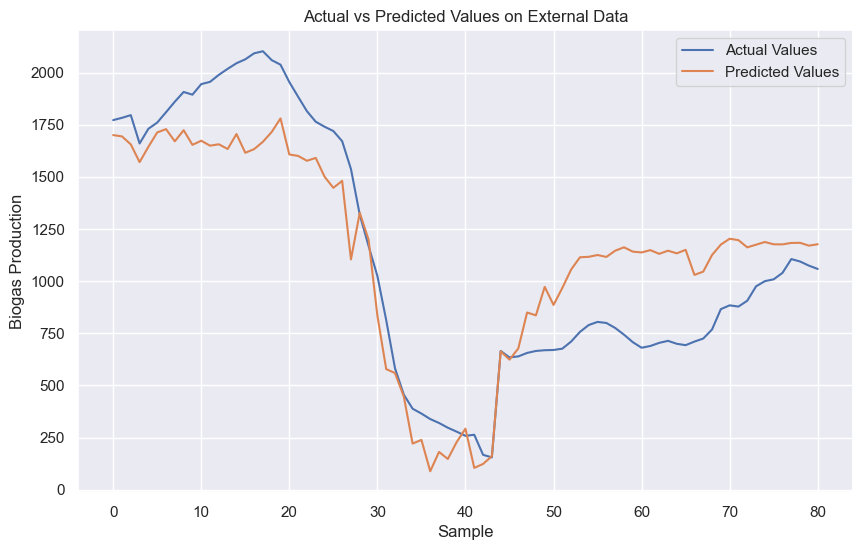

External Dataset - RMSE: 268.02569580078125, R2: 0.798211629922018, MAE: 230.28631591796875


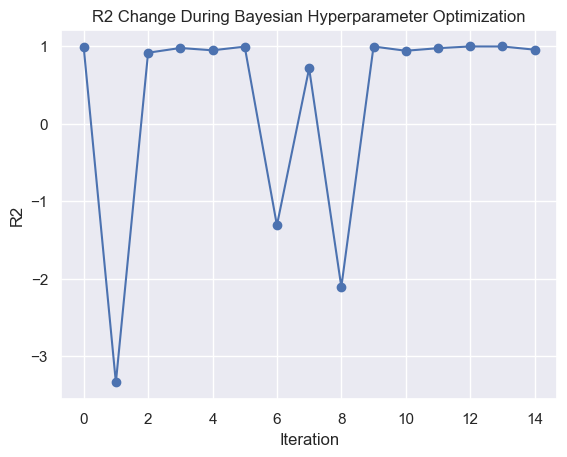

Original Dataset - RMSE: 2.8739007861335604, R2: 0.9999768000628501, MAE: 2.1111429953273344
External Dataset - RMSE: 268.02569580078125, R2: 0.798211629922018, MAE: 230.28631591796875


In [28]:
import torch
from torch import nn, optim
import torch.nn.functional as F
import numpy as np
import pandas as pd
from sklearn.preprocessing import StandardScaler
import learn2learn as l2l
from sklearn.model_selection import train_test_split, KFold
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from skopt import gp_minimize
from skopt.space import Real, Integer
from skopt.utils import use_named_args
import matplotlib.pyplot as plt
from torch.utils.data import DataLoader, TensorDataset

# 设置随机种子
np.random.seed(0)
torch.manual_seed(0)

device = torch.device("cuda:0")  # Use GPU 0

# Hyperparameter search space
search_space = [
    Integer(500, 1500, name='hidden_size'), 
    Real(1e-11, 1e-6, "log-uniform", name='alpha'),  
    Real(1e-7, 1e-3, "log-uniform", name='beta'),
    Real(0.1, 0.8, name='dropout_rate'), 
    Real(1e-7, 1e-1, "log-uniform", name='weight_decay') 
]

# Data normalization and denormalization functions
def normalize_data(data):
    scaler = StandardScaler()
    return scaler.fit_transform(data), scaler

def normalize_feature(data, column_name):
    scaler = StandardScaler()
    scaled_data = scaler.fit_transform(data[[column_name]])
    return scaled_data, scaler

def denormalize_data(normalized_data, scaler):
    return scaler.inverse_transform(normalized_data)


# 元学习模型定义
class AdvancedNeuralNetwork(nn.Module):
    def __init__(self, input_size, hidden_size, dropout_rate):
        super(AdvancedNeuralNetwork, self).__init__()
        self.layer1 = nn.Linear(input_size, hidden_size)
        self.relu1 = nn.LeakyReLU()
        self.layer2 = nn.Linear(hidden_size, hidden_size // 2)
        self.relu2 = nn.LeakyReLU()
        self.layer3 = nn.Linear(hidden_size // 2, hidden_size // 4)
        self.relu3 = nn.LeakyReLU()
        self.dropout = nn.Dropout(dropout_rate)
        self.layer4 = nn.Linear(hidden_size // 4, 1)

    def forward(self, x):
        x = self.relu1(self.layer1(x))
        x = self.relu2(self.layer2(x))
        x = self.relu3(self.layer3(x))
        x = self.dropout(x)
        x = self.layer4(x)
        return x

# 其他辅助函数和类（如EarlyStopping, create_tasks等）根据需要添加
# Task creation function
def create_tasks(data, target_column, num_tasks=50, task_size=100):
    tasks = []
    for _ in range(num_tasks):
        task_data = data.sample(task_size)
        X, y = task_data.drop(target_column, axis=1), task_data[target_column]
        tasks.append((X, y))
    return tasks

# Early stopping class
class EarlyStopping:
    def __init__(self, patience=5, delta=0):
        self.patience = patience
        self.counter = 0
        self.best_score = None
        self.early_stop = False
        self.delta = delta

    def __call__(self, val_loss, model):
        score = -val_loss
        if self.best_score is None:
            self.best_score = score
        elif score < self.best_score + self.delta:
            self.counter += 1
            if self.counter >= self.patience:
                self.early_stop = True
        else:
            self.best_score = score
            self.counter = 0

# GAN的生成器定义
class Generator(nn.Module):
    def __init__(self, input_size, hidden_dim, output_size):
        super(Generator, self).__init__()
        self.fc1 = nn.Linear(input_size, hidden_dim)
        self.fc2 = nn.Linear(hidden_dim, hidden_dim * 2)
        self.fc3 = nn.Linear(hidden_dim * 2, hidden_dim * 4)
        self.fc4 = nn.Linear(hidden_dim * 4, output_size)

    def forward(self, x):
        x = F.leaky_relu(self.fc1(x), 0.2)
        x = F.leaky_relu(self.fc2(x), 0.2)
        x = F.leaky_relu(self.fc3(x), 0.2)
        x = torch.tanh(self.fc4(x))
        return x

# GAN的判别器定义
class Discriminator(nn.Module):
    def __init__(self, input_size, hidden_dim):
        super(Discriminator, self).__init__()
        self.fc1 = nn.Linear(input_size, hidden_dim * 4)
        self.fc2 = nn.Linear(hidden_dim * 4, hidden_dim * 2)
        self.fc3 = nn.Linear(hidden_dim * 2, hidden_dim)
        self.fc4 = nn.Linear(hidden_dim, 1)

    def forward(self, x):
        x = F.leaky_relu(self.fc1(x), 0.2)
        x = F.leaky_relu(self.fc2(x), 0.2)
        x = F.leaky_relu(self.fc3(x), 0.2)
        x = torch.sigmoid(self.fc4(x))
        return x

# MAML fast adaptation and meta-training
def meta_train_maml(model, tasks, alpha, beta, weight_decay, epochs=100, num_steps=1):
    early_stopping = EarlyStopping(patience=10, delta=0.01)
    optimizer = optim.Adam(model.parameters(), lr=beta, weight_decay=weight_decay)
    scheduler = optim.lr_scheduler.CosineAnnealingLR(optimizer, T_max=epochs)

    epoch_loss_list = []  # Initialize a list to store losses for each epoch

    for epoch in range(epochs):
        epoch_losses = []
        for task in tasks:
            learner = model.clone()  # Clone the model
            task_X, task_y = task
            task_X = torch.from_numpy(task_X.values).float().to(device)
            task_y = torch.from_numpy(task_y.values).float().to(device)

            # Fast adaptation
            for step in range(num_steps):
                pred_y = learner(task_X)
                loss = nn.functional.mse_loss(pred_y.squeeze(), task_y)
                learner.adapt(loss)

            # Meta-update
            optimizer.zero_grad()
            pred_y = learner(task_X)
            loss = nn.functional.mse_loss(pred_y.squeeze(), task_y)
            epoch_losses.append(loss.item())
            loss.backward()
            optimizer.step()

        scheduler.step()  # Update learning rate
        average_loss = np.mean(epoch_losses)
        epoch_loss_list.append(average_loss)  # Add each epoch's average loss to the list

        if early_stopping(average_loss, model):
            print(f"Early stopping triggered at epoch {epoch}")
            break

    return epoch_loss_list  # Return the list of epoch losses



@use_named_args(search_space)
def objective(hidden_size, alpha, beta, dropout_rate, weight_decay):
    model = AdvancedNeuralNetwork(input_size, hidden_size, dropout_rate)
    model = l2l.algorithms.MAML(model, lr=alpha).to(device)
    avg_r2 = 0

    task_r2_list = []  # 记录每个任务的 R2

    for task in tasks:
        task_X, task_y = task
        task_X_train, task_X_test, task_y_train, task_y_test = train_test_split(task_X, task_y, test_size=0.2, random_state=0)
        meta_train_maml(model, [(task_X_train, task_y_train)], alpha, beta, weight_decay, epochs=100)
        train_rmse, train_r2, train_mae, test_rmse, test_r2, test_mae = evaluate_model(model, task_X_train, task_y_train, task_X_test, task_y_test, target_scaler)
        task_r2_list.append(test_r2)  # 记录每个任务的测试 R2
        avg_r2 += test_r2

    avg_r2 /= len(tasks)
    return -avg_r2  # 这里返回负数因为 skopt 的目标函数是最小化，而我们想要最大化 R2

# Evaluation function
def evaluate_model(model, X_train, y_train, X_test, y_test, target_scaler):
    model.eval()
    with torch.no_grad():
        # Convert data to tensors
        X_train_tensor = torch.from_numpy(X_train.values).float().to(device)
        y_train_tensor = torch.from_numpy(y_train.values).float().to(device)
        X_test_tensor = torch.from_numpy(X_test.values).float().to(device)
        y_test_tensor = torch.from_numpy(y_test.values).float().to(device)

        # Get predictions
        train_predictions = model(X_train_tensor).squeeze().cpu().numpy()
        test_predictions = model(X_test_tensor).squeeze().cpu().numpy()

        # Reshape predictions for denormalization
        train_predictions_reshaped = train_predictions.reshape(-1, 1)
        test_predictions_reshaped = test_predictions.reshape(-1, 1)

        # Denormalize predictions using target_scaler
        train_predictions_denorm = denormalize_data(train_predictions_reshaped, target_scaler)
        test_predictions_denorm = denormalize_data(test_predictions_reshaped, target_scaler)

        # Denormalize actual values using target_scaler
        y_train_denorm = denormalize_data(y_train_tensor.cpu().numpy().reshape(-1, 1), target_scaler)
        y_test_denorm = denormalize_data(y_test_tensor.cpu().numpy().reshape(-1, 1), target_scaler)

        # Calculate metrics using denormalized data
        train_rmse = mean_squared_error(y_train_denorm, train_predictions_denorm, squared=False)
        train_r2 = r2_score(y_train_denorm, train_predictions_denorm)
        train_mae = mean_absolute_error(y_train_denorm, train_predictions_denorm)

        test_rmse = mean_squared_error(y_test_denorm, test_predictions_denorm, squared=False)
        test_r2 = r2_score(y_test_denorm, test_predictions_denorm)
        test_mae = mean_absolute_error(y_test_denorm, test_predictions_denorm)

    return train_rmse, train_r2, train_mae, test_rmse, test_r2, test_mae


# 加载和规范化数据
data = pd.read_csv("C:\\Users\\Lenovo\\Desktop\\元学习\\BT(2)5-1.csv")
data_normalized, scaler = normalize_data(data)
# 假设您的目标列名为'GI(%)'
target_normalized, target_scaler = normalize_data(data[['Biogas Production']].values)
external_data = pd.read_csv("C:\\Users\\Lenovo\\Desktop\\元学习\\BT(2)5-2.csv")

# 设置GAN训练参数
z_dim = 100  # 潜在空间的维度
gen_hidden_dim = 128
dis_hidden_dim = 128
lr = 0.0002
batch_size = 64
num_epochs = 50

# 初始化模型
generator = Generator(z_dim, gen_hidden_dim, data_normalized.shape[1]).to(device)
discriminator = Discriminator(data_normalized.shape[1], dis_hidden_dim).to(device)

# 优化器
optim_g = optim.Adam(generator.parameters(), lr=lr)
optim_d = optim.Adam(discriminator.parameters(), lr=lr)

tensor_data = torch.Tensor(data_normalized)
data_loader = DataLoader(tensor_data, batch_size=batch_size, shuffle=True)

# GAN训练循环
for epoch in range(num_epochs):
    for batch in data_loader:
        current_batch_size = len(batch)  # Get the actual batch size
        real_data = batch.to(device)
        real_labels = torch.ones(current_batch_size, 1).to(device)  # Adjust label size based on batch
        fake_data = generator(torch.randn(current_batch_size, z_dim).to(device))  # Generate fake data based on current batch size
        fake_labels = torch.zeros(current_batch_size, 1).to(device)  # Adjust fake label size

        # 训练判别器
        optim_d.zero_grad()
        real_output = discriminator(real_data)
        fake_output = discriminator(fake_data)
        d_loss_real = nn.BCEWithLogitsLoss()(real_output, real_labels)
        d_loss_fake = nn.BCEWithLogitsLoss()(fake_output, fake_labels)
        d_loss = d_loss_real + d_loss_fake
        d_loss.backward()
        optim_d.step()

        # 训练生成器
        optim_g.zero_grad()
        fake_data = generator(torch.randn(current_batch_size, z_dim).to(device))  # Regenerate fake data
        fake_output = discriminator(fake_data)
        g_loss = nn.BCEWithLogitsLoss()(fake_output, real_labels)  # Use real_labels here
        g_loss.backward()
        optim_g.step()

# 假设您想生成一定数量的新样本
number_of_generated_samples = 300

# 生成新的数据样本
generated_samples = []
for _ in range(number_of_generated_samples):
    z = torch.randn(1, z_dim).to(device)
    generated_sample = generator(z).detach().cpu().numpy()
    generated_samples.append(generated_sample.reshape(-1))

generated_samples = np.array(generated_samples)

# 将生成的样本合并到现有数据中
extended_data = np.vstack([data_normalized, generated_samples])

# 创建增强的数据集任务
# 这里假设您已经定义了创建任务的函数
input_size = data.shape[1] - 1 
tasks = create_tasks(pd.DataFrame(extended_data, columns=data.columns), target_column='Biogas Production')
# Execute hyperparameter optimization
result = gp_minimize(objective, search_space, n_calls=15,random_state=0)
hidden_size, alpha, beta, dropout_rate, weight_decay = result.x
print("Best parameters:", result.x)

# Train model with optimized hyperparameters
model = AdvancedNeuralNetwork(input_size, hidden_size, dropout_rate)
model = l2l.algorithms.MAML(model, lr=alpha).to(device)
train_losses = meta_train_maml(model, tasks, alpha, beta, weight_decay, epochs=100)

# Visualize training losses
plt.plot(train_losses, label='Training Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training Loss Over Time')
plt.legend()
plt.show()

# Final model evaluation
for task in tasks:
    X, y = task
    kf = KFold(n_splits=5, shuffle=True, random_state=0)
    for train_index, test_index in kf.split(X):
        X_train, X_test = X.iloc[train_index], X.iloc[test_index]
        y_train, y_test = y.iloc[train_index], y.iloc[test_index]
        train_rmse, train_r2, train_mae, test_rmse, test_r2, test_mae = evaluate_model(model, X_train, y_train, X_test, y_test, target_scaler)
        print(f"Task Train RMSE: {train_rmse}, Train R2: {train_r2}, Train MAE: {train_mae}")
        print(f"Task Test RMSE: {test_rmse}, Test R2: {test_r2}, Test MAE: {test_mae}")
# Load and process external data for evaluation
external_data_normalized, _ = normalize_data(external_data)
external_target_normalized, _ = normalize_feature(external_data, 'Biogas Production')
external_X = torch.from_numpy(pd.DataFrame(external_data_normalized, columns=external_data.columns).drop('Biogas Production', axis=1).values).float().to(device)
external_y_normalized = torch.from_numpy(external_target_normalized).float().to(device)

# Model prediction on external data
learner = model.clone()  # Clone the model for evaluation
learner.eval()
with torch.no_grad():
    external_predictions_normalized = learner(external_X).squeeze()
external_predictions = denormalize_data(external_predictions_normalized.cpu().numpy().reshape(-1, 1), target_scaler)
external_y = denormalize_data(external_y_normalized.cpu().numpy().reshape(-1, 1), target_scaler)

# Visualization of predictions on external data
plt.figure(figsize=(10, 6))
plt.plot(external_y, label='Actual Values')
plt.plot(external_predictions, label='Predicted Values')
plt.xlabel('Sample')
plt.ylabel('Biogas Production')
plt.title('Actual vs Predicted Values on External Data')
plt.legend()
plt.show()

# Evaluate on external dataset using denormalized data
external_rmse = mean_squared_error(external_y, external_predictions, squared=False)
external_r2 = r2_score(external_y, external_predictions)
external_mae = mean_absolute_error(external_y, external_predictions)

print(f"External Dataset - RMSE: {external_rmse}, R2: {external_r2}, MAE: {external_mae}")

# 提取每次迭代的最佳 R2
best_r2_list = []
for res in result.func_vals:
    best_r2_list.append(-res)  # 注意要取负数

# 绘制 R2 的变化过程图
plt.plot(best_r2_list, marker='o')
plt.xlabel('Iteration')
plt.ylabel('R2')
plt.title('R2 Change During Bayesian Hyperparameter Optimization')
plt.show()

import torch
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from sklearn.model_selection import train_test_split

target_column = 'Biogas Production'

# 分离特征和目标变量
X = data.drop(target_column, axis=1)
y = data[target_column]
X_external = external_data.drop(target_column, axis=1)
y_external = external_data[target_column]

# 标准化数据
X_normalized, feature_scaler = normalize_data(X)
y_normalized, target_scaler = normalize_data(y.values.reshape(-1, 1))

# 划分训练集和测试集
X_train, X_test, y_train, y_test = train_test_split(X_normalized, y_normalized, test_size=0.2, random_state=0)

# 转换为 PyTorch 张量
X_train_tensor = torch.from_numpy(X_train).float().to(device)
X_test_tensor = torch.from_numpy(X_test).float().to(device)
y_train_tensor = torch.from_numpy(y_train).float().to(device)
y_test_tensor = torch.from_numpy(y_test).float().to(device)

# 标准化外部数据集
X_external_normalized, _ = normalize_data(X_external)
y_external_normalized, _ = normalize_data(y_external.values.reshape(-1, 1))

# 转换外部数据为张量
X_external_tensor = torch.from_numpy(X_external_normalized).float().to(device)
y_external_tensor = torch.from_numpy(y_external_normalized).float().to(device)

# 模型预测函数
def model_predict(model, X_tensor):
    model.eval()
    with torch.no_grad():
        return model(X_tensor).cpu().numpy()

# 获取预测值
y_pred_train = model_predict(model, X_train_tensor).flatten()
y_pred_test = model_predict(model, X_test_tensor).flatten()
y_pred_external = model_predict(model, X_external_tensor).flatten()

# 反标准化预测值和实际值
y_pred_train_denorm = denormalize_data(y_pred_train.reshape(-1, 1), target_scaler).flatten()
y_pred_test_denorm = denormalize_data(y_pred_test.reshape(-1, 1), target_scaler).flatten()
y_pred_external_denorm = denormalize_data(y_pred_external.reshape(-1, 1), target_scaler).flatten()
y_train_denorm = denormalize_data(y_train, target_scaler).flatten()
y_test_denorm = denormalize_data(y_test, target_scaler).flatten()
y_external_denorm = denormalize_data(y_external_tensor.cpu().numpy(), target_scaler).flatten()


# 合并原始数据集和外部数据集的预测值和实际值
original_data_actual = np.concatenate([y_train_denorm, y_test_denorm])
original_data_predicted = np.concatenate([y_pred_train_denorm, y_pred_test_denorm])
external_data_actual = y_external_denorm
external_data_predicted = y_pred_external_denorm

# 创建 DataFrame
combined_df = pd.DataFrame({
    'Actual': np.concatenate([original_data_actual, external_data_actual]),
    'Predicted': np.concatenate([original_data_predicted, external_data_predicted]),
    'Dataset': ['Original'] * len(original_data_actual) + ['External'] * len(external_data_actual)
})

# 计算原始数据集的指标
train_r2 = r2_score(original_data_actual, original_data_predicted)
train_rmse = mean_squared_error(original_data_actual, original_data_predicted, squared=False)
train_mae = mean_absolute_error(original_data_actual, original_data_predicted)

# 计算外部数据集的指标
external_r2 = r2_score(external_data_actual, external_data_predicted)
external_rmse = mean_squared_error(external_data_actual, external_data_predicted, squared=False)
external_mae = mean_absolute_error(external_data_actual, external_data_predicted)


print(f"Original Dataset - RMSE: {train_rmse}, R2: {train_r2}, MAE: {train_mae}")
print(f"External Dataset - RMSE: {external_rmse}, R2: {external_r2}, MAE: {external_mae}")

Best parameters: [644, 6.440426224527743e-09, 0.00017227870578054945, 0.1, 1e-07]


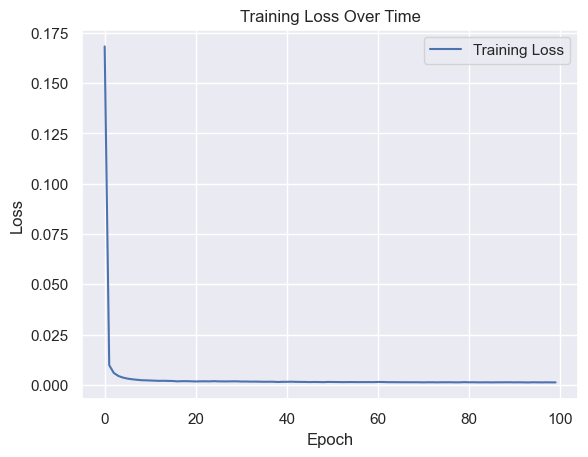

Task Train RMSE: 2.1881508827209473, Train R2: 0.999950673254692, Train MAE: 1.5844749212265015
Task Test RMSE: 1.8372026681900024, Test R2: 0.9999406862399188, Test MAE: 1.4700043201446533
Task Train RMSE: 2.1460323333740234, Train R2: 0.9999514992831878, Train MAE: 1.5370155572891235
Task Test RMSE: 2.02620267868042, Test R2: 0.9999387295190708, Test MAE: 1.6598418951034546
Task Train RMSE: 2.30601167678833, Train R2: 0.9999190883320985, Train MAE: 1.7315956354141235
Task Test RMSE: 1.1209766864776611, Test R2: 0.999992497819769, Test MAE: 0.8815215826034546
Task Train RMSE: 1.9853328466415405, Train R2: 0.9999620082980316, Train MAE: 1.497277855873108
Task Test RMSE: 2.600214719772339, Test R2: 0.9996613140851102, Test MAE: 1.81878662109375
Task Train RMSE: 1.9684149026870728, Train R2: 0.9999538719001394, Train MAE: 1.4575462341308594
Task Test RMSE: 2.65116810798645, Test R2: 0.9999356932663929, Test MAE: 1.97772216796875
Task Train RMSE: 1.9134145975112915, Train R2: 0.9999507249

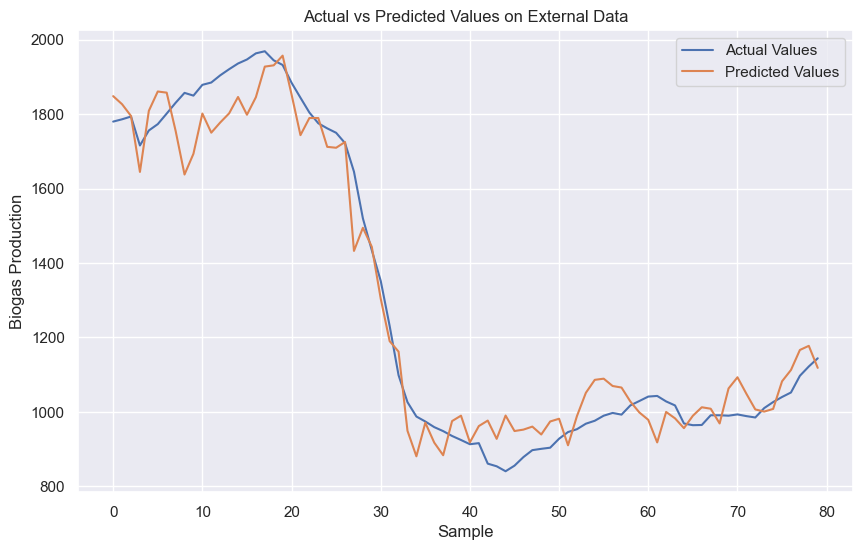

External Dataset - RMSE: 77.0860366821289, R2: 0.9648308705235994, MAE: 62.696144104003906


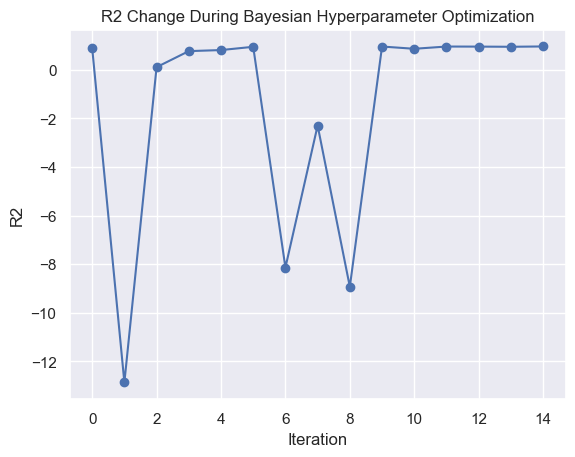

Original Dataset - RMSE: 1.0668597065285672, R2: 0.9999932636477299, MAE: 0.8273474426269474
External Dataset - RMSE: 77.0860366821289, R2: 0.9648308705235994, MAE: 62.696144104003906


In [29]:
import torch
from torch import nn, optim
import torch.nn.functional as F
import numpy as np
import pandas as pd
from sklearn.preprocessing import StandardScaler
import learn2learn as l2l
from sklearn.model_selection import train_test_split, KFold
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from skopt import gp_minimize
from skopt.space import Real, Integer
from skopt.utils import use_named_args
import matplotlib.pyplot as plt
from torch.utils.data import DataLoader, TensorDataset

# 设置随机种子
np.random.seed(0)
torch.manual_seed(0)

device = torch.device("cuda:0")  # Use GPU 0

# Hyperparameter search space
search_space = [
    Integer(500, 1500, name='hidden_size'), 
    Real(1e-11, 1e-6, "log-uniform", name='alpha'),  
    Real(1e-7, 1e-3, "log-uniform", name='beta'),
    Real(0.1, 0.8, name='dropout_rate'), 
    Real(1e-7, 1e-1, "log-uniform", name='weight_decay') 
]

# Data normalization and denormalization functions
def normalize_data(data):
    scaler = StandardScaler()
    return scaler.fit_transform(data), scaler

def normalize_feature(data, column_name):
    scaler = StandardScaler()
    scaled_data = scaler.fit_transform(data[[column_name]])
    return scaled_data, scaler

def denormalize_data(normalized_data, scaler):
    return scaler.inverse_transform(normalized_data)


# 元学习模型定义
class AdvancedNeuralNetwork(nn.Module):
    def __init__(self, input_size, hidden_size, dropout_rate):
        super(AdvancedNeuralNetwork, self).__init__()
        self.layer1 = nn.Linear(input_size, hidden_size)
        self.relu1 = nn.LeakyReLU()
        self.layer2 = nn.Linear(hidden_size, hidden_size // 2)
        self.relu2 = nn.LeakyReLU()
        self.layer3 = nn.Linear(hidden_size // 2, hidden_size // 4)
        self.relu3 = nn.LeakyReLU()
        self.dropout = nn.Dropout(dropout_rate)
        self.layer4 = nn.Linear(hidden_size // 4, 1)

    def forward(self, x):
        x = self.relu1(self.layer1(x))
        x = self.relu2(self.layer2(x))
        x = self.relu3(self.layer3(x))
        x = self.dropout(x)
        x = self.layer4(x)
        return x

# 其他辅助函数和类（如EarlyStopping, create_tasks等）根据需要添加
# Task creation function
def create_tasks(data, target_column, num_tasks=50, task_size=100):
    tasks = []
    for _ in range(num_tasks):
        task_data = data.sample(task_size)
        X, y = task_data.drop(target_column, axis=1), task_data[target_column]
        tasks.append((X, y))
    return tasks

# Early stopping class
class EarlyStopping:
    def __init__(self, patience=5, delta=0):
        self.patience = patience
        self.counter = 0
        self.best_score = None
        self.early_stop = False
        self.delta = delta

    def __call__(self, val_loss, model):
        score = -val_loss
        if self.best_score is None:
            self.best_score = score
        elif score < self.best_score + self.delta:
            self.counter += 1
            if self.counter >= self.patience:
                self.early_stop = True
        else:
            self.best_score = score
            self.counter = 0

# GAN的生成器定义
class Generator(nn.Module):
    def __init__(self, input_size, hidden_dim, output_size):
        super(Generator, self).__init__()
        self.fc1 = nn.Linear(input_size, hidden_dim)
        self.fc2 = nn.Linear(hidden_dim, hidden_dim * 2)
        self.fc3 = nn.Linear(hidden_dim * 2, hidden_dim * 4)
        self.fc4 = nn.Linear(hidden_dim * 4, output_size)

    def forward(self, x):
        x = F.leaky_relu(self.fc1(x), 0.2)
        x = F.leaky_relu(self.fc2(x), 0.2)
        x = F.leaky_relu(self.fc3(x), 0.2)
        x = torch.tanh(self.fc4(x))
        return x

# GAN的判别器定义
class Discriminator(nn.Module):
    def __init__(self, input_size, hidden_dim):
        super(Discriminator, self).__init__()
        self.fc1 = nn.Linear(input_size, hidden_dim * 4)
        self.fc2 = nn.Linear(hidden_dim * 4, hidden_dim * 2)
        self.fc3 = nn.Linear(hidden_dim * 2, hidden_dim)
        self.fc4 = nn.Linear(hidden_dim, 1)

    def forward(self, x):
        x = F.leaky_relu(self.fc1(x), 0.2)
        x = F.leaky_relu(self.fc2(x), 0.2)
        x = F.leaky_relu(self.fc3(x), 0.2)
        x = torch.sigmoid(self.fc4(x))
        return x

# MAML fast adaptation and meta-training
def meta_train_maml(model, tasks, alpha, beta, weight_decay, epochs=100, num_steps=1):
    early_stopping = EarlyStopping(patience=10, delta=0.01)
    optimizer = optim.Adam(model.parameters(), lr=beta, weight_decay=weight_decay)
    scheduler = optim.lr_scheduler.CosineAnnealingLR(optimizer, T_max=epochs)

    epoch_loss_list = []  # Initialize a list to store losses for each epoch

    for epoch in range(epochs):
        epoch_losses = []
        for task in tasks:
            learner = model.clone()  # Clone the model
            task_X, task_y = task
            task_X = torch.from_numpy(task_X.values).float().to(device)
            task_y = torch.from_numpy(task_y.values).float().to(device)

            # Fast adaptation
            for step in range(num_steps):
                pred_y = learner(task_X)
                loss = nn.functional.mse_loss(pred_y.squeeze(), task_y)
                learner.adapt(loss)

            # Meta-update
            optimizer.zero_grad()
            pred_y = learner(task_X)
            loss = nn.functional.mse_loss(pred_y.squeeze(), task_y)
            epoch_losses.append(loss.item())
            loss.backward()
            optimizer.step()

        scheduler.step()  # Update learning rate
        average_loss = np.mean(epoch_losses)
        epoch_loss_list.append(average_loss)  # Add each epoch's average loss to the list

        if early_stopping(average_loss, model):
            print(f"Early stopping triggered at epoch {epoch}")
            break

    return epoch_loss_list  # Return the list of epoch losses



@use_named_args(search_space)
def objective(hidden_size, alpha, beta, dropout_rate, weight_decay):
    model = AdvancedNeuralNetwork(input_size, hidden_size, dropout_rate)
    model = l2l.algorithms.MAML(model, lr=alpha).to(device)
    avg_r2 = 0

    task_r2_list = []  # 记录每个任务的 R2

    for task in tasks:
        task_X, task_y = task
        task_X_train, task_X_test, task_y_train, task_y_test = train_test_split(task_X, task_y, test_size=0.2, random_state=0)
        meta_train_maml(model, [(task_X_train, task_y_train)], alpha, beta, weight_decay, epochs=100)
        train_rmse, train_r2, train_mae, test_rmse, test_r2, test_mae = evaluate_model(model, task_X_train, task_y_train, task_X_test, task_y_test, target_scaler)
        task_r2_list.append(test_r2)  # 记录每个任务的测试 R2
        avg_r2 += test_r2

    avg_r2 /= len(tasks)
    return -avg_r2  # 这里返回负数因为 skopt 的目标函数是最小化，而我们想要最大化 R2

# Evaluation function
def evaluate_model(model, X_train, y_train, X_test, y_test, target_scaler):
    model.eval()
    with torch.no_grad():
        # Convert data to tensors
        X_train_tensor = torch.from_numpy(X_train.values).float().to(device)
        y_train_tensor = torch.from_numpy(y_train.values).float().to(device)
        X_test_tensor = torch.from_numpy(X_test.values).float().to(device)
        y_test_tensor = torch.from_numpy(y_test.values).float().to(device)

        # Get predictions
        train_predictions = model(X_train_tensor).squeeze().cpu().numpy()
        test_predictions = model(X_test_tensor).squeeze().cpu().numpy()

        # Reshape predictions for denormalization
        train_predictions_reshaped = train_predictions.reshape(-1, 1)
        test_predictions_reshaped = test_predictions.reshape(-1, 1)

        # Denormalize predictions using target_scaler
        train_predictions_denorm = denormalize_data(train_predictions_reshaped, target_scaler)
        test_predictions_denorm = denormalize_data(test_predictions_reshaped, target_scaler)

        # Denormalize actual values using target_scaler
        y_train_denorm = denormalize_data(y_train_tensor.cpu().numpy().reshape(-1, 1), target_scaler)
        y_test_denorm = denormalize_data(y_test_tensor.cpu().numpy().reshape(-1, 1), target_scaler)

        # Calculate metrics using denormalized data
        train_rmse = mean_squared_error(y_train_denorm, train_predictions_denorm, squared=False)
        train_r2 = r2_score(y_train_denorm, train_predictions_denorm)
        train_mae = mean_absolute_error(y_train_denorm, train_predictions_denorm)

        test_rmse = mean_squared_error(y_test_denorm, test_predictions_denorm, squared=False)
        test_r2 = r2_score(y_test_denorm, test_predictions_denorm)
        test_mae = mean_absolute_error(y_test_denorm, test_predictions_denorm)

    return train_rmse, train_r2, train_mae, test_rmse, test_r2, test_mae


# 加载和规范化数据
data = pd.read_csv("C:\\Users\\Lenovo\\Desktop\\元学习\\BT(2)6-1.csv")
data_normalized, scaler = normalize_data(data)

# 假设您的目标列名为'GI(%)'
target_normalized, target_scaler = normalize_data(data[['Biogas Production']].values)
external_data = pd.read_csv("C:\\Users\\Lenovo\\Desktop\\元学习\\BT(2)6-2.csv")

# 设置GAN训练参数
z_dim = 100  # 潜在空间的维度
gen_hidden_dim = 128
dis_hidden_dim = 128
lr = 0.0002
batch_size = 64
num_epochs = 50

# 初始化模型
generator = Generator(z_dim, gen_hidden_dim, data_normalized.shape[1]).to(device)
discriminator = Discriminator(data_normalized.shape[1], dis_hidden_dim).to(device)

# 优化器
optim_g = optim.Adam(generator.parameters(), lr=lr)
optim_d = optim.Adam(discriminator.parameters(), lr=lr)

tensor_data = torch.Tensor(data_normalized)
data_loader = DataLoader(tensor_data, batch_size=batch_size, shuffle=True)

# GAN训练循环
for epoch in range(num_epochs):
    for batch in data_loader:
        current_batch_size = len(batch)  # Get the actual batch size
        real_data = batch.to(device)
        real_labels = torch.ones(current_batch_size, 1).to(device)  # Adjust label size based on batch
        fake_data = generator(torch.randn(current_batch_size, z_dim).to(device))  # Generate fake data based on current batch size
        fake_labels = torch.zeros(current_batch_size, 1).to(device)  # Adjust fake label size

        # 训练判别器
        optim_d.zero_grad()
        real_output = discriminator(real_data)
        fake_output = discriminator(fake_data)
        d_loss_real = nn.BCEWithLogitsLoss()(real_output, real_labels)
        d_loss_fake = nn.BCEWithLogitsLoss()(fake_output, fake_labels)
        d_loss = d_loss_real + d_loss_fake
        d_loss.backward()
        optim_d.step()

        # 训练生成器
        optim_g.zero_grad()
        fake_data = generator(torch.randn(current_batch_size, z_dim).to(device))  # Regenerate fake data
        fake_output = discriminator(fake_data)
        g_loss = nn.BCEWithLogitsLoss()(fake_output, real_labels)  # Use real_labels here
        g_loss.backward()
        optim_g.step()

# 假设您想生成一定数量的新样本
number_of_generated_samples = 300

# 生成新的数据样本
generated_samples = []
for _ in range(number_of_generated_samples):
    z = torch.randn(1, z_dim).to(device)
    generated_sample = generator(z).detach().cpu().numpy()
    generated_samples.append(generated_sample.reshape(-1))

generated_samples = np.array(generated_samples)

# 将生成的样本合并到现有数据中
extended_data = np.vstack([data_normalized, generated_samples])

# 创建增强的数据集任务
# 这里假设您已经定义了创建任务的函数
input_size = data.shape[1] - 1 
tasks = create_tasks(pd.DataFrame(extended_data, columns=data.columns), target_column='Biogas Production')
# Execute hyperparameter optimization
result = gp_minimize(objective, search_space, n_calls=15,random_state=0)
hidden_size, alpha, beta, dropout_rate, weight_decay = result.x
print("Best parameters:", result.x)

# Train model with optimized hyperparameters
model = AdvancedNeuralNetwork(input_size, hidden_size, dropout_rate)
model = l2l.algorithms.MAML(model, lr=alpha).to(device)
train_losses = meta_train_maml(model, tasks, alpha, beta, weight_decay, epochs=100)

# Visualize training losses
plt.plot(train_losses, label='Training Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training Loss Over Time')
plt.legend()
plt.show()

# Final model evaluation
for task in tasks:
    X, y = task
    kf = KFold(n_splits=5, shuffle=True, random_state=0)
    for train_index, test_index in kf.split(X):
        X_train, X_test = X.iloc[train_index], X.iloc[test_index]
        y_train, y_test = y.iloc[train_index], y.iloc[test_index]
        train_rmse, train_r2, train_mae, test_rmse, test_r2, test_mae = evaluate_model(model, X_train, y_train, X_test, y_test, target_scaler)
        print(f"Task Train RMSE: {train_rmse}, Train R2: {train_r2}, Train MAE: {train_mae}")
        print(f"Task Test RMSE: {test_rmse}, Test R2: {test_r2}, Test MAE: {test_mae}")
# Load and process external data for evaluation
external_data_normalized, _ = normalize_data(external_data)
external_target_normalized, _ = normalize_feature(external_data, 'Biogas Production')
external_X = torch.from_numpy(pd.DataFrame(external_data_normalized, columns=external_data.columns).drop('Biogas Production', axis=1).values).float().to(device)
external_y_normalized = torch.from_numpy(external_target_normalized).float().to(device)

# Model prediction on external data
learner = model.clone()  # Clone the model for evaluation
learner.eval()
with torch.no_grad():
    external_predictions_normalized = learner(external_X).squeeze()
external_predictions = denormalize_data(external_predictions_normalized.cpu().numpy().reshape(-1, 1), target_scaler)
external_y = denormalize_data(external_y_normalized.cpu().numpy().reshape(-1, 1), target_scaler)

# Visualization of predictions on external data
plt.figure(figsize=(10, 6))
plt.plot(external_y, label='Actual Values')
plt.plot(external_predictions, label='Predicted Values')
plt.xlabel('Sample')
plt.ylabel('Biogas Production')
plt.title('Actual vs Predicted Values on External Data')
plt.legend()
plt.show()

# Evaluate on external dataset using denormalized data
external_rmse = mean_squared_error(external_y, external_predictions, squared=False)
external_r2 = r2_score(external_y, external_predictions)
external_mae = mean_absolute_error(external_y, external_predictions)

print(f"External Dataset - RMSE: {external_rmse}, R2: {external_r2}, MAE: {external_mae}")

# 提取每次迭代的最佳 R2
best_r2_list = []
for res in result.func_vals:
    best_r2_list.append(-res)  # 注意要取负数

# 绘制 R2 的变化过程图
plt.plot(best_r2_list, marker='o')
plt.xlabel('Iteration')
plt.ylabel('R2')
plt.title('R2 Change During Bayesian Hyperparameter Optimization')
plt.show()

import torch
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from sklearn.model_selection import train_test_split

target_column = 'Biogas Production'

# 分离特征和目标变量
X = data.drop(target_column, axis=1)
y = data[target_column]
X_external = external_data.drop(target_column, axis=1)
y_external = external_data[target_column]

# 标准化数据
X_normalized, feature_scaler = normalize_data(X)
y_normalized, target_scaler = normalize_data(y.values.reshape(-1, 1))

# 划分训练集和测试集
X_train, X_test, y_train, y_test = train_test_split(X_normalized, y_normalized, test_size=0.2, random_state=0)

# 转换为 PyTorch 张量
X_train_tensor = torch.from_numpy(X_train).float().to(device)
X_test_tensor = torch.from_numpy(X_test).float().to(device)
y_train_tensor = torch.from_numpy(y_train).float().to(device)
y_test_tensor = torch.from_numpy(y_test).float().to(device)

# 标准化外部数据集
X_external_normalized, _ = normalize_data(X_external)
y_external_normalized, _ = normalize_data(y_external.values.reshape(-1, 1))

# 转换外部数据为张量
X_external_tensor = torch.from_numpy(X_external_normalized).float().to(device)
y_external_tensor = torch.from_numpy(y_external_normalized).float().to(device)

# 模型预测函数
def model_predict(model, X_tensor):
    model.eval()
    with torch.no_grad():
        return model(X_tensor).cpu().numpy()

# 获取预测值
y_pred_train = model_predict(model, X_train_tensor).flatten()
y_pred_test = model_predict(model, X_test_tensor).flatten()
y_pred_external = model_predict(model, X_external_tensor).flatten()

# 反标准化预测值和实际值
y_pred_train_denorm = denormalize_data(y_pred_train.reshape(-1, 1), target_scaler).flatten()
y_pred_test_denorm = denormalize_data(y_pred_test.reshape(-1, 1), target_scaler).flatten()
y_pred_external_denorm = denormalize_data(y_pred_external.reshape(-1, 1), target_scaler).flatten()
y_train_denorm = denormalize_data(y_train, target_scaler).flatten()
y_test_denorm = denormalize_data(y_test, target_scaler).flatten()
y_external_denorm = denormalize_data(y_external_tensor.cpu().numpy(), target_scaler).flatten()


# 合并原始数据集和外部数据集的预测值和实际值
original_data_actual = np.concatenate([y_train_denorm, y_test_denorm])
original_data_predicted = np.concatenate([y_pred_train_denorm, y_pred_test_denorm])
external_data_actual = y_external_denorm
external_data_predicted = y_pred_external_denorm

# 创建 DataFrame
combined_df = pd.DataFrame({
    'Actual': np.concatenate([original_data_actual, external_data_actual]),
    'Predicted': np.concatenate([original_data_predicted, external_data_predicted]),
    'Dataset': ['Original'] * len(original_data_actual) + ['External'] * len(external_data_actual)
})

# 计算原始数据集的指标
train_r2 = r2_score(original_data_actual, original_data_predicted)
train_rmse = mean_squared_error(original_data_actual, original_data_predicted, squared=False)
train_mae = mean_absolute_error(original_data_actual, original_data_predicted)

# 计算外部数据集的指标
external_r2 = r2_score(external_data_actual, external_data_predicted)
external_rmse = mean_squared_error(external_data_actual, external_data_predicted, squared=False)
external_mae = mean_absolute_error(external_data_actual, external_data_predicted)


print(f"Original Dataset - RMSE: {train_rmse}, R2: {train_r2}, MAE: {train_mae}")
print(f"External Dataset - RMSE: {external_rmse}, R2: {external_r2}, MAE: {external_mae}")

以一部分作为训练数据集

Best parameters: [671, 6.176761533672798e-10, 0.00010063396049315316, 0.5254814681008275, 8.918326627754476e-06]


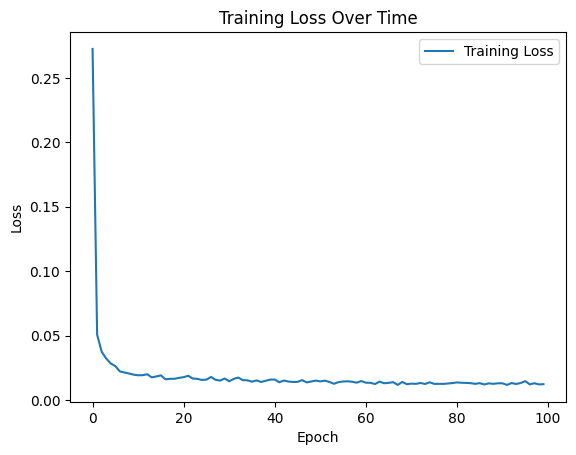

Task Train RMSE: 8.576945304870605, Train R2: 0.9998503404159726, Train MAE: 8.031695365905762
Task Test RMSE: 10.207033157348633, Test R2: 0.9996763786650874, Test MAE: 8.77434253692627
Task Train RMSE: 9.136808395385742, Train R2: 0.9998458692486255, Train MAE: 8.447123527526855
Task Test RMSE: 8.032072067260742, Test R2: 0.9953648522685995, Test MAE: 7.112630367279053
Task Train RMSE: 8.851710319519043, Train R2: 0.9998120889153188, Train MAE: 7.9868316650390625
Task Test RMSE: 9.221062660217285, Test R2: 0.9998825538933637, Test MAE: 8.953776359558105
Task Train RMSE: 8.811161994934082, Train R2: 0.9998465109787623, Train MAE: 8.039375305175781
Task Test RMSE: 9.37512493133545, Test R2: 0.9998107754975557, Test MAE: 8.743621826171875
Task Train RMSE: 9.241464614868164, Train R2: 0.9998294969602991, Train MAE: 8.396098136901855
Task Test RMSE: 7.537982940673828, Test R2: 0.9998751406394645, Test MAE: 7.3167724609375
Task Train RMSE: 10.065978050231934, Train R2: 0.9998089127113526, 

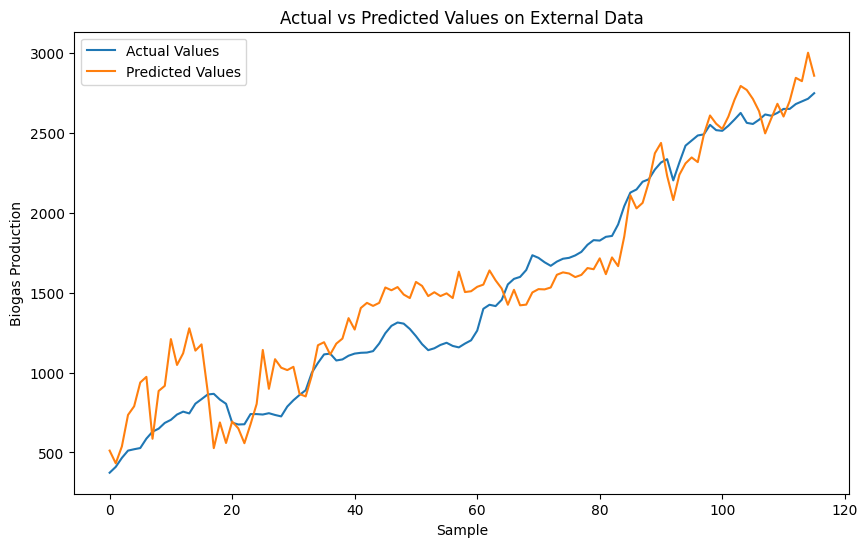

External Dataset - RMSE: 214.19540405273438, R2: 0.9073058413455193, MAE: 178.28550720214844


In [14]:
import torch
from torch import nn, optim
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split, KFold
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from skopt import gp_minimize
from skopt.space import Real, Integer
from skopt.utils import use_named_args
import matplotlib.pyplot as plt
import learn2learn as l2l
import numpy as np
import torch

np.random.seed(0)  # 设置NumPy的随机种子
torch.manual_seed(0)  # 设置PyTorch的随机种子

device = torch.device("cuda:0")  # Use GPU 0

# Hyperparameter search space
search_space = [
    Integer(500, 1500, name='hidden_size'), 
    Real(1e-11, 1e-6, "log-uniform", name='alpha'),  
    Real(1e-7, 1e-3, "log-uniform", name='beta'),
    Real(0.1, 0.8, name='dropout_rate'), 
    Real(1e-7, 1e-1, "log-uniform", name='weight_decay') 
]

# Data normalization and denormalization functions
def normalize_data(data):
    scaler = StandardScaler()
    return scaler.fit_transform(data), scaler

def normalize_feature(data, column_name):
    scaler = StandardScaler()
    scaled_data = scaler.fit_transform(data[[column_name]])
    return scaled_data, scaler

def denormalize_data(normalized_data, scaler):
    return scaler.inverse_transform(normalized_data)

# Advanced neural network architecture
class AdvancedNeuralNetwork(nn.Module):
    def __init__(self, input_size, hidden_size, dropout_rate):
        super(AdvancedNeuralNetwork, self).__init__()
        self.layer1 = nn.Linear(input_size, hidden_size)
        self.relu1 = nn.LeakyReLU()
        self.layer2 = nn.Linear(hidden_size, hidden_size // 2)
        self.relu2 = nn.LeakyReLU()
        self.layer3 = nn.Linear(hidden_size // 2, hidden_size // 4)
        self.relu3 = nn.LeakyReLU()
        self.dropout = nn.Dropout(dropout_rate)
        self.layer4 = nn.Linear(hidden_size // 4, 1)

    def forward(self, x):
        x = self.relu1(self.layer1(x))
        x = self.relu2(self.layer2(x))
        x = self.relu3(self.layer3(x))
        x = self.dropout(x)
        x = self.layer4(x)
        return x

# Task creation function
def create_tasks(data, target_column, num_tasks=50, task_size=30):
    tasks = []
    for _ in range(num_tasks):
        task_data = data.sample(task_size)
        X, y = task_data.drop(target_column, axis=1), task_data[target_column]
        tasks.append((X, y))
    return tasks

# Early stopping class
class EarlyStopping:
    def __init__(self, patience=5, delta=0):
        self.patience = patience
        self.counter = 0
        self.best_score = None
        self.early_stop = False
        self.delta = delta

    def __call__(self, val_loss, model):
        score = -val_loss
        if self.best_score is None:
            self.best_score = score
        elif score < self.best_score + self.delta:
            self.counter += 1
            if self.counter >= self.patience:
                self.early_stop = True
        else:
            self.best_score = score
            self.counter = 0

# MAML fast adaptation and meta-training
def meta_train_maml(model, tasks, alpha, beta, weight_decay, epochs=100, num_steps=1):
    early_stopping = EarlyStopping(patience=10, delta=0.01)
    optimizer = optim.Adam(model.parameters(), lr=beta, weight_decay=weight_decay)
    scheduler = optim.lr_scheduler.CosineAnnealingLR(optimizer, T_max=epochs)

    epoch_loss_list = []  # Initialize a list to store losses for each epoch

    for epoch in range(epochs):
        epoch_losses = []
        for task in tasks:
            learner = model.clone()  # Clone the model
            task_X, task_y = task
            task_X = torch.from_numpy(task_X.values).float().to(device)
            task_y = torch.from_numpy(task_y.values).float().to(device)

            # Fast adaptation
            for step in range(num_steps):
                pred_y = learner(task_X)
                loss = nn.functional.mse_loss(pred_y.squeeze(), task_y)
                learner.adapt(loss)

            # Meta-update
            optimizer.zero_grad()
            pred_y = learner(task_X)
            loss = nn.functional.mse_loss(pred_y.squeeze(), task_y)
            epoch_losses.append(loss.item())
            loss.backward()
            optimizer.step()

        scheduler.step()  # Update learning rate
        average_loss = np.mean(epoch_losses)
        epoch_loss_list.append(average_loss)  # Add each epoch's average loss to the list

        if early_stopping(average_loss, model):
            print(f"Early stopping triggered at epoch {epoch}")
            break

    return epoch_loss_list  # Return the list of epoch losses



@use_named_args(search_space)
def objective(hidden_size, alpha, beta, dropout_rate, weight_decay):
    model = AdvancedNeuralNetwork(input_size, hidden_size, dropout_rate)
    model = l2l.algorithms.MAML(model, lr=alpha).to(device)
    avg_r2 = 0

    task_r2_list = []  # 记录每个任务的 R2

    for task in tasks:
        task_X, task_y = task
        task_X_train, task_X_test, task_y_train, task_y_test = train_test_split(task_X, task_y, test_size=0.2, random_state=0)
        meta_train_maml(model, [(task_X_train, task_y_train)], alpha, beta, weight_decay, epochs=100)
        train_rmse, train_r2, train_mae, test_rmse, test_r2, test_mae = evaluate_model(model, task_X_train, task_y_train, task_X_test, task_y_test, target_scaler)
        task_r2_list.append(test_r2)  # 记录每个任务的测试 R2
        avg_r2 += test_r2

    avg_r2 /= len(tasks)
    return -avg_r2  # 这里返回负数因为 skopt 的目标函数是最小化，而我们想要最大化 R2

# Evaluation function
def evaluate_model(model, X_train, y_train, X_test, y_test, target_scaler):
    model.eval()
    with torch.no_grad():
        # Convert data to tensors
        X_train_tensor = torch.from_numpy(X_train.values).float().to(device)
        y_train_tensor = torch.from_numpy(y_train.values).float().to(device)
        X_test_tensor = torch.from_numpy(X_test.values).float().to(device)
        y_test_tensor = torch.from_numpy(y_test.values).float().to(device)

        # Get predictions
        train_predictions = model(X_train_tensor).squeeze().cpu().numpy()
        test_predictions = model(X_test_tensor).squeeze().cpu().numpy()

        # Reshape predictions for denormalization
        train_predictions_reshaped = train_predictions.reshape(-1, 1)
        test_predictions_reshaped = test_predictions.reshape(-1, 1)

        # Denormalize predictions using target_scaler
        train_predictions_denorm = denormalize_data(train_predictions_reshaped, target_scaler)
        test_predictions_denorm = denormalize_data(test_predictions_reshaped, target_scaler)

        # Denormalize actual values using target_scaler
        y_train_denorm = denormalize_data(y_train_tensor.cpu().numpy().reshape(-1, 1), target_scaler)
        y_test_denorm = denormalize_data(y_test_tensor.cpu().numpy().reshape(-1, 1), target_scaler)

        # Calculate metrics using denormalized data
        train_rmse = mean_squared_error(y_train_denorm, train_predictions_denorm, squared=False)
        train_r2 = r2_score(y_train_denorm, train_predictions_denorm)
        train_mae = mean_absolute_error(y_train_denorm, train_predictions_denorm)

        test_rmse = mean_squared_error(y_test_denorm, test_predictions_denorm, squared=False)
        test_r2 = r2_score(y_test_denorm, test_predictions_denorm)
        test_mae = mean_absolute_error(y_test_denorm, test_predictions_denorm)

    return train_rmse, train_r2, train_mae, test_rmse, test_r2, test_mae

# Load and normalize data
data = pd.read_csv("C:\\Users\\Lenovo\\Desktop\\元学习\\BT(3)1-1.csv")
data_normalized, scaler = normalize_data(data)
target_normalized, target_scaler = normalize_feature(data, 'Biogas Production')
# Create tasks using the normalized dataset
input_size = data.shape[1] - 1 
tasks = create_tasks(pd.DataFrame(data_normalized, columns=data.columns), target_column='Biogas Production')

# Execute hyperparameter optimization
result = gp_minimize(objective, search_space, n_calls=15,random_state=0)
hidden_size, alpha, beta, dropout_rate, weight_decay = result.x
print("Best parameters:", result.x)

# Train model with optimized hyperparameters
model = AdvancedNeuralNetwork(input_size, hidden_size, dropout_rate)
model = l2l.algorithms.MAML(model, lr=alpha).to(device)
train_losses = meta_train_maml(model, tasks, alpha, beta, weight_decay, epochs=100)

# Visualize training losses
plt.plot(train_losses, label='Training Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training Loss Over Time')
plt.legend()
plt.show()

# Final model evaluation
for task in tasks:
    X, y = task
    kf = KFold(n_splits=5, shuffle=True, random_state=0)
    for train_index, test_index in kf.split(X):
        X_train, X_test = X.iloc[train_index], X.iloc[test_index]
        y_train, y_test = y.iloc[train_index], y.iloc[test_index]
        train_rmse, train_r2, train_mae, test_rmse, test_r2, test_mae = evaluate_model(model, X_train, y_train, X_test, y_test, target_scaler)
        print(f"Task Train RMSE: {train_rmse}, Train R2: {train_r2}, Train MAE: {train_mae}")
        print(f"Task Test RMSE: {test_rmse}, Test R2: {test_r2}, Test MAE: {test_mae}")


# Load and process external data for evaluation
external_data = pd.read_csv("C:\\Users\\Lenovo\\Desktop\\元学习\\BT(3)1-2.csv")
external_data_normalized, _ = normalize_data(external_data)
external_target_normalized, _ = normalize_feature(external_data, 'Biogas Production')
external_X = torch.from_numpy(pd.DataFrame(external_data_normalized, columns=external_data.columns).drop('Biogas Production', axis=1).values).float().to(device)
external_y_normalized = torch.from_numpy(external_target_normalized).float().to(device)

# Model prediction on external data
learner = model.clone()  # Clone the model for evaluation
learner.eval()
with torch.no_grad():
    external_predictions_normalized = learner(external_X).squeeze()
external_predictions = denormalize_data(external_predictions_normalized.cpu().numpy().reshape(-1, 1), target_scaler)
external_y = denormalize_data(external_y_normalized.cpu().numpy().reshape(-1, 1), target_scaler)

# Visualization of predictions on external data
plt.figure(figsize=(10, 6))
plt.plot(external_y, label='Actual Values')
plt.plot(external_predictions, label='Predicted Values')
plt.xlabel('Sample')
plt.ylabel('Biogas Production')
plt.title('Actual vs Predicted Values on External Data')
plt.legend()
plt.show()

# Evaluate on external dataset using denormalized data
external_rmse = mean_squared_error(external_y, external_predictions, squared=False)
external_r2 = r2_score(external_y, external_predictions)
external_mae = mean_absolute_error(external_y, external_predictions)

print(f"External Dataset - RMSE: {external_rmse}, R2: {external_r2}, MAE: {external_mae}")

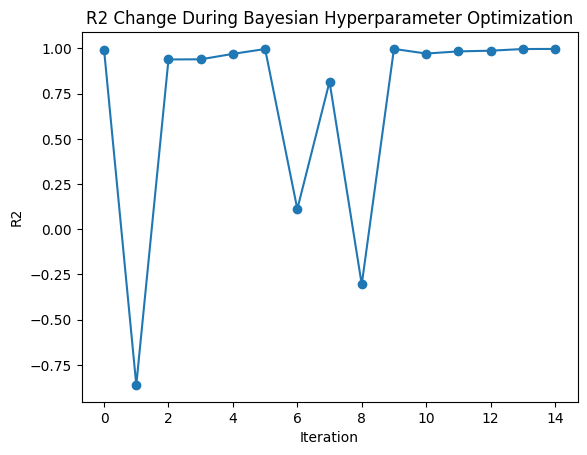

Original Dataset - RMSE: 9.601167807620369, R2: 0.9998137568979478, MAE: 8.198542092063208
External Dataset - RMSE: 214.19540405273438, R2: 0.9073058413455193, MAE: 178.28550720214844


In [15]:
# 提取每次迭代的最佳 R2
best_r2_list = []
for res in result.func_vals:
    best_r2_list.append(-res)  # 注意要取负数

# 绘制 R2 的变化过程图
plt.plot(best_r2_list, marker='o')
plt.xlabel('Iteration')
plt.ylabel('R2')
plt.title('R2 Change During Bayesian Hyperparameter Optimization')
plt.show()

import torch
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from sklearn.model_selection import train_test_split

target_column = 'Biogas Production'

# 分离特征和目标变量
X = data.drop(target_column, axis=1)
y = data[target_column]
X_external = external_data.drop(target_column, axis=1)
y_external = external_data[target_column]

# 标准化数据
X_normalized, feature_scaler = normalize_data(X)
y_normalized, target_scaler = normalize_data(y.values.reshape(-1, 1))

# 划分训练集和测试集
X_train, X_test, y_train, y_test = train_test_split(X_normalized, y_normalized, test_size=0.2, random_state=0)

# 转换为 PyTorch 张量
X_train_tensor = torch.from_numpy(X_train).float().to(device)
X_test_tensor = torch.from_numpy(X_test).float().to(device)
y_train_tensor = torch.from_numpy(y_train).float().to(device)
y_test_tensor = torch.from_numpy(y_test).float().to(device)

# 标准化外部数据集
X_external_normalized, _ = normalize_data(X_external)
y_external_normalized, _ = normalize_data(y_external.values.reshape(-1, 1))

# 转换外部数据为张量
X_external_tensor = torch.from_numpy(X_external_normalized).float().to(device)
y_external_tensor = torch.from_numpy(y_external_normalized).float().to(device)

# 模型预测函数
def model_predict(model, X_tensor):
    model.eval()
    with torch.no_grad():
        return model(X_tensor).cpu().numpy()

# 获取预测值
y_pred_train = model_predict(model, X_train_tensor).flatten()
y_pred_test = model_predict(model, X_test_tensor).flatten()
y_pred_external = model_predict(model, X_external_tensor).flatten()

# 反标准化预测值和实际值
y_pred_train_denorm = denormalize_data(y_pred_train.reshape(-1, 1), target_scaler).flatten()
y_pred_test_denorm = denormalize_data(y_pred_test.reshape(-1, 1), target_scaler).flatten()
y_pred_external_denorm = denormalize_data(y_pred_external.reshape(-1, 1), target_scaler).flatten()
y_train_denorm = denormalize_data(y_train, target_scaler).flatten()
y_test_denorm = denormalize_data(y_test, target_scaler).flatten()
y_external_denorm = denormalize_data(y_external_tensor.cpu().numpy(), target_scaler).flatten()


# 合并原始数据集和外部数据集的预测值和实际值
original_data_actual = np.concatenate([y_train_denorm, y_test_denorm])
original_data_predicted = np.concatenate([y_pred_train_denorm, y_pred_test_denorm])
external_data_actual = y_external_denorm
external_data_predicted = y_pred_external_denorm

# 创建 DataFrame
combined_df = pd.DataFrame({
    'Actual': np.concatenate([original_data_actual, external_data_actual]),
    'Predicted': np.concatenate([original_data_predicted, external_data_predicted]),
    'Dataset': ['Original'] * len(original_data_actual) + ['External'] * len(external_data_actual)
})

# 计算原始数据集的指标
train_r2 = r2_score(original_data_actual, original_data_predicted)
train_rmse = mean_squared_error(original_data_actual, original_data_predicted, squared=False)
train_mae = mean_absolute_error(original_data_actual, original_data_predicted)

# 计算外部数据集的指标
external_r2 = r2_score(external_data_actual, external_data_predicted)
external_rmse = mean_squared_error(external_data_actual, external_data_predicted, squared=False)
external_mae = mean_absolute_error(external_data_actual, external_data_predicted)


print(f"Original Dataset - RMSE: {train_rmse}, R2: {train_r2}, MAE: {train_mae}")
print(f"External Dataset - RMSE: {external_rmse}, R2: {external_r2}, MAE: {external_mae}")

Best parameters: [1213, 1.3920164092992034e-08, 0.00010959831882975573, 0.1185233174478015, 0.00013806897412597035]


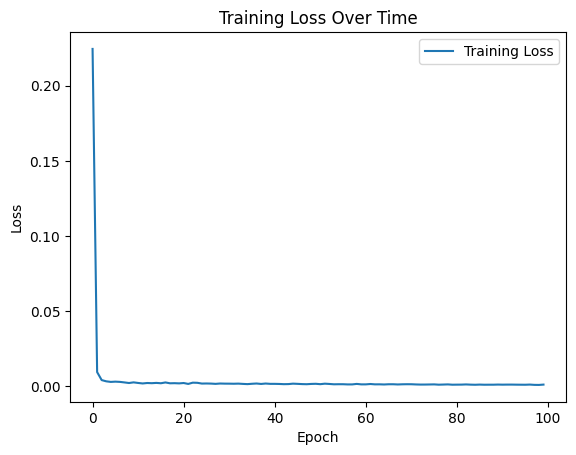

Task Train RMSE: 0.19539567828178406, Train R2: 0.999996779576507, Train MAE: 0.14391326904296875
Task Test RMSE: 0.13046886026859283, Test R2: 0.999997381061148, Test MAE: 0.0978139266371727
Task Train RMSE: 0.1362360268831253, Train R2: 0.9999974357242726, Train MAE: 0.10983657836914062
Task Test RMSE: 0.30903390049934387, Test R2: 0.9999963570809169, Test MAE: 0.2341257780790329
Task Train RMSE: 0.19683678448200226, Train R2: 0.999996975306805, Train MAE: 0.1414082795381546
Task Test RMSE: 0.12150287628173828, Test R2: 0.9999961818078087, Test MAE: 0.1078440323472023
Task Train RMSE: 0.19634640216827393, Train R2: 0.9999966654635474, Train MAE: 0.14099502563476562
Task Test RMSE: 0.12462583929300308, Test R2: 0.9999982130772833, Test MAE: 0.1094818115234375
Task Train RMSE: 0.18895405530929565, Train R2: 0.9999969124795215, Train MAE: 0.1373138427734375
Task Test RMSE: 0.1640901118516922, Test R2: 0.9999957661431618, Test MAE: 0.1242167130112648
Task Train RMSE: 0.2548373341560364, 

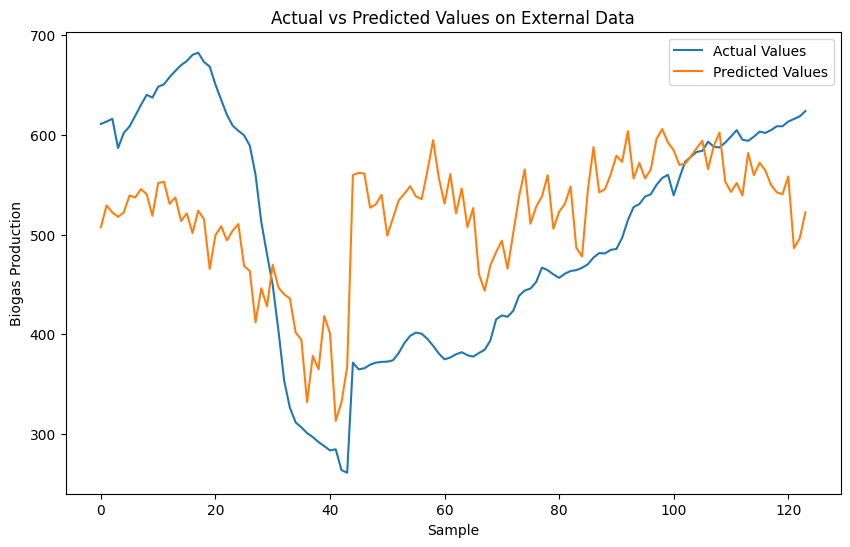

External Dataset - RMSE: 104.60480499267578, R2: 0.1904483705421286, MAE: 91.24836730957031


In [16]:
import torch
from torch import nn, optim
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split, KFold
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from skopt import gp_minimize
from skopt.space import Real, Integer
from skopt.utils import use_named_args
import matplotlib.pyplot as plt
import learn2learn as l2l
import numpy as np
import torch

np.random.seed(0)  # 设置NumPy的随机种子
torch.manual_seed(0)  # 设置PyTorch的随机种子

device = torch.device("cuda:0")  # Use GPU 0

# Hyperparameter search space
search_space = [
    Integer(500, 1500, name='hidden_size'), 
    Real(1e-11, 1e-6, "log-uniform", name='alpha'),  
    Real(1e-7, 1e-3, "log-uniform", name='beta'),
    Real(0.1, 0.8, name='dropout_rate'), 
    Real(1e-7, 1e-1, "log-uniform", name='weight_decay') 
]

# Data normalization and denormalization functions
def normalize_data(data):
    scaler = StandardScaler()
    return scaler.fit_transform(data), scaler

def normalize_feature(data, column_name):
    scaler = StandardScaler()
    scaled_data = scaler.fit_transform(data[[column_name]])
    return scaled_data, scaler

def denormalize_data(normalized_data, scaler):
    return scaler.inverse_transform(normalized_data)

# Advanced neural network architecture
class AdvancedNeuralNetwork(nn.Module):
    def __init__(self, input_size, hidden_size, dropout_rate):
        super(AdvancedNeuralNetwork, self).__init__()
        self.layer1 = nn.Linear(input_size, hidden_size)
        self.relu1 = nn.LeakyReLU()
        self.layer2 = nn.Linear(hidden_size, hidden_size // 2)
        self.relu2 = nn.LeakyReLU()
        self.layer3 = nn.Linear(hidden_size // 2, hidden_size // 4)
        self.relu3 = nn.LeakyReLU()
        self.dropout = nn.Dropout(dropout_rate)
        self.layer4 = nn.Linear(hidden_size // 4, 1)

    def forward(self, x):
        x = self.relu1(self.layer1(x))
        x = self.relu2(self.layer2(x))
        x = self.relu3(self.layer3(x))
        x = self.dropout(x)
        x = self.layer4(x)
        return x

# Task creation function
def create_tasks(data, target_column, num_tasks=50, task_size=30):
    tasks = []
    for _ in range(num_tasks):
        task_data = data.sample(task_size)
        X, y = task_data.drop(target_column, axis=1), task_data[target_column]
        tasks.append((X, y))
    return tasks

# Early stopping class
class EarlyStopping:
    def __init__(self, patience=5, delta=0):
        self.patience = patience
        self.counter = 0
        self.best_score = None
        self.early_stop = False
        self.delta = delta

    def __call__(self, val_loss, model):
        score = -val_loss
        if self.best_score is None:
            self.best_score = score
        elif score < self.best_score + self.delta:
            self.counter += 1
            if self.counter >= self.patience:
                self.early_stop = True
        else:
            self.best_score = score
            self.counter = 0

# MAML fast adaptation and meta-training
def meta_train_maml(model, tasks, alpha, beta, weight_decay, epochs=100, num_steps=1):
    early_stopping = EarlyStopping(patience=10, delta=0.01)
    optimizer = optim.Adam(model.parameters(), lr=beta, weight_decay=weight_decay)
    scheduler = optim.lr_scheduler.CosineAnnealingLR(optimizer, T_max=epochs)

    epoch_loss_list = []  # Initialize a list to store losses for each epoch

    for epoch in range(epochs):
        epoch_losses = []
        for task in tasks:
            learner = model.clone()  # Clone the model
            task_X, task_y = task
            task_X = torch.from_numpy(task_X.values).float().to(device)
            task_y = torch.from_numpy(task_y.values).float().to(device)

            # Fast adaptation
            for step in range(num_steps):
                pred_y = learner(task_X)
                loss = nn.functional.mse_loss(pred_y.squeeze(), task_y)
                learner.adapt(loss)

            # Meta-update
            optimizer.zero_grad()
            pred_y = learner(task_X)
            loss = nn.functional.mse_loss(pred_y.squeeze(), task_y)
            epoch_losses.append(loss.item())
            loss.backward()
            optimizer.step()

        scheduler.step()  # Update learning rate
        average_loss = np.mean(epoch_losses)
        epoch_loss_list.append(average_loss)  # Add each epoch's average loss to the list

        if early_stopping(average_loss, model):
            print(f"Early stopping triggered at epoch {epoch}")
            break

    return epoch_loss_list  # Return the list of epoch losses



@use_named_args(search_space)
def objective(hidden_size, alpha, beta, dropout_rate, weight_decay):
    model = AdvancedNeuralNetwork(input_size, hidden_size, dropout_rate)
    model = l2l.algorithms.MAML(model, lr=alpha).to(device)
    avg_r2 = 0

    task_r2_list = []  # 记录每个任务的 R2

    for task in tasks:
        task_X, task_y = task
        task_X_train, task_X_test, task_y_train, task_y_test = train_test_split(task_X, task_y, test_size=0.2, random_state=0)
        meta_train_maml(model, [(task_X_train, task_y_train)], alpha, beta, weight_decay, epochs=100)
        train_rmse, train_r2, train_mae, test_rmse, test_r2, test_mae = evaluate_model(model, task_X_train, task_y_train, task_X_test, task_y_test, target_scaler)
        task_r2_list.append(test_r2)  # 记录每个任务的测试 R2
        avg_r2 += test_r2

    avg_r2 /= len(tasks)
    return -avg_r2  # 这里返回负数因为 skopt 的目标函数是最小化，而我们想要最大化 R2


# Evaluation function
def evaluate_model(model, X_train, y_train, X_test, y_test, target_scaler):
    model.eval()
    with torch.no_grad():
        # Convert data to tensors
        X_train_tensor = torch.from_numpy(X_train.values).float().to(device)
        y_train_tensor = torch.from_numpy(y_train.values).float().to(device)
        X_test_tensor = torch.from_numpy(X_test.values).float().to(device)
        y_test_tensor = torch.from_numpy(y_test.values).float().to(device)

        # Get predictions
        train_predictions = model(X_train_tensor).squeeze().cpu().numpy()
        test_predictions = model(X_test_tensor).squeeze().cpu().numpy()

        # Reshape predictions for denormalization
        train_predictions_reshaped = train_predictions.reshape(-1, 1)
        test_predictions_reshaped = test_predictions.reshape(-1, 1)

        # Denormalize predictions using target_scaler
        train_predictions_denorm = denormalize_data(train_predictions_reshaped, target_scaler)
        test_predictions_denorm = denormalize_data(test_predictions_reshaped, target_scaler)

        # Denormalize actual values using target_scaler
        y_train_denorm = denormalize_data(y_train_tensor.cpu().numpy().reshape(-1, 1), target_scaler)
        y_test_denorm = denormalize_data(y_test_tensor.cpu().numpy().reshape(-1, 1), target_scaler)

        # Calculate metrics using denormalized data
        train_rmse = mean_squared_error(y_train_denorm, train_predictions_denorm, squared=False)
        train_r2 = r2_score(y_train_denorm, train_predictions_denorm)
        train_mae = mean_absolute_error(y_train_denorm, train_predictions_denorm)

        test_rmse = mean_squared_error(y_test_denorm, test_predictions_denorm, squared=False)
        test_r2 = r2_score(y_test_denorm, test_predictions_denorm)
        test_mae = mean_absolute_error(y_test_denorm, test_predictions_denorm)

    return train_rmse, train_r2, train_mae, test_rmse, test_r2, test_mae

# Load and normalize data
data = pd.read_csv("C:\\Users\\Lenovo\\Desktop\\元学习\\BT(3)2-1.csv")
data_normalized, scaler = normalize_data(data)
target_normalized, target_scaler = normalize_feature(data, 'Biogas Production')
# Create tasks using the normalized dataset
input_size = data.shape[1] - 1 
tasks = create_tasks(pd.DataFrame(data_normalized, columns=data.columns), target_column='Biogas Production')

# Execute hyperparameter optimization
result = gp_minimize(objective, search_space, n_calls=15,random_state=0)
hidden_size, alpha, beta, dropout_rate, weight_decay = result.x
print("Best parameters:", result.x)

# Train model with optimized hyperparameters
model = AdvancedNeuralNetwork(input_size, hidden_size, dropout_rate)
model = l2l.algorithms.MAML(model, lr=alpha).to(device)
train_losses = meta_train_maml(model, tasks, alpha, beta, weight_decay, epochs=100)

# Visualize training losses
plt.plot(train_losses, label='Training Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training Loss Over Time')
plt.legend()
plt.show()

# Final model evaluation
for task in tasks:
    X, y = task
    kf = KFold(n_splits=5, shuffle=True, random_state=0)
    for train_index, test_index in kf.split(X):
        X_train, X_test = X.iloc[train_index], X.iloc[test_index]
        y_train, y_test = y.iloc[train_index], y.iloc[test_index]
        train_rmse, train_r2, train_mae, test_rmse, test_r2, test_mae = evaluate_model(model, X_train, y_train, X_test, y_test, target_scaler)
        print(f"Task Train RMSE: {train_rmse}, Train R2: {train_r2}, Train MAE: {train_mae}")
        print(f"Task Test RMSE: {test_rmse}, Test R2: {test_r2}, Test MAE: {test_mae}")


# Load and process external data for evaluation
external_data = pd.read_csv("C:\\Users\\Lenovo\\Desktop\\元学习\\BT(3)2-2.csv")
external_data_normalized, _ = normalize_data(external_data)
external_target_normalized, _ = normalize_feature(external_data, 'Biogas Production')
external_X = torch.from_numpy(pd.DataFrame(external_data_normalized, columns=external_data.columns).drop('Biogas Production', axis=1).values).float().to(device)
external_y_normalized = torch.from_numpy(external_target_normalized).float().to(device)

# Model prediction on external data
learner = model.clone()  # Clone the model for evaluation
learner.eval()
with torch.no_grad():
    external_predictions_normalized = learner(external_X).squeeze()
external_predictions = denormalize_data(external_predictions_normalized.cpu().numpy().reshape(-1, 1), target_scaler)
external_y = denormalize_data(external_y_normalized.cpu().numpy().reshape(-1, 1), target_scaler)

# Visualization of predictions on external data
plt.figure(figsize=(10, 6))
plt.plot(external_y, label='Actual Values')
plt.plot(external_predictions, label='Predicted Values')
plt.xlabel('Sample')
plt.ylabel('Biogas Production')
plt.title('Actual vs Predicted Values on External Data')
plt.legend()
plt.show()

# Evaluate on external dataset using denormalized data
external_rmse = mean_squared_error(external_y, external_predictions, squared=False)
external_r2 = r2_score(external_y, external_predictions)
external_mae = mean_absolute_error(external_y, external_predictions)

print(f"External Dataset - RMSE: {external_rmse}, R2: {external_r2}, MAE: {external_mae}")

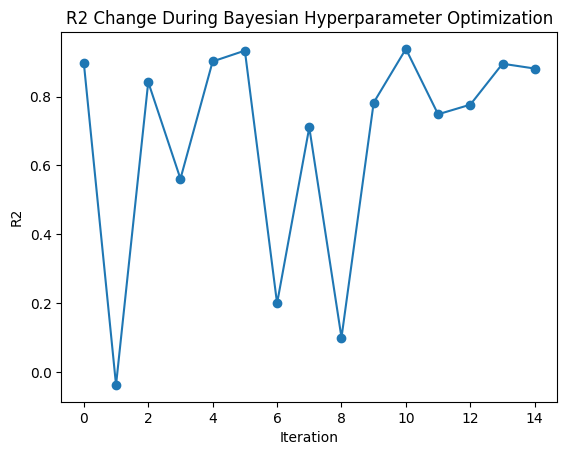

Original Dataset - RMSE: 0.22212334209148146, R2: 0.9999963496907738, MAE: 0.16287594265407457
External Dataset - RMSE: 104.60480499267578, R2: 0.1904483705421286, MAE: 91.24836730957031


In [17]:
# 提取每次迭代的最佳 R2
best_r2_list = []
for res in result.func_vals:
    best_r2_list.append(-res)  # 注意要取负数

# 绘制 R2 的变化过程图
plt.plot(best_r2_list, marker='o')
plt.xlabel('Iteration')
plt.ylabel('R2')
plt.title('R2 Change During Bayesian Hyperparameter Optimization')
plt.show()

import torch
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from sklearn.model_selection import train_test_split

target_column = 'Biogas Production'

# 分离特征和目标变量
X = data.drop(target_column, axis=1)
y = data[target_column]
X_external = external_data.drop(target_column, axis=1)
y_external = external_data[target_column]

# 标准化数据
X_normalized, feature_scaler = normalize_data(X)
y_normalized, target_scaler = normalize_data(y.values.reshape(-1, 1))

# 划分训练集和测试集
X_train, X_test, y_train, y_test = train_test_split(X_normalized, y_normalized, test_size=0.2, random_state=0)

# 转换为 PyTorch 张量
X_train_tensor = torch.from_numpy(X_train).float().to(device)
X_test_tensor = torch.from_numpy(X_test).float().to(device)
y_train_tensor = torch.from_numpy(y_train).float().to(device)
y_test_tensor = torch.from_numpy(y_test).float().to(device)

# 标准化外部数据集
X_external_normalized, _ = normalize_data(X_external)
y_external_normalized, _ = normalize_data(y_external.values.reshape(-1, 1))

# 转换外部数据为张量
X_external_tensor = torch.from_numpy(X_external_normalized).float().to(device)
y_external_tensor = torch.from_numpy(y_external_normalized).float().to(device)

# 模型预测函数
def model_predict(model, X_tensor):
    model.eval()
    with torch.no_grad():
        return model(X_tensor).cpu().numpy()

# 获取预测值
y_pred_train = model_predict(model, X_train_tensor).flatten()
y_pred_test = model_predict(model, X_test_tensor).flatten()
y_pred_external = model_predict(model, X_external_tensor).flatten()

# 反标准化预测值和实际值
y_pred_train_denorm = denormalize_data(y_pred_train.reshape(-1, 1), target_scaler).flatten()
y_pred_test_denorm = denormalize_data(y_pred_test.reshape(-1, 1), target_scaler).flatten()
y_pred_external_denorm = denormalize_data(y_pred_external.reshape(-1, 1), target_scaler).flatten()
y_train_denorm = denormalize_data(y_train, target_scaler).flatten()
y_test_denorm = denormalize_data(y_test, target_scaler).flatten()
y_external_denorm = denormalize_data(y_external_tensor.cpu().numpy(), target_scaler).flatten()


# 合并原始数据集和外部数据集的预测值和实际值
original_data_actual = np.concatenate([y_train_denorm, y_test_denorm])
original_data_predicted = np.concatenate([y_pred_train_denorm, y_pred_test_denorm])
external_data_actual = y_external_denorm
external_data_predicted = y_pred_external_denorm

# 创建 DataFrame
combined_df = pd.DataFrame({
    'Actual': np.concatenate([original_data_actual, external_data_actual]),
    'Predicted': np.concatenate([original_data_predicted, external_data_predicted]),
    'Dataset': ['Original'] * len(original_data_actual) + ['External'] * len(external_data_actual)
})

# 计算原始数据集的指标
train_r2 = r2_score(original_data_actual, original_data_predicted)
train_rmse = mean_squared_error(original_data_actual, original_data_predicted, squared=False)
train_mae = mean_absolute_error(original_data_actual, original_data_predicted)

# 计算外部数据集的指标
external_r2 = r2_score(external_data_actual, external_data_predicted)
external_rmse = mean_squared_error(external_data_actual, external_data_predicted, squared=False)
external_mae = mean_absolute_error(external_data_actual, external_data_predicted)


print(f"Original Dataset - RMSE: {train_rmse}, R2: {train_r2}, MAE: {train_mae}")
print(f"External Dataset - RMSE: {external_rmse}, R2: {external_r2}, MAE: {external_mae}")

Best parameters: [1188, 1.4177433604785544e-08, 0.0002333081956507336, 0.8, 1e-07]


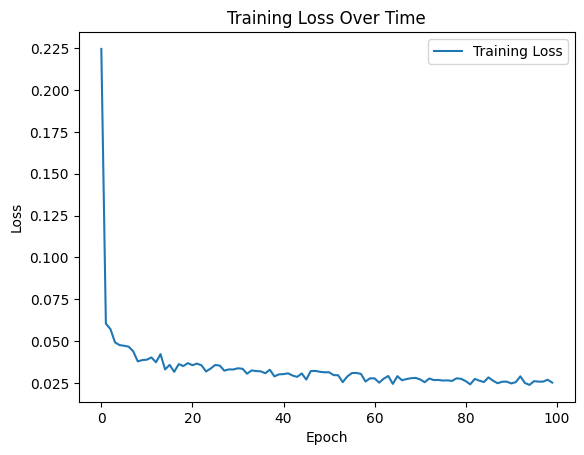

Task Train RMSE: 3.7957284450531006, Train R2: 0.9993097446029856, Train MAE: 3.3527424335479736
Task Test RMSE: 4.271125793457031, Test R2: 0.9992062398015722, Test MAE: 3.3212177753448486
Task Train RMSE: 3.995814085006714, Train R2: 0.9993004201068246, Train MAE: 3.40991473197937
Task Test RMSE: 3.465054512023926, Test R2: 0.9992544885019252, Test MAE: 3.092529296875
Task Train RMSE: 3.8046417236328125, Train R2: 0.9993130733376901, Train MAE: 3.21716570854187
Task Test RMSE: 4.239284515380859, Test R2: 0.9987192387225805, Test MAE: 3.863525390625
Task Train RMSE: 4.106117248535156, Train R2: 0.9992723462901637, Train MAE: 3.5201492309570312
Task Test RMSE: 2.903780698776245, Test R2: 0.9994187804975091, Test MAE: 2.6515910625457764
Task Train RMSE: 3.7633957862854004, Train R2: 0.9992562921647227, Train MAE: 3.2322158813476562
Task Test RMSE: 4.38410758972168, Test R2: 0.9992957027752903, Test MAE: 3.8033447265625
Task Train RMSE: 3.3630855083465576, Train R2: 0.9991941954936562, T

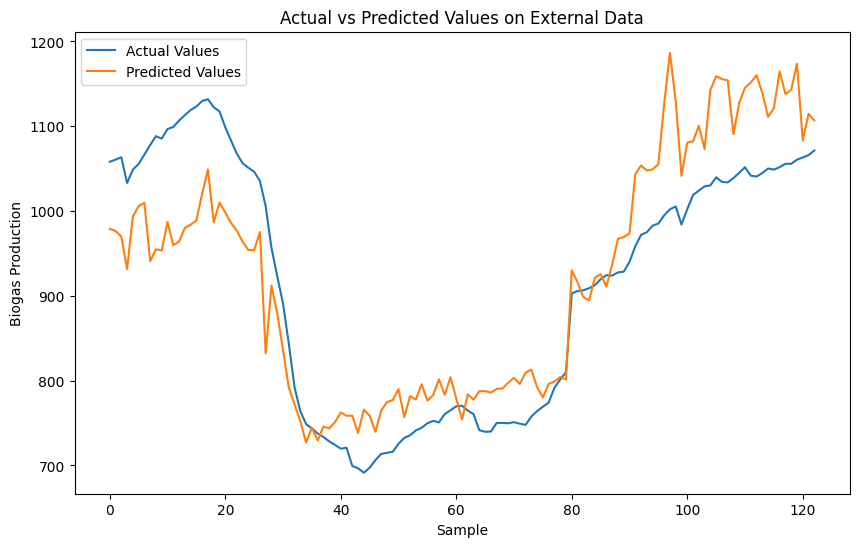

External Dataset - RMSE: 75.82508850097656, R2: 0.733465342612716, MAE: 63.58502197265625


In [18]:
import torch
from torch import nn, optim
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split, KFold
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from skopt import gp_minimize
from skopt.space import Real, Integer
from skopt.utils import use_named_args
import matplotlib.pyplot as plt
import learn2learn as l2l
import numpy as np
import torch

np.random.seed(0)  # 设置NumPy的随机种子
torch.manual_seed(0)  # 设置PyTorch的随机种子

device = torch.device("cuda:0")  # Use GPU 0

# Hyperparameter search space
search_space = [
    Integer(500, 1500, name='hidden_size'), 
    Real(1e-11, 1e-6, "log-uniform", name='alpha'),  
    Real(1e-7, 1e-3, "log-uniform", name='beta'),
    Real(0.1, 0.8, name='dropout_rate'), 
    Real(1e-7, 1e-1, "log-uniform", name='weight_decay') 
]

# Data normalization and denormalization functions
def normalize_data(data):
    scaler = StandardScaler()
    return scaler.fit_transform(data), scaler

def normalize_feature(data, column_name):
    scaler = StandardScaler()
    scaled_data = scaler.fit_transform(data[[column_name]])
    return scaled_data, scaler

def denormalize_data(normalized_data, scaler):
    return scaler.inverse_transform(normalized_data)

# Advanced neural network architecture
class AdvancedNeuralNetwork(nn.Module):
    def __init__(self, input_size, hidden_size, dropout_rate):
        super(AdvancedNeuralNetwork, self).__init__()
        self.layer1 = nn.Linear(input_size, hidden_size)
        self.relu1 = nn.LeakyReLU()
        self.layer2 = nn.Linear(hidden_size, hidden_size // 2)
        self.relu2 = nn.LeakyReLU()
        self.layer3 = nn.Linear(hidden_size // 2, hidden_size // 4)
        self.relu3 = nn.LeakyReLU()
        self.dropout = nn.Dropout(dropout_rate)
        self.layer4 = nn.Linear(hidden_size // 4, 1)

    def forward(self, x):
        x = self.relu1(self.layer1(x))
        x = self.relu2(self.layer2(x))
        x = self.relu3(self.layer3(x))
        x = self.dropout(x)
        x = self.layer4(x)
        return x

# Task creation function
def create_tasks(data, target_column, num_tasks=50, task_size=30):
    tasks = []
    for _ in range(num_tasks):
        task_data = data.sample(task_size)
        X, y = task_data.drop(target_column, axis=1), task_data[target_column]
        tasks.append((X, y))
    return tasks

# Early stopping class
class EarlyStopping:
    def __init__(self, patience=5, delta=0):
        self.patience = patience
        self.counter = 0
        self.best_score = None
        self.early_stop = False
        self.delta = delta

    def __call__(self, val_loss, model):
        score = -val_loss
        if self.best_score is None:
            self.best_score = score
        elif score < self.best_score + self.delta:
            self.counter += 1
            if self.counter >= self.patience:
                self.early_stop = True
        else:
            self.best_score = score
            self.counter = 0

# MAML fast adaptation and meta-training
def meta_train_maml(model, tasks, alpha, beta, weight_decay, epochs=100, num_steps=1):
    early_stopping = EarlyStopping(patience=10, delta=0.01)
    optimizer = optim.Adam(model.parameters(), lr=beta, weight_decay=weight_decay)
    scheduler = optim.lr_scheduler.CosineAnnealingLR(optimizer, T_max=epochs)

    epoch_loss_list = []  # Initialize a list to store losses for each epoch

    for epoch in range(epochs):
        epoch_losses = []
        for task in tasks:
            learner = model.clone()  # Clone the model
            task_X, task_y = task
            task_X = torch.from_numpy(task_X.values).float().to(device)
            task_y = torch.from_numpy(task_y.values).float().to(device)

            # Fast adaptation
            for step in range(num_steps):
                pred_y = learner(task_X)
                loss = nn.functional.mse_loss(pred_y.squeeze(), task_y)
                learner.adapt(loss)

            # Meta-update
            optimizer.zero_grad()
            pred_y = learner(task_X)
            loss = nn.functional.mse_loss(pred_y.squeeze(), task_y)
            epoch_losses.append(loss.item())
            loss.backward()
            optimizer.step()

        scheduler.step()  # Update learning rate
        average_loss = np.mean(epoch_losses)
        epoch_loss_list.append(average_loss)  # Add each epoch's average loss to the list

        if early_stopping(average_loss, model):
            print(f"Early stopping triggered at epoch {epoch}")
            break

    return epoch_loss_list  # Return the list of epoch losses



@use_named_args(search_space)
def objective(hidden_size, alpha, beta, dropout_rate, weight_decay):
    model = AdvancedNeuralNetwork(input_size, hidden_size, dropout_rate)
    model = l2l.algorithms.MAML(model, lr=alpha).to(device)
    avg_r2 = 0

    task_r2_list = []  # 记录每个任务的 R2

    for task in tasks:
        task_X, task_y = task
        task_X_train, task_X_test, task_y_train, task_y_test = train_test_split(task_X, task_y, test_size=0.2, random_state=0)
        meta_train_maml(model, [(task_X_train, task_y_train)], alpha, beta, weight_decay, epochs=100)
        train_rmse, train_r2, train_mae, test_rmse, test_r2, test_mae = evaluate_model(model, task_X_train, task_y_train, task_X_test, task_y_test, target_scaler)
        task_r2_list.append(test_r2)  # 记录每个任务的测试 R2
        avg_r2 += test_r2

    avg_r2 /= len(tasks)
    return -avg_r2  # 这里返回负数因为 skopt 的目标函数是最小化，而我们想要最大化 R2


# Evaluation function
def evaluate_model(model, X_train, y_train, X_test, y_test, target_scaler):
    model.eval()
    with torch.no_grad():
        # Convert data to tensors
        X_train_tensor = torch.from_numpy(X_train.values).float().to(device)
        y_train_tensor = torch.from_numpy(y_train.values).float().to(device)
        X_test_tensor = torch.from_numpy(X_test.values).float().to(device)
        y_test_tensor = torch.from_numpy(y_test.values).float().to(device)

        # Get predictions
        train_predictions = model(X_train_tensor).squeeze().cpu().numpy()
        test_predictions = model(X_test_tensor).squeeze().cpu().numpy()

        # Reshape predictions for denormalization
        train_predictions_reshaped = train_predictions.reshape(-1, 1)
        test_predictions_reshaped = test_predictions.reshape(-1, 1)

        # Denormalize predictions using target_scaler
        train_predictions_denorm = denormalize_data(train_predictions_reshaped, target_scaler)
        test_predictions_denorm = denormalize_data(test_predictions_reshaped, target_scaler)

        # Denormalize actual values using target_scaler
        y_train_denorm = denormalize_data(y_train_tensor.cpu().numpy().reshape(-1, 1), target_scaler)
        y_test_denorm = denormalize_data(y_test_tensor.cpu().numpy().reshape(-1, 1), target_scaler)

        # Calculate metrics using denormalized data
        train_rmse = mean_squared_error(y_train_denorm, train_predictions_denorm, squared=False)
        train_r2 = r2_score(y_train_denorm, train_predictions_denorm)
        train_mae = mean_absolute_error(y_train_denorm, train_predictions_denorm)

        test_rmse = mean_squared_error(y_test_denorm, test_predictions_denorm, squared=False)
        test_r2 = r2_score(y_test_denorm, test_predictions_denorm)
        test_mae = mean_absolute_error(y_test_denorm, test_predictions_denorm)

    return train_rmse, train_r2, train_mae, test_rmse, test_r2, test_mae

# Load and normalize data
data = pd.read_csv("C:\\Users\\Lenovo\\Desktop\\元学习\\BT(3)3-1.csv")
data_normalized, scaler = normalize_data(data)
target_normalized, target_scaler = normalize_feature(data, 'Biogas Production')
# Create tasks using the normalized dataset
input_size = data.shape[1] - 1 
tasks = create_tasks(pd.DataFrame(data_normalized, columns=data.columns), target_column='Biogas Production')

# Execute hyperparameter optimization
result = gp_minimize(objective, search_space, n_calls=15,random_state=0)
hidden_size, alpha, beta, dropout_rate, weight_decay = result.x
print("Best parameters:", result.x)

# Train model with optimized hyperparameters
model = AdvancedNeuralNetwork(input_size, hidden_size, dropout_rate)
model = l2l.algorithms.MAML(model, lr=alpha).to(device)
train_losses = meta_train_maml(model, tasks, alpha, beta, weight_decay, epochs=100)

# Visualize training losses
plt.plot(train_losses, label='Training Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training Loss Over Time')
plt.legend()
plt.show()

# Final model evaluation
for task in tasks:
    X, y = task
    kf = KFold(n_splits=5, shuffle=True, random_state=0)
    for train_index, test_index in kf.split(X):
        X_train, X_test = X.iloc[train_index], X.iloc[test_index]
        y_train, y_test = y.iloc[train_index], y.iloc[test_index]
        train_rmse, train_r2, train_mae, test_rmse, test_r2, test_mae = evaluate_model(model, X_train, y_train, X_test, y_test, target_scaler)
        print(f"Task Train RMSE: {train_rmse}, Train R2: {train_r2}, Train MAE: {train_mae}")
        print(f"Task Test RMSE: {test_rmse}, Test R2: {test_r2}, Test MAE: {test_mae}")


# Load and process external data for evaluation
external_data = pd.read_csv("C:\\Users\\Lenovo\\Desktop\\元学习\\BT(3)3-2.csv")
external_data_normalized, _ = normalize_data(external_data)
external_target_normalized, _ = normalize_feature(external_data, 'Biogas Production')
external_X = torch.from_numpy(pd.DataFrame(external_data_normalized, columns=external_data.columns).drop('Biogas Production', axis=1).values).float().to(device)
external_y_normalized = torch.from_numpy(external_target_normalized).float().to(device)

# Model prediction on external data
learner = model.clone()  # Clone the model for evaluation
learner.eval()
with torch.no_grad():
    external_predictions_normalized = learner(external_X).squeeze()
external_predictions = denormalize_data(external_predictions_normalized.cpu().numpy().reshape(-1, 1), target_scaler)
external_y = denormalize_data(external_y_normalized.cpu().numpy().reshape(-1, 1), target_scaler)

# Visualization of predictions on external data
plt.figure(figsize=(10, 6))
plt.plot(external_y, label='Actual Values')
plt.plot(external_predictions, label='Predicted Values')
plt.xlabel('Sample')
plt.ylabel('Biogas Production')
plt.title('Actual vs Predicted Values on External Data')
plt.legend()
plt.show()

# Evaluate on external dataset using denormalized data
external_rmse = mean_squared_error(external_y, external_predictions, squared=False)
external_r2 = r2_score(external_y, external_predictions)
external_mae = mean_absolute_error(external_y, external_predictions)

print(f"External Dataset - RMSE: {external_rmse}, R2: {external_r2}, MAE: {external_mae}")

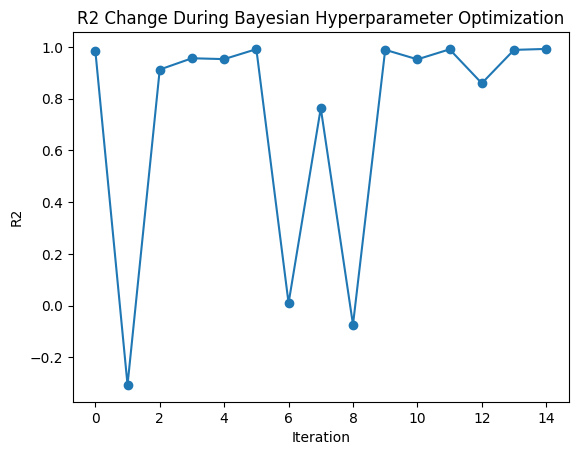

Original Dataset - RMSE: 3.8045961249372087, R2: 0.9993289652780211, MAE: 3.2807283308699353
External Dataset - RMSE: 75.82508850097656, R2: 0.733465342612716, MAE: 63.58502197265625


In [19]:
# 提取每次迭代的最佳 R2
best_r2_list = []
for res in result.func_vals:
    best_r2_list.append(-res)  # 注意要取负数

# 绘制 R2 的变化过程图
plt.plot(best_r2_list, marker='o')
plt.xlabel('Iteration')
plt.ylabel('R2')
plt.title('R2 Change During Bayesian Hyperparameter Optimization')
plt.show()

import torch
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from sklearn.model_selection import train_test_split

target_column = 'Biogas Production'

# 分离特征和目标变量
X = data.drop(target_column, axis=1)
y = data[target_column]
X_external = external_data.drop(target_column, axis=1)
y_external = external_data[target_column]

# 标准化数据
X_normalized, feature_scaler = normalize_data(X)
y_normalized, target_scaler = normalize_data(y.values.reshape(-1, 1))

# 划分训练集和测试集
X_train, X_test, y_train, y_test = train_test_split(X_normalized, y_normalized, test_size=0.2, random_state=0)

# 转换为 PyTorch 张量
X_train_tensor = torch.from_numpy(X_train).float().to(device)
X_test_tensor = torch.from_numpy(X_test).float().to(device)
y_train_tensor = torch.from_numpy(y_train).float().to(device)
y_test_tensor = torch.from_numpy(y_test).float().to(device)

# 标准化外部数据集
X_external_normalized, _ = normalize_data(X_external)
y_external_normalized, _ = normalize_data(y_external.values.reshape(-1, 1))

# 转换外部数据为张量
X_external_tensor = torch.from_numpy(X_external_normalized).float().to(device)
y_external_tensor = torch.from_numpy(y_external_normalized).float().to(device)

# 模型预测函数
def model_predict(model, X_tensor):
    model.eval()
    with torch.no_grad():
        return model(X_tensor).cpu().numpy()

# 获取预测值
y_pred_train = model_predict(model, X_train_tensor).flatten()
y_pred_test = model_predict(model, X_test_tensor).flatten()
y_pred_external = model_predict(model, X_external_tensor).flatten()

# 反标准化预测值和实际值
y_pred_train_denorm = denormalize_data(y_pred_train.reshape(-1, 1), target_scaler).flatten()
y_pred_test_denorm = denormalize_data(y_pred_test.reshape(-1, 1), target_scaler).flatten()
y_pred_external_denorm = denormalize_data(y_pred_external.reshape(-1, 1), target_scaler).flatten()
y_train_denorm = denormalize_data(y_train, target_scaler).flatten()
y_test_denorm = denormalize_data(y_test, target_scaler).flatten()
y_external_denorm = denormalize_data(y_external_tensor.cpu().numpy(), target_scaler).flatten()


# 合并原始数据集和外部数据集的预测值和实际值
original_data_actual = np.concatenate([y_train_denorm, y_test_denorm])
original_data_predicted = np.concatenate([y_pred_train_denorm, y_pred_test_denorm])
external_data_actual = y_external_denorm
external_data_predicted = y_pred_external_denorm

# 创建 DataFrame
combined_df = pd.DataFrame({
    'Actual': np.concatenate([original_data_actual, external_data_actual]),
    'Predicted': np.concatenate([original_data_predicted, external_data_predicted]),
    'Dataset': ['Original'] * len(original_data_actual) + ['External'] * len(external_data_actual)
})

# 计算原始数据集的指标
train_r2 = r2_score(original_data_actual, original_data_predicted)
train_rmse = mean_squared_error(original_data_actual, original_data_predicted, squared=False)
train_mae = mean_absolute_error(original_data_actual, original_data_predicted)

# 计算外部数据集的指标
external_r2 = r2_score(external_data_actual, external_data_predicted)
external_rmse = mean_squared_error(external_data_actual, external_data_predicted, squared=False)
external_mae = mean_absolute_error(external_data_actual, external_data_predicted)


print(f"Original Dataset - RMSE: {train_rmse}, R2: {train_r2}, MAE: {train_mae}")
print(f"External Dataset - RMSE: {external_rmse}, R2: {external_r2}, MAE: {external_mae}")

Best parameters: [500, 1e-06, 0.001, 0.8, 1e-07]


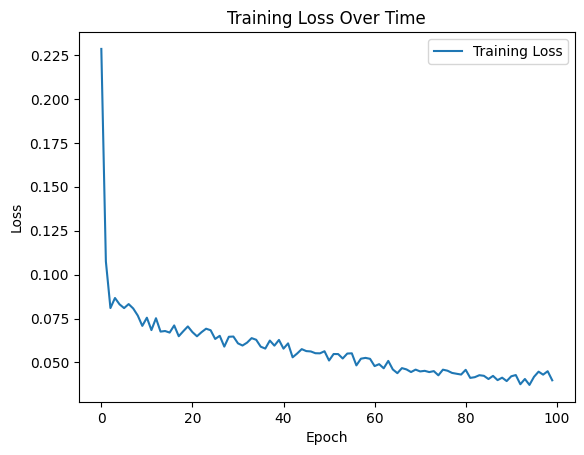

Task Train RMSE: 9.135601043701172, Train R2: 0.998519257678334, Train MAE: 7.996388912200928
Task Test RMSE: 8.81718635559082, Test R2: 0.998554614987332, Test MAE: 8.450602531433105
Task Train RMSE: 9.175621032714844, Train R2: 0.9985700699434074, Train MAE: 8.217839241027832
Task Test RMSE: 8.64932632446289, Test R2: 0.9982755812134865, Test MAE: 7.56475830078125
Task Train RMSE: 8.512036323547363, Train R2: 0.998576851669725, Train MAE: 7.536763668060303
Task Test RMSE: 11.034527778625488, Test R2: 0.9985641959930912, Test MAE: 10.28912353515625
Task Train RMSE: 9.349395751953125, Train R2: 0.9985955564712856, Train MAE: 8.43529224395752
Task Test RMSE: 7.86983585357666, Test R2: 0.9984220964863035, Test MAE: 6.694966793060303
Task Train RMSE: 9.168554306030273, Train R2: 0.9985776100719166, Train MAE: 8.249873161315918
Task Test RMSE: 8.679304122924805, Test R2: 0.9985450226921195, Test MAE: 7.436686038970947
Task Train RMSE: 9.15251350402832, Train R2: 0.9985116485518271, Train M

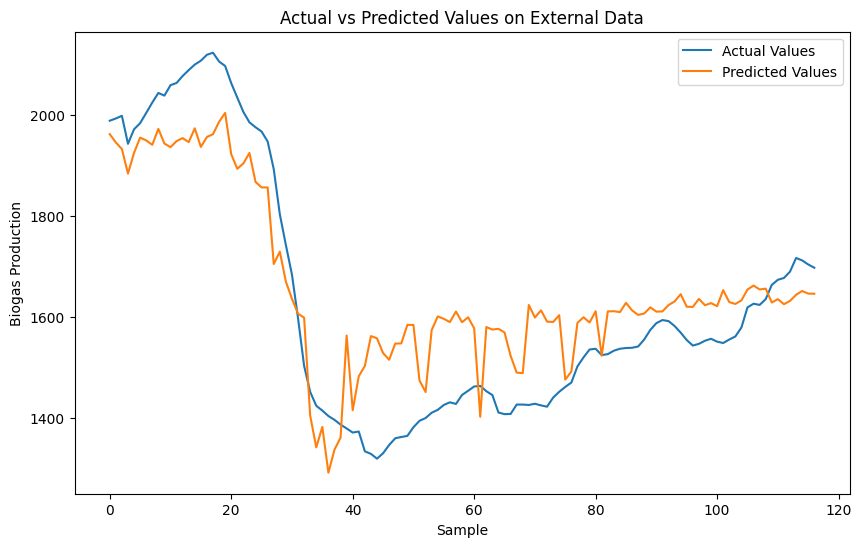

External Dataset - RMSE: 112.1635971069336, R2: 0.7924396916685615, MAE: 97.09337615966797


In [20]:
import torch
from torch import nn, optim
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split, KFold
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from skopt import gp_minimize
from skopt.space import Real, Integer
from skopt.utils import use_named_args
import matplotlib.pyplot as plt
import learn2learn as l2l
import numpy as np
import torch

np.random.seed(0)  # 设置NumPy的随机种子
torch.manual_seed(0)  # 设置PyTorch的随机种子

device = torch.device("cuda:0")  # Use GPU 0

# Hyperparameter search space
search_space = [
    Integer(500, 1500, name='hidden_size'), 
    Real(1e-11, 1e-6, "log-uniform", name='alpha'),  
    Real(1e-7, 1e-3, "log-uniform", name='beta'),
    Real(0.1, 0.8, name='dropout_rate'), 
    Real(1e-7, 1e-1, "log-uniform", name='weight_decay') 
]

# Data normalization and denormalization functions
def normalize_data(data):
    scaler = StandardScaler()
    return scaler.fit_transform(data), scaler

def normalize_feature(data, column_name):
    scaler = StandardScaler()
    scaled_data = scaler.fit_transform(data[[column_name]])
    return scaled_data, scaler

def denormalize_data(normalized_data, scaler):
    return scaler.inverse_transform(normalized_data)

# Advanced neural network architecture
class AdvancedNeuralNetwork(nn.Module):
    def __init__(self, input_size, hidden_size, dropout_rate):
        super(AdvancedNeuralNetwork, self).__init__()
        self.layer1 = nn.Linear(input_size, hidden_size)
        self.relu1 = nn.LeakyReLU()
        self.layer2 = nn.Linear(hidden_size, hidden_size // 2)
        self.relu2 = nn.LeakyReLU()
        self.layer3 = nn.Linear(hidden_size // 2, hidden_size // 4)
        self.relu3 = nn.LeakyReLU()
        self.dropout = nn.Dropout(dropout_rate)
        self.layer4 = nn.Linear(hidden_size // 4, 1)

    def forward(self, x):
        x = self.relu1(self.layer1(x))
        x = self.relu2(self.layer2(x))
        x = self.relu3(self.layer3(x))
        x = self.dropout(x)
        x = self.layer4(x)
        return x

# Task creation function
def create_tasks(data, target_column, num_tasks=50, task_size=30):
    tasks = []
    for _ in range(num_tasks):
        task_data = data.sample(task_size)
        X, y = task_data.drop(target_column, axis=1), task_data[target_column]
        tasks.append((X, y))
    return tasks

# Early stopping class
class EarlyStopping:
    def __init__(self, patience=5, delta=0):
        self.patience = patience
        self.counter = 0
        self.best_score = None
        self.early_stop = False
        self.delta = delta

    def __call__(self, val_loss, model):
        score = -val_loss
        if self.best_score is None:
            self.best_score = score
        elif score < self.best_score + self.delta:
            self.counter += 1
            if self.counter >= self.patience:
                self.early_stop = True
        else:
            self.best_score = score
            self.counter = 0

# MAML fast adaptation and meta-training
def meta_train_maml(model, tasks, alpha, beta, weight_decay, epochs=100, num_steps=1):
    early_stopping = EarlyStopping(patience=10, delta=0.01)
    optimizer = optim.Adam(model.parameters(), lr=beta, weight_decay=weight_decay)
    scheduler = optim.lr_scheduler.CosineAnnealingLR(optimizer, T_max=epochs)

    epoch_loss_list = []  # Initialize a list to store losses for each epoch

    for epoch in range(epochs):
        epoch_losses = []
        for task in tasks:
            learner = model.clone()  # Clone the model
            task_X, task_y = task
            task_X = torch.from_numpy(task_X.values).float().to(device)
            task_y = torch.from_numpy(task_y.values).float().to(device)

            # Fast adaptation
            for step in range(num_steps):
                pred_y = learner(task_X)
                loss = nn.functional.mse_loss(pred_y.squeeze(), task_y)
                learner.adapt(loss)

            # Meta-update
            optimizer.zero_grad()
            pred_y = learner(task_X)
            loss = nn.functional.mse_loss(pred_y.squeeze(), task_y)
            epoch_losses.append(loss.item())
            loss.backward()
            optimizer.step()

        scheduler.step()  # Update learning rate
        average_loss = np.mean(epoch_losses)
        epoch_loss_list.append(average_loss)  # Add each epoch's average loss to the list

        if early_stopping(average_loss, model):
            print(f"Early stopping triggered at epoch {epoch}")
            break

    return epoch_loss_list  # Return the list of epoch losses


@use_named_args(search_space)
def objective(hidden_size, alpha, beta, dropout_rate, weight_decay):
    model = AdvancedNeuralNetwork(input_size, hidden_size, dropout_rate)
    model = l2l.algorithms.MAML(model, lr=alpha).to(device)
    avg_r2 = 0

    task_r2_list = []  # 记录每个任务的 R2

    for task in tasks:
        task_X, task_y = task
        task_X_train, task_X_test, task_y_train, task_y_test = train_test_split(task_X, task_y, test_size=0.2, random_state=0)
        meta_train_maml(model, [(task_X_train, task_y_train)], alpha, beta, weight_decay, epochs=100)
        train_rmse, train_r2, train_mae, test_rmse, test_r2, test_mae = evaluate_model(model, task_X_train, task_y_train, task_X_test, task_y_test, target_scaler)
        task_r2_list.append(test_r2)  # 记录每个任务的测试 R2
        avg_r2 += test_r2

    avg_r2 /= len(tasks)
    return -avg_r2  # 这里返回负数因为 skopt 的目标函数是最小化，而我们想要最大化 R2


# Evaluation function
def evaluate_model(model, X_train, y_train, X_test, y_test, target_scaler):
    model.eval()
    with torch.no_grad():
        # Convert data to tensors
        X_train_tensor = torch.from_numpy(X_train.values).float().to(device)
        y_train_tensor = torch.from_numpy(y_train.values).float().to(device)
        X_test_tensor = torch.from_numpy(X_test.values).float().to(device)
        y_test_tensor = torch.from_numpy(y_test.values).float().to(device)

        # Get predictions
        train_predictions = model(X_train_tensor).squeeze().cpu().numpy()
        test_predictions = model(X_test_tensor).squeeze().cpu().numpy()

        # Reshape predictions for denormalization
        train_predictions_reshaped = train_predictions.reshape(-1, 1)
        test_predictions_reshaped = test_predictions.reshape(-1, 1)

        # Denormalize predictions using target_scaler
        train_predictions_denorm = denormalize_data(train_predictions_reshaped, target_scaler)
        test_predictions_denorm = denormalize_data(test_predictions_reshaped, target_scaler)

        # Denormalize actual values using target_scaler
        y_train_denorm = denormalize_data(y_train_tensor.cpu().numpy().reshape(-1, 1), target_scaler)
        y_test_denorm = denormalize_data(y_test_tensor.cpu().numpy().reshape(-1, 1), target_scaler)

        # Calculate metrics using denormalized data
        train_rmse = mean_squared_error(y_train_denorm, train_predictions_denorm, squared=False)
        train_r2 = r2_score(y_train_denorm, train_predictions_denorm)
        train_mae = mean_absolute_error(y_train_denorm, train_predictions_denorm)

        test_rmse = mean_squared_error(y_test_denorm, test_predictions_denorm, squared=False)
        test_r2 = r2_score(y_test_denorm, test_predictions_denorm)
        test_mae = mean_absolute_error(y_test_denorm, test_predictions_denorm)

    return train_rmse, train_r2, train_mae, test_rmse, test_r2, test_mae

# Load and normalize data
data = pd.read_csv("C:\\Users\\Lenovo\\Desktop\\元学习\\BT(3)4-1.csv")
data_normalized, scaler = normalize_data(data)
target_normalized, target_scaler = normalize_feature(data, 'Biogas Production')
# Create tasks using the normalized dataset
input_size = data.shape[1] - 1 
tasks = create_tasks(pd.DataFrame(data_normalized, columns=data.columns), target_column='Biogas Production')

# Execute hyperparameter optimization
result = gp_minimize(objective, search_space, n_calls=15,random_state=0)
hidden_size, alpha, beta, dropout_rate, weight_decay = result.x
print("Best parameters:", result.x)

# Train model with optimized hyperparameters
model = AdvancedNeuralNetwork(input_size, hidden_size, dropout_rate)
model = l2l.algorithms.MAML(model, lr=alpha).to(device)
train_losses = meta_train_maml(model, tasks, alpha, beta, weight_decay, epochs=100)

# Visualize training losses
plt.plot(train_losses, label='Training Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training Loss Over Time')
plt.legend()
plt.show()

# Final model evaluation
for task in tasks:
    X, y = task
    kf = KFold(n_splits=5, shuffle=True, random_state=0)
    for train_index, test_index in kf.split(X):
        X_train, X_test = X.iloc[train_index], X.iloc[test_index]
        y_train, y_test = y.iloc[train_index], y.iloc[test_index]
        train_rmse, train_r2, train_mae, test_rmse, test_r2, test_mae = evaluate_model(model, X_train, y_train, X_test, y_test, target_scaler)
        print(f"Task Train RMSE: {train_rmse}, Train R2: {train_r2}, Train MAE: {train_mae}")
        print(f"Task Test RMSE: {test_rmse}, Test R2: {test_r2}, Test MAE: {test_mae}")


# Load and process external data for evaluation
external_data = pd.read_csv("C:\\Users\\Lenovo\\Desktop\\元学习\\BT(3)4-2.csv")
external_data_normalized, _ = normalize_data(external_data)
external_target_normalized, _ = normalize_feature(external_data, 'Biogas Production')
external_X = torch.from_numpy(pd.DataFrame(external_data_normalized, columns=external_data.columns).drop('Biogas Production', axis=1).values).float().to(device)
external_y_normalized = torch.from_numpy(external_target_normalized).float().to(device)

# Model prediction on external data
learner = model.clone()  # Clone the model for evaluation
learner.eval()
with torch.no_grad():
    external_predictions_normalized = learner(external_X).squeeze()
external_predictions = denormalize_data(external_predictions_normalized.cpu().numpy().reshape(-1, 1), target_scaler)
external_y = denormalize_data(external_y_normalized.cpu().numpy().reshape(-1, 1), target_scaler)

# Visualization of predictions on external data
plt.figure(figsize=(10, 6))
plt.plot(external_y, label='Actual Values')
plt.plot(external_predictions, label='Predicted Values')
plt.xlabel('Sample')
plt.ylabel('Biogas Production')
plt.title('Actual vs Predicted Values on External Data')
plt.legend()
plt.show()

# Evaluate on external dataset using denormalized data
external_rmse = mean_squared_error(external_y, external_predictions, squared=False)
external_r2 = r2_score(external_y, external_predictions)
external_mae = mean_absolute_error(external_y, external_predictions)

print(f"External Dataset - RMSE: {external_rmse}, R2: {external_r2}, MAE: {external_mae}")

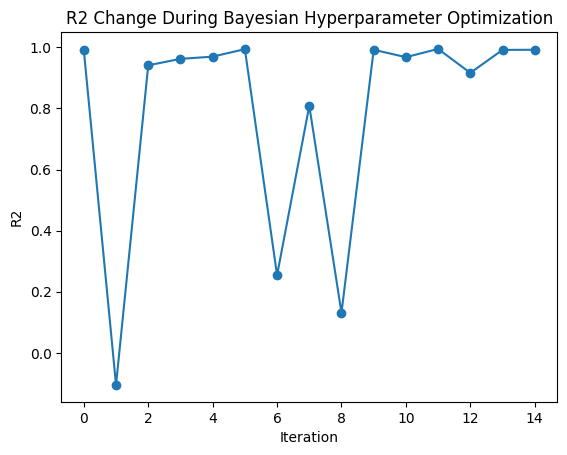

Original Dataset - RMSE: 9.690429635206097, R2: 0.9984507320753683, MAE: 8.396324264171511
External Dataset - RMSE: 112.1635971069336, R2: 0.7924396916685615, MAE: 97.09337615966797


In [21]:
# 提取每次迭代的最佳 R2
best_r2_list = []
for res in result.func_vals:
    best_r2_list.append(-res)  # 注意要取负数

# 绘制 R2 的变化过程图
plt.plot(best_r2_list, marker='o')
plt.xlabel('Iteration')
plt.ylabel('R2')
plt.title('R2 Change During Bayesian Hyperparameter Optimization')
plt.show()

import torch
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from sklearn.model_selection import train_test_split

target_column = 'Biogas Production'

# 分离特征和目标变量
X = data.drop(target_column, axis=1)
y = data[target_column]
X_external = external_data.drop(target_column, axis=1)
y_external = external_data[target_column]

# 标准化数据
X_normalized, feature_scaler = normalize_data(X)
y_normalized, target_scaler = normalize_data(y.values.reshape(-1, 1))

# 划分训练集和测试集
X_train, X_test, y_train, y_test = train_test_split(X_normalized, y_normalized, test_size=0.2, random_state=0)

# 转换为 PyTorch 张量
X_train_tensor = torch.from_numpy(X_train).float().to(device)
X_test_tensor = torch.from_numpy(X_test).float().to(device)
y_train_tensor = torch.from_numpy(y_train).float().to(device)
y_test_tensor = torch.from_numpy(y_test).float().to(device)

# 标准化外部数据集
X_external_normalized, _ = normalize_data(X_external)
y_external_normalized, _ = normalize_data(y_external.values.reshape(-1, 1))

# 转换外部数据为张量
X_external_tensor = torch.from_numpy(X_external_normalized).float().to(device)
y_external_tensor = torch.from_numpy(y_external_normalized).float().to(device)

# 模型预测函数
def model_predict(model, X_tensor):
    model.eval()
    with torch.no_grad():
        return model(X_tensor).cpu().numpy()

# 获取预测值
y_pred_train = model_predict(model, X_train_tensor).flatten()
y_pred_test = model_predict(model, X_test_tensor).flatten()
y_pred_external = model_predict(model, X_external_tensor).flatten()

# 反标准化预测值和实际值
y_pred_train_denorm = denormalize_data(y_pred_train.reshape(-1, 1), target_scaler).flatten()
y_pred_test_denorm = denormalize_data(y_pred_test.reshape(-1, 1), target_scaler).flatten()
y_pred_external_denorm = denormalize_data(y_pred_external.reshape(-1, 1), target_scaler).flatten()
y_train_denorm = denormalize_data(y_train, target_scaler).flatten()
y_test_denorm = denormalize_data(y_test, target_scaler).flatten()
y_external_denorm = denormalize_data(y_external_tensor.cpu().numpy(), target_scaler).flatten()


# 合并原始数据集和外部数据集的预测值和实际值
original_data_actual = np.concatenate([y_train_denorm, y_test_denorm])
original_data_predicted = np.concatenate([y_pred_train_denorm, y_pred_test_denorm])
external_data_actual = y_external_denorm
external_data_predicted = y_pred_external_denorm

# 创建 DataFrame
combined_df = pd.DataFrame({
    'Actual': np.concatenate([original_data_actual, external_data_actual]),
    'Predicted': np.concatenate([original_data_predicted, external_data_predicted]),
    'Dataset': ['Original'] * len(original_data_actual) + ['External'] * len(external_data_actual)
})

# 计算原始数据集的指标
train_r2 = r2_score(original_data_actual, original_data_predicted)
train_rmse = mean_squared_error(original_data_actual, original_data_predicted, squared=False)
train_mae = mean_absolute_error(original_data_actual, original_data_predicted)

# 计算外部数据集的指标
external_r2 = r2_score(external_data_actual, external_data_predicted)
external_rmse = mean_squared_error(external_data_actual, external_data_predicted, squared=False)
external_mae = mean_absolute_error(external_data_actual, external_data_predicted)


print(f"Original Dataset - RMSE: {train_rmse}, R2: {train_r2}, MAE: {train_mae}")
print(f"External Dataset - RMSE: {external_rmse}, R2: {external_r2}, MAE: {external_mae}")

GAN

Best parameters: [500, 1e-06, 0.001, 0.1, 1e-07]


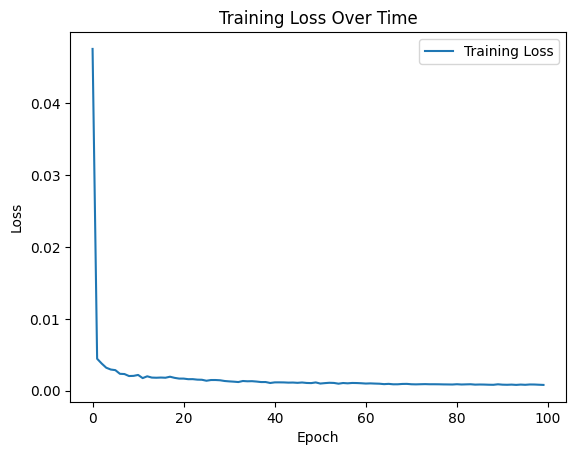

Task Train RMSE: 9.258869171142578, Train R2: 0.997484565994267, Train MAE: 7.235748291015625
Task Test RMSE: 8.48074722290039, Test R2: 0.9726235314334015, Test MAE: 7.009924411773682
Task Train RMSE: 8.95932388305664, Train R2: 0.9976696600375022, Train MAE: 6.973336696624756
Task Test RMSE: 9.682536125183105, Test R2: 0.9489121020484359, Test MAE: 8.059557914733887
Task Train RMSE: 8.838172912597656, Train R2: 0.997654979157796, Train MAE: 7.206787109375
Task Test RMSE: 10.118151664733887, Test R2: 0.9826076652958602, Test MAE: 7.125787258148193
Task Train RMSE: 9.653592109680176, Train R2: 0.9972488639866997, Train MAE: 7.6728925704956055
Task Test RMSE: 6.485583305358887, Test R2: 0.9898086072553193, Test MAE: 5.261364936828613
Task Train RMSE: 8.805028915405273, Train R2: 0.9788164534893934, Train MAE: 6.864152431488037
Task Test RMSE: 10.233092308044434, Test R2: 0.9991156918605945, Test MAE: 8.496343612670898
Task Train RMSE: 9.628829002380371, Train R2: 0.9986068043583032, Tra

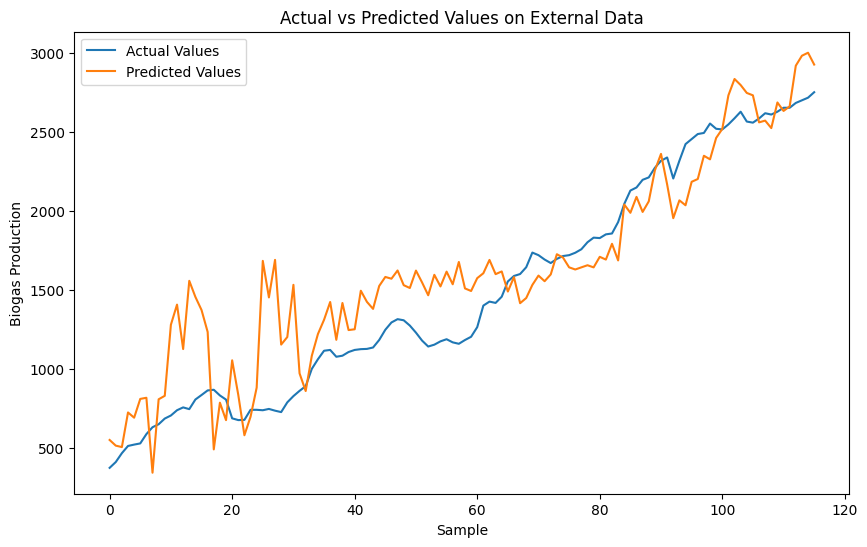

External Dataset - RMSE: 302.2034606933594, R2: 0.815485342803195, MAE: 237.28150939941406


In [22]:
import torch
from torch import nn, optim
import torch.nn.functional as F
import numpy as np
import pandas as pd
from sklearn.preprocessing import StandardScaler
import learn2learn as l2l
from sklearn.model_selection import train_test_split, KFold
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from skopt import gp_minimize
from skopt.space import Real, Integer
from skopt.utils import use_named_args
import matplotlib.pyplot as plt
from torch.utils.data import DataLoader, TensorDataset

# 设置随机种子
np.random.seed(0)
torch.manual_seed(0)

device = torch.device("cuda:0")  # Use GPU 0

# Hyperparameter search space
search_space = [
    Integer(500, 1500, name='hidden_size'), 
    Real(1e-11, 1e-6, "log-uniform", name='alpha'),  
    Real(1e-7, 1e-3, "log-uniform", name='beta'),
    Real(0.1, 0.8, name='dropout_rate'), 
    Real(1e-7, 1e-1, "log-uniform", name='weight_decay') 
]

# Data normalization and denormalization functions
def normalize_data(data):
    scaler = StandardScaler()
    return scaler.fit_transform(data), scaler

def normalize_feature(data, column_name):
    scaler = StandardScaler()
    scaled_data = scaler.fit_transform(data[[column_name]])
    return scaled_data, scaler

def denormalize_data(normalized_data, scaler):
    return scaler.inverse_transform(normalized_data)

# 加载和规范化数据
data = pd.read_csv("C:\\Users\\Lenovo\\Desktop\\元学习\\BT(3)1-1.csv")
data_normalized, scaler = normalize_data(data)

# 假设您的目标列名为'GI(%)'
target_normalized, target_scaler = normalize_data(data[['Biogas Production']].values)
# 元学习模型定义
class AdvancedNeuralNetwork(nn.Module):
    def __init__(self, input_size, hidden_size, dropout_rate):
        super(AdvancedNeuralNetwork, self).__init__()
        self.layer1 = nn.Linear(input_size, hidden_size)
        self.relu1 = nn.LeakyReLU()
        self.layer2 = nn.Linear(hidden_size, hidden_size // 2)
        self.relu2 = nn.LeakyReLU()
        self.layer3 = nn.Linear(hidden_size // 2, hidden_size // 4)
        self.relu3 = nn.LeakyReLU()
        self.dropout = nn.Dropout(dropout_rate)
        self.layer4 = nn.Linear(hidden_size // 4, 1)

    def forward(self, x):
        x = self.relu1(self.layer1(x))
        x = self.relu2(self.layer2(x))
        x = self.relu3(self.layer3(x))
        x = self.dropout(x)
        x = self.layer4(x)
        return x

# 其他辅助函数和类（如EarlyStopping, create_tasks等）根据需要添加
# Task creation function
def create_tasks(data, target_column, num_tasks=50, task_size=100):
    tasks = []
    for _ in range(num_tasks):
        task_data = data.sample(task_size)
        X, y = task_data.drop(target_column, axis=1), task_data[target_column]
        tasks.append((X, y))
    return tasks

# Early stopping class
class EarlyStopping:
    def __init__(self, patience=5, delta=0):
        self.patience = patience
        self.counter = 0
        self.best_score = None
        self.early_stop = False
        self.delta = delta

    def __call__(self, val_loss, model):
        score = -val_loss
        if self.best_score is None:
            self.best_score = score
        elif score < self.best_score + self.delta:
            self.counter += 1
            if self.counter >= self.patience:
                self.early_stop = True
        else:
            self.best_score = score
            self.counter = 0

# GAN的生成器定义
class Generator(nn.Module):
    def __init__(self, input_size, hidden_dim, output_size):
        super(Generator, self).__init__()
        self.fc1 = nn.Linear(input_size, hidden_dim)
        self.fc2 = nn.Linear(hidden_dim, hidden_dim * 2)
        self.fc3 = nn.Linear(hidden_dim * 2, hidden_dim * 4)
        self.fc4 = nn.Linear(hidden_dim * 4, output_size)

    def forward(self, x):
        x = F.leaky_relu(self.fc1(x), 0.2)
        x = F.leaky_relu(self.fc2(x), 0.2)
        x = F.leaky_relu(self.fc3(x), 0.2)
        x = torch.tanh(self.fc4(x))
        return x

# GAN的判别器定义
class Discriminator(nn.Module):
    def __init__(self, input_size, hidden_dim):
        super(Discriminator, self).__init__()
        self.fc1 = nn.Linear(input_size, hidden_dim * 4)
        self.fc2 = nn.Linear(hidden_dim * 4, hidden_dim * 2)
        self.fc3 = nn.Linear(hidden_dim * 2, hidden_dim)
        self.fc4 = nn.Linear(hidden_dim, 1)

    def forward(self, x):
        x = F.leaky_relu(self.fc1(x), 0.2)
        x = F.leaky_relu(self.fc2(x), 0.2)
        x = F.leaky_relu(self.fc3(x), 0.2)
        x = torch.sigmoid(self.fc4(x))
        return x

# MAML fast adaptation and meta-training
def meta_train_maml(model, tasks, alpha, beta, weight_decay, epochs=100, num_steps=1):
    early_stopping = EarlyStopping(patience=10, delta=0.01)
    optimizer = optim.Adam(model.parameters(), lr=beta, weight_decay=weight_decay)
    scheduler = optim.lr_scheduler.CosineAnnealingLR(optimizer, T_max=epochs)

    epoch_loss_list = []  # Initialize a list to store losses for each epoch

    for epoch in range(epochs):
        epoch_losses = []
        for task in tasks:
            learner = model.clone()  # Clone the model
            task_X, task_y = task
            task_X = torch.from_numpy(task_X.values).float().to(device)
            task_y = torch.from_numpy(task_y.values).float().to(device)

            # Fast adaptation
            for step in range(num_steps):
                pred_y = learner(task_X)
                loss = nn.functional.mse_loss(pred_y.squeeze(), task_y)
                learner.adapt(loss)

            # Meta-update
            optimizer.zero_grad()
            pred_y = learner(task_X)
            loss = nn.functional.mse_loss(pred_y.squeeze(), task_y)
            epoch_losses.append(loss.item())
            loss.backward()
            optimizer.step()

        scheduler.step()  # Update learning rate
        average_loss = np.mean(epoch_losses)
        epoch_loss_list.append(average_loss)  # Add each epoch's average loss to the list

        if early_stopping(average_loss, model):
            print(f"Early stopping triggered at epoch {epoch}")
            break

    return epoch_loss_list  # Return the list of epoch losses


@use_named_args(search_space)
def objective(hidden_size, alpha, beta, dropout_rate, weight_decay):
    model = AdvancedNeuralNetwork(input_size, hidden_size, dropout_rate)
    model = l2l.algorithms.MAML(model, lr=alpha).to(device)
    avg_r2 = 0

    task_r2_list = []  # 记录每个任务的 R2

    for task in tasks:
        task_X, task_y = task
        task_X_train, task_X_test, task_y_train, task_y_test = train_test_split(task_X, task_y, test_size=0.2, random_state=0)
        meta_train_maml(model, [(task_X_train, task_y_train)], alpha, beta, weight_decay, epochs=100)
        train_rmse, train_r2, train_mae, test_rmse, test_r2, test_mae = evaluate_model(model, task_X_train, task_y_train, task_X_test, task_y_test, target_scaler)
        task_r2_list.append(test_r2)  # 记录每个任务的测试 R2
        avg_r2 += test_r2

    avg_r2 /= len(tasks)
    return -avg_r2  # 这里返回负数因为 skopt 的目标函数是最小化，而我们想要最大化 R2

# Evaluation function
def evaluate_model(model, X_train, y_train, X_test, y_test, target_scaler):
    model.eval()
    with torch.no_grad():
        # Convert data to tensors
        X_train_tensor = torch.from_numpy(X_train.values).float().to(device)
        y_train_tensor = torch.from_numpy(y_train.values).float().to(device)
        X_test_tensor = torch.from_numpy(X_test.values).float().to(device)
        y_test_tensor = torch.from_numpy(y_test.values).float().to(device)

        # Get predictions
        train_predictions = model(X_train_tensor).squeeze().cpu().numpy()
        test_predictions = model(X_test_tensor).squeeze().cpu().numpy()

        # Reshape predictions for denormalization
        train_predictions_reshaped = train_predictions.reshape(-1, 1)
        test_predictions_reshaped = test_predictions.reshape(-1, 1)

        # Denormalize predictions using target_scaler
        train_predictions_denorm = denormalize_data(train_predictions_reshaped, target_scaler)
        test_predictions_denorm = denormalize_data(test_predictions_reshaped, target_scaler)

        # Denormalize actual values using target_scaler
        y_train_denorm = denormalize_data(y_train_tensor.cpu().numpy().reshape(-1, 1), target_scaler)
        y_test_denorm = denormalize_data(y_test_tensor.cpu().numpy().reshape(-1, 1), target_scaler)

        # Calculate metrics using denormalized data
        train_rmse = mean_squared_error(y_train_denorm, train_predictions_denorm, squared=False)
        train_r2 = r2_score(y_train_denorm, train_predictions_denorm)
        train_mae = mean_absolute_error(y_train_denorm, train_predictions_denorm)

        test_rmse = mean_squared_error(y_test_denorm, test_predictions_denorm, squared=False)
        test_r2 = r2_score(y_test_denorm, test_predictions_denorm)
        test_mae = mean_absolute_error(y_test_denorm, test_predictions_denorm)

    return train_rmse, train_r2, train_mae, test_rmse, test_r2, test_mae

# 设置GAN训练参数
z_dim = 100  # 潜在空间的维度
gen_hidden_dim = 128
dis_hidden_dim = 128
lr = 0.0002
batch_size = 64
num_epochs = 50

# 初始化模型
generator = Generator(z_dim, gen_hidden_dim, data_normalized.shape[1]).to(device)
discriminator = Discriminator(data_normalized.shape[1], dis_hidden_dim).to(device)

# 优化器
optim_g = optim.Adam(generator.parameters(), lr=lr)
optim_d = optim.Adam(discriminator.parameters(), lr=lr)

tensor_data = torch.Tensor(data_normalized)
data_loader = DataLoader(tensor_data, batch_size=batch_size, shuffle=True)

# GAN训练循环
for epoch in range(num_epochs):
    for batch in data_loader:
        current_batch_size = len(batch)  # Get the actual batch size
        real_data = batch.to(device)
        real_labels = torch.ones(current_batch_size, 1).to(device)  # Adjust label size based on batch
        fake_data = generator(torch.randn(current_batch_size, z_dim).to(device))  # Generate fake data based on current batch size
        fake_labels = torch.zeros(current_batch_size, 1).to(device)  # Adjust fake label size

        # 训练判别器
        optim_d.zero_grad()
        real_output = discriminator(real_data)
        fake_output = discriminator(fake_data)
        d_loss_real = nn.BCEWithLogitsLoss()(real_output, real_labels)
        d_loss_fake = nn.BCEWithLogitsLoss()(fake_output, fake_labels)
        d_loss = d_loss_real + d_loss_fake
        d_loss.backward()
        optim_d.step()

        # 训练生成器
        optim_g.zero_grad()
        fake_data = generator(torch.randn(current_batch_size, z_dim).to(device))  # Regenerate fake data
        fake_output = discriminator(fake_data)
        g_loss = nn.BCEWithLogitsLoss()(fake_output, real_labels)  # Use real_labels here
        g_loss.backward()
        optim_g.step()

# 假设您想生成一定数量的新样本
number_of_generated_samples = 500

# 生成新的数据样本
generated_samples = []
for _ in range(number_of_generated_samples):
    z = torch.randn(1, z_dim).to(device)
    generated_sample = generator(z).detach().cpu().numpy()
    generated_samples.append(generated_sample.reshape(-1))

generated_samples = np.array(generated_samples)

# 将生成的样本合并到现有数据中
extended_data = np.vstack([data_normalized, generated_samples])

# 创建增强的数据集任务
# 这里假设您已经定义了创建任务的函数
input_size = data.shape[1] - 1 
tasks = create_tasks(pd.DataFrame(extended_data, columns=data.columns), target_column='Biogas Production')
# Execute hyperparameter optimization
result = gp_minimize(objective, search_space, n_calls=15,random_state=0)
hidden_size, alpha, beta, dropout_rate, weight_decay = result.x
print("Best parameters:", result.x)

# Train model with optimized hyperparameters
model = AdvancedNeuralNetwork(input_size, hidden_size, dropout_rate)
model = l2l.algorithms.MAML(model, lr=alpha).to(device)
train_losses = meta_train_maml(model, tasks, alpha, beta, weight_decay, epochs=100)

# Visualize training losses
plt.plot(train_losses, label='Training Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training Loss Over Time')
plt.legend()
plt.show()

# Final model evaluation
for task in tasks:
    X, y = task
    kf = KFold(n_splits=5, shuffle=True, random_state=0)
    for train_index, test_index in kf.split(X):
        X_train, X_test = X.iloc[train_index], X.iloc[test_index]
        y_train, y_test = y.iloc[train_index], y.iloc[test_index]
        train_rmse, train_r2, train_mae, test_rmse, test_r2, test_mae = evaluate_model(model, X_train, y_train, X_test, y_test, target_scaler)
        print(f"Task Train RMSE: {train_rmse}, Train R2: {train_r2}, Train MAE: {train_mae}")
        print(f"Task Test RMSE: {test_rmse}, Test R2: {test_r2}, Test MAE: {test_mae}")
# Load and process external data for evaluation
external_data = pd.read_csv("C:\\Users\\Lenovo\\Desktop\\元学习\\BT(3)1-2.csv")
external_data_normalized, _ = normalize_data(external_data)
external_target_normalized, _ = normalize_feature(external_data, 'Biogas Production')
external_X = torch.from_numpy(pd.DataFrame(external_data_normalized, columns=external_data.columns).drop('Biogas Production', axis=1).values).float().to(device)
external_y_normalized = torch.from_numpy(external_target_normalized).float().to(device)

# Model prediction on external data
learner = model.clone()  # Clone the model for evaluation
learner.eval()
with torch.no_grad():
    external_predictions_normalized = learner(external_X).squeeze()
external_predictions = denormalize_data(external_predictions_normalized.cpu().numpy().reshape(-1, 1), target_scaler)
external_y = denormalize_data(external_y_normalized.cpu().numpy().reshape(-1, 1), target_scaler)

# Visualization of predictions on external data
plt.figure(figsize=(10, 6))
plt.plot(external_y, label='Actual Values')
plt.plot(external_predictions, label='Predicted Values')
plt.xlabel('Sample')
plt.ylabel('Biogas Production')
plt.title('Actual vs Predicted Values on External Data')
plt.legend()
plt.show()

# Evaluate on external dataset using denormalized data
external_rmse = mean_squared_error(external_y, external_predictions, squared=False)
external_r2 = r2_score(external_y, external_predictions)
external_mae = mean_absolute_error(external_y, external_predictions)

print(f"External Dataset - RMSE: {external_rmse}, R2: {external_r2}, MAE: {external_mae}")

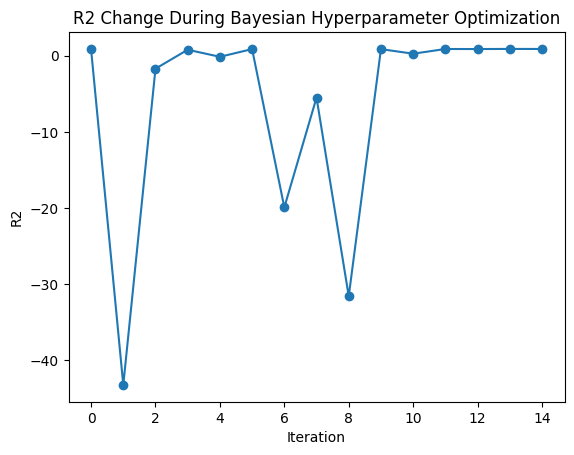

Original Dataset - RMSE: 3.079754474206939, R2: 0.9999808369661963, MAE: 2.2302404230291173
External Dataset - RMSE: 302.2034606933594, R2: 0.815485342803195, MAE: 237.28150939941406


In [23]:
# 提取每次迭代的最佳 R2
best_r2_list = []
for res in result.func_vals:
    best_r2_list.append(-res)  # 注意要取负数

# 绘制 R2 的变化过程图
plt.plot(best_r2_list, marker='o')
plt.xlabel('Iteration')
plt.ylabel('R2')
plt.title('R2 Change During Bayesian Hyperparameter Optimization')
plt.show()

import torch
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from sklearn.model_selection import train_test_split

target_column = 'Biogas Production'

# 分离特征和目标变量
X = data.drop(target_column, axis=1)
y = data[target_column]
X_external = external_data.drop(target_column, axis=1)
y_external = external_data[target_column]

# 标准化数据
X_normalized, feature_scaler = normalize_data(X)
y_normalized, target_scaler = normalize_data(y.values.reshape(-1, 1))

# 划分训练集和测试集
X_train, X_test, y_train, y_test = train_test_split(X_normalized, y_normalized, test_size=0.2, random_state=0)

# 转换为 PyTorch 张量
X_train_tensor = torch.from_numpy(X_train).float().to(device)
X_test_tensor = torch.from_numpy(X_test).float().to(device)
y_train_tensor = torch.from_numpy(y_train).float().to(device)
y_test_tensor = torch.from_numpy(y_test).float().to(device)

# 标准化外部数据集
X_external_normalized, _ = normalize_data(X_external)
y_external_normalized, _ = normalize_data(y_external.values.reshape(-1, 1))

# 转换外部数据为张量
X_external_tensor = torch.from_numpy(X_external_normalized).float().to(device)
y_external_tensor = torch.from_numpy(y_external_normalized).float().to(device)

# 模型预测函数
def model_predict(model, X_tensor):
    model.eval()
    with torch.no_grad():
        return model(X_tensor).cpu().numpy()

# 获取预测值
y_pred_train = model_predict(model, X_train_tensor).flatten()
y_pred_test = model_predict(model, X_test_tensor).flatten()
y_pred_external = model_predict(model, X_external_tensor).flatten()

# 反标准化预测值和实际值
y_pred_train_denorm = denormalize_data(y_pred_train.reshape(-1, 1), target_scaler).flatten()
y_pred_test_denorm = denormalize_data(y_pred_test.reshape(-1, 1), target_scaler).flatten()
y_pred_external_denorm = denormalize_data(y_pred_external.reshape(-1, 1), target_scaler).flatten()
y_train_denorm = denormalize_data(y_train, target_scaler).flatten()
y_test_denorm = denormalize_data(y_test, target_scaler).flatten()
y_external_denorm = denormalize_data(y_external_tensor.cpu().numpy(), target_scaler).flatten()


# 合并原始数据集和外部数据集的预测值和实际值
original_data_actual = np.concatenate([y_train_denorm, y_test_denorm])
original_data_predicted = np.concatenate([y_pred_train_denorm, y_pred_test_denorm])
external_data_actual = y_external_denorm
external_data_predicted = y_pred_external_denorm

# 创建 DataFrame
combined_df = pd.DataFrame({
    'Actual': np.concatenate([original_data_actual, external_data_actual]),
    'Predicted': np.concatenate([original_data_predicted, external_data_predicted]),
    'Dataset': ['Original'] * len(original_data_actual) + ['External'] * len(external_data_actual)
})

# 计算原始数据集的指标
train_r2 = r2_score(original_data_actual, original_data_predicted)
train_rmse = mean_squared_error(original_data_actual, original_data_predicted, squared=False)
train_mae = mean_absolute_error(original_data_actual, original_data_predicted)

# 计算外部数据集的指标
external_r2 = r2_score(external_data_actual, external_data_predicted)
external_rmse = mean_squared_error(external_data_actual, external_data_predicted, squared=False)
external_mae = mean_absolute_error(external_data_actual, external_data_predicted)


print(f"Original Dataset - RMSE: {train_rmse}, R2: {train_r2}, MAE: {train_mae}")
print(f"External Dataset - RMSE: {external_rmse}, R2: {external_r2}, MAE: {external_mae}")

Best parameters: [500, 1e-11, 0.001, 0.8, 1e-07]


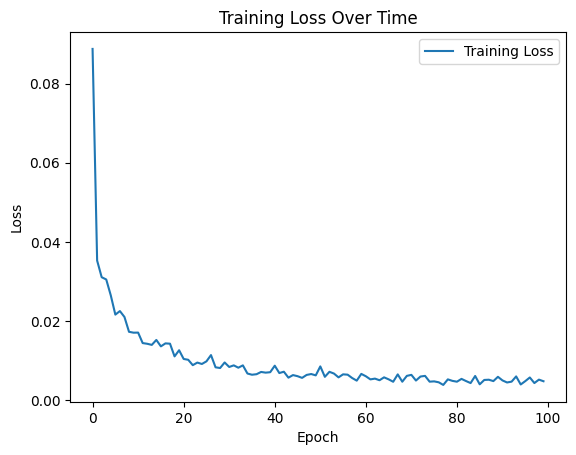

Task Train RMSE: 2.712278366088867, Train R2: 0.9729476483640995, Train MAE: 2.081238269805908
Task Test RMSE: 3.815462589263916, Test R2: 0.9966130216202326, Test MAE: 2.8686797618865967
Task Train RMSE: 2.878380537033081, Train R2: 0.9939729164853276, Train MAE: 2.1060290336608887
Task Test RMSE: 3.2929129600524902, Test R2: 0.887216026003532, Test MAE: 2.7695159912109375
Task Train RMSE: 3.1725945472717285, Train R2: 0.9926689746952438, Train MAE: 2.443416118621826
Task Test RMSE: 1.929286003112793, Test R2: 0.967279442609488, Test MAE: 1.4199676513671875
Task Train RMSE: 3.145921230316162, Train R2: 0.9921211293430032, Train MAE: 2.4108481407165527
Task Test RMSE: 2.0967330932617188, Test R2: 0.99305200977325, Test MAE: 1.5502395629882812
Task Train RMSE: 2.8947997093200684, Train R2: 0.9938515100825243, Train MAE: 2.1521008014678955
Task Test RMSE: 3.2348270416259766, Test R2: 0.9492541689519576, Test MAE: 2.5852293968200684
Task Train RMSE: 2.933382272720337, Train R2: 0.99342707

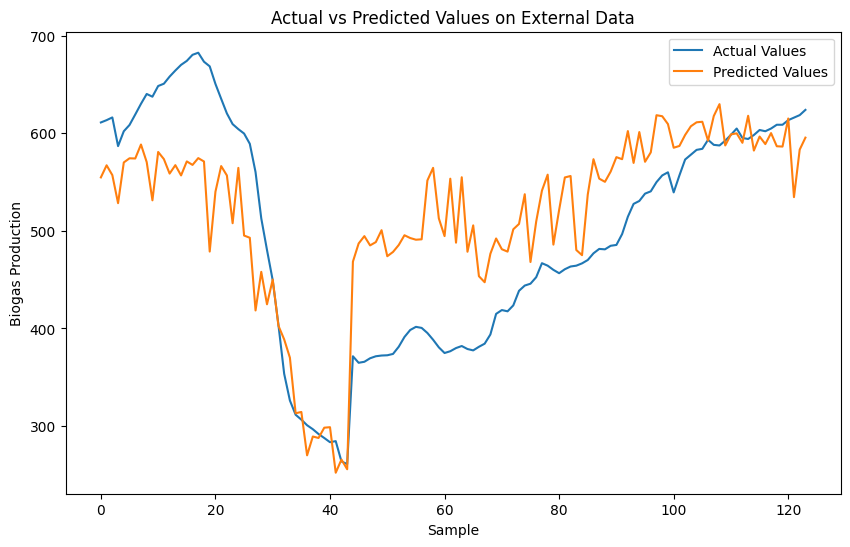

External Dataset - RMSE: 78.45915985107422, R2: 0.5445627597021074, MAE: 65.00000762939453


In [24]:
import torch
from torch import nn, optim
import torch.nn.functional as F
import numpy as np
import pandas as pd
from sklearn.preprocessing import StandardScaler
import learn2learn as l2l
from sklearn.model_selection import train_test_split, KFold
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from skopt import gp_minimize
from skopt.space import Real, Integer
from skopt.utils import use_named_args
import matplotlib.pyplot as plt
from torch.utils.data import DataLoader, TensorDataset

# 设置随机种子
np.random.seed(0)
torch.manual_seed(0)

device = torch.device("cuda:0")  # Use GPU 0

# Hyperparameter search space
search_space = [
    Integer(500, 1500, name='hidden_size'), 
    Real(1e-11, 1e-6, "log-uniform", name='alpha'),  
    Real(1e-7, 1e-3, "log-uniform", name='beta'),
    Real(0.1, 0.8, name='dropout_rate'), 
    Real(1e-7, 1e-1, "log-uniform", name='weight_decay') 
]

# Data normalization and denormalization functions
def normalize_data(data):
    scaler = StandardScaler()
    return scaler.fit_transform(data), scaler

def normalize_feature(data, column_name):
    scaler = StandardScaler()
    scaled_data = scaler.fit_transform(data[[column_name]])
    return scaled_data, scaler

def denormalize_data(normalized_data, scaler):
    return scaler.inverse_transform(normalized_data)

# 加载和规范化数据
data = pd.read_csv("C:\\Users\\Lenovo\\Desktop\\元学习\\BT(3)2-1.csv")
data_normalized, scaler = normalize_data(data)

# 假设您的目标列名为'GI(%)'
target_normalized, target_scaler = normalize_data(data[['Biogas Production']].values)
# 元学习模型定义
class AdvancedNeuralNetwork(nn.Module):
    def __init__(self, input_size, hidden_size, dropout_rate):
        super(AdvancedNeuralNetwork, self).__init__()
        self.layer1 = nn.Linear(input_size, hidden_size)
        self.relu1 = nn.LeakyReLU()
        self.layer2 = nn.Linear(hidden_size, hidden_size // 2)
        self.relu2 = nn.LeakyReLU()
        self.layer3 = nn.Linear(hidden_size // 2, hidden_size // 4)
        self.relu3 = nn.LeakyReLU()
        self.dropout = nn.Dropout(dropout_rate)
        self.layer4 = nn.Linear(hidden_size // 4, 1)

    def forward(self, x):
        x = self.relu1(self.layer1(x))
        x = self.relu2(self.layer2(x))
        x = self.relu3(self.layer3(x))
        x = self.dropout(x)
        x = self.layer4(x)
        return x

# 其他辅助函数和类（如EarlyStopping, create_tasks等）根据需要添加
# Task creation function
def create_tasks(data, target_column, num_tasks=50, task_size=100):
    tasks = []
    for _ in range(num_tasks):
        task_data = data.sample(task_size)
        X, y = task_data.drop(target_column, axis=1), task_data[target_column]
        tasks.append((X, y))
    return tasks

# Early stopping class
class EarlyStopping:
    def __init__(self, patience=5, delta=0):
        self.patience = patience
        self.counter = 0
        self.best_score = None
        self.early_stop = False
        self.delta = delta

    def __call__(self, val_loss, model):
        score = -val_loss
        if self.best_score is None:
            self.best_score = score
        elif score < self.best_score + self.delta:
            self.counter += 1
            if self.counter >= self.patience:
                self.early_stop = True
        else:
            self.best_score = score
            self.counter = 0

# GAN的生成器定义
class Generator(nn.Module):
    def __init__(self, input_size, hidden_dim, output_size):
        super(Generator, self).__init__()
        self.fc1 = nn.Linear(input_size, hidden_dim)
        self.fc2 = nn.Linear(hidden_dim, hidden_dim * 2)
        self.fc3 = nn.Linear(hidden_dim * 2, hidden_dim * 4)
        self.fc4 = nn.Linear(hidden_dim * 4, output_size)

    def forward(self, x):
        x = F.leaky_relu(self.fc1(x), 0.2)
        x = F.leaky_relu(self.fc2(x), 0.2)
        x = F.leaky_relu(self.fc3(x), 0.2)
        x = torch.tanh(self.fc4(x))
        return x

# GAN的判别器定义
class Discriminator(nn.Module):
    def __init__(self, input_size, hidden_dim):
        super(Discriminator, self).__init__()
        self.fc1 = nn.Linear(input_size, hidden_dim * 4)
        self.fc2 = nn.Linear(hidden_dim * 4, hidden_dim * 2)
        self.fc3 = nn.Linear(hidden_dim * 2, hidden_dim)
        self.fc4 = nn.Linear(hidden_dim, 1)

    def forward(self, x):
        x = F.leaky_relu(self.fc1(x), 0.2)
        x = F.leaky_relu(self.fc2(x), 0.2)
        x = F.leaky_relu(self.fc3(x), 0.2)
        x = torch.sigmoid(self.fc4(x))
        return x

# MAML fast adaptation and meta-training
def meta_train_maml(model, tasks, alpha, beta, weight_decay, epochs=100, num_steps=1):
    early_stopping = EarlyStopping(patience=10, delta=0.01)
    optimizer = optim.Adam(model.parameters(), lr=beta, weight_decay=weight_decay)
    scheduler = optim.lr_scheduler.CosineAnnealingLR(optimizer, T_max=epochs)

    epoch_loss_list = []  # Initialize a list to store losses for each epoch

    for epoch in range(epochs):
        epoch_losses = []
        for task in tasks:
            learner = model.clone()  # Clone the model
            task_X, task_y = task
            task_X = torch.from_numpy(task_X.values).float().to(device)
            task_y = torch.from_numpy(task_y.values).float().to(device)

            # Fast adaptation
            for step in range(num_steps):
                pred_y = learner(task_X)
                loss = nn.functional.mse_loss(pred_y.squeeze(), task_y)
                learner.adapt(loss)

            # Meta-update
            optimizer.zero_grad()
            pred_y = learner(task_X)
            loss = nn.functional.mse_loss(pred_y.squeeze(), task_y)
            epoch_losses.append(loss.item())
            loss.backward()
            optimizer.step()

        scheduler.step()  # Update learning rate
        average_loss = np.mean(epoch_losses)
        epoch_loss_list.append(average_loss)  # Add each epoch's average loss to the list

        if early_stopping(average_loss, model):
            print(f"Early stopping triggered at epoch {epoch}")
            break

    return epoch_loss_list  # Return the list of epoch losses



@use_named_args(search_space)
def objective(hidden_size, alpha, beta, dropout_rate, weight_decay):
    model = AdvancedNeuralNetwork(input_size, hidden_size, dropout_rate)
    model = l2l.algorithms.MAML(model, lr=alpha).to(device)
    avg_r2 = 0

    task_r2_list = []  # 记录每个任务的 R2

    for task in tasks:
        task_X, task_y = task
        task_X_train, task_X_test, task_y_train, task_y_test = train_test_split(task_X, task_y, test_size=0.2, random_state=0)
        meta_train_maml(model, [(task_X_train, task_y_train)], alpha, beta, weight_decay, epochs=100)
        train_rmse, train_r2, train_mae, test_rmse, test_r2, test_mae = evaluate_model(model, task_X_train, task_y_train, task_X_test, task_y_test, target_scaler)
        task_r2_list.append(test_r2)  # 记录每个任务的测试 R2
        avg_r2 += test_r2

    avg_r2 /= len(tasks)
    return -avg_r2  # 这里返回负数因为 skopt 的目标函数是最小化，而我们想要最大化 R2

# Evaluation function
def evaluate_model(model, X_train, y_train, X_test, y_test, target_scaler):
    model.eval()
    with torch.no_grad():
        # Convert data to tensors
        X_train_tensor = torch.from_numpy(X_train.values).float().to(device)
        y_train_tensor = torch.from_numpy(y_train.values).float().to(device)
        X_test_tensor = torch.from_numpy(X_test.values).float().to(device)
        y_test_tensor = torch.from_numpy(y_test.values).float().to(device)

        # Get predictions
        train_predictions = model(X_train_tensor).squeeze().cpu().numpy()
        test_predictions = model(X_test_tensor).squeeze().cpu().numpy()

        # Reshape predictions for denormalization
        train_predictions_reshaped = train_predictions.reshape(-1, 1)
        test_predictions_reshaped = test_predictions.reshape(-1, 1)

        # Denormalize predictions using target_scaler
        train_predictions_denorm = denormalize_data(train_predictions_reshaped, target_scaler)
        test_predictions_denorm = denormalize_data(test_predictions_reshaped, target_scaler)

        # Denormalize actual values using target_scaler
        y_train_denorm = denormalize_data(y_train_tensor.cpu().numpy().reshape(-1, 1), target_scaler)
        y_test_denorm = denormalize_data(y_test_tensor.cpu().numpy().reshape(-1, 1), target_scaler)

        # Calculate metrics using denormalized data
        train_rmse = mean_squared_error(y_train_denorm, train_predictions_denorm, squared=False)
        train_r2 = r2_score(y_train_denorm, train_predictions_denorm)
        train_mae = mean_absolute_error(y_train_denorm, train_predictions_denorm)

        test_rmse = mean_squared_error(y_test_denorm, test_predictions_denorm, squared=False)
        test_r2 = r2_score(y_test_denorm, test_predictions_denorm)
        test_mae = mean_absolute_error(y_test_denorm, test_predictions_denorm)

    return train_rmse, train_r2, train_mae, test_rmse, test_r2, test_mae

# 设置GAN训练参数
z_dim = 100  # 潜在空间的维度
gen_hidden_dim = 128
dis_hidden_dim = 128
lr = 0.0002
batch_size = 64
num_epochs = 50

# 初始化模型
generator = Generator(z_dim, gen_hidden_dim, data_normalized.shape[1]).to(device)
discriminator = Discriminator(data_normalized.shape[1], dis_hidden_dim).to(device)

# 优化器
optim_g = optim.Adam(generator.parameters(), lr=lr)
optim_d = optim.Adam(discriminator.parameters(), lr=lr)

tensor_data = torch.Tensor(data_normalized)
data_loader = DataLoader(tensor_data, batch_size=batch_size, shuffle=True)

# GAN训练循环
for epoch in range(num_epochs):
    for batch in data_loader:
        current_batch_size = len(batch)  # Get the actual batch size
        real_data = batch.to(device)
        real_labels = torch.ones(current_batch_size, 1).to(device)  # Adjust label size based on batch
        fake_data = generator(torch.randn(current_batch_size, z_dim).to(device))  # Generate fake data based on current batch size
        fake_labels = torch.zeros(current_batch_size, 1).to(device)  # Adjust fake label size

        # 训练判别器
        optim_d.zero_grad()
        real_output = discriminator(real_data)
        fake_output = discriminator(fake_data)
        d_loss_real = nn.BCEWithLogitsLoss()(real_output, real_labels)
        d_loss_fake = nn.BCEWithLogitsLoss()(fake_output, fake_labels)
        d_loss = d_loss_real + d_loss_fake
        d_loss.backward()
        optim_d.step()

        # 训练生成器
        optim_g.zero_grad()
        fake_data = generator(torch.randn(current_batch_size, z_dim).to(device))  # Regenerate fake data
        fake_output = discriminator(fake_data)
        g_loss = nn.BCEWithLogitsLoss()(fake_output, real_labels)  # Use real_labels here
        g_loss.backward()
        optim_g.step()

# 假设您想生成一定数量的新样本
number_of_generated_samples = 500

# 生成新的数据样本
generated_samples = []
for _ in range(number_of_generated_samples):
    z = torch.randn(1, z_dim).to(device)
    generated_sample = generator(z).detach().cpu().numpy()
    generated_samples.append(generated_sample.reshape(-1))

generated_samples = np.array(generated_samples)

# 将生成的样本合并到现有数据中
extended_data = np.vstack([data_normalized, generated_samples])

# 创建增强的数据集任务
# 这里假设您已经定义了创建任务的函数
input_size = data.shape[1] - 1 
tasks = create_tasks(pd.DataFrame(extended_data, columns=data.columns), target_column='Biogas Production')
# Execute hyperparameter optimization
result = gp_minimize(objective, search_space, n_calls=15,random_state=0)
hidden_size, alpha, beta, dropout_rate, weight_decay = result.x
print("Best parameters:", result.x)

# Train model with optimized hyperparameters
model = AdvancedNeuralNetwork(input_size, hidden_size, dropout_rate)
model = l2l.algorithms.MAML(model, lr=alpha).to(device)
train_losses = meta_train_maml(model, tasks, alpha, beta, weight_decay, epochs=100)

# Visualize training losses
plt.plot(train_losses, label='Training Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training Loss Over Time')
plt.legend()
plt.show()

# Final model evaluation
for task in tasks:
    X, y = task
    kf = KFold(n_splits=5, shuffle=True, random_state=0)
    for train_index, test_index in kf.split(X):
        X_train, X_test = X.iloc[train_index], X.iloc[test_index]
        y_train, y_test = y.iloc[train_index], y.iloc[test_index]
        train_rmse, train_r2, train_mae, test_rmse, test_r2, test_mae = evaluate_model(model, X_train, y_train, X_test, y_test, target_scaler)
        print(f"Task Train RMSE: {train_rmse}, Train R2: {train_r2}, Train MAE: {train_mae}")
        print(f"Task Test RMSE: {test_rmse}, Test R2: {test_r2}, Test MAE: {test_mae}")
# Load and process external data for evaluation
external_data = pd.read_csv("C:\\Users\\Lenovo\\Desktop\\元学习\\BT(3)2-2.csv")
external_data_normalized, _ = normalize_data(external_data)
external_target_normalized, _ = normalize_feature(external_data, 'Biogas Production')
external_X = torch.from_numpy(pd.DataFrame(external_data_normalized, columns=external_data.columns).drop('Biogas Production', axis=1).values).float().to(device)
external_y_normalized = torch.from_numpy(external_target_normalized).float().to(device)

# Model prediction on external data
learner = model.clone()  # Clone the model for evaluation
learner.eval()
with torch.no_grad():
    external_predictions_normalized = learner(external_X).squeeze()
external_predictions = denormalize_data(external_predictions_normalized.cpu().numpy().reshape(-1, 1), target_scaler)
external_y = denormalize_data(external_y_normalized.cpu().numpy().reshape(-1, 1), target_scaler)

# Visualization of predictions on external data
plt.figure(figsize=(10, 6))
plt.plot(external_y, label='Actual Values')
plt.plot(external_predictions, label='Predicted Values')
plt.xlabel('Sample')
plt.ylabel('Biogas Production')
plt.title('Actual vs Predicted Values on External Data')
plt.legend()
plt.show()

# Evaluate on external dataset using denormalized data
external_rmse = mean_squared_error(external_y, external_predictions, squared=False)
external_r2 = r2_score(external_y, external_predictions)
external_mae = mean_absolute_error(external_y, external_predictions)

print(f"External Dataset - RMSE: {external_rmse}, R2: {external_r2}, MAE: {external_mae}")

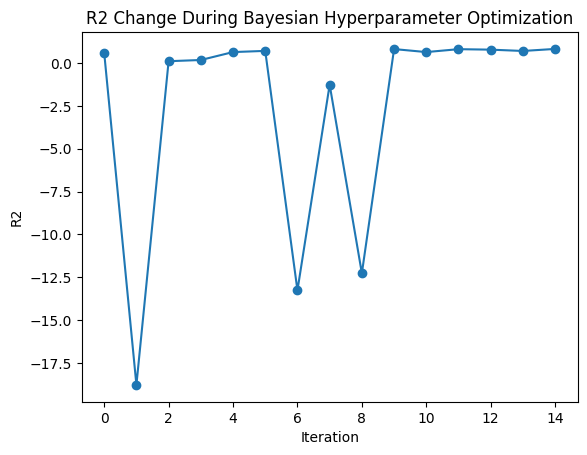

Original Dataset - RMSE: 8.954723203751886, R2: 0.99406739286594, MAE: 5.984669867621524
External Dataset - RMSE: 78.45915985107422, R2: 0.5445627597021074, MAE: 65.00000762939453


In [25]:
# 提取每次迭代的最佳 R2
best_r2_list = []
for res in result.func_vals:
    best_r2_list.append(-res)  # 注意要取负数

# 绘制 R2 的变化过程图
plt.plot(best_r2_list, marker='o')
plt.xlabel('Iteration')
plt.ylabel('R2')
plt.title('R2 Change During Bayesian Hyperparameter Optimization')
plt.show()

import torch
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from sklearn.model_selection import train_test_split

target_column = 'Biogas Production'

# 分离特征和目标变量
X = data.drop(target_column, axis=1)
y = data[target_column]
X_external = external_data.drop(target_column, axis=1)
y_external = external_data[target_column]

# 标准化数据
X_normalized, feature_scaler = normalize_data(X)
y_normalized, target_scaler = normalize_data(y.values.reshape(-1, 1))

# 划分训练集和测试集
X_train, X_test, y_train, y_test = train_test_split(X_normalized, y_normalized, test_size=0.2, random_state=0)

# 转换为 PyTorch 张量
X_train_tensor = torch.from_numpy(X_train).float().to(device)
X_test_tensor = torch.from_numpy(X_test).float().to(device)
y_train_tensor = torch.from_numpy(y_train).float().to(device)
y_test_tensor = torch.from_numpy(y_test).float().to(device)

# 标准化外部数据集
X_external_normalized, _ = normalize_data(X_external)
y_external_normalized, _ = normalize_data(y_external.values.reshape(-1, 1))

# 转换外部数据为张量
X_external_tensor = torch.from_numpy(X_external_normalized).float().to(device)
y_external_tensor = torch.from_numpy(y_external_normalized).float().to(device)

# 模型预测函数
def model_predict(model, X_tensor):
    model.eval()
    with torch.no_grad():
        return model(X_tensor).cpu().numpy()

# 获取预测值
y_pred_train = model_predict(model, X_train_tensor).flatten()
y_pred_test = model_predict(model, X_test_tensor).flatten()
y_pred_external = model_predict(model, X_external_tensor).flatten()

# 反标准化预测值和实际值
y_pred_train_denorm = denormalize_data(y_pred_train.reshape(-1, 1), target_scaler).flatten()
y_pred_test_denorm = denormalize_data(y_pred_test.reshape(-1, 1), target_scaler).flatten()
y_pred_external_denorm = denormalize_data(y_pred_external.reshape(-1, 1), target_scaler).flatten()
y_train_denorm = denormalize_data(y_train, target_scaler).flatten()
y_test_denorm = denormalize_data(y_test, target_scaler).flatten()
y_external_denorm = denormalize_data(y_external_tensor.cpu().numpy(), target_scaler).flatten()


# 合并原始数据集和外部数据集的预测值和实际值
original_data_actual = np.concatenate([y_train_denorm, y_test_denorm])
original_data_predicted = np.concatenate([y_pred_train_denorm, y_pred_test_denorm])
external_data_actual = y_external_denorm
external_data_predicted = y_pred_external_denorm

# 创建 DataFrame
combined_df = pd.DataFrame({
    'Actual': np.concatenate([original_data_actual, external_data_actual]),
    'Predicted': np.concatenate([original_data_predicted, external_data_predicted]),
    'Dataset': ['Original'] * len(original_data_actual) + ['External'] * len(external_data_actual)
})

# 计算原始数据集的指标
train_r2 = r2_score(original_data_actual, original_data_predicted)
train_rmse = mean_squared_error(original_data_actual, original_data_predicted, squared=False)
train_mae = mean_absolute_error(original_data_actual, original_data_predicted)

# 计算外部数据集的指标
external_r2 = r2_score(external_data_actual, external_data_predicted)
external_rmse = mean_squared_error(external_data_actual, external_data_predicted, squared=False)
external_mae = mean_absolute_error(external_data_actual, external_data_predicted)


print(f"Original Dataset - RMSE: {train_rmse}, R2: {train_r2}, MAE: {train_mae}")
print(f"External Dataset - RMSE: {external_rmse}, R2: {external_r2}, MAE: {external_mae}")

Best parameters: [1500, 2.7450186511207334e-09, 8.724523281857752e-06, 0.8, 3.6275967909478318e-06]


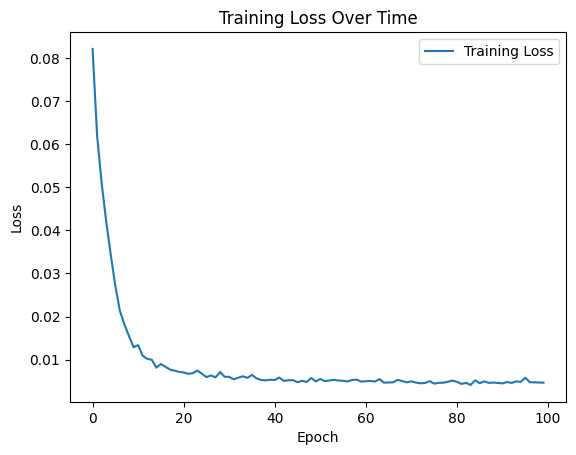

Task Train RMSE: 4.765359401702881, Train R2: 0.9262709936663434, Train MAE: 3.6093521118164062
Task Test RMSE: 4.278372287750244, Test R2: 0.9797160019757206, Test MAE: 3.591561794281006
Task Train RMSE: 4.58211088180542, Train R2: 0.9604138396135532, Train MAE: 3.505139112472534
Task Test RMSE: 5.015584468841553, Test R2: 0.5968735572956849, Test MAE: 4.0084075927734375
Task Train RMSE: 4.6308913230896, Train R2: 0.9521311731821251, Train MAE: 3.557635545730591
Task Test RMSE: 4.833058834075928, Test R2: 0.9417148391241587, Test MAE: 3.7984282970428467
Task Train RMSE: 4.918005466461182, Train R2: 0.9407970897025383, Train MAE: 3.7578659057617188
Task Test RMSE: 3.5202221870422363, Test R2: 0.9779023540418508, Test MAE: 2.997506618499756
Task Train RMSE: 4.450028419494629, Train R2: 0.9603308019402887, Train MAE: 3.598977565765381
Task Test RMSE: 5.470654487609863, Test R2: 0.8417857151897887, Test MAE: 3.633056640625
Task Train RMSE: 4.934354782104492, Train R2: 0.9903824267226318, 

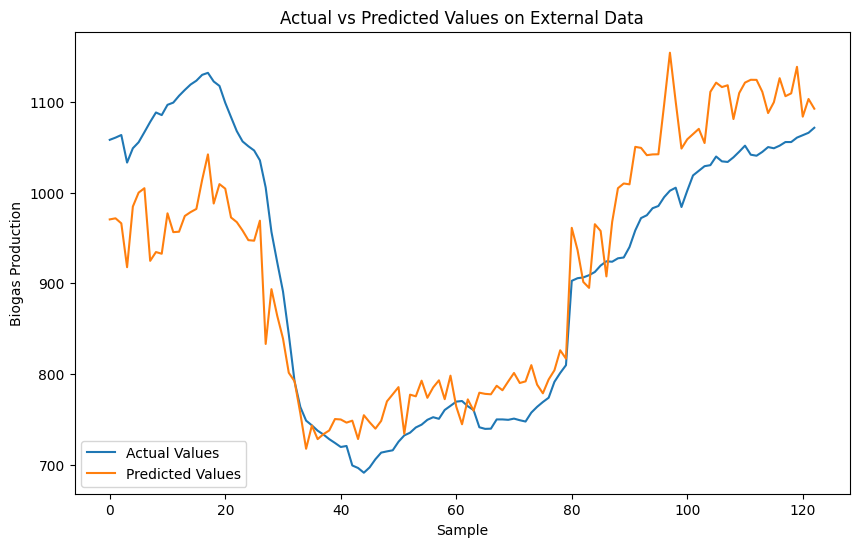

External Dataset - RMSE: 72.06454467773438, R2: 0.759247345789848, MAE: 59.854427337646484


In [26]:
import torch
from torch import nn, optim
import torch.nn.functional as F
import numpy as np
import pandas as pd
from sklearn.preprocessing import StandardScaler
import learn2learn as l2l
from sklearn.model_selection import train_test_split, KFold
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from skopt import gp_minimize
from skopt.space import Real, Integer
from skopt.utils import use_named_args
import matplotlib.pyplot as plt
from torch.utils.data import DataLoader, TensorDataset

# 设置随机种子
np.random.seed(0)
torch.manual_seed(0)

device = torch.device("cuda:0")  # Use GPU 0

# Hyperparameter search space
search_space = [
    Integer(500, 1500, name='hidden_size'), 
    Real(1e-11, 1e-6, "log-uniform", name='alpha'),  
    Real(1e-7, 1e-3, "log-uniform", name='beta'),
    Real(0.1, 0.8, name='dropout_rate'), 
    Real(1e-7, 1e-1, "log-uniform", name='weight_decay') 
]

# Data normalization and denormalization functions
def normalize_data(data):
    scaler = StandardScaler()
    return scaler.fit_transform(data), scaler

def normalize_feature(data, column_name):
    scaler = StandardScaler()
    scaled_data = scaler.fit_transform(data[[column_name]])
    return scaled_data, scaler

def denormalize_data(normalized_data, scaler):
    return scaler.inverse_transform(normalized_data)

# 加载和规范化数据
data = pd.read_csv("C:\\Users\\Lenovo\\Desktop\\元学习\\BT(3)3-1.csv")
data_normalized, scaler = normalize_data(data)

# 假设您的目标列名为'GI(%)'
target_normalized, target_scaler = normalize_data(data[['Biogas Production']].values)
# 元学习模型定义
class AdvancedNeuralNetwork(nn.Module):
    def __init__(self, input_size, hidden_size, dropout_rate):
        super(AdvancedNeuralNetwork, self).__init__()
        self.layer1 = nn.Linear(input_size, hidden_size)
        self.relu1 = nn.LeakyReLU()
        self.layer2 = nn.Linear(hidden_size, hidden_size // 2)
        self.relu2 = nn.LeakyReLU()
        self.layer3 = nn.Linear(hidden_size // 2, hidden_size // 4)
        self.relu3 = nn.LeakyReLU()
        self.dropout = nn.Dropout(dropout_rate)
        self.layer4 = nn.Linear(hidden_size // 4, 1)

    def forward(self, x):
        x = self.relu1(self.layer1(x))
        x = self.relu2(self.layer2(x))
        x = self.relu3(self.layer3(x))
        x = self.dropout(x)
        x = self.layer4(x)
        return x

# 其他辅助函数和类（如EarlyStopping, create_tasks等）根据需要添加
# Task creation function
def create_tasks(data, target_column, num_tasks=50, task_size=100):
    tasks = []
    for _ in range(num_tasks):
        task_data = data.sample(task_size)
        X, y = task_data.drop(target_column, axis=1), task_data[target_column]
        tasks.append((X, y))
    return tasks

# Early stopping class
class EarlyStopping:
    def __init__(self, patience=5, delta=0):
        self.patience = patience
        self.counter = 0
        self.best_score = None
        self.early_stop = False
        self.delta = delta

    def __call__(self, val_loss, model):
        score = -val_loss
        if self.best_score is None:
            self.best_score = score
        elif score < self.best_score + self.delta:
            self.counter += 1
            if self.counter >= self.patience:
                self.early_stop = True
        else:
            self.best_score = score
            self.counter = 0

# GAN的生成器定义
class Generator(nn.Module):
    def __init__(self, input_size, hidden_dim, output_size):
        super(Generator, self).__init__()
        self.fc1 = nn.Linear(input_size, hidden_dim)
        self.fc2 = nn.Linear(hidden_dim, hidden_dim * 2)
        self.fc3 = nn.Linear(hidden_dim * 2, hidden_dim * 4)
        self.fc4 = nn.Linear(hidden_dim * 4, output_size)

    def forward(self, x):
        x = F.leaky_relu(self.fc1(x), 0.2)
        x = F.leaky_relu(self.fc2(x), 0.2)
        x = F.leaky_relu(self.fc3(x), 0.2)
        x = torch.tanh(self.fc4(x))
        return x

# GAN的判别器定义
class Discriminator(nn.Module):
    def __init__(self, input_size, hidden_dim):
        super(Discriminator, self).__init__()
        self.fc1 = nn.Linear(input_size, hidden_dim * 4)
        self.fc2 = nn.Linear(hidden_dim * 4, hidden_dim * 2)
        self.fc3 = nn.Linear(hidden_dim * 2, hidden_dim)
        self.fc4 = nn.Linear(hidden_dim, 1)

    def forward(self, x):
        x = F.leaky_relu(self.fc1(x), 0.2)
        x = F.leaky_relu(self.fc2(x), 0.2)
        x = F.leaky_relu(self.fc3(x), 0.2)
        x = torch.sigmoid(self.fc4(x))
        return x

# MAML fast adaptation and meta-training
def meta_train_maml(model, tasks, alpha, beta, weight_decay, epochs=100, num_steps=1):
    early_stopping = EarlyStopping(patience=10, delta=0.01)
    optimizer = optim.Adam(model.parameters(), lr=beta, weight_decay=weight_decay)
    scheduler = optim.lr_scheduler.CosineAnnealingLR(optimizer, T_max=epochs)

    epoch_loss_list = []  # Initialize a list to store losses for each epoch

    for epoch in range(epochs):
        epoch_losses = []
        for task in tasks:
            learner = model.clone()  # Clone the model
            task_X, task_y = task
            task_X = torch.from_numpy(task_X.values).float().to(device)
            task_y = torch.from_numpy(task_y.values).float().to(device)

            # Fast adaptation
            for step in range(num_steps):
                pred_y = learner(task_X)
                loss = nn.functional.mse_loss(pred_y.squeeze(), task_y)
                learner.adapt(loss)

            # Meta-update
            optimizer.zero_grad()
            pred_y = learner(task_X)
            loss = nn.functional.mse_loss(pred_y.squeeze(), task_y)
            epoch_losses.append(loss.item())
            loss.backward()
            optimizer.step()

        scheduler.step()  # Update learning rate
        average_loss = np.mean(epoch_losses)
        epoch_loss_list.append(average_loss)  # Add each epoch's average loss to the list

        if early_stopping(average_loss, model):
            print(f"Early stopping triggered at epoch {epoch}")
            break

    return epoch_loss_list  # Return the list of epoch losses


@use_named_args(search_space)
def objective(hidden_size, alpha, beta, dropout_rate, weight_decay):
    model = AdvancedNeuralNetwork(input_size, hidden_size, dropout_rate)
    model = l2l.algorithms.MAML(model, lr=alpha).to(device)
    avg_r2 = 0

    task_r2_list = []  # 记录每个任务的 R2

    for task in tasks:
        task_X, task_y = task
        task_X_train, task_X_test, task_y_train, task_y_test = train_test_split(task_X, task_y, test_size=0.2, random_state=0)
        meta_train_maml(model, [(task_X_train, task_y_train)], alpha, beta, weight_decay, epochs=100)
        train_rmse, train_r2, train_mae, test_rmse, test_r2, test_mae = evaluate_model(model, task_X_train, task_y_train, task_X_test, task_y_test, target_scaler)
        task_r2_list.append(test_r2)  # 记录每个任务的测试 R2
        avg_r2 += test_r2

    avg_r2 /= len(tasks)
    return -avg_r2  # 这里返回负数因为 skopt 的目标函数是最小化，而我们想要最大化 R2

# Evaluation function
def evaluate_model(model, X_train, y_train, X_test, y_test, target_scaler):
    model.eval()
    with torch.no_grad():
        # Convert data to tensors
        X_train_tensor = torch.from_numpy(X_train.values).float().to(device)
        y_train_tensor = torch.from_numpy(y_train.values).float().to(device)
        X_test_tensor = torch.from_numpy(X_test.values).float().to(device)
        y_test_tensor = torch.from_numpy(y_test.values).float().to(device)

        # Get predictions
        train_predictions = model(X_train_tensor).squeeze().cpu().numpy()
        test_predictions = model(X_test_tensor).squeeze().cpu().numpy()

        # Reshape predictions for denormalization
        train_predictions_reshaped = train_predictions.reshape(-1, 1)
        test_predictions_reshaped = test_predictions.reshape(-1, 1)

        # Denormalize predictions using target_scaler
        train_predictions_denorm = denormalize_data(train_predictions_reshaped, target_scaler)
        test_predictions_denorm = denormalize_data(test_predictions_reshaped, target_scaler)

        # Denormalize actual values using target_scaler
        y_train_denorm = denormalize_data(y_train_tensor.cpu().numpy().reshape(-1, 1), target_scaler)
        y_test_denorm = denormalize_data(y_test_tensor.cpu().numpy().reshape(-1, 1), target_scaler)

        # Calculate metrics using denormalized data
        train_rmse = mean_squared_error(y_train_denorm, train_predictions_denorm, squared=False)
        train_r2 = r2_score(y_train_denorm, train_predictions_denorm)
        train_mae = mean_absolute_error(y_train_denorm, train_predictions_denorm)

        test_rmse = mean_squared_error(y_test_denorm, test_predictions_denorm, squared=False)
        test_r2 = r2_score(y_test_denorm, test_predictions_denorm)
        test_mae = mean_absolute_error(y_test_denorm, test_predictions_denorm)

    return train_rmse, train_r2, train_mae, test_rmse, test_r2, test_mae

# 设置GAN训练参数
z_dim = 100  # 潜在空间的维度
gen_hidden_dim = 128
dis_hidden_dim = 128
lr = 0.0002
batch_size = 64
num_epochs = 50

# 初始化模型
generator = Generator(z_dim, gen_hidden_dim, data_normalized.shape[1]).to(device)
discriminator = Discriminator(data_normalized.shape[1], dis_hidden_dim).to(device)

# 优化器
optim_g = optim.Adam(generator.parameters(), lr=lr)
optim_d = optim.Adam(discriminator.parameters(), lr=lr)

tensor_data = torch.Tensor(data_normalized)
data_loader = DataLoader(tensor_data, batch_size=batch_size, shuffle=True)

# GAN训练循环
for epoch in range(num_epochs):
    for batch in data_loader:
        current_batch_size = len(batch)  # Get the actual batch size
        real_data = batch.to(device)
        real_labels = torch.ones(current_batch_size, 1).to(device)  # Adjust label size based on batch
        fake_data = generator(torch.randn(current_batch_size, z_dim).to(device))  # Generate fake data based on current batch size
        fake_labels = torch.zeros(current_batch_size, 1).to(device)  # Adjust fake label size

        # 训练判别器
        optim_d.zero_grad()
        real_output = discriminator(real_data)
        fake_output = discriminator(fake_data)
        d_loss_real = nn.BCEWithLogitsLoss()(real_output, real_labels)
        d_loss_fake = nn.BCEWithLogitsLoss()(fake_output, fake_labels)
        d_loss = d_loss_real + d_loss_fake
        d_loss.backward()
        optim_d.step()

        # 训练生成器
        optim_g.zero_grad()
        fake_data = generator(torch.randn(current_batch_size, z_dim).to(device))  # Regenerate fake data
        fake_output = discriminator(fake_data)
        g_loss = nn.BCEWithLogitsLoss()(fake_output, real_labels)  # Use real_labels here
        g_loss.backward()
        optim_g.step()

# 假设您想生成一定数量的新样本
number_of_generated_samples = 500

# 生成新的数据样本
generated_samples = []
for _ in range(number_of_generated_samples):
    z = torch.randn(1, z_dim).to(device)
    generated_sample = generator(z).detach().cpu().numpy()
    generated_samples.append(generated_sample.reshape(-1))

generated_samples = np.array(generated_samples)

# 将生成的样本合并到现有数据中
extended_data = np.vstack([data_normalized, generated_samples])

# 创建增强的数据集任务
# 这里假设您已经定义了创建任务的函数
input_size = data.shape[1] - 1 
tasks = create_tasks(pd.DataFrame(extended_data, columns=data.columns), target_column='Biogas Production')
# Execute hyperparameter optimization
result = gp_minimize(objective, search_space, n_calls=15,random_state=0)
hidden_size, alpha, beta, dropout_rate, weight_decay = result.x
print("Best parameters:", result.x)

# Train model with optimized hyperparameters
model = AdvancedNeuralNetwork(input_size, hidden_size, dropout_rate)
model = l2l.algorithms.MAML(model, lr=alpha).to(device)
train_losses = meta_train_maml(model, tasks, alpha, beta, weight_decay, epochs=100)

# Visualize training losses
plt.plot(train_losses, label='Training Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training Loss Over Time')
plt.legend()
plt.show()

# Final model evaluation
for task in tasks:
    X, y = task
    kf = KFold(n_splits=5, shuffle=True, random_state=0)
    for train_index, test_index in kf.split(X):
        X_train, X_test = X.iloc[train_index], X.iloc[test_index]
        y_train, y_test = y.iloc[train_index], y.iloc[test_index]
        train_rmse, train_r2, train_mae, test_rmse, test_r2, test_mae = evaluate_model(model, X_train, y_train, X_test, y_test, target_scaler)
        print(f"Task Train RMSE: {train_rmse}, Train R2: {train_r2}, Train MAE: {train_mae}")
        print(f"Task Test RMSE: {test_rmse}, Test R2: {test_r2}, Test MAE: {test_mae}")
# Load and process external data for evaluation
external_data = pd.read_csv("C:\\Users\\Lenovo\\Desktop\\元学习\\BT(3)3-2.csv")
external_data_normalized, _ = normalize_data(external_data)
external_target_normalized, _ = normalize_feature(external_data, 'Biogas Production')
external_X = torch.from_numpy(pd.DataFrame(external_data_normalized, columns=external_data.columns).drop('Biogas Production', axis=1).values).float().to(device)
external_y_normalized = torch.from_numpy(external_target_normalized).float().to(device)

# Model prediction on external data
learner = model.clone()  # Clone the model for evaluation
learner.eval()
with torch.no_grad():
    external_predictions_normalized = learner(external_X).squeeze()
external_predictions = denormalize_data(external_predictions_normalized.cpu().numpy().reshape(-1, 1), target_scaler)
external_y = denormalize_data(external_y_normalized.cpu().numpy().reshape(-1, 1), target_scaler)

# Visualization of predictions on external data
plt.figure(figsize=(10, 6))
plt.plot(external_y, label='Actual Values')
plt.plot(external_predictions, label='Predicted Values')
plt.xlabel('Sample')
plt.ylabel('Biogas Production')
plt.title('Actual vs Predicted Values on External Data')
plt.legend()
plt.show()

# Evaluate on external dataset using denormalized data
external_rmse = mean_squared_error(external_y, external_predictions, squared=False)
external_r2 = r2_score(external_y, external_predictions)
external_mae = mean_absolute_error(external_y, external_predictions)

print(f"External Dataset - RMSE: {external_rmse}, R2: {external_r2}, MAE: {external_mae}")

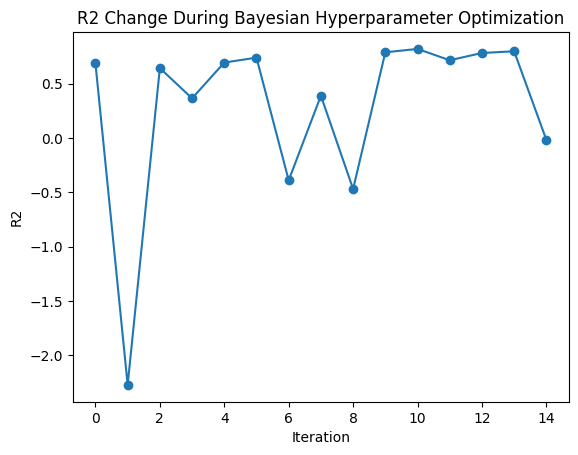

Original Dataset - RMSE: 8.42236495221555, R2: 0.9967115141120811, MAE: 6.1689834512246575
External Dataset - RMSE: 72.06454467773438, R2: 0.759247345789848, MAE: 59.854427337646484


In [27]:
# 提取每次迭代的最佳 R2
best_r2_list = []
for res in result.func_vals:
    best_r2_list.append(-res)  # 注意要取负数

# 绘制 R2 的变化过程图
plt.plot(best_r2_list, marker='o')
plt.xlabel('Iteration')
plt.ylabel('R2')
plt.title('R2 Change During Bayesian Hyperparameter Optimization')
plt.show()

import torch
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from sklearn.model_selection import train_test_split

target_column = 'Biogas Production'

# 分离特征和目标变量
X = data.drop(target_column, axis=1)
y = data[target_column]
X_external = external_data.drop(target_column, axis=1)
y_external = external_data[target_column]

# 标准化数据
X_normalized, feature_scaler = normalize_data(X)
y_normalized, target_scaler = normalize_data(y.values.reshape(-1, 1))

# 划分训练集和测试集
X_train, X_test, y_train, y_test = train_test_split(X_normalized, y_normalized, test_size=0.2, random_state=0)

# 转换为 PyTorch 张量
X_train_tensor = torch.from_numpy(X_train).float().to(device)
X_test_tensor = torch.from_numpy(X_test).float().to(device)
y_train_tensor = torch.from_numpy(y_train).float().to(device)
y_test_tensor = torch.from_numpy(y_test).float().to(device)

# 标准化外部数据集
X_external_normalized, _ = normalize_data(X_external)
y_external_normalized, _ = normalize_data(y_external.values.reshape(-1, 1))

# 转换外部数据为张量
X_external_tensor = torch.from_numpy(X_external_normalized).float().to(device)
y_external_tensor = torch.from_numpy(y_external_normalized).float().to(device)

# 模型预测函数
def model_predict(model, X_tensor):
    model.eval()
    with torch.no_grad():
        return model(X_tensor).cpu().numpy()

# 获取预测值
y_pred_train = model_predict(model, X_train_tensor).flatten()
y_pred_test = model_predict(model, X_test_tensor).flatten()
y_pred_external = model_predict(model, X_external_tensor).flatten()

# 反标准化预测值和实际值
y_pred_train_denorm = denormalize_data(y_pred_train.reshape(-1, 1), target_scaler).flatten()
y_pred_test_denorm = denormalize_data(y_pred_test.reshape(-1, 1), target_scaler).flatten()
y_pred_external_denorm = denormalize_data(y_pred_external.reshape(-1, 1), target_scaler).flatten()
y_train_denorm = denormalize_data(y_train, target_scaler).flatten()
y_test_denorm = denormalize_data(y_test, target_scaler).flatten()
y_external_denorm = denormalize_data(y_external_tensor.cpu().numpy(), target_scaler).flatten()


# 合并原始数据集和外部数据集的预测值和实际值
original_data_actual = np.concatenate([y_train_denorm, y_test_denorm])
original_data_predicted = np.concatenate([y_pred_train_denorm, y_pred_test_denorm])
external_data_actual = y_external_denorm
external_data_predicted = y_pred_external_denorm

# 创建 DataFrame
combined_df = pd.DataFrame({
    'Actual': np.concatenate([original_data_actual, external_data_actual]),
    'Predicted': np.concatenate([original_data_predicted, external_data_predicted]),
    'Dataset': ['Original'] * len(original_data_actual) + ['External'] * len(external_data_actual)
})

# 计算原始数据集的指标
train_r2 = r2_score(original_data_actual, original_data_predicted)
train_rmse = mean_squared_error(original_data_actual, original_data_predicted, squared=False)
train_mae = mean_absolute_error(original_data_actual, original_data_predicted)

# 计算外部数据集的指标
external_r2 = r2_score(external_data_actual, external_data_predicted)
external_rmse = mean_squared_error(external_data_actual, external_data_predicted, squared=False)
external_mae = mean_absolute_error(external_data_actual, external_data_predicted)


print(f"Original Dataset - RMSE: {train_rmse}, R2: {train_r2}, MAE: {train_mae}")
print(f"External Dataset - RMSE: {external_rmse}, R2: {external_r2}, MAE: {external_mae}")

Best parameters: [1500, 1e-11, 3.41330838893865e-05, 0.8, 1e-07]


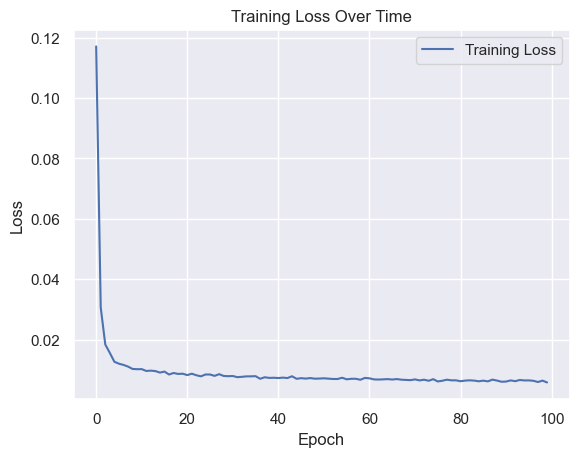

Task Train RMSE: 5.6749773025512695, Train R2: 0.9696364647343214, Train MAE: 4.4700026512146
Task Test RMSE: 7.343186855316162, Test R2: 0.9968286539025729, Test MAE: 6.308197021484375
Task Train RMSE: 5.949646472930908, Train R2: 0.9932211471466367, Train MAE: 4.821725368499756
Task Test RMSE: 6.414889335632324, Test R2: 0.9630580625804872, Test MAE: 4.90130615234375
Task Train RMSE: 6.087095737457275, Train R2: 0.9924734406171357, Train MAE: 4.831835746765137
Task Test RMSE: 5.87648868560791, Test R2: 0.9858486433105675, Test MAE: 4.860870361328125
Task Train RMSE: 6.328038692474365, Train R2: 0.9926789085040685, Train MAE: 5.04302978515625
Task Test RMSE: 4.750548839569092, Test R2: 0.9041100030443504, Test MAE: 4.016088962554932
Task Train RMSE: 6.167944431304932, Train R2: 0.9929502814283933, Train MAE: 5.021614074707031
Task Test RMSE: 5.529001712799072, Test R2: 0.9004419645327523, Test MAE: 4.101751804351807
Task Train RMSE: 5.899846076965332, Train R2: 0.9708420531455215, Tra

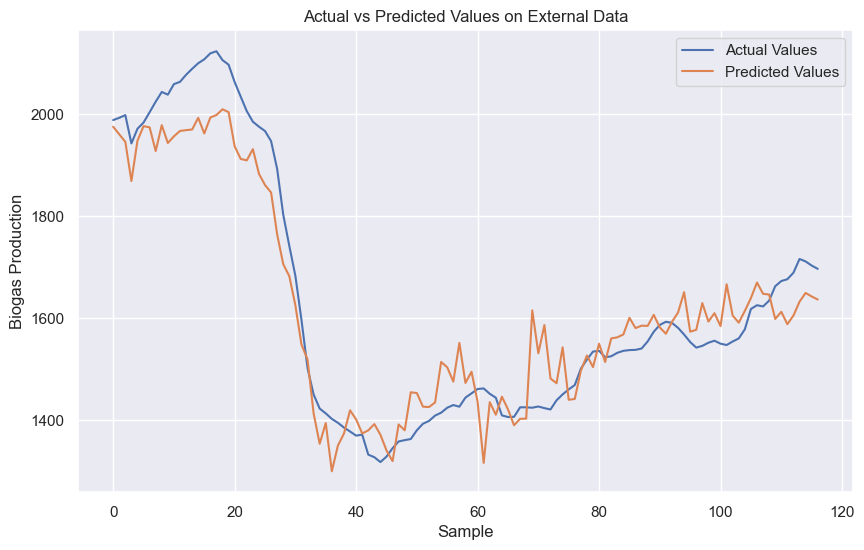

External Dataset - RMSE: 69.80731201171875, R2: 0.9196025467271371, MAE: 57.4128303527832


In [47]:
import torch
from torch import nn, optim
import torch.nn.functional as F
import numpy as np
import pandas as pd
from sklearn.preprocessing import StandardScaler
import learn2learn as l2l
from sklearn.model_selection import train_test_split, KFold
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from skopt import gp_minimize
from skopt.space import Real, Integer
from skopt.utils import use_named_args
import matplotlib.pyplot as plt
from torch.utils.data import DataLoader, TensorDataset

# 设置随机种子
np.random.seed(0)
torch.manual_seed(0)

device = torch.device("cuda:0")  # Use GPU 0

# Hyperparameter search space
search_space = [
    Integer(500, 1500, name='hidden_size'), 
    Real(1e-11, 1e-6, "log-uniform", name='alpha'),  
    Real(1e-7, 1e-3, "log-uniform", name='beta'),
    Real(0.1, 0.8, name='dropout_rate'), 
    Real(1e-7, 1e-1, "log-uniform", name='weight_decay') 
]

# Data normalization and denormalization functions
def normalize_data(data):
    scaler = StandardScaler()
    return scaler.fit_transform(data), scaler

def normalize_feature(data, column_name):
    scaler = StandardScaler()
    scaled_data = scaler.fit_transform(data[[column_name]])
    return scaled_data, scaler

def denormalize_data(normalized_data, scaler):
    return scaler.inverse_transform(normalized_data)

# 加载和规范化数据
data = pd.read_csv("C:\\Users\\Lenovo\\Desktop\\元学习\\BT(3)4-1.csv")
data_normalized, scaler = normalize_data(data)

# 假设您的目标列名为'GI(%)'
target_normalized, target_scaler = normalize_data(data[['Biogas Production']].values)
# 元学习模型定义
class AdvancedNeuralNetwork(nn.Module):
    def __init__(self, input_size, hidden_size, dropout_rate):
        super(AdvancedNeuralNetwork, self).__init__()
        self.layer1 = nn.Linear(input_size, hidden_size)
        self.relu1 = nn.LeakyReLU()
        self.layer2 = nn.Linear(hidden_size, hidden_size // 2)
        self.relu2 = nn.LeakyReLU()
        self.layer3 = nn.Linear(hidden_size // 2, hidden_size // 4)
        self.relu3 = nn.LeakyReLU()
        self.dropout = nn.Dropout(dropout_rate)
        self.layer4 = nn.Linear(hidden_size // 4, 1)

    def forward(self, x):
        x = self.relu1(self.layer1(x))
        x = self.relu2(self.layer2(x))
        x = self.relu3(self.layer3(x))
        x = self.dropout(x)
        x = self.layer4(x)
        return x

# 其他辅助函数和类（如EarlyStopping, create_tasks等）根据需要添加
# Task creation function
def create_tasks(data, target_column, num_tasks=50, task_size=100):
    tasks = []
    for _ in range(num_tasks):
        task_data = data.sample(task_size)
        X, y = task_data.drop(target_column, axis=1), task_data[target_column]
        tasks.append((X, y))
    return tasks

# Early stopping class
class EarlyStopping:
    def __init__(self, patience=5, delta=0):
        self.patience = patience
        self.counter = 0
        self.best_score = None
        self.early_stop = False
        self.delta = delta

    def __call__(self, val_loss, model):
        score = -val_loss
        if self.best_score is None:
            self.best_score = score
        elif score < self.best_score + self.delta:
            self.counter += 1
            if self.counter >= self.patience:
                self.early_stop = True
        else:
            self.best_score = score
            self.counter = 0

# GAN的生成器定义
class Generator(nn.Module):
    def __init__(self, input_size, hidden_dim, output_size):
        super(Generator, self).__init__()
        self.fc1 = nn.Linear(input_size, hidden_dim)
        self.fc2 = nn.Linear(hidden_dim, hidden_dim * 2)
        self.fc3 = nn.Linear(hidden_dim * 2, hidden_dim * 4)
        self.fc4 = nn.Linear(hidden_dim * 4, output_size)

    def forward(self, x):
        x = F.leaky_relu(self.fc1(x), 0.2)
        x = F.leaky_relu(self.fc2(x), 0.2)
        x = F.leaky_relu(self.fc3(x), 0.2)
        x = torch.tanh(self.fc4(x))
        return x

# GAN的判别器定义
class Discriminator(nn.Module):
    def __init__(self, input_size, hidden_dim):
        super(Discriminator, self).__init__()
        self.fc1 = nn.Linear(input_size, hidden_dim * 4)
        self.fc2 = nn.Linear(hidden_dim * 4, hidden_dim * 2)
        self.fc3 = nn.Linear(hidden_dim * 2, hidden_dim)
        self.fc4 = nn.Linear(hidden_dim, 1)

    def forward(self, x):
        x = F.leaky_relu(self.fc1(x), 0.2)
        x = F.leaky_relu(self.fc2(x), 0.2)
        x = F.leaky_relu(self.fc3(x), 0.2)
        x = torch.sigmoid(self.fc4(x))
        return x

# MAML fast adaptation and meta-training
def meta_train_maml(model, tasks, alpha, beta, weight_decay, epochs=100, num_steps=1):
    early_stopping = EarlyStopping(patience=10, delta=0.01)
    optimizer = optim.Adam(model.parameters(), lr=beta, weight_decay=weight_decay)
    scheduler = optim.lr_scheduler.CosineAnnealingLR(optimizer, T_max=epochs)

    epoch_loss_list = []  # Initialize a list to store losses for each epoch

    for epoch in range(epochs):
        epoch_losses = []
        for task in tasks:
            learner = model.clone()  # Clone the model
            task_X, task_y = task
            task_X = torch.from_numpy(task_X.values).float().to(device)
            task_y = torch.from_numpy(task_y.values).float().to(device)

            # Fast adaptation
            for step in range(num_steps):
                pred_y = learner(task_X)
                loss = nn.functional.mse_loss(pred_y.squeeze(), task_y)
                learner.adapt(loss)

            # Meta-update
            optimizer.zero_grad()
            pred_y = learner(task_X)
            loss = nn.functional.mse_loss(pred_y.squeeze(), task_y)
            epoch_losses.append(loss.item())
            loss.backward()
            optimizer.step()

        scheduler.step()  # Update learning rate
        average_loss = np.mean(epoch_losses)
        epoch_loss_list.append(average_loss)  # Add each epoch's average loss to the list

        if early_stopping(average_loss, model):
            print(f"Early stopping triggered at epoch {epoch}")
            break

    return epoch_loss_list  # Return the list of epoch losses



@use_named_args(search_space)
def objective(hidden_size, alpha, beta, dropout_rate, weight_decay):
    model = AdvancedNeuralNetwork(input_size, hidden_size, dropout_rate)
    model = l2l.algorithms.MAML(model, lr=alpha).to(device)
    avg_r2 = 0

    task_r2_list = []  # 记录每个任务的 R2

    for task in tasks:
        task_X, task_y = task
        task_X_train, task_X_test, task_y_train, task_y_test = train_test_split(task_X, task_y, test_size=0.2, random_state=0)
        meta_train_maml(model, [(task_X_train, task_y_train)], alpha, beta, weight_decay, epochs=100)
        train_rmse, train_r2, train_mae, test_rmse, test_r2, test_mae = evaluate_model(model, task_X_train, task_y_train, task_X_test, task_y_test, target_scaler)
        task_r2_list.append(test_r2)  # 记录每个任务的测试 R2
        avg_r2 += test_r2

    avg_r2 /= len(tasks)
    return -avg_r2  # 这里返回负数因为 skopt 的目标函数是最小化，而我们想要最大化 R2

# Evaluation function
def evaluate_model(model, X_train, y_train, X_test, y_test, target_scaler):
    model.eval()
    with torch.no_grad():
        # Convert data to tensors
        X_train_tensor = torch.from_numpy(X_train.values).float().to(device)
        y_train_tensor = torch.from_numpy(y_train.values).float().to(device)
        X_test_tensor = torch.from_numpy(X_test.values).float().to(device)
        y_test_tensor = torch.from_numpy(y_test.values).float().to(device)

        # Get predictions
        train_predictions = model(X_train_tensor).squeeze().cpu().numpy()
        test_predictions = model(X_test_tensor).squeeze().cpu().numpy()

        # Reshape predictions for denormalization
        train_predictions_reshaped = train_predictions.reshape(-1, 1)
        test_predictions_reshaped = test_predictions.reshape(-1, 1)

        # Denormalize predictions using target_scaler
        train_predictions_denorm = denormalize_data(train_predictions_reshaped, target_scaler)
        test_predictions_denorm = denormalize_data(test_predictions_reshaped, target_scaler)

        # Denormalize actual values using target_scaler
        y_train_denorm = denormalize_data(y_train_tensor.cpu().numpy().reshape(-1, 1), target_scaler)
        y_test_denorm = denormalize_data(y_test_tensor.cpu().numpy().reshape(-1, 1), target_scaler)

        # Calculate metrics using denormalized data
        train_rmse = mean_squared_error(y_train_denorm, train_predictions_denorm, squared=False)
        train_r2 = r2_score(y_train_denorm, train_predictions_denorm)
        train_mae = mean_absolute_error(y_train_denorm, train_predictions_denorm)

        test_rmse = mean_squared_error(y_test_denorm, test_predictions_denorm, squared=False)
        test_r2 = r2_score(y_test_denorm, test_predictions_denorm)
        test_mae = mean_absolute_error(y_test_denorm, test_predictions_denorm)

    return train_rmse, train_r2, train_mae, test_rmse, test_r2, test_mae

# 设置GAN训练参数
z_dim = 100  # 潜在空间的维度
gen_hidden_dim = 128
dis_hidden_dim = 128
lr = 0.0002
batch_size = 64
num_epochs = 50

# 初始化模型
generator = Generator(z_dim, gen_hidden_dim, data_normalized.shape[1]).to(device)
discriminator = Discriminator(data_normalized.shape[1], dis_hidden_dim).to(device)

# 优化器
optim_g = optim.Adam(generator.parameters(), lr=lr)
optim_d = optim.Adam(discriminator.parameters(), lr=lr)

tensor_data = torch.Tensor(data_normalized)
data_loader = DataLoader(tensor_data, batch_size=batch_size, shuffle=True)

# GAN训练循环
for epoch in range(num_epochs):
    for batch in data_loader:
        current_batch_size = len(batch)  # Get the actual batch size
        real_data = batch.to(device)
        real_labels = torch.ones(current_batch_size, 1).to(device)  # Adjust label size based on batch
        fake_data = generator(torch.randn(current_batch_size, z_dim).to(device))  # Generate fake data based on current batch size
        fake_labels = torch.zeros(current_batch_size, 1).to(device)  # Adjust fake label size

        # 训练判别器
        optim_d.zero_grad()
        real_output = discriminator(real_data)
        fake_output = discriminator(fake_data)
        d_loss_real = nn.BCEWithLogitsLoss()(real_output, real_labels)
        d_loss_fake = nn.BCEWithLogitsLoss()(fake_output, fake_labels)
        d_loss = d_loss_real + d_loss_fake
        d_loss.backward()
        optim_d.step()

        # 训练生成器
        optim_g.zero_grad()
        fake_data = generator(torch.randn(current_batch_size, z_dim).to(device))  # Regenerate fake data
        fake_output = discriminator(fake_data)
        g_loss = nn.BCEWithLogitsLoss()(fake_output, real_labels)  # Use real_labels here
        g_loss.backward()
        optim_g.step()

# 假设您想生成一定数量的新样本
number_of_generated_samples = 500

# 生成新的数据样本
generated_samples = []
for _ in range(number_of_generated_samples):
    z = torch.randn(1, z_dim).to(device)
    generated_sample = generator(z).detach().cpu().numpy()
    generated_samples.append(generated_sample.reshape(-1))

generated_samples = np.array(generated_samples)

# 将生成的样本合并到现有数据中
extended_data = np.vstack([data_normalized, generated_samples])

# 创建增强的数据集任务
# 这里假设您已经定义了创建任务的函数
input_size = data.shape[1] - 1 
tasks = create_tasks(pd.DataFrame(extended_data, columns=data.columns), target_column='Biogas Production')
# Execute hyperparameter optimization
result = gp_minimize(objective, search_space, n_calls=15,random_state=0)
hidden_size, alpha, beta, dropout_rate, weight_decay = result.x
print("Best parameters:", result.x)

# Train model with optimized hyperparameters
model = AdvancedNeuralNetwork(input_size, hidden_size, dropout_rate)
model = l2l.algorithms.MAML(model, lr=alpha).to(device)
train_losses = meta_train_maml(model, tasks, alpha, beta, weight_decay, epochs=100)

# Visualize training losses
plt.plot(train_losses, label='Training Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training Loss Over Time')
plt.legend()
plt.show()

# Final model evaluation
for task in tasks:
    X, y = task
    kf = KFold(n_splits=5, shuffle=True, random_state=0)
    for train_index, test_index in kf.split(X):
        X_train, X_test = X.iloc[train_index], X.iloc[test_index]
        y_train, y_test = y.iloc[train_index], y.iloc[test_index]
        train_rmse, train_r2, train_mae, test_rmse, test_r2, test_mae = evaluate_model(model, X_train, y_train, X_test, y_test, target_scaler)
        print(f"Task Train RMSE: {train_rmse}, Train R2: {train_r2}, Train MAE: {train_mae}")
        print(f"Task Test RMSE: {test_rmse}, Test R2: {test_r2}, Test MAE: {test_mae}")
# Load and process external data for evaluation
external_data = pd.read_csv("C:\\Users\\Lenovo\\Desktop\\元学习\\BT(3)4-2.csv")
external_data_normalized, _ = normalize_data(external_data)
external_target_normalized, _ = normalize_feature(external_data, 'Biogas Production')
external_X = torch.from_numpy(pd.DataFrame(external_data_normalized, columns=external_data.columns).drop('Biogas Production', axis=1).values).float().to(device)
external_y_normalized = torch.from_numpy(external_target_normalized).float().to(device)

# Model prediction on external data
learner = model.clone()  # Clone the model for evaluation
learner.eval()
with torch.no_grad():
    external_predictions_normalized = learner(external_X).squeeze()
external_predictions = denormalize_data(external_predictions_normalized.cpu().numpy().reshape(-1, 1), target_scaler)
external_y = denormalize_data(external_y_normalized.cpu().numpy().reshape(-1, 1), target_scaler)

# Visualization of predictions on external data
plt.figure(figsize=(10, 6))
plt.plot(external_y, label='Actual Values')
plt.plot(external_predictions, label='Predicted Values')
plt.xlabel('Sample')
plt.ylabel('Biogas Production')
plt.title('Actual vs Predicted Values on External Data')
plt.legend()
plt.show()

# Evaluate on external dataset using denormalized data
external_rmse = mean_squared_error(external_y, external_predictions, squared=False)
external_r2 = r2_score(external_y, external_predictions)
external_mae = mean_absolute_error(external_y, external_predictions)

print(f"External Dataset - RMSE: {external_rmse}, R2: {external_r2}, MAE: {external_mae}")

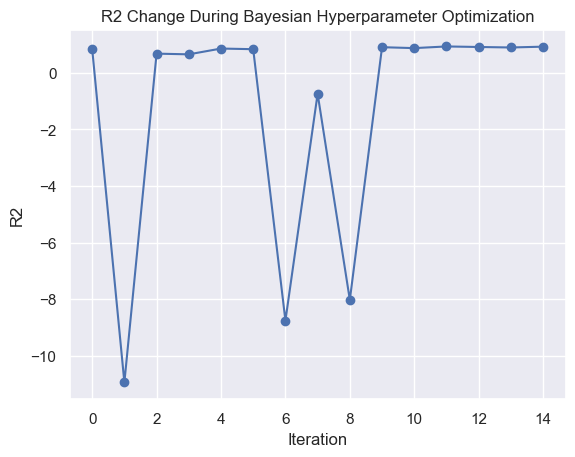

Original Dataset - RMSE: 6.377230762216218, R2: 0.9993290274866268, MAE: 5.584145053597383
External Dataset - RMSE: 69.80731201171875, R2: 0.9196025467271371, MAE: 57.4128303527832


In [48]:
# 提取每次迭代的最佳 R2
best_r2_list = []
for res in result.func_vals:
    best_r2_list.append(-res)  # 注意要取负数

# 绘制 R2 的变化过程图
plt.plot(best_r2_list, marker='o')
plt.xlabel('Iteration')
plt.ylabel('R2')
plt.title('R2 Change During Bayesian Hyperparameter Optimization')
plt.show()

import torch
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from sklearn.model_selection import train_test_split

target_column = 'Biogas Production'

# 分离特征和目标变量
X = data.drop(target_column, axis=1)
y = data[target_column]
X_external = external_data.drop(target_column, axis=1)
y_external = external_data[target_column]

# 标准化数据
X_normalized, feature_scaler = normalize_data(X)
y_normalized, target_scaler = normalize_data(y.values.reshape(-1, 1))

# 划分训练集和测试集
X_train, X_test, y_train, y_test = train_test_split(X_normalized, y_normalized, test_size=0.2, random_state=0)

# 转换为 PyTorch 张量
X_train_tensor = torch.from_numpy(X_train).float().to(device)
X_test_tensor = torch.from_numpy(X_test).float().to(device)
y_train_tensor = torch.from_numpy(y_train).float().to(device)
y_test_tensor = torch.from_numpy(y_test).float().to(device)

# 标准化外部数据集
X_external_normalized, _ = normalize_data(X_external)
y_external_normalized, _ = normalize_data(y_external.values.reshape(-1, 1))

# 转换外部数据为张量
X_external_tensor = torch.from_numpy(X_external_normalized).float().to(device)
y_external_tensor = torch.from_numpy(y_external_normalized).float().to(device)

# 模型预测函数
def model_predict(model, X_tensor):
    model.eval()
    with torch.no_grad():
        return model(X_tensor).cpu().numpy()

# 获取预测值
y_pred_train = model_predict(model, X_train_tensor).flatten()
y_pred_test = model_predict(model, X_test_tensor).flatten()
y_pred_external = model_predict(model, X_external_tensor).flatten()

# 反标准化预测值和实际值
y_pred_train_denorm = denormalize_data(y_pred_train.reshape(-1, 1), target_scaler).flatten()
y_pred_test_denorm = denormalize_data(y_pred_test.reshape(-1, 1), target_scaler).flatten()
y_pred_external_denorm = denormalize_data(y_pred_external.reshape(-1, 1), target_scaler).flatten()
y_train_denorm = denormalize_data(y_train, target_scaler).flatten()
y_test_denorm = denormalize_data(y_test, target_scaler).flatten()
y_external_denorm = denormalize_data(y_external_tensor.cpu().numpy(), target_scaler).flatten()


# 合并原始数据集和外部数据集的预测值和实际值
original_data_actual = np.concatenate([y_train_denorm, y_test_denorm])
original_data_predicted = np.concatenate([y_pred_train_denorm, y_pred_test_denorm])
external_data_actual = y_external_denorm
external_data_predicted = y_pred_external_denorm

# 创建 DataFrame
combined_df = pd.DataFrame({
    'Actual': np.concatenate([original_data_actual, external_data_actual]),
    'Predicted': np.concatenate([original_data_predicted, external_data_predicted]),
    'Dataset': ['Original'] * len(original_data_actual) + ['External'] * len(external_data_actual)
})

# 计算原始数据集的指标
train_r2 = r2_score(original_data_actual, original_data_predicted)
train_rmse = mean_squared_error(original_data_actual, original_data_predicted, squared=False)
train_mae = mean_absolute_error(original_data_actual, original_data_predicted)

# 计算外部数据集的指标
external_r2 = r2_score(external_data_actual, external_data_predicted)
external_rmse = mean_squared_error(external_data_actual, external_data_predicted, squared=False)
external_mae = mean_absolute_error(external_data_actual, external_data_predicted)


print(f"Original Dataset - RMSE: {train_rmse}, R2: {train_r2}, MAE: {train_mae}")
print(f"External Dataset - RMSE: {external_rmse}, R2: {external_r2}, MAE: {external_mae}")

传统机器学习算法

1.三部分样本用于训练

e:\anaconda\envs\yuanxuexi2\lib\site-packages\skopt\optimizer\optimizer.py:449: UserWarning: The objective has been evaluated at this point before.
  warnings.warn("The objective has been evaluated "
e:\anaconda\envs\yuanxuexi2\lib\site-packages\skopt\optimizer\optimizer.py:449: UserWarning: The objective has been evaluated at this point before.
  warnings.warn("The objective has been evaluated "
e:\anaconda\envs\yuanxuexi2\lib\site-packages\skopt\optimizer\optimizer.py:449: UserWarning: The objective has been evaluated at this point before.
  warnings.warn("The objective has been evaluated "
e:\anaconda\envs\yuanxuexi2\lib\site-packages\skopt\optimizer\optimizer.py:449: UserWarning: The objective has been evaluated at this point before.
  warnings.warn("The objective has been evaluated "
e:\anaconda\envs\yuanxuexi2\lib\site-packages\skopt\optimizer\optimizer.py:449: UserWarning: The objective has been evaluated at this point before.
  warnings.warn("The objective has been evaluated "


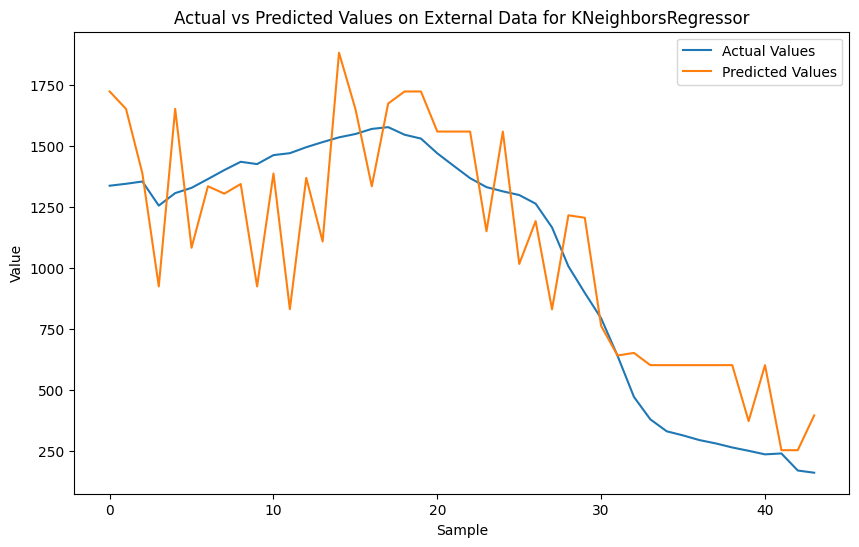

Model: KNeighborsRegressor
Train RMSE: 35.66518143959968 Train R2: 0.9952293127963956 Train MAE: 22.973315217391306
Test RMSE: 65.14938233590553 Test R2: 0.98028926739366 Test MAE: 51.12416666666667
External RMSE: 257.8283669355454 External R2: 0.7421949217328703 External MAE: 218.40249720794293
--------------------------------------------------
Original Dataset - RMSE: 43.43952234934973, R2: 0.9926818694178087, MAE: 28.797629310344828
External Dataset - RMSE: 257.8283669355454, R2: 0.7421949217328703, MAE: 218.40249720794293


e:\anaconda\envs\yuanxuexi2\lib\site-packages\skopt\optimizer\optimizer.py:449: UserWarning: The objective has been evaluated at this point before.
  warnings.warn("The objective has been evaluated "


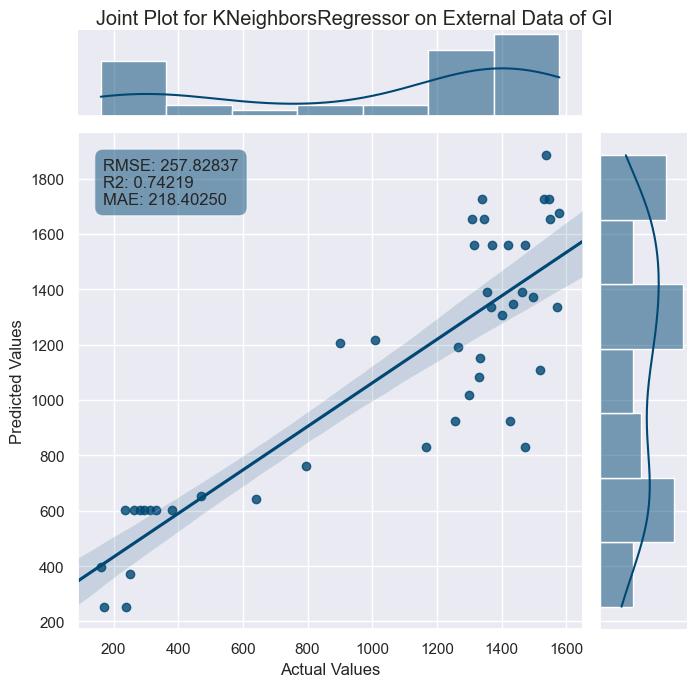

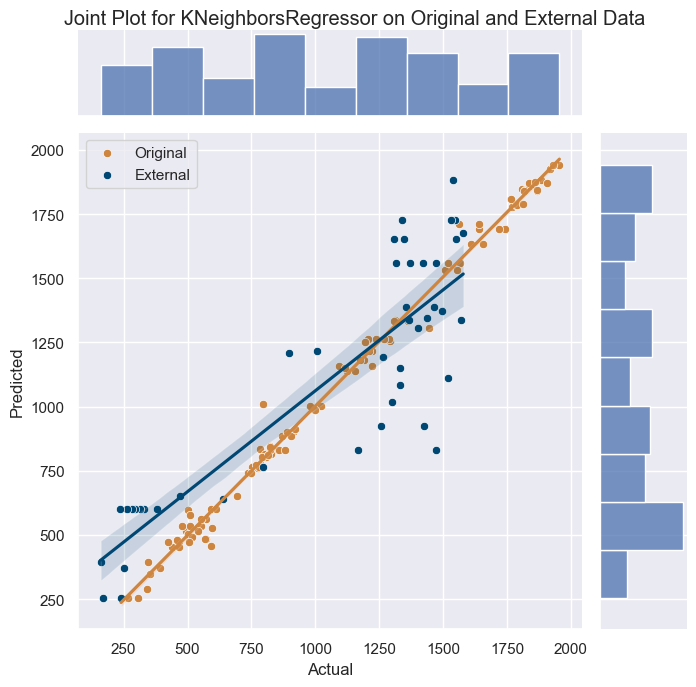

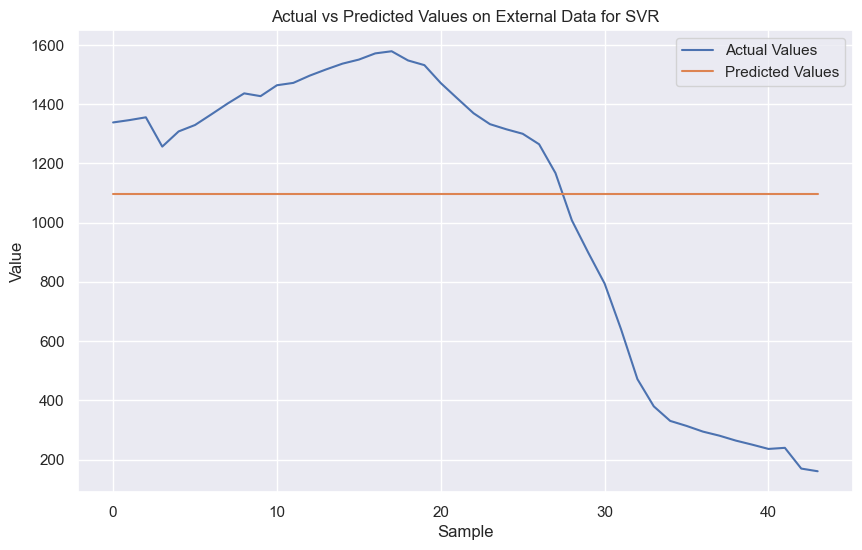

Model: SVR
Train RMSE: 516.991803022438 Train R2: -0.002442293830409392 Train MAE: 455.5770652173913
Test RMSE: 482.24972458519875 Test R2: -0.08000592406597318 Test MAE: 427.64791666666673
External RMSE: 509.9980000704533 External R2: -0.008711607240001973 External MAE: 444.7399559024629
--------------------------------------------------
Original Dataset - RMSE: 509.99800007045326, R2: -0.008711607240001973, MAE: 449.7986206896552
External Dataset - RMSE: 509.9980000704533, R2: -0.008711607240001973, MAE: 444.7399559024629


e:\anaconda\envs\yuanxuexi2\lib\site-packages\skopt\optimizer\optimizer.py:449: UserWarning: The objective has been evaluated at this point before.
  warnings.warn("The objective has been evaluated "


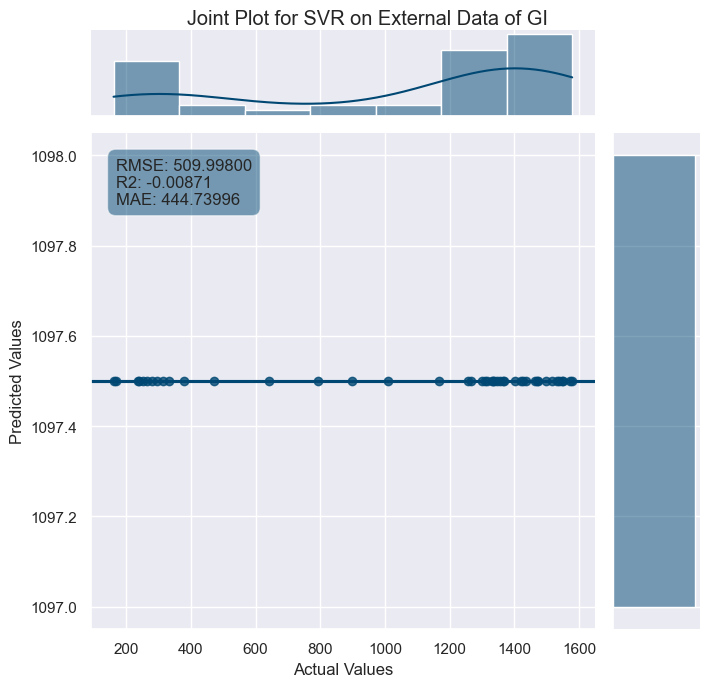

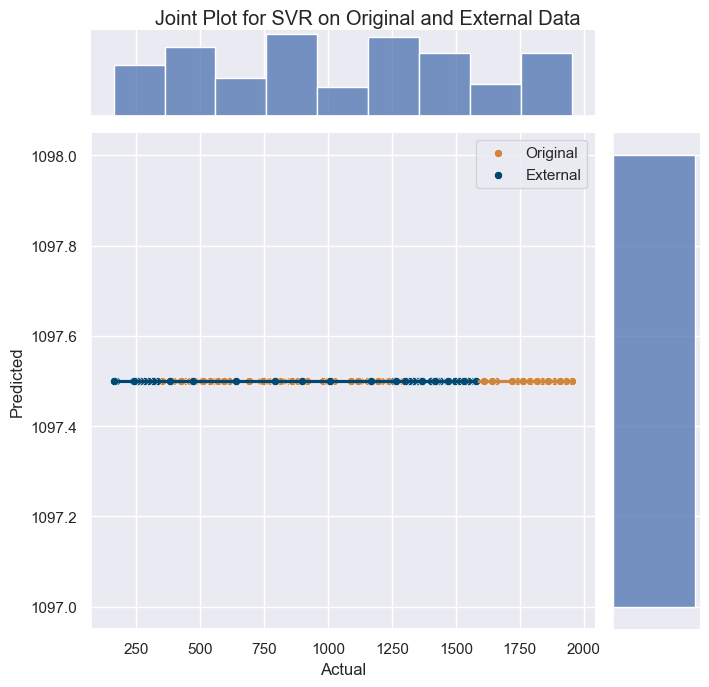

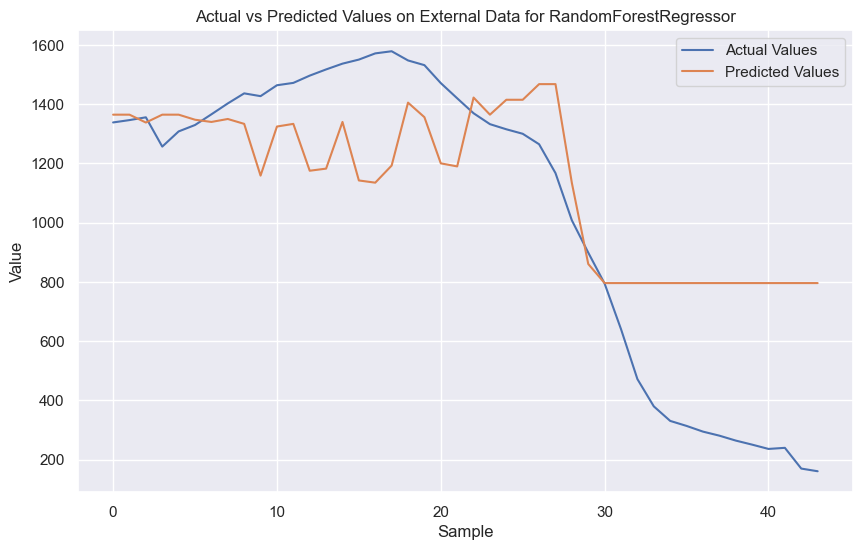

Model: RandomForestRegressor
Train RMSE: 245.95160272689938 Train R2: 0.7731225246344939 Train MAE: 214.29186251620854
Test RMSE: 210.21701180204735 Test R2: 0.7947808531193332 Test MAE: 188.22847824767425
External RMSE: 320.55895576755034 External R2: 0.6014838724083093 External MAE: 253.59228379756175
--------------------------------------------------
Original Dataset - RMSE: 238.99700926106652, R2: 0.7784789481536764, MAE: 208.89943818478775
External Dataset - RMSE: 320.55895576755034, R2: 0.6014838724083093, MAE: 253.59228379756175


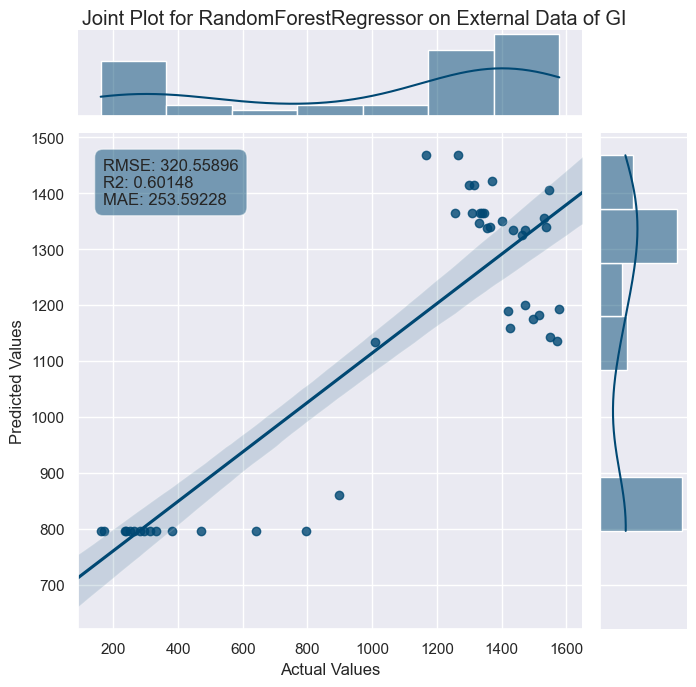

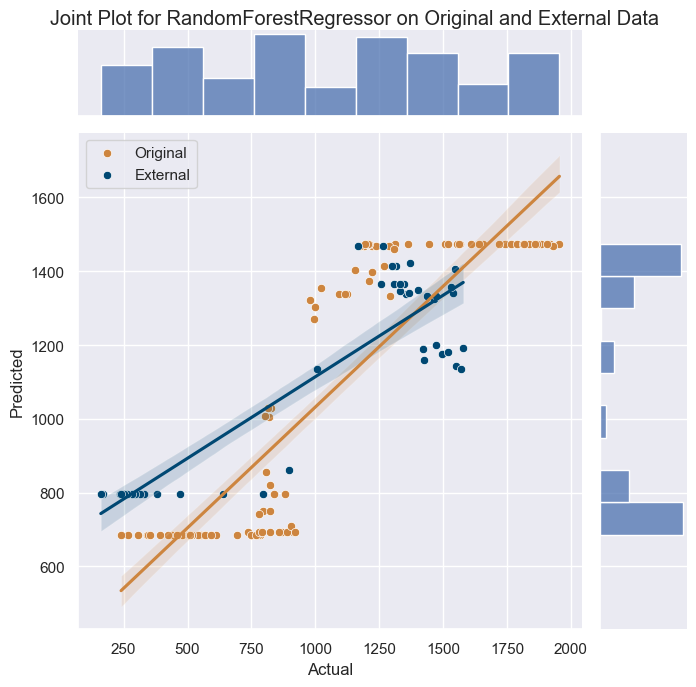

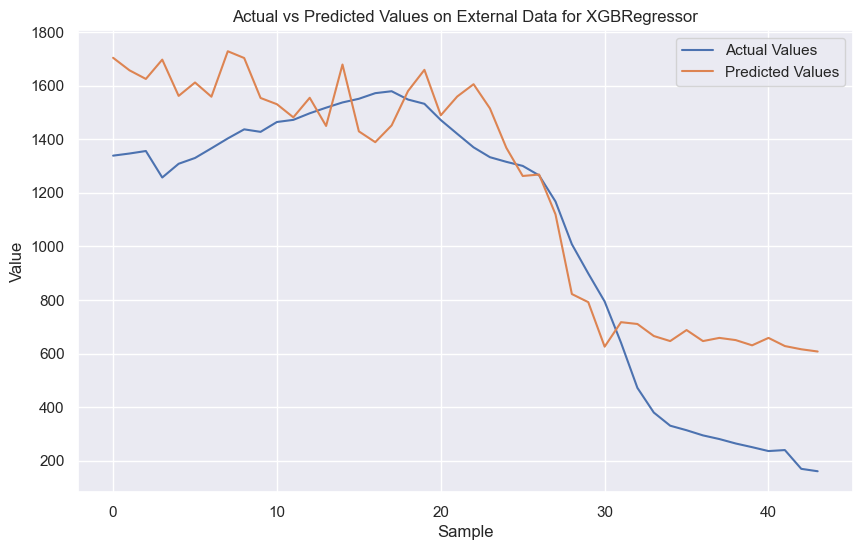

Model: XGBRegressor
Train RMSE: 56.277825988020794 Train R2: 0.9881213607958017 Train MAE: 41.62636690886124
Test RMSE: 123.24495694123257 Test R2: 0.9294624329726431 Test MAE: 89.9419118754069
External RMSE: 254.15673053106053 External R2: 0.7494852495869686 External MAE: 214.27341514016416
--------------------------------------------------
Original Dataset - RMSE: 75.19660931489472, R2: 0.9780706081057418, MAE: 51.62268655711206
External Dataset - RMSE: 254.15673053106053, R2: 0.7494852495869686, MAE: 214.27341514016416
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000025 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 354
[LightGBM] [Info] Number of data points in the train set: 92, number of used features: 14
[LightGBM] [Info] Start training from score 0.043082
[LightGBM] [Warning] No further splits with positive gain, best gain: 

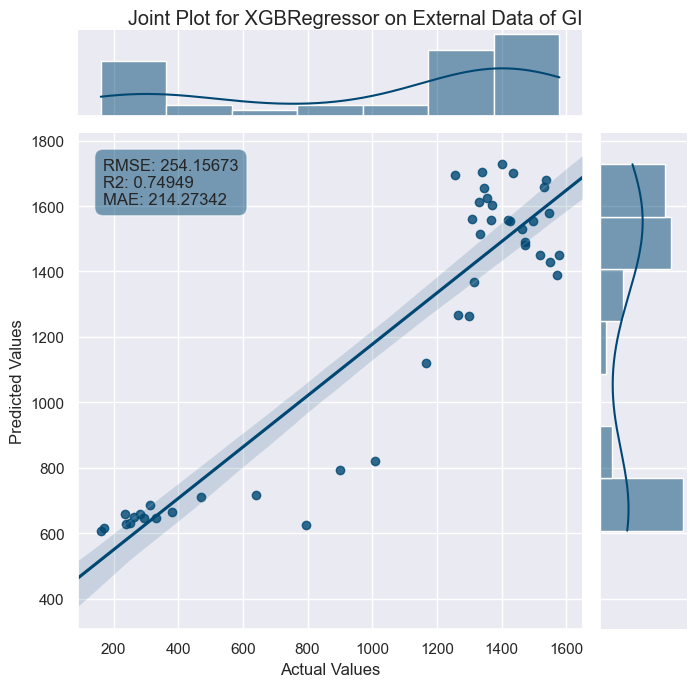

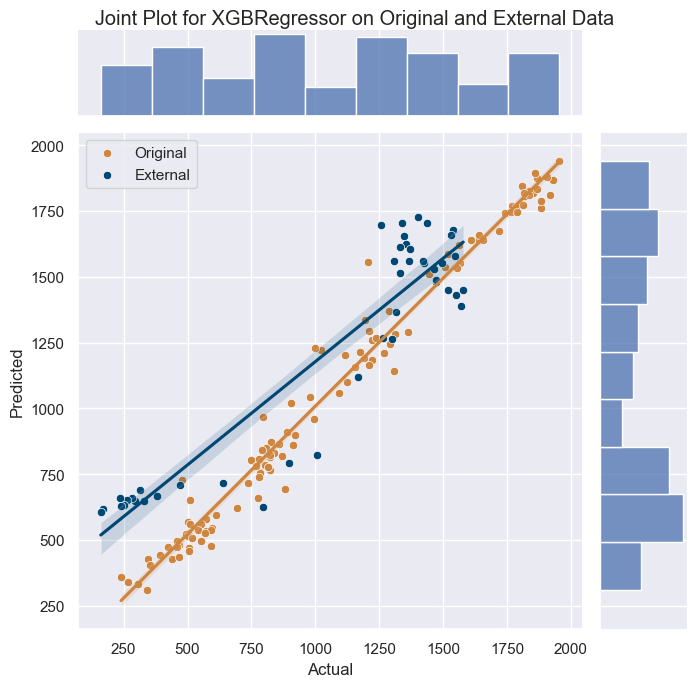

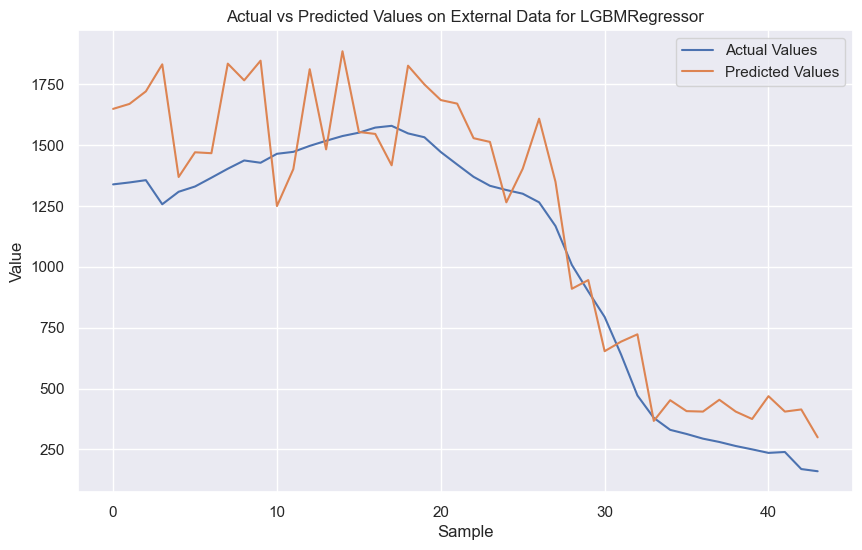

Model: LGBMRegressor
Train RMSE: 24.167910921829407 Train R2: 0.9978093636490131 Train MAE: 17.957507172937742
Test RMSE: 104.30148253928017 Test R2: 0.9494800253266442 Test MAE: 82.2129702449775
External RMSE: 227.59042104013423 External R2: 0.7991193843402118 External MAE: 189.78029377117383
--------------------------------------------------
Original Dataset - RMSE: 52.096335724222676, R2: 0.9894744589970128, MAE: 31.251740911980455
External Dataset - RMSE: 227.59042104013423, R2: 0.7991193843402118, MAE: 189.78029377117383


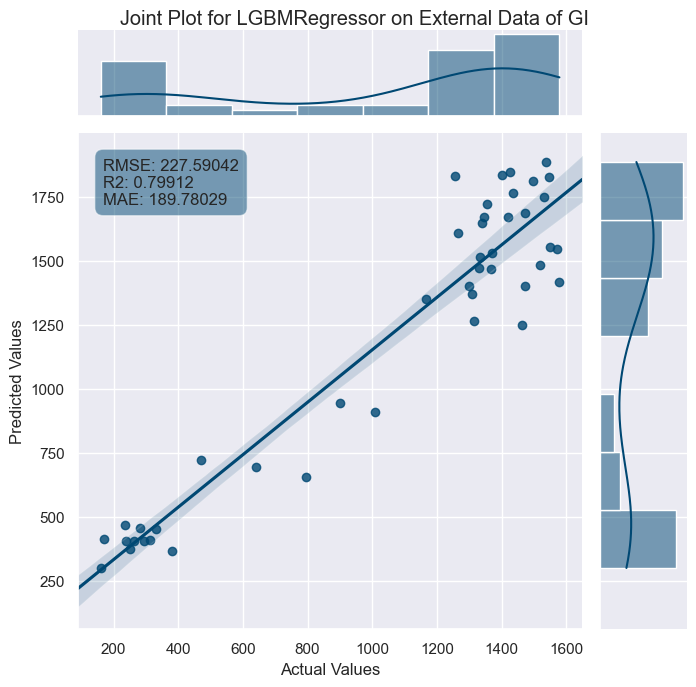

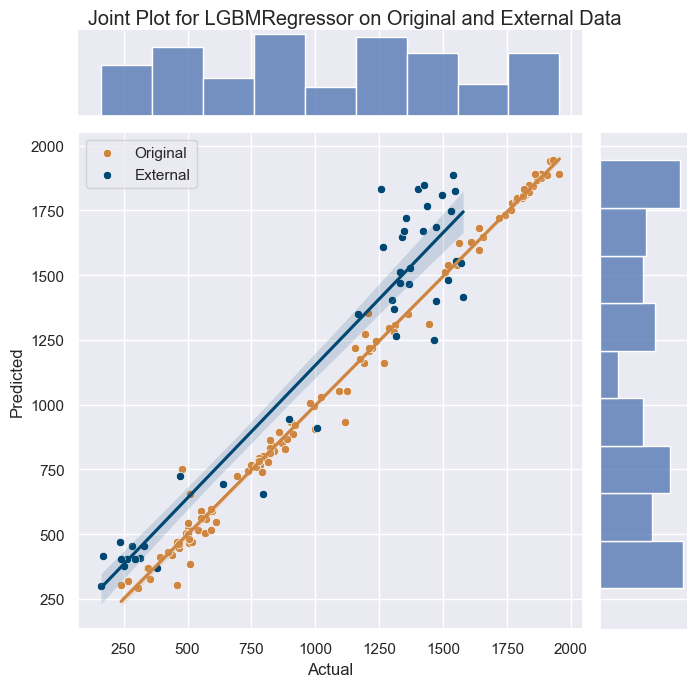

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
from sklearn.neighbors import KNeighborsRegressor
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from sklearn.preprocessing import StandardScaler
from skopt import BayesSearchCV
from skopt.space import Integer
import matplotlib.pyplot as plt
# Load datasets
data = pd.read_csv("C:\\Users\\Lenovo\\Desktop\\元学习\\BT1-1.csv")
external_data = pd.read_csv("C:\\Users\\Lenovo\\Desktop\\元学习\\BT1-2.csv")

# Normalization function
def normalize_data(data):
    scaler = StandardScaler()
    return scaler.fit_transform(data), scaler

# Normalize datasets
data_normalized, scaler = normalize_data(data)
external_data_normalized, _ = normalize_data(external_data)

# Split the dataset into features and target
X = data_normalized[:, :-1]
y = data_normalized[:, -1]
X_external = external_data_normalized[:, :-1]
y_external = external_data_normalized[:, -1]

# Fit a scaler for the features
feature_scaler = StandardScaler()
X_normalized = feature_scaler.fit_transform(data.drop('Biogas Production', axis=1))

# Fit a separate scaler for the target
target_scaler = StandardScaler()
y_normalized = target_scaler.fit_transform(data[['Biogas Production']])


# Split into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

# Define the hyperparameter space
param_grid = {'n_neighbors': Integer(1, 30)}

# Bayesian optimization
knn_search = BayesSearchCV(KNeighborsRegressor(), param_grid, n_iter=32, cv=5, n_jobs=-1, random_state=0)
knn_search.fit(X_train, y_train)

# Best model
knn_best = knn_search.best_estimator_

# Function to evaluate the model
def evaluate_model(model, X_train, y_train, X_test, y_test, X_external, y_external, target_scaler):
    y_pred_train = model.predict(X_train)
    y_pred_test = model.predict(X_test)
    y_pred_external = model.predict(X_external)

    # Denormalize target values and predictions
    y_train_denorm = target_scaler.inverse_transform(y_train.reshape(-1, 1)).flatten()
    y_test_denorm = target_scaler.inverse_transform(y_test.reshape(-1, 1)).flatten()
    y_external_denorm = target_scaler.inverse_transform(y_external.reshape(-1, 1)).flatten()
    y_pred_train_denorm = target_scaler.inverse_transform(y_pred_train.reshape(-1, 1)).flatten()
    y_pred_test_denorm = target_scaler.inverse_transform(y_pred_test.reshape(-1, 1)).flatten()
    y_pred_external_denorm = target_scaler.inverse_transform(y_pred_external.reshape(-1, 1)).flatten()

    # Visualization of predictions on external data
    plt.figure(figsize=(10, 6))
    plt.plot(y_external_denorm, label='Actual Values')
    plt.plot(y_pred_external_denorm, label='Predicted Values')
    plt.xlabel('Sample')
    plt.ylabel('Value')
    plt.title(f'Actual vs Predicted Values on External Data for {model.__class__.__name__}')
    plt.legend()
    plt.show()

    # Metrics for train and test sets
    train_rmse = mean_squared_error(y_train_denorm, y_pred_train_denorm, squared=False)
    test_rmse = mean_squared_error(y_test_denorm, y_pred_test_denorm, squared=False)
    train_r2 = r2_score(y_train_denorm, y_pred_train_denorm)
    test_r2 = r2_score(y_test_denorm, y_pred_test_denorm)
    train_mae = mean_absolute_error(y_train_denorm, y_pred_train_denorm)
    test_mae = mean_absolute_error(y_test_denorm, y_pred_test_denorm)

    # Metrics for external set
    external_rmse = mean_squared_error(y_external_denorm, y_pred_external_denorm, squared=False)
    external_r2 = r2_score(y_external_denorm, y_pred_external_denorm)
    external_mae = mean_absolute_error(y_external_denorm, y_pred_external_denorm)

    # Text for metrics
    metrics_text = f"RMSE: {external_rmse:.5f}\nR2: {external_r2:.5f}\nMAE: {external_mae:.5f}"

    # Create DataFrame for seaborn joint plot
    external_pred_df = pd.DataFrame({
        'Actual Values': y_external_denorm, 
        'Predicted Values': y_pred_external_denorm
    })

    # Set seaborn theme
    sns.set_theme(style="darkgrid")

    # Create the jointplot for external data with specified color
    g_external = sns.jointplot(x='Actual Values', y='Predicted Values', data=external_pred_df,
                               kind="reg", truncate=False,
                               color="#004873", height=7) 
    
    # Set title for the plot
    g_external.fig.suptitle(f"Joint Plot for {model.__class__.__name__} on External Data of GI")

    # Add metrics as text annotations
    plt.annotate(metrics_text, xy=(0.05, 0.95), xycoords='axes fraction', 
                 ha='left', va='top', bbox=dict(boxstyle='round,pad=0.5', fc="#004873", alpha=0.5))

    # Adjust layout
    g_external.fig.subplots_adjust(top=0.95)

    # Print metrics
    print(f"Model: {model.__class__.__name__}")
    print("Train RMSE:", train_rmse, "Train R2:", train_r2, "Train MAE:", train_mae)
    print("Test RMSE:", test_rmse, "Test R2:", test_r2, "Test MAE:", test_mae)
    print("External RMSE:", external_rmse, "External R2:", external_r2, "External MAE:", external_mae)
    print("--------------------------------------------------")

    # 评估模型并获取训练集和测试集的预测值
    y_pred_train_denorm = target_scaler.inverse_transform(model.predict(X_train).reshape(-1, 1)).flatten()
    y_pred_test_denorm = target_scaler.inverse_transform(model.predict(X_test).reshape(-1, 1)).flatten()

    # 合并训练集和测试集的数据
    original_data_actual = np.concatenate([y_train_denorm, y_test_denorm])
    original_data_predicted = np.concatenate([y_pred_train_denorm, y_pred_test_denorm])

    # 创建包含原始数据集和外部数据集的 DataFrame
    combined_df = pd.DataFrame({
        'Actual': np.concatenate([original_data_actual, y_external_denorm]),
        'Predicted': np.concatenate([original_data_predicted, y_pred_external_denorm]),
        'Dataset': ['Original'] * len(original_data_actual) + ['External'] * len(y_external_denorm)
    })

    # 创建基础 jointplot
    g_combined = sns.jointplot(x='Actual', y='Predicted', data=combined_df, kind="scatter", height=7)

    # 定义两个数据集的颜色
    colors = ['#CD853F', '#004873']

    # 为两个数据集添加不同颜色的散点图和线性回归线
    for dataset, color in zip(['Original', 'External'], colors):
        subset = combined_df[combined_df['Dataset'] == dataset]
        sns.scatterplot(x=subset['Actual'], y=subset['Predicted'], color=color, ax=g_combined.ax_joint, label=dataset)
        sns.regplot(x=subset['Actual'], y=subset['Predicted'], scatter=False, color=color, ax=g_combined.ax_joint)

    # 设置标题和布局
    g_combined.fig.suptitle(f"Joint Plot for {model.__class__.__name__} on Original and External Data")
    g_combined.fig.subplots_adjust(top=0.95)
    # 计算原始数据集的指标
    train_rmse = mean_squared_error(original_data_actual, original_data_predicted, squared=False)
    train_r2 = r2_score(original_data_actual, original_data_predicted)
    train_mae = mean_absolute_error(original_data_actual, original_data_predicted)

    # 计算外部数据集的指标
    external_rmse = mean_squared_error(y_external_denorm, y_pred_external_denorm, squared=False)
    external_r2 = r2_score(y_external_denorm, y_pred_external_denorm)
    external_mae = mean_absolute_error(y_external_denorm, y_pred_external_denorm)

    print(f"Original Dataset - RMSE: {train_rmse}, R2: {train_r2}, MAE: {train_mae}")
    print(f"External Dataset - RMSE: {external_rmse}, R2: {external_r2}, MAE: {external_mae}")

# Evaluate KNN model
evaluate_model(knn_best, X_train, y_train, X_test, y_test, X_external, y_external, target_scaler)

from sklearn.svm import SVR
from skopt.space import Real

# Define the hyperparameter space for SVM
param_grid_svm = {
    'C': Real(1e-15, 1e+1, prior='log-uniform'),
    'gamma': Real(1e-15, 1e+1, prior='log-uniform'),
    'epsilon': Real(1e-15, 1e+1, prior='log-uniform')
}

# Bayesian optimization
svm_search = BayesSearchCV(SVR(), param_grid_svm, n_iter=32, cv=5, n_jobs=-1, random_state=0)
svm_search.fit(X_train, y_train)

# Best model
svm_best = svm_search.best_estimator_

# Evaluate SVM model
evaluate_model(svm_best, X_train, y_train, X_test, y_test, X_external, y_external, target_scaler)

from sklearn.ensemble import RandomForestRegressor
from skopt.space import Integer, Real

# Define the hyperparameter space for Random Forest
param_grid_rf = {
    'n_estimators': Integer(10, 100),
    'max_depth': Integer(10, 30),
    'min_samples_split': Real(0.3, 0.8),
    'min_samples_leaf': Real(0.3, 0.8)
}

# Bayesian optimization
rf_search = BayesSearchCV(RandomForestRegressor(random_state=0), param_grid_rf, n_iter=32, cv=5, n_jobs=-1, random_state=0)
rf_search.fit(X_train, y_train)

# Best model
rf_best = rf_search.best_estimator_

# Evaluate Random Forest model
evaluate_model(rf_best, X_train, y_train, X_test, y_test, X_external, y_external, target_scaler)


import xgboost as xgb

# Define the hyperparameter space for XGBoost
param_grid_xgb = {
    'n_estimators': Integer(10, 15),
    'max_depth': Integer(10, 15),
    'learning_rate': Real(0.1, 0.3, 'log-uniform'),
    'subsample': Real(0.1, 0.3),
    'colsample_bytree': Real(0.1, 0.3)
}

# Bayesian optimization
xgb_search = BayesSearchCV(xgb.XGBRegressor(), param_grid_xgb, n_iter=32, cv=5, n_jobs=-1, random_state=0)
xgb_search.fit(X_train, y_train)

# Best model
xgb_best = xgb_search.best_estimator_

# Evaluate XGBoost model
evaluate_model(xgb_best, X_train, y_train, X_test, y_test, X_external, y_external, target_scaler)


import lightgbm as lgb

# Define the hyperparameter space for LightGBM
param_grid_lgb = {
    'n_estimators': Integer(10, 300),
    'max_depth': Integer(-1, 50),
    'learning_rate': Real(0.01, 1.0, 'log-uniform'),
    'num_leaves': Integer(20, 300),
    'subsample': Real(0.1, 1.0),
    'colsample_bytree': Real(0.1, 1.0)
}

# Bayesian optimization
lgb_search = BayesSearchCV(lgb.LGBMRegressor(), param_grid_lgb, n_iter=32, cv=5, n_jobs=-1, random_state=0)
lgb_search.fit(X_train, y_train)

# Best model
lgb_best = lgb_search.best_estimator_

# Evaluate LightGBM model
evaluate_model(lgb_best, X_train, y_train, X_test, y_test, X_external, y_external, target_scaler)

In [2]:
# 创建包含模型名称和其最优超参数的字典
model_hyperparams = {
    'KNN': knn_search.best_params_,
    'SVM': svm_search.best_params_,
    'RandomForest': rf_search.best_params_,
    'XGBoost': xgb_search.best_params_,
    'LightGBM': lgb_search.best_params_
}

# 转换为DataFrame
hyperparams_df = pd.DataFrame.from_dict(model_hyperparams, orient='index')

# 重置索引，使模型名称成为一列
hyperparams_df.reset_index(inplace=True)
hyperparams_df.rename(columns={'index': 'Model'}, inplace=True)

# 指定文件路径和名称，这里替换为你的目标路径
file_path = "C:\\Users\\Lenovo\\Desktop\\元学习\\传统模型超参数\\hyperparams_BT_1_1.csv"

# 保存为CSV文件
hyperparams_df.to_csv(file_path, index=False)

e:\anaconda\envs\yuanxuexi2\lib\site-packages\skopt\optimizer\optimizer.py:449: UserWarning: The objective has been evaluated at this point before.
  warnings.warn("The objective has been evaluated "
e:\anaconda\envs\yuanxuexi2\lib\site-packages\skopt\optimizer\optimizer.py:449: UserWarning: The objective has been evaluated at this point before.
  warnings.warn("The objective has been evaluated "
e:\anaconda\envs\yuanxuexi2\lib\site-packages\skopt\optimizer\optimizer.py:449: UserWarning: The objective has been evaluated at this point before.
  warnings.warn("The objective has been evaluated "
e:\anaconda\envs\yuanxuexi2\lib\site-packages\skopt\optimizer\optimizer.py:449: UserWarning: The objective has been evaluated at this point before.
  warnings.warn("The objective has been evaluated "
e:\anaconda\envs\yuanxuexi2\lib\site-packages\skopt\optimizer\optimizer.py:449: UserWarning: The objective has been evaluated at this point before.
  warnings.warn("The objective has been evaluated "


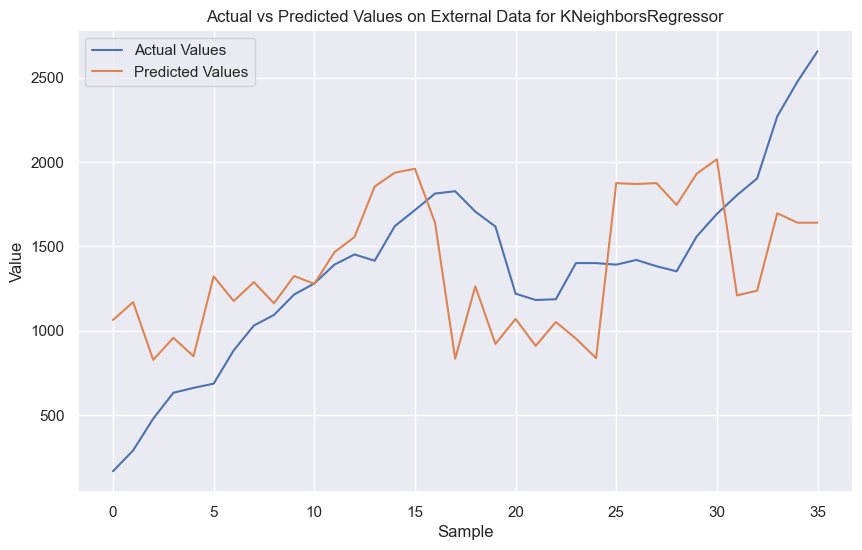

Model: KNeighborsRegressor
Train RMSE: 79.93588092431976 Train R2: 0.9785593593492807 Train MAE: 57.15855218855221
Test RMSE: 73.66107687993104 Test R2: 0.9803175644961019 Test MAE: 56.22826666666667
External RMSE: 501.677994010579 External R2: 0.14261259713295193 External MAE: 424.14577412642785
--------------------------------------------------
Original Dataset - RMSE: 78.71106907818053, R2: 0.9788943555210803, MAE: 56.97099462365593
External Dataset - RMSE: 501.677994010579, R2: 0.14261259713295193, MAE: 424.14577412642785


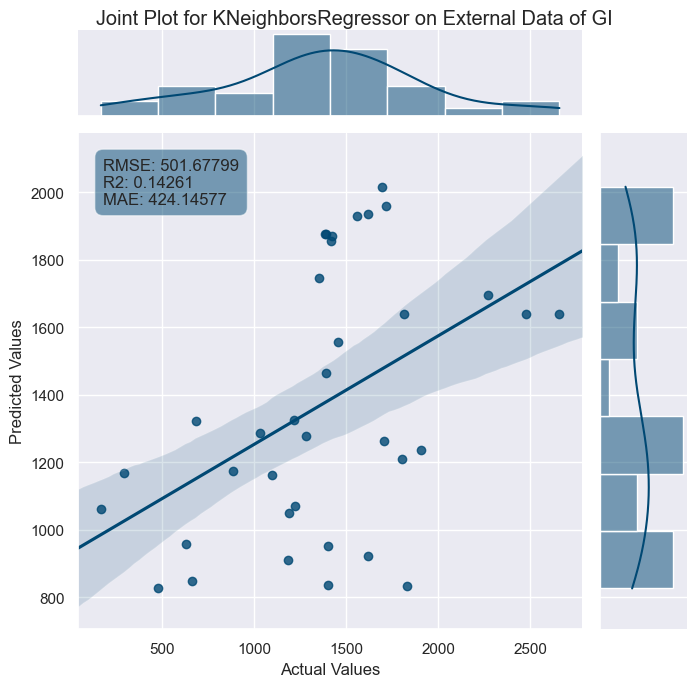

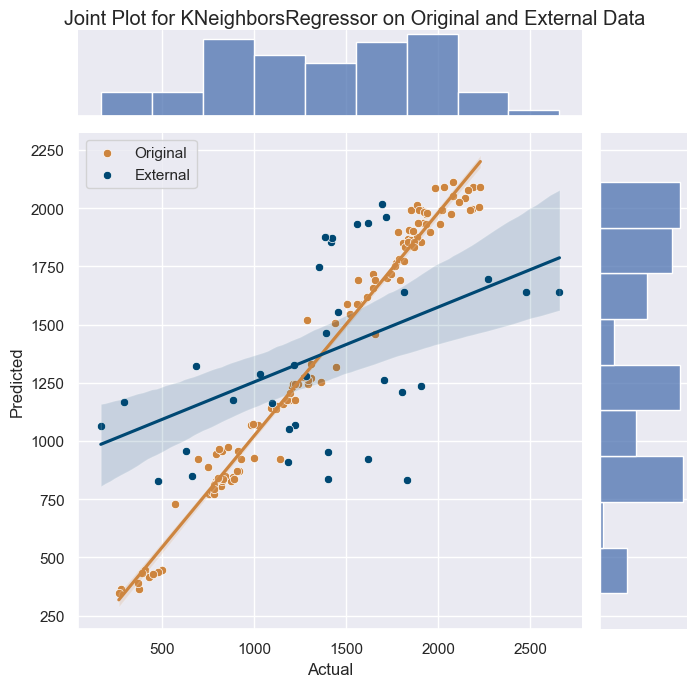

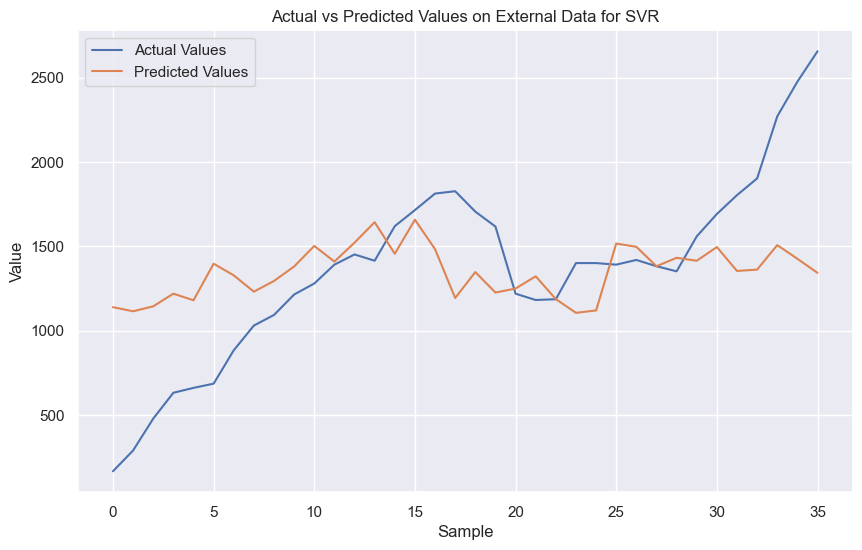

Model: SVR
Train RMSE: 61.41459223499991 Train R2: 0.9873439735864726 Train MAE: 47.87585918291438
Test RMSE: 81.61433365197506 Test R2: 0.9758378493443567 Test MAE: 63.498105667087096
External RMSE: 489.21896702788285 External R2: 0.18466972576917906 External MAE: 368.44503505859564
--------------------------------------------------
Original Dataset - RMSE: 65.98667682216895, R2: 0.985166640907461, MAE: 51.02550565149758
External Dataset - RMSE: 489.21896702788285, R2: 0.18466972576917906, MAE: 368.44503505859564


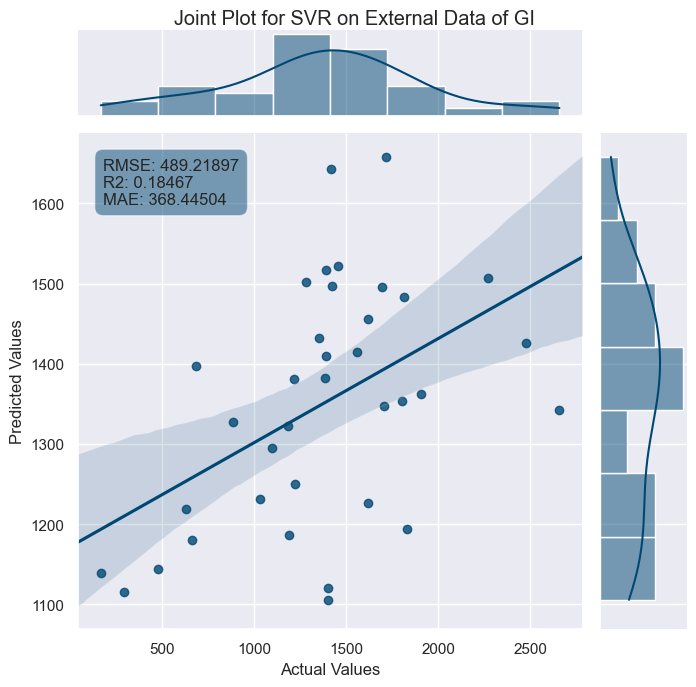

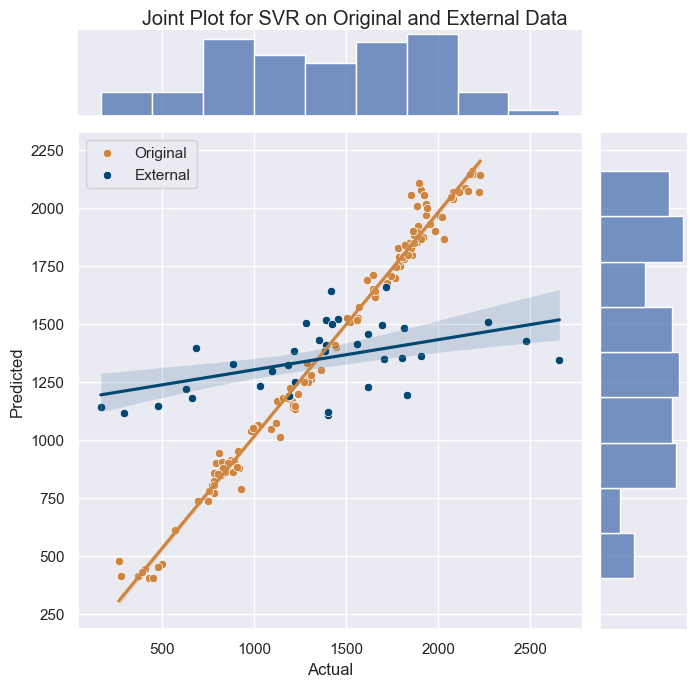

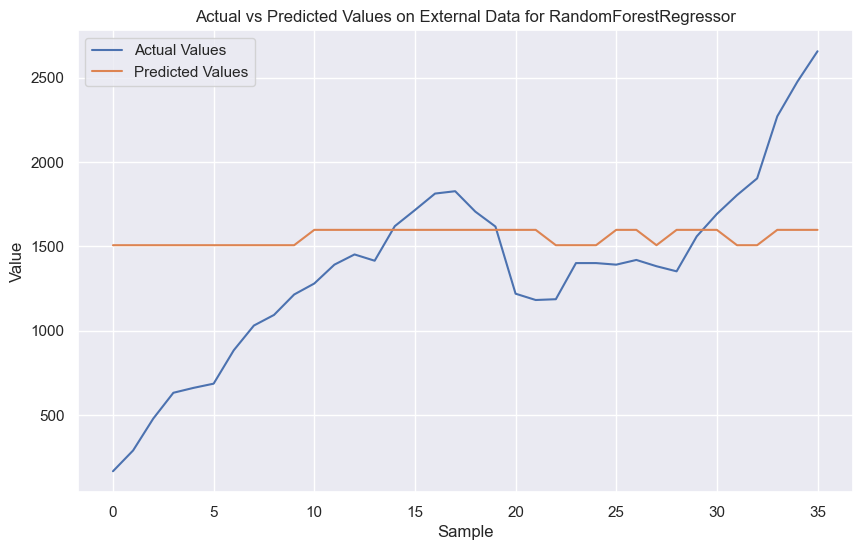

Model: RandomForestRegressor
Train RMSE: 246.75598360762052 Train R2: 0.7956900052580115 Train MAE: 193.3365634218685
Test RMSE: 228.40730702999556 Test R2: 0.8107557483919425 Test MAE: 184.31257648377266
External RMSE: 550.0253562532371 External R2: -0.03060541008007278 External MAE: 417.3305756025068
--------------------------------------------------
Original Dataset - RMSE: 243.16810985717916, R2: 0.798562541215929, MAE: 191.51721121660725
External Dataset - RMSE: 550.0253562532371, R2: -0.03060541008007278, MAE: 417.3305756025068


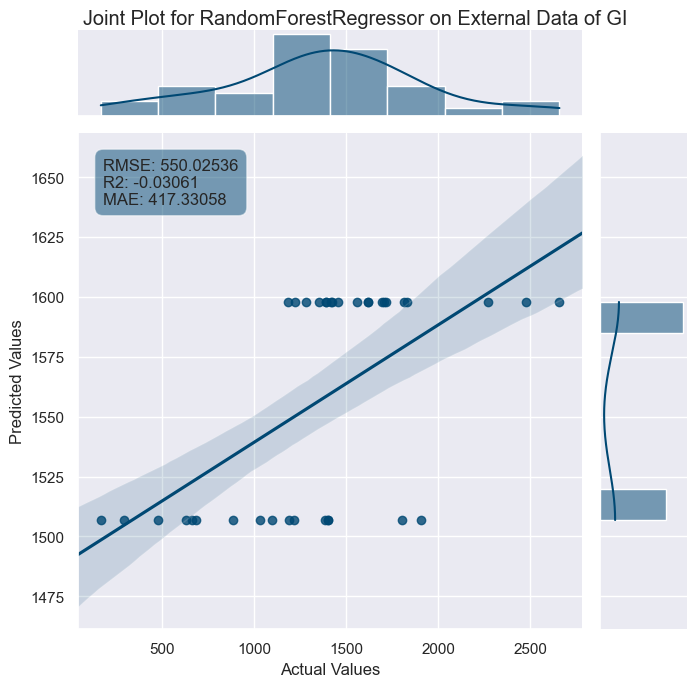

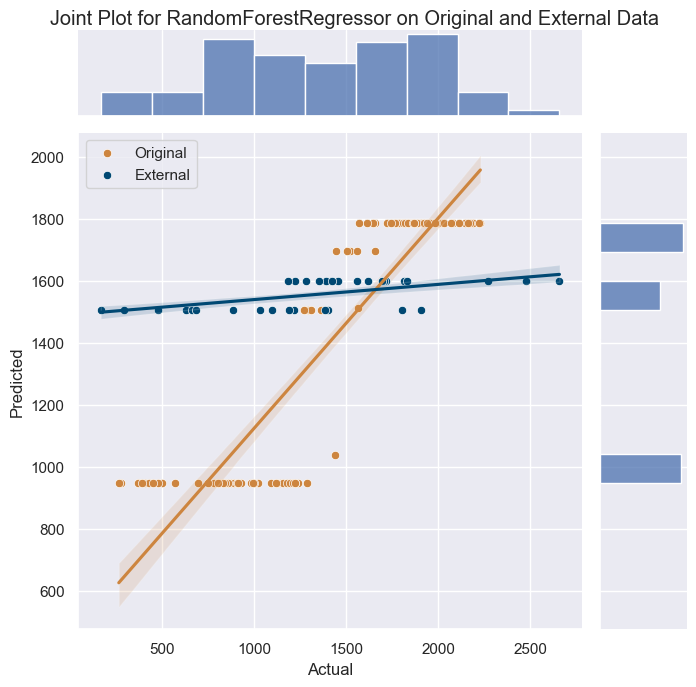

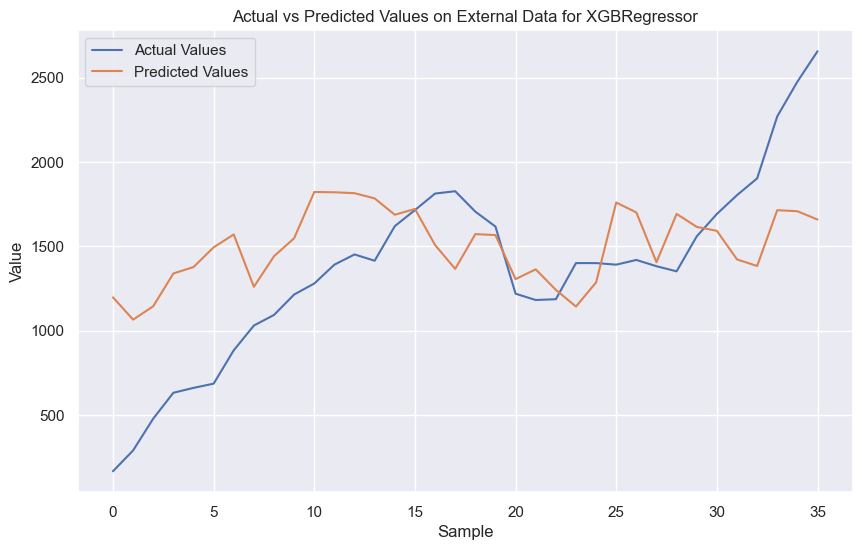

Model: XGBRegressor
Train RMSE: 78.09321090665833 Train R2: 0.9795364589614696 Train MAE: 51.221407630997476
Test RMSE: 113.40926841704027 Test R2: 0.9533448266489241 Test MAE: 80.32475449218751
External RMSE: 482.9750886274667 External R2: 0.20534895720932822 External MAE: 392.4794859001574
--------------------------------------------------
Original Dataset - RMSE: 86.38333375387224, R2: 0.974579334435876, MAE: 57.089017885269655
External Dataset - RMSE: 482.9750886274667, R2: 0.20534895720932822, MAE: 392.4794859001574
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000038 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 387
[LightGBM] [Info] Number of data points in the train set: 99, number of used features: 14
[LightGBM] [Info] Start training from score -0.004970
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, 

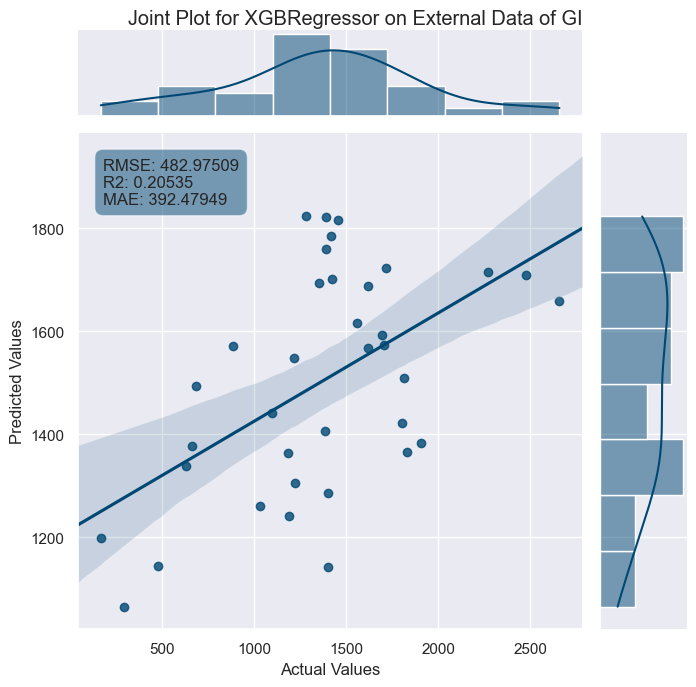

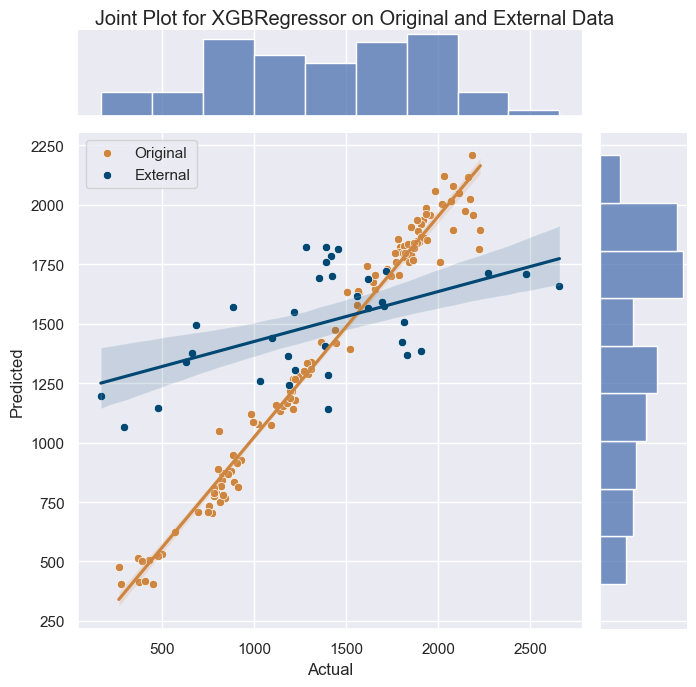

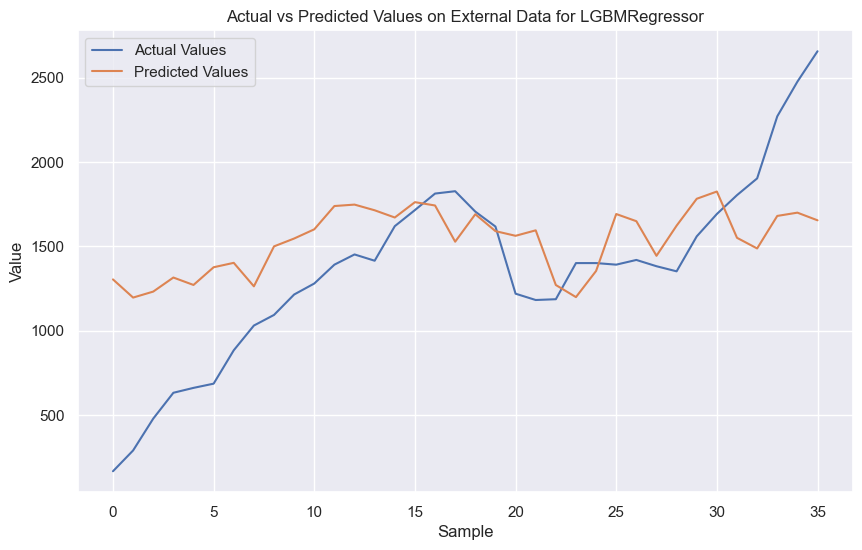

Model: LGBMRegressor
Train RMSE: 30.377378422293816 Train R2: 0.9969036160334157 Train MAE: 22.0945108083473
Test RMSE: 86.93001587676686 Test R2: 0.9725879050458625 Test MAE: 72.76762697409666
External RMSE: 469.21496619184455 External R2: 0.2499836896008133 External MAE: 372.1578179278535
--------------------------------------------------
Original Dataset - RMSE: 47.54254617213648, R2: 0.99229997970568, MAE: 32.31086487402258
External Dataset - RMSE: 469.21496619184455, R2: 0.2499836896008133, MAE: 372.1578179278535


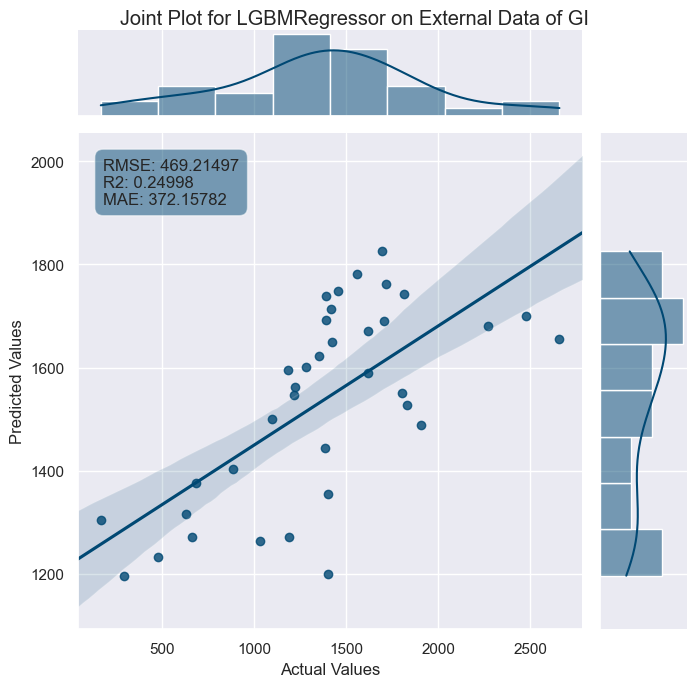

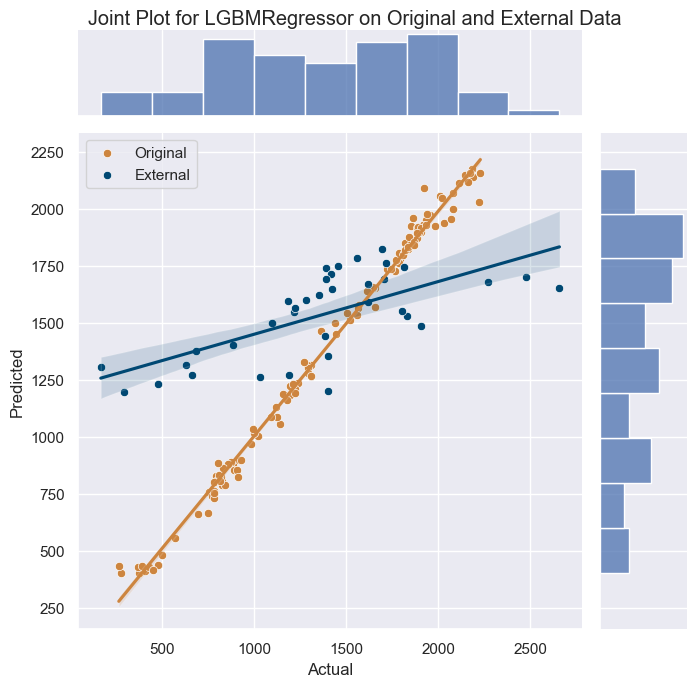

In [3]:
import pandas as pd
import numpy as np
import seaborn as sns
from sklearn.neighbors import KNeighborsRegressor
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from sklearn.preprocessing import StandardScaler
from skopt import BayesSearchCV
from skopt.space import Integer
import matplotlib.pyplot as plt
# Load datasets
data = pd.read_csv("C:\\Users\\Lenovo\\Desktop\\元学习\\BT2-1.csv")
external_data = pd.read_csv("C:\\Users\\Lenovo\\Desktop\\元学习\\BT2-2.csv")

# Normalization function
def normalize_data(data):
    scaler = StandardScaler()
    return scaler.fit_transform(data), scaler

# Normalize datasets
data_normalized, scaler = normalize_data(data)
external_data_normalized, _ = normalize_data(external_data)

# Split the dataset into features and target
X = data_normalized[:, :-1]
y = data_normalized[:, -1]
X_external = external_data_normalized[:, :-1]
y_external = external_data_normalized[:, -1]

# Fit a scaler for the features
feature_scaler = StandardScaler()
X_normalized = feature_scaler.fit_transform(data.drop('Biogas Production', axis=1))

# Fit a separate scaler for the target
target_scaler = StandardScaler()
y_normalized = target_scaler.fit_transform(data[['Biogas Production']])


# Split into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

# Define the hyperparameter space
param_grid = {'n_neighbors': Integer(1, 30)}

# Bayesian optimization
knn_search = BayesSearchCV(KNeighborsRegressor(), param_grid, n_iter=32, cv=5, n_jobs=-1, random_state=0)
knn_search.fit(X_train, y_train)

# Best model
knn_best = knn_search.best_estimator_

# Function to evaluate the model
def evaluate_model(model, X_train, y_train, X_test, y_test, X_external, y_external, target_scaler):
    y_pred_train = model.predict(X_train)
    y_pred_test = model.predict(X_test)
    y_pred_external = model.predict(X_external)

    # Denormalize target values and predictions
    y_train_denorm = target_scaler.inverse_transform(y_train.reshape(-1, 1)).flatten()
    y_test_denorm = target_scaler.inverse_transform(y_test.reshape(-1, 1)).flatten()
    y_external_denorm = target_scaler.inverse_transform(y_external.reshape(-1, 1)).flatten()
    y_pred_train_denorm = target_scaler.inverse_transform(y_pred_train.reshape(-1, 1)).flatten()
    y_pred_test_denorm = target_scaler.inverse_transform(y_pred_test.reshape(-1, 1)).flatten()
    y_pred_external_denorm = target_scaler.inverse_transform(y_pred_external.reshape(-1, 1)).flatten()

    # Visualization of predictions on external data
    plt.figure(figsize=(10, 6))
    plt.plot(y_external_denorm, label='Actual Values')
    plt.plot(y_pred_external_denorm, label='Predicted Values')
    plt.xlabel('Sample')
    plt.ylabel('Value')
    plt.title(f'Actual vs Predicted Values on External Data for {model.__class__.__name__}')
    plt.legend()
    plt.show()

    # Metrics for train and test sets
    train_rmse = mean_squared_error(y_train_denorm, y_pred_train_denorm, squared=False)
    test_rmse = mean_squared_error(y_test_denorm, y_pred_test_denorm, squared=False)
    train_r2 = r2_score(y_train_denorm, y_pred_train_denorm)
    test_r2 = r2_score(y_test_denorm, y_pred_test_denorm)
    train_mae = mean_absolute_error(y_train_denorm, y_pred_train_denorm)
    test_mae = mean_absolute_error(y_test_denorm, y_pred_test_denorm)

    # Metrics for external set
    external_rmse = mean_squared_error(y_external_denorm, y_pred_external_denorm, squared=False)
    external_r2 = r2_score(y_external_denorm, y_pred_external_denorm)
    external_mae = mean_absolute_error(y_external_denorm, y_pred_external_denorm)

    # Text for metrics
    metrics_text = f"RMSE: {external_rmse:.5f}\nR2: {external_r2:.5f}\nMAE: {external_mae:.5f}"

    # Create DataFrame for seaborn joint plot
    external_pred_df = pd.DataFrame({
        'Actual Values': y_external_denorm, 
        'Predicted Values': y_pred_external_denorm
    })

    # Set seaborn theme
    sns.set_theme(style="darkgrid")

    # Create the jointplot for external data with specified color
    g_external = sns.jointplot(x='Actual Values', y='Predicted Values', data=external_pred_df,
                               kind="reg", truncate=False,
                               color="#004873", height=7) 
    
    # Set title for the plot
    g_external.fig.suptitle(f"Joint Plot for {model.__class__.__name__} on External Data of GI")

    # Add metrics as text annotations
    plt.annotate(metrics_text, xy=(0.05, 0.95), xycoords='axes fraction', 
                 ha='left', va='top', bbox=dict(boxstyle='round,pad=0.5', fc="#004873", alpha=0.5))

    # Adjust layout
    g_external.fig.subplots_adjust(top=0.95)

    # Print metrics
    print(f"Model: {model.__class__.__name__}")
    print("Train RMSE:", train_rmse, "Train R2:", train_r2, "Train MAE:", train_mae)
    print("Test RMSE:", test_rmse, "Test R2:", test_r2, "Test MAE:", test_mae)
    print("External RMSE:", external_rmse, "External R2:", external_r2, "External MAE:", external_mae)
    print("--------------------------------------------------")

    # 评估模型并获取训练集和测试集的预测值
    y_pred_train_denorm = target_scaler.inverse_transform(model.predict(X_train).reshape(-1, 1)).flatten()
    y_pred_test_denorm = target_scaler.inverse_transform(model.predict(X_test).reshape(-1, 1)).flatten()

    # 合并训练集和测试集的数据
    original_data_actual = np.concatenate([y_train_denorm, y_test_denorm])
    original_data_predicted = np.concatenate([y_pred_train_denorm, y_pred_test_denorm])

    # 创建包含原始数据集和外部数据集的 DataFrame
    combined_df = pd.DataFrame({
        'Actual': np.concatenate([original_data_actual, y_external_denorm]),
        'Predicted': np.concatenate([original_data_predicted, y_pred_external_denorm]),
        'Dataset': ['Original'] * len(original_data_actual) + ['External'] * len(y_external_denorm)
    })

    # 创建基础 jointplot
    g_combined = sns.jointplot(x='Actual', y='Predicted', data=combined_df, kind="scatter", height=7)

    # 定义两个数据集的颜色
    colors = ['#CD853F', '#004873']

    # 为两个数据集添加不同颜色的散点图和线性回归线
    for dataset, color in zip(['Original', 'External'], colors):
        subset = combined_df[combined_df['Dataset'] == dataset]
        sns.scatterplot(x=subset['Actual'], y=subset['Predicted'], color=color, ax=g_combined.ax_joint, label=dataset)
        sns.regplot(x=subset['Actual'], y=subset['Predicted'], scatter=False, color=color, ax=g_combined.ax_joint)

    # 设置标题和布局
    g_combined.fig.suptitle(f"Joint Plot for {model.__class__.__name__} on Original and External Data")
    g_combined.fig.subplots_adjust(top=0.95)
    # 计算原始数据集的指标
    train_rmse = mean_squared_error(original_data_actual, original_data_predicted, squared=False)
    train_r2 = r2_score(original_data_actual, original_data_predicted)
    train_mae = mean_absolute_error(original_data_actual, original_data_predicted)

    # 计算外部数据集的指标
    external_rmse = mean_squared_error(y_external_denorm, y_pred_external_denorm, squared=False)
    external_r2 = r2_score(y_external_denorm, y_pred_external_denorm)
    external_mae = mean_absolute_error(y_external_denorm, y_pred_external_denorm)


    print(f"Original Dataset - RMSE: {train_rmse}, R2: {train_r2}, MAE: {train_mae}")
    print(f"External Dataset - RMSE: {external_rmse}, R2: {external_r2}, MAE: {external_mae}")

# Evaluate KNN model
evaluate_model(knn_best, X_train, y_train, X_test, y_test, X_external, y_external, target_scaler)

from sklearn.svm import SVR
from skopt.space import Real


param_grid_svm = {
    'C': Real(1e-15, 1e+1, prior='log-uniform'),
    'gamma': Real(1e-15, 1e+1, prior='log-uniform'),
    'epsilon': Real(1e-15, 1e+1, prior='log-uniform')
}


# Bayesian optimization
svm_search = BayesSearchCV(SVR(), param_grid_svm, n_iter=32, cv=5, n_jobs=-1, random_state=0)
svm_search.fit(X_train, y_train)

# Best model
svm_best = svm_search.best_estimator_

# Evaluate SVM model
evaluate_model(svm_best, X_train, y_train, X_test, y_test, X_external, y_external, target_scaler)

from sklearn.ensemble import RandomForestRegressor
from skopt.space import Integer, Real

# Define the hyperparameter space for Random Forest
param_grid_rf = {
    'n_estimators': Integer(10, 100),
    'max_depth': Integer(10, 30),
    'min_samples_split': Real(0.3, 0.8),
    'min_samples_leaf': Real(0.3, 0.8)
}

# Bayesian optimization
rf_search = BayesSearchCV(RandomForestRegressor(random_state=0), param_grid_rf, n_iter=32, cv=5, n_jobs=-1, random_state=0)
rf_search.fit(X_train, y_train)

# Best model
rf_best = rf_search.best_estimator_

# Evaluate Random Forest model
evaluate_model(rf_best, X_train, y_train, X_test, y_test, X_external, y_external, target_scaler)


import xgboost as xgb

# Define the hyperparameter space for XGBoost
param_grid_xgb = {
    'n_estimators': Integer(10, 15),
    'max_depth': Integer(10, 15),
    'learning_rate': Real(0.1, 0.3, 'log-uniform'),
    'subsample': Real(0.1, 0.3),
    'colsample_bytree': Real(0.1, 0.3)
}

# Bayesian optimization
xgb_search = BayesSearchCV(xgb.XGBRegressor(), param_grid_xgb, n_iter=32, cv=5, n_jobs=-1, random_state=0)
xgb_search.fit(X_train, y_train)

# Best model
xgb_best = xgb_search.best_estimator_

# Evaluate XGBoost model
evaluate_model(xgb_best, X_train, y_train, X_test, y_test, X_external, y_external, target_scaler)


import lightgbm as lgb

# Define the hyperparameter space for LightGBM
param_grid_lgb = {
    'n_estimators': Integer(10, 300),
    'max_depth': Integer(-1, 50),
    'learning_rate': Real(0.01, 1.0, 'log-uniform'),
    'num_leaves': Integer(20, 300),
    'subsample': Real(0.1, 1.0),
    'colsample_bytree': Real(0.1, 1.0)
}

# Bayesian optimization
lgb_search = BayesSearchCV(lgb.LGBMRegressor(), param_grid_lgb, n_iter=32, cv=5, n_jobs=-1, random_state=0)
lgb_search.fit(X_train, y_train)

# Best model
lgb_best = lgb_search.best_estimator_

# Evaluate LightGBM model
evaluate_model(lgb_best, X_train, y_train, X_test, y_test, X_external, y_external, target_scaler)

In [4]:
# 创建包含模型名称和其最优超参数的字典
model_hyperparams = {
    'KNN': knn_search.best_params_,
    'SVM': svm_search.best_params_,
    'RandomForest': rf_search.best_params_,
    'XGBoost': xgb_search.best_params_,
    'LightGBM': lgb_search.best_params_
}

# 转换为DataFrame
hyperparams_df = pd.DataFrame.from_dict(model_hyperparams, orient='index')

# 重置索引，使模型名称成为一列
hyperparams_df.reset_index(inplace=True)
hyperparams_df.rename(columns={'index': 'Model'}, inplace=True)

# 指定文件路径和名称，这里替换为你的目标路径
file_path = "C:\\Users\\Lenovo\\Desktop\\元学习\\传统模型超参数\\hyperparams_BT_1_2.csv"

# 保存为CSV文件
hyperparams_df.to_csv(file_path, index=False)

e:\anaconda\envs\yuanxuexi2\lib\site-packages\skopt\optimizer\optimizer.py:449: UserWarning: The objective has been evaluated at this point before.
  warnings.warn("The objective has been evaluated "
e:\anaconda\envs\yuanxuexi2\lib\site-packages\skopt\optimizer\optimizer.py:449: UserWarning: The objective has been evaluated at this point before.
  warnings.warn("The objective has been evaluated "
e:\anaconda\envs\yuanxuexi2\lib\site-packages\skopt\optimizer\optimizer.py:449: UserWarning: The objective has been evaluated at this point before.
  warnings.warn("The objective has been evaluated "
e:\anaconda\envs\yuanxuexi2\lib\site-packages\skopt\optimizer\optimizer.py:449: UserWarning: The objective has been evaluated at this point before.
  warnings.warn("The objective has been evaluated "
e:\anaconda\envs\yuanxuexi2\lib\site-packages\skopt\optimizer\optimizer.py:449: UserWarning: The objective has been evaluated at this point before.
  warnings.warn("The objective has been evaluated "


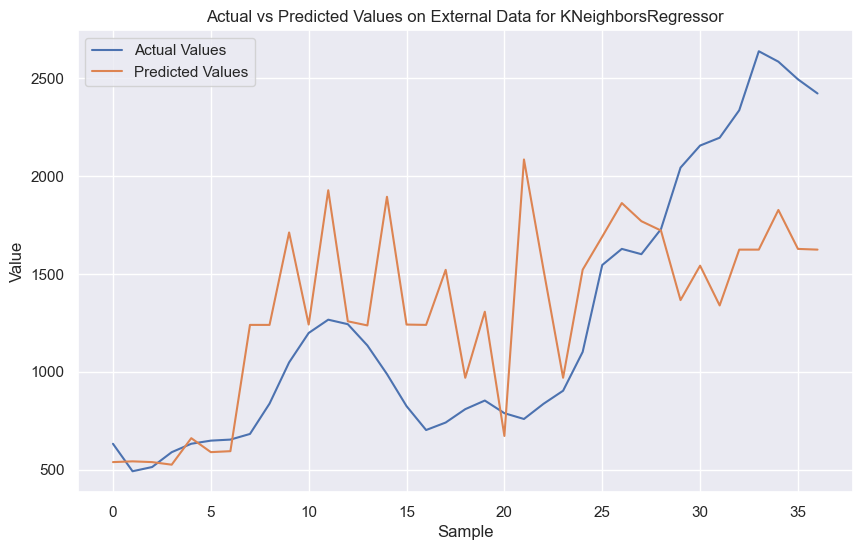

Model: KNeighborsRegressor
Train RMSE: 74.10875096591421 Train R2: 0.9878558533400849 Train MAE: 54.52411564625851
Test RMSE: 87.82501928013197 Test R2: 0.9786989838591996 Test MAE: 69.66693333333332
External RMSE: 547.8440104280107 External R2: 0.3168297092408332 External MAE: 420.124383135338
--------------------------------------------------
Original Dataset - RMSE: 77.09445865602288, R2: 0.9864711319033219, MAE: 57.60192411924119
External Dataset - RMSE: 547.8440104280107, R2: 0.3168297092408332, MAE: 420.124383135338


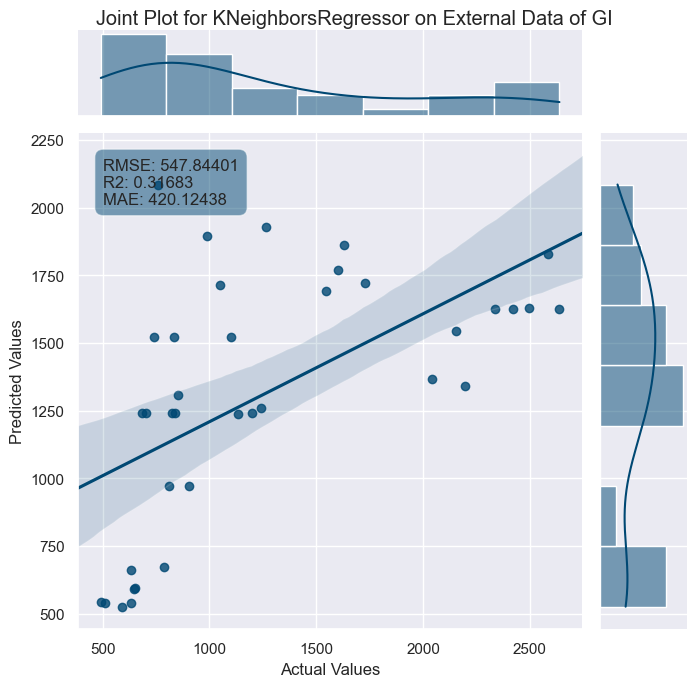

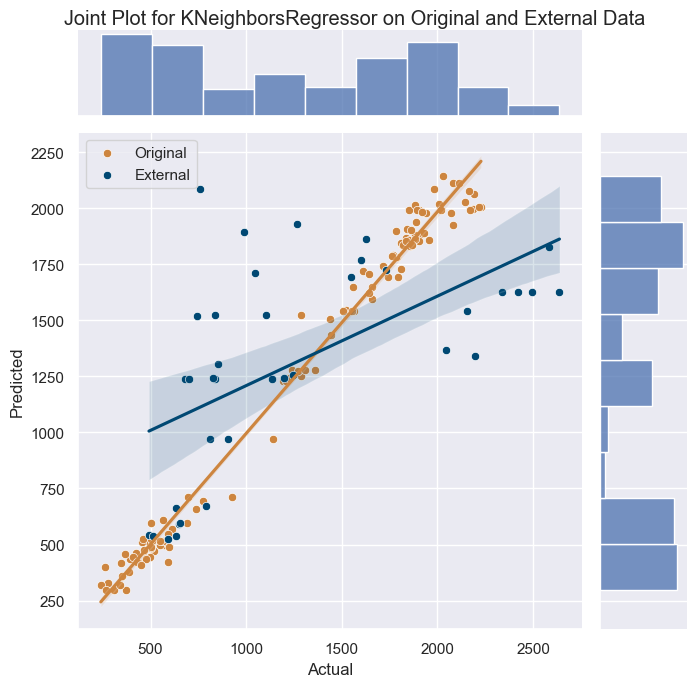

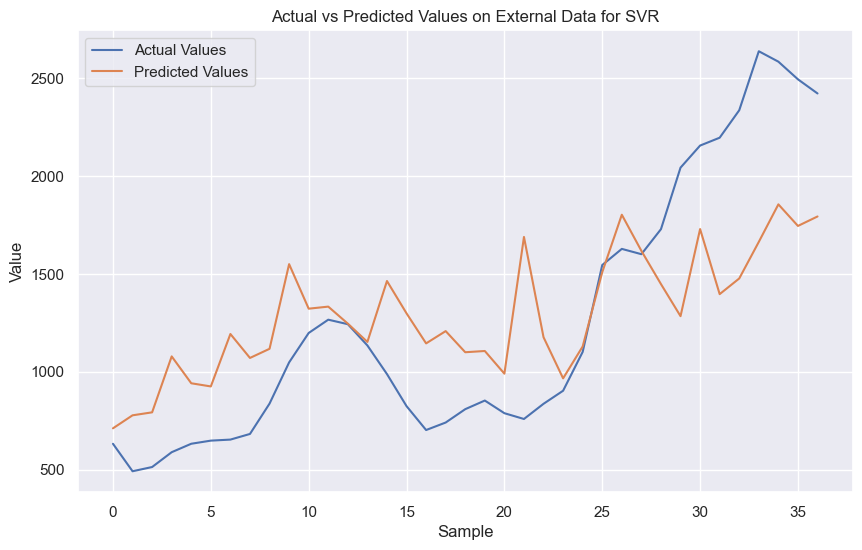

Model: SVR
Train RMSE: 60.96597481953182 Train R2: 0.9917813012742823 Train MAE: 32.436702444675085
Test RMSE: 84.9729381579161 Test R2: 0.9800600031865276 Test MAE: 69.40147004128286
External RMSE: 467.76215567856235 External R2: 0.5019587658965178 External MAE: 379.5695519047523
--------------------------------------------------
Original Dataset - RMSE: 66.55038520824014, R2: 0.9899187059294856, MAE: 39.94986659032707
External Dataset - RMSE: 467.76215567856235, R2: 0.5019587658965178, MAE: 379.5695519047523


e:\anaconda\envs\yuanxuexi2\lib\site-packages\skopt\optimizer\optimizer.py:449: UserWarning: The objective has been evaluated at this point before.
  warnings.warn("The objective has been evaluated "


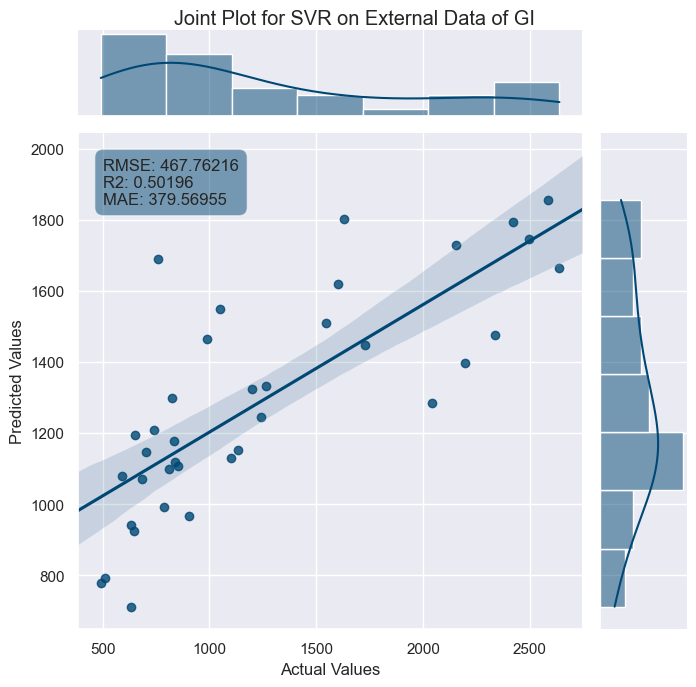

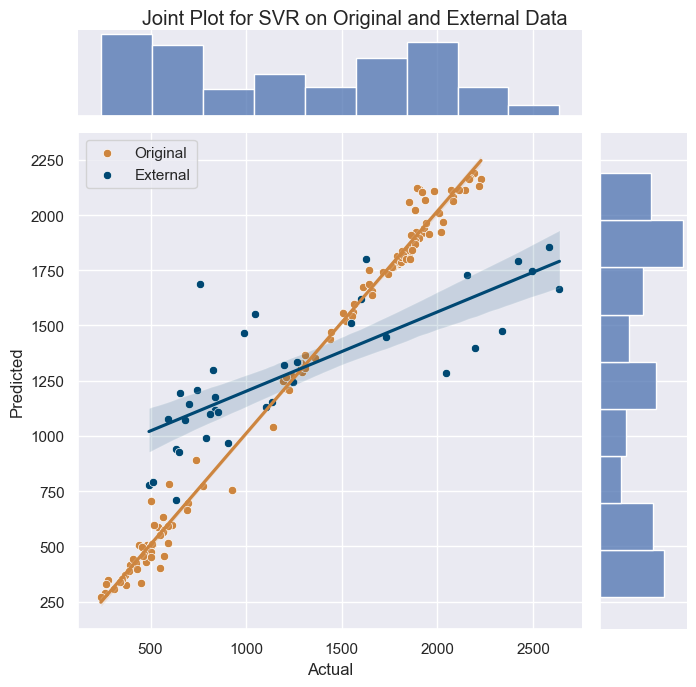

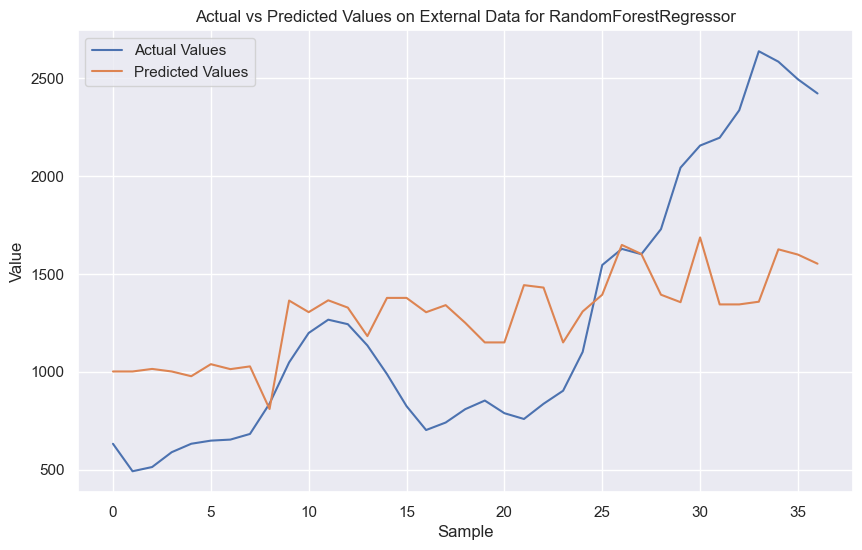

Model: RandomForestRegressor
Train RMSE: 236.52577594694972 Train R2: 0.8762956510958985 Train MAE: 200.1973684379051
Test RMSE: 220.55901673219856 Test R2: 0.8656574932155208 Test MAE: 180.50330291538666
External RMSE: 536.3487212308974 External R2: 0.34519854606007205 External MAE: 443.38165302918406
--------------------------------------------------
Original Dataset - RMSE: 233.3689702153507, R2: 0.8760343517881835, MAE: 196.1945095918648
External Dataset - RMSE: 536.3487212308974, R2: 0.34519854606007205, MAE: 443.38165302918406


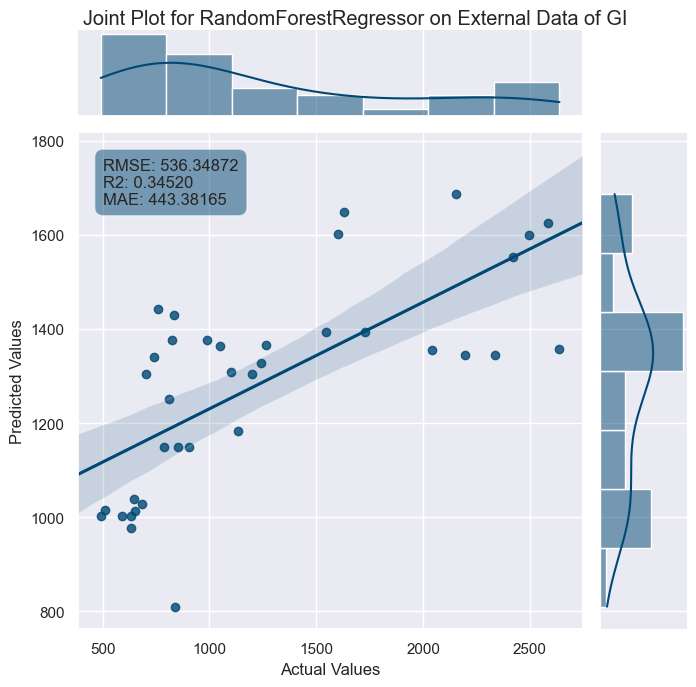

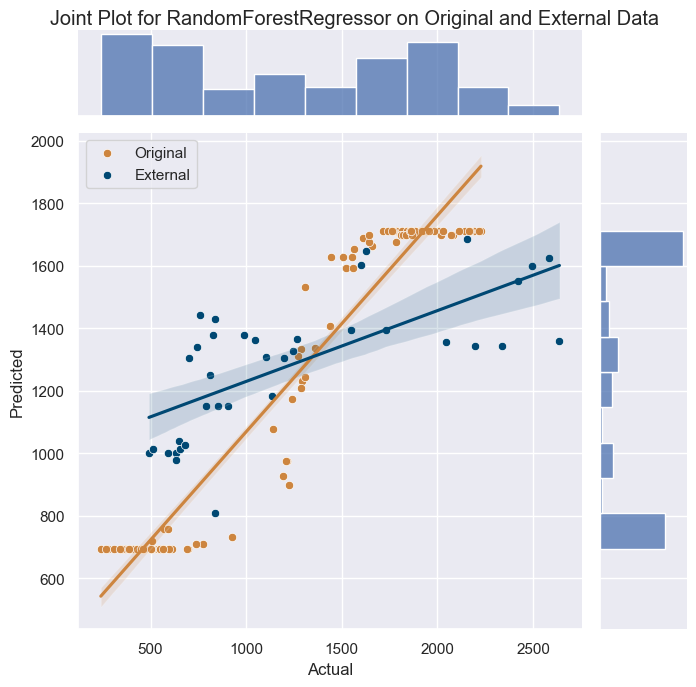

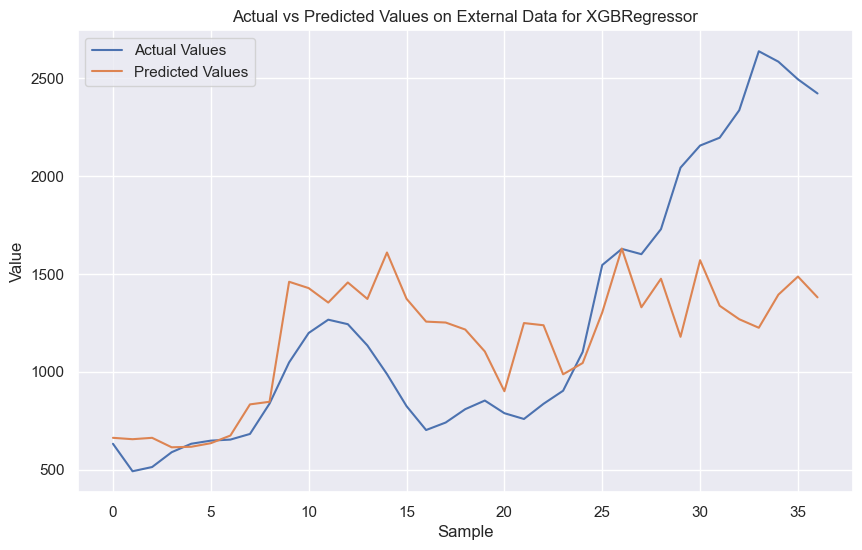

Model: XGBRegressor
Train RMSE: 75.52764281820843 Train R2: 0.9873863760986679 Train MAE: 53.315915826291466
Test RMSE: 83.87987577370592 Test R2: 0.9805697060406802 Test MAE: 61.10086328125001
External RMSE: 545.1344067275694 External R2: 0.3235708360816387 External MAE: 394.447382196087
--------------------------------------------------
Original Dataset - RMSE: 77.29835936286499, R2: 0.9863994745173124, MAE: 54.89822221957571
External Dataset - RMSE: 545.1344067275694, R2: 0.3235708360816387, MAE: 394.447382196087
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000038 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 396
[LightGBM] [Info] Number of data points in the train set: 98, number of used features: 14
[LightGBM] [Info] Start training from score -0.056003
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best 

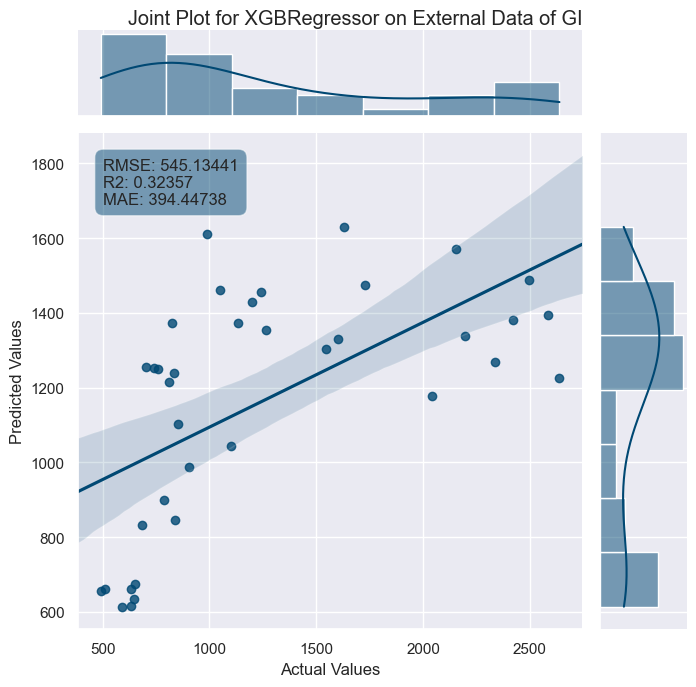

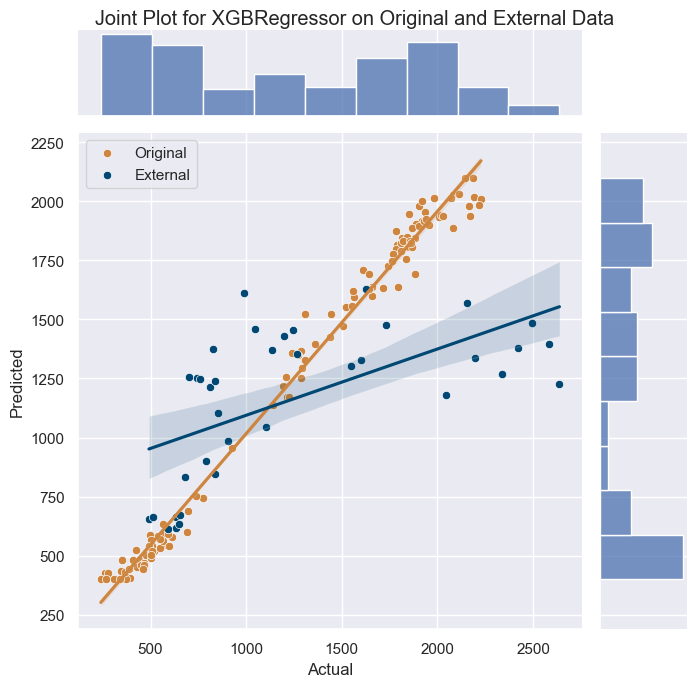

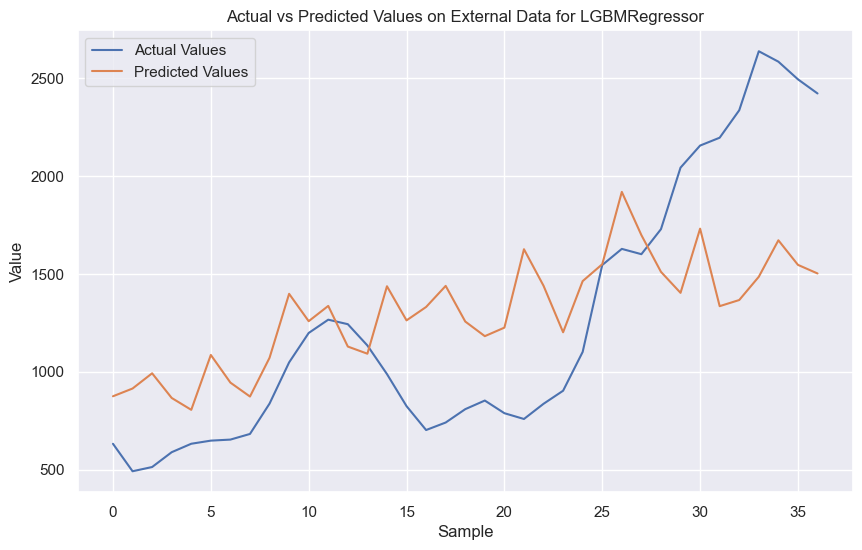

Model: LGBMRegressor
Train RMSE: 37.795068049749396 Train R2: 0.996841373466789 Train MAE: 28.121346399628088
Test RMSE: 97.0181532132643 Test R2: 0.9740061971574627 Test MAE: 79.4182881397626
External RMSE: 533.2401529520614 External R2: 0.35276674298263866 External MAE: 442.85763684718285
--------------------------------------------------
Original Dataset - RMSE: 55.23805347600107, R2: 0.9930546862682972, MAE: 38.54755407038714
External Dataset - RMSE: 533.2401529520614, R2: 0.35276674298263866, MAE: 442.85763684718285


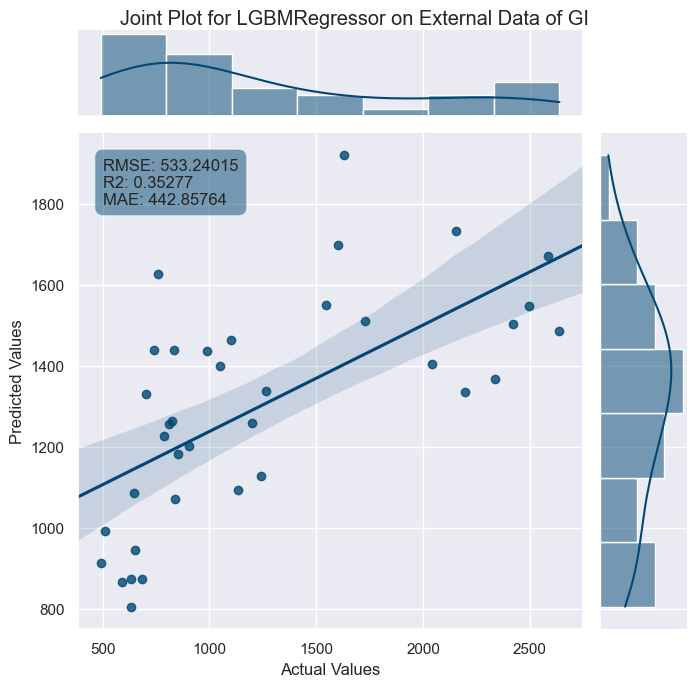

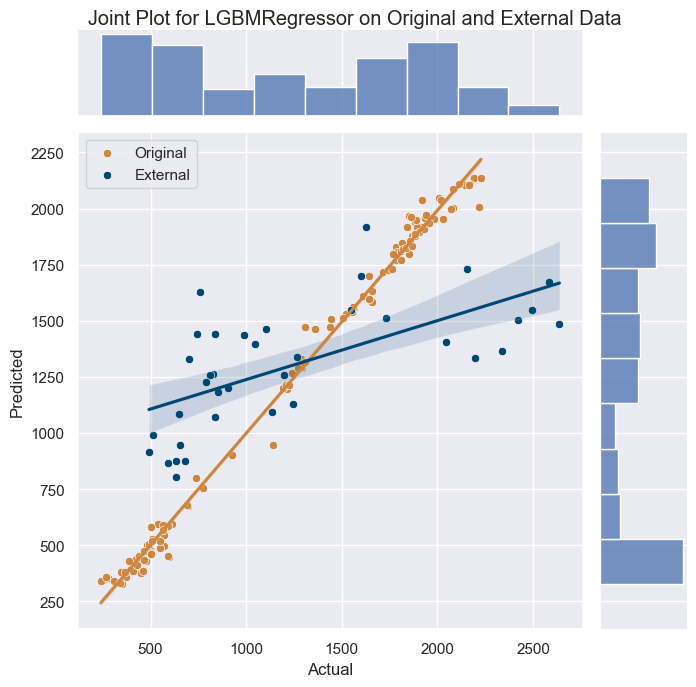

In [5]:
import pandas as pd
import numpy as np
import seaborn as sns
from sklearn.neighbors import KNeighborsRegressor
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from sklearn.preprocessing import StandardScaler
from skopt import BayesSearchCV
from skopt.space import Integer
import matplotlib.pyplot as plt
# Load datasets
data = pd.read_csv("C:\\Users\\Lenovo\\Desktop\\元学习\\BT3-1.csv")
external_data = pd.read_csv("C:\\Users\\Lenovo\\Desktop\\元学习\\BT3-2.csv")

# Normalization function
def normalize_data(data):
    scaler = StandardScaler()
    return scaler.fit_transform(data), scaler

# Normalize datasets
data_normalized, scaler = normalize_data(data)
external_data_normalized, _ = normalize_data(external_data)

# Split the dataset into features and target
X = data_normalized[:, :-1]
y = data_normalized[:, -1]
X_external = external_data_normalized[:, :-1]
y_external = external_data_normalized[:, -1]

# Fit a scaler for the features
feature_scaler = StandardScaler()
X_normalized = feature_scaler.fit_transform(data.drop('Biogas Production', axis=1))

# Fit a separate scaler for the target
target_scaler = StandardScaler()
y_normalized = target_scaler.fit_transform(data[['Biogas Production']])


# Split into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

# Define the hyperparameter space
param_grid = {'n_neighbors': Integer(1, 30)}

# Bayesian optimization
knn_search = BayesSearchCV(KNeighborsRegressor(), param_grid, n_iter=32, cv=5, n_jobs=-1, random_state=0)
knn_search.fit(X_train, y_train)

# Best model
knn_best = knn_search.best_estimator_

# Function to evaluate the model
def evaluate_model(model, X_train, y_train, X_test, y_test, X_external, y_external, target_scaler):
    y_pred_train = model.predict(X_train)
    y_pred_test = model.predict(X_test)
    y_pred_external = model.predict(X_external)

    # Denormalize target values and predictions
    y_train_denorm = target_scaler.inverse_transform(y_train.reshape(-1, 1)).flatten()
    y_test_denorm = target_scaler.inverse_transform(y_test.reshape(-1, 1)).flatten()
    y_external_denorm = target_scaler.inverse_transform(y_external.reshape(-1, 1)).flatten()
    y_pred_train_denorm = target_scaler.inverse_transform(y_pred_train.reshape(-1, 1)).flatten()
    y_pred_test_denorm = target_scaler.inverse_transform(y_pred_test.reshape(-1, 1)).flatten()
    y_pred_external_denorm = target_scaler.inverse_transform(y_pred_external.reshape(-1, 1)).flatten()

    # Visualization of predictions on external data
    plt.figure(figsize=(10, 6))
    plt.plot(y_external_denorm, label='Actual Values')
    plt.plot(y_pred_external_denorm, label='Predicted Values')
    plt.xlabel('Sample')
    plt.ylabel('Value')
    plt.title(f'Actual vs Predicted Values on External Data for {model.__class__.__name__}')
    plt.legend()
    plt.show()

    # Metrics for train and test sets
    train_rmse = mean_squared_error(y_train_denorm, y_pred_train_denorm, squared=False)
    test_rmse = mean_squared_error(y_test_denorm, y_pred_test_denorm, squared=False)
    train_r2 = r2_score(y_train_denorm, y_pred_train_denorm)
    test_r2 = r2_score(y_test_denorm, y_pred_test_denorm)
    train_mae = mean_absolute_error(y_train_denorm, y_pred_train_denorm)
    test_mae = mean_absolute_error(y_test_denorm, y_pred_test_denorm)

    # Metrics for external set
    external_rmse = mean_squared_error(y_external_denorm, y_pred_external_denorm, squared=False)
    external_r2 = r2_score(y_external_denorm, y_pred_external_denorm)
    external_mae = mean_absolute_error(y_external_denorm, y_pred_external_denorm)

    # Text for metrics
    metrics_text = f"RMSE: {external_rmse:.5f}\nR2: {external_r2:.5f}\nMAE: {external_mae:.5f}"

    # Create DataFrame for seaborn joint plot
    external_pred_df = pd.DataFrame({
        'Actual Values': y_external_denorm, 
        'Predicted Values': y_pred_external_denorm
    })

    # Set seaborn theme
    sns.set_theme(style="darkgrid")

    # Create the jointplot for external data with specified color
    g_external = sns.jointplot(x='Actual Values', y='Predicted Values', data=external_pred_df,
                               kind="reg", truncate=False,
                               color="#004873", height=7) 
    
    # Set title for the plot
    g_external.fig.suptitle(f"Joint Plot for {model.__class__.__name__} on External Data of GI")

    # Add metrics as text annotations
    plt.annotate(metrics_text, xy=(0.05, 0.95), xycoords='axes fraction', 
                 ha='left', va='top', bbox=dict(boxstyle='round,pad=0.5', fc="#004873", alpha=0.5))

    # Adjust layout
    g_external.fig.subplots_adjust(top=0.95)

    # Print metrics
    print(f"Model: {model.__class__.__name__}")
    print("Train RMSE:", train_rmse, "Train R2:", train_r2, "Train MAE:", train_mae)
    print("Test RMSE:", test_rmse, "Test R2:", test_r2, "Test MAE:", test_mae)
    print("External RMSE:", external_rmse, "External R2:", external_r2, "External MAE:", external_mae)
    print("--------------------------------------------------")

    # 评估模型并获取训练集和测试集的预测值
    y_pred_train_denorm = target_scaler.inverse_transform(model.predict(X_train).reshape(-1, 1)).flatten()
    y_pred_test_denorm = target_scaler.inverse_transform(model.predict(X_test).reshape(-1, 1)).flatten()

    # 合并训练集和测试集的数据
    original_data_actual = np.concatenate([y_train_denorm, y_test_denorm])
    original_data_predicted = np.concatenate([y_pred_train_denorm, y_pred_test_denorm])

    # 创建包含原始数据集和外部数据集的 DataFrame
    combined_df = pd.DataFrame({
        'Actual': np.concatenate([original_data_actual, y_external_denorm]),
        'Predicted': np.concatenate([original_data_predicted, y_pred_external_denorm]),
        'Dataset': ['Original'] * len(original_data_actual) + ['External'] * len(y_external_denorm)
    })

    # 创建基础 jointplot
    g_combined = sns.jointplot(x='Actual', y='Predicted', data=combined_df, kind="scatter", height=7)

    # 定义两个数据集的颜色
    colors = ['#CD853F', '#004873']

    # 为两个数据集添加不同颜色的散点图和线性回归线
    for dataset, color in zip(['Original', 'External'], colors):
        subset = combined_df[combined_df['Dataset'] == dataset]
        sns.scatterplot(x=subset['Actual'], y=subset['Predicted'], color=color, ax=g_combined.ax_joint, label=dataset)
        sns.regplot(x=subset['Actual'], y=subset['Predicted'], scatter=False, color=color, ax=g_combined.ax_joint)

    # 设置标题和布局
    g_combined.fig.suptitle(f"Joint Plot for {model.__class__.__name__} on Original and External Data")
    g_combined.fig.subplots_adjust(top=0.95)
    # 计算原始数据集的指标
    train_rmse = mean_squared_error(original_data_actual, original_data_predicted, squared=False)
    train_r2 = r2_score(original_data_actual, original_data_predicted)
    train_mae = mean_absolute_error(original_data_actual, original_data_predicted)

    # 计算外部数据集的指标
    external_rmse = mean_squared_error(y_external_denorm, y_pred_external_denorm, squared=False)
    external_r2 = r2_score(y_external_denorm, y_pred_external_denorm)
    external_mae = mean_absolute_error(y_external_denorm, y_pred_external_denorm)


    print(f"Original Dataset - RMSE: {train_rmse}, R2: {train_r2}, MAE: {train_mae}")
    print(f"External Dataset - RMSE: {external_rmse}, R2: {external_r2}, MAE: {external_mae}")

# Evaluate KNN model
evaluate_model(knn_best, X_train, y_train, X_test, y_test, X_external, y_external, target_scaler)

from sklearn.svm import SVR
from skopt.space import Real


param_grid_svm = {
    'C': Real(1e-15, 1e+1, prior='log-uniform'),
    'gamma': Real(1e-15, 1e+1, prior='log-uniform'),
    'epsilon': Real(1e-15, 1e+1, prior='log-uniform')
}


# Bayesian optimization
svm_search = BayesSearchCV(SVR(), param_grid_svm, n_iter=32, cv=5, n_jobs=-1, random_state=0)
svm_search.fit(X_train, y_train)

# Best model
svm_best = svm_search.best_estimator_

# Evaluate SVM model
evaluate_model(svm_best, X_train, y_train, X_test, y_test, X_external, y_external, target_scaler)

from sklearn.ensemble import RandomForestRegressor
from skopt.space import Integer, Real

# Define the hyperparameter space for Random Forest
param_grid_rf = {
    'n_estimators': Integer(10, 100),
    'max_depth': Integer(10, 30),
    'min_samples_split': Real(0.3, 0.8),
    'min_samples_leaf': Real(0.3, 0.8)
}

# Bayesian optimization
rf_search = BayesSearchCV(RandomForestRegressor(random_state=0), param_grid_rf, n_iter=32, cv=5, n_jobs=-1, random_state=0)
rf_search.fit(X_train, y_train)

# Best model
rf_best = rf_search.best_estimator_

# Evaluate Random Forest model
evaluate_model(rf_best, X_train, y_train, X_test, y_test, X_external, y_external, target_scaler)


import xgboost as xgb

# Define the hyperparameter space for XGBoost
param_grid_xgb = {
    'n_estimators': Integer(10, 15),
    'max_depth': Integer(10, 15),
    'learning_rate': Real(0.1, 0.3, 'log-uniform'),
    'subsample': Real(0.1, 0.3),
    'colsample_bytree': Real(0.1, 0.3)
}


# Bayesian optimization
xgb_search = BayesSearchCV(xgb.XGBRegressor(), param_grid_xgb, n_iter=32, cv=5, n_jobs=-1, random_state=0)
xgb_search.fit(X_train, y_train)

# Best model
xgb_best = xgb_search.best_estimator_

# Evaluate XGBoost model
evaluate_model(xgb_best, X_train, y_train, X_test, y_test, X_external, y_external, target_scaler)


import lightgbm as lgb

# Define the hyperparameter space for LightGBM
param_grid_lgb = {
    'n_estimators': Integer(10, 300),
    'max_depth': Integer(-1, 50),
    'learning_rate': Real(0.01, 1.0, 'log-uniform'),
    'num_leaves': Integer(20, 300),
    'subsample': Real(0.1, 1.0),
    'colsample_bytree': Real(0.1, 1.0)
}

# Bayesian optimization
lgb_search = BayesSearchCV(lgb.LGBMRegressor(), param_grid_lgb, n_iter=32, cv=5, n_jobs=-1, random_state=0)
lgb_search.fit(X_train, y_train)

# Best model
lgb_best = lgb_search.best_estimator_

# Evaluate LightGBM model
evaluate_model(lgb_best, X_train, y_train, X_test, y_test, X_external, y_external, target_scaler)

In [6]:
# 创建包含模型名称和其最优超参数的字典
model_hyperparams = {
    'KNN': knn_search.best_params_,
    'SVM': svm_search.best_params_,
    'RandomForest': rf_search.best_params_,
    'XGBoost': xgb_search.best_params_,
    'LightGBM': lgb_search.best_params_
}

# 转换为DataFrame
hyperparams_df = pd.DataFrame.from_dict(model_hyperparams, orient='index')

# 重置索引，使模型名称成为一列
hyperparams_df.reset_index(inplace=True)
hyperparams_df.rename(columns={'index': 'Model'}, inplace=True)

# 指定文件路径和名称，这里替换为你的目标路径
file_path = "C:\\Users\\Lenovo\\Desktop\\元学习\\传统模型超参数\\hyperparams_BT_1_3.csv"

# 保存为CSV文件
hyperparams_df.to_csv(file_path, index=False)

e:\anaconda\envs\yuanxuexi2\lib\site-packages\skopt\optimizer\optimizer.py:449: UserWarning: The objective has been evaluated at this point before.
  warnings.warn("The objective has been evaluated "
e:\anaconda\envs\yuanxuexi2\lib\site-packages\skopt\optimizer\optimizer.py:449: UserWarning: The objective has been evaluated at this point before.
  warnings.warn("The objective has been evaluated "
e:\anaconda\envs\yuanxuexi2\lib\site-packages\skopt\optimizer\optimizer.py:449: UserWarning: The objective has been evaluated at this point before.
  warnings.warn("The objective has been evaluated "
e:\anaconda\envs\yuanxuexi2\lib\site-packages\skopt\optimizer\optimizer.py:449: UserWarning: The objective has been evaluated at this point before.
  warnings.warn("The objective has been evaluated "
e:\anaconda\envs\yuanxuexi2\lib\site-packages\skopt\optimizer\optimizer.py:449: UserWarning: The objective has been evaluated at this point before.
  warnings.warn("The objective has been evaluated "


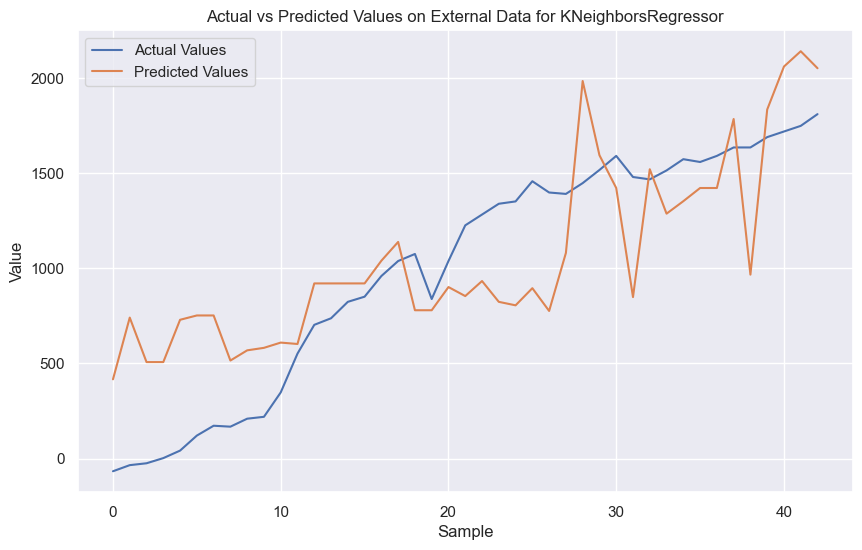

Model: KNeighborsRegressor
Train RMSE: 75.4912981961847 Train R2: 0.983963150635814 Train MAE: 52.19250896057345
Test RMSE: 87.34911820613236 Test R2: 0.980579431946873 Test MAE: 70.29930555555553
External RMSE: 391.10957015291905 External R2: 0.5858008407996478 External MAE: 331.67987825928117
--------------------------------------------------
Original Dataset - RMSE: 78.07063974455092, R2: 0.9834960536403352, MAE: 55.90672364672363
External Dataset - RMSE: 391.10957015291905, R2: 0.5858008407996478, MAE: 331.67987825928117


e:\anaconda\envs\yuanxuexi2\lib\site-packages\skopt\optimizer\optimizer.py:449: UserWarning: The objective has been evaluated at this point before.
  warnings.warn("The objective has been evaluated "


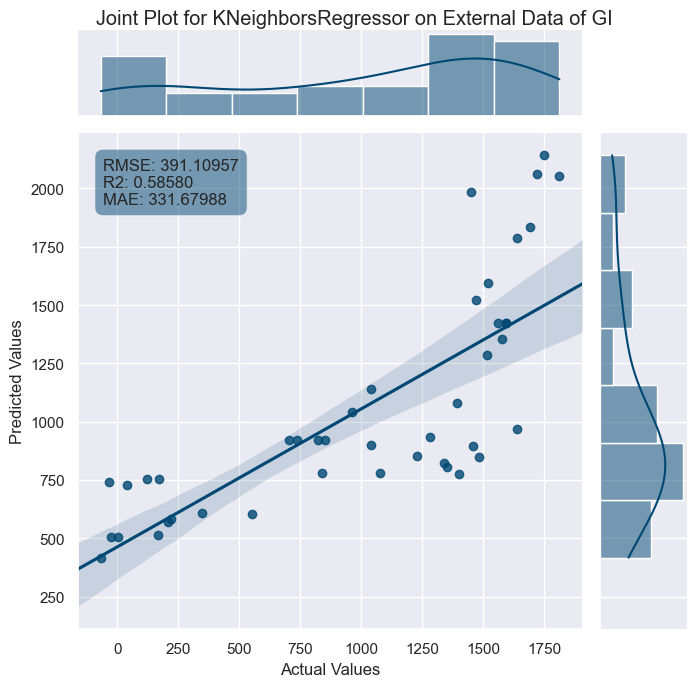

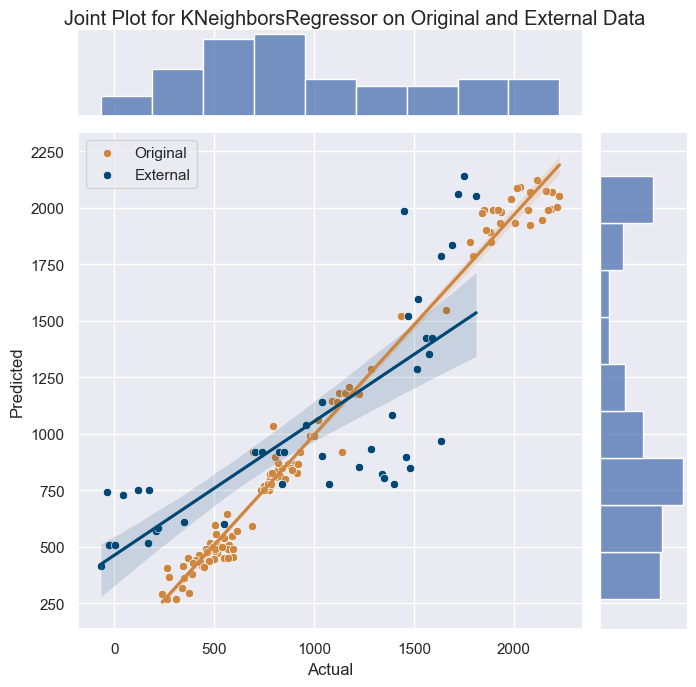

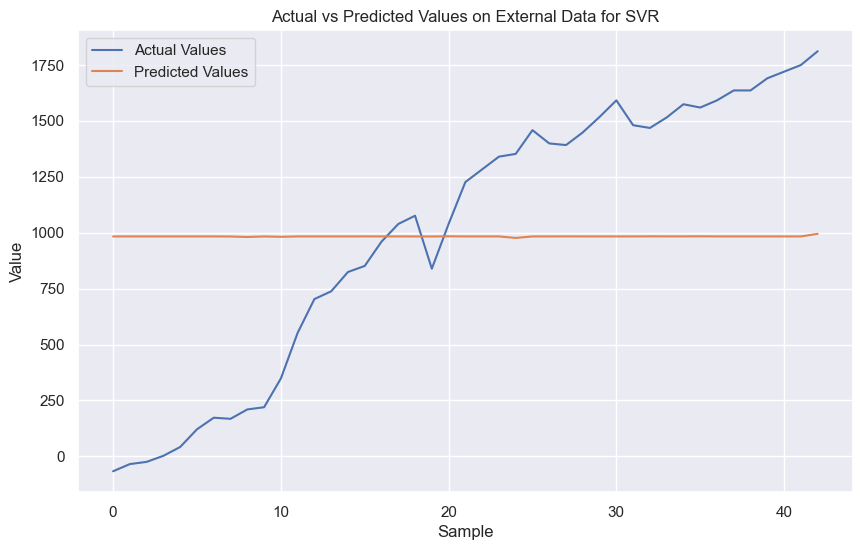

Model: SVR
Train RMSE: 0.15283053789842138 Train R2: 0.9999999342727374 Train MAE: 0.11746378046386817
Test RMSE: 410.4252261538029 Test R2: 0.5712412747896127 Test MAE: 311.23794948551625
External RMSE: 607.6625928269469 External R2: 0.00014428830835366835 External MAE: 536.7979718007499
--------------------------------------------------
Original Dataset - RMSE: 185.88607306210605, R2: 0.9064365919235077, MAE: 63.937050591756666
External Dataset - RMSE: 607.6625928269469, R2: 0.00014428830835366835, MAE: 536.7979718007499


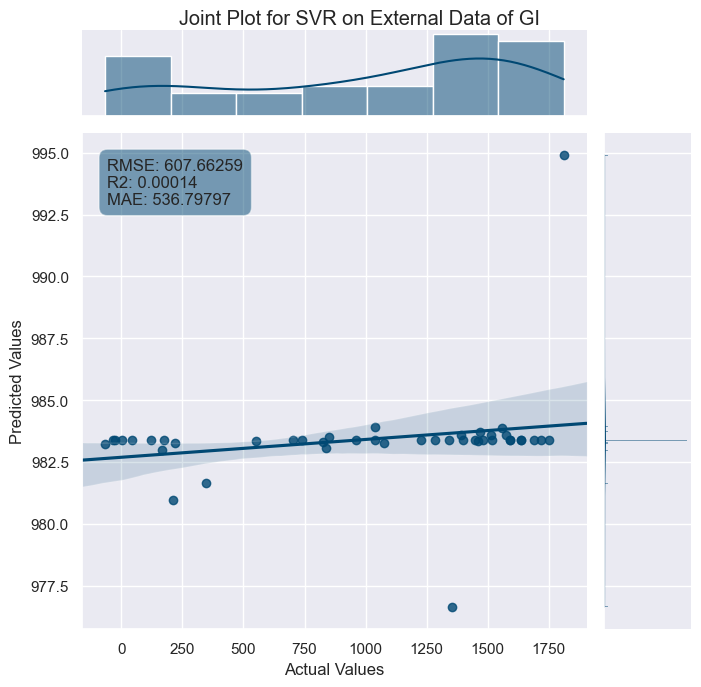

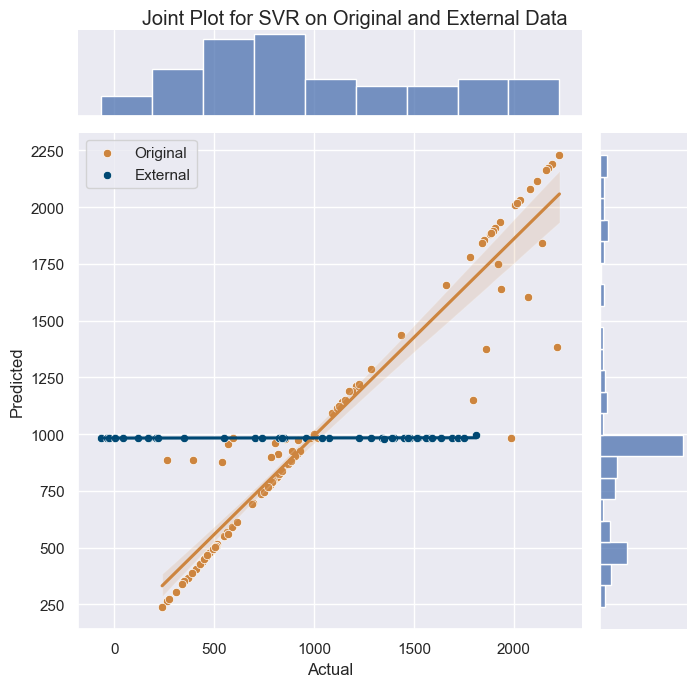

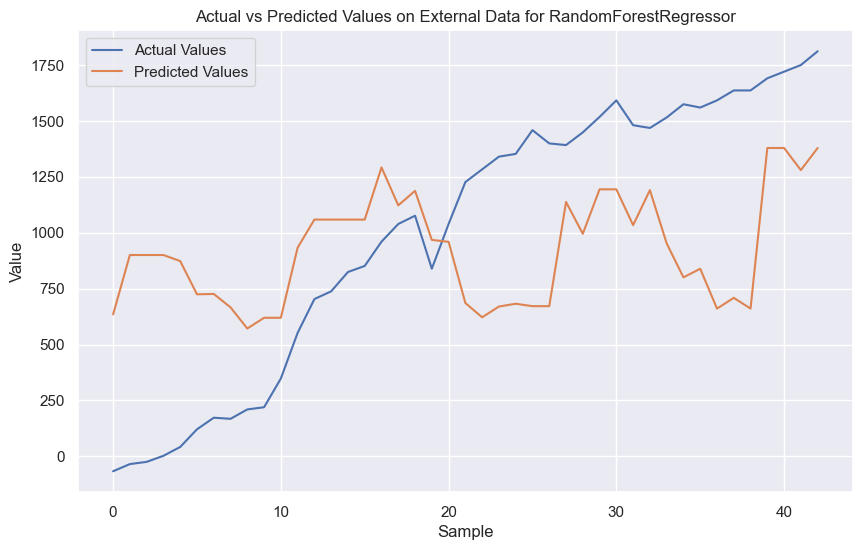

Model: RandomForestRegressor
Train RMSE: 364.56522905517096 Train R2: 0.625996426476723 Train MAE: 287.47526324439724
Test RMSE: 423.4257328918781 Test R2: 0.5436486133645234 Test MAE: 347.2676961615552
External RMSE: 569.7099536212382 External R2: 0.12113950839028453 External MAE: 508.75838261139023
--------------------------------------------------
Original Dataset - RMSE: 377.38835345167604, R2: 0.6143535714703043, MAE: 299.7403776889425
External Dataset - RMSE: 569.7099536212382, R2: 0.12113950839028453, MAE: 508.75838261139023


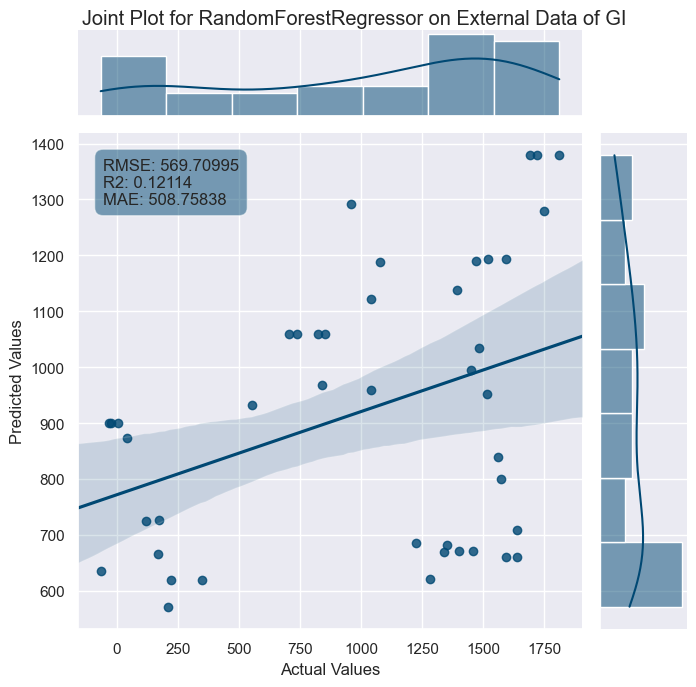

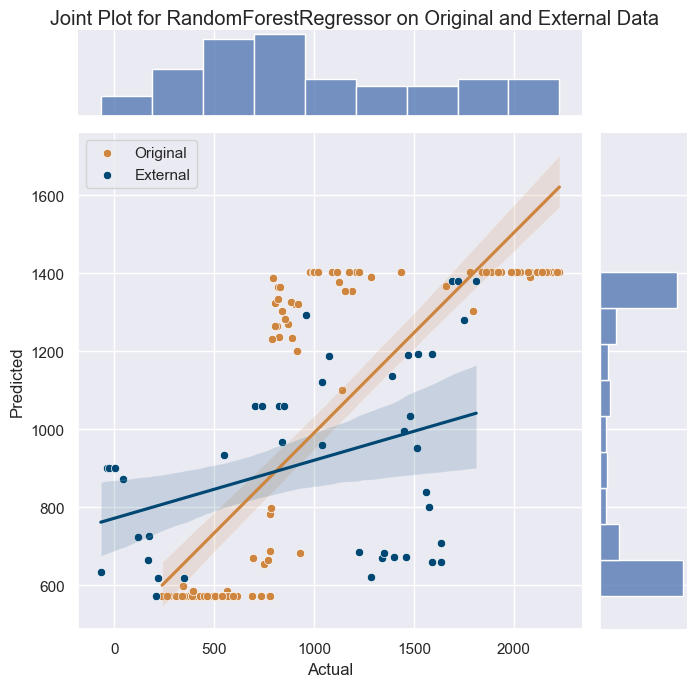

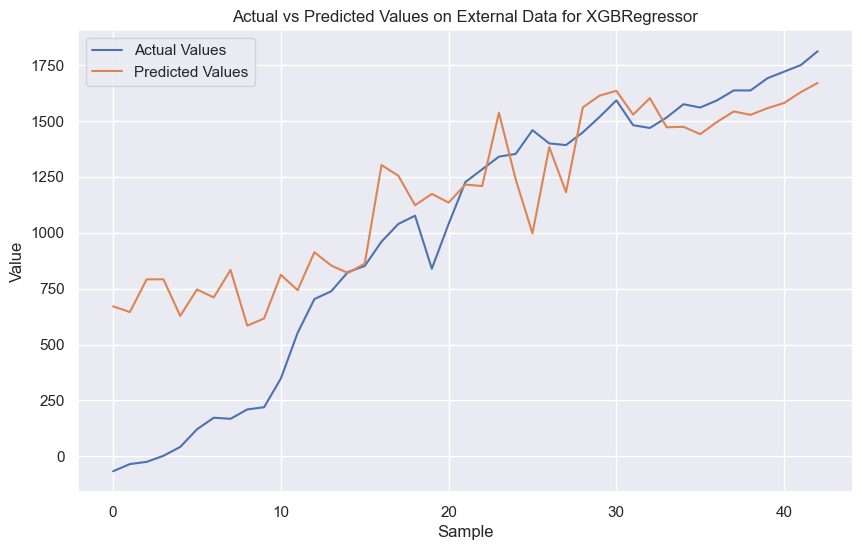

Model: XGBRegressor
Train RMSE: 74.81639206703356 Train R2: 0.9842486136423558 Train MAE: 55.03139725879956
Test RMSE: 111.64757937020042 Test R2: 0.9682719411921069 Test MAE: 89.93570063273114
External RMSE: 345.8846163153943 External R2: 0.6760523600647631 External MAE: 252.4736867695191
--------------------------------------------------
Original Dataset - RMSE: 83.7033412336768, R2: 0.981028664005947, MAE: 62.1912543611445
External Dataset - RMSE: 345.8846163153943, R2: 0.6760523600647631, MAE: 252.4736867695191
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000038 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 368
[LightGBM] [Info] Number of data points in the train set: 93, number of used features: 14
[LightGBM] [Info] Start training from score -0.066073
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

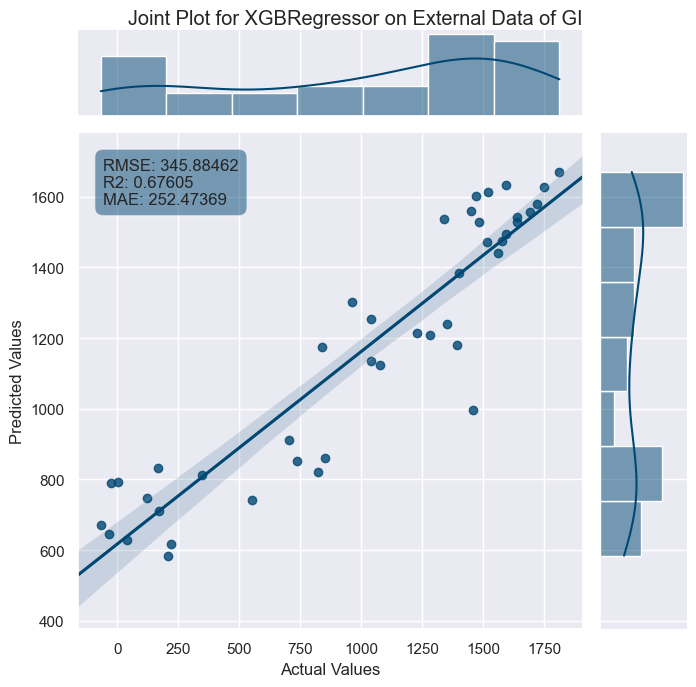

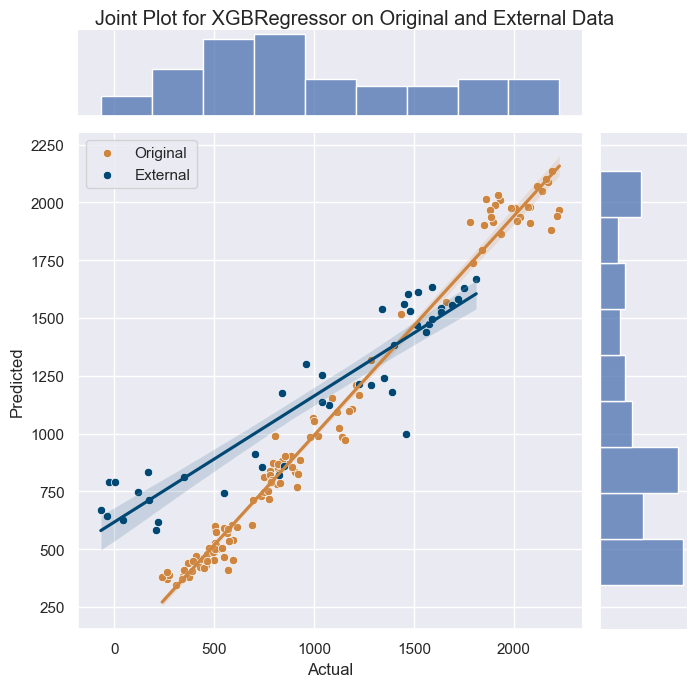

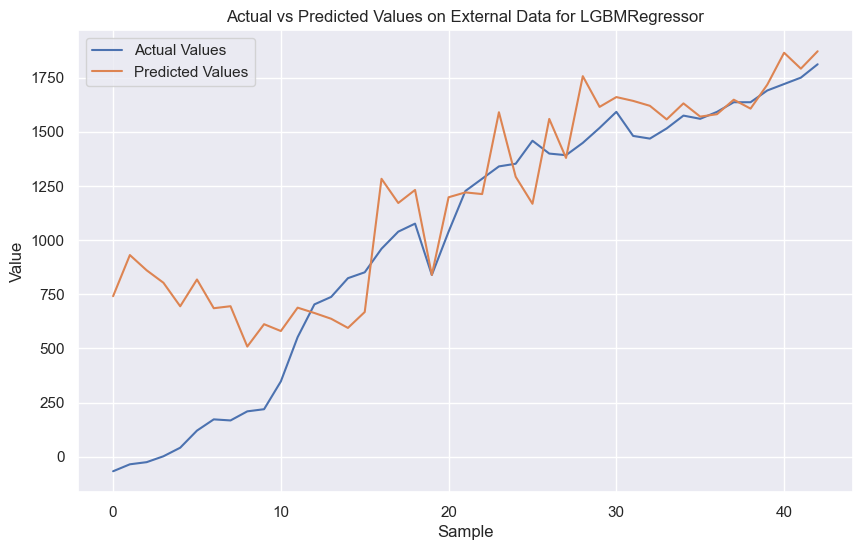

Model: LGBMRegressor
Train RMSE: 38.80733626984739 Train R2: 0.9957620782857094 Train MAE: 30.25436375882835
Test RMSE: 115.60072029459454 Test R2: 0.9659853537305156 Test MAE: 88.3932102997408
External RMSE: 355.11293022804733 External R2: 0.6585357047488161 External MAE: 239.63362959181617
--------------------------------------------------
Original Dataset - RMSE: 62.75604007302222, R2: 0.9893359200986478, MAE: 42.18028099798987
External Dataset - RMSE: 355.11293022804733, R2: 0.6585357047488161, MAE: 239.63362959181617


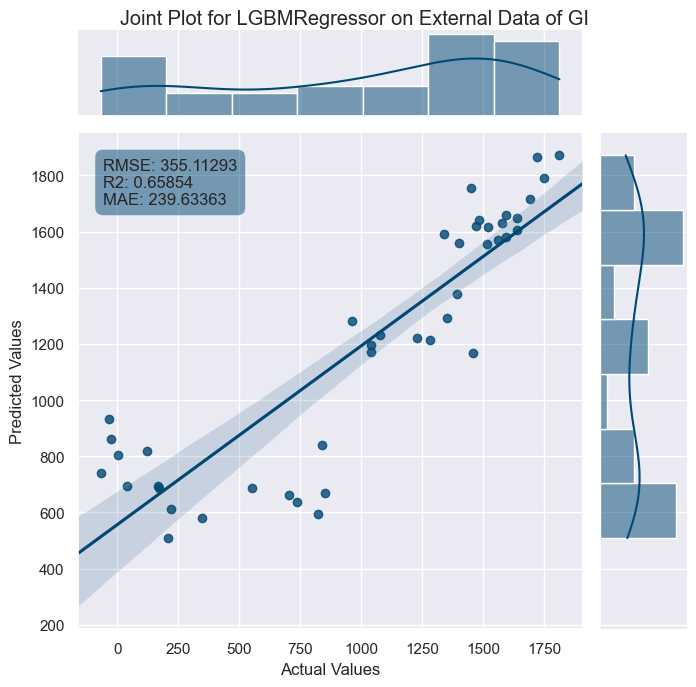

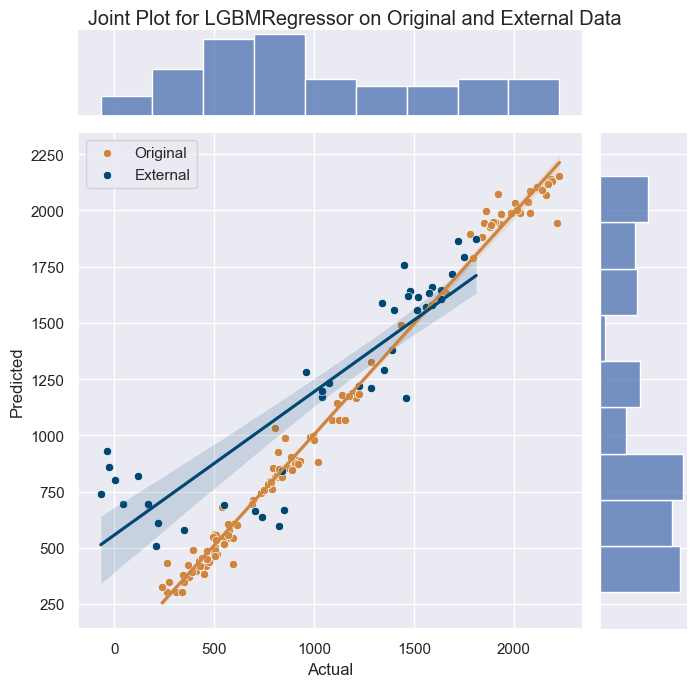

In [7]:
import pandas as pd
import numpy as np
import seaborn as sns
from sklearn.neighbors import KNeighborsRegressor
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from sklearn.preprocessing import StandardScaler
from skopt import BayesSearchCV
from skopt.space import Integer
import matplotlib.pyplot as plt
# Load datasets
data = pd.read_csv("C:\\Users\\Lenovo\\Desktop\\元学习\\BT4-1.csv")
external_data = pd.read_csv("C:\\Users\\Lenovo\\Desktop\\元学习\\BT4-2.csv")

# Normalization function
def normalize_data(data):
    scaler = StandardScaler()
    return scaler.fit_transform(data), scaler

# Normalize datasets
data_normalized, scaler = normalize_data(data)
external_data_normalized, _ = normalize_data(external_data)

# Split the dataset into features and target
X = data_normalized[:, :-1]
y = data_normalized[:, -1]
X_external = external_data_normalized[:, :-1]
y_external = external_data_normalized[:, -1]

# Fit a scaler for the features
feature_scaler = StandardScaler()
X_normalized = feature_scaler.fit_transform(data.drop('Biogas Production', axis=1))

# Fit a separate scaler for the target
target_scaler = StandardScaler()
y_normalized = target_scaler.fit_transform(data[['Biogas Production']])


# Split into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

# Define the hyperparameter space
param_grid = {'n_neighbors': Integer(1, 30)}

# Bayesian optimization
knn_search = BayesSearchCV(KNeighborsRegressor(), param_grid, n_iter=32, cv=5, n_jobs=-1, random_state=0)
knn_search.fit(X_train, y_train)

# Best model
knn_best = knn_search.best_estimator_

# Function to evaluate the model
def evaluate_model(model, X_train, y_train, X_test, y_test, X_external, y_external, target_scaler):
    y_pred_train = model.predict(X_train)
    y_pred_test = model.predict(X_test)
    y_pred_external = model.predict(X_external)

    # Denormalize target values and predictions
    y_train_denorm = target_scaler.inverse_transform(y_train.reshape(-1, 1)).flatten()
    y_test_denorm = target_scaler.inverse_transform(y_test.reshape(-1, 1)).flatten()
    y_external_denorm = target_scaler.inverse_transform(y_external.reshape(-1, 1)).flatten()
    y_pred_train_denorm = target_scaler.inverse_transform(y_pred_train.reshape(-1, 1)).flatten()
    y_pred_test_denorm = target_scaler.inverse_transform(y_pred_test.reshape(-1, 1)).flatten()
    y_pred_external_denorm = target_scaler.inverse_transform(y_pred_external.reshape(-1, 1)).flatten()

    # Visualization of predictions on external data
    plt.figure(figsize=(10, 6))
    plt.plot(y_external_denorm, label='Actual Values')
    plt.plot(y_pred_external_denorm, label='Predicted Values')
    plt.xlabel('Sample')
    plt.ylabel('Value')
    plt.title(f'Actual vs Predicted Values on External Data for {model.__class__.__name__}')
    plt.legend()
    plt.show()

    # Metrics for train and test sets
    train_rmse = mean_squared_error(y_train_denorm, y_pred_train_denorm, squared=False)
    test_rmse = mean_squared_error(y_test_denorm, y_pred_test_denorm, squared=False)
    train_r2 = r2_score(y_train_denorm, y_pred_train_denorm)
    test_r2 = r2_score(y_test_denorm, y_pred_test_denorm)
    train_mae = mean_absolute_error(y_train_denorm, y_pred_train_denorm)
    test_mae = mean_absolute_error(y_test_denorm, y_pred_test_denorm)

    # Metrics for external set
    external_rmse = mean_squared_error(y_external_denorm, y_pred_external_denorm, squared=False)
    external_r2 = r2_score(y_external_denorm, y_pred_external_denorm)
    external_mae = mean_absolute_error(y_external_denorm, y_pred_external_denorm)

    # Text for metrics
    metrics_text = f"RMSE: {external_rmse:.5f}\nR2: {external_r2:.5f}\nMAE: {external_mae:.5f}"

    # Create DataFrame for seaborn joint plot
    external_pred_df = pd.DataFrame({
        'Actual Values': y_external_denorm, 
        'Predicted Values': y_pred_external_denorm
    })

    # Set seaborn theme
    sns.set_theme(style="darkgrid")

    # Create the jointplot for external data with specified color
    g_external = sns.jointplot(x='Actual Values', y='Predicted Values', data=external_pred_df,
                               kind="reg", truncate=False,
                               color="#004873", height=7) 
    
    # Set title for the plot
    g_external.fig.suptitle(f"Joint Plot for {model.__class__.__name__} on External Data of GI")

    # Add metrics as text annotations
    plt.annotate(metrics_text, xy=(0.05, 0.95), xycoords='axes fraction', 
                 ha='left', va='top', bbox=dict(boxstyle='round,pad=0.5', fc="#004873", alpha=0.5))

    # Adjust layout
    g_external.fig.subplots_adjust(top=0.95)

    # Print metrics
    print(f"Model: {model.__class__.__name__}")
    print("Train RMSE:", train_rmse, "Train R2:", train_r2, "Train MAE:", train_mae)
    print("Test RMSE:", test_rmse, "Test R2:", test_r2, "Test MAE:", test_mae)
    print("External RMSE:", external_rmse, "External R2:", external_r2, "External MAE:", external_mae)
    print("--------------------------------------------------")

    # 评估模型并获取训练集和测试集的预测值
    y_pred_train_denorm = target_scaler.inverse_transform(model.predict(X_train).reshape(-1, 1)).flatten()
    y_pred_test_denorm = target_scaler.inverse_transform(model.predict(X_test).reshape(-1, 1)).flatten()

    # 合并训练集和测试集的数据
    original_data_actual = np.concatenate([y_train_denorm, y_test_denorm])
    original_data_predicted = np.concatenate([y_pred_train_denorm, y_pred_test_denorm])

    # 创建包含原始数据集和外部数据集的 DataFrame
    combined_df = pd.DataFrame({
        'Actual': np.concatenate([original_data_actual, y_external_denorm]),
        'Predicted': np.concatenate([original_data_predicted, y_pred_external_denorm]),
        'Dataset': ['Original'] * len(original_data_actual) + ['External'] * len(y_external_denorm)
    })

    # 创建基础 jointplot
    g_combined = sns.jointplot(x='Actual', y='Predicted', data=combined_df, kind="scatter", height=7)

    # 定义两个数据集的颜色
    colors = ['#CD853F', '#004873']

    # 为两个数据集添加不同颜色的散点图和线性回归线
    for dataset, color in zip(['Original', 'External'], colors):
        subset = combined_df[combined_df['Dataset'] == dataset]
        sns.scatterplot(x=subset['Actual'], y=subset['Predicted'], color=color, ax=g_combined.ax_joint, label=dataset)
        sns.regplot(x=subset['Actual'], y=subset['Predicted'], scatter=False, color=color, ax=g_combined.ax_joint)

    # 设置标题和布局
    g_combined.fig.suptitle(f"Joint Plot for {model.__class__.__name__} on Original and External Data")
    g_combined.fig.subplots_adjust(top=0.95)
    # 计算原始数据集的指标
    train_rmse = mean_squared_error(original_data_actual, original_data_predicted, squared=False)
    train_r2 = r2_score(original_data_actual, original_data_predicted)
    train_mae = mean_absolute_error(original_data_actual, original_data_predicted)

    # 计算外部数据集的指标
    external_rmse = mean_squared_error(y_external_denorm, y_pred_external_denorm, squared=False)
    external_r2 = r2_score(y_external_denorm, y_pred_external_denorm)
    external_mae = mean_absolute_error(y_external_denorm, y_pred_external_denorm)


    print(f"Original Dataset - RMSE: {train_rmse}, R2: {train_r2}, MAE: {train_mae}")
    print(f"External Dataset - RMSE: {external_rmse}, R2: {external_r2}, MAE: {external_mae}")

# Evaluate KNN model
evaluate_model(knn_best, X_train, y_train, X_test, y_test, X_external, y_external, target_scaler)

from sklearn.svm import SVR
from skopt.space import Real

# Define the hyperparameter space for SVM
param_grid_svm = {
    'C': Real(1e-15, 1e+1, prior='log-uniform'),
    'gamma': Real(1e-15, 1e+1, prior='log-uniform'),
    'epsilon': Real(1e-15, 1e+1, prior='log-uniform')
}

# Bayesian optimization
svm_search = BayesSearchCV(SVR(), param_grid_svm, n_iter=32, cv=5, n_jobs=-1, random_state=0)
svm_search.fit(X_train, y_train)

# Best model
svm_best = svm_search.best_estimator_

# Evaluate SVM model
evaluate_model(svm_best, X_train, y_train, X_test, y_test, X_external, y_external, target_scaler)

from sklearn.ensemble import RandomForestRegressor
from skopt.space import Integer, Real

# Define the hyperparameter space for Random Forest
param_grid_rf = {
    'n_estimators': Integer(10, 100),
    'max_depth': Integer(10, 30),
    'min_samples_split': Real(0.3, 0.8),
    'min_samples_leaf': Real(0.3, 0.8)
}

# Bayesian optimization
rf_search = BayesSearchCV(RandomForestRegressor(random_state=0), param_grid_rf, n_iter=32, cv=5, n_jobs=-1, random_state=0)
rf_search.fit(X_train, y_train)

# Best model
rf_best = rf_search.best_estimator_

# Evaluate Random Forest model
evaluate_model(rf_best, X_train, y_train, X_test, y_test, X_external, y_external, target_scaler)


import xgboost as xgb

# Define the hyperparameter space for XGBoost
param_grid_xgb = {
    'n_estimators': Integer(10, 15),
    'max_depth': Integer(10, 15),
    'learning_rate': Real(0.1, 0.3, 'log-uniform'),
    'subsample': Real(0.1, 0.3),
    'colsample_bytree': Real(0.1, 0.3)
}

# Bayesian optimization
xgb_search = BayesSearchCV(xgb.XGBRegressor(), param_grid_xgb, n_iter=32, cv=5, n_jobs=-1, random_state=0)
xgb_search.fit(X_train, y_train)

# Best model
xgb_best = xgb_search.best_estimator_

# Evaluate XGBoost model
evaluate_model(xgb_best, X_train, y_train, X_test, y_test, X_external, y_external, target_scaler)


import lightgbm as lgb

# Define the hyperparameter space for LightGBM
param_grid_lgb = {
    'n_estimators': Integer(10, 300),
    'max_depth': Integer(-1, 50),
    'learning_rate': Real(0.01, 1.0, 'log-uniform'),
    'num_leaves': Integer(20, 300),
    'subsample': Real(0.1, 1.0),
    'colsample_bytree': Real(0.1, 1.0)
}

# Bayesian optimization
lgb_search = BayesSearchCV(lgb.LGBMRegressor(), param_grid_lgb, n_iter=32, cv=5, n_jobs=-1, random_state=0)
lgb_search.fit(X_train, y_train)

# Best model
lgb_best = lgb_search.best_estimator_

# Evaluate LightGBM model
evaluate_model(lgb_best, X_train, y_train, X_test, y_test, X_external, y_external, target_scaler)

In [8]:
# 创建包含模型名称和其最优超参数的字典
model_hyperparams = {
    'KNN': knn_search.best_params_,
    'SVM': svm_search.best_params_,
    'RandomForest': rf_search.best_params_,
    'XGBoost': xgb_search.best_params_,
    'LightGBM': lgb_search.best_params_
}

# 转换为DataFrame
hyperparams_df = pd.DataFrame.from_dict(model_hyperparams, orient='index')

# 重置索引，使模型名称成为一列
hyperparams_df.reset_index(inplace=True)
hyperparams_df.rename(columns={'index': 'Model'}, inplace=True)

# 指定文件路径和名称，这里替换为你的目标路径
file_path = "C:\\Users\\Lenovo\\Desktop\\元学习\\传统模型超参数\\hyperparams_BT_1_4.csv"

# 保存为CSV文件
hyperparams_df.to_csv(file_path, index=False)

2.两部分样本用于训练

e:\anaconda\envs\yuanxuexi2\lib\site-packages\skopt\optimizer\optimizer.py:449: UserWarning: The objective has been evaluated at this point before.
  warnings.warn("The objective has been evaluated "
e:\anaconda\envs\yuanxuexi2\lib\site-packages\skopt\optimizer\optimizer.py:449: UserWarning: The objective has been evaluated at this point before.
  warnings.warn("The objective has been evaluated "
e:\anaconda\envs\yuanxuexi2\lib\site-packages\skopt\optimizer\optimizer.py:449: UserWarning: The objective has been evaluated at this point before.
  warnings.warn("The objective has been evaluated "
e:\anaconda\envs\yuanxuexi2\lib\site-packages\skopt\optimizer\optimizer.py:449: UserWarning: The objective has been evaluated at this point before.
  warnings.warn("The objective has been evaluated "
e:\anaconda\envs\yuanxuexi2\lib\site-packages\skopt\optimizer\optimizer.py:449: UserWarning: The objective has been evaluated at this point before.
  warnings.warn("The objective has been evaluated "


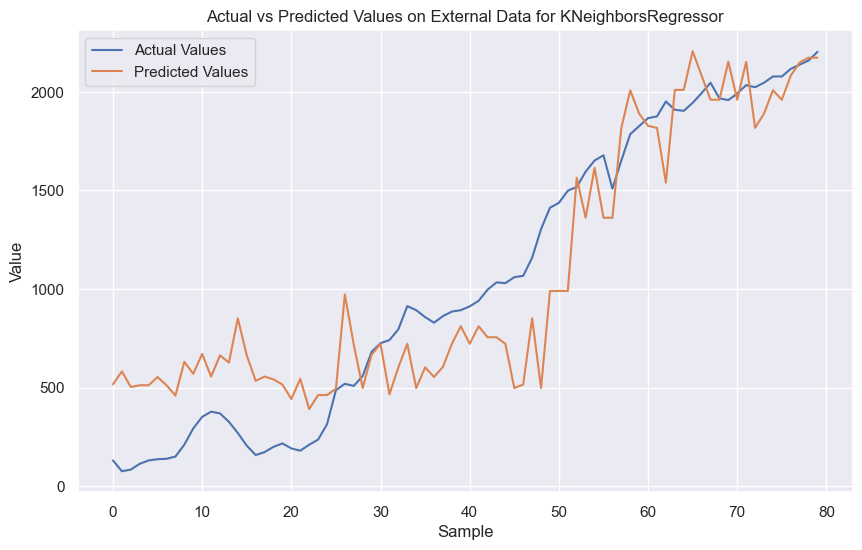

Model: KNeighborsRegressor
Train RMSE: 66.6338129841937 Train R2: 0.9920400932314444 Train MAE: 49.857187499999995
Test RMSE: 122.55716935755942 Test R2: 0.9303256974279183 Test MAE: 92.5284375
External RMSE: 295.26254226936464 External R2: 0.8338357098132404 External MAE: 244.53805517594628
--------------------------------------------------
Original Dataset - RMSE: 80.96977200435666, R2: 0.9875041207502034, MAE: 58.391437499999995
External Dataset - RMSE: 295.26254226936464, R2: 0.8338357098132404, MAE: 244.53805517594628


e:\anaconda\envs\yuanxuexi2\lib\site-packages\skopt\optimizer\optimizer.py:449: UserWarning: The objective has been evaluated at this point before.
  warnings.warn("The objective has been evaluated "


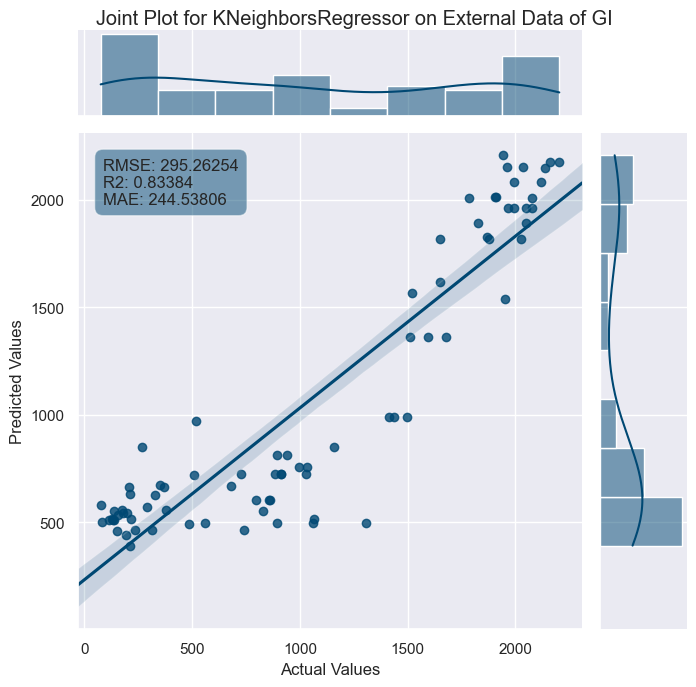

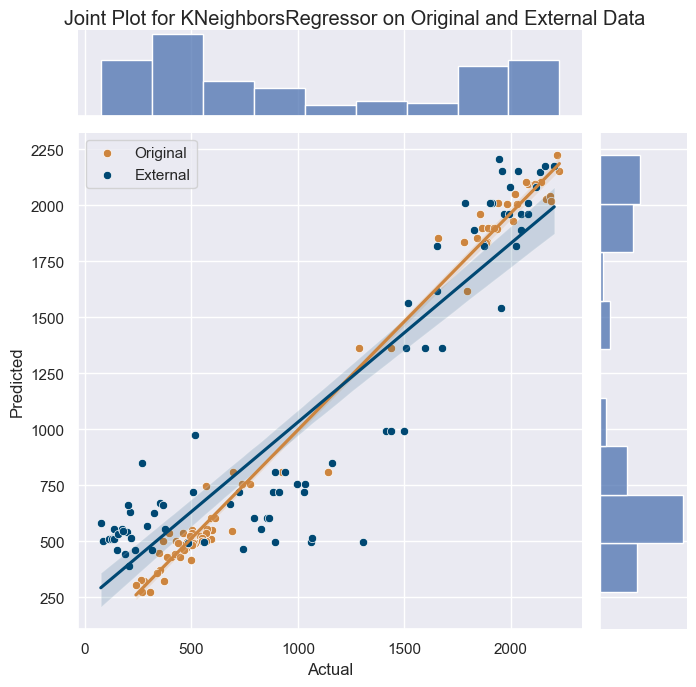

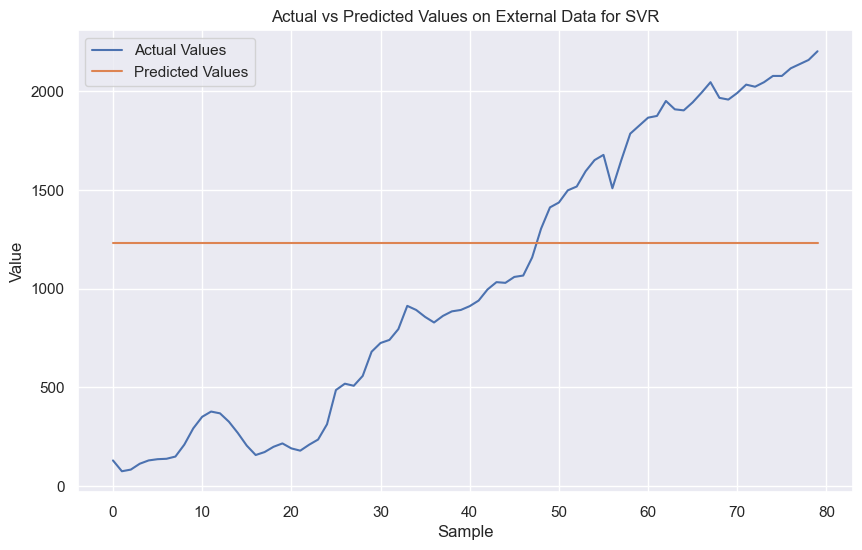

Model: SVR
Train RMSE: 752.6621344818752 Train R2: -0.01559086386144548 Train MAE: 731.53703125
Test RMSE: 729.7438412724016 Test R2: -1.4702224454987491 Test MAE: 701.60625
External RMSE: 748.1346441124418 External R2: -0.06679388981459766 External MAE: 679.0912155229285
--------------------------------------------------
Original Dataset - RMSE: 748.1346441124418, R2: -0.06679388981459766, MAE: 725.5508750000001
External Dataset - RMSE: 748.1346441124418, R2: -0.06679388981459766, MAE: 679.0912155229285


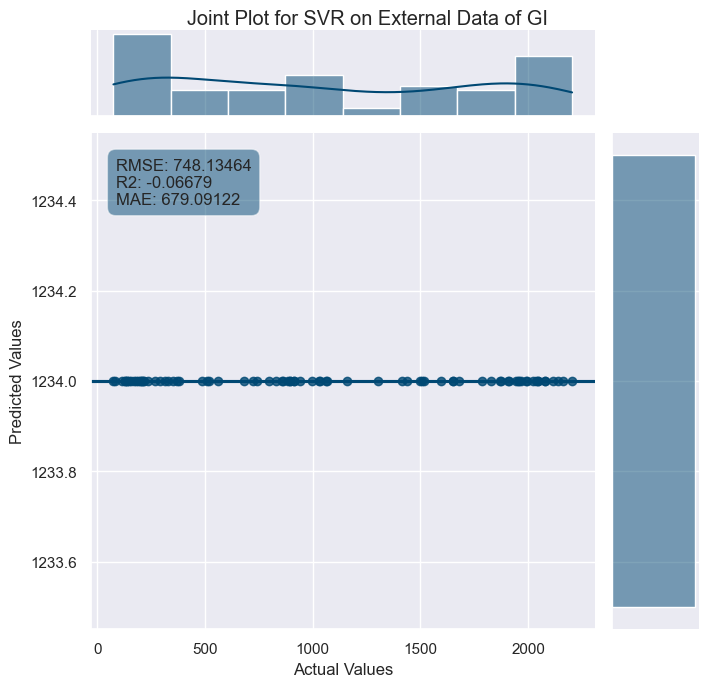

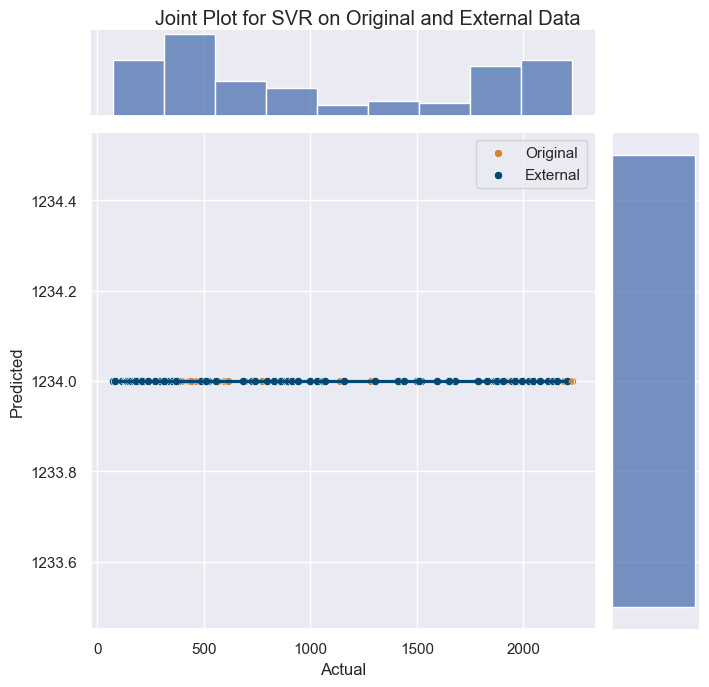

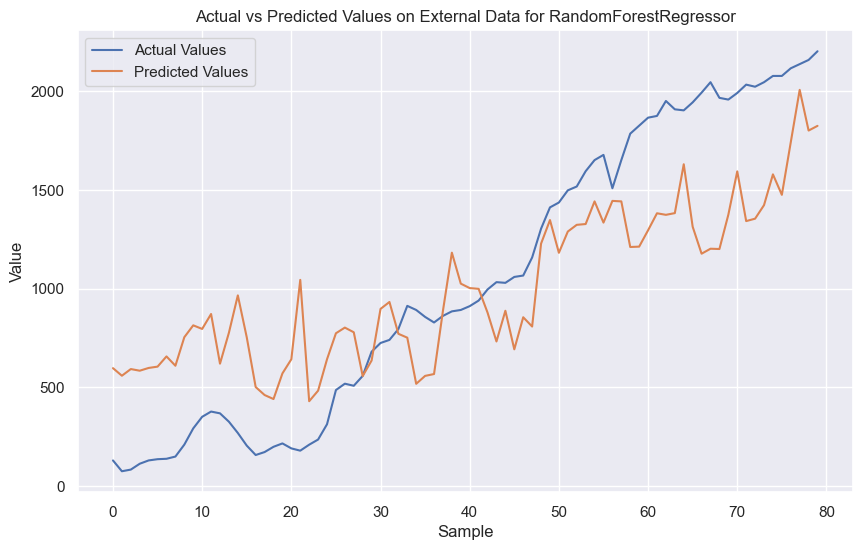

Model: RandomForestRegressor
Train RMSE: 108.06063389467649 Train R2: 0.9790659300262514 Train MAE: 76.02923578921032
Test RMSE: 69.0865531664332 Test R2: 0.9778597644016752 Test MAE: 54.82849100116674
External RMSE: 422.2571864883581 External R2: 0.6601595372545892 External MAE: 368.72927378611803
--------------------------------------------------
Original Dataset - RMSE: 101.4705417540437, R2: 0.9803753940432886, MAE: 71.7890868316016
External Dataset - RMSE: 422.2571864883581, R2: 0.6601595372545892, MAE: 368.72927378611803


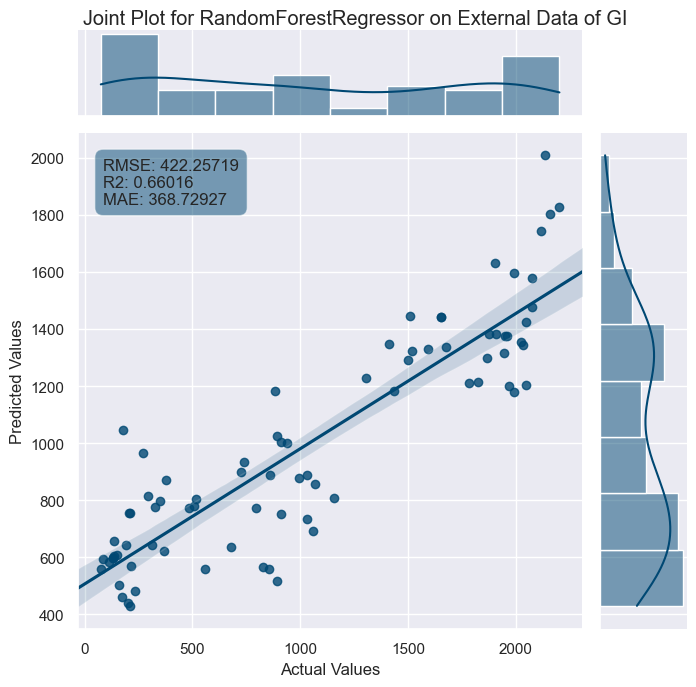

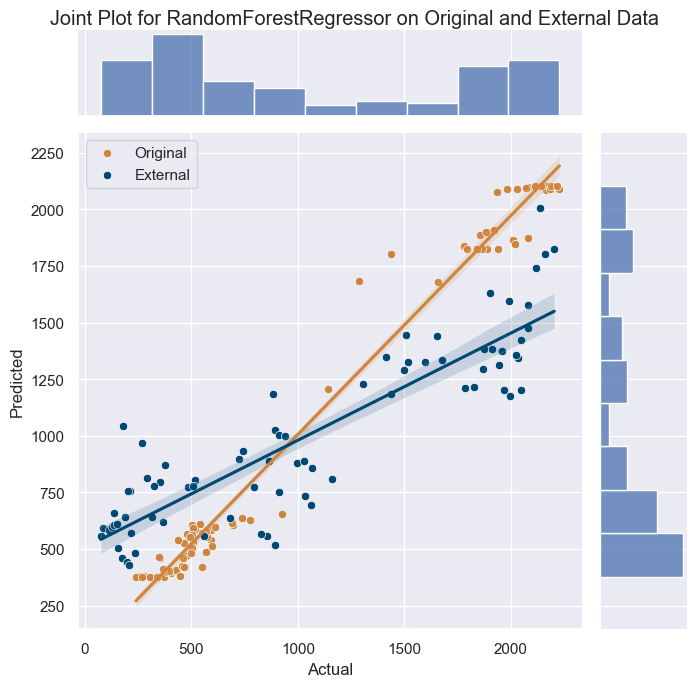

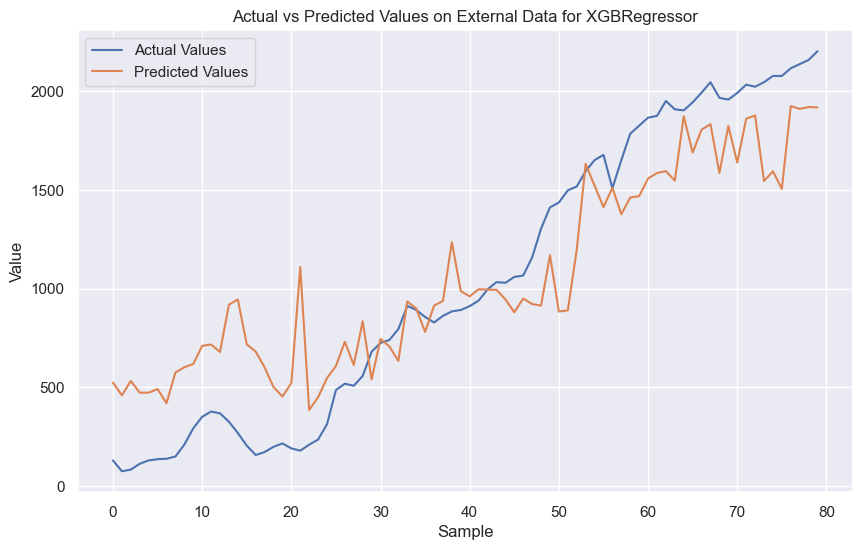

Model: XGBRegressor
Train RMSE: 0.36773327210817175 Train R2: 0.9999997575710379 Train MAE: 0.2855318737030039
Test RMSE: 75.1880824074249 Test R2: 0.9737763461118877 Test MAE: 61.869451179504395
External RMSE: 322.76008955177394 External R2: 0.8014450851401571 External MAE: 270.2258018267694
--------------------------------------------------
Original Dataset - RMSE: 33.62674128470786, R2: 0.9978447852422435, MAE: 12.602315734863282
External Dataset - RMSE: 322.76008955177394, R2: 0.8014450851401571, MAE: 270.2258018267694
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000036 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 276
[LightGBM] [Info] Number of data points in the train set: 64, number of used features: 14
[LightGBM] [Info] Start training from score 0.129698
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

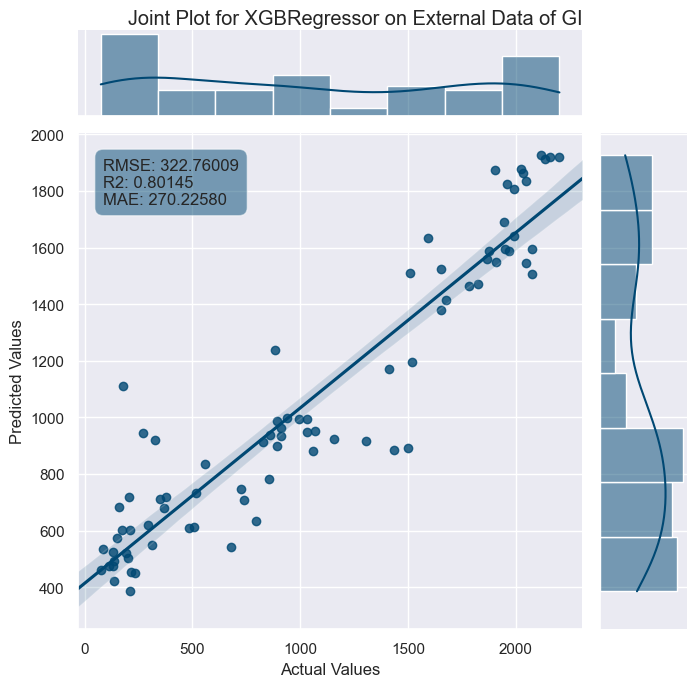

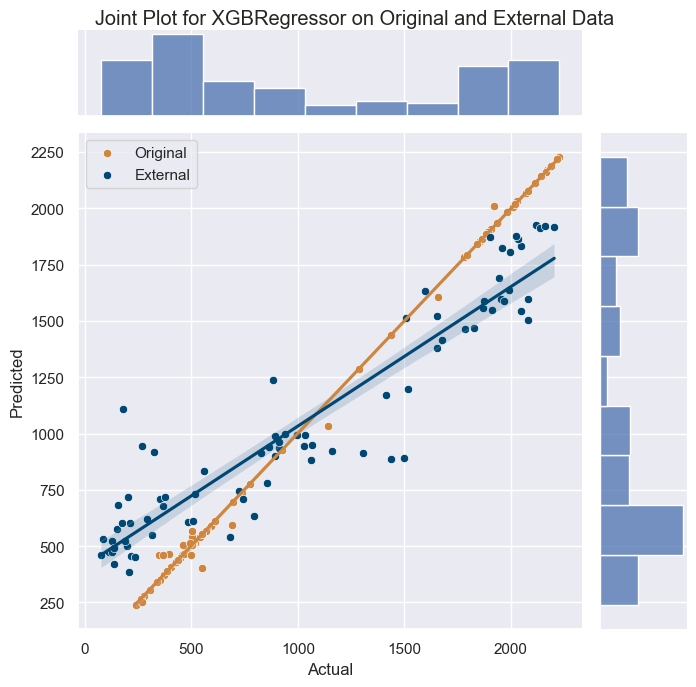

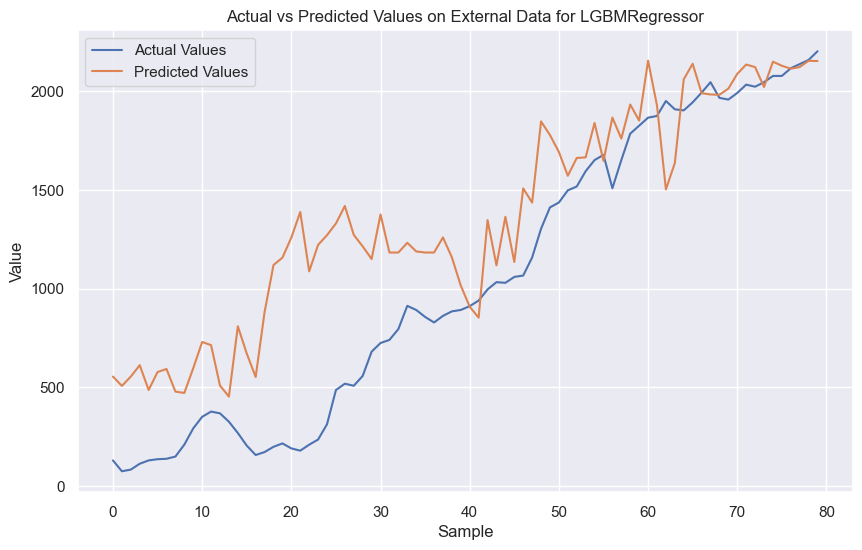

Model: LGBMRegressor
Train RMSE: 70.59347272617897 Train R2: 0.991065963068026 Train MAE: 59.025376430503655
Test RMSE: 100.89164691800458 Test R2: 0.9527822150951737 Test MAE: 68.23452171017033
External RMSE: 447.67249690469896 External R2: 0.6180189527177857 External MAE: 341.0800170771983
--------------------------------------------------
Original Dataset - RMSE: 77.60525495608451, R2: 0.9885210213752122, MAE: 60.86720548643698
External Dataset - RMSE: 447.67249690469896, R2: 0.6180189527177857, MAE: 341.0800170771983


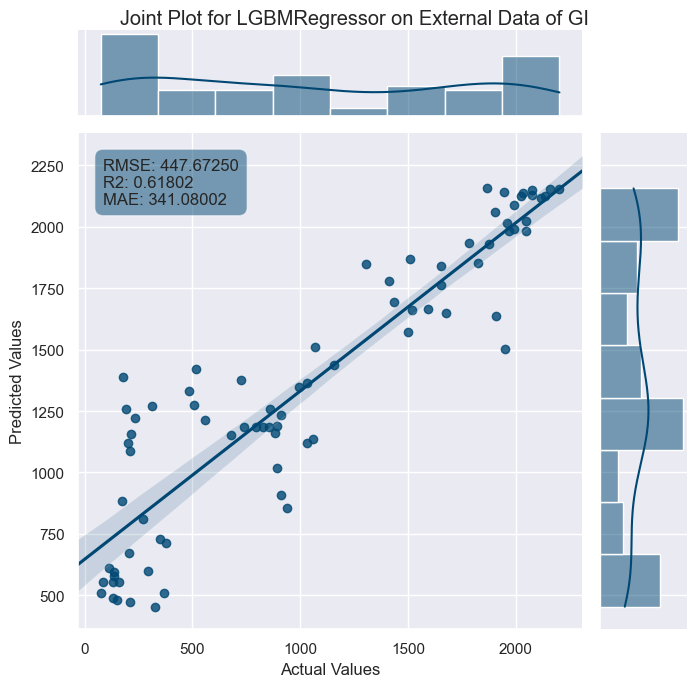

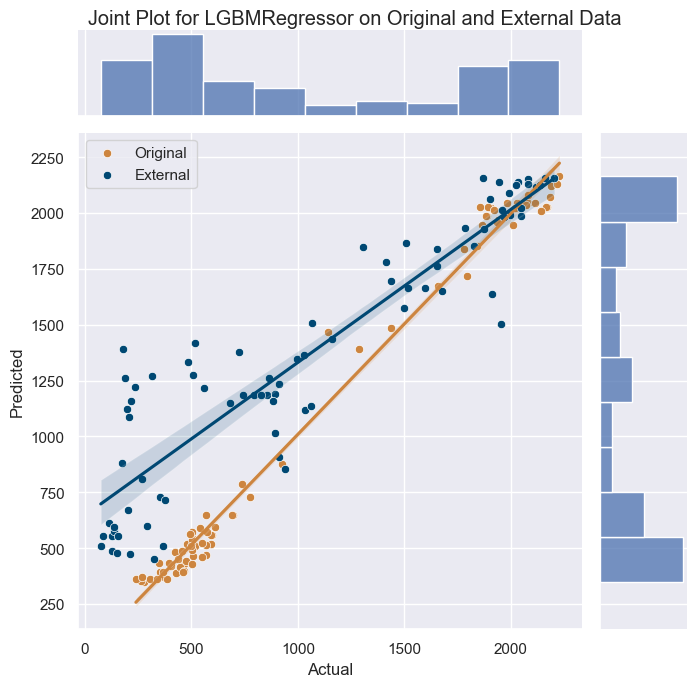

In [9]:
import pandas as pd
import numpy as np
import seaborn as sns
from sklearn.neighbors import KNeighborsRegressor
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from sklearn.preprocessing import StandardScaler
from skopt import BayesSearchCV
from skopt.space import Integer
import matplotlib.pyplot as plt
# Load datasets
data = pd.read_csv("C:\\Users\\Lenovo\\Desktop\\元学习\\BT(2)1-1.csv")
external_data = pd.read_csv("C:\\Users\\Lenovo\\Desktop\\元学习\\BT(2)1-2.csv")

# Normalization function
def normalize_data(data):
    scaler = StandardScaler()
    return scaler.fit_transform(data), scaler

# Normalize datasets
data_normalized, scaler = normalize_data(data)
external_data_normalized, _ = normalize_data(external_data)

# Split the dataset into features and target
X = data_normalized[:, :-1]
y = data_normalized[:, -1]
X_external = external_data_normalized[:, :-1]
y_external = external_data_normalized[:, -1]

# Fit a scaler for the features
feature_scaler = StandardScaler()
X_normalized = feature_scaler.fit_transform(data.drop('Biogas Production', axis=1))

# Fit a separate scaler for the target
target_scaler = StandardScaler()
y_normalized = target_scaler.fit_transform(data[['Biogas Production']])


# Split into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

# Define the hyperparameter space
param_grid = {'n_neighbors': Integer(1, 30)}

# Bayesian optimization
knn_search = BayesSearchCV(KNeighborsRegressor(), param_grid, n_iter=32, cv=5, n_jobs=-1, random_state=0)
knn_search.fit(X_train, y_train)

# Best model
knn_best = knn_search.best_estimator_

# Function to evaluate the model
def evaluate_model(model, X_train, y_train, X_test, y_test, X_external, y_external, target_scaler):
    y_pred_train = model.predict(X_train)
    y_pred_test = model.predict(X_test)
    y_pred_external = model.predict(X_external)

    # Denormalize target values and predictions
    y_train_denorm = target_scaler.inverse_transform(y_train.reshape(-1, 1)).flatten()
    y_test_denorm = target_scaler.inverse_transform(y_test.reshape(-1, 1)).flatten()
    y_external_denorm = target_scaler.inverse_transform(y_external.reshape(-1, 1)).flatten()
    y_pred_train_denorm = target_scaler.inverse_transform(y_pred_train.reshape(-1, 1)).flatten()
    y_pred_test_denorm = target_scaler.inverse_transform(y_pred_test.reshape(-1, 1)).flatten()
    y_pred_external_denorm = target_scaler.inverse_transform(y_pred_external.reshape(-1, 1)).flatten()

    # Visualization of predictions on external data
    plt.figure(figsize=(10, 6))
    plt.plot(y_external_denorm, label='Actual Values')
    plt.plot(y_pred_external_denorm, label='Predicted Values')
    plt.xlabel('Sample')
    plt.ylabel('Value')
    plt.title(f'Actual vs Predicted Values on External Data for {model.__class__.__name__}')
    plt.legend()
    plt.show()

    # Metrics for train and test sets
    train_rmse = mean_squared_error(y_train_denorm, y_pred_train_denorm, squared=False)
    test_rmse = mean_squared_error(y_test_denorm, y_pred_test_denorm, squared=False)
    train_r2 = r2_score(y_train_denorm, y_pred_train_denorm)
    test_r2 = r2_score(y_test_denorm, y_pred_test_denorm)
    train_mae = mean_absolute_error(y_train_denorm, y_pred_train_denorm)
    test_mae = mean_absolute_error(y_test_denorm, y_pred_test_denorm)

    # Metrics for external set
    external_rmse = mean_squared_error(y_external_denorm, y_pred_external_denorm, squared=False)
    external_r2 = r2_score(y_external_denorm, y_pred_external_denorm)
    external_mae = mean_absolute_error(y_external_denorm, y_pred_external_denorm)

    # Text for metrics
    metrics_text = f"RMSE: {external_rmse:.5f}\nR2: {external_r2:.5f}\nMAE: {external_mae:.5f}"

    # Create DataFrame for seaborn joint plot
    external_pred_df = pd.DataFrame({
        'Actual Values': y_external_denorm, 
        'Predicted Values': y_pred_external_denorm
    })

    # Set seaborn theme
    sns.set_theme(style="darkgrid")

    # Create the jointplot for external data with specified color
    g_external = sns.jointplot(x='Actual Values', y='Predicted Values', data=external_pred_df,
                               kind="reg", truncate=False,
                               color="#004873", height=7) 
    
    # Set title for the plot
    g_external.fig.suptitle(f"Joint Plot for {model.__class__.__name__} on External Data of GI")

    # Add metrics as text annotations
    plt.annotate(metrics_text, xy=(0.05, 0.95), xycoords='axes fraction', 
                 ha='left', va='top', bbox=dict(boxstyle='round,pad=0.5', fc="#004873", alpha=0.5))

    # Adjust layout
    g_external.fig.subplots_adjust(top=0.95)

    # Print metrics
    print(f"Model: {model.__class__.__name__}")
    print("Train RMSE:", train_rmse, "Train R2:", train_r2, "Train MAE:", train_mae)
    print("Test RMSE:", test_rmse, "Test R2:", test_r2, "Test MAE:", test_mae)
    print("External RMSE:", external_rmse, "External R2:", external_r2, "External MAE:", external_mae)
    print("--------------------------------------------------")

    # 评估模型并获取训练集和测试集的预测值
    y_pred_train_denorm = target_scaler.inverse_transform(model.predict(X_train).reshape(-1, 1)).flatten()
    y_pred_test_denorm = target_scaler.inverse_transform(model.predict(X_test).reshape(-1, 1)).flatten()

    # 合并训练集和测试集的数据
    original_data_actual = np.concatenate([y_train_denorm, y_test_denorm])
    original_data_predicted = np.concatenate([y_pred_train_denorm, y_pred_test_denorm])

    # 创建包含原始数据集和外部数据集的 DataFrame
    combined_df = pd.DataFrame({
        'Actual': np.concatenate([original_data_actual, y_external_denorm]),
        'Predicted': np.concatenate([original_data_predicted, y_pred_external_denorm]),
        'Dataset': ['Original'] * len(original_data_actual) + ['External'] * len(y_external_denorm)
    })

    # 创建基础 jointplot
    g_combined = sns.jointplot(x='Actual', y='Predicted', data=combined_df, kind="scatter", height=7)

    # 定义两个数据集的颜色
    colors = ['#CD853F', '#004873']

    # 为两个数据集添加不同颜色的散点图和线性回归线
    for dataset, color in zip(['Original', 'External'], colors):
        subset = combined_df[combined_df['Dataset'] == dataset]
        sns.scatterplot(x=subset['Actual'], y=subset['Predicted'], color=color, ax=g_combined.ax_joint, label=dataset)
        sns.regplot(x=subset['Actual'], y=subset['Predicted'], scatter=False, color=color, ax=g_combined.ax_joint)

    # 设置标题和布局
    g_combined.fig.suptitle(f"Joint Plot for {model.__class__.__name__} on Original and External Data")
    g_combined.fig.subplots_adjust(top=0.95)
    # 计算原始数据集的指标
    train_rmse = mean_squared_error(original_data_actual, original_data_predicted, squared=False)
    train_r2 = r2_score(original_data_actual, original_data_predicted)
    train_mae = mean_absolute_error(original_data_actual, original_data_predicted)

    # 计算外部数据集的指标
    external_rmse = mean_squared_error(y_external_denorm, y_pred_external_denorm, squared=False)
    external_r2 = r2_score(y_external_denorm, y_pred_external_denorm)
    external_mae = mean_absolute_error(y_external_denorm, y_pred_external_denorm)

    print(f"Original Dataset - RMSE: {train_rmse}, R2: {train_r2}, MAE: {train_mae}")
    print(f"External Dataset - RMSE: {external_rmse}, R2: {external_r2}, MAE: {external_mae}")

# Evaluate KNN model
evaluate_model(knn_best, X_train, y_train, X_test, y_test, X_external, y_external, target_scaler)

from sklearn.svm import SVR
from skopt.space import Real

# Define the hyperparameter space for SVM
param_grid_svm = {
    'C': Real(1e-15, 1e+1, prior='log-uniform'),
    'gamma': Real(1e-15, 1e+1, prior='log-uniform'),
    'epsilon': Real(1e-15, 1e+1, prior='log-uniform')
}


# Bayesian optimization
svm_search = BayesSearchCV(SVR(), param_grid_svm, n_iter=32, cv=5, n_jobs=-1, random_state=0)
svm_search.fit(X_train, y_train)

# Best model
svm_best = svm_search.best_estimator_

# Evaluate SVM model
evaluate_model(svm_best, X_train, y_train, X_test, y_test, X_external, y_external, target_scaler)

from sklearn.ensemble import RandomForestRegressor
from skopt.space import Integer, Real

# Define the hyperparameter space for Random Forest
param_grid_rf = {
    'n_estimators': Integer(100, 300),
    'max_depth': Integer(10, 50),
    'min_samples_split': Real(0.1, 1.0),
    'min_samples_leaf': Real(0.1, 0.5)
}

# Bayesian optimization
rf_search = BayesSearchCV(RandomForestRegressor(random_state=0), param_grid_rf, n_iter=32, cv=5, n_jobs=-1, random_state=0)
rf_search.fit(X_train, y_train)

# Best model
rf_best = rf_search.best_estimator_

# Evaluate Random Forest model
evaluate_model(rf_best, X_train, y_train, X_test, y_test, X_external, y_external, target_scaler)


import xgboost as xgb

# Define the hyperparameter space for XGBoost
param_grid_xgb = {
    'n_estimators': Integer(10, 300),
    'max_depth': Integer(1, 50),
    'learning_rate': Real(0.01, 1.0, 'log-uniform'),
    'subsample': Real(0.1, 1.0),
    'colsample_bytree': Real(0.1, 1.0)
}

# Bayesian optimization
xgb_search = BayesSearchCV(xgb.XGBRegressor(), param_grid_xgb, n_iter=32, cv=5, n_jobs=-1, random_state=0)
xgb_search.fit(X_train, y_train)

# Best model
xgb_best = xgb_search.best_estimator_

# Evaluate XGBoost model
evaluate_model(xgb_best, X_train, y_train, X_test, y_test, X_external, y_external, target_scaler)


import lightgbm as lgb

# Define the hyperparameter space for LightGBM
param_grid_lgb = {
    'n_estimators': Integer(10, 300),
    'max_depth': Integer(-1, 50),
    'learning_rate': Real(0.01, 1.0, 'log-uniform'),
    'num_leaves': Integer(20, 300),
    'subsample': Real(0.1, 1.0),
    'colsample_bytree': Real(0.1, 1.0)
}

# Bayesian optimization
lgb_search = BayesSearchCV(lgb.LGBMRegressor(), param_grid_lgb, n_iter=32, cv=5, n_jobs=-1, random_state=0)
lgb_search.fit(X_train, y_train)

# Best model
lgb_best = lgb_search.best_estimator_

# Evaluate LightGBM model
evaluate_model(lgb_best, X_train, y_train, X_test, y_test, X_external, y_external, target_scaler)

In [10]:
# 创建包含模型名称和其最优超参数的字典
model_hyperparams = {
    'KNN': knn_search.best_params_,
    'SVM': svm_search.best_params_,
    'RandomForest': rf_search.best_params_,
    'XGBoost': xgb_search.best_params_,
    'LightGBM': lgb_search.best_params_
}

# 转换为DataFrame
hyperparams_df = pd.DataFrame.from_dict(model_hyperparams, orient='index')

# 重置索引，使模型名称成为一列
hyperparams_df.reset_index(inplace=True)
hyperparams_df.rename(columns={'index': 'Model'}, inplace=True)

# 指定文件路径和名称，这里替换为你的目标路径
file_path = "C:\\Users\\Lenovo\\Desktop\\元学习\\传统模型超参数\\hyperparams_BT_2_1.csv"

# 保存为CSV文件
hyperparams_df.to_csv(file_path, index=False)

e:\anaconda\envs\yuanxuexi2\lib\site-packages\skopt\optimizer\optimizer.py:449: UserWarning: The objective has been evaluated at this point before.
  warnings.warn("The objective has been evaluated "
e:\anaconda\envs\yuanxuexi2\lib\site-packages\skopt\optimizer\optimizer.py:449: UserWarning: The objective has been evaluated at this point before.
  warnings.warn("The objective has been evaluated "
e:\anaconda\envs\yuanxuexi2\lib\site-packages\skopt\optimizer\optimizer.py:449: UserWarning: The objective has been evaluated at this point before.
  warnings.warn("The objective has been evaluated "
e:\anaconda\envs\yuanxuexi2\lib\site-packages\skopt\optimizer\optimizer.py:449: UserWarning: The objective has been evaluated at this point before.
  warnings.warn("The objective has been evaluated "
e:\anaconda\envs\yuanxuexi2\lib\site-packages\skopt\optimizer\optimizer.py:449: UserWarning: The objective has been evaluated at this point before.
  warnings.warn("The objective has been evaluated "


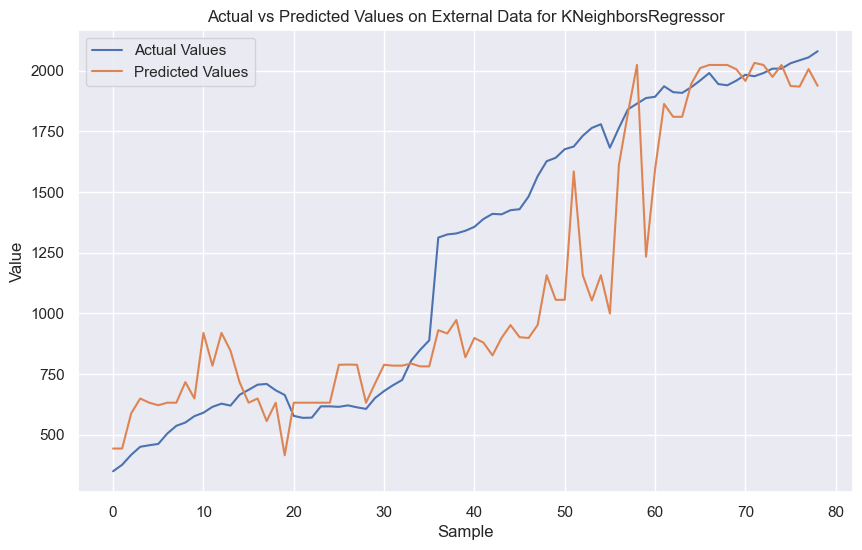

Model: KNeighborsRegressor
Train RMSE: 84.46384666562781 Train R2: 0.9814695101812758 Train MAE: 60.90421874999999
Test RMSE: 91.97457581486054 Test R2: 0.9687035732774185 Test MAE: 69.99882352941177
External RMSE: 297.91831518761967 External R2: 0.7550499667233348 External MAE: 214.03936448349833
--------------------------------------------------
Original Dataset - RMSE: 86.09451691901475, R2: 0.9795433703197948, MAE: 62.812962962962956
External Dataset - RMSE: 297.91831518761967, R2: 0.7550499667233348, MAE: 214.03936448349833


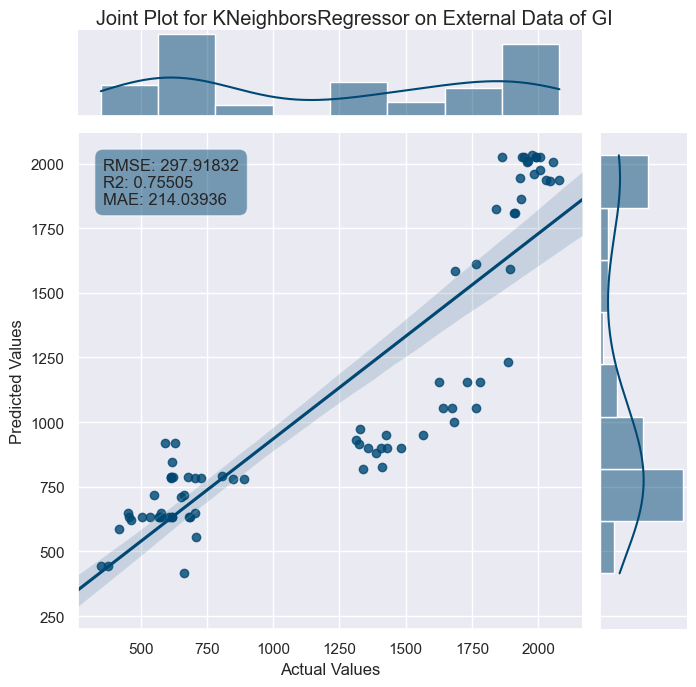

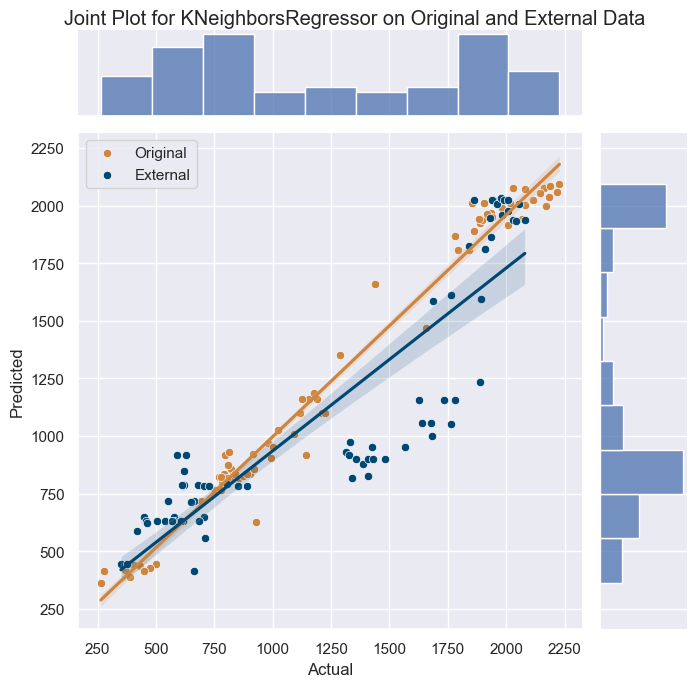

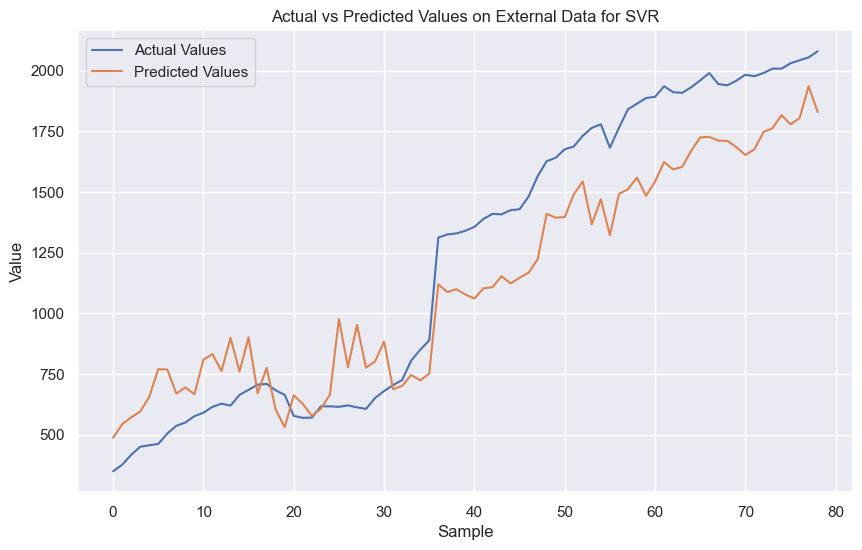

Model: SVR
Train RMSE: 68.75695879073612 Train R2: 0.9877205616000385 Train MAE: 39.14211574069893
Test RMSE: 117.66321133075273 Test R2: 0.9487798834872735 Test MAE: 82.2518921393925
External RMSE: 235.56090255934097 External R2: 0.8468596922127627 External MAE: 214.26457248407152
--------------------------------------------------
Original Dataset - RMSE: 81.49225310215905, R2: 0.9816719716891537, MAE: 48.18984658980745
External Dataset - RMSE: 235.56090255934097, R2: 0.8468596922127627, MAE: 214.26457248407152


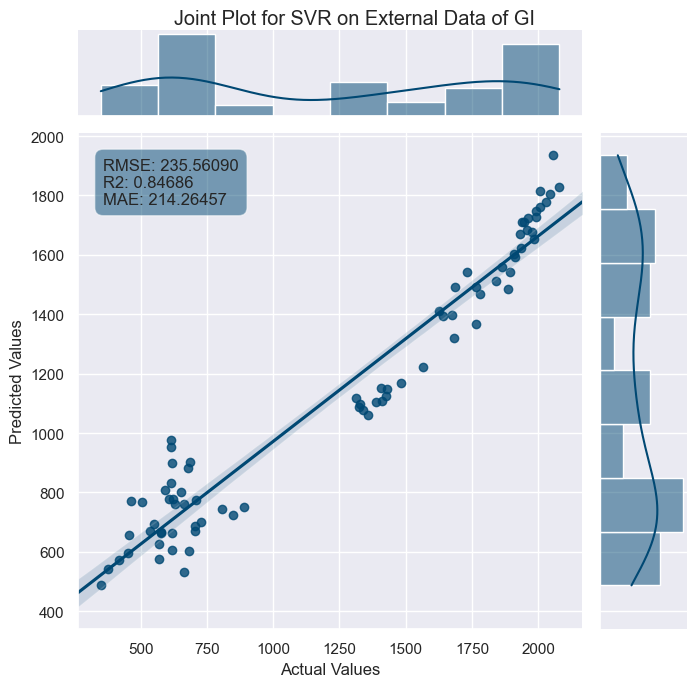

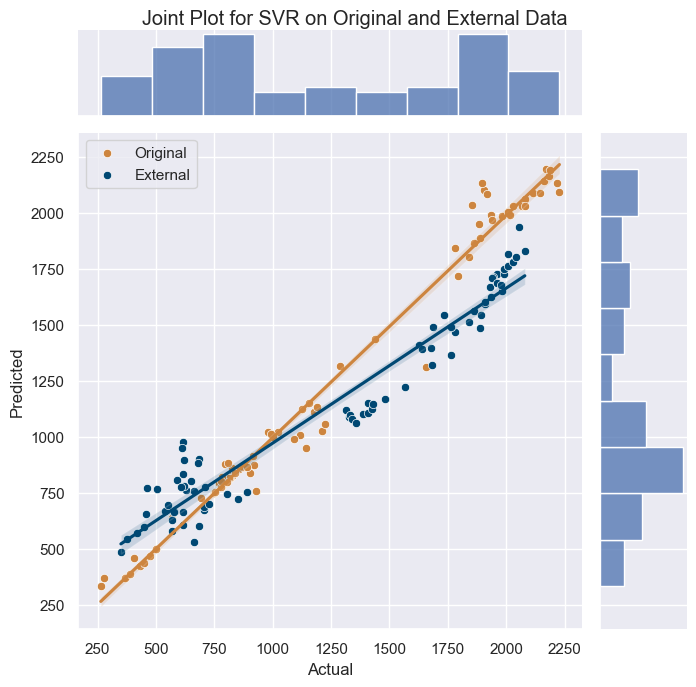

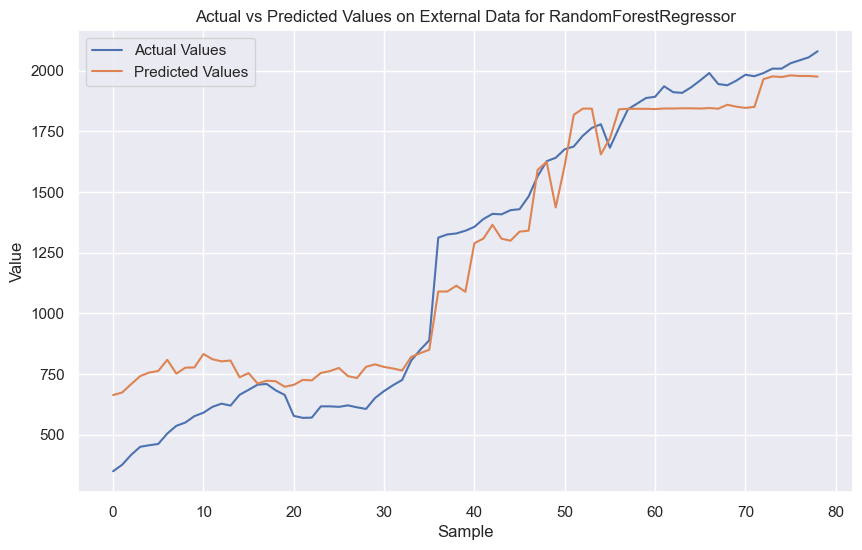

Model: RandomForestRegressor
Train RMSE: 79.6743926843044 Train R2: 0.983511440709152 Train MAE: 63.62521365870782
Test RMSE: 83.15724450060542 Test R2: 0.9744165359859192 Test MAE: 55.98186616753528
External RMSE: 147.012217109175 External R2: 0.9403528152005441 External MAE: 120.75457111715511
--------------------------------------------------
Original Dataset - RMSE: 80.41786935927233, R2: 0.9821520549081091, MAE: 62.02105430870864
External Dataset - RMSE: 147.012217109175, R2: 0.9403528152005441, MAE: 120.75457111715511


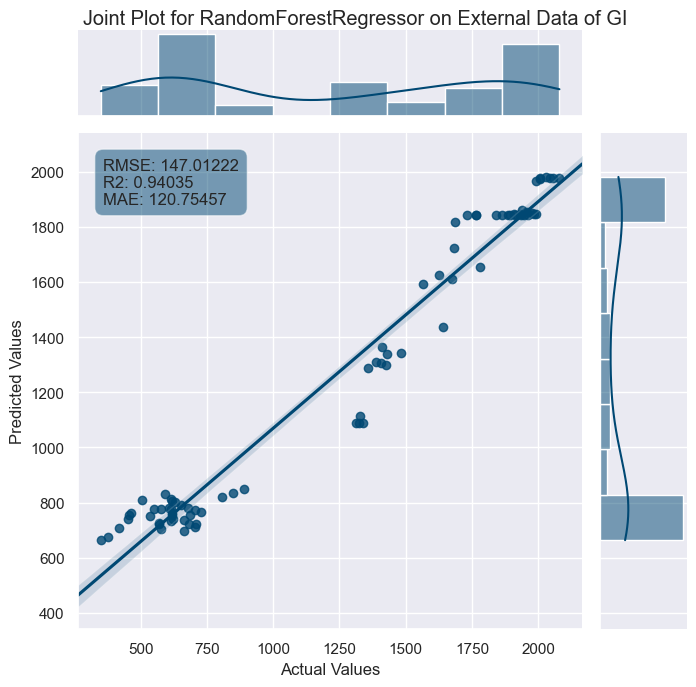

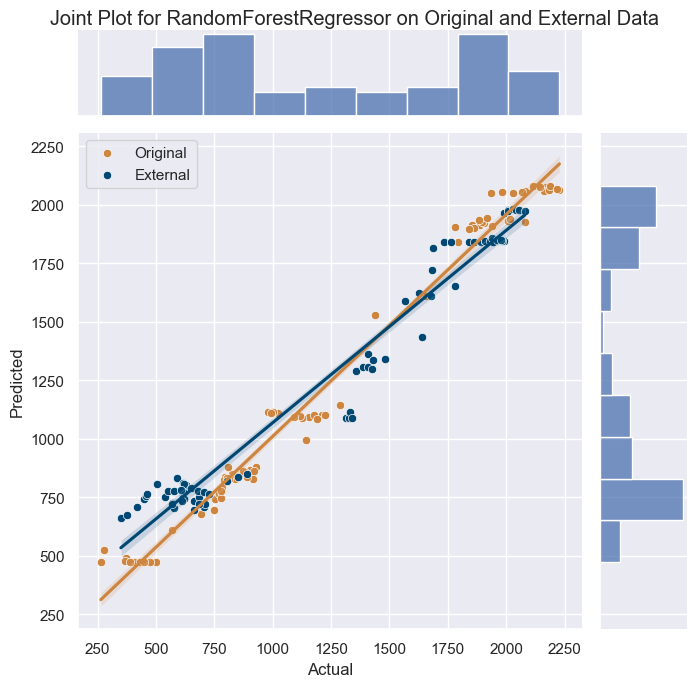

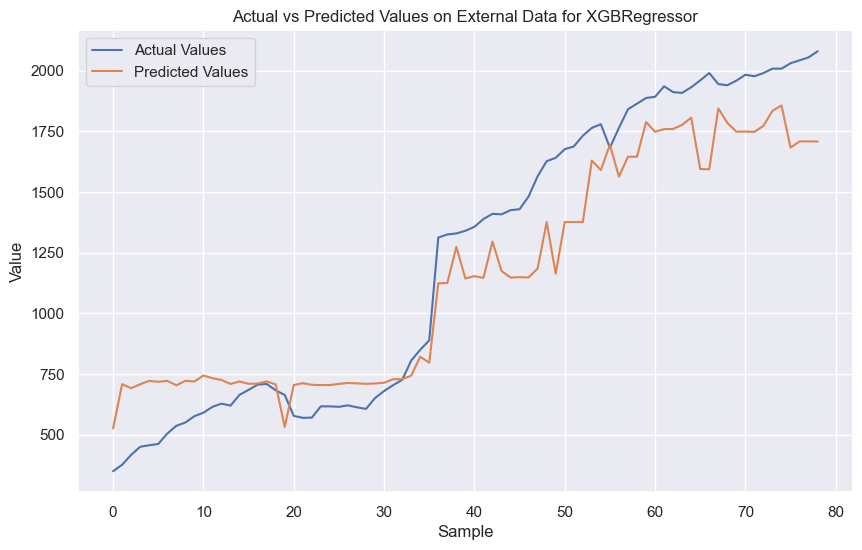

Model: XGBRegressor
Train RMSE: 0.3410749715192403 Train R2: 0.999999697834491 Train MAE: 0.22718385696411048
Test RMSE: 95.62158961011562 Test R2: 0.9661724078462102 Test MAE: 64.43185403262866
External RMSE: 207.81288157115958 External R2: 0.8808132369468892 External MAE: 177.87822271726256
--------------------------------------------------
Original Dataset - RMSE: 43.80748400593184, R2: 0.994703612908309, MAE: 13.702238091362844
External Dataset - RMSE: 207.81288157115958, R2: 0.8808132369468892, MAE: 177.87822271726256
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000031 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 270
[LightGBM] [Info] Number of data points in the train set: 64, number of used features: 14
[LightGBM] [Info] Start training from score 0.032244
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

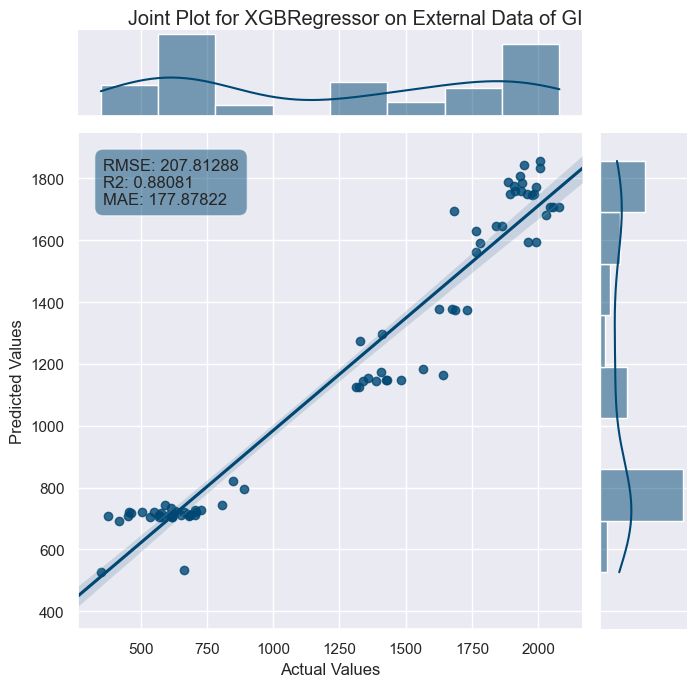

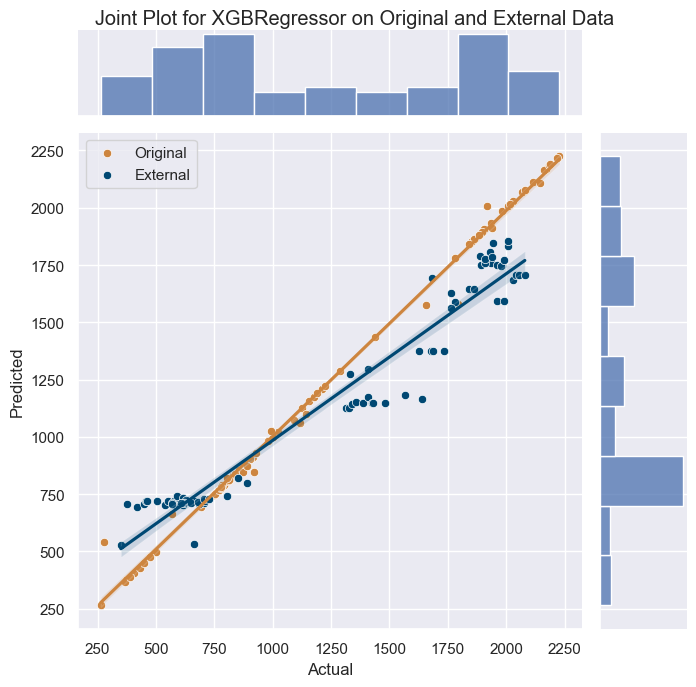

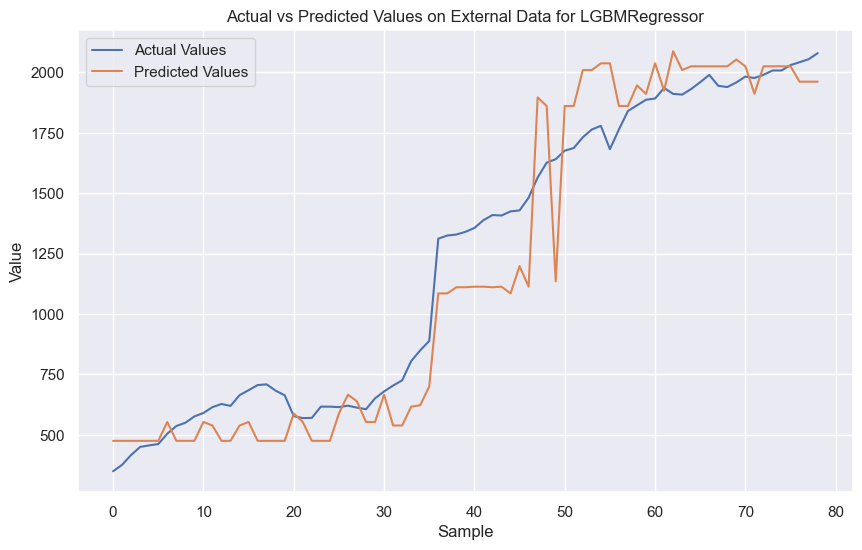

Model: LGBMRegressor
Train RMSE: 101.21795661641423 Train R2: 0.9733890537461389 Train MAE: 80.09443864783057
Test RMSE: 160.3630628723998 Test R2: 0.9048589691612493 Test MAE: 123.40533536952984
External RMSE: 173.10408097152032 External R2: 0.917301485305363 External MAE: 137.93516041259156
--------------------------------------------------
Original Dataset - RMSE: 116.15560478377468, R2: 0.9627639643819418, MAE: 89.18437993510078
External Dataset - RMSE: 173.10408097152032, R2: 0.917301485305363, MAE: 137.93516041259156


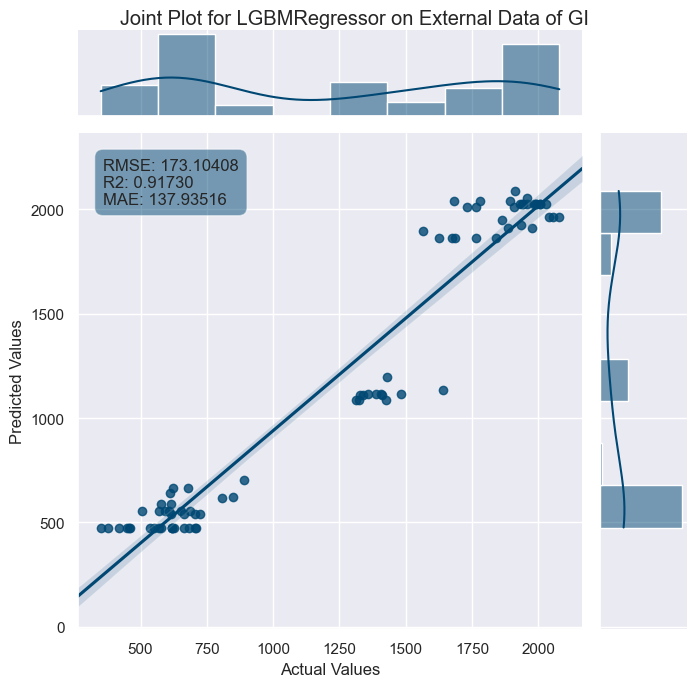

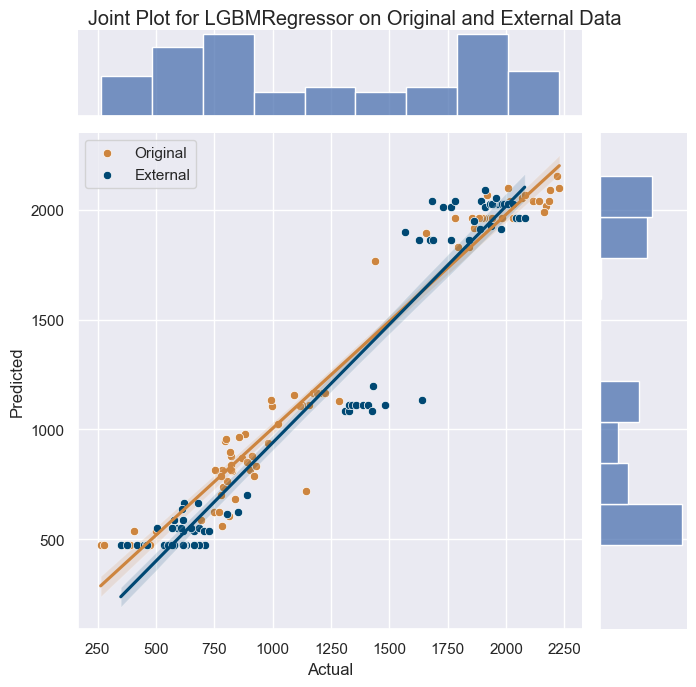

In [11]:
import pandas as pd
import numpy as np
import seaborn as sns
from sklearn.neighbors import KNeighborsRegressor
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from sklearn.preprocessing import StandardScaler
from skopt import BayesSearchCV
from skopt.space import Integer
import matplotlib.pyplot as plt
# Load datasets
data = pd.read_csv("C:\\Users\\Lenovo\\Desktop\\元学习\\BT(2)2-1.csv")
external_data = pd.read_csv("C:\\Users\\Lenovo\\Desktop\\元学习\\BT(2)2-2.csv")

# Normalization function
def normalize_data(data):
    scaler = StandardScaler()
    return scaler.fit_transform(data), scaler

# Normalize datasets
data_normalized, scaler = normalize_data(data)
external_data_normalized, _ = normalize_data(external_data)

# Split the dataset into features and target
X = data_normalized[:, :-1]
y = data_normalized[:, -1]
X_external = external_data_normalized[:, :-1]
y_external = external_data_normalized[:, -1]

# Fit a scaler for the features
feature_scaler = StandardScaler()
X_normalized = feature_scaler.fit_transform(data.drop('Biogas Production', axis=1))

# Fit a separate scaler for the target
target_scaler = StandardScaler()
y_normalized = target_scaler.fit_transform(data[['Biogas Production']])


# Split into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

# Define the hyperparameter space
param_grid = {'n_neighbors': Integer(1, 30)}

# Bayesian optimization
knn_search = BayesSearchCV(KNeighborsRegressor(), param_grid, n_iter=32, cv=5, n_jobs=-1, random_state=0)
knn_search.fit(X_train, y_train)

# Best model
knn_best = knn_search.best_estimator_

# Function to evaluate the model
def evaluate_model(model, X_train, y_train, X_test, y_test, X_external, y_external, target_scaler):
    y_pred_train = model.predict(X_train)
    y_pred_test = model.predict(X_test)
    y_pred_external = model.predict(X_external)

    # Denormalize target values and predictions
    y_train_denorm = target_scaler.inverse_transform(y_train.reshape(-1, 1)).flatten()
    y_test_denorm = target_scaler.inverse_transform(y_test.reshape(-1, 1)).flatten()
    y_external_denorm = target_scaler.inverse_transform(y_external.reshape(-1, 1)).flatten()
    y_pred_train_denorm = target_scaler.inverse_transform(y_pred_train.reshape(-1, 1)).flatten()
    y_pred_test_denorm = target_scaler.inverse_transform(y_pred_test.reshape(-1, 1)).flatten()
    y_pred_external_denorm = target_scaler.inverse_transform(y_pred_external.reshape(-1, 1)).flatten()

    # Visualization of predictions on external data
    plt.figure(figsize=(10, 6))
    plt.plot(y_external_denorm, label='Actual Values')
    plt.plot(y_pred_external_denorm, label='Predicted Values')
    plt.xlabel('Sample')
    plt.ylabel('Value')
    plt.title(f'Actual vs Predicted Values on External Data for {model.__class__.__name__}')
    plt.legend()
    plt.show()

    # Metrics for train and test sets
    train_rmse = mean_squared_error(y_train_denorm, y_pred_train_denorm, squared=False)
    test_rmse = mean_squared_error(y_test_denorm, y_pred_test_denorm, squared=False)
    train_r2 = r2_score(y_train_denorm, y_pred_train_denorm)
    test_r2 = r2_score(y_test_denorm, y_pred_test_denorm)
    train_mae = mean_absolute_error(y_train_denorm, y_pred_train_denorm)
    test_mae = mean_absolute_error(y_test_denorm, y_pred_test_denorm)

    # Metrics for external set
    external_rmse = mean_squared_error(y_external_denorm, y_pred_external_denorm, squared=False)
    external_r2 = r2_score(y_external_denorm, y_pred_external_denorm)
    external_mae = mean_absolute_error(y_external_denorm, y_pred_external_denorm)

    # Text for metrics
    metrics_text = f"RMSE: {external_rmse:.5f}\nR2: {external_r2:.5f}\nMAE: {external_mae:.5f}"

    # Create DataFrame for seaborn joint plot
    external_pred_df = pd.DataFrame({
        'Actual Values': y_external_denorm, 
        'Predicted Values': y_pred_external_denorm
    })

    # Set seaborn theme
    sns.set_theme(style="darkgrid")

    # Create the jointplot for external data with specified color
    g_external = sns.jointplot(x='Actual Values', y='Predicted Values', data=external_pred_df,
                               kind="reg", truncate=False,
                               color="#004873", height=7) 
    
    # Set title for the plot
    g_external.fig.suptitle(f"Joint Plot for {model.__class__.__name__} on External Data of GI")

    # Add metrics as text annotations
    plt.annotate(metrics_text, xy=(0.05, 0.95), xycoords='axes fraction', 
                 ha='left', va='top', bbox=dict(boxstyle='round,pad=0.5', fc="#004873", alpha=0.5))

    # Adjust layout
    g_external.fig.subplots_adjust(top=0.95)

    # Print metrics
    print(f"Model: {model.__class__.__name__}")
    print("Train RMSE:", train_rmse, "Train R2:", train_r2, "Train MAE:", train_mae)
    print("Test RMSE:", test_rmse, "Test R2:", test_r2, "Test MAE:", test_mae)
    print("External RMSE:", external_rmse, "External R2:", external_r2, "External MAE:", external_mae)
    print("--------------------------------------------------")

    # 评估模型并获取训练集和测试集的预测值
    y_pred_train_denorm = target_scaler.inverse_transform(model.predict(X_train).reshape(-1, 1)).flatten()
    y_pred_test_denorm = target_scaler.inverse_transform(model.predict(X_test).reshape(-1, 1)).flatten()

    # 合并训练集和测试集的数据
    original_data_actual = np.concatenate([y_train_denorm, y_test_denorm])
    original_data_predicted = np.concatenate([y_pred_train_denorm, y_pred_test_denorm])

    # 创建包含原始数据集和外部数据集的 DataFrame
    combined_df = pd.DataFrame({
        'Actual': np.concatenate([original_data_actual, y_external_denorm]),
        'Predicted': np.concatenate([original_data_predicted, y_pred_external_denorm]),
        'Dataset': ['Original'] * len(original_data_actual) + ['External'] * len(y_external_denorm)
    })

    # 创建基础 jointplot
    g_combined = sns.jointplot(x='Actual', y='Predicted', data=combined_df, kind="scatter", height=7)

    # 定义两个数据集的颜色
    colors = ['#CD853F', '#004873']

    # 为两个数据集添加不同颜色的散点图和线性回归线
    for dataset, color in zip(['Original', 'External'], colors):
        subset = combined_df[combined_df['Dataset'] == dataset]
        sns.scatterplot(x=subset['Actual'], y=subset['Predicted'], color=color, ax=g_combined.ax_joint, label=dataset)
        sns.regplot(x=subset['Actual'], y=subset['Predicted'], scatter=False, color=color, ax=g_combined.ax_joint)

    # 设置标题和布局
    g_combined.fig.suptitle(f"Joint Plot for {model.__class__.__name__} on Original and External Data")
    g_combined.fig.subplots_adjust(top=0.95)
    # 计算原始数据集的指标
    train_rmse = mean_squared_error(original_data_actual, original_data_predicted, squared=False)
    train_r2 = r2_score(original_data_actual, original_data_predicted)
    train_mae = mean_absolute_error(original_data_actual, original_data_predicted)

    # 计算外部数据集的指标
    external_rmse = mean_squared_error(y_external_denorm, y_pred_external_denorm, squared=False)
    external_r2 = r2_score(y_external_denorm, y_pred_external_denorm)
    external_mae = mean_absolute_error(y_external_denorm, y_pred_external_denorm)


    print(f"Original Dataset - RMSE: {train_rmse}, R2: {train_r2}, MAE: {train_mae}")
    print(f"External Dataset - RMSE: {external_rmse}, R2: {external_r2}, MAE: {external_mae}")

# Evaluate KNN model
evaluate_model(knn_best, X_train, y_train, X_test, y_test, X_external, y_external, target_scaler)

from sklearn.svm import SVR
from skopt.space import Real

# Define the hyperparameter space for SVM
param_grid_svm = {
    'C': Real(1e-15, 1e+1, prior='log-uniform'),
    'gamma': Real(1e-15, 1e+1, prior='log-uniform'),
    'epsilon': Real(1e-15, 1e+1, prior='log-uniform')
}


# Bayesian optimization
svm_search = BayesSearchCV(SVR(), param_grid_svm, n_iter=32, cv=5, n_jobs=-1, random_state=0)
svm_search.fit(X_train, y_train)

# Best model
svm_best = svm_search.best_estimator_

# Evaluate SVM model
evaluate_model(svm_best, X_train, y_train, X_test, y_test, X_external, y_external, target_scaler)

from sklearn.ensemble import RandomForestRegressor
from skopt.space import Integer, Real

# Define the hyperparameter space for Random Forest
param_grid_rf = {
    'n_estimators': Integer(100, 300),
    'max_depth': Integer(10, 50),
    'min_samples_split': Real(0.1, 1.0),
    'min_samples_leaf': Real(0.1, 0.5)
}

# Bayesian optimization
rf_search = BayesSearchCV(RandomForestRegressor(random_state=0), param_grid_rf, n_iter=32, cv=5, n_jobs=-1, random_state=0)
rf_search.fit(X_train, y_train)

# Best model
rf_best = rf_search.best_estimator_

# Evaluate Random Forest model
evaluate_model(rf_best, X_train, y_train, X_test, y_test, X_external, y_external, target_scaler)


import xgboost as xgb

# Define the hyperparameter space for XGBoost
param_grid_xgb = {
    'n_estimators': Integer(10, 300),
    'max_depth': Integer(1, 50),
    'learning_rate': Real(0.01, 1.0, 'log-uniform'),
    'subsample': Real(0.1, 1.0),
    'colsample_bytree': Real(0.1, 1.0)
}

# Bayesian optimization
xgb_search = BayesSearchCV(xgb.XGBRegressor(), param_grid_xgb, n_iter=32, cv=5, n_jobs=-1, random_state=0)
xgb_search.fit(X_train, y_train)

# Best model
xgb_best = xgb_search.best_estimator_

# Evaluate XGBoost model
evaluate_model(xgb_best, X_train, y_train, X_test, y_test, X_external, y_external, target_scaler)


import lightgbm as lgb

# Define the hyperparameter space for LightGBM
param_grid_lgb = {
    'n_estimators': Integer(10, 300),
    'max_depth': Integer(-1, 50),
    'learning_rate': Real(0.01, 1.0, 'log-uniform'),
    'num_leaves': Integer(20, 300),
    'subsample': Real(0.1, 1.0),
    'colsample_bytree': Real(0.1, 1.0)
}

# Bayesian optimization
lgb_search = BayesSearchCV(lgb.LGBMRegressor(), param_grid_lgb, n_iter=32, cv=5, n_jobs=-1, random_state=0)
lgb_search.fit(X_train, y_train)

# Best model
lgb_best = lgb_search.best_estimator_

# Evaluate LightGBM model
evaluate_model(lgb_best, X_train, y_train, X_test, y_test, X_external, y_external, target_scaler)

In [12]:
# 创建包含模型名称和其最优超参数的字典
model_hyperparams = {
    'KNN': knn_search.best_params_,
    'SVM': svm_search.best_params_,
    'RandomForest': rf_search.best_params_,
    'XGBoost': xgb_search.best_params_,
    'LightGBM': lgb_search.best_params_
}

# 转换为DataFrame
hyperparams_df = pd.DataFrame.from_dict(model_hyperparams, orient='index')

# 重置索引，使模型名称成为一列
hyperparams_df.reset_index(inplace=True)
hyperparams_df.rename(columns={'index': 'Model'}, inplace=True)

# 指定文件路径和名称，这里替换为你的目标路径
file_path = "C:\\Users\\Lenovo\\Desktop\\元学习\\传统模型超参数\\hyperparams_BT_2_2.csv"

# 保存为CSV文件
hyperparams_df.to_csv(file_path, index=False)

e:\anaconda\envs\yuanxuexi2\lib\site-packages\skopt\optimizer\optimizer.py:449: UserWarning: The objective has been evaluated at this point before.
  warnings.warn("The objective has been evaluated "
e:\anaconda\envs\yuanxuexi2\lib\site-packages\skopt\optimizer\optimizer.py:449: UserWarning: The objective has been evaluated at this point before.
  warnings.warn("The objective has been evaluated "
e:\anaconda\envs\yuanxuexi2\lib\site-packages\skopt\optimizer\optimizer.py:449: UserWarning: The objective has been evaluated at this point before.
  warnings.warn("The objective has been evaluated "
e:\anaconda\envs\yuanxuexi2\lib\site-packages\skopt\optimizer\optimizer.py:449: UserWarning: The objective has been evaluated at this point before.
  warnings.warn("The objective has been evaluated "
e:\anaconda\envs\yuanxuexi2\lib\site-packages\skopt\optimizer\optimizer.py:449: UserWarning: The objective has been evaluated at this point before.
  warnings.warn("The objective has been evaluated "


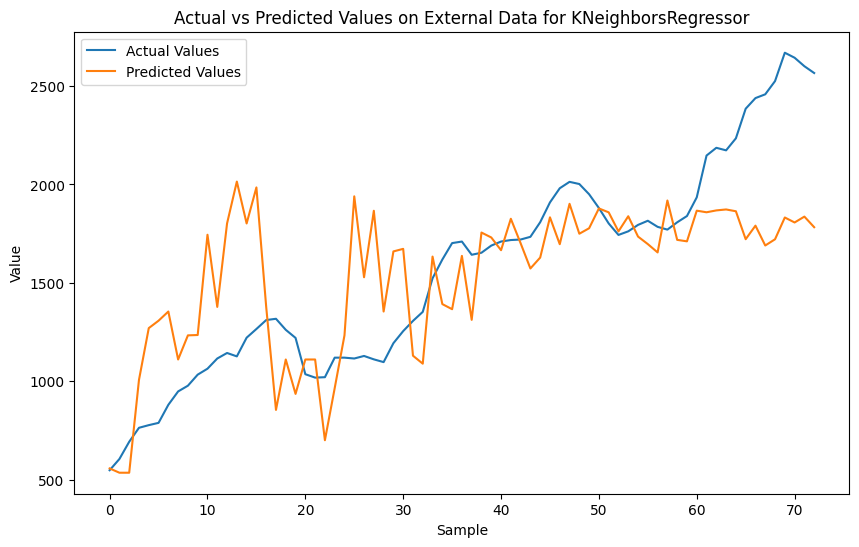

Model: KNeighborsRegressor
Train RMSE: 89.96629007265108 Train R2: 0.9699938177068339 Train MAE: 64.50869565217391
Test RMSE: 90.271798263513 Test R2: 0.9760282595544297 Test MAE: 72.84444444444443
External RMSE: 401.7165144716616 External R2: 0.43311901152033905 External MAE: 309.050046222783
--------------------------------------------------
Original Dataset - RMSE: 90.02958372159128, R2: 0.9715276702539941, MAE: 66.23333333333332
External Dataset - RMSE: 401.7165144716616, R2: 0.43311901152033905, MAE: 309.050046222783


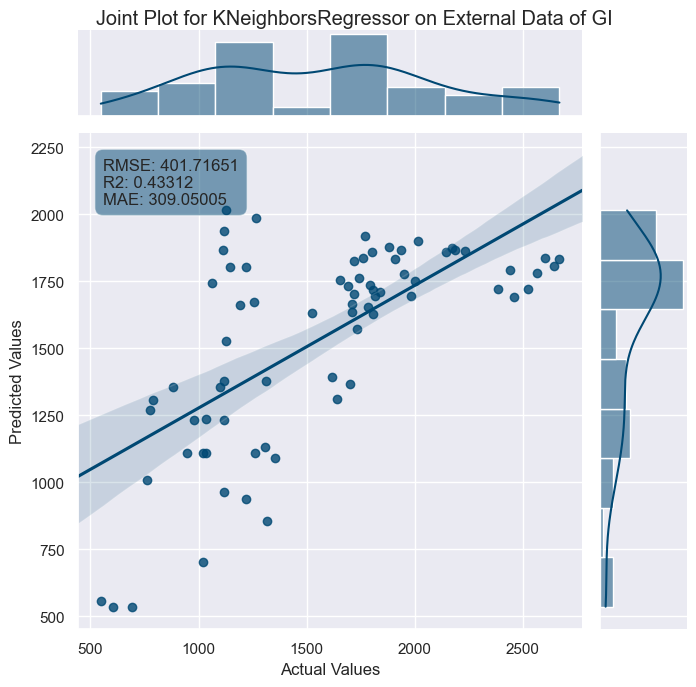

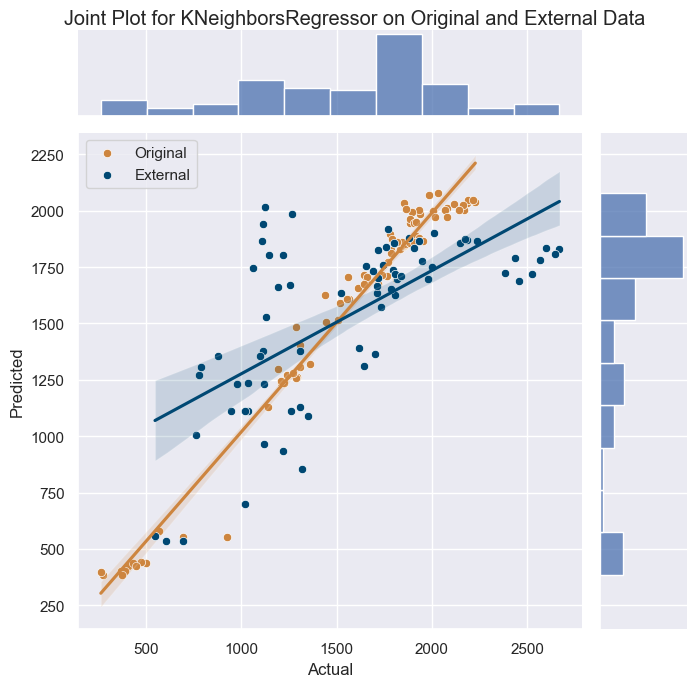

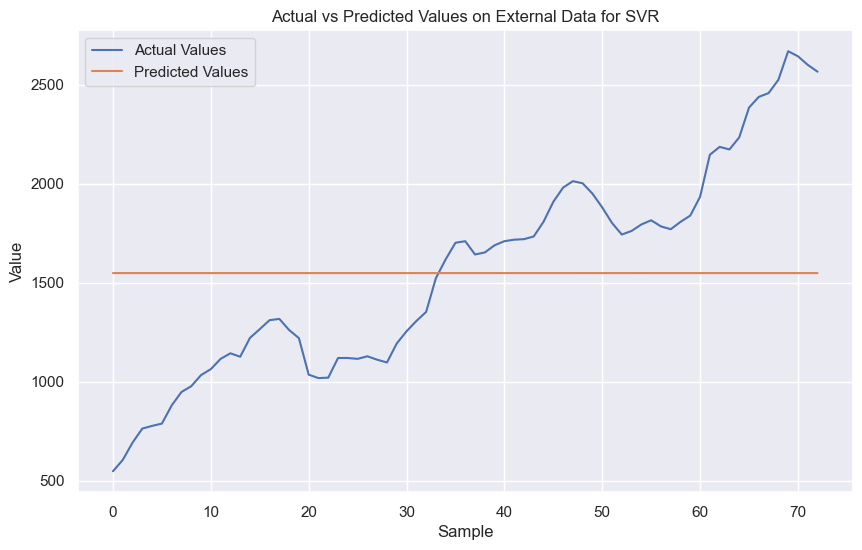

Model: SVR
Train RMSE: 41.06575263197069 Train R2: 0.9937481191422044 Train MAE: 40.661302990969006
Test RMSE: 543.9894693349423 Test R2: 0.1294847892054053 Test MAE: 433.6077326488517
External RMSE: 533.6967486621429 External R2: -0.0005565392144437631 External MAE: 456.4281933192525
--------------------------------------------------
Original Dataset - RMSE: 250.12647596532713, R2: 0.7802282586366468, MAE: 121.96056429949647
External Dataset - RMSE: 533.6967486621429, R2: -0.0005565392144437631, MAE: 456.4281933192525


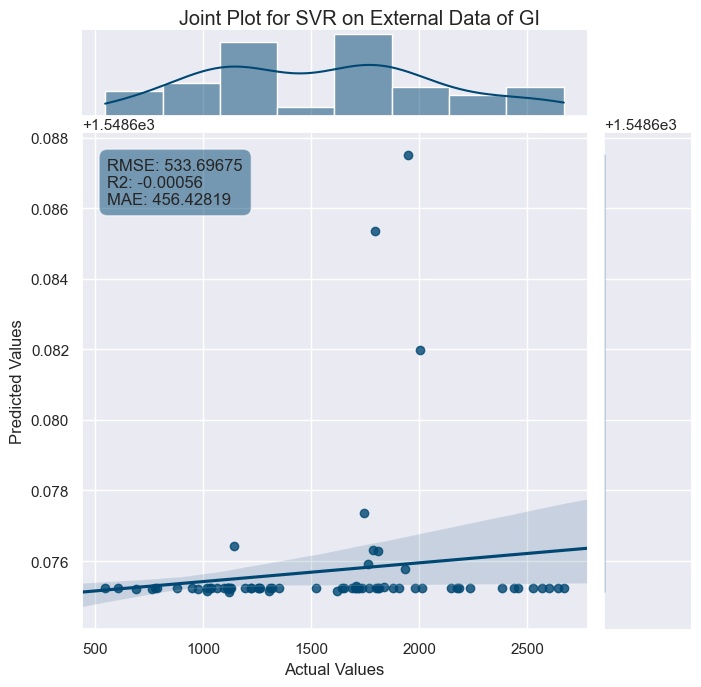

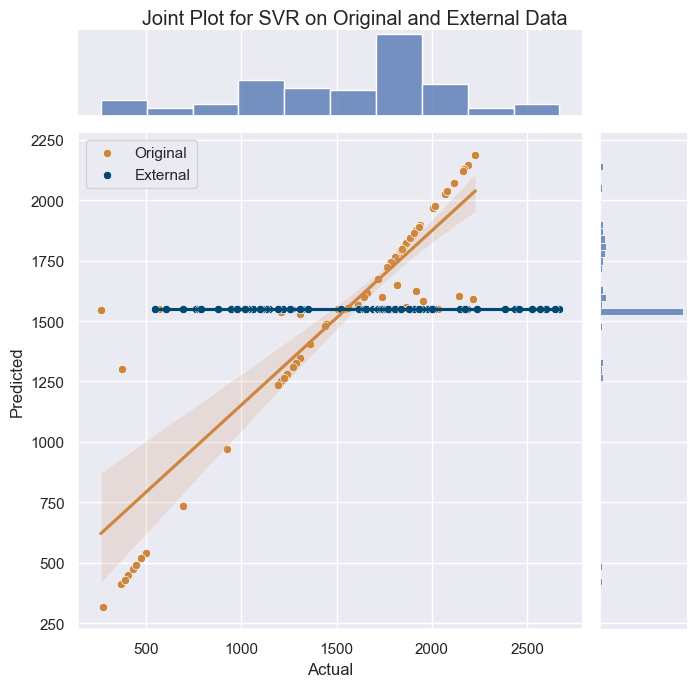

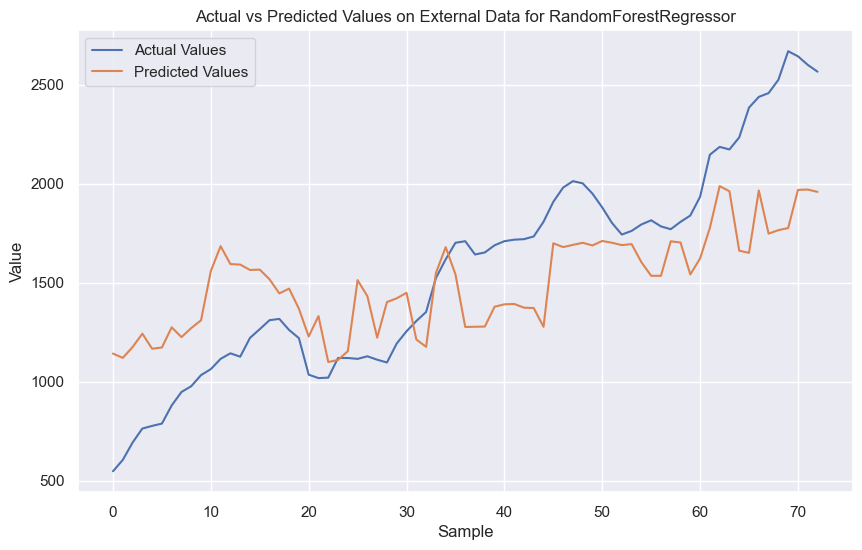

Model: RandomForestRegressor
Train RMSE: 114.86316514919844 Train R2: 0.9510883089191762 Train MAE: 79.24139515081902
Test RMSE: 145.52490675838987 Test R2: 0.9377025832720879 Test MAE: 100.94125862709076
External RMSE: 375.3115375290652 External R2: 0.505192411687422 External MAE: 322.8341646379269
--------------------------------------------------
Original Dataset - RMSE: 121.84169565582944, R2: 0.947851191584816, MAE: 83.7310220769442
External Dataset - RMSE: 375.3115375290652, R2: 0.505192411687422, MAE: 322.8341646379269


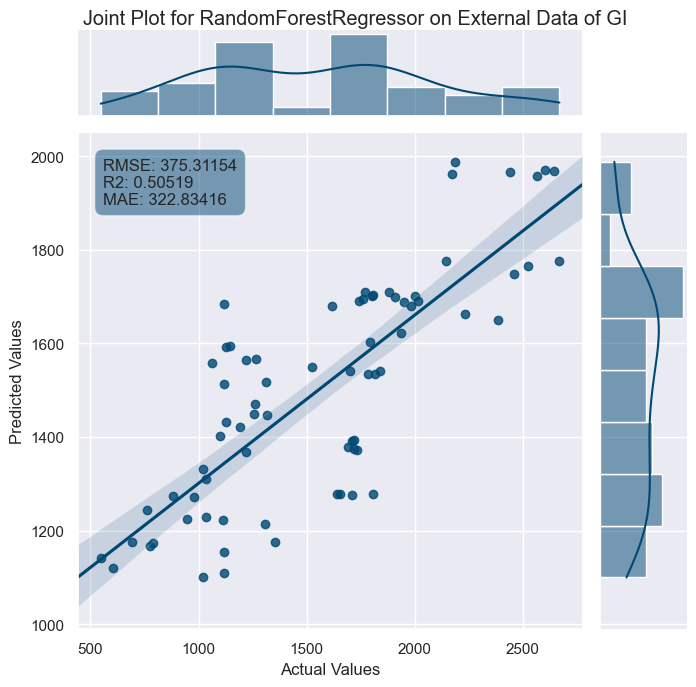

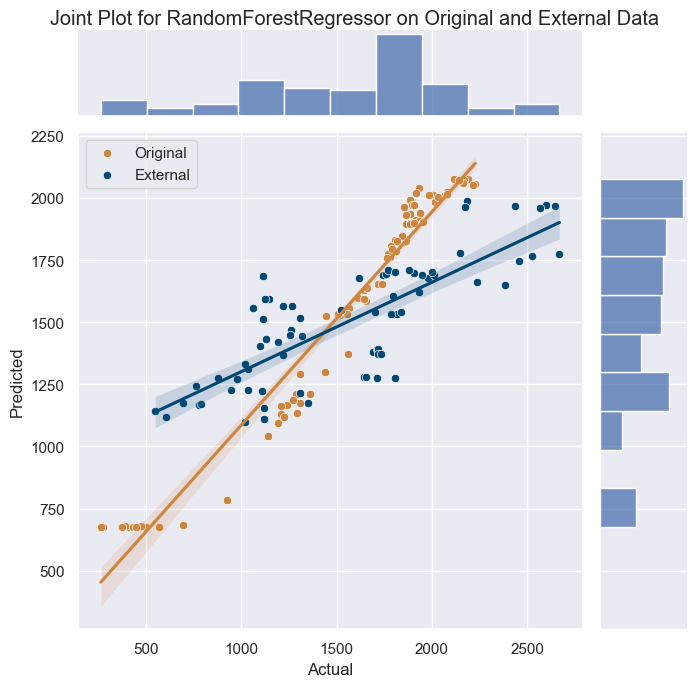

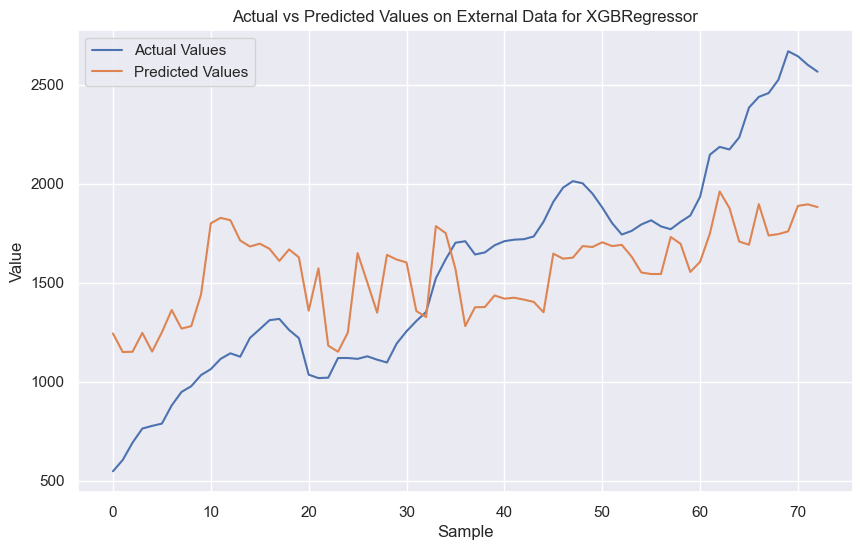

Model: XGBRegressor
Train RMSE: 0.27374414066052505 Train R2: 0.9999997221945357 Train MAE: 0.19469454115715612
Test RMSE: 67.74545427866637 Test R2: 0.9864993183196493 Test MAE: 52.68549601236979
External RMSE: 428.3423568574458 External R2: 0.3554827216452562 External MAE: 377.86968108251693
--------------------------------------------------
Original Dataset - RMSE: 30.815582140563016, R2: 0.9966642516990659, MAE: 11.054860362787357
External Dataset - RMSE: 428.3423568574458, R2: 0.3554827216452562, MAE: 377.86968108251693
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000043 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 295
[LightGBM] [Info] Number of data points in the train set: 69, number of used features: 14
[LightGBM] [Info] Start training from score 0.019325
[LightGBM] [Warning] No further splits with positive gain, best gai

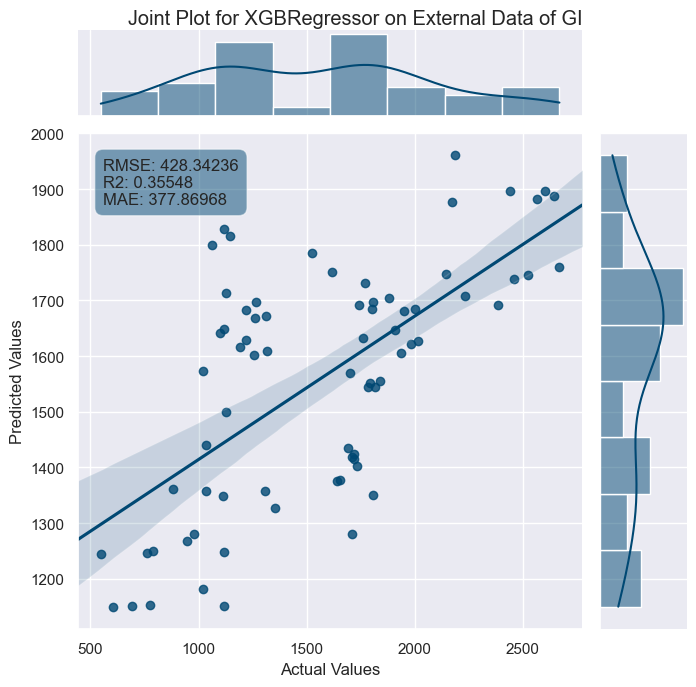

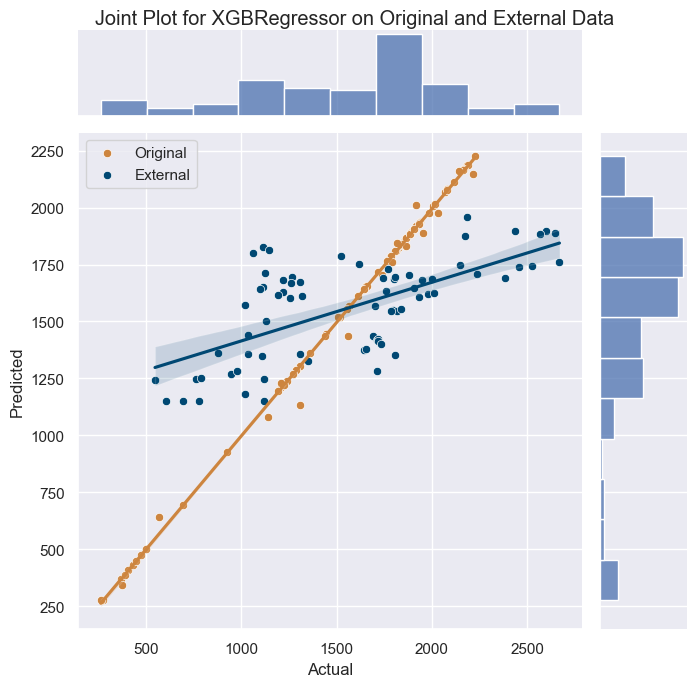

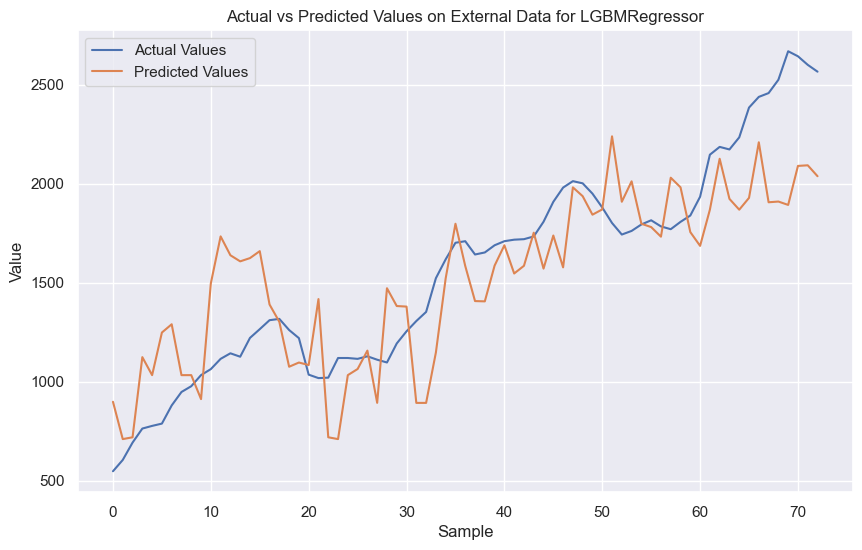

Model: LGBMRegressor
Train RMSE: 96.69392442581281 Train R2: 0.9653383291913619 Train MAE: 72.78114488754971
Test RMSE: 217.74601215018407 Test R2: 0.860525183459132 Test MAE: 166.0455110851229
External RMSE: 308.33900246473763 External R2: 0.6660284696139545 External MAE: 247.80607939618403
--------------------------------------------------
Original Dataset - RMSE: 131.24383733627124, R2: 0.9394923396506766, MAE: 92.07722065256486
External Dataset - RMSE: 308.33900246473763, R2: 0.6660284696139545, MAE: 247.80607939618403


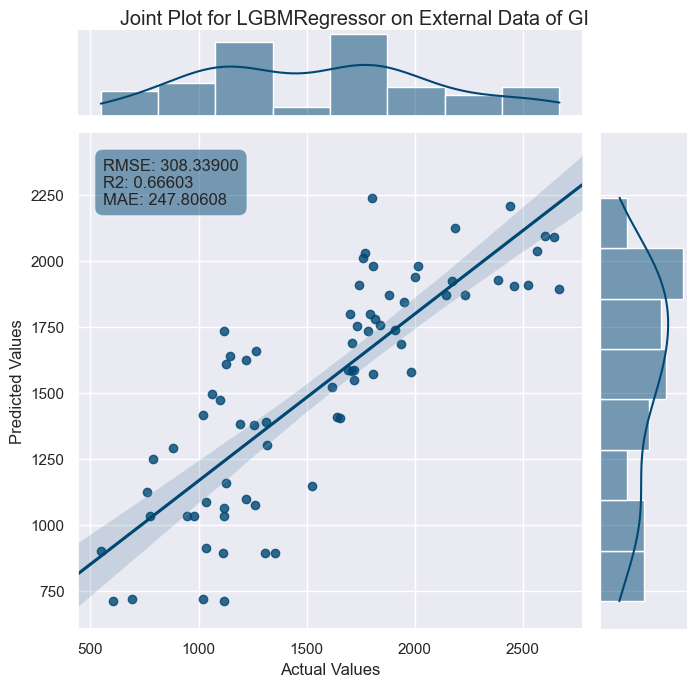

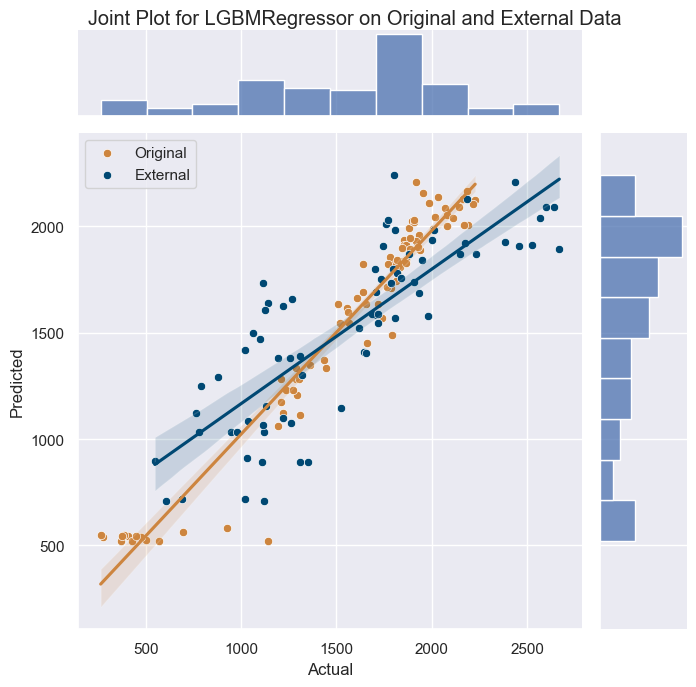

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
from sklearn.neighbors import KNeighborsRegressor
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from sklearn.preprocessing import StandardScaler
from skopt import BayesSearchCV
from skopt.space import Integer
import matplotlib.pyplot as plt
# Load datasets
data = pd.read_csv("C:\\Users\\Lenovo\\Desktop\\元学习\\BT(2)3-1.csv")
external_data = pd.read_csv("C:\\Users\\Lenovo\\Desktop\\元学习\\BT(2)3-2.csv")

# Normalization function
def normalize_data(data):
    scaler = StandardScaler()
    return scaler.fit_transform(data), scaler

# Normalize datasets
data_normalized, scaler = normalize_data(data)
external_data_normalized, _ = normalize_data(external_data)

# Split the dataset into features and target
X = data_normalized[:, :-1]
y = data_normalized[:, -1]
X_external = external_data_normalized[:, :-1]
y_external = external_data_normalized[:, -1]

# Fit a scaler for the features
feature_scaler = StandardScaler()
X_normalized = feature_scaler.fit_transform(data.drop('Biogas Production', axis=1))

# Fit a separate scaler for the target
target_scaler = StandardScaler()
y_normalized = target_scaler.fit_transform(data[['Biogas Production']])


# Split into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

# Define the hyperparameter space
param_grid = {'n_neighbors': Integer(1, 30)}

# Bayesian optimization
knn_search = BayesSearchCV(KNeighborsRegressor(), param_grid, n_iter=32, cv=5, n_jobs=-1, random_state=0)
knn_search.fit(X_train, y_train)

# Best model
knn_best = knn_search.best_estimator_

# Function to evaluate the model
def evaluate_model(model, X_train, y_train, X_test, y_test, X_external, y_external, target_scaler):
    y_pred_train = model.predict(X_train)
    y_pred_test = model.predict(X_test)
    y_pred_external = model.predict(X_external)

    # Denormalize target values and predictions
    y_train_denorm = target_scaler.inverse_transform(y_train.reshape(-1, 1)).flatten()
    y_test_denorm = target_scaler.inverse_transform(y_test.reshape(-1, 1)).flatten()
    y_external_denorm = target_scaler.inverse_transform(y_external.reshape(-1, 1)).flatten()
    y_pred_train_denorm = target_scaler.inverse_transform(y_pred_train.reshape(-1, 1)).flatten()
    y_pred_test_denorm = target_scaler.inverse_transform(y_pred_test.reshape(-1, 1)).flatten()
    y_pred_external_denorm = target_scaler.inverse_transform(y_pred_external.reshape(-1, 1)).flatten()

    # Visualization of predictions on external data
    plt.figure(figsize=(10, 6))
    plt.plot(y_external_denorm, label='Actual Values')
    plt.plot(y_pred_external_denorm, label='Predicted Values')
    plt.xlabel('Sample')
    plt.ylabel('Value')
    plt.title(f'Actual vs Predicted Values on External Data for {model.__class__.__name__}')
    plt.legend()
    plt.show()

    # Metrics for train and test sets
    train_rmse = mean_squared_error(y_train_denorm, y_pred_train_denorm, squared=False)
    test_rmse = mean_squared_error(y_test_denorm, y_pred_test_denorm, squared=False)
    train_r2 = r2_score(y_train_denorm, y_pred_train_denorm)
    test_r2 = r2_score(y_test_denorm, y_pred_test_denorm)
    train_mae = mean_absolute_error(y_train_denorm, y_pred_train_denorm)
    test_mae = mean_absolute_error(y_test_denorm, y_pred_test_denorm)

    # Metrics for external set
    external_rmse = mean_squared_error(y_external_denorm, y_pred_external_denorm, squared=False)
    external_r2 = r2_score(y_external_denorm, y_pred_external_denorm)
    external_mae = mean_absolute_error(y_external_denorm, y_pred_external_denorm)

    # Text for metrics
    metrics_text = f"RMSE: {external_rmse:.5f}\nR2: {external_r2:.5f}\nMAE: {external_mae:.5f}"

    # Create DataFrame for seaborn joint plot
    external_pred_df = pd.DataFrame({
        'Actual Values': y_external_denorm, 
        'Predicted Values': y_pred_external_denorm
    })

    # Set seaborn theme
    sns.set_theme(style="darkgrid")

    # Create the jointplot for external data with specified color
    g_external = sns.jointplot(x='Actual Values', y='Predicted Values', data=external_pred_df,
                               kind="reg", truncate=False,
                               color="#004873", height=7) 
    
    # Set title for the plot
    g_external.fig.suptitle(f"Joint Plot for {model.__class__.__name__} on External Data of GI")

    # Add metrics as text annotations
    plt.annotate(metrics_text, xy=(0.05, 0.95), xycoords='axes fraction', 
                 ha='left', va='top', bbox=dict(boxstyle='round,pad=0.5', fc="#004873", alpha=0.5))

    # Adjust layout
    g_external.fig.subplots_adjust(top=0.95)

    # Print metrics
    print(f"Model: {model.__class__.__name__}")
    print("Train RMSE:", train_rmse, "Train R2:", train_r2, "Train MAE:", train_mae)
    print("Test RMSE:", test_rmse, "Test R2:", test_r2, "Test MAE:", test_mae)
    print("External RMSE:", external_rmse, "External R2:", external_r2, "External MAE:", external_mae)
    print("--------------------------------------------------")

    # 评估模型并获取训练集和测试集的预测值
    y_pred_train_denorm = target_scaler.inverse_transform(model.predict(X_train).reshape(-1, 1)).flatten()
    y_pred_test_denorm = target_scaler.inverse_transform(model.predict(X_test).reshape(-1, 1)).flatten()

    # 合并训练集和测试集的数据
    original_data_actual = np.concatenate([y_train_denorm, y_test_denorm])
    original_data_predicted = np.concatenate([y_pred_train_denorm, y_pred_test_denorm])

    # 创建包含原始数据集和外部数据集的 DataFrame
    combined_df = pd.DataFrame({
        'Actual': np.concatenate([original_data_actual, y_external_denorm]),
        'Predicted': np.concatenate([original_data_predicted, y_pred_external_denorm]),
        'Dataset': ['Original'] * len(original_data_actual) + ['External'] * len(y_external_denorm)
    })

    # 创建基础 jointplot
    g_combined = sns.jointplot(x='Actual', y='Predicted', data=combined_df, kind="scatter", height=7)

    # 定义两个数据集的颜色
    colors = ['#CD853F', '#004873']

    # 为两个数据集添加不同颜色的散点图和线性回归线
    for dataset, color in zip(['Original', 'External'], colors):
        subset = combined_df[combined_df['Dataset'] == dataset]
        sns.scatterplot(x=subset['Actual'], y=subset['Predicted'], color=color, ax=g_combined.ax_joint, label=dataset)
        sns.regplot(x=subset['Actual'], y=subset['Predicted'], scatter=False, color=color, ax=g_combined.ax_joint)

    # 设置标题和布局
    g_combined.fig.suptitle(f"Joint Plot for {model.__class__.__name__} on Original and External Data")
    g_combined.fig.subplots_adjust(top=0.95)
    # 计算原始数据集的指标
    train_rmse = mean_squared_error(original_data_actual, original_data_predicted, squared=False)
    train_r2 = r2_score(original_data_actual, original_data_predicted)
    train_mae = mean_absolute_error(original_data_actual, original_data_predicted)

    # 计算外部数据集的指标
    external_rmse = mean_squared_error(y_external_denorm, y_pred_external_denorm, squared=False)
    external_r2 = r2_score(y_external_denorm, y_pred_external_denorm)
    external_mae = mean_absolute_error(y_external_denorm, y_pred_external_denorm)


    print(f"Original Dataset - RMSE: {train_rmse}, R2: {train_r2}, MAE: {train_mae}")
    print(f"External Dataset - RMSE: {external_rmse}, R2: {external_r2}, MAE: {external_mae}")

# Evaluate KNN model
evaluate_model(knn_best, X_train, y_train, X_test, y_test, X_external, y_external, target_scaler)

from sklearn.svm import SVR
from skopt.space import Real

# Define the hyperparameter space for SVM
param_grid_svm = {
    'C': Real(1e-15, 1e+1, prior='log-uniform'),
    'gamma': Real(1e-15, 1e+1, prior='log-uniform'),
    'epsilon': Real(1e-15, 1e+1, prior='log-uniform')
}

# Bayesian optimization
svm_search = BayesSearchCV(SVR(), param_grid_svm, n_iter=32, cv=5, n_jobs=-1, random_state=0)
svm_search.fit(X_train, y_train)

# Best model
svm_best = svm_search.best_estimator_

# Evaluate SVM model
evaluate_model(svm_best, X_train, y_train, X_test, y_test, X_external, y_external, target_scaler)

from sklearn.ensemble import RandomForestRegressor
from skopt.space import Integer, Real

# Define the hyperparameter space for Random Forest
param_grid_rf = {
    'n_estimators': Integer(100, 300),
    'max_depth': Integer(10, 50),
    'min_samples_split': Real(0.1, 1.0),
    'min_samples_leaf': Real(0.1, 0.5)
}

# Bayesian optimization
rf_search = BayesSearchCV(RandomForestRegressor(random_state=0), param_grid_rf, n_iter=32, cv=5, n_jobs=-1, random_state=0)
rf_search.fit(X_train, y_train)

# Best model
rf_best = rf_search.best_estimator_

# Evaluate Random Forest model
evaluate_model(rf_best, X_train, y_train, X_test, y_test, X_external, y_external, target_scaler)


import xgboost as xgb

# Define the hyperparameter space for XGBoost
param_grid_xgb = {
    'n_estimators': Integer(10, 300),
    'max_depth': Integer(1, 50),
    'learning_rate': Real(0.01, 1.0, 'log-uniform'),
    'subsample': Real(0.1, 1.0),
    'colsample_bytree': Real(0.1, 1.0)
}

# Bayesian optimization
xgb_search = BayesSearchCV(xgb.XGBRegressor(), param_grid_xgb, n_iter=32, cv=5, n_jobs=-1, random_state=0)
xgb_search.fit(X_train, y_train)

# Best model
xgb_best = xgb_search.best_estimator_

# Evaluate XGBoost model
evaluate_model(xgb_best, X_train, y_train, X_test, y_test, X_external, y_external, target_scaler)


import lightgbm as lgb

# Define the hyperparameter space for LightGBM
param_grid_lgb = {
    'n_estimators': Integer(10, 300),
    'max_depth': Integer(-1, 50),
    'learning_rate': Real(0.01, 1.0, 'log-uniform'),
    'num_leaves': Integer(20, 300),
    'subsample': Real(0.1, 1.0),
    'colsample_bytree': Real(0.1, 1.0)
}

# Bayesian optimization
lgb_search = BayesSearchCV(lgb.LGBMRegressor(), param_grid_lgb, n_iter=32, cv=5, n_jobs=-1, random_state=0)
lgb_search.fit(X_train, y_train)

# Best model
lgb_best = lgb_search.best_estimator_

# Evaluate LightGBM model
evaluate_model(lgb_best, X_train, y_train, X_test, y_test, X_external, y_external, target_scaler)

In [2]:
# 创建包含模型名称和其最优超参数的字典
model_hyperparams = {
    'KNN': knn_search.best_params_,
    'SVM': svm_search.best_params_,
    'RandomForest': rf_search.best_params_,
    'XGBoost': xgb_search.best_params_,
    'LightGBM': lgb_search.best_params_
}

# 转换为DataFrame
hyperparams_df = pd.DataFrame.from_dict(model_hyperparams, orient='index')

# 重置索引，使模型名称成为一列
hyperparams_df.reset_index(inplace=True)
hyperparams_df.rename(columns={'index': 'Model'}, inplace=True)

# 指定文件路径和名称，这里替换为你的目标路径
file_path = "C:\\Users\\Lenovo\\Desktop\\元学习\\传统模型超参数\\hyperparams_BT_2_3.csv"

# 保存为CSV文件
hyperparams_df.to_csv(file_path, index=False)

e:\anaconda\envs\yuanxuexi2\lib\site-packages\skopt\optimizer\optimizer.py:449: UserWarning: The objective has been evaluated at this point before.
  warnings.warn("The objective has been evaluated "
e:\anaconda\envs\yuanxuexi2\lib\site-packages\skopt\optimizer\optimizer.py:449: UserWarning: The objective has been evaluated at this point before.
  warnings.warn("The objective has been evaluated "
e:\anaconda\envs\yuanxuexi2\lib\site-packages\skopt\optimizer\optimizer.py:449: UserWarning: The objective has been evaluated at this point before.
  warnings.warn("The objective has been evaluated "
e:\anaconda\envs\yuanxuexi2\lib\site-packages\skopt\optimizer\optimizer.py:449: UserWarning: The objective has been evaluated at this point before.
  warnings.warn("The objective has been evaluated "
e:\anaconda\envs\yuanxuexi2\lib\site-packages\skopt\optimizer\optimizer.py:449: UserWarning: The objective has been evaluated at this point before.
  warnings.warn("The objective has been evaluated "


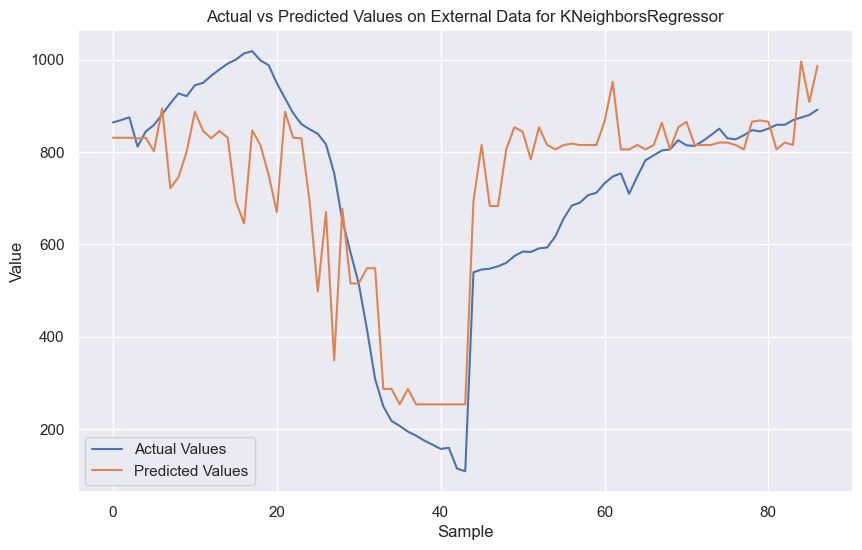

Model: KNeighborsRegressor
Train RMSE: 27.768342679612953 Train R2: 0.9883846546815178 Train MAE: 19.56206896551724
Test RMSE: 46.18256574004236 Test R2: 0.9457085387533426 Test MAE: 33.34299999999999
External RMSE: 145.1829757811303 External R2: 0.6550023947001434 External MAE: 111.58541653549177
--------------------------------------------------
Original Dataset - RMSE: 32.417467445004796, R2: 0.9827994291781638, MAE: 22.39376712328767
External Dataset - RMSE: 145.1829757811303, R2: 0.6550023947001434, MAE: 111.58541653549177


e:\anaconda\envs\yuanxuexi2\lib\site-packages\skopt\optimizer\optimizer.py:449: UserWarning: The objective has been evaluated at this point before.
  warnings.warn("The objective has been evaluated "


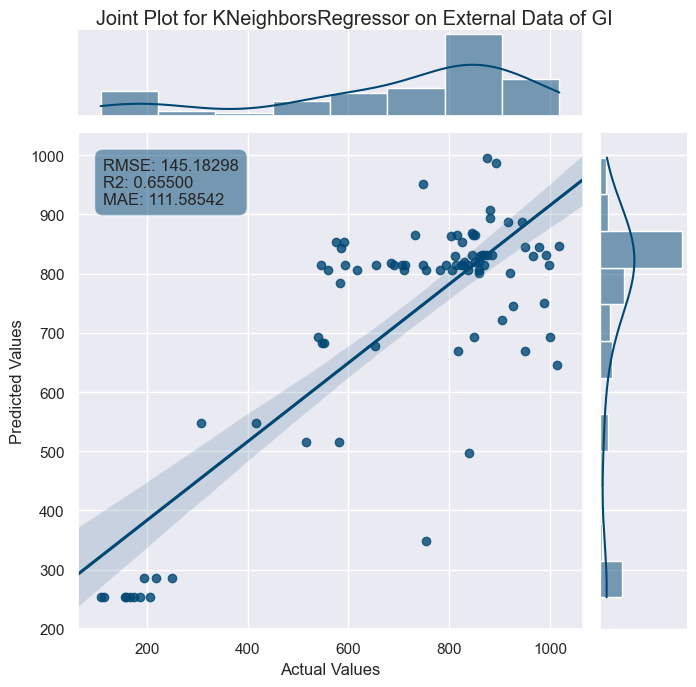

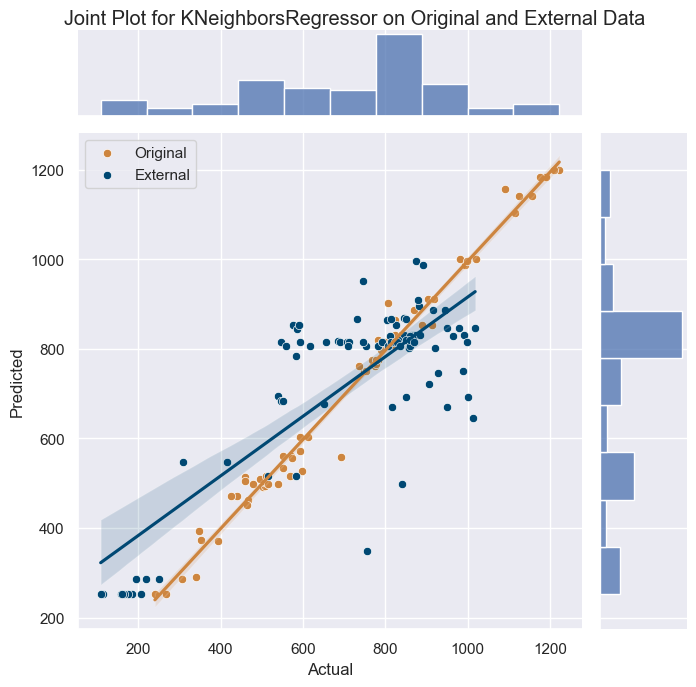

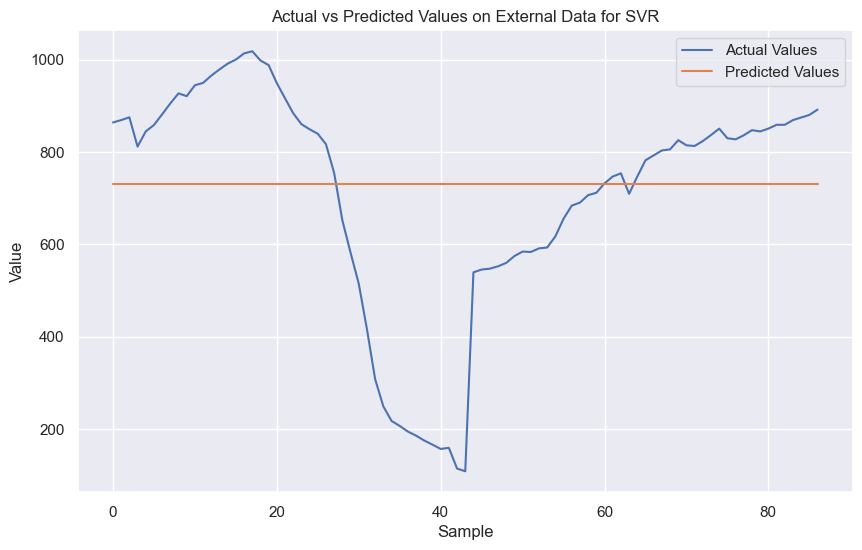

Model: SVR
Train RMSE: 259.43931024090364 Train R2: -0.013920181195548276 Train MAE: 223.74775862068967
Test RMSE: 198.5103927254188 Test R2: -0.0030946489647778463 Test MAE: 154.65533333333335
External RMSE: 248.14388973125835 External R2: -0.007840634132263657 External MAE: 191.60303566721737
--------------------------------------------------
Original Dataset - RMSE: 248.14388973125835, R2: -0.007840634132264102, MAE: 209.55068493150688
External Dataset - RMSE: 248.14388973125835, R2: -0.007840634132263657, MAE: 191.60303566721737


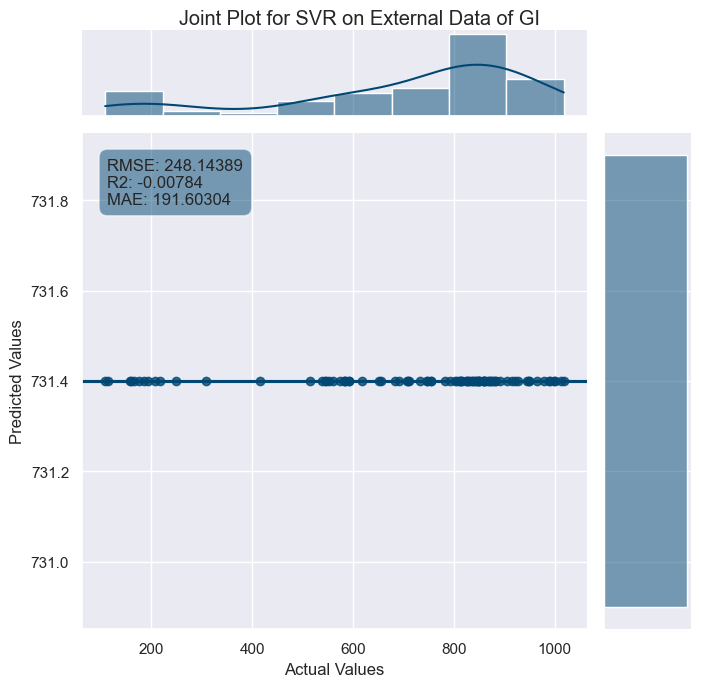

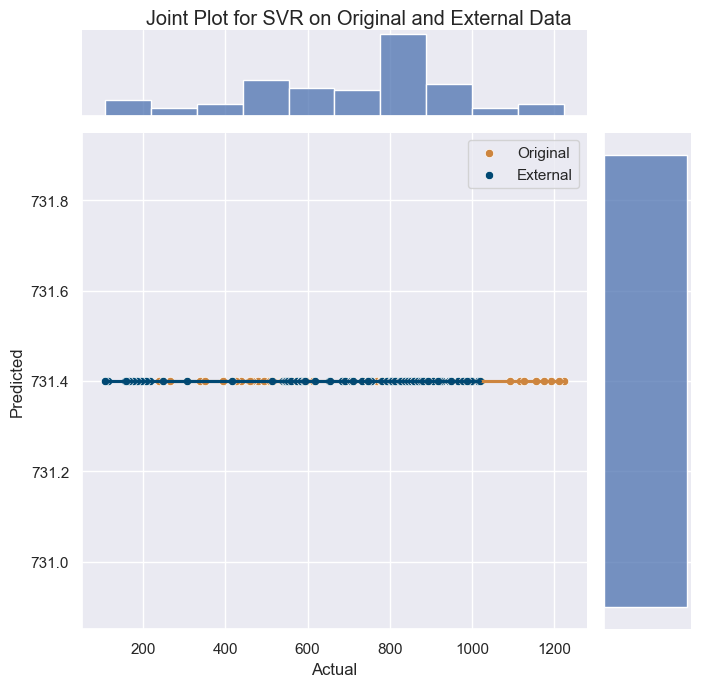

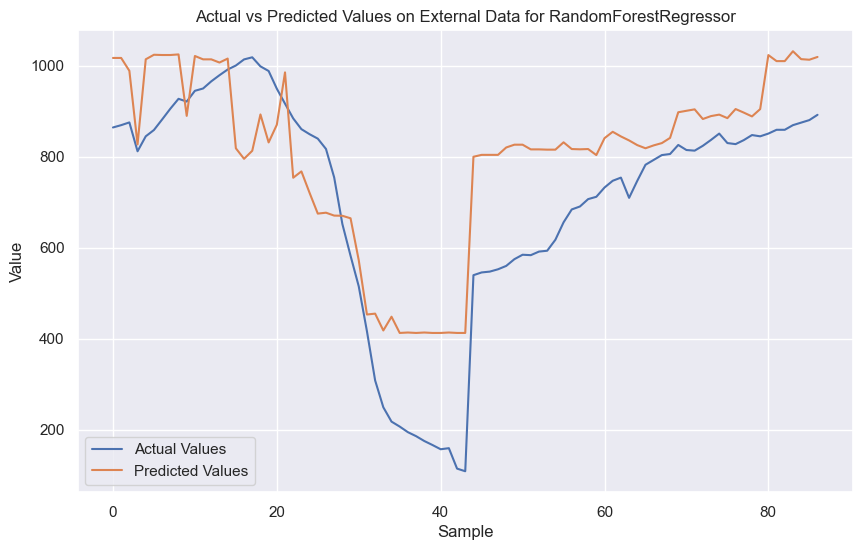

Model: RandomForestRegressor
Train RMSE: 60.4737829352742 Train R2: 0.9449107983304287 Train MAE: 49.58455152687136
Test RMSE: 65.27872362260275 Test R2: 0.8915277309528141 Test MAE: 49.59555477475075
External RMSE: 155.95603265990692 External R2: 0.6019028665555379 External MAE: 135.74909263799105
--------------------------------------------------
Original Dataset - RMSE: 61.49175519654654, R2: 0.9381102865254843, MAE: 49.58681246821644
External Dataset - RMSE: 155.95603265990692, R2: 0.6019028665555379, MAE: 135.74909263799105


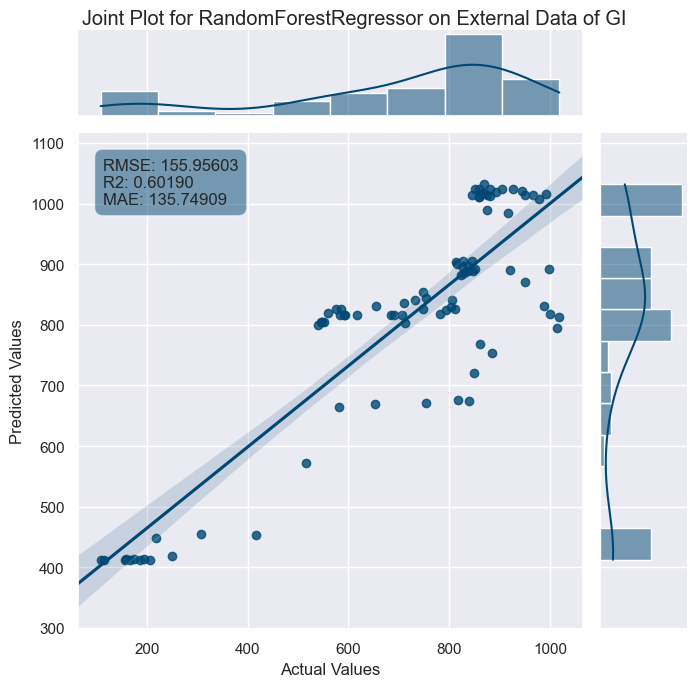

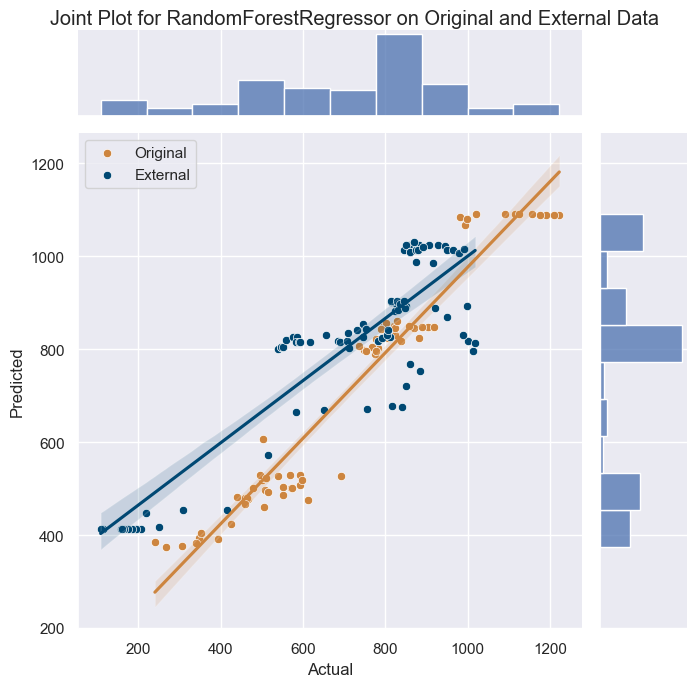

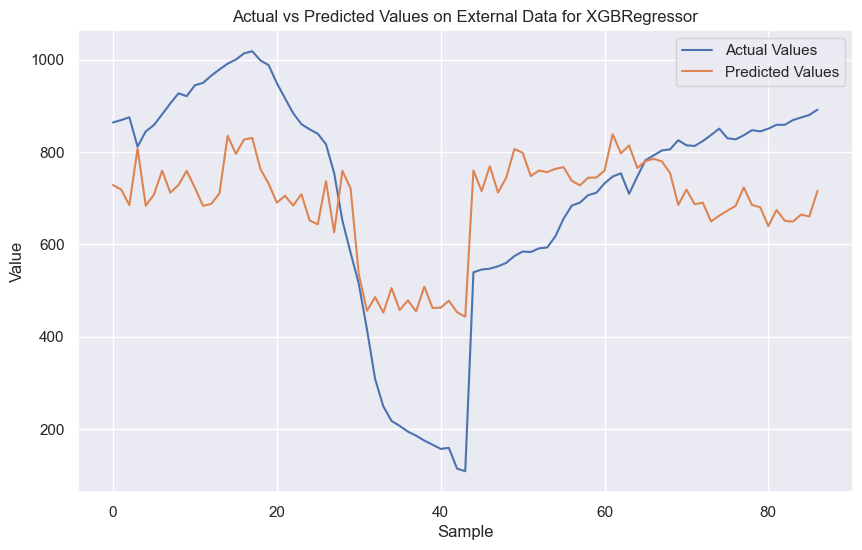

Model: XGBRegressor
Train RMSE: 0.9351932008802298 Train R2: 0.9999868254774009 Train MAE: 0.7213515498720343
Test RMSE: 57.47106366089765 Test R2: 0.9159236428042496 Test MAE: 46.154745117187495
External RMSE: 187.104724436883 External R2: 0.4270005563111279 External MAE: 167.76303429988258
--------------------------------------------------
Original Dataset - RMSE: 26.064875168590408, R2: 0.9888802252076146, MAE: 10.05698036507384
External Dataset - RMSE: 187.104724436883, R2: 0.4270005563111279, MAE: 167.76303429988258
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000044 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 226
[LightGBM] [Info] Number of data points in the train set: 58, number of used features: 13
[LightGBM] [Info] Start training from score -0.034437
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, 

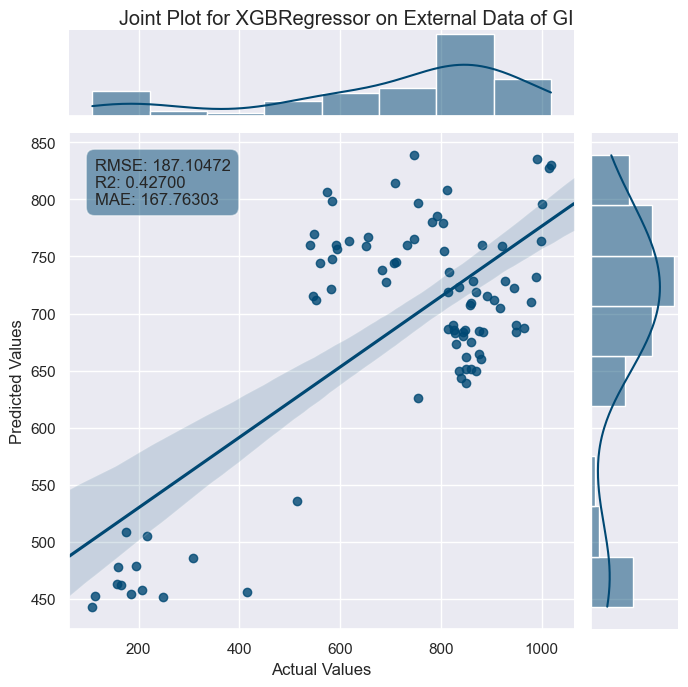

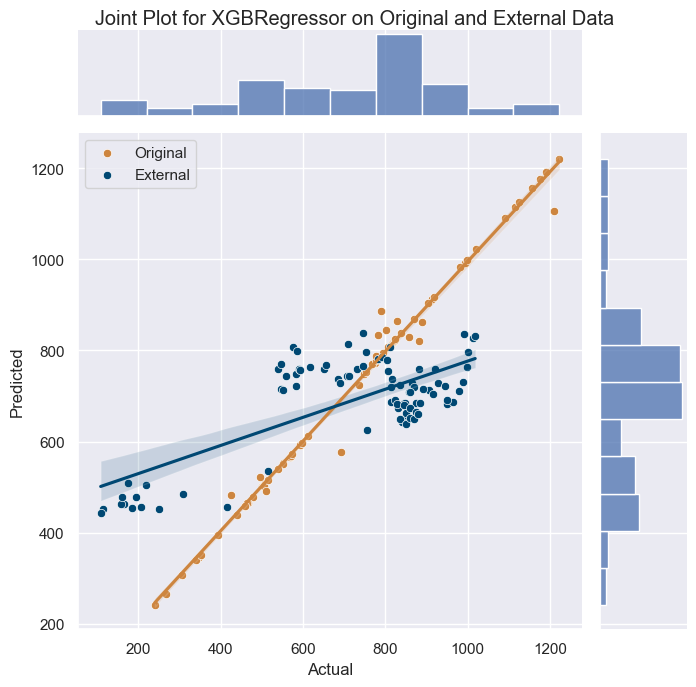

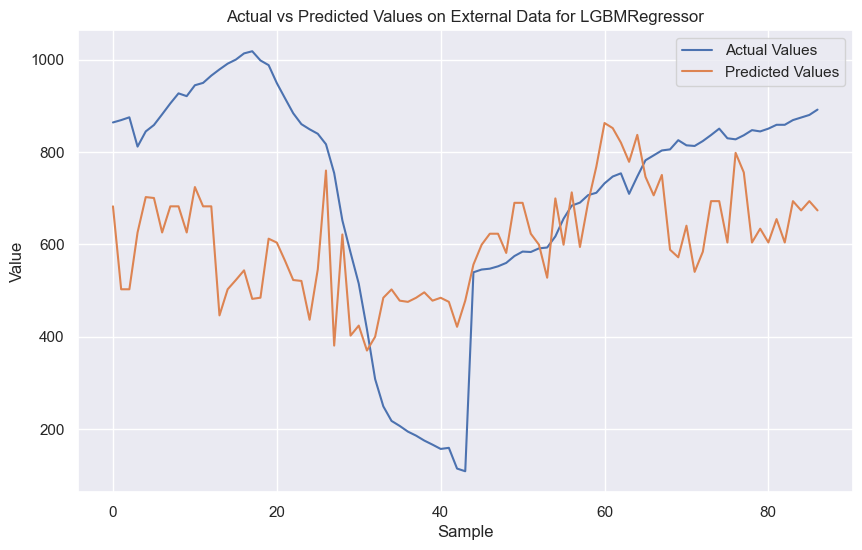

Model: LGBMRegressor
Train RMSE: 57.103415283521386 Train R2: 0.950880224569579 Train MAE: 43.4632979491289
Test RMSE: 131.83545953975445 Test R2: 0.5575747639649877 Test MAE: 100.95716777883163
External RMSE: 249.1696595081133 External R2: -0.01619021900411255 External MAE: 208.93047885029307
--------------------------------------------------
Original Dataset - RMSE: 78.49921280726734, R2: 0.8991408517441208, MAE: 55.277106818245905
External Dataset - RMSE: 249.1696595081133, R2: -0.01619021900411255, MAE: 208.93047885029307


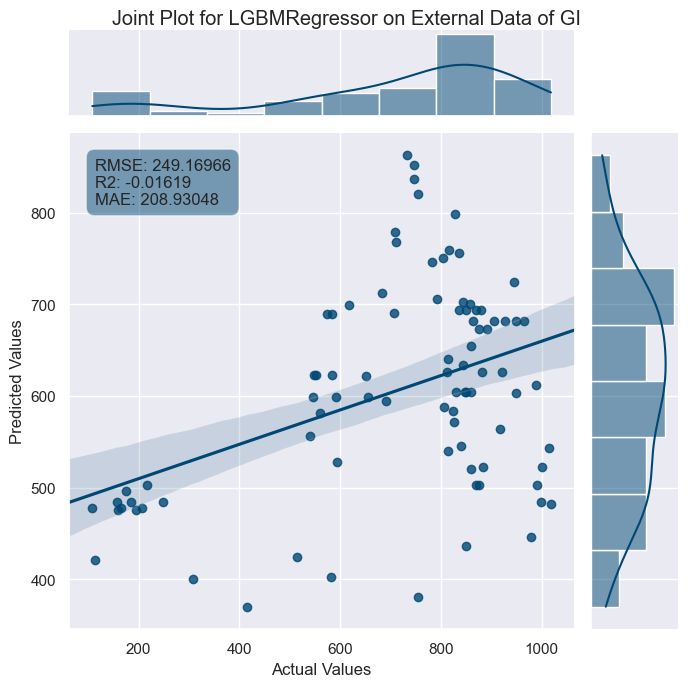

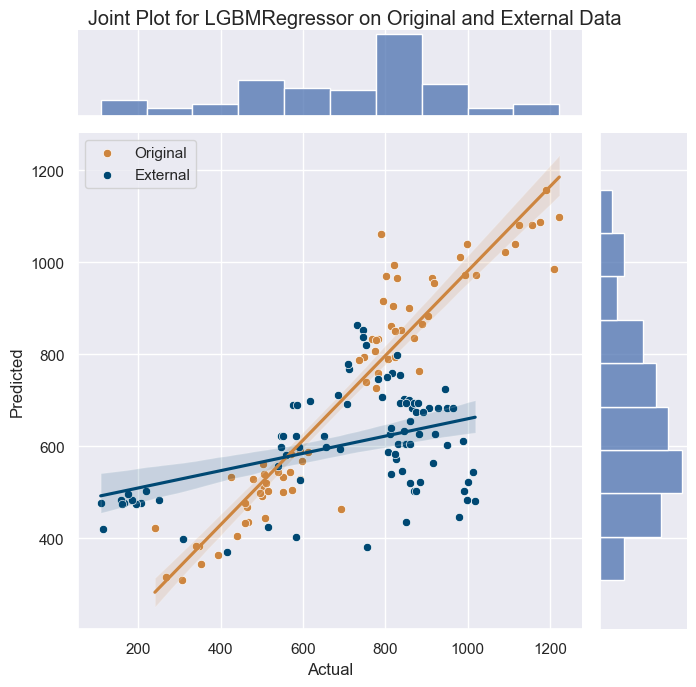

In [3]:
import pandas as pd
import numpy as np
import seaborn as sns
from sklearn.neighbors import KNeighborsRegressor
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from sklearn.preprocessing import StandardScaler
from skopt import BayesSearchCV
from skopt.space import Integer
import matplotlib.pyplot as plt
# Load datasets
data = pd.read_csv("C:\\Users\\Lenovo\\Desktop\\元学习\\BT(2)4-1.csv")
external_data = pd.read_csv("C:\\Users\\Lenovo\\Desktop\\元学习\\BT(2)4-2.csv")

# Normalization function
def normalize_data(data):
    scaler = StandardScaler()
    return scaler.fit_transform(data), scaler

# Normalize datasets
data_normalized, scaler = normalize_data(data)
external_data_normalized, _ = normalize_data(external_data)

# Split the dataset into features and target
X = data_normalized[:, :-1]
y = data_normalized[:, -1]
X_external = external_data_normalized[:, :-1]
y_external = external_data_normalized[:, -1]

# Fit a scaler for the features
feature_scaler = StandardScaler()
X_normalized = feature_scaler.fit_transform(data.drop('Biogas Production', axis=1))

# Fit a separate scaler for the target
target_scaler = StandardScaler()
y_normalized = target_scaler.fit_transform(data[['Biogas Production']])


# Split into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

# Define the hyperparameter space
param_grid = {'n_neighbors': Integer(1, 30)}

# Bayesian optimization
knn_search = BayesSearchCV(KNeighborsRegressor(), param_grid, n_iter=32, cv=5, n_jobs=-1, random_state=0)
knn_search.fit(X_train, y_train)

# Best model
knn_best = knn_search.best_estimator_

# Function to evaluate the model
def evaluate_model(model, X_train, y_train, X_test, y_test, X_external, y_external, target_scaler):
    y_pred_train = model.predict(X_train)
    y_pred_test = model.predict(X_test)
    y_pred_external = model.predict(X_external)

    # Denormalize target values and predictions
    y_train_denorm = target_scaler.inverse_transform(y_train.reshape(-1, 1)).flatten()
    y_test_denorm = target_scaler.inverse_transform(y_test.reshape(-1, 1)).flatten()
    y_external_denorm = target_scaler.inverse_transform(y_external.reshape(-1, 1)).flatten()
    y_pred_train_denorm = target_scaler.inverse_transform(y_pred_train.reshape(-1, 1)).flatten()
    y_pred_test_denorm = target_scaler.inverse_transform(y_pred_test.reshape(-1, 1)).flatten()
    y_pred_external_denorm = target_scaler.inverse_transform(y_pred_external.reshape(-1, 1)).flatten()

    # Visualization of predictions on external data
    plt.figure(figsize=(10, 6))
    plt.plot(y_external_denorm, label='Actual Values')
    plt.plot(y_pred_external_denorm, label='Predicted Values')
    plt.xlabel('Sample')
    plt.ylabel('Value')
    plt.title(f'Actual vs Predicted Values on External Data for {model.__class__.__name__}')
    plt.legend()
    plt.show()

    # Metrics for train and test sets
    train_rmse = mean_squared_error(y_train_denorm, y_pred_train_denorm, squared=False)
    test_rmse = mean_squared_error(y_test_denorm, y_pred_test_denorm, squared=False)
    train_r2 = r2_score(y_train_denorm, y_pred_train_denorm)
    test_r2 = r2_score(y_test_denorm, y_pred_test_denorm)
    train_mae = mean_absolute_error(y_train_denorm, y_pred_train_denorm)
    test_mae = mean_absolute_error(y_test_denorm, y_pred_test_denorm)

    # Metrics for external set
    external_rmse = mean_squared_error(y_external_denorm, y_pred_external_denorm, squared=False)
    external_r2 = r2_score(y_external_denorm, y_pred_external_denorm)
    external_mae = mean_absolute_error(y_external_denorm, y_pred_external_denorm)

    # Text for metrics
    metrics_text = f"RMSE: {external_rmse:.5f}\nR2: {external_r2:.5f}\nMAE: {external_mae:.5f}"

    # Create DataFrame for seaborn joint plot
    external_pred_df = pd.DataFrame({
        'Actual Values': y_external_denorm, 
        'Predicted Values': y_pred_external_denorm
    })

    # Set seaborn theme
    sns.set_theme(style="darkgrid")

    # Create the jointplot for external data with specified color
    g_external = sns.jointplot(x='Actual Values', y='Predicted Values', data=external_pred_df,
                               kind="reg", truncate=False,
                               color="#004873", height=7) 
    
    # Set title for the plot
    g_external.fig.suptitle(f"Joint Plot for {model.__class__.__name__} on External Data of GI")

    # Add metrics as text annotations
    plt.annotate(metrics_text, xy=(0.05, 0.95), xycoords='axes fraction', 
                 ha='left', va='top', bbox=dict(boxstyle='round,pad=0.5', fc="#004873", alpha=0.5))

    # Adjust layout
    g_external.fig.subplots_adjust(top=0.95)

    # Print metrics
    print(f"Model: {model.__class__.__name__}")
    print("Train RMSE:", train_rmse, "Train R2:", train_r2, "Train MAE:", train_mae)
    print("Test RMSE:", test_rmse, "Test R2:", test_r2, "Test MAE:", test_mae)
    print("External RMSE:", external_rmse, "External R2:", external_r2, "External MAE:", external_mae)
    print("--------------------------------------------------")

    # 评估模型并获取训练集和测试集的预测值
    y_pred_train_denorm = target_scaler.inverse_transform(model.predict(X_train).reshape(-1, 1)).flatten()
    y_pred_test_denorm = target_scaler.inverse_transform(model.predict(X_test).reshape(-1, 1)).flatten()

    # 合并训练集和测试集的数据
    original_data_actual = np.concatenate([y_train_denorm, y_test_denorm])
    original_data_predicted = np.concatenate([y_pred_train_denorm, y_pred_test_denorm])

    # 创建包含原始数据集和外部数据集的 DataFrame
    combined_df = pd.DataFrame({
        'Actual': np.concatenate([original_data_actual, y_external_denorm]),
        'Predicted': np.concatenate([original_data_predicted, y_pred_external_denorm]),
        'Dataset': ['Original'] * len(original_data_actual) + ['External'] * len(y_external_denorm)
    })

    # 创建基础 jointplot
    g_combined = sns.jointplot(x='Actual', y='Predicted', data=combined_df, kind="scatter", height=7)

    # 定义两个数据集的颜色
    colors = ['#CD853F', '#004873']

    # 为两个数据集添加不同颜色的散点图和线性回归线
    for dataset, color in zip(['Original', 'External'], colors):
        subset = combined_df[combined_df['Dataset'] == dataset]
        sns.scatterplot(x=subset['Actual'], y=subset['Predicted'], color=color, ax=g_combined.ax_joint, label=dataset)
        sns.regplot(x=subset['Actual'], y=subset['Predicted'], scatter=False, color=color, ax=g_combined.ax_joint)

    # 设置标题和布局
    g_combined.fig.suptitle(f"Joint Plot for {model.__class__.__name__} on Original and External Data")
    g_combined.fig.subplots_adjust(top=0.95)
    # 计算原始数据集的指标
    train_rmse = mean_squared_error(original_data_actual, original_data_predicted, squared=False)
    train_r2 = r2_score(original_data_actual, original_data_predicted)
    train_mae = mean_absolute_error(original_data_actual, original_data_predicted)

    # 计算外部数据集的指标
    external_rmse = mean_squared_error(y_external_denorm, y_pred_external_denorm, squared=False)
    external_r2 = r2_score(y_external_denorm, y_pred_external_denorm)
    external_mae = mean_absolute_error(y_external_denorm, y_pred_external_denorm)


    print(f"Original Dataset - RMSE: {train_rmse}, R2: {train_r2}, MAE: {train_mae}")
    print(f"External Dataset - RMSE: {external_rmse}, R2: {external_r2}, MAE: {external_mae}")

# Evaluate KNN model
evaluate_model(knn_best, X_train, y_train, X_test, y_test, X_external, y_external, target_scaler)

from sklearn.svm import SVR
from skopt.space import Real

# Define the hyperparameter space for SVM
param_grid_svm = {
    'C': Real(1e-15, 1e+1, prior='log-uniform'),
    'gamma': Real(1e-15, 1e+1, prior='log-uniform'),
    'epsilon': Real(1e-15, 1e+1, prior='log-uniform')
}


# Bayesian optimization
svm_search = BayesSearchCV(SVR(), param_grid_svm, n_iter=32, cv=5, n_jobs=-1, random_state=0)
svm_search.fit(X_train, y_train)

# Best model
svm_best = svm_search.best_estimator_

# Evaluate SVM model
evaluate_model(svm_best, X_train, y_train, X_test, y_test, X_external, y_external, target_scaler)

from sklearn.ensemble import RandomForestRegressor
from skopt.space import Integer, Real

# Define the hyperparameter space for Random Forest
param_grid_rf = {
    'n_estimators': Integer(100, 300),
    'max_depth': Integer(10, 50),
    'min_samples_split': Real(0.1, 1.0),
    'min_samples_leaf': Real(0.1, 0.5)
}

# Bayesian optimization
rf_search = BayesSearchCV(RandomForestRegressor(random_state=0), param_grid_rf, n_iter=32, cv=5, n_jobs=-1, random_state=0)
rf_search.fit(X_train, y_train)

# Best model
rf_best = rf_search.best_estimator_

# Evaluate Random Forest model
evaluate_model(rf_best, X_train, y_train, X_test, y_test, X_external, y_external, target_scaler)


import xgboost as xgb

# Define the hyperparameter space for XGBoost
param_grid_xgb = {
    'n_estimators': Integer(10, 300),
    'max_depth': Integer(1, 50),
    'learning_rate': Real(0.01, 1.0, 'log-uniform'),
    'subsample': Real(0.1, 1.0),
    'colsample_bytree': Real(0.1, 1.0)
}

# Bayesian optimization
xgb_search = BayesSearchCV(xgb.XGBRegressor(), param_grid_xgb, n_iter=32, cv=5, n_jobs=-1, random_state=0)
xgb_search.fit(X_train, y_train)

# Best model
xgb_best = xgb_search.best_estimator_

# Evaluate XGBoost model
evaluate_model(xgb_best, X_train, y_train, X_test, y_test, X_external, y_external, target_scaler)


import lightgbm as lgb

# Define the hyperparameter space for LightGBM
param_grid_lgb = {
    'n_estimators': Integer(10, 300),
    'max_depth': Integer(-1, 50),
    'learning_rate': Real(0.01, 1.0, 'log-uniform'),
    'num_leaves': Integer(20, 300),
    'subsample': Real(0.1, 1.0),
    'colsample_bytree': Real(0.1, 1.0)
}

# Bayesian optimization
lgb_search = BayesSearchCV(lgb.LGBMRegressor(), param_grid_lgb, n_iter=32, cv=5, n_jobs=-1, random_state=0)
lgb_search.fit(X_train, y_train)

# Best model
lgb_best = lgb_search.best_estimator_

# Evaluate LightGBM model
evaluate_model(lgb_best, X_train, y_train, X_test, y_test, X_external, y_external, target_scaler)

In [4]:
# 创建包含模型名称和其最优超参数的字典
model_hyperparams = {
    'KNN': knn_search.best_params_,
    'SVM': svm_search.best_params_,
    'RandomForest': rf_search.best_params_,
    'XGBoost': xgb_search.best_params_,
    'LightGBM': lgb_search.best_params_
}

# 转换为DataFrame
hyperparams_df = pd.DataFrame.from_dict(model_hyperparams, orient='index')

# 重置索引，使模型名称成为一列
hyperparams_df.reset_index(inplace=True)
hyperparams_df.rename(columns={'index': 'Model'}, inplace=True)

# 指定文件路径和名称，这里替换为你的目标路径
file_path = "C:\\Users\\Lenovo\\Desktop\\元学习\\传统模型超参数\\hyperparams_BT_2_4.csv"

# 保存为CSV文件
hyperparams_df.to_csv(file_path, index=False)

e:\anaconda\envs\yuanxuexi2\lib\site-packages\skopt\optimizer\optimizer.py:449: UserWarning: The objective has been evaluated at this point before.
  warnings.warn("The objective has been evaluated "
e:\anaconda\envs\yuanxuexi2\lib\site-packages\skopt\optimizer\optimizer.py:449: UserWarning: The objective has been evaluated at this point before.
  warnings.warn("The objective has been evaluated "
e:\anaconda\envs\yuanxuexi2\lib\site-packages\skopt\optimizer\optimizer.py:449: UserWarning: The objective has been evaluated at this point before.
  warnings.warn("The objective has been evaluated "
e:\anaconda\envs\yuanxuexi2\lib\site-packages\skopt\optimizer\optimizer.py:449: UserWarning: The objective has been evaluated at this point before.
  warnings.warn("The objective has been evaluated "
e:\anaconda\envs\yuanxuexi2\lib\site-packages\skopt\optimizer\optimizer.py:449: UserWarning: The objective has been evaluated at this point before.
  warnings.warn("The objective has been evaluated "


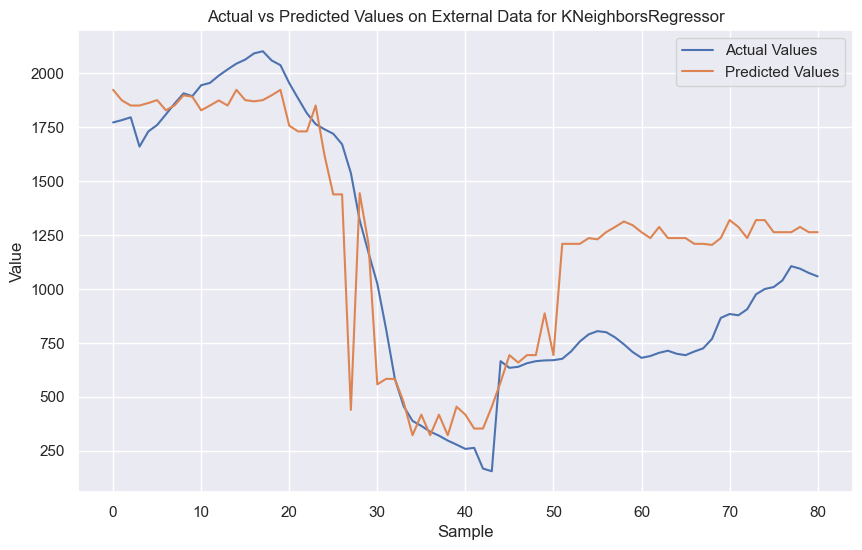

Model: KNeighborsRegressor
Train RMSE: 45.61768981808072 Train R2: 0.9940761010024509 Train MAE: 37.19238095238098
Test RMSE: 52.78205776797856 Test R2: 0.9901968754235774 Test MAE: 42.79791666666668
External RMSE: 318.11796322272136 External R2: 0.7157374468769409 External MAE: 243.8411264651152
--------------------------------------------------
Original Dataset - RMSE: 47.156683122867044, R2: 0.9937536003584497, MAE: 38.32767932489453
External Dataset - RMSE: 318.11796322272136, R2: 0.7157374468769409, MAE: 243.8411264651152


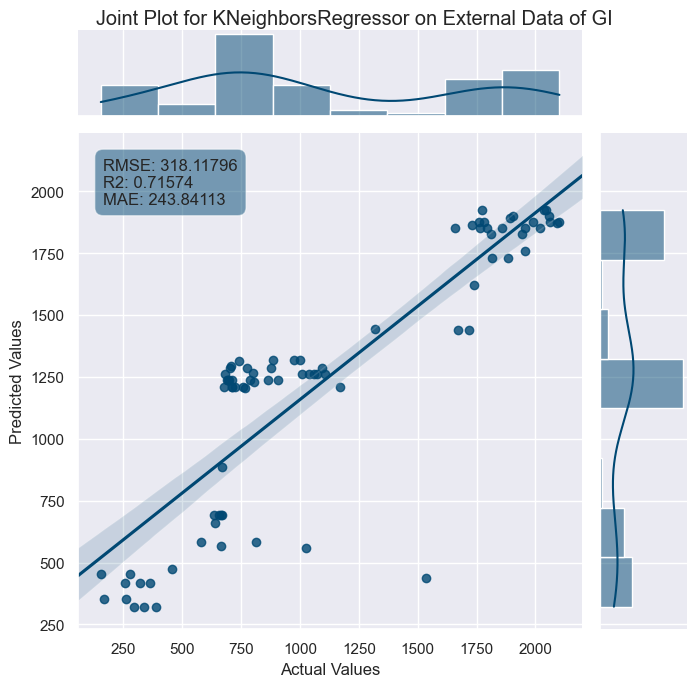

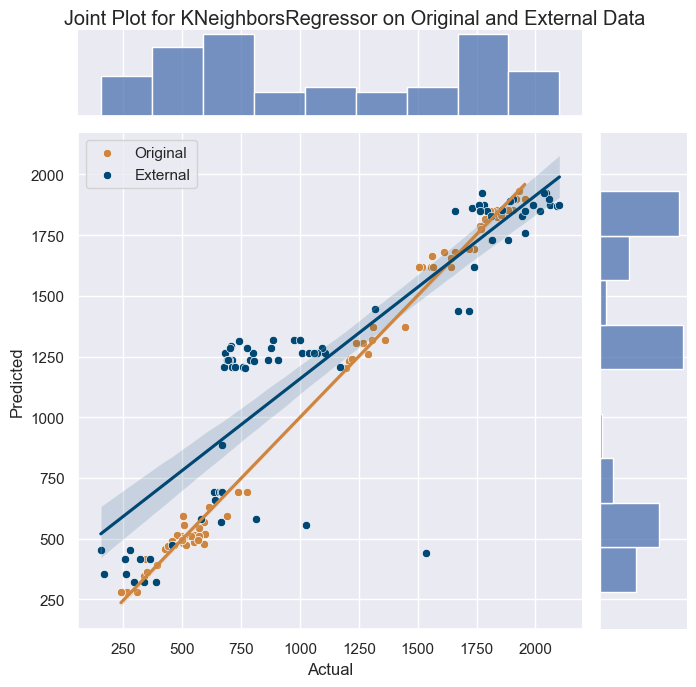

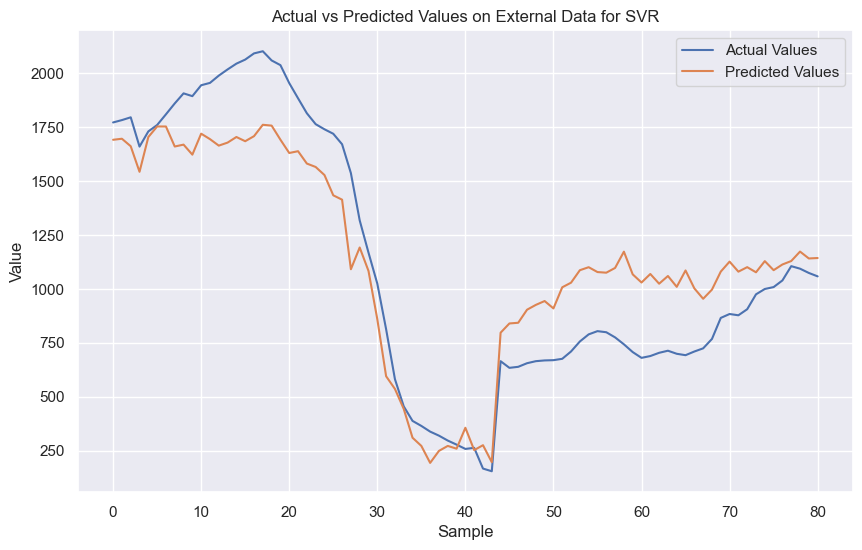

Model: SVR
Train RMSE: 47.06212776613325 Train R2: 0.993695013128936 Train MAE: 32.52338876871243
Test RMSE: 45.33970031855289 Test R2: 0.9927664884915173 Test MAE: 31.14983783323617
External RMSE: 239.09299566386088 External R2: 0.8394253541288079 External MAE: 208.1830405958512
--------------------------------------------------
Original Dataset - RMSE: 46.71841024391729, R2: 0.9938691685306366, MAE: 32.24520123747674
External Dataset - RMSE: 239.09299566386088, R2: 0.8394253541288079, MAE: 208.1830405958512


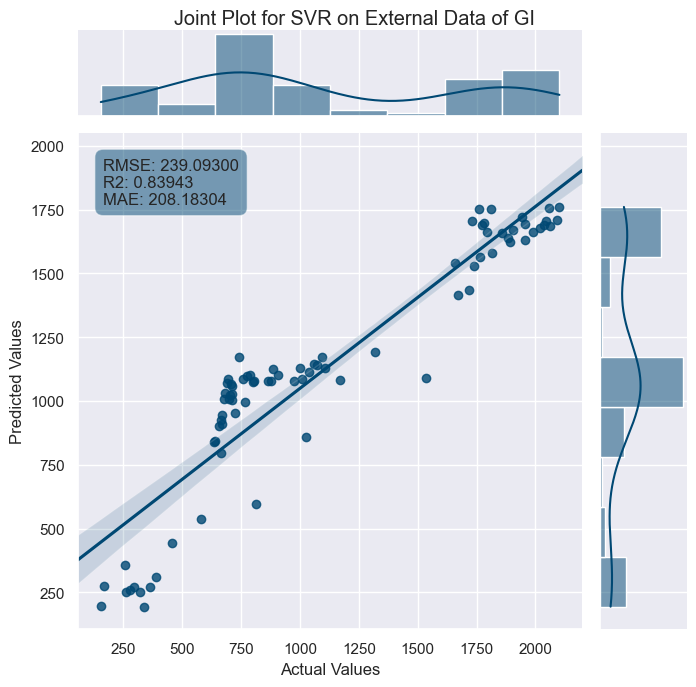

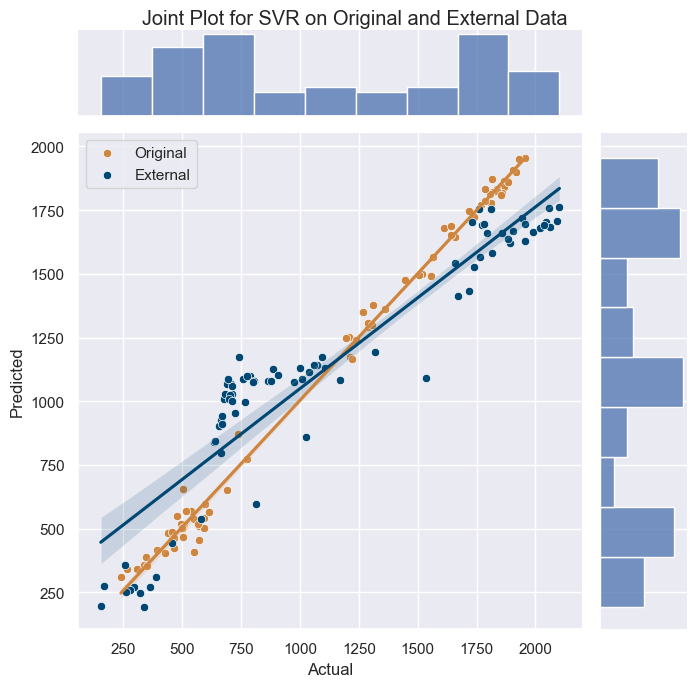

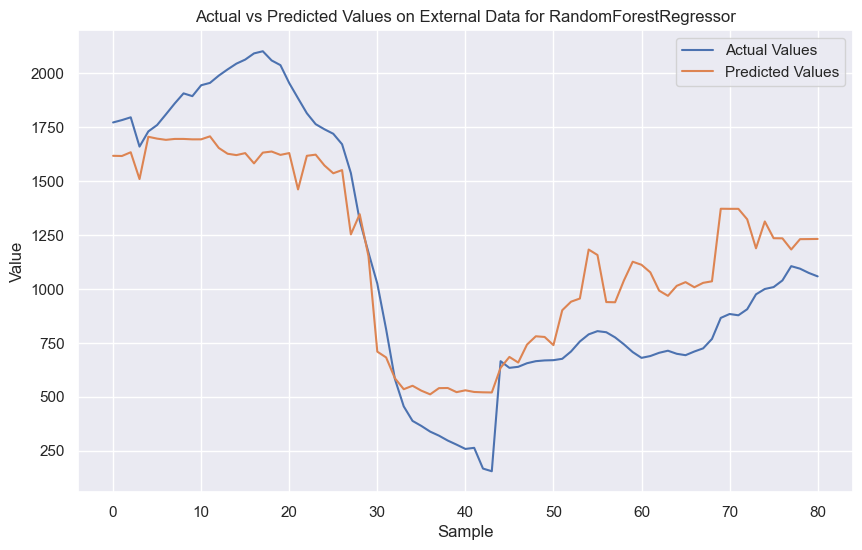

Model: RandomForestRegressor
Train RMSE: 72.1487576401514 Train R2: 0.9851816863195587 Train MAE: 56.23758824994945
Test RMSE: 66.21037819036644 Test R2: 0.9845743304590274 Test MAE: 53.85610758234245
External RMSE: 273.11723631309235 External R2: 0.7904722813998939 External MAE: 239.14924668918846
--------------------------------------------------
Original Dataset - RMSE: 70.98617714523428, R2: 0.9858456202544246, MAE: 55.75526305144675
External Dataset - RMSE: 273.11723631309235, R2: 0.7904722813998939, MAE: 239.14924668918846


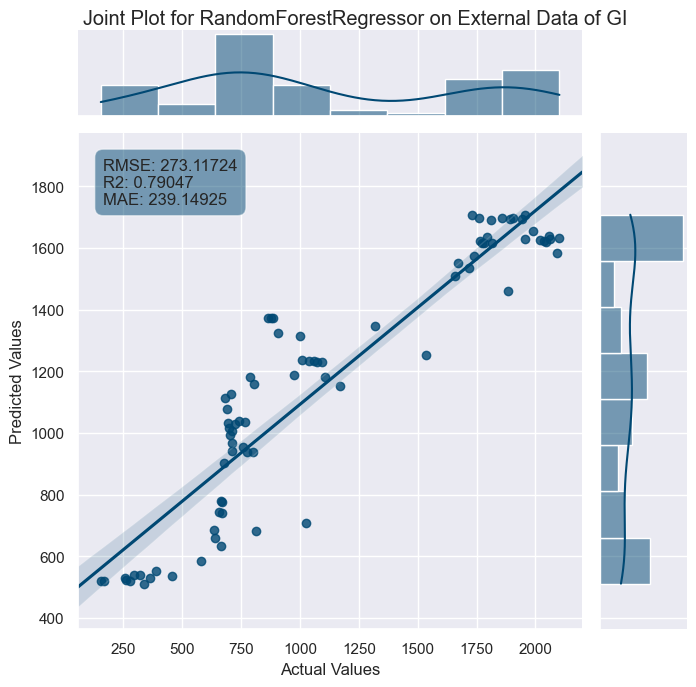

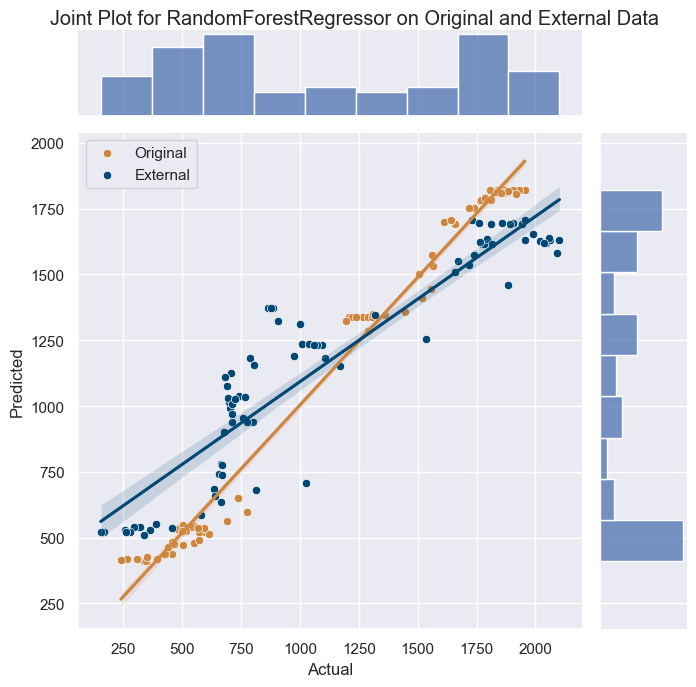

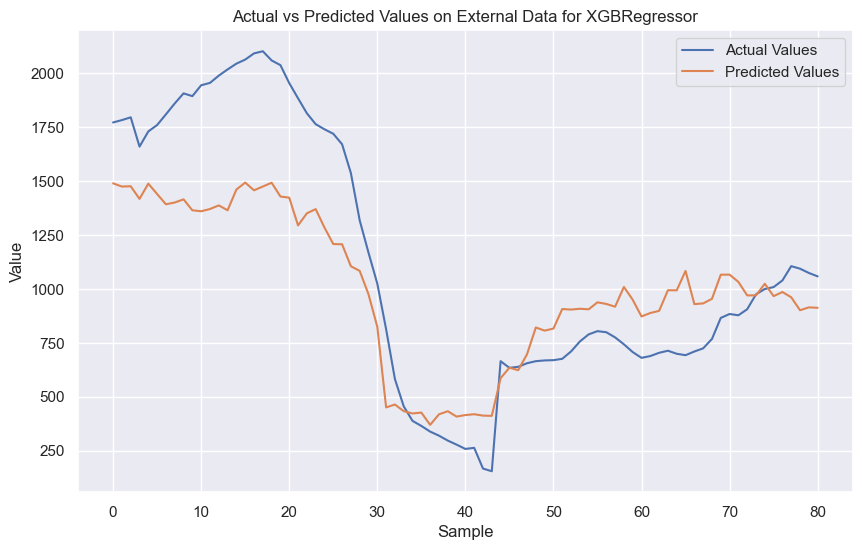

Model: XGBRegressor
Train RMSE: 29.692626792555828 Train R2: 0.997490204658809 Train MAE: 17.4370127844432
Test RMSE: 82.96249843824576 Test R2: 0.9757810376973591 Test MAE: 57.66072418212891
External RMSE: 325.0772936534405 External R2: 0.703164023007923 External MAE: 266.9881851856432
--------------------------------------------------
Original Dataset - RMSE: 45.79377269060996, R2: 0.9941094463725945, MAE: 25.583587244733977
External Dataset - RMSE: 325.0772936534405, R2: 0.703164023007923, MAE: 266.9881851856432
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000045 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 257
[LightGBM] [Info] Number of data points in the train set: 63, number of used features: 14
[LightGBM] [Info] Start training from score -0.114289
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

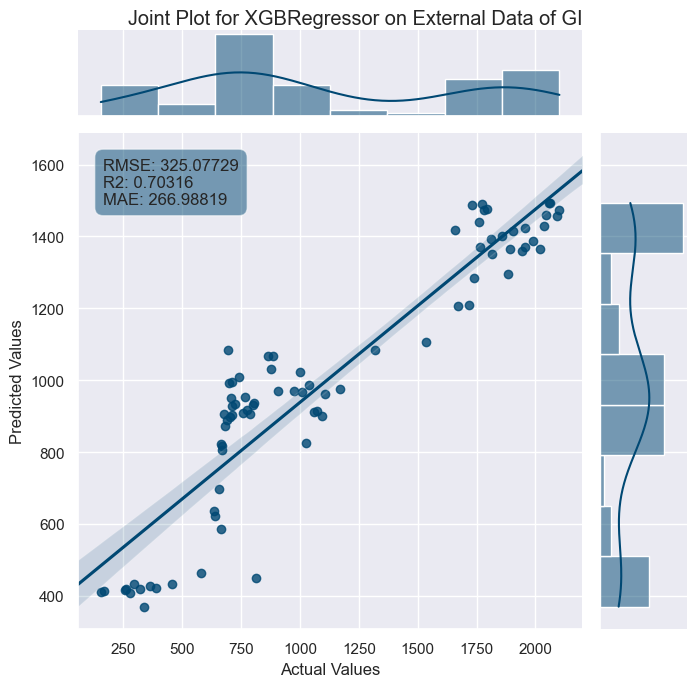

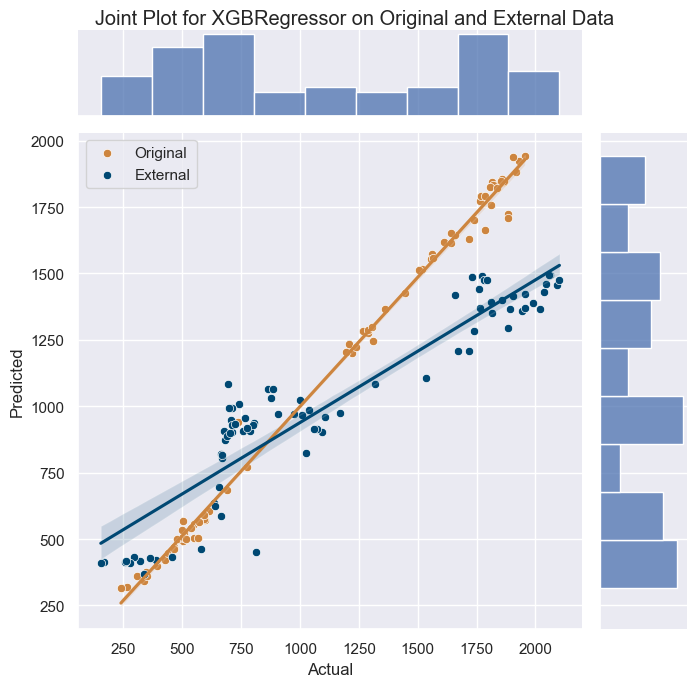

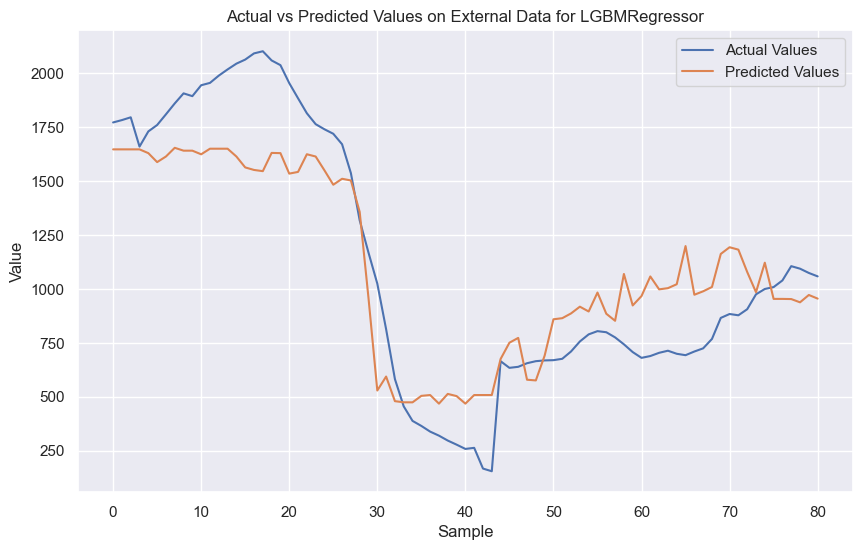

Model: LGBMRegressor
Train RMSE: 51.68605469307331 Train R2: 0.9923951993319274 Train MAE: 40.44616772340279
Test RMSE: 51.400285369723676 Test R2: 0.9907034256574607 Test MAE: 44.171864396293
External RMSE: 253.7160120127431 External R2: 0.8191831001837704 External MAE: 217.41871063569397
--------------------------------------------------
Original Dataset - RMSE: 51.62830509979849, R2: 0.9925128074566563, MAE: 41.20073920145651
External Dataset - RMSE: 253.7160120127431, R2: 0.8191831001837704, MAE: 217.41871063569397


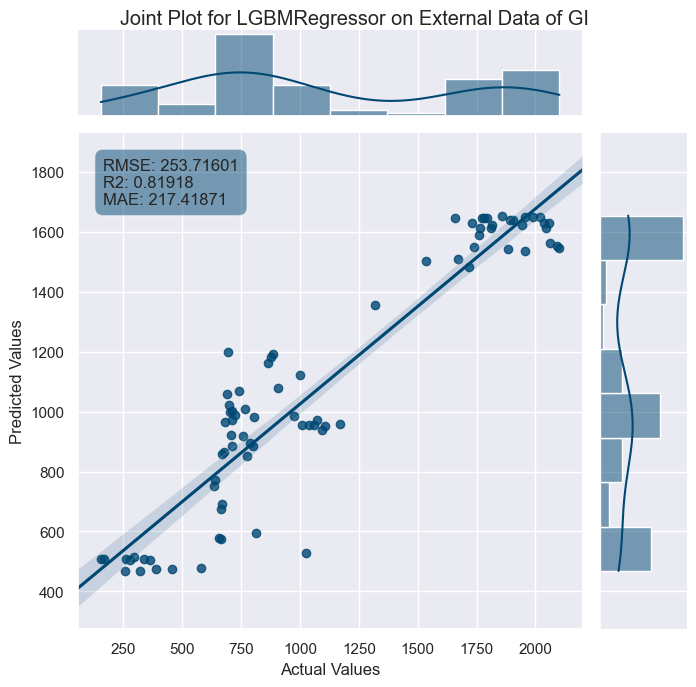

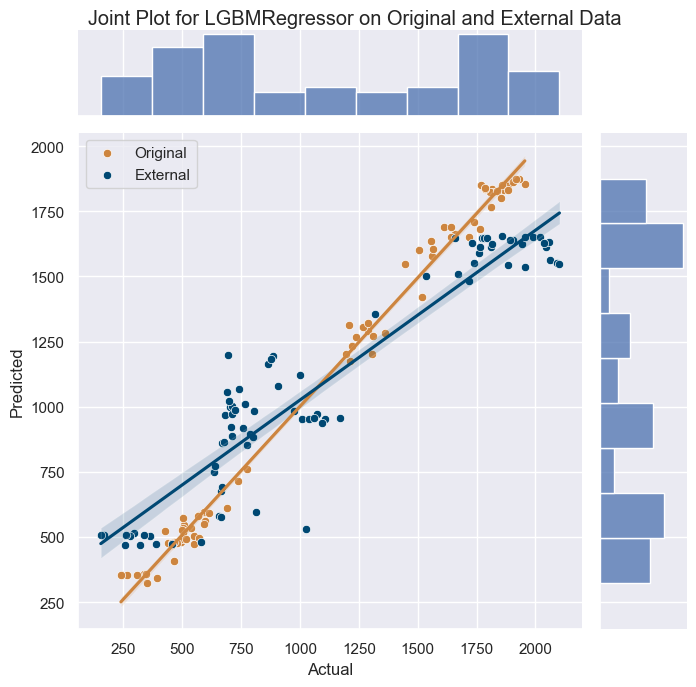

In [5]:
import pandas as pd
import numpy as np
import seaborn as sns
from sklearn.neighbors import KNeighborsRegressor
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from sklearn.preprocessing import StandardScaler
from skopt import BayesSearchCV
from skopt.space import Integer
import matplotlib.pyplot as plt
# Load datasets
data = pd.read_csv("C:\\Users\\Lenovo\\Desktop\\元学习\\BT(2)5-1.csv")
external_data = pd.read_csv("C:\\Users\\Lenovo\\Desktop\\元学习\\BT(2)5-2.csv")

# Normalization function
def normalize_data(data):
    scaler = StandardScaler()
    return scaler.fit_transform(data), scaler

# Normalize datasets
data_normalized, scaler = normalize_data(data)
external_data_normalized, _ = normalize_data(external_data)

# Split the dataset into features and target
X = data_normalized[:, :-1]
y = data_normalized[:, -1]
X_external = external_data_normalized[:, :-1]
y_external = external_data_normalized[:, -1]

# Fit a scaler for the features
feature_scaler = StandardScaler()
X_normalized = feature_scaler.fit_transform(data.drop('Biogas Production', axis=1))

# Fit a separate scaler for the target
target_scaler = StandardScaler()
y_normalized = target_scaler.fit_transform(data[['Biogas Production']])


# Split into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

# Define the hyperparameter space
param_grid = {'n_neighbors': Integer(1, 30)}

# Bayesian optimization
knn_search = BayesSearchCV(KNeighborsRegressor(), param_grid, n_iter=32, cv=5, n_jobs=-1, random_state=0)
knn_search.fit(X_train, y_train)

# Best model
knn_best = knn_search.best_estimator_

# Function to evaluate the model
def evaluate_model(model, X_train, y_train, X_test, y_test, X_external, y_external, target_scaler):
    y_pred_train = model.predict(X_train)
    y_pred_test = model.predict(X_test)
    y_pred_external = model.predict(X_external)

    # Denormalize target values and predictions
    y_train_denorm = target_scaler.inverse_transform(y_train.reshape(-1, 1)).flatten()
    y_test_denorm = target_scaler.inverse_transform(y_test.reshape(-1, 1)).flatten()
    y_external_denorm = target_scaler.inverse_transform(y_external.reshape(-1, 1)).flatten()
    y_pred_train_denorm = target_scaler.inverse_transform(y_pred_train.reshape(-1, 1)).flatten()
    y_pred_test_denorm = target_scaler.inverse_transform(y_pred_test.reshape(-1, 1)).flatten()
    y_pred_external_denorm = target_scaler.inverse_transform(y_pred_external.reshape(-1, 1)).flatten()

    # Visualization of predictions on external data
    plt.figure(figsize=(10, 6))
    plt.plot(y_external_denorm, label='Actual Values')
    plt.plot(y_pred_external_denorm, label='Predicted Values')
    plt.xlabel('Sample')
    plt.ylabel('Value')
    plt.title(f'Actual vs Predicted Values on External Data for {model.__class__.__name__}')
    plt.legend()
    plt.show()

    # Metrics for train and test sets
    train_rmse = mean_squared_error(y_train_denorm, y_pred_train_denorm, squared=False)
    test_rmse = mean_squared_error(y_test_denorm, y_pred_test_denorm, squared=False)
    train_r2 = r2_score(y_train_denorm, y_pred_train_denorm)
    test_r2 = r2_score(y_test_denorm, y_pred_test_denorm)
    train_mae = mean_absolute_error(y_train_denorm, y_pred_train_denorm)
    test_mae = mean_absolute_error(y_test_denorm, y_pred_test_denorm)

    # Metrics for external set
    external_rmse = mean_squared_error(y_external_denorm, y_pred_external_denorm, squared=False)
    external_r2 = r2_score(y_external_denorm, y_pred_external_denorm)
    external_mae = mean_absolute_error(y_external_denorm, y_pred_external_denorm)

    # Text for metrics
    metrics_text = f"RMSE: {external_rmse:.5f}\nR2: {external_r2:.5f}\nMAE: {external_mae:.5f}"

    # Create DataFrame for seaborn joint plot
    external_pred_df = pd.DataFrame({
        'Actual Values': y_external_denorm, 
        'Predicted Values': y_pred_external_denorm
    })

    # Set seaborn theme
    sns.set_theme(style="darkgrid")

    # Create the jointplot for external data with specified color
    g_external = sns.jointplot(x='Actual Values', y='Predicted Values', data=external_pred_df,
                               kind="reg", truncate=False,
                               color="#004873", height=7) 
    
    # Set title for the plot
    g_external.fig.suptitle(f"Joint Plot for {model.__class__.__name__} on External Data of GI")

    # Add metrics as text annotations
    plt.annotate(metrics_text, xy=(0.05, 0.95), xycoords='axes fraction', 
                 ha='left', va='top', bbox=dict(boxstyle='round,pad=0.5', fc="#004873", alpha=0.5))

    # Adjust layout
    g_external.fig.subplots_adjust(top=0.95)

    # Print metrics
    print(f"Model: {model.__class__.__name__}")
    print("Train RMSE:", train_rmse, "Train R2:", train_r2, "Train MAE:", train_mae)
    print("Test RMSE:", test_rmse, "Test R2:", test_r2, "Test MAE:", test_mae)
    print("External RMSE:", external_rmse, "External R2:", external_r2, "External MAE:", external_mae)
    print("--------------------------------------------------")

    # 评估模型并获取训练集和测试集的预测值
    y_pred_train_denorm = target_scaler.inverse_transform(model.predict(X_train).reshape(-1, 1)).flatten()
    y_pred_test_denorm = target_scaler.inverse_transform(model.predict(X_test).reshape(-1, 1)).flatten()

    # 合并训练集和测试集的数据
    original_data_actual = np.concatenate([y_train_denorm, y_test_denorm])
    original_data_predicted = np.concatenate([y_pred_train_denorm, y_pred_test_denorm])

    # 创建包含原始数据集和外部数据集的 DataFrame
    combined_df = pd.DataFrame({
        'Actual': np.concatenate([original_data_actual, y_external_denorm]),
        'Predicted': np.concatenate([original_data_predicted, y_pred_external_denorm]),
        'Dataset': ['Original'] * len(original_data_actual) + ['External'] * len(y_external_denorm)
    })

    # 创建基础 jointplot
    g_combined = sns.jointplot(x='Actual', y='Predicted', data=combined_df, kind="scatter", height=7)

    # 定义两个数据集的颜色
    colors = ['#CD853F', '#004873']

    # 为两个数据集添加不同颜色的散点图和线性回归线
    for dataset, color in zip(['Original', 'External'], colors):
        subset = combined_df[combined_df['Dataset'] == dataset]
        sns.scatterplot(x=subset['Actual'], y=subset['Predicted'], color=color, ax=g_combined.ax_joint, label=dataset)
        sns.regplot(x=subset['Actual'], y=subset['Predicted'], scatter=False, color=color, ax=g_combined.ax_joint)

    # 设置标题和布局
    g_combined.fig.suptitle(f"Joint Plot for {model.__class__.__name__} on Original and External Data")
    g_combined.fig.subplots_adjust(top=0.95)
    # 计算原始数据集的指标
    train_rmse = mean_squared_error(original_data_actual, original_data_predicted, squared=False)
    train_r2 = r2_score(original_data_actual, original_data_predicted)
    train_mae = mean_absolute_error(original_data_actual, original_data_predicted)

    # 计算外部数据集的指标
    external_rmse = mean_squared_error(y_external_denorm, y_pred_external_denorm, squared=False)
    external_r2 = r2_score(y_external_denorm, y_pred_external_denorm)
    external_mae = mean_absolute_error(y_external_denorm, y_pred_external_denorm)


    print(f"Original Dataset - RMSE: {train_rmse}, R2: {train_r2}, MAE: {train_mae}")
    print(f"External Dataset - RMSE: {external_rmse}, R2: {external_r2}, MAE: {external_mae}")

# Evaluate KNN model
evaluate_model(knn_best, X_train, y_train, X_test, y_test, X_external, y_external, target_scaler)

from sklearn.svm import SVR
from skopt.space import Real

# Define the hyperparameter space for SVM
param_grid_svm = {
    'C': Real(1e-15, 1e+1, prior='log-uniform'),
    'gamma': Real(1e-15, 1e+1, prior='log-uniform'),
    'epsilon': Real(1e-15, 1e+1, prior='log-uniform')
}


# Bayesian optimization
svm_search = BayesSearchCV(SVR(), param_grid_svm, n_iter=32, cv=5, n_jobs=-1, random_state=0)
svm_search.fit(X_train, y_train)

# Best model
svm_best = svm_search.best_estimator_

# Evaluate SVM model
evaluate_model(svm_best, X_train, y_train, X_test, y_test, X_external, y_external, target_scaler)

from sklearn.ensemble import RandomForestRegressor
from skopt.space import Integer, Real

# Define the hyperparameter space for Random Forest
param_grid_rf = {
    'n_estimators': Integer(100, 300),
    'max_depth': Integer(10, 50),
    'min_samples_split': Real(0.1, 1.0),
    'min_samples_leaf': Real(0.1, 0.5)
}

# Bayesian optimization
rf_search = BayesSearchCV(RandomForestRegressor(random_state=0), param_grid_rf, n_iter=32, cv=5, n_jobs=-1, random_state=0)
rf_search.fit(X_train, y_train)

# Best model
rf_best = rf_search.best_estimator_

# Evaluate Random Forest model
evaluate_model(rf_best, X_train, y_train, X_test, y_test, X_external, y_external, target_scaler)


import xgboost as xgb

# Define the hyperparameter space for XGBoost
param_grid_xgb = {
    'n_estimators': Integer(10, 300),
    'max_depth': Integer(1, 50),
    'learning_rate': Real(0.01, 1.0, 'log-uniform'),
    'subsample': Real(0.1, 1.0),
    'colsample_bytree': Real(0.1, 1.0)
}

# Bayesian optimization
xgb_search = BayesSearchCV(xgb.XGBRegressor(), param_grid_xgb, n_iter=32, cv=5, n_jobs=-1, random_state=0)
xgb_search.fit(X_train, y_train)

# Best model
xgb_best = xgb_search.best_estimator_

# Evaluate XGBoost model
evaluate_model(xgb_best, X_train, y_train, X_test, y_test, X_external, y_external, target_scaler)


import lightgbm as lgb

# Define the hyperparameter space for LightGBM
param_grid_lgb = {
    'n_estimators': Integer(10, 300),
    'max_depth': Integer(-1, 50),
    'learning_rate': Real(0.01, 1.0, 'log-uniform'),
    'num_leaves': Integer(20, 300),
    'subsample': Real(0.1, 1.0),
    'colsample_bytree': Real(0.1, 1.0)
}

# Bayesian optimization
lgb_search = BayesSearchCV(lgb.LGBMRegressor(), param_grid_lgb, n_iter=32, cv=5, n_jobs=-1, random_state=0)
lgb_search.fit(X_train, y_train)

# Best model
lgb_best = lgb_search.best_estimator_

# Evaluate LightGBM model
evaluate_model(lgb_best, X_train, y_train, X_test, y_test, X_external, y_external, target_scaler)

In [6]:
# 创建包含模型名称和其最优超参数的字典
model_hyperparams = {
    'KNN': knn_search.best_params_,
    'SVM': svm_search.best_params_,
    'RandomForest': rf_search.best_params_,
    'XGBoost': xgb_search.best_params_,
    'LightGBM': lgb_search.best_params_
}

# 转换为DataFrame
hyperparams_df = pd.DataFrame.from_dict(model_hyperparams, orient='index')

# 重置索引，使模型名称成为一列
hyperparams_df.reset_index(inplace=True)
hyperparams_df.rename(columns={'index': 'Model'}, inplace=True)

# 指定文件路径和名称，这里替换为你的目标路径
file_path = "C:\\Users\\Lenovo\\Desktop\\元学习\\传统模型超参数\\hyperparams_BT_2_5.csv"

# 保存为CSV文件
hyperparams_df.to_csv(file_path, index=False)

e:\anaconda\envs\yuanxuexi2\lib\site-packages\skopt\optimizer\optimizer.py:449: UserWarning: The objective has been evaluated at this point before.
  warnings.warn("The objective has been evaluated "
e:\anaconda\envs\yuanxuexi2\lib\site-packages\skopt\optimizer\optimizer.py:449: UserWarning: The objective has been evaluated at this point before.
  warnings.warn("The objective has been evaluated "
e:\anaconda\envs\yuanxuexi2\lib\site-packages\skopt\optimizer\optimizer.py:449: UserWarning: The objective has been evaluated at this point before.
  warnings.warn("The objective has been evaluated "
e:\anaconda\envs\yuanxuexi2\lib\site-packages\skopt\optimizer\optimizer.py:449: UserWarning: The objective has been evaluated at this point before.
  warnings.warn("The objective has been evaluated "
e:\anaconda\envs\yuanxuexi2\lib\site-packages\skopt\optimizer\optimizer.py:449: UserWarning: The objective has been evaluated at this point before.
  warnings.warn("The objective has been evaluated "


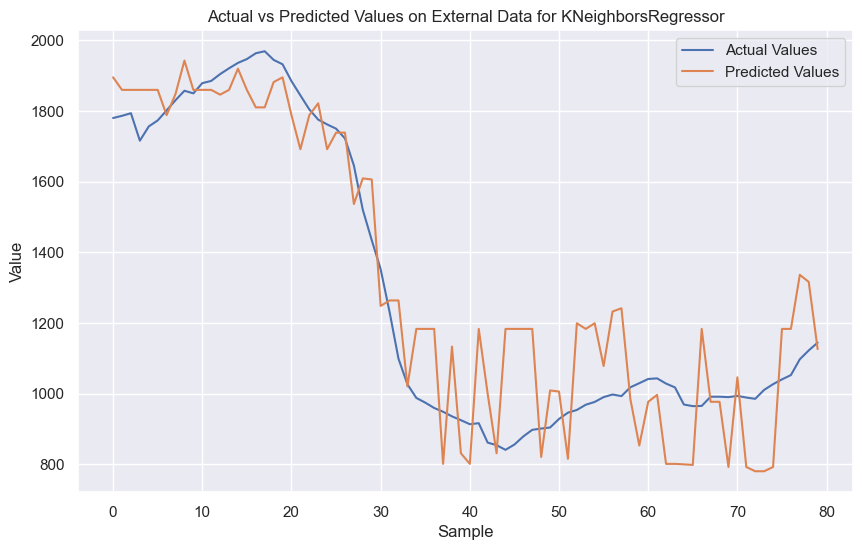

Model: KNeighborsRegressor
Train RMSE: 40.5862592443936 Train R2: 0.9901444778610262 Train MAE: 23.612578124999995
Test RMSE: 59.09207875743586 Test R2: 0.9720260649882335 Test MAE: 41.298125
External RMSE: 153.9991318253787 External R2: 0.8596389173943066 External MAE: 127.28736353077647
--------------------------------------------------
Original Dataset - RMSE: 44.9017851085845, R2: 0.9880673369194846, MAE: 27.14968749999999
External Dataset - RMSE: 153.9991318253787, R2: 0.8596389173943066, MAE: 127.28736353077647


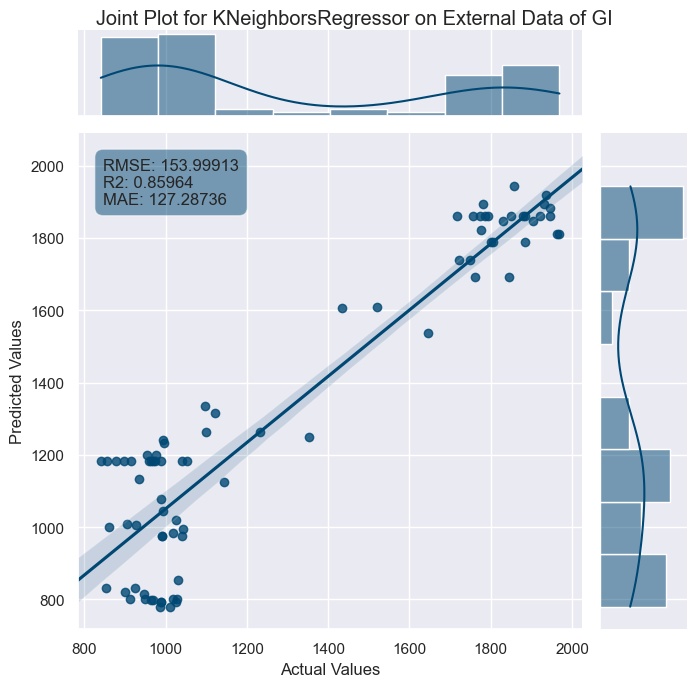

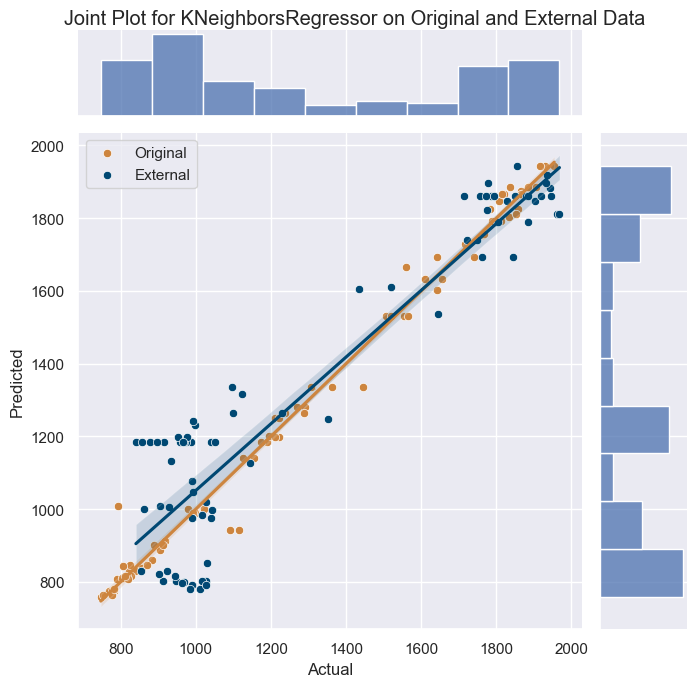

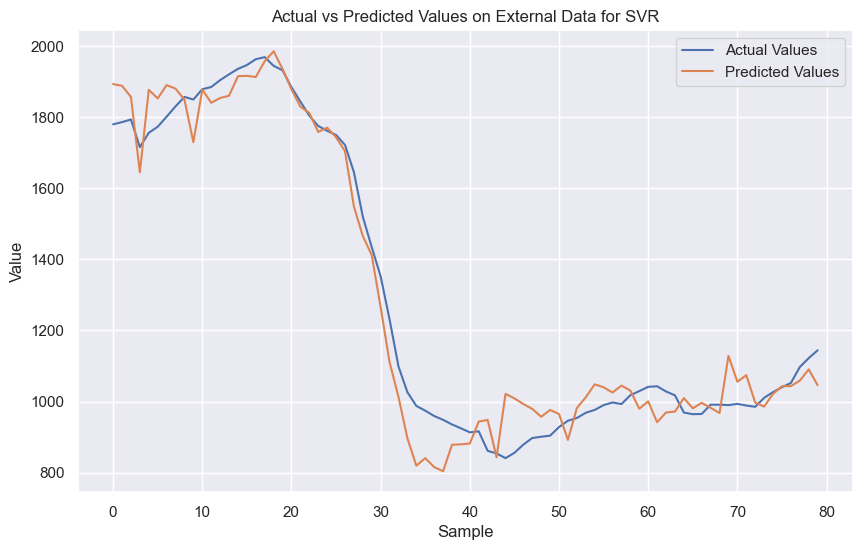

Model: SVR
Train RMSE: 25.33057531204762 Train R2: 0.9961610567244619 Train MAE: 14.531813567919299
Test RMSE: 47.70503081002563 Test R2: 0.9817684586413727 Test MAE: 39.259295904346175
External RMSE: 72.77820206316304 External R2: 0.9686517855452914 External MAE: 57.67237953299226
--------------------------------------------------
Original Dataset - RMSE: 31.120161140787047, R2: 0.9942681629087574, MAE: 19.477310035204674
External Dataset - RMSE: 72.77820206316304, R2: 0.9686517855452914, MAE: 57.67237953299226


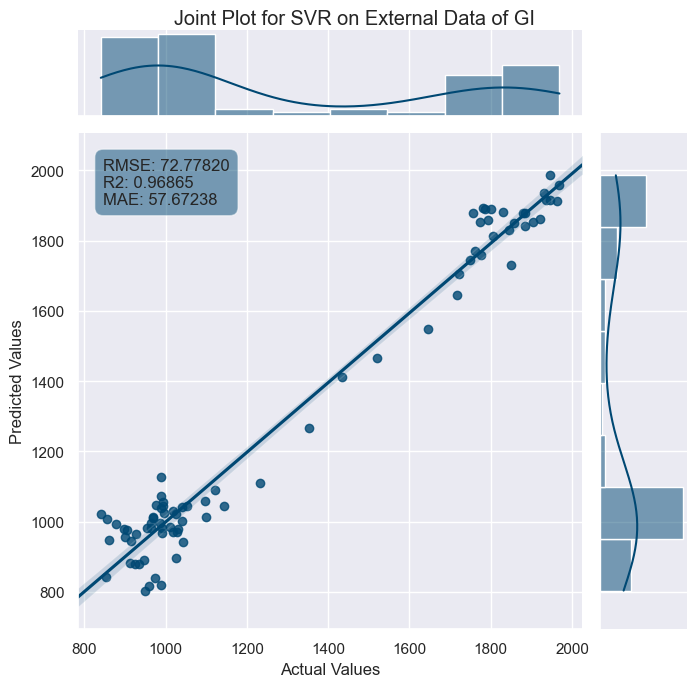

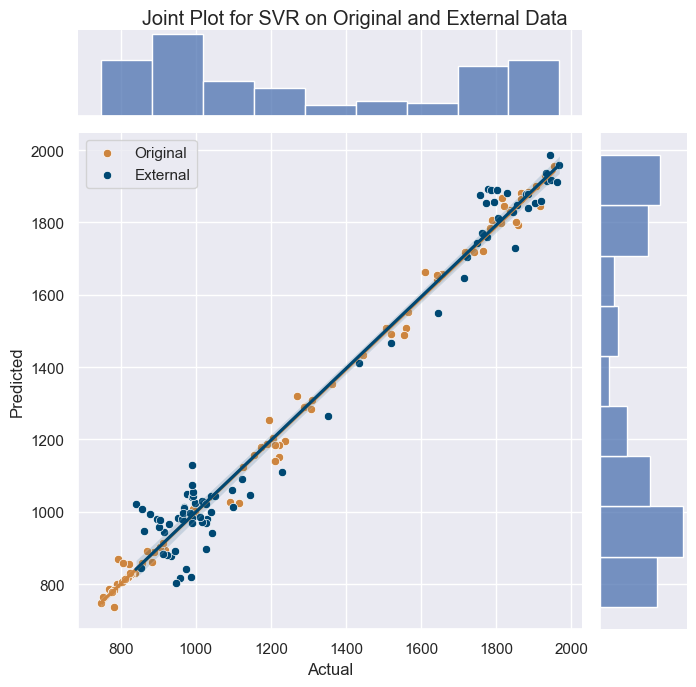

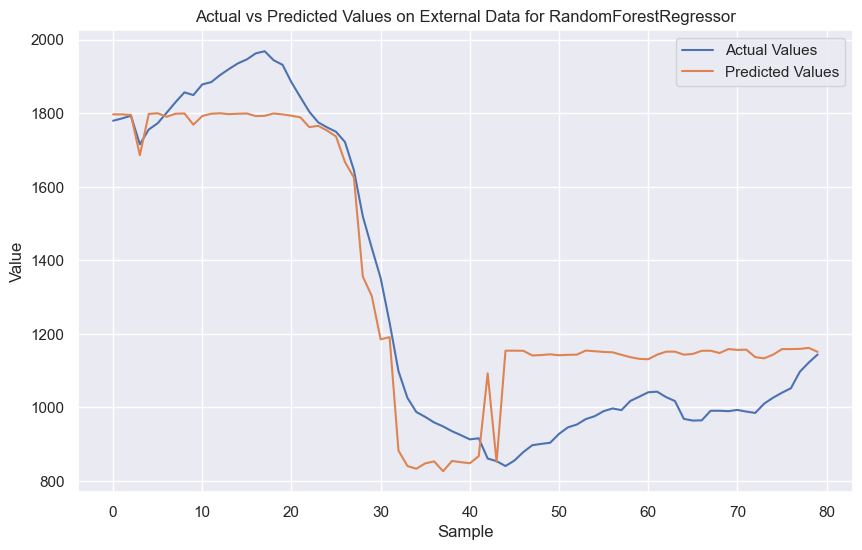

Model: RandomForestRegressor
Train RMSE: 55.499016296743804 Train R2: 0.9815714078517299 Train MAE: 39.00957329390313
Test RMSE: 57.2317413446308 Test R2: 0.9737596909491149 Test MAE: 47.65008601574265
External RMSE: 141.21905700272376 External R2: 0.8819688119477544 External MAE: 120.37870585476226
--------------------------------------------------
Original Dataset - RMSE: 55.84986205347989, R2: 0.9815390360673739, MAE: 40.73767583827104
External Dataset - RMSE: 141.21905700272376, R2: 0.8819688119477544, MAE: 120.37870585476226


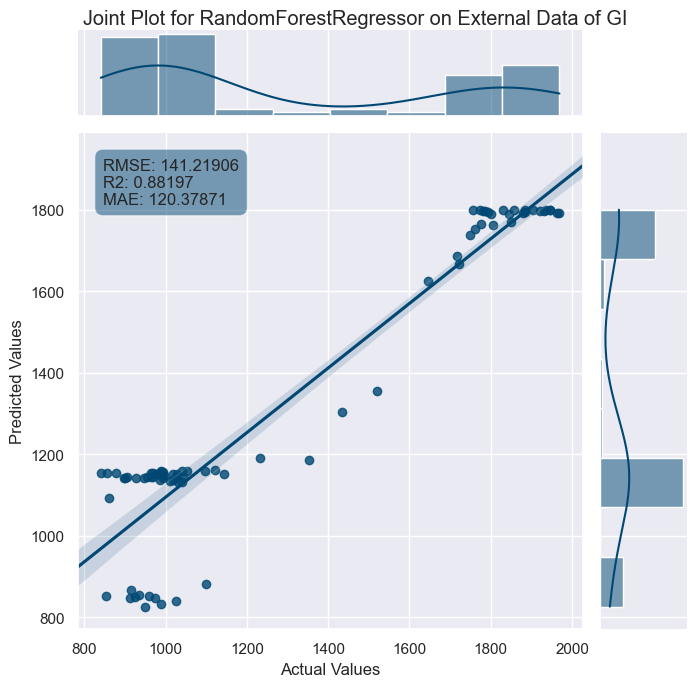

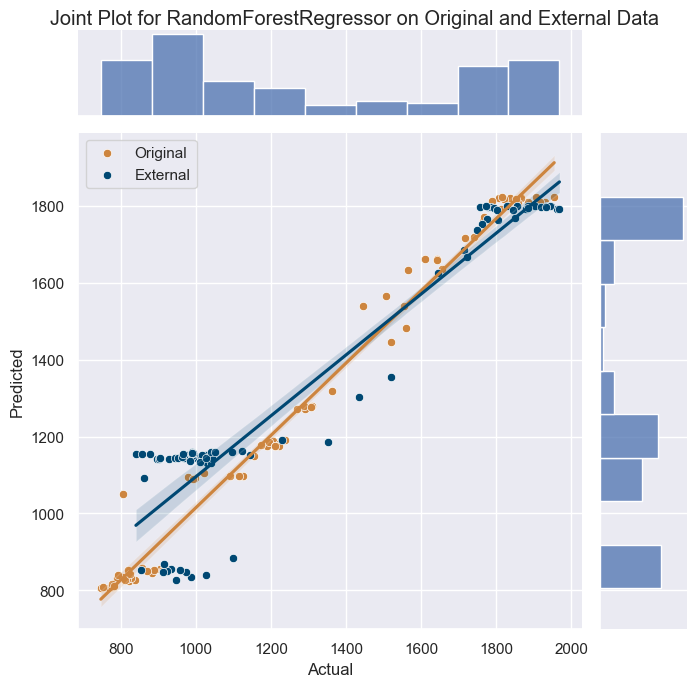

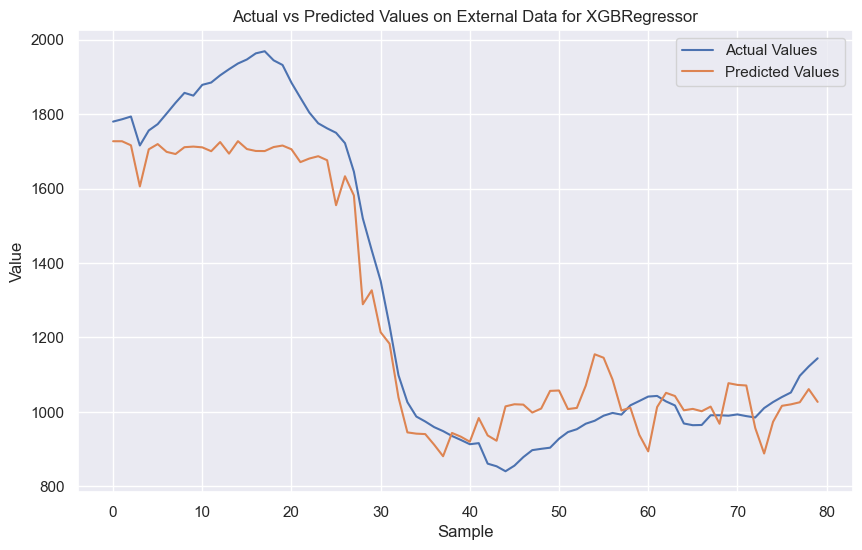

Model: XGBRegressor
Train RMSE: 5.6108385858453556 Train R2: 0.9998116450068012 Train MAE: 3.3194222640991136
Test RMSE: 38.92550277510097 Test R2: 0.9878615429160463 Test MAE: 31.690694732666017
External RMSE: 121.13345970564008 External R2: 0.9131562822978418 External MAE: 100.93450645200348
--------------------------------------------------
Original Dataset - RMSE: 18.116957828730726, R2: 0.9980574119576199, MAE: 8.993676757812494
External Dataset - RMSE: 121.13345970564008, R2: 0.9131562822978418, MAE: 100.93450645200348
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000038 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 251
[LightGBM] [Info] Number of data points in the train set: 64, number of used features: 14
[LightGBM] [Info] Start training from score -0.123365
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive ga

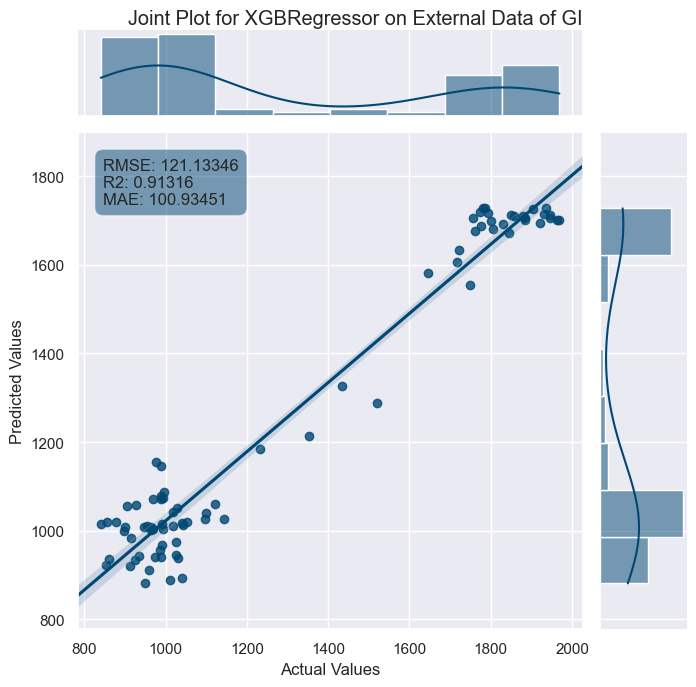

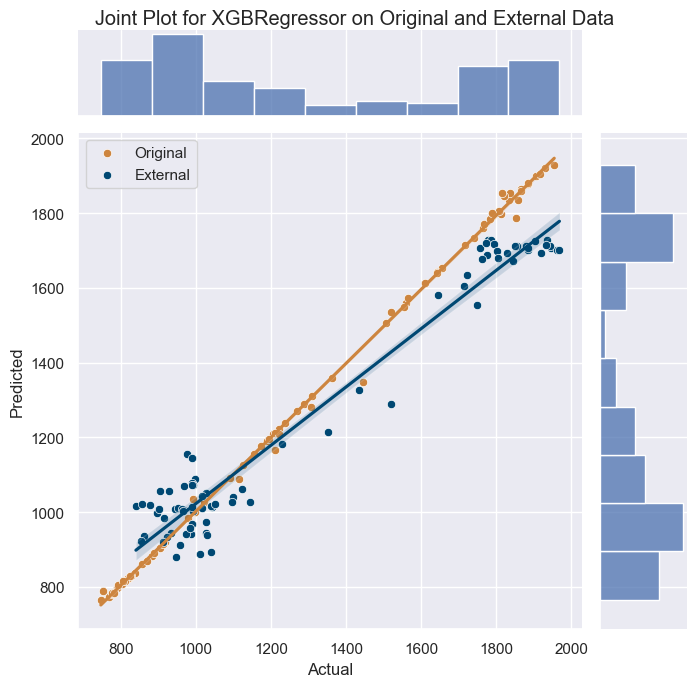

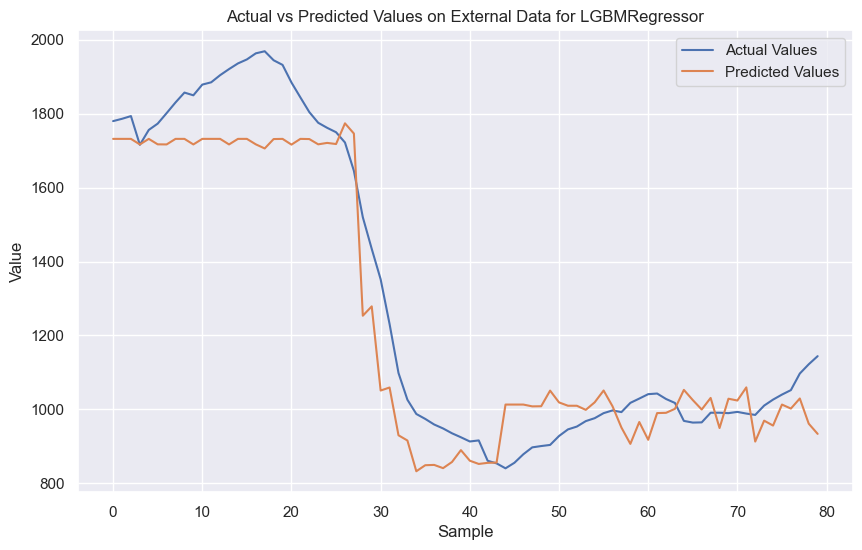

Model: LGBMRegressor
Train RMSE: 33.27613445040652 Train R2: 0.9933749779447812 Train MAE: 25.22931412805069
Test RMSE: 72.05484328333519 Test R2: 0.9584068912564021 Test MAE: 59.63619575107897
External RMSE: 120.97337359970435 External R2: 0.9133856703809383 External MAE: 99.74832795986384
--------------------------------------------------
Original Dataset - RMSE: 43.86594336482945, R2: 0.9886115370977707, MAE: 32.11069045265634
External Dataset - RMSE: 120.97337359970435, R2: 0.9133856703809383, MAE: 99.74832795986384


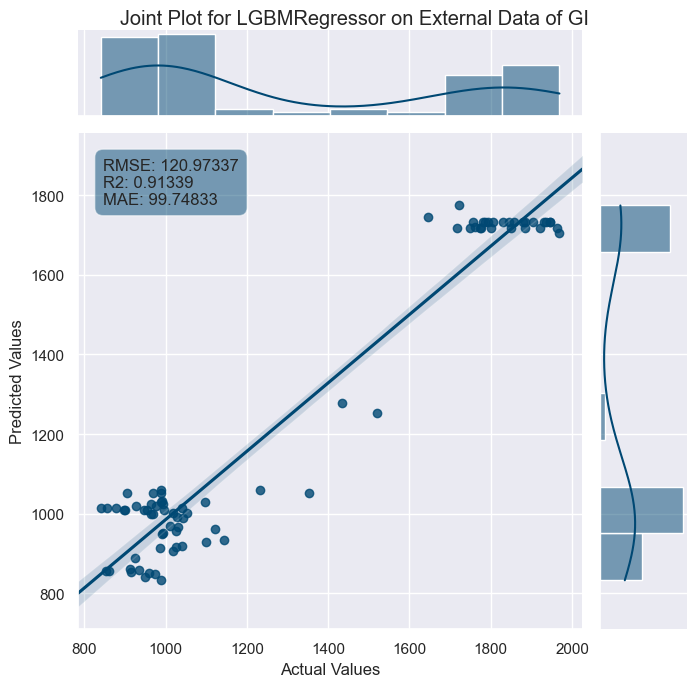

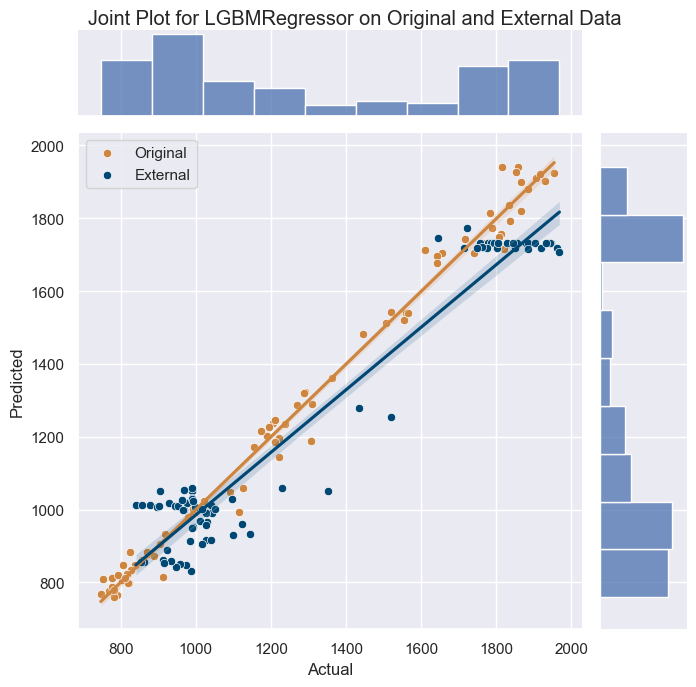

In [7]:
import pandas as pd
import numpy as np
import seaborn as sns
from sklearn.neighbors import KNeighborsRegressor
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from sklearn.preprocessing import StandardScaler
from skopt import BayesSearchCV
from skopt.space import Integer
import matplotlib.pyplot as plt
# Load datasets
data = pd.read_csv("C:\\Users\\Lenovo\\Desktop\\元学习\\BT(2)6-1.csv")
external_data = pd.read_csv("C:\\Users\\Lenovo\\Desktop\\元学习\\BT(2)6-2.csv")

# Normalization function
def normalize_data(data):
    scaler = StandardScaler()
    return scaler.fit_transform(data), scaler

# Normalize datasets
data_normalized, scaler = normalize_data(data)
external_data_normalized, _ = normalize_data(external_data)

# Split the dataset into features and target
X = data_normalized[:, :-1]
y = data_normalized[:, -1]
X_external = external_data_normalized[:, :-1]
y_external = external_data_normalized[:, -1]

# Fit a scaler for the features
feature_scaler = StandardScaler()
X_normalized = feature_scaler.fit_transform(data.drop('Biogas Production', axis=1))

# Fit a separate scaler for the target
target_scaler = StandardScaler()
y_normalized = target_scaler.fit_transform(data[['Biogas Production']])


# Split into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

# Define the hyperparameter space
param_grid = {'n_neighbors': Integer(1, 30)}

# Bayesian optimization
knn_search = BayesSearchCV(KNeighborsRegressor(), param_grid, n_iter=32, cv=5, n_jobs=-1, random_state=0)
knn_search.fit(X_train, y_train)

# Best model
knn_best = knn_search.best_estimator_

# Function to evaluate the model
def evaluate_model(model, X_train, y_train, X_test, y_test, X_external, y_external, target_scaler):
    y_pred_train = model.predict(X_train)
    y_pred_test = model.predict(X_test)
    y_pred_external = model.predict(X_external)

    # Denormalize target values and predictions
    y_train_denorm = target_scaler.inverse_transform(y_train.reshape(-1, 1)).flatten()
    y_test_denorm = target_scaler.inverse_transform(y_test.reshape(-1, 1)).flatten()
    y_external_denorm = target_scaler.inverse_transform(y_external.reshape(-1, 1)).flatten()
    y_pred_train_denorm = target_scaler.inverse_transform(y_pred_train.reshape(-1, 1)).flatten()
    y_pred_test_denorm = target_scaler.inverse_transform(y_pred_test.reshape(-1, 1)).flatten()
    y_pred_external_denorm = target_scaler.inverse_transform(y_pred_external.reshape(-1, 1)).flatten()

    # Visualization of predictions on external data
    plt.figure(figsize=(10, 6))
    plt.plot(y_external_denorm, label='Actual Values')
    plt.plot(y_pred_external_denorm, label='Predicted Values')
    plt.xlabel('Sample')
    plt.ylabel('Value')
    plt.title(f'Actual vs Predicted Values on External Data for {model.__class__.__name__}')
    plt.legend()
    plt.show()

    # Metrics for train and test sets
    train_rmse = mean_squared_error(y_train_denorm, y_pred_train_denorm, squared=False)
    test_rmse = mean_squared_error(y_test_denorm, y_pred_test_denorm, squared=False)
    train_r2 = r2_score(y_train_denorm, y_pred_train_denorm)
    test_r2 = r2_score(y_test_denorm, y_pred_test_denorm)
    train_mae = mean_absolute_error(y_train_denorm, y_pred_train_denorm)
    test_mae = mean_absolute_error(y_test_denorm, y_pred_test_denorm)

    # Metrics for external set
    external_rmse = mean_squared_error(y_external_denorm, y_pred_external_denorm, squared=False)
    external_r2 = r2_score(y_external_denorm, y_pred_external_denorm)
    external_mae = mean_absolute_error(y_external_denorm, y_pred_external_denorm)

    # Text for metrics
    metrics_text = f"RMSE: {external_rmse:.5f}\nR2: {external_r2:.5f}\nMAE: {external_mae:.5f}"

    # Create DataFrame for seaborn joint plot
    external_pred_df = pd.DataFrame({
        'Actual Values': y_external_denorm, 
        'Predicted Values': y_pred_external_denorm
    })

    # Set seaborn theme
    sns.set_theme(style="darkgrid")

    # Create the jointplot for external data with specified color
    g_external = sns.jointplot(x='Actual Values', y='Predicted Values', data=external_pred_df,
                               kind="reg", truncate=False,
                               color="#004873", height=7) 
    
    # Set title for the plot
    g_external.fig.suptitle(f"Joint Plot for {model.__class__.__name__} on External Data of GI")

    # Add metrics as text annotations
    plt.annotate(metrics_text, xy=(0.05, 0.95), xycoords='axes fraction', 
                 ha='left', va='top', bbox=dict(boxstyle='round,pad=0.5', fc="#004873", alpha=0.5))

    # Adjust layout
    g_external.fig.subplots_adjust(top=0.95)

    # Print metrics
    print(f"Model: {model.__class__.__name__}")
    print("Train RMSE:", train_rmse, "Train R2:", train_r2, "Train MAE:", train_mae)
    print("Test RMSE:", test_rmse, "Test R2:", test_r2, "Test MAE:", test_mae)
    print("External RMSE:", external_rmse, "External R2:", external_r2, "External MAE:", external_mae)
    print("--------------------------------------------------")

    # 评估模型并获取训练集和测试集的预测值
    y_pred_train_denorm = target_scaler.inverse_transform(model.predict(X_train).reshape(-1, 1)).flatten()
    y_pred_test_denorm = target_scaler.inverse_transform(model.predict(X_test).reshape(-1, 1)).flatten()

    # 合并训练集和测试集的数据
    original_data_actual = np.concatenate([y_train_denorm, y_test_denorm])
    original_data_predicted = np.concatenate([y_pred_train_denorm, y_pred_test_denorm])

    # 创建包含原始数据集和外部数据集的 DataFrame
    combined_df = pd.DataFrame({
        'Actual': np.concatenate([original_data_actual, y_external_denorm]),
        'Predicted': np.concatenate([original_data_predicted, y_pred_external_denorm]),
        'Dataset': ['Original'] * len(original_data_actual) + ['External'] * len(y_external_denorm)
    })

    # 创建基础 jointplot
    g_combined = sns.jointplot(x='Actual', y='Predicted', data=combined_df, kind="scatter", height=7)

    # 定义两个数据集的颜色
    colors = ['#CD853F', '#004873']

    # 为两个数据集添加不同颜色的散点图和线性回归线
    for dataset, color in zip(['Original', 'External'], colors):
        subset = combined_df[combined_df['Dataset'] == dataset]
        sns.scatterplot(x=subset['Actual'], y=subset['Predicted'], color=color, ax=g_combined.ax_joint, label=dataset)
        sns.regplot(x=subset['Actual'], y=subset['Predicted'], scatter=False, color=color, ax=g_combined.ax_joint)

    # 设置标题和布局
    g_combined.fig.suptitle(f"Joint Plot for {model.__class__.__name__} on Original and External Data")
    g_combined.fig.subplots_adjust(top=0.95)
    # 计算原始数据集的指标
    train_rmse = mean_squared_error(original_data_actual, original_data_predicted, squared=False)
    train_r2 = r2_score(original_data_actual, original_data_predicted)
    train_mae = mean_absolute_error(original_data_actual, original_data_predicted)

    # 计算外部数据集的指标
    external_rmse = mean_squared_error(y_external_denorm, y_pred_external_denorm, squared=False)
    external_r2 = r2_score(y_external_denorm, y_pred_external_denorm)
    external_mae = mean_absolute_error(y_external_denorm, y_pred_external_denorm)

    print(f"Original Dataset - RMSE: {train_rmse}, R2: {train_r2}, MAE: {train_mae}")
    print(f"External Dataset - RMSE: {external_rmse}, R2: {external_r2}, MAE: {external_mae}")

# Evaluate KNN model
evaluate_model(knn_best, X_train, y_train, X_test, y_test, X_external, y_external, target_scaler)

from sklearn.svm import SVR
from skopt.space import Real

# Define the hyperparameter space for SVM
param_grid_svm = {
    'C': Real(1e-15, 1e+1, prior='log-uniform'),
    'gamma': Real(1e-15, 1e+1, prior='log-uniform'),
    'epsilon': Real(1e-15, 1e+1, prior='log-uniform')
}

# Bayesian optimization
svm_search = BayesSearchCV(SVR(), param_grid_svm, n_iter=32, cv=5, n_jobs=-1, random_state=0)
svm_search.fit(X_train, y_train)

# Best model
svm_best = svm_search.best_estimator_

# Evaluate SVM model
evaluate_model(svm_best, X_train, y_train, X_test, y_test, X_external, y_external, target_scaler)

from sklearn.ensemble import RandomForestRegressor
from skopt.space import Integer, Real

# Define the hyperparameter space for Random Forest
param_grid_rf = {
    'n_estimators': Integer(100, 300),
    'max_depth': Integer(10, 50),
    'min_samples_split': Real(0.1, 1.0),
    'min_samples_leaf': Real(0.1, 0.5)
}

# Bayesian optimization
rf_search = BayesSearchCV(RandomForestRegressor(random_state=0), param_grid_rf, n_iter=32, cv=5, n_jobs=-1, random_state=0)
rf_search.fit(X_train, y_train)

# Best model
rf_best = rf_search.best_estimator_

# Evaluate Random Forest model
evaluate_model(rf_best, X_train, y_train, X_test, y_test, X_external, y_external, target_scaler)


import xgboost as xgb

# Define the hyperparameter space for XGBoost
param_grid_xgb = {
    'n_estimators': Integer(10, 300),
    'max_depth': Integer(1, 50),
    'learning_rate': Real(0.01, 1.0, 'log-uniform'),
    'subsample': Real(0.1, 1.0),
    'colsample_bytree': Real(0.1, 1.0)
}

# Bayesian optimization
xgb_search = BayesSearchCV(xgb.XGBRegressor(), param_grid_xgb, n_iter=32, cv=5, n_jobs=-1, random_state=0)
xgb_search.fit(X_train, y_train)

# Best model
xgb_best = xgb_search.best_estimator_

# Evaluate XGBoost model
evaluate_model(xgb_best, X_train, y_train, X_test, y_test, X_external, y_external, target_scaler)


import lightgbm as lgb

# Define the hyperparameter space for LightGBM
param_grid_lgb = {
    'n_estimators': Integer(10, 300),
    'max_depth': Integer(-1, 50),
    'learning_rate': Real(0.01, 1.0, 'log-uniform'),
    'num_leaves': Integer(20, 300),
    'subsample': Real(0.1, 1.0),
    'colsample_bytree': Real(0.1, 1.0)
}

# Bayesian optimization
lgb_search = BayesSearchCV(lgb.LGBMRegressor(), param_grid_lgb, n_iter=32, cv=5, n_jobs=-1, random_state=0)
lgb_search.fit(X_train, y_train)

# Best model
lgb_best = lgb_search.best_estimator_

# Evaluate LightGBM model
evaluate_model(lgb_best, X_train, y_train, X_test, y_test, X_external, y_external, target_scaler)

In [8]:
# 创建包含模型名称和其最优超参数的字典
model_hyperparams = {
    'KNN': knn_search.best_params_,
    'SVM': svm_search.best_params_,
    'RandomForest': rf_search.best_params_,
    'XGBoost': xgb_search.best_params_,
    'LightGBM': lgb_search.best_params_
}

# 转换为DataFrame
hyperparams_df = pd.DataFrame.from_dict(model_hyperparams, orient='index')

# 重置索引，使模型名称成为一列
hyperparams_df.reset_index(inplace=True)
hyperparams_df.rename(columns={'index': 'Model'}, inplace=True)

# 指定文件路径和名称，这里替换为你的目标路径
file_path = "C:\\Users\\Lenovo\\Desktop\\元学习\\传统模型超参数\\hyperparams_BT_2_6.csv"

# 保存为CSV文件
hyperparams_df.to_csv(file_path, index=False)

3.一部分样本用于训练

e:\anaconda\envs\yuanxuexi2\lib\site-packages\skopt\optimizer\optimizer.py:449: UserWarning: The objective has been evaluated at this point before.
  warnings.warn("The objective has been evaluated "
e:\anaconda\envs\yuanxuexi2\lib\site-packages\skopt\optimizer\optimizer.py:449: UserWarning: The objective has been evaluated at this point before.
  warnings.warn("The objective has been evaluated "
e:\anaconda\envs\yuanxuexi2\lib\site-packages\skopt\optimizer\optimizer.py:449: UserWarning: The objective has been evaluated at this point before.
  warnings.warn("The objective has been evaluated "
e:\anaconda\envs\yuanxuexi2\lib\site-packages\skopt\optimizer\optimizer.py:449: UserWarning: The objective has been evaluated at this point before.
  warnings.warn("The objective has been evaluated "
e:\anaconda\envs\yuanxuexi2\lib\site-packages\skopt\optimizer\optimizer.py:449: UserWarning: The objective has been evaluated at this point before.
  warnings.warn("The objective has been evaluated "


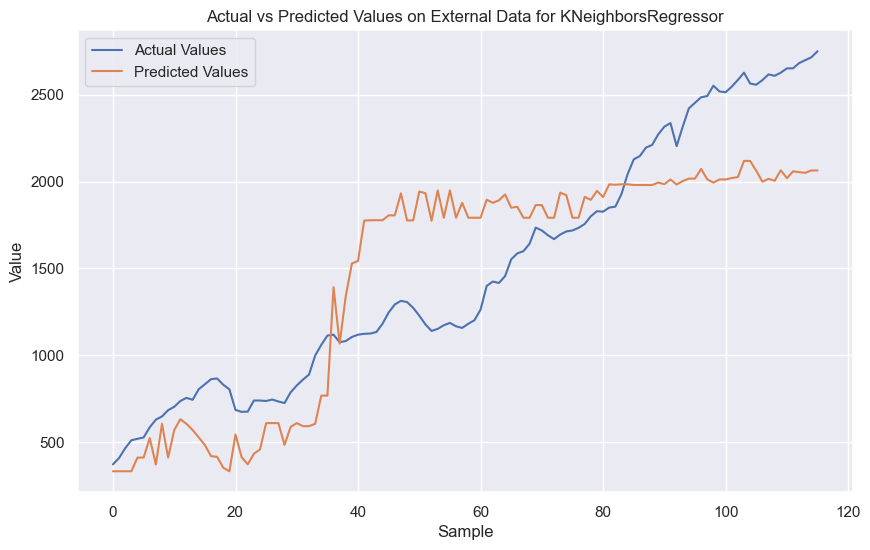

Model: KNeighborsRegressor
Train RMSE: 135.85802694619954 Train R2: 0.9648436949270448 Train MAE: 99.34685714285716
Test RMSE: 194.75734258016797 Test R2: 0.898440901542193 Test MAE: 141.08444444444442
External RMSE: 411.3411635295735 External R2: 0.6581493418135635 External MAE: 354.6064260597682
--------------------------------------------------
Original Dataset - RMSE: 149.80160549570527, R2: 0.9546617229604069, MAE: 107.8840909090909
External Dataset - RMSE: 411.3411635295735, R2: 0.6581493418135635, MAE: 354.6064260597682


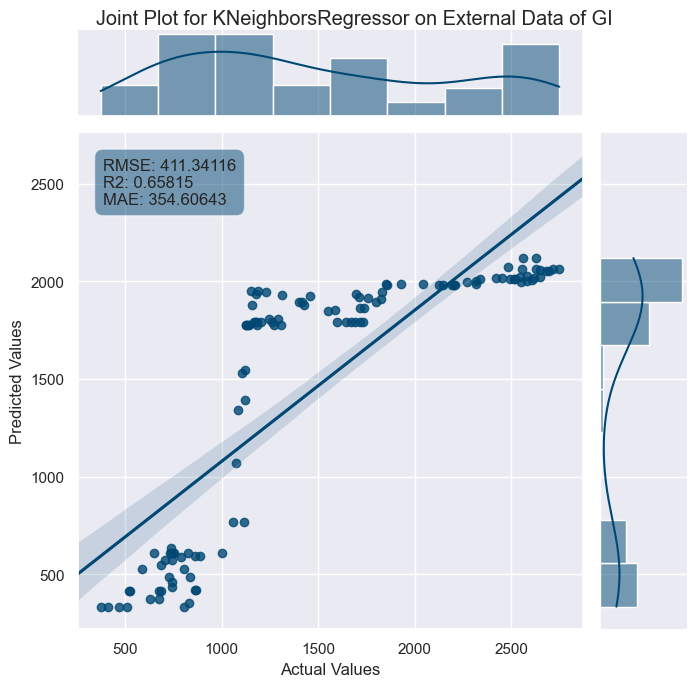

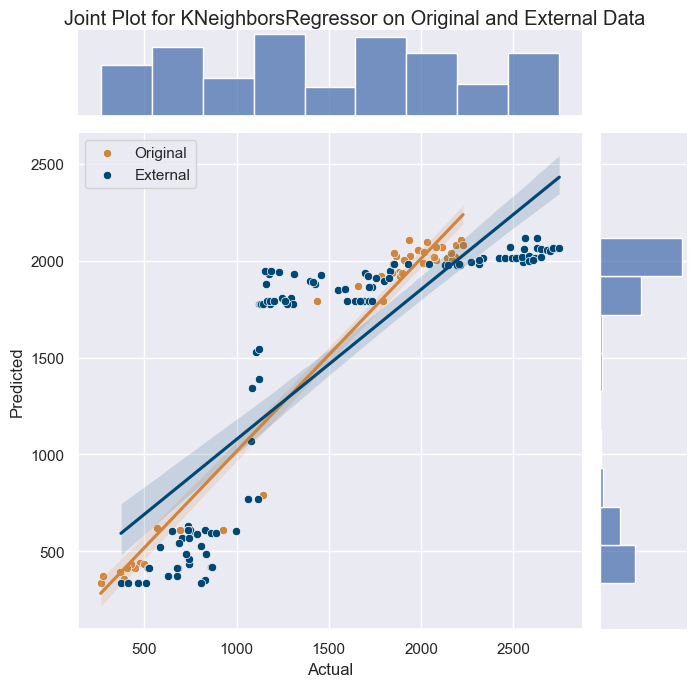

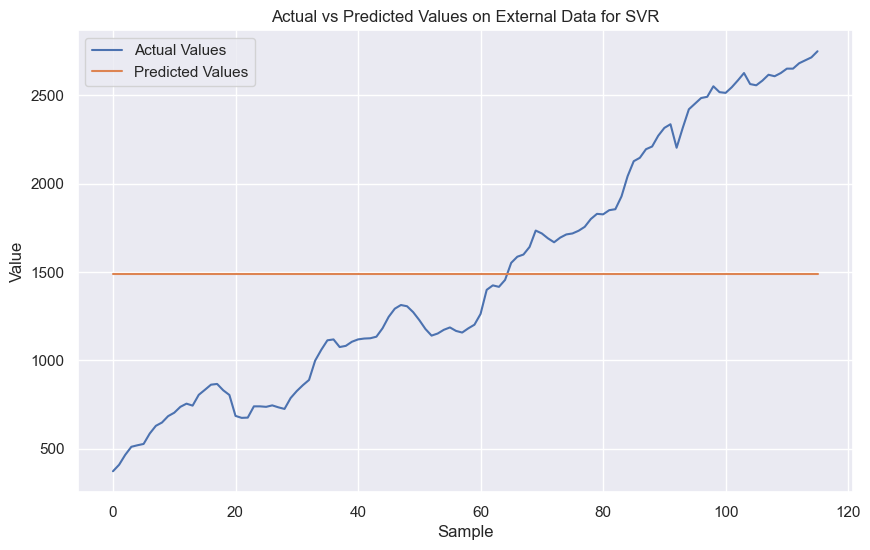

Model: SVR
Train RMSE: 724.9382820996053 Train R2: -0.001001404712779319 Train MAE: 668.2714562839635
Test RMSE: 613.4396334094614 Test R2: -0.00756905368058769 Test MAE: 510.95657545392635
External RMSE: 703.5707078960486 External R2: -0.0001095537238722244 External MAE: 614.2161158188858
--------------------------------------------------
Original Dataset - RMSE: 703.5707078960484, R2: -0.00010955372387200235, MAE: 636.0934124778195
External Dataset - RMSE: 703.5707078960486, R2: -0.0001095537238722244, MAE: 614.2161158188858


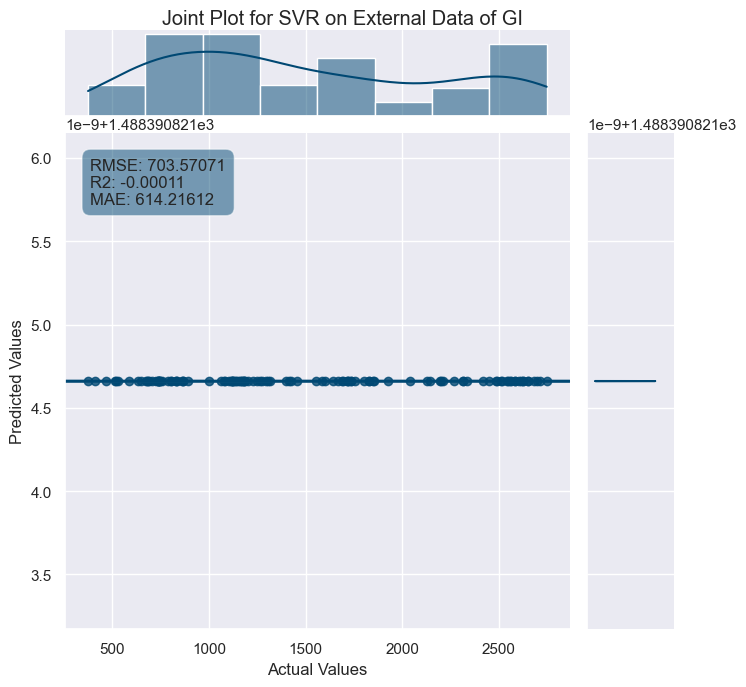

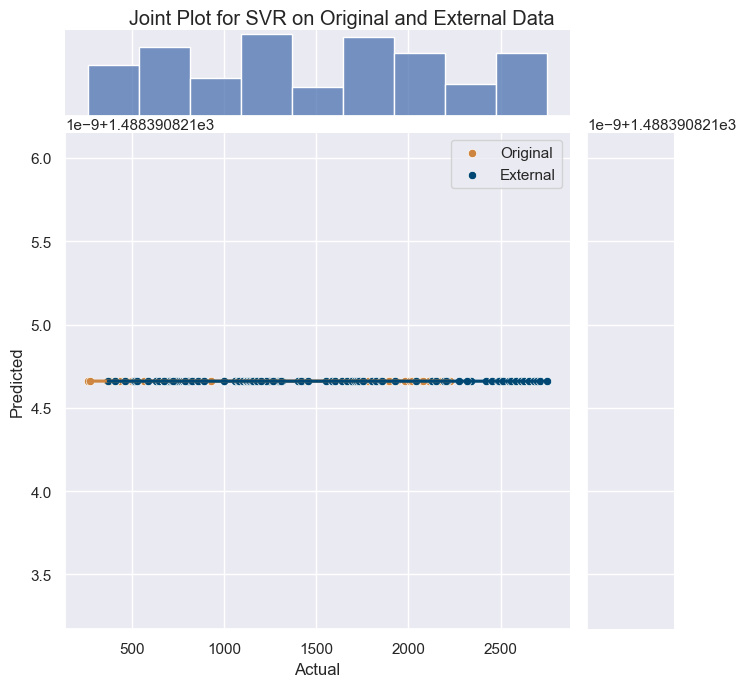

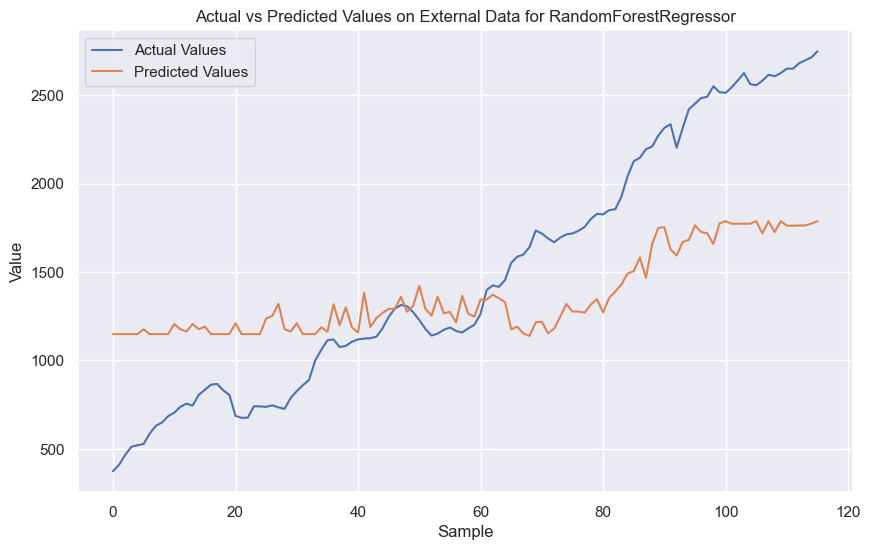

Model: RandomForestRegressor
Train RMSE: 442.89385889840077 Train R2: 0.6263784350263588 Train MAE: 386.3535874888652
Test RMSE: 441.2050279911707 Test R2: 0.47879081204393503 Test MAE: 373.9110658182296
External RMSE: 522.2472608980969 External R2: 0.44895836029423075 External MAE: 449.07531977034716
--------------------------------------------------
Original Dataset - RMSE: 442.5489405208424, R2: 0.6043103535163229, MAE: 383.80852623805345
External Dataset - RMSE: 522.2472608980969, R2: 0.44895836029423075, MAE: 449.07531977034716


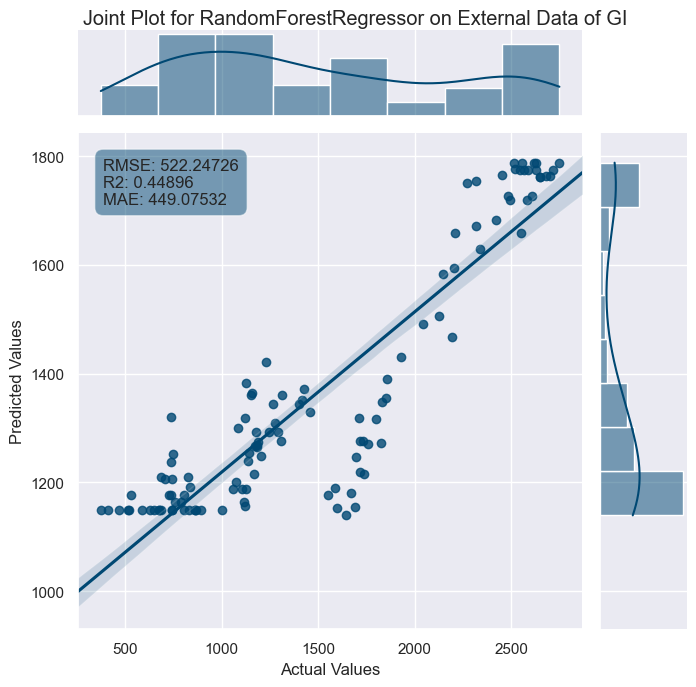

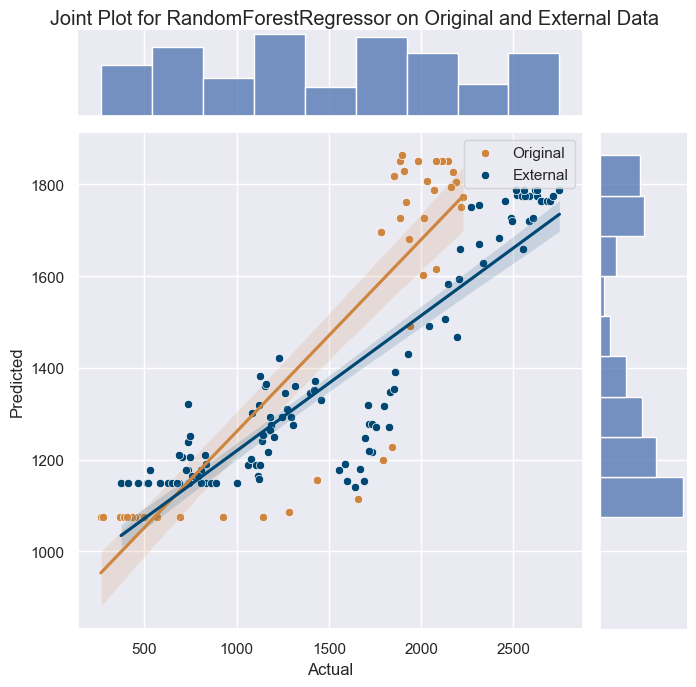

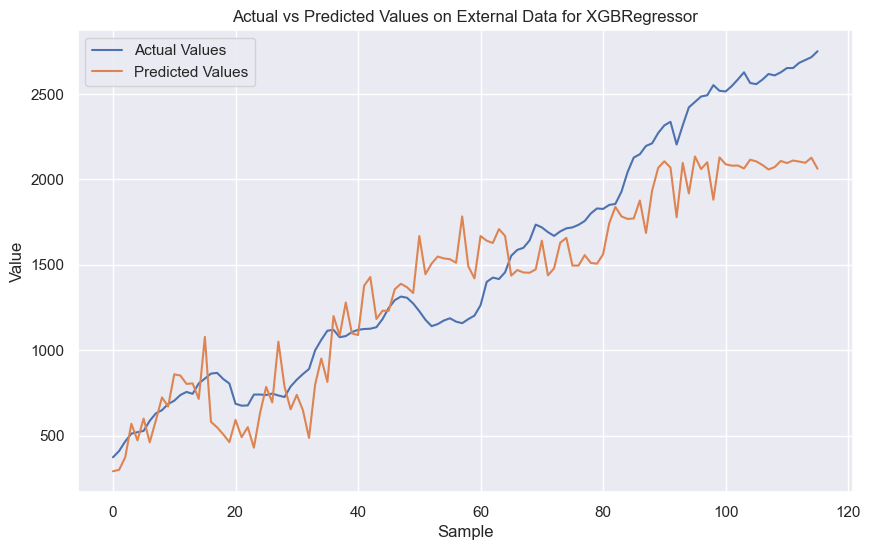

Model: XGBRegressor
Train RMSE: 0.39769402769105877 Train R2: 0.9999996987474329 Train MAE: 0.3007749720982182
Test RMSE: 128.98235539086872 Test R2: 0.955455738434336 Test MAE: 98.55563015407986
External RMSE: 306.62840401272035 External R2: 0.8100423268669688 External MAE: 252.14151742083988
--------------------------------------------------
Original Dataset - RMSE: 58.33554343748902, R2: 0.9931245904664139, MAE: 20.398358986594463
External Dataset - RMSE: 306.62840401272035, R2: 0.8100423268669688, MAE: 252.14151742083988
[LightGBM] [Warning] There are no meaningful features which satisfy the provided configuration. Decreasing Dataset parameters min_data_in_bin or min_data_in_leaf and re-constructing Dataset might resolve this warning.
[LightGBM] [Info] Total Bins 0
[LightGBM] [Info] Number of data points in the train set: 35, number of used features: 0
[LightGBM] [Info] Start training from score 0.022125
[LightGBM] [Warning] Stopped training because there are no more leaves that me

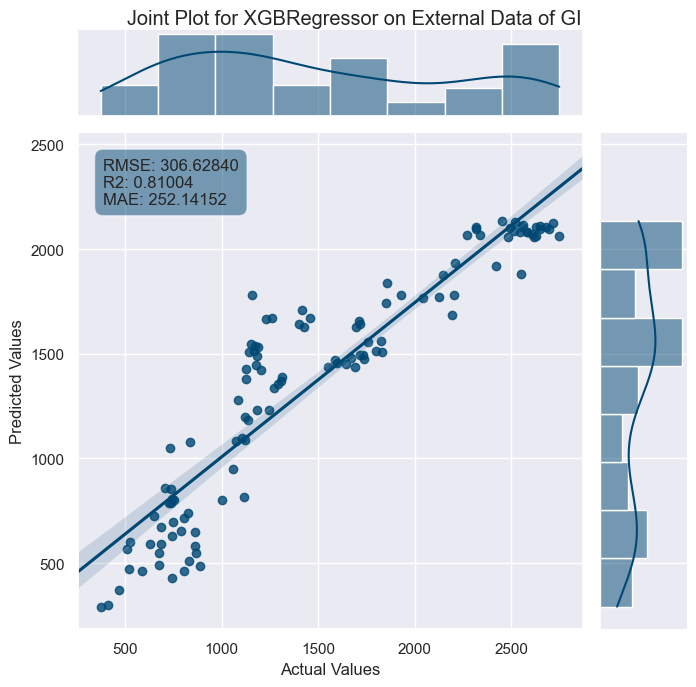

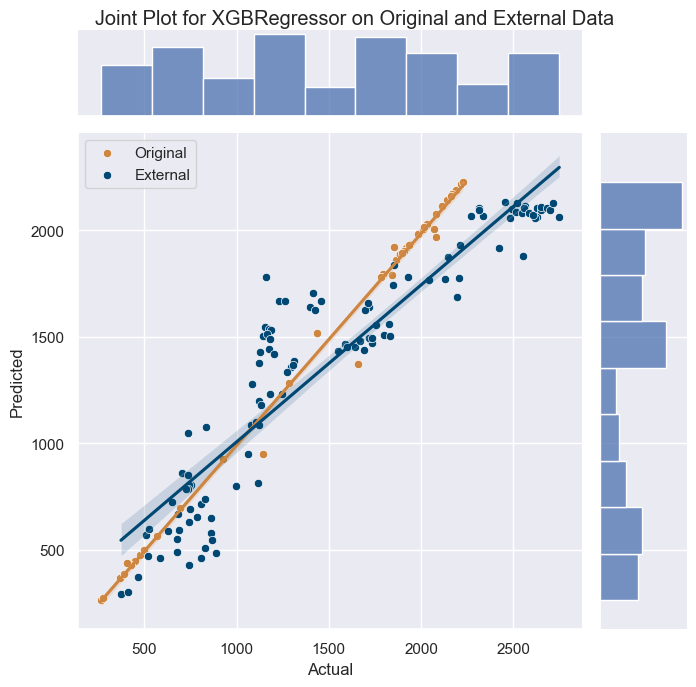

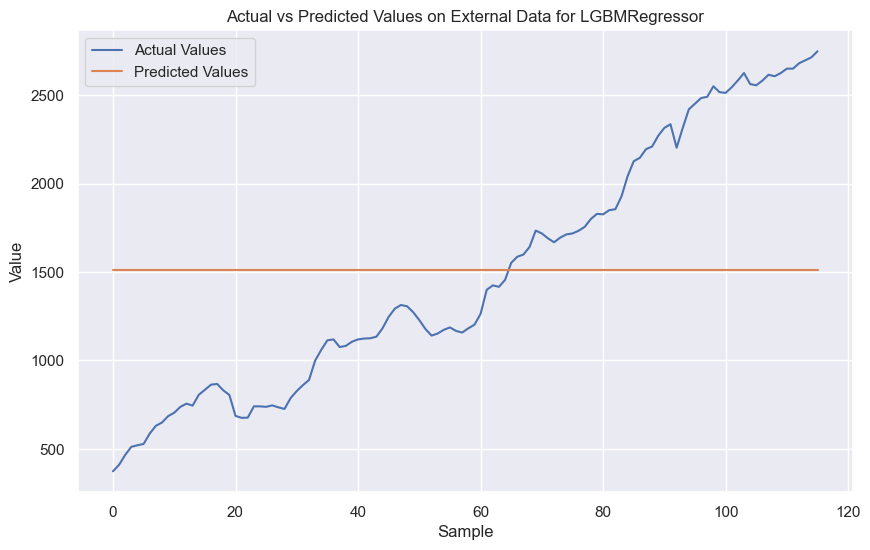

Model: LGBMRegressor
Train RMSE: 724.5755761823607 Train R2: 0.0 Train MAE: 661.0651430792451
Test RMSE: 615.8507575913003 Test R2: -0.015505118794458372 Test MAE: 508.40888896740984
External RMSE: 703.7043412708598 External R2: -0.0004895033312870556 External MAE: 616.9834304507922
--------------------------------------------------
Original Dataset - RMSE: 703.7043412708597, R2: -0.0004895033312870556, MAE: 629.8400001927333
External Dataset - RMSE: 703.7043412708598, R2: -0.0004895033312870556, MAE: 616.9834304507922


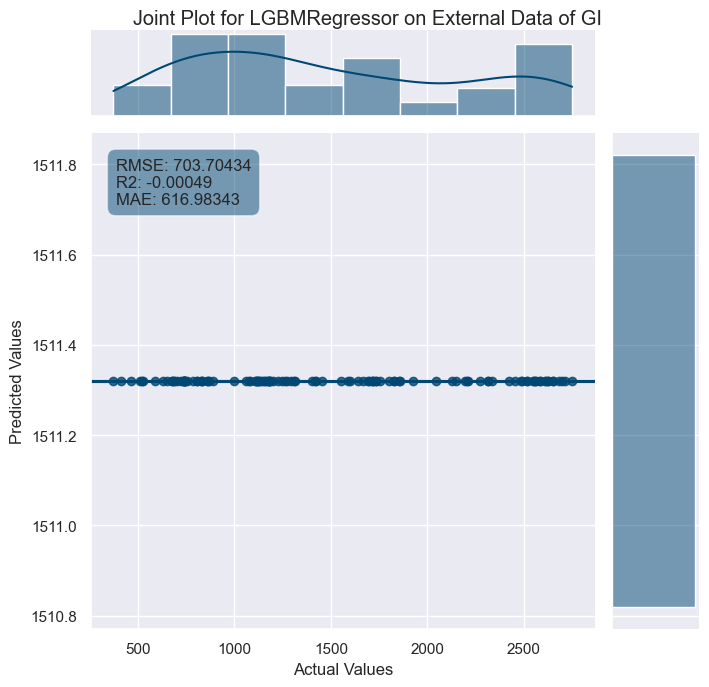

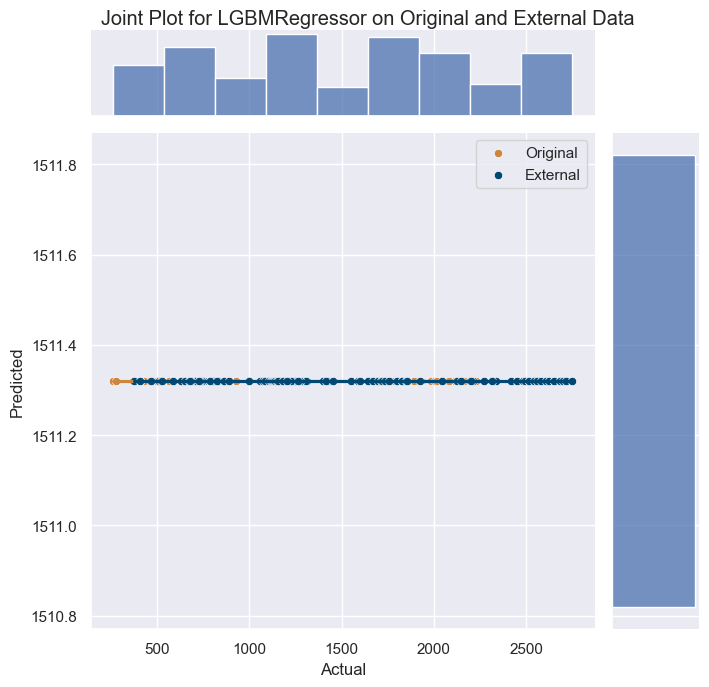

In [9]:
import pandas as pd
import numpy as np
import seaborn as sns
from sklearn.neighbors import KNeighborsRegressor
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from sklearn.preprocessing import StandardScaler
from skopt import BayesSearchCV
from skopt.space import Integer
import matplotlib.pyplot as plt
# Load datasets
data = pd.read_csv("C:\\Users\\Lenovo\\Desktop\\元学习\\BT(3)1-1.csv")
external_data = pd.read_csv("C:\\Users\\Lenovo\\Desktop\\元学习\\BT(3)1-2.csv")

# Normalization function
def normalize_data(data):
    scaler = StandardScaler()
    return scaler.fit_transform(data), scaler

# Normalize datasets
data_normalized, scaler = normalize_data(data)
external_data_normalized, _ = normalize_data(external_data)

# Split the dataset into features and target
X = data_normalized[:, :-1]
y = data_normalized[:, -1]
X_external = external_data_normalized[:, :-1]
y_external = external_data_normalized[:, -1]

# Fit a scaler for the features
feature_scaler = StandardScaler()
X_normalized = feature_scaler.fit_transform(data.drop('Biogas Production', axis=1))

# Fit a separate scaler for the target
target_scaler = StandardScaler()
y_normalized = target_scaler.fit_transform(data[['Biogas Production']])


# Split into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

# Define the hyperparameter space
param_grid = {'n_neighbors': Integer(1, 25)}

# Bayesian optimization
knn_search = BayesSearchCV(KNeighborsRegressor(), param_grid, n_iter=32, cv=5, n_jobs=-1, random_state=0)
knn_search.fit(X_train, y_train)

# Best model
knn_best = knn_search.best_estimator_

# Function to evaluate the model
def evaluate_model(model, X_train, y_train, X_test, y_test, X_external, y_external, target_scaler):
    y_pred_train = model.predict(X_train)
    y_pred_test = model.predict(X_test)
    y_pred_external = model.predict(X_external)

    # Denormalize target values and predictions
    y_train_denorm = target_scaler.inverse_transform(y_train.reshape(-1, 1)).flatten()
    y_test_denorm = target_scaler.inverse_transform(y_test.reshape(-1, 1)).flatten()
    y_external_denorm = target_scaler.inverse_transform(y_external.reshape(-1, 1)).flatten()
    y_pred_train_denorm = target_scaler.inverse_transform(y_pred_train.reshape(-1, 1)).flatten()
    y_pred_test_denorm = target_scaler.inverse_transform(y_pred_test.reshape(-1, 1)).flatten()
    y_pred_external_denorm = target_scaler.inverse_transform(y_pred_external.reshape(-1, 1)).flatten()

    # Visualization of predictions on external data
    plt.figure(figsize=(10, 6))
    plt.plot(y_external_denorm, label='Actual Values')
    plt.plot(y_pred_external_denorm, label='Predicted Values')
    plt.xlabel('Sample')
    plt.ylabel('Value')
    plt.title(f'Actual vs Predicted Values on External Data for {model.__class__.__name__}')
    plt.legend()
    plt.show()

    # Metrics for train and test sets
    train_rmse = mean_squared_error(y_train_denorm, y_pred_train_denorm, squared=False)
    test_rmse = mean_squared_error(y_test_denorm, y_pred_test_denorm, squared=False)
    train_r2 = r2_score(y_train_denorm, y_pred_train_denorm)
    test_r2 = r2_score(y_test_denorm, y_pred_test_denorm)
    train_mae = mean_absolute_error(y_train_denorm, y_pred_train_denorm)
    test_mae = mean_absolute_error(y_test_denorm, y_pred_test_denorm)

    # Metrics for external set
    external_rmse = mean_squared_error(y_external_denorm, y_pred_external_denorm, squared=False)
    external_r2 = r2_score(y_external_denorm, y_pred_external_denorm)
    external_mae = mean_absolute_error(y_external_denorm, y_pred_external_denorm)

    # Text for metrics
    metrics_text = f"RMSE: {external_rmse:.5f}\nR2: {external_r2:.5f}\nMAE: {external_mae:.5f}"

    # Create DataFrame for seaborn joint plot
    external_pred_df = pd.DataFrame({
        'Actual Values': y_external_denorm, 
        'Predicted Values': y_pred_external_denorm
    })

    # Set seaborn theme
    sns.set_theme(style="darkgrid")

    # Create the jointplot for external data with specified color
    g_external = sns.jointplot(x='Actual Values', y='Predicted Values', data=external_pred_df,
                               kind="reg", truncate=False,
                               color="#004873", height=7) 
    
    # Set title for the plot
    g_external.fig.suptitle(f"Joint Plot for {model.__class__.__name__} on External Data of GI")

    # Add metrics as text annotations
    plt.annotate(metrics_text, xy=(0.05, 0.95), xycoords='axes fraction', 
                 ha='left', va='top', bbox=dict(boxstyle='round,pad=0.5', fc="#004873", alpha=0.5))

    # Adjust layout
    g_external.fig.subplots_adjust(top=0.95)

    # Print metrics
    print(f"Model: {model.__class__.__name__}")
    print("Train RMSE:", train_rmse, "Train R2:", train_r2, "Train MAE:", train_mae)
    print("Test RMSE:", test_rmse, "Test R2:", test_r2, "Test MAE:", test_mae)
    print("External RMSE:", external_rmse, "External R2:", external_r2, "External MAE:", external_mae)
    print("--------------------------------------------------")

    # 评估模型并获取训练集和测试集的预测值
    y_pred_train_denorm = target_scaler.inverse_transform(model.predict(X_train).reshape(-1, 1)).flatten()
    y_pred_test_denorm = target_scaler.inverse_transform(model.predict(X_test).reshape(-1, 1)).flatten()

    # 合并训练集和测试集的数据
    original_data_actual = np.concatenate([y_train_denorm, y_test_denorm])
    original_data_predicted = np.concatenate([y_pred_train_denorm, y_pred_test_denorm])

    # 创建包含原始数据集和外部数据集的 DataFrame
    combined_df = pd.DataFrame({
        'Actual': np.concatenate([original_data_actual, y_external_denorm]),
        'Predicted': np.concatenate([original_data_predicted, y_pred_external_denorm]),
        'Dataset': ['Original'] * len(original_data_actual) + ['External'] * len(y_external_denorm)
    })

    # 创建基础 jointplot
    g_combined = sns.jointplot(x='Actual', y='Predicted', data=combined_df, kind="scatter", height=7)

    # 定义两个数据集的颜色
    colors = ['#CD853F', '#004873']

    # 为两个数据集添加不同颜色的散点图和线性回归线
    for dataset, color in zip(['Original', 'External'], colors):
        subset = combined_df[combined_df['Dataset'] == dataset]
        sns.scatterplot(x=subset['Actual'], y=subset['Predicted'], color=color, ax=g_combined.ax_joint, label=dataset)
        sns.regplot(x=subset['Actual'], y=subset['Predicted'], scatter=False, color=color, ax=g_combined.ax_joint)

    # 设置标题和布局
    g_combined.fig.suptitle(f"Joint Plot for {model.__class__.__name__} on Original and External Data")
    g_combined.fig.subplots_adjust(top=0.95)
    # 计算原始数据集的指标
    train_rmse = mean_squared_error(original_data_actual, original_data_predicted, squared=False)
    train_r2 = r2_score(original_data_actual, original_data_predicted)
    train_mae = mean_absolute_error(original_data_actual, original_data_predicted)

    # 计算外部数据集的指标
    external_rmse = mean_squared_error(y_external_denorm, y_pred_external_denorm, squared=False)
    external_r2 = r2_score(y_external_denorm, y_pred_external_denorm)
    external_mae = mean_absolute_error(y_external_denorm, y_pred_external_denorm)


    print(f"Original Dataset - RMSE: {train_rmse}, R2: {train_r2}, MAE: {train_mae}")
    print(f"External Dataset - RMSE: {external_rmse}, R2: {external_r2}, MAE: {external_mae}")

# Evaluate KNN model
evaluate_model(knn_best, X_train, y_train, X_test, y_test, X_external, y_external, target_scaler)

from sklearn.svm import SVR
from skopt.space import Real

# Define the hyperparameter space for SVM
param_grid_svm = {
    'C': Real(1e-15, 1e+1, prior='log-uniform'),
    'gamma': Real(1e-15, 1e+1, prior='log-uniform'),
    'epsilon': Real(1e-15, 1e+1, prior='log-uniform')
}


# Bayesian optimization
svm_search = BayesSearchCV(SVR(), param_grid_svm, n_iter=32, cv=5, n_jobs=-1, random_state=0)
svm_search.fit(X_train, y_train)

# Best model
svm_best = svm_search.best_estimator_

# Evaluate SVM model
evaluate_model(svm_best, X_train, y_train, X_test, y_test, X_external, y_external, target_scaler)

from sklearn.ensemble import RandomForestRegressor
from skopt.space import Integer, Real

# Define the hyperparameter space for Random Forest
param_grid_rf = {
    'n_estimators': Integer(10, 100),
    'max_depth': Integer(10, 30),
    'min_samples_split': Real(0.3, 0.8),
    'min_samples_leaf': Real(0.3, 0.8)
}

# Bayesian optimization
rf_search = BayesSearchCV(RandomForestRegressor(random_state=0), param_grid_rf, n_iter=32, cv=5, n_jobs=-1, random_state=0)
rf_search.fit(X_train, y_train)

# Best model
rf_best = rf_search.best_estimator_

# Evaluate Random Forest model
evaluate_model(rf_best, X_train, y_train, X_test, y_test, X_external, y_external, target_scaler)


import xgboost as xgb

# Define the hyperparameter space for XGBoost
param_grid_xgb = {
    'n_estimators': Integer(10, 100),
    'max_depth': Integer(10, 30),
    'learning_rate': Real(0.3, 0.8, 'log-uniform'),
    'subsample': Real(0.3, 0.8),
    'colsample_bytree': Real(0.3, 0.8)
}

# Bayesian optimization
xgb_search = BayesSearchCV(xgb.XGBRegressor(), param_grid_xgb, n_iter=32, cv=5, n_jobs=-1, random_state=0)
xgb_search.fit(X_train, y_train)

# Best model
xgb_best = xgb_search.best_estimator_

# Evaluate XGBoost model
evaluate_model(xgb_best, X_train, y_train, X_test, y_test, X_external, y_external, target_scaler)


import lightgbm as lgb

# Define the hyperparameter space for LightGBM
param_grid_lgb = {
    'n_estimators': Integer(10, 300),
    'max_depth': Integer(-1, 50),
    'learning_rate': Real(0.01, 1.0, 'log-uniform'),
    'num_leaves': Integer(20, 300),
    'subsample': Real(0.1, 1.0),
    'colsample_bytree': Real(0.1, 1.0)
}

# Bayesian optimization
lgb_search = BayesSearchCV(lgb.LGBMRegressor(), param_grid_lgb, n_iter=32, cv=5, n_jobs=-1, random_state=0)
lgb_search.fit(X_train, y_train)

# Best model
lgb_best = lgb_search.best_estimator_

# Evaluate LightGBM model
evaluate_model(lgb_best, X_train, y_train, X_test, y_test, X_external, y_external, target_scaler)

In [10]:
# 创建包含模型名称和其最优超参数的字典
model_hyperparams = {
    'KNN': knn_search.best_params_,
    'SVM': svm_search.best_params_,
    'RandomForest': rf_search.best_params_,
    'XGBoost': xgb_search.best_params_,
    'LightGBM': lgb_search.best_params_
}

# 转换为DataFrame
hyperparams_df = pd.DataFrame.from_dict(model_hyperparams, orient='index')

# 重置索引，使模型名称成为一列
hyperparams_df.reset_index(inplace=True)
hyperparams_df.rename(columns={'index': 'Model'}, inplace=True)

# 指定文件路径和名称，这里替换为你的目标路径
file_path = "C:\\Users\\Lenovo\\Desktop\\元学习\\传统模型超参数\\hyperparams_BT_3_1.csv"

# 保存为CSV文件
hyperparams_df.to_csv(file_path, index=False)

e:\anaconda\envs\yuanxuexi2\lib\site-packages\skopt\optimizer\optimizer.py:449: UserWarning: The objective has been evaluated at this point before.
  warnings.warn("The objective has been evaluated "
e:\anaconda\envs\yuanxuexi2\lib\site-packages\skopt\optimizer\optimizer.py:449: UserWarning: The objective has been evaluated at this point before.
  warnings.warn("The objective has been evaluated "
e:\anaconda\envs\yuanxuexi2\lib\site-packages\skopt\optimizer\optimizer.py:449: UserWarning: The objective has been evaluated at this point before.
  warnings.warn("The objective has been evaluated "
e:\anaconda\envs\yuanxuexi2\lib\site-packages\skopt\optimizer\optimizer.py:449: UserWarning: The objective has been evaluated at this point before.
  warnings.warn("The objective has been evaluated "
e:\anaconda\envs\yuanxuexi2\lib\site-packages\skopt\optimizer\optimizer.py:449: UserWarning: The objective has been evaluated at this point before.
  warnings.warn("The objective has been evaluated "


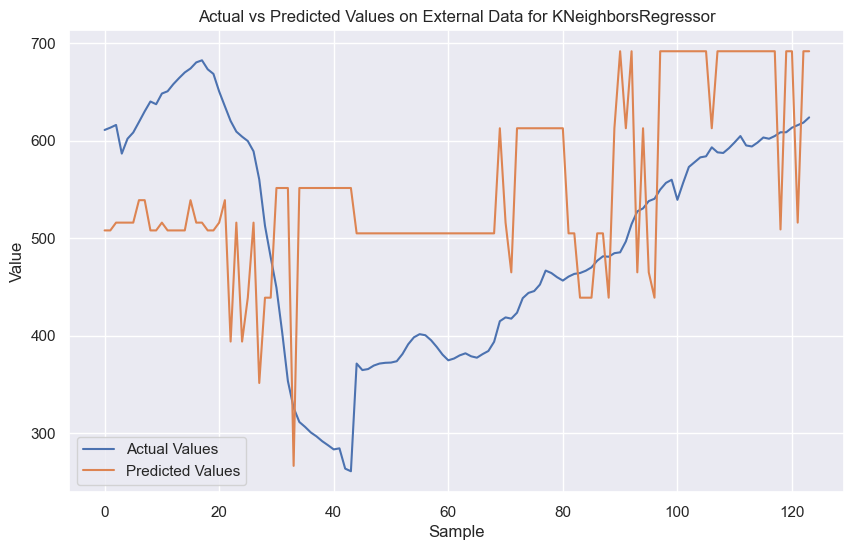

Model: KNeighborsRegressor
Train RMSE: 0.0 Train R2: 1.0 Train MAE: 0.0
Test RMSE: 43.564896562484805 Test R2: 0.7743515362710254 Test MAE: 39.223749999999995
External RMSE: 139.894277694435 External R2: -0.44790863462815933 External MAE: 127.4446211946351
--------------------------------------------------
Original Dataset - RMSE: 20.536689187349012, R2: 0.9687965856463412, MAE: 8.716388888888888
External Dataset - RMSE: 139.894277694435, R2: -0.44790863462815933, MAE: 127.4446211946351


e:\anaconda\envs\yuanxuexi2\lib\site-packages\skopt\optimizer\optimizer.py:449: UserWarning: The objective has been evaluated at this point before.
  warnings.warn("The objective has been evaluated "


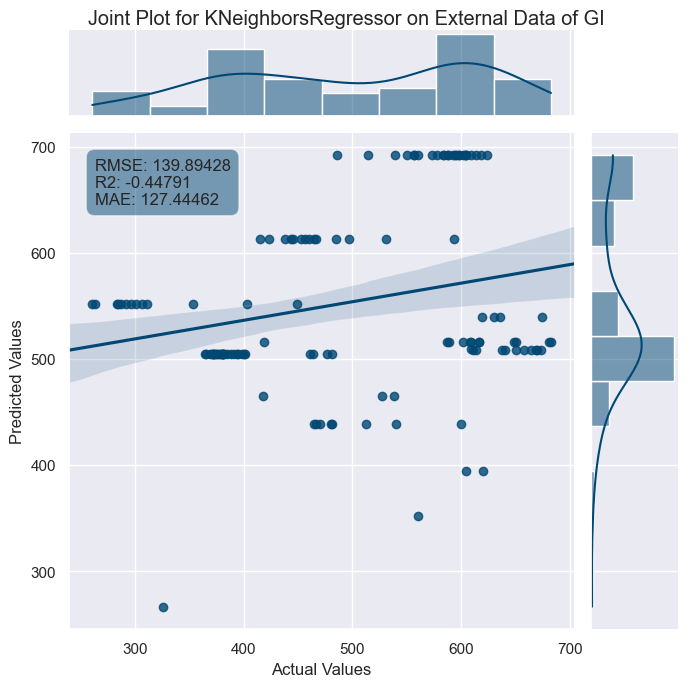

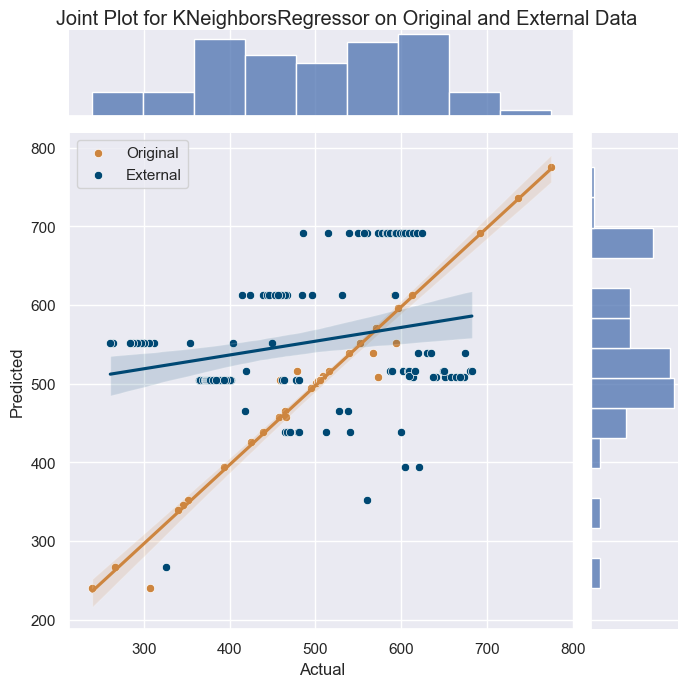

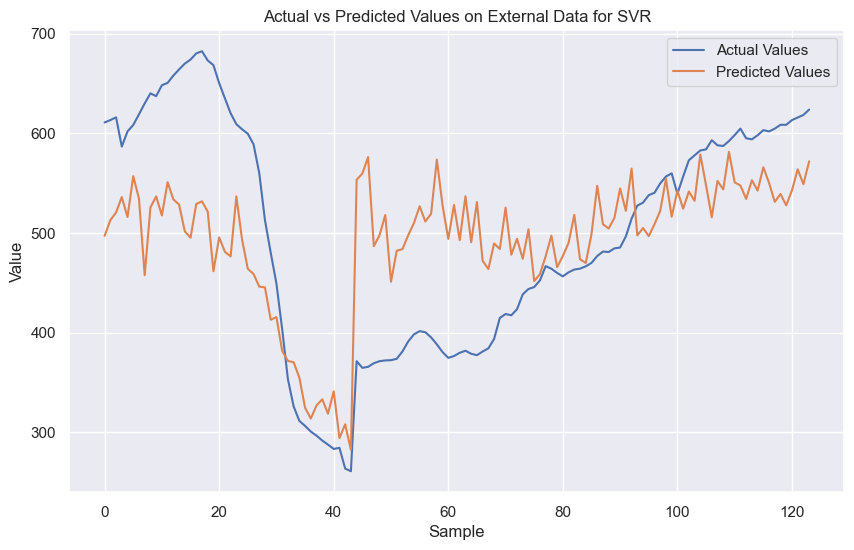

Model: SVR
Train RMSE: 50.95359762637828 Train R2: 0.8264510266154824 Train MAE: 31.755214019429335
Test RMSE: 64.35157108585454 Test R2: 0.5076461761342981 Test MAE: 59.17048015350291
External RMSE: 92.9124116022857 External R2: 0.36131204958418783 External MAE: 76.88863272338392
--------------------------------------------------
Original Dataset - RMSE: 54.21780476306409, R2: 0.7825170995893475, MAE: 37.847495382556794
External Dataset - RMSE: 92.9124116022857, R2: 0.36131204958418783, MAE: 76.88863272338392


e:\anaconda\envs\yuanxuexi2\lib\site-packages\skopt\optimizer\optimizer.py:449: UserWarning: The objective has been evaluated at this point before.
  warnings.warn("The objective has been evaluated "
e:\anaconda\envs\yuanxuexi2\lib\site-packages\skopt\optimizer\optimizer.py:449: UserWarning: The objective has been evaluated at this point before.
  warnings.warn("The objective has been evaluated "
e:\anaconda\envs\yuanxuexi2\lib\site-packages\skopt\optimizer\optimizer.py:449: UserWarning: The objective has been evaluated at this point before.
  warnings.warn("The objective has been evaluated "
e:\anaconda\envs\yuanxuexi2\lib\site-packages\skopt\optimizer\optimizer.py:449: UserWarning: The objective has been evaluated at this point before.
  warnings.warn("The objective has been evaluated "
e:\anaconda\envs\yuanxuexi2\lib\site-packages\skopt\optimizer\optimizer.py:449: UserWarning: The objective has been evaluated at this point before.
  warnings.warn("The objective has been evaluated "


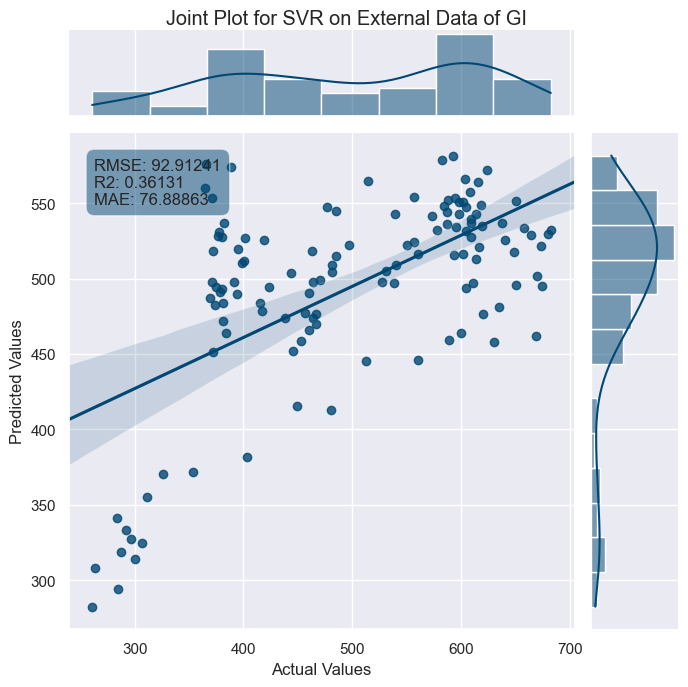

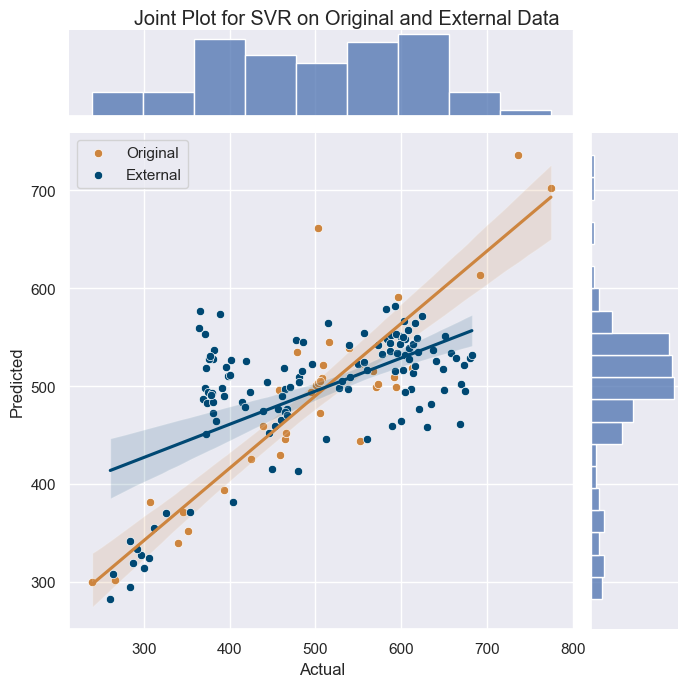

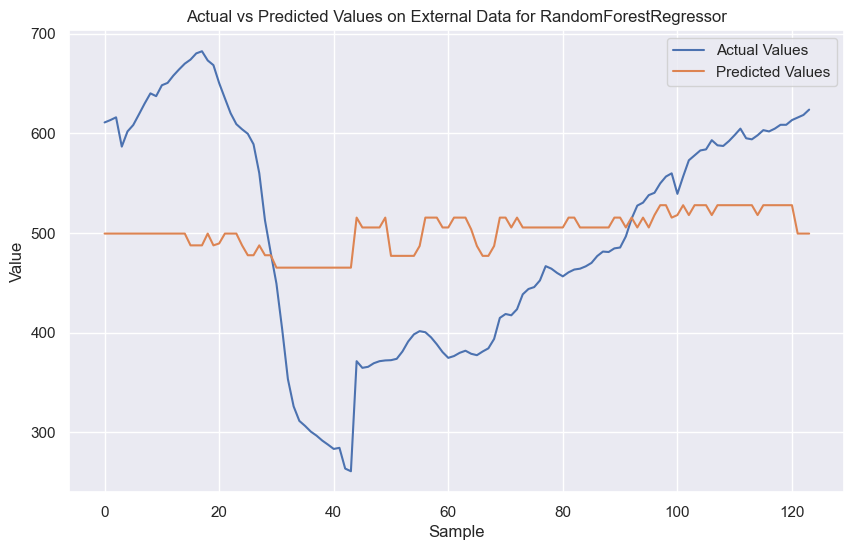

Model: RandomForestRegressor
Train RMSE: 107.40646395527124 Train R2: 0.22886008991106255 Train MAE: 78.71953507762078
Test RMSE: 88.32235336962017 Test R2: 0.0725291442924878 Test MAE: 70.99124000305252
External RMSE: 109.13876027036174 External R2: 0.11874967533444103 External MAE: 96.62862949532192
--------------------------------------------------
Original Dataset - RMSE: 103.47018663746198, R2: 0.20791512133415557, MAE: 77.00213617216116
External Dataset - RMSE: 109.13876027036174, R2: 0.11874967533444103, MAE: 96.62862949532192


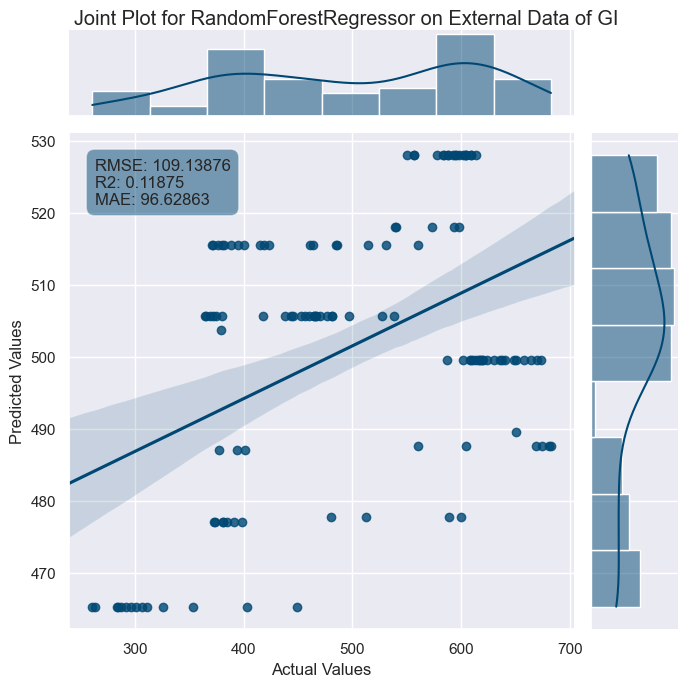

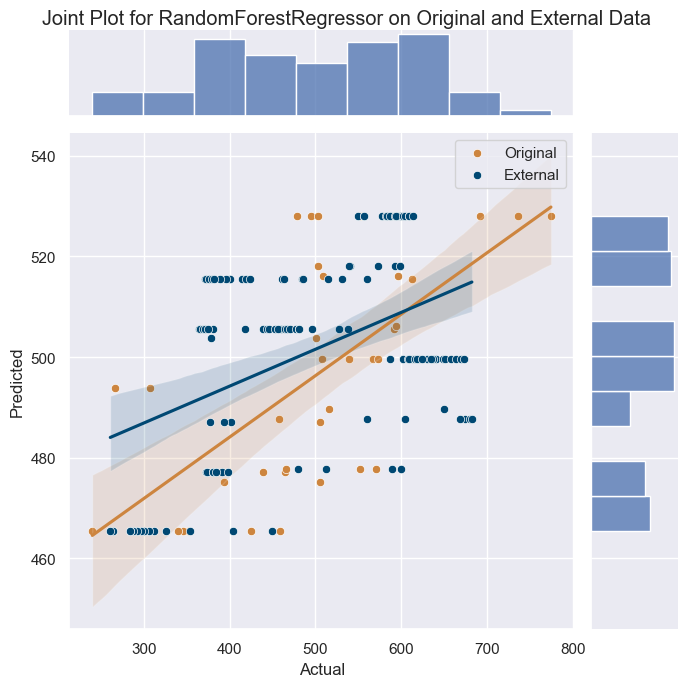

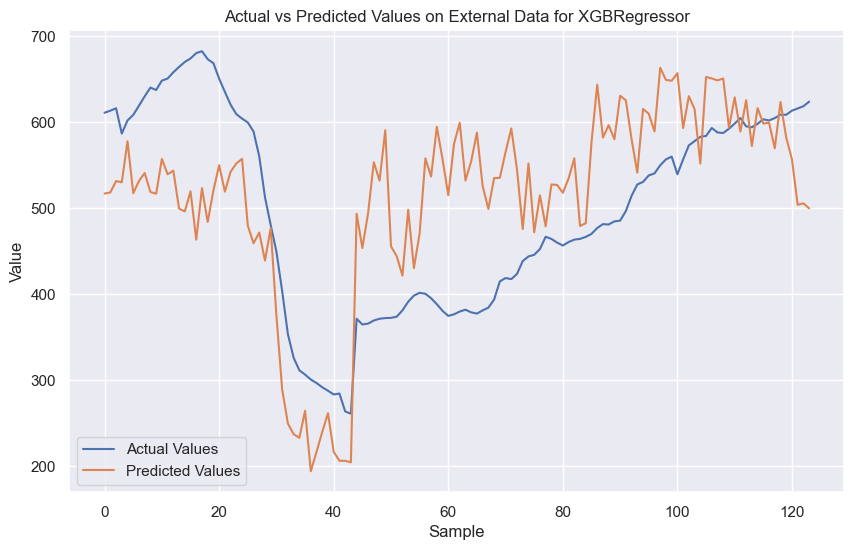

Model: XGBRegressor
Train RMSE: 3.063094648705787 Train R2: 0.999372818591994 Train MAE: 2.0663350132533487
Test RMSE: 56.646035459479954 Test R2: 0.6184969218404682 Test MAE: 43.01513931274414
External RMSE: 106.81160408774164 External R2: 0.1559306465372836 External MAE: 92.6137719912078
--------------------------------------------------
Original Dataset - RMSE: 26.839491029165362, R2: 0.9467045898016131, MAE: 11.16606930202908
External Dataset - RMSE: 106.81160408774164, R2: 0.1559306465372836, MAE: 92.6137719912078
[LightGBM] [Warning] There are no meaningful features which satisfy the provided configuration. Decreasing Dataset parameters min_data_in_bin or min_data_in_leaf and re-constructing Dataset might resolve this warning.
[LightGBM] [Info] Total Bins 0
[LightGBM] [Info] Number of data points in the train set: 28, number of used features: 0
[LightGBM] [Info] Start training from score -0.015791
[LightGBM] [Warning] Stopped training because there are no more leaves that meet th

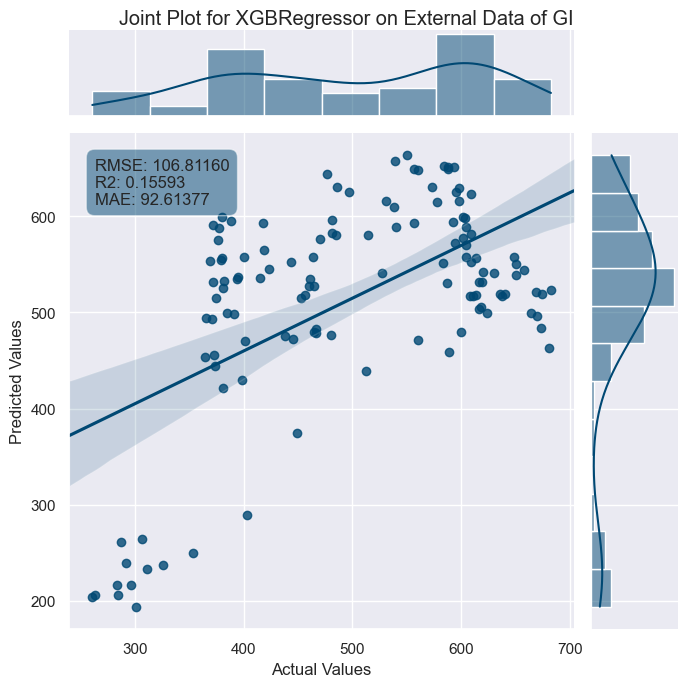

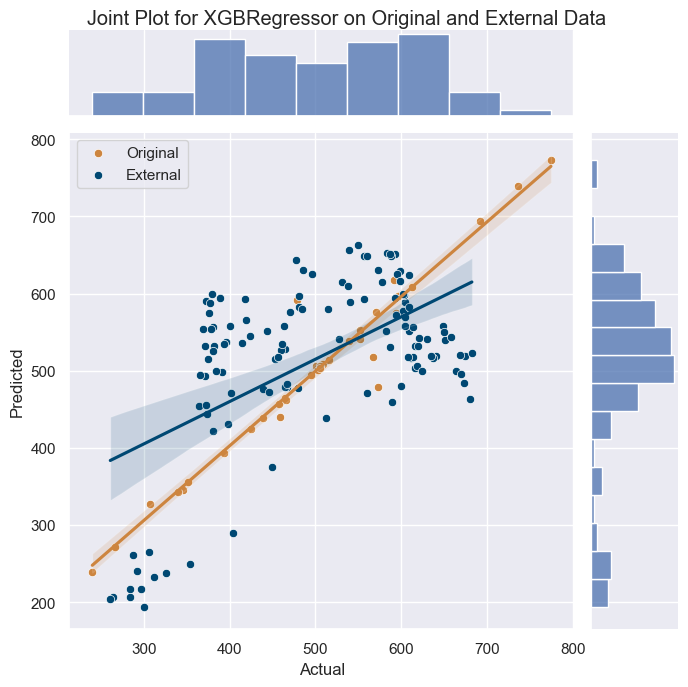

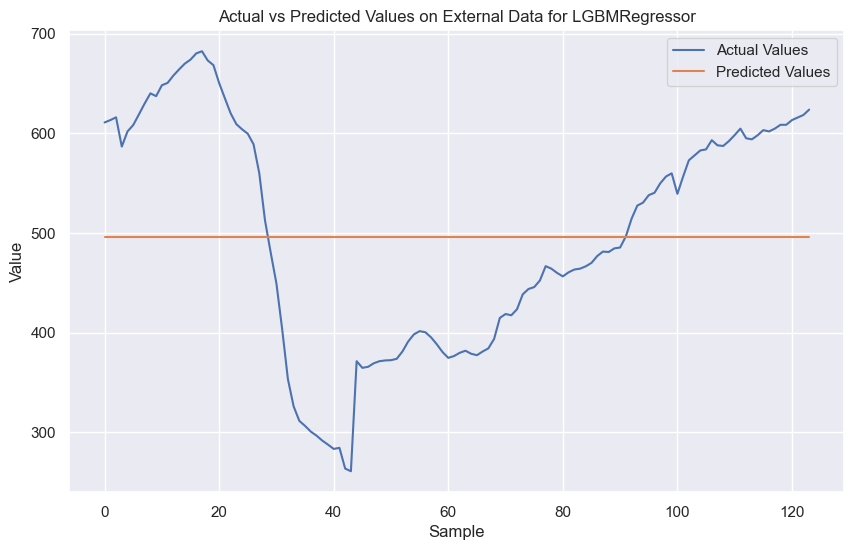

Model: LGBMRegressor
Train RMSE: 122.31052454423417 Train R2: 0.0 Train MAE: 88.47500006101612
Test RMSE: 92.0821354400768 Test R2: -0.008114290771155552 Test MAE: 76.74375
External RMSE: 116.27424011763897 External R2: -0.0002493491513524404 External MAE: 103.48513250291991
--------------------------------------------------
Original Dataset - RMSE: 116.27424011763897, R2: -0.00024934915135221836, MAE: 85.86805560301252
External Dataset - RMSE: 116.27424011763897, R2: -0.0002493491513524404, MAE: 103.48513250291991


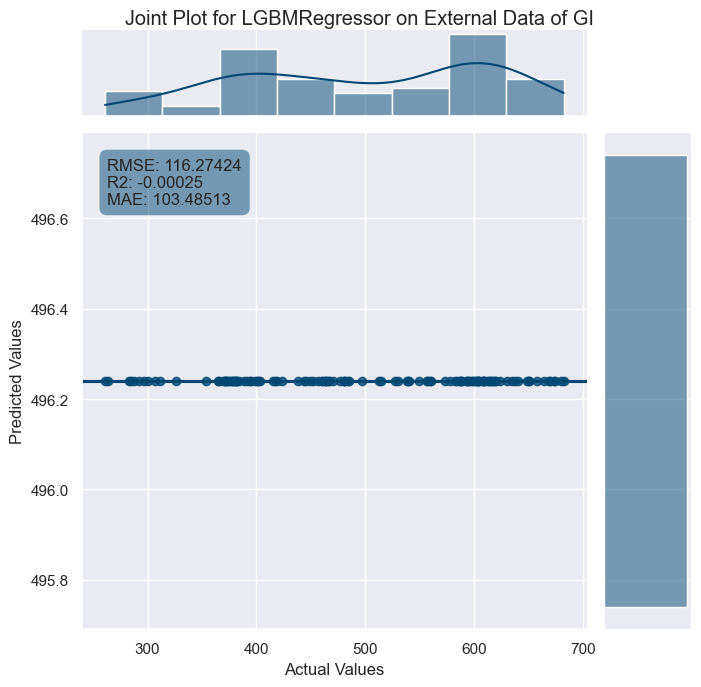

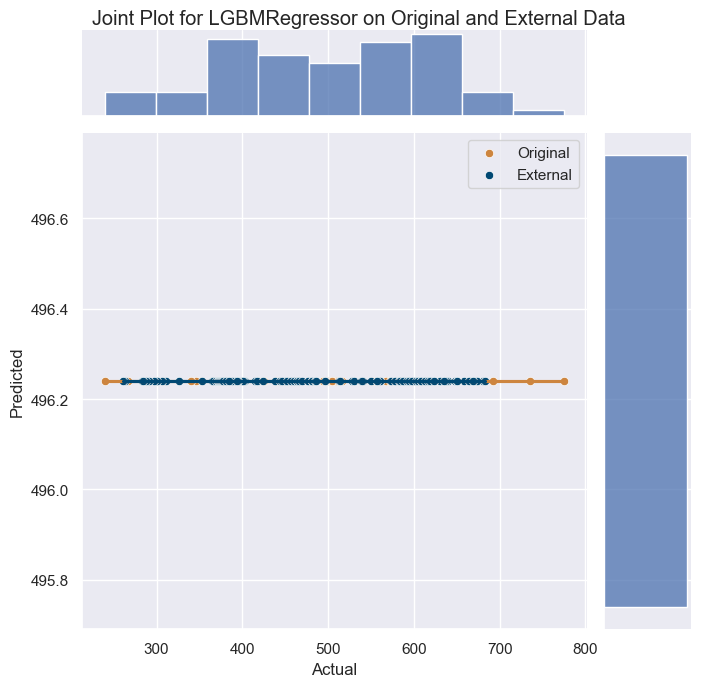

In [11]:
import pandas as pd
import numpy as np
import seaborn as sns
from sklearn.neighbors import KNeighborsRegressor
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from sklearn.preprocessing import StandardScaler
from skopt import BayesSearchCV
from skopt.space import Integer
import matplotlib.pyplot as plt
# Load datasets
data = pd.read_csv("C:\\Users\\Lenovo\\Desktop\\元学习\\BT(3)2-1.csv")
external_data = pd.read_csv("C:\\Users\\Lenovo\\Desktop\\元学习\\BT(3)2-2.csv")

# Normalization function
def normalize_data(data):
    scaler = StandardScaler()
    return scaler.fit_transform(data), scaler

# Normalize datasets
data_normalized, scaler = normalize_data(data)
external_data_normalized, _ = normalize_data(external_data)

# Split the dataset into features and target
X = data_normalized[:, :-1]
y = data_normalized[:, -1]
X_external = external_data_normalized[:, :-1]
y_external = external_data_normalized[:, -1]

# Fit a scaler for the features
feature_scaler = StandardScaler()
X_normalized = feature_scaler.fit_transform(data.drop('Biogas Production', axis=1))

# Fit a separate scaler for the target
target_scaler = StandardScaler()
y_normalized = target_scaler.fit_transform(data[['Biogas Production']])


# Split into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

# Define the hyperparameter space
param_grid = {'n_neighbors': Integer(1, 20)}

# Bayesian optimization
knn_search = BayesSearchCV(KNeighborsRegressor(), param_grid, n_iter=32, cv=5, n_jobs=-1, random_state=0)
knn_search.fit(X_train, y_train)

# Best model
knn_best = knn_search.best_estimator_

# Function to evaluate the model
def evaluate_model(model, X_train, y_train, X_test, y_test, X_external, y_external, target_scaler):
    y_pred_train = model.predict(X_train)
    y_pred_test = model.predict(X_test)
    y_pred_external = model.predict(X_external)

    # Denormalize target values and predictions
    y_train_denorm = target_scaler.inverse_transform(y_train.reshape(-1, 1)).flatten()
    y_test_denorm = target_scaler.inverse_transform(y_test.reshape(-1, 1)).flatten()
    y_external_denorm = target_scaler.inverse_transform(y_external.reshape(-1, 1)).flatten()
    y_pred_train_denorm = target_scaler.inverse_transform(y_pred_train.reshape(-1, 1)).flatten()
    y_pred_test_denorm = target_scaler.inverse_transform(y_pred_test.reshape(-1, 1)).flatten()
    y_pred_external_denorm = target_scaler.inverse_transform(y_pred_external.reshape(-1, 1)).flatten()

    # Visualization of predictions on external data
    plt.figure(figsize=(10, 6))
    plt.plot(y_external_denorm, label='Actual Values')
    plt.plot(y_pred_external_denorm, label='Predicted Values')
    plt.xlabel('Sample')
    plt.ylabel('Value')
    plt.title(f'Actual vs Predicted Values on External Data for {model.__class__.__name__}')
    plt.legend()
    plt.show()

    # Metrics for train and test sets
    train_rmse = mean_squared_error(y_train_denorm, y_pred_train_denorm, squared=False)
    test_rmse = mean_squared_error(y_test_denorm, y_pred_test_denorm, squared=False)
    train_r2 = r2_score(y_train_denorm, y_pred_train_denorm)
    test_r2 = r2_score(y_test_denorm, y_pred_test_denorm)
    train_mae = mean_absolute_error(y_train_denorm, y_pred_train_denorm)
    test_mae = mean_absolute_error(y_test_denorm, y_pred_test_denorm)

    # Metrics for external set
    external_rmse = mean_squared_error(y_external_denorm, y_pred_external_denorm, squared=False)
    external_r2 = r2_score(y_external_denorm, y_pred_external_denorm)
    external_mae = mean_absolute_error(y_external_denorm, y_pred_external_denorm)

    # Text for metrics
    metrics_text = f"RMSE: {external_rmse:.5f}\nR2: {external_r2:.5f}\nMAE: {external_mae:.5f}"

    # Create DataFrame for seaborn joint plot
    external_pred_df = pd.DataFrame({
        'Actual Values': y_external_denorm, 
        'Predicted Values': y_pred_external_denorm
    })

    # Set seaborn theme
    sns.set_theme(style="darkgrid")

    # Create the jointplot for external data with specified color
    g_external = sns.jointplot(x='Actual Values', y='Predicted Values', data=external_pred_df,
                               kind="reg", truncate=False,
                               color="#004873", height=7) 
    
    # Set title for the plot
    g_external.fig.suptitle(f"Joint Plot for {model.__class__.__name__} on External Data of GI")

    # Add metrics as text annotations
    plt.annotate(metrics_text, xy=(0.05, 0.95), xycoords='axes fraction', 
                 ha='left', va='top', bbox=dict(boxstyle='round,pad=0.5', fc="#004873", alpha=0.5))

    # Adjust layout
    g_external.fig.subplots_adjust(top=0.95)

    # Print metrics
    print(f"Model: {model.__class__.__name__}")
    print("Train RMSE:", train_rmse, "Train R2:", train_r2, "Train MAE:", train_mae)
    print("Test RMSE:", test_rmse, "Test R2:", test_r2, "Test MAE:", test_mae)
    print("External RMSE:", external_rmse, "External R2:", external_r2, "External MAE:", external_mae)
    print("--------------------------------------------------")

    # 评估模型并获取训练集和测试集的预测值
    y_pred_train_denorm = target_scaler.inverse_transform(model.predict(X_train).reshape(-1, 1)).flatten()
    y_pred_test_denorm = target_scaler.inverse_transform(model.predict(X_test).reshape(-1, 1)).flatten()

    # 合并训练集和测试集的数据
    original_data_actual = np.concatenate([y_train_denorm, y_test_denorm])
    original_data_predicted = np.concatenate([y_pred_train_denorm, y_pred_test_denorm])

    # 创建包含原始数据集和外部数据集的 DataFrame
    combined_df = pd.DataFrame({
        'Actual': np.concatenate([original_data_actual, y_external_denorm]),
        'Predicted': np.concatenate([original_data_predicted, y_pred_external_denorm]),
        'Dataset': ['Original'] * len(original_data_actual) + ['External'] * len(y_external_denorm)
    })

    # 创建基础 jointplot
    g_combined = sns.jointplot(x='Actual', y='Predicted', data=combined_df, kind="scatter", height=7)

    # 定义两个数据集的颜色
    colors = ['#CD853F', '#004873']

    # 为两个数据集添加不同颜色的散点图和线性回归线
    for dataset, color in zip(['Original', 'External'], colors):
        subset = combined_df[combined_df['Dataset'] == dataset]
        sns.scatterplot(x=subset['Actual'], y=subset['Predicted'], color=color, ax=g_combined.ax_joint, label=dataset)
        sns.regplot(x=subset['Actual'], y=subset['Predicted'], scatter=False, color=color, ax=g_combined.ax_joint)

    # 设置标题和布局
    g_combined.fig.suptitle(f"Joint Plot for {model.__class__.__name__} on Original and External Data")
    g_combined.fig.subplots_adjust(top=0.95)
    # 计算原始数据集的指标
    train_rmse = mean_squared_error(original_data_actual, original_data_predicted, squared=False)
    train_r2 = r2_score(original_data_actual, original_data_predicted)
    train_mae = mean_absolute_error(original_data_actual, original_data_predicted)

    # 计算外部数据集的指标
    external_rmse = mean_squared_error(y_external_denorm, y_pred_external_denorm, squared=False)
    external_r2 = r2_score(y_external_denorm, y_pred_external_denorm)
    external_mae = mean_absolute_error(y_external_denorm, y_pred_external_denorm)

    print(f"Original Dataset - RMSE: {train_rmse}, R2: {train_r2}, MAE: {train_mae}")
    print(f"External Dataset - RMSE: {external_rmse}, R2: {external_r2}, MAE: {external_mae}")

# Evaluate KNN model
evaluate_model(knn_best, X_train, y_train, X_test, y_test, X_external, y_external, target_scaler)

from sklearn.svm import SVR
from skopt.space import Real

# Define the hyperparameter space for SVM
param_grid_svm = {
    'C': Real(1e-15, 1e+1, prior='log-uniform'),
    'gamma': Real(1e-15, 1e+1, prior='log-uniform'),
    'epsilon': Real(1e-15, 1e+1, prior='log-uniform')
}


# Bayesian optimization
svm_search = BayesSearchCV(SVR(), param_grid_svm, n_iter=32, cv=5, n_jobs=-1, random_state=0)
svm_search.fit(X_train, y_train)

# Best model
svm_best = svm_search.best_estimator_

# Evaluate SVM model
evaluate_model(svm_best, X_train, y_train, X_test, y_test, X_external, y_external, target_scaler)

from sklearn.ensemble import RandomForestRegressor
from skopt.space import Integer, Real

# Define the hyperparameter space for Random Forest
param_grid_rf = {
    'n_estimators': Integer(10, 100),
    'max_depth': Integer(10, 30),
    'min_samples_split': Real(0.3, 0.8),
    'min_samples_leaf': Real(0.3, 0.8)
}

# Bayesian optimization
rf_search = BayesSearchCV(RandomForestRegressor(random_state=0), param_grid_rf, n_iter=32, cv=5, n_jobs=-1, random_state=0)
rf_search.fit(X_train, y_train)

# Best model
rf_best = rf_search.best_estimator_

# Evaluate Random Forest model
evaluate_model(rf_best, X_train, y_train, X_test, y_test, X_external, y_external, target_scaler)


import xgboost as xgb

# Define the hyperparameter space for XGBoost
param_grid_xgb = {
    'n_estimators': Integer(10, 100),
    'max_depth': Integer(10, 30),
    'learning_rate': Real(0.3, 0.8, 'log-uniform'),
    'subsample': Real(0.3, 0.8),
    'colsample_bytree': Real(0.3, 0.8)
}

# Bayesian optimization
xgb_search = BayesSearchCV(xgb.XGBRegressor(), param_grid_xgb, n_iter=32, cv=5, n_jobs=-1, random_state=0)
xgb_search.fit(X_train, y_train)

# Best model
xgb_best = xgb_search.best_estimator_

# Evaluate XGBoost model
evaluate_model(xgb_best, X_train, y_train, X_test, y_test, X_external, y_external, target_scaler)


import lightgbm as lgb

# Define the hyperparameter space for LightGBM
param_grid_lgb = {
    'n_estimators': Integer(10, 300),
    'max_depth': Integer(-1, 50),
    'learning_rate': Real(0.01, 1.0, 'log-uniform'),
    'num_leaves': Integer(20, 300),
    'subsample': Real(0.1, 1.0),
    'colsample_bytree': Real(0.1, 1.0)
}

# Bayesian optimization
lgb_search = BayesSearchCV(lgb.LGBMRegressor(), param_grid_lgb, n_iter=32, cv=5, n_jobs=-1, random_state=0)
lgb_search.fit(X_train, y_train)

# Best model
lgb_best = lgb_search.best_estimator_

# Evaluate LightGBM model
evaluate_model(lgb_best, X_train, y_train, X_test, y_test, X_external, y_external, target_scaler)

In [12]:
# 创建包含模型名称和其最优超参数的字典
model_hyperparams = {
    'KNN': knn_search.best_params_,
    'SVM': svm_search.best_params_,
    'RandomForest': rf_search.best_params_,
    'XGBoost': xgb_search.best_params_,
    'LightGBM': lgb_search.best_params_
}

# 转换为DataFrame
hyperparams_df = pd.DataFrame.from_dict(model_hyperparams, orient='index')

# 重置索引，使模型名称成为一列
hyperparams_df.reset_index(inplace=True)
hyperparams_df.rename(columns={'index': 'Model'}, inplace=True)

# 指定文件路径和名称，这里替换为你的目标路径
file_path = "C:\\Users\\Lenovo\\Desktop\\元学习\\传统模型超参数\\hyperparams_BT_3_2.csv"

# 保存为CSV文件
hyperparams_df.to_csv(file_path, index=False)

e:\anaconda\envs\yuanxuexi2\lib\site-packages\skopt\optimizer\optimizer.py:449: UserWarning: The objective has been evaluated at this point before.
  warnings.warn("The objective has been evaluated "
e:\anaconda\envs\yuanxuexi2\lib\site-packages\skopt\optimizer\optimizer.py:449: UserWarning: The objective has been evaluated at this point before.
  warnings.warn("The objective has been evaluated "
e:\anaconda\envs\yuanxuexi2\lib\site-packages\skopt\optimizer\optimizer.py:449: UserWarning: The objective has been evaluated at this point before.
  warnings.warn("The objective has been evaluated "
e:\anaconda\envs\yuanxuexi2\lib\site-packages\skopt\optimizer\optimizer.py:449: UserWarning: The objective has been evaluated at this point before.
  warnings.warn("The objective has been evaluated "
e:\anaconda\envs\yuanxuexi2\lib\site-packages\skopt\optimizer\optimizer.py:449: UserWarning: The objective has been evaluated at this point before.
  warnings.warn("The objective has been evaluated "


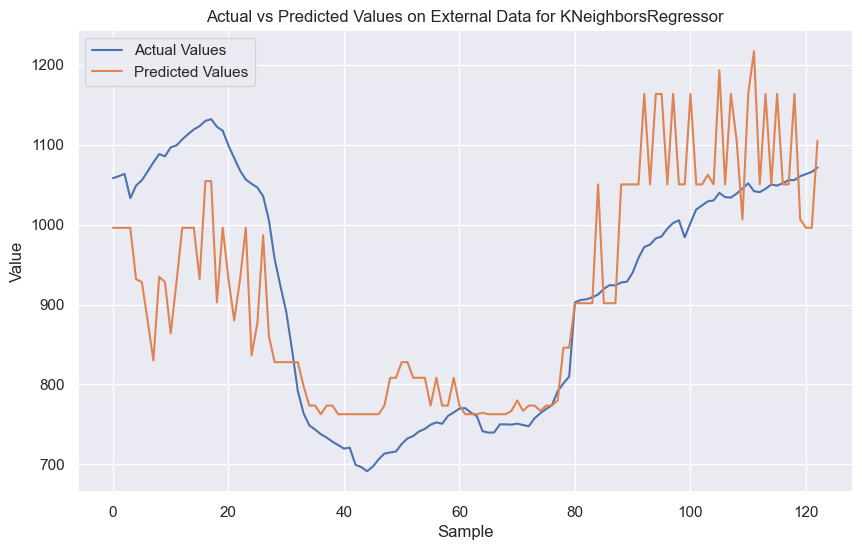

Model: KNeighborsRegressor
Train RMSE: 23.586376876025938 Train R2: 0.9769501905912557 Train MAE: 15.506551724137925
Test RMSE: 53.28085018911582 Test R2: 0.7647811060457131 Test MAE: 48.75812500000001
External RMSE: 95.8991710925164 External R2: 0.5736585311751224 External MAE: 73.78418143782797
--------------------------------------------------
Original Dataset - RMSE: 32.401197018678864, R2: 0.9513312737340599, MAE: 22.69608108108108
External Dataset - RMSE: 95.8991710925164, R2: 0.5736585311751224, MAE: 73.78418143782797


e:\anaconda\envs\yuanxuexi2\lib\site-packages\skopt\optimizer\optimizer.py:449: UserWarning: The objective has been evaluated at this point before.
  warnings.warn("The objective has been evaluated "
e:\anaconda\envs\yuanxuexi2\lib\site-packages\skopt\optimizer\optimizer.py:449: UserWarning: The objective has been evaluated at this point before.
  warnings.warn("The objective has been evaluated "


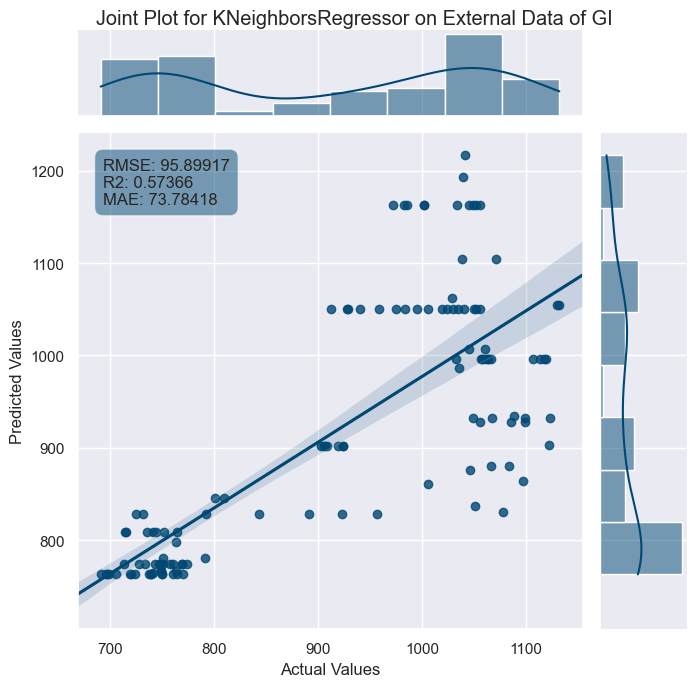

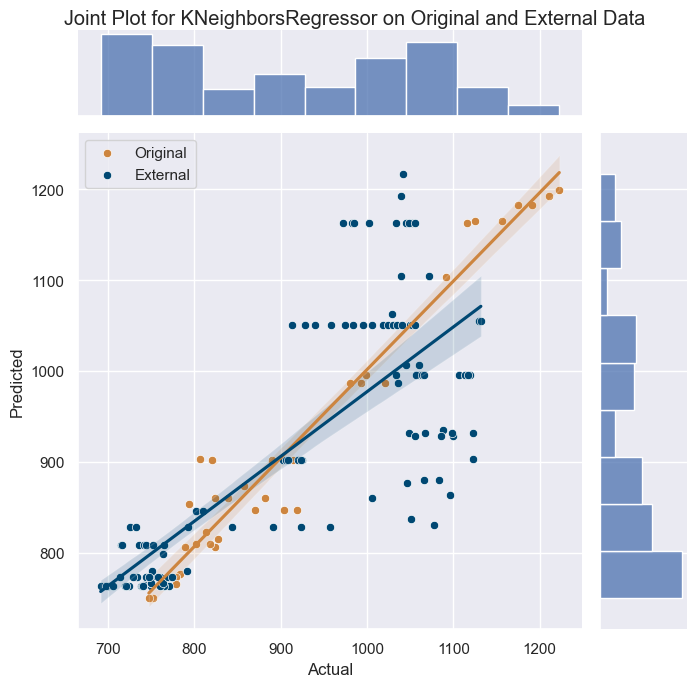

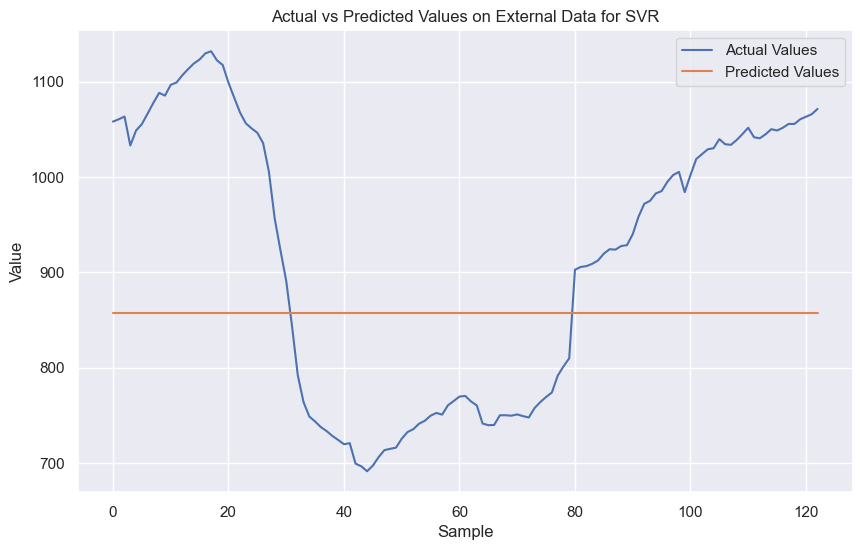

Model: SVR
Train RMSE: 167.08751086241693 Train R2: -0.15673226594584855 Train MAE: 124.03620689652871
Test RMSE: 118.82347705733933 Test R2: -0.16986143538764376 Test MAE: 89.68749999999535
External RMSE: 157.90700324230696 External R2: -0.1559276534340832 External MAE: 145.84125548241437
--------------------------------------------------
Original Dataset - RMSE: 157.9070032423052, R2: -0.155927653434057, MAE: 116.60945945944042
External Dataset - RMSE: 157.90700324230696, R2: -0.1559276534340832, MAE: 145.84125548241437


e:\anaconda\envs\yuanxuexi2\lib\site-packages\skopt\optimizer\optimizer.py:449: UserWarning: The objective has been evaluated at this point before.
  warnings.warn("The objective has been evaluated "


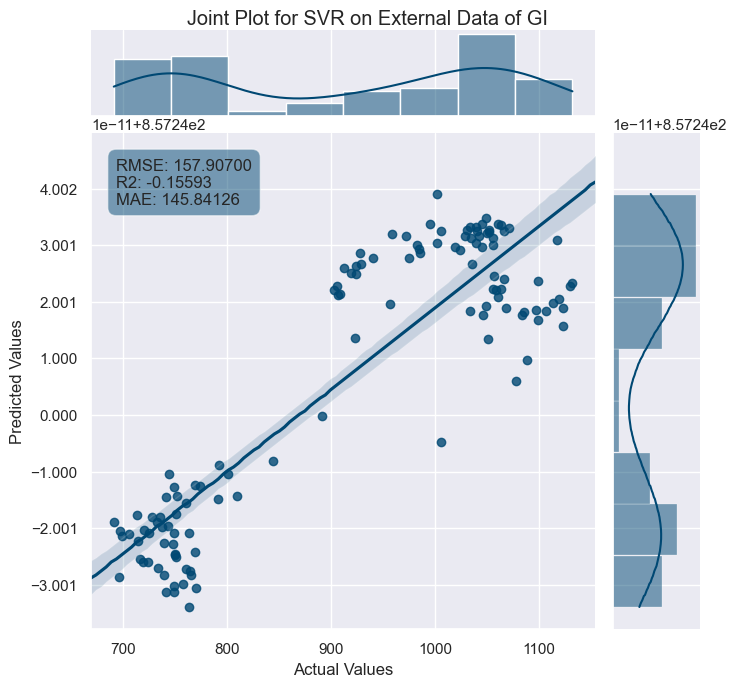

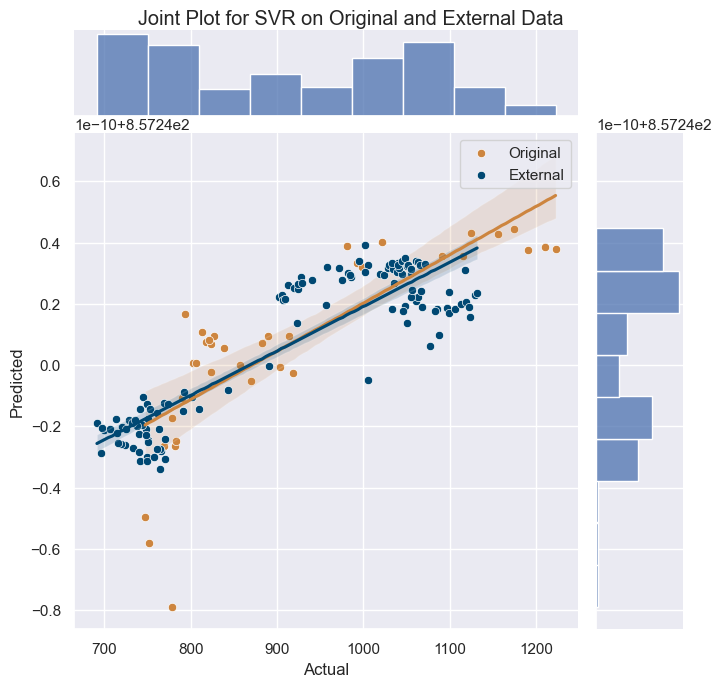

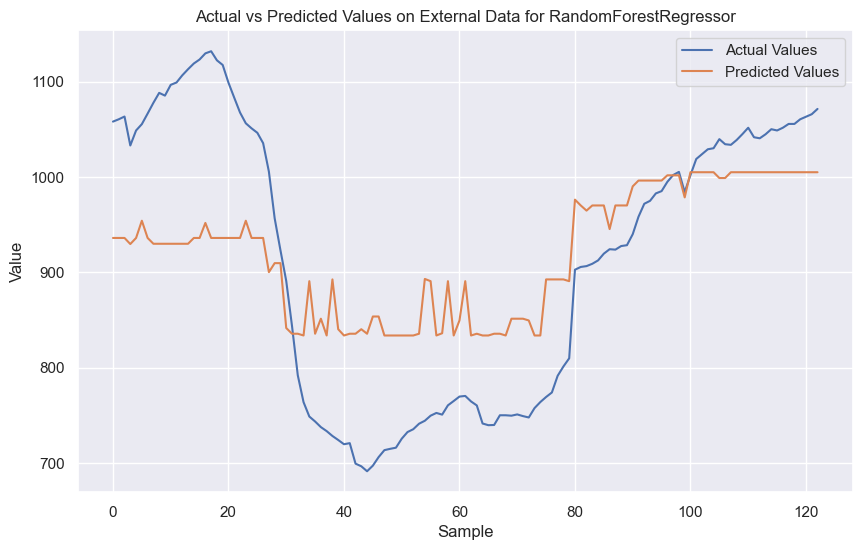

Model: RandomForestRegressor
Train RMSE: 96.65126732999637 Train R2: 0.6129563225064218 Train MAE: 75.9025639141791
Test RMSE: 80.04273790929318 Test R2: 0.46914760355303464 Test MAE: 70.42798240044365
External RMSE: 101.51829082961603 External R2: 0.5222326524806763 External MAE: 88.21675549063579
--------------------------------------------------
Original Dataset - RMSE: 93.31105724497351, R2: 0.5963600992607153, MAE: 74.71887061391199
External Dataset - RMSE: 101.51829082961603, R2: 0.5222326524806763, MAE: 88.21675549063579


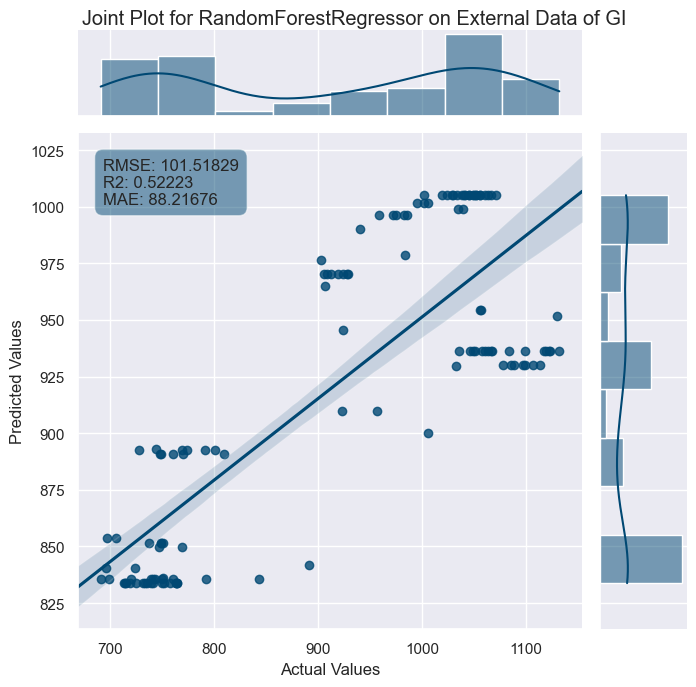

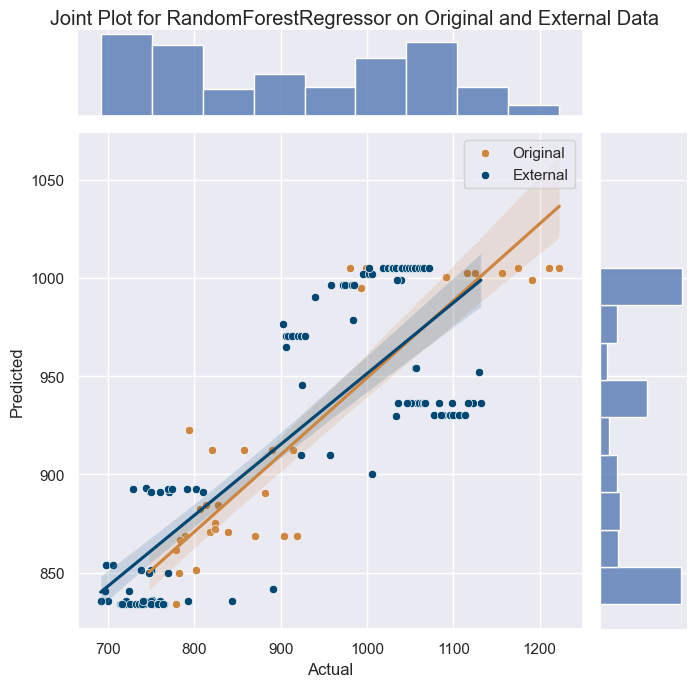

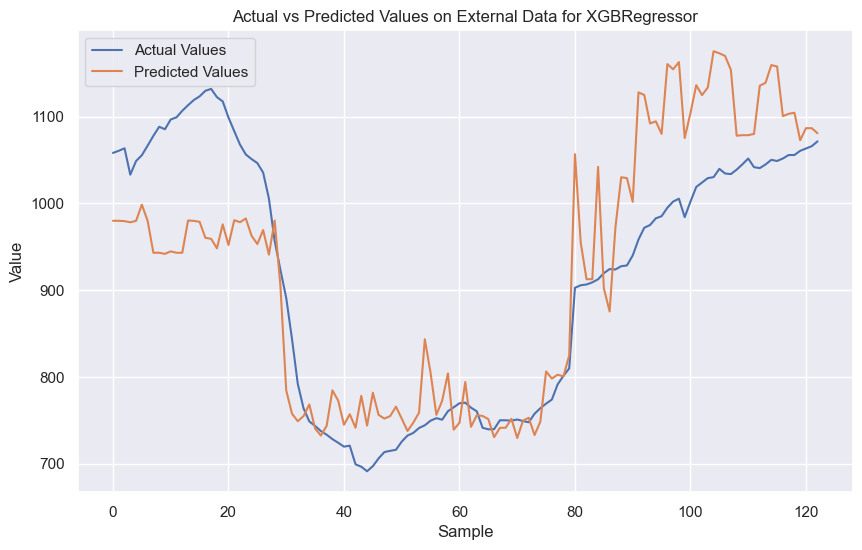

Model: XGBRegressor
Train RMSE: 4.95813308755947 Train R2: 0.998981452630572 Train MAE: 3.9709876751077533
Test RMSE: 57.990917359771586 Test R2: 0.7213558889039455 Test MAE: 47.967325134277345
External RMSE: 85.69281895287642 External R2: 0.6595786970355229 External MAE: 68.08892354566412
--------------------------------------------------
Original Dataset - RMSE: 27.320164514921284, R2: 0.9653985346845251, MAE: 13.483709287901178
External Dataset - RMSE: 85.69281895287642, R2: 0.6595786970355229, MAE: 68.08892354566412
[LightGBM] [Warning] There are no meaningful features which satisfy the provided configuration. Decreasing Dataset parameters min_data_in_bin or min_data_in_leaf and re-constructing Dataset might resolve this warning.
[LightGBM] [Info] Total Bins 0
[LightGBM] [Info] Number of data points in the train set: 29, number of used features: 0
[LightGBM] [Info] Start training from score 0.023889
[LightGBM] [Warning] Stopped training because there are no more leaves that meet th

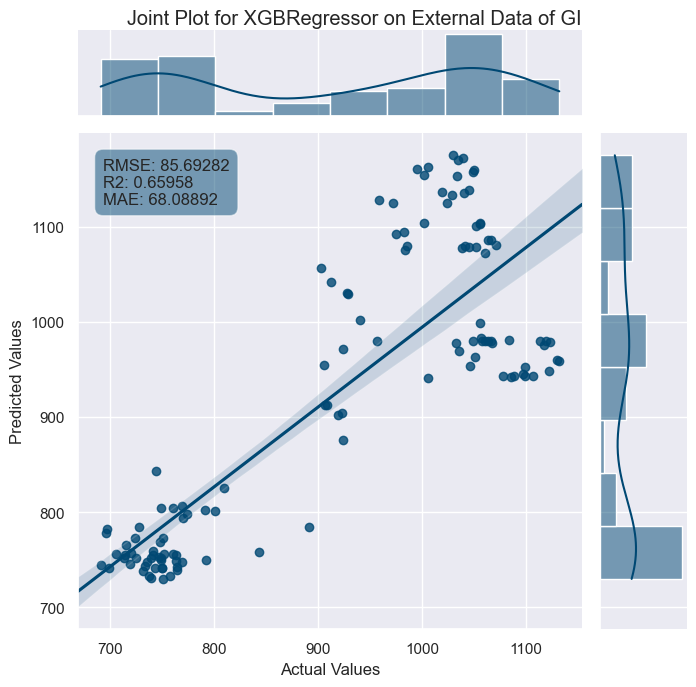

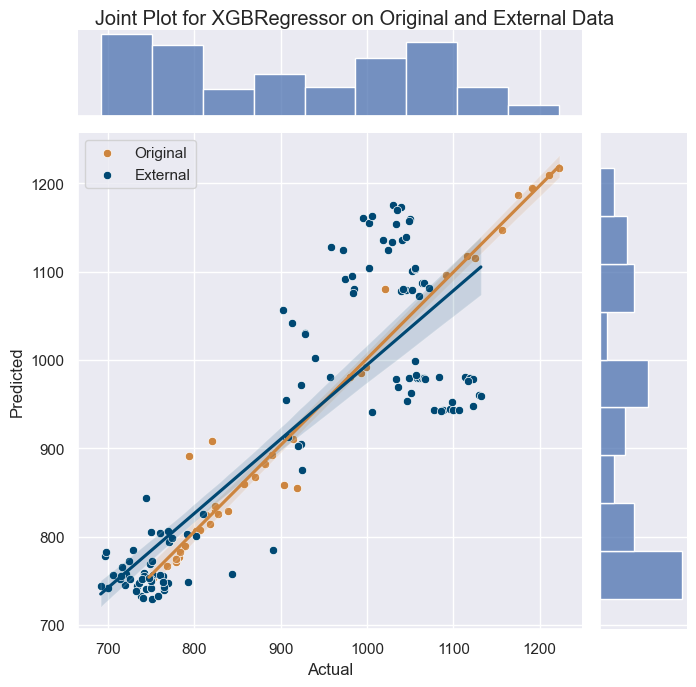

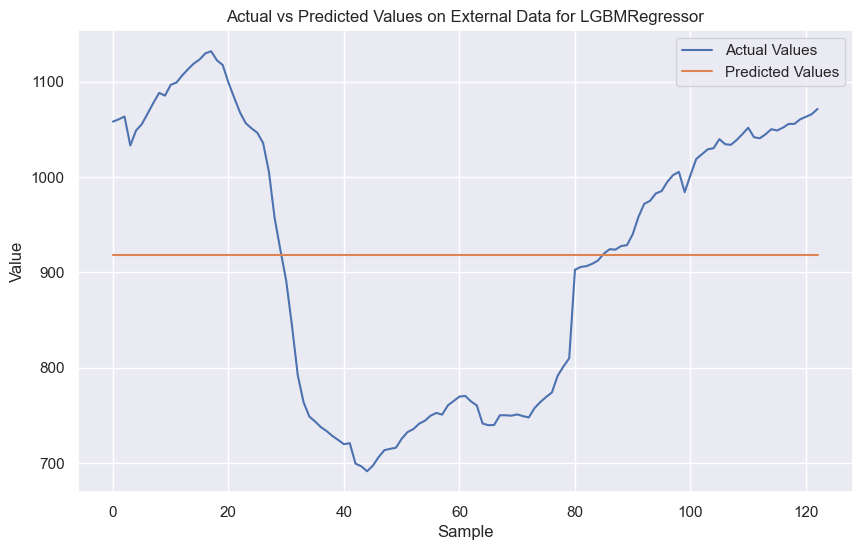

Model: LGBMRegressor
Train RMSE: 155.3558331276989 Train R2: 0.0 Train MAE: 134.35070120874613
Test RMSE: 111.05080651644887 Test R2: -0.021817520992921002 Test MAE: 93.43112041815665
External RMSE: 146.91290532064664 External R2: -0.0005706629496162741 External MAE: 134.7187559363531
--------------------------------------------------
Original Dataset - RMSE: 146.91290532064664, R2: -0.000570662949616052, MAE: 125.50322428105115
External Dataset - RMSE: 146.91290532064664, R2: -0.0005706629496162741, MAE: 134.7187559363531


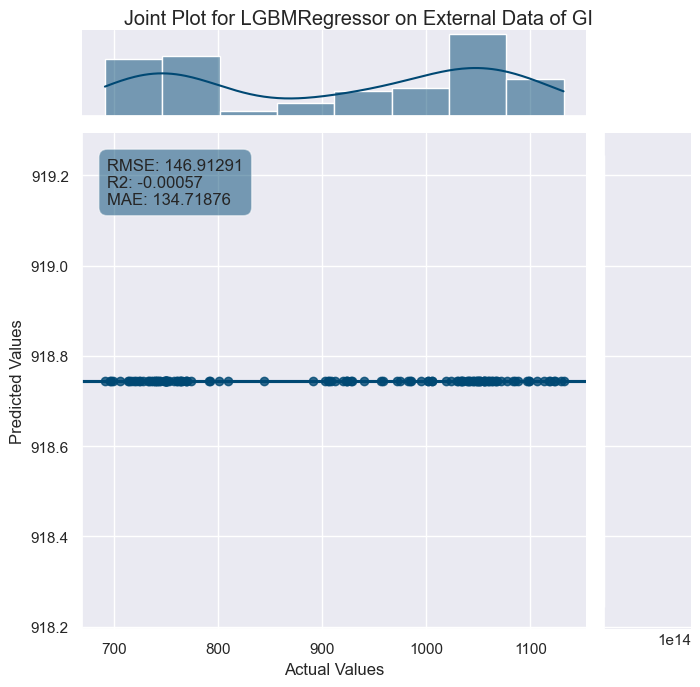

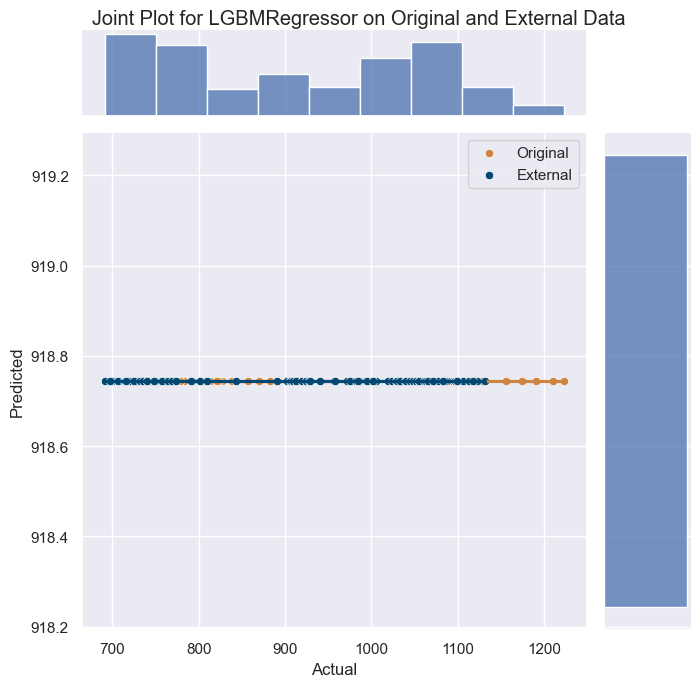

In [13]:
import pandas as pd
import numpy as np
import seaborn as sns
from sklearn.neighbors import KNeighborsRegressor
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from sklearn.preprocessing import StandardScaler
from skopt import BayesSearchCV
from skopt.space import Integer
import matplotlib.pyplot as plt
# Load datasets
data = pd.read_csv("C:\\Users\\Lenovo\\Desktop\\元学习\\BT(3)3-1.csv")
external_data = pd.read_csv("C:\\Users\\Lenovo\\Desktop\\元学习\\BT(3)3-2.csv")

# Normalization function
def normalize_data(data):
    scaler = StandardScaler()
    return scaler.fit_transform(data), scaler

# Normalize datasets
data_normalized, scaler = normalize_data(data)
external_data_normalized, _ = normalize_data(external_data)

# Split the dataset into features and target
X = data_normalized[:, :-1]
y = data_normalized[:, -1]
X_external = external_data_normalized[:, :-1]
y_external = external_data_normalized[:, -1]

# Fit a scaler for the features
feature_scaler = StandardScaler()
X_normalized = feature_scaler.fit_transform(data.drop('Biogas Production', axis=1))

# Fit a separate scaler for the target
target_scaler = StandardScaler()
y_normalized = target_scaler.fit_transform(data[['Biogas Production']])


# Split into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

# Define the hyperparameter space
param_grid = {'n_neighbors': Integer(1, 20)}

# Bayesian optimization
knn_search = BayesSearchCV(KNeighborsRegressor(), param_grid, n_iter=32, cv=5, n_jobs=-1, random_state=0)
knn_search.fit(X_train, y_train)

# Best model
knn_best = knn_search.best_estimator_

# Function to evaluate the model
def evaluate_model(model, X_train, y_train, X_test, y_test, X_external, y_external, target_scaler):
    y_pred_train = model.predict(X_train)
    y_pred_test = model.predict(X_test)
    y_pred_external = model.predict(X_external)

    # Denormalize target values and predictions
    y_train_denorm = target_scaler.inverse_transform(y_train.reshape(-1, 1)).flatten()
    y_test_denorm = target_scaler.inverse_transform(y_test.reshape(-1, 1)).flatten()
    y_external_denorm = target_scaler.inverse_transform(y_external.reshape(-1, 1)).flatten()
    y_pred_train_denorm = target_scaler.inverse_transform(y_pred_train.reshape(-1, 1)).flatten()
    y_pred_test_denorm = target_scaler.inverse_transform(y_pred_test.reshape(-1, 1)).flatten()
    y_pred_external_denorm = target_scaler.inverse_transform(y_pred_external.reshape(-1, 1)).flatten()

    # Visualization of predictions on external data
    plt.figure(figsize=(10, 6))
    plt.plot(y_external_denorm, label='Actual Values')
    plt.plot(y_pred_external_denorm, label='Predicted Values')
    plt.xlabel('Sample')
    plt.ylabel('Value')
    plt.title(f'Actual vs Predicted Values on External Data for {model.__class__.__name__}')
    plt.legend()
    plt.show()

    # Metrics for train and test sets
    train_rmse = mean_squared_error(y_train_denorm, y_pred_train_denorm, squared=False)
    test_rmse = mean_squared_error(y_test_denorm, y_pred_test_denorm, squared=False)
    train_r2 = r2_score(y_train_denorm, y_pred_train_denorm)
    test_r2 = r2_score(y_test_denorm, y_pred_test_denorm)
    train_mae = mean_absolute_error(y_train_denorm, y_pred_train_denorm)
    test_mae = mean_absolute_error(y_test_denorm, y_pred_test_denorm)

    # Metrics for external set
    external_rmse = mean_squared_error(y_external_denorm, y_pred_external_denorm, squared=False)
    external_r2 = r2_score(y_external_denorm, y_pred_external_denorm)
    external_mae = mean_absolute_error(y_external_denorm, y_pred_external_denorm)

    # Text for metrics
    metrics_text = f"RMSE: {external_rmse:.5f}\nR2: {external_r2:.5f}\nMAE: {external_mae:.5f}"

    # Create DataFrame for seaborn joint plot
    external_pred_df = pd.DataFrame({
        'Actual Values': y_external_denorm, 
        'Predicted Values': y_pred_external_denorm
    })

    # Set seaborn theme
    sns.set_theme(style="darkgrid")

    # Create the jointplot for external data with specified color
    g_external = sns.jointplot(x='Actual Values', y='Predicted Values', data=external_pred_df,
                               kind="reg", truncate=False,
                               color="#004873", height=7) 
    
    # Set title for the plot
    g_external.fig.suptitle(f"Joint Plot for {model.__class__.__name__} on External Data of GI")

    # Add metrics as text annotations
    plt.annotate(metrics_text, xy=(0.05, 0.95), xycoords='axes fraction', 
                 ha='left', va='top', bbox=dict(boxstyle='round,pad=0.5', fc="#004873", alpha=0.5))

    # Adjust layout
    g_external.fig.subplots_adjust(top=0.95)

    # Print metrics
    print(f"Model: {model.__class__.__name__}")
    print("Train RMSE:", train_rmse, "Train R2:", train_r2, "Train MAE:", train_mae)
    print("Test RMSE:", test_rmse, "Test R2:", test_r2, "Test MAE:", test_mae)
    print("External RMSE:", external_rmse, "External R2:", external_r2, "External MAE:", external_mae)
    print("--------------------------------------------------")

    # 评估模型并获取训练集和测试集的预测值
    y_pred_train_denorm = target_scaler.inverse_transform(model.predict(X_train).reshape(-1, 1)).flatten()
    y_pred_test_denorm = target_scaler.inverse_transform(model.predict(X_test).reshape(-1, 1)).flatten()

    # 合并训练集和测试集的数据
    original_data_actual = np.concatenate([y_train_denorm, y_test_denorm])
    original_data_predicted = np.concatenate([y_pred_train_denorm, y_pred_test_denorm])

    # 创建包含原始数据集和外部数据集的 DataFrame
    combined_df = pd.DataFrame({
        'Actual': np.concatenate([original_data_actual, y_external_denorm]),
        'Predicted': np.concatenate([original_data_predicted, y_pred_external_denorm]),
        'Dataset': ['Original'] * len(original_data_actual) + ['External'] * len(y_external_denorm)
    })

    # 创建基础 jointplot
    g_combined = sns.jointplot(x='Actual', y='Predicted', data=combined_df, kind="scatter", height=7)

    # 定义两个数据集的颜色
    colors = ['#CD853F', '#004873']

    # 为两个数据集添加不同颜色的散点图和线性回归线
    for dataset, color in zip(['Original', 'External'], colors):
        subset = combined_df[combined_df['Dataset'] == dataset]
        sns.scatterplot(x=subset['Actual'], y=subset['Predicted'], color=color, ax=g_combined.ax_joint, label=dataset)
        sns.regplot(x=subset['Actual'], y=subset['Predicted'], scatter=False, color=color, ax=g_combined.ax_joint)

    # 设置标题和布局
    g_combined.fig.suptitle(f"Joint Plot for {model.__class__.__name__} on Original and External Data")
    g_combined.fig.subplots_adjust(top=0.95)
    # 计算原始数据集的指标
    train_rmse = mean_squared_error(original_data_actual, original_data_predicted, squared=False)
    train_r2 = r2_score(original_data_actual, original_data_predicted)
    train_mae = mean_absolute_error(original_data_actual, original_data_predicted)

    # 计算外部数据集的指标
    external_rmse = mean_squared_error(y_external_denorm, y_pred_external_denorm, squared=False)
    external_r2 = r2_score(y_external_denorm, y_pred_external_denorm)
    external_mae = mean_absolute_error(y_external_denorm, y_pred_external_denorm)


    print(f"Original Dataset - RMSE: {train_rmse}, R2: {train_r2}, MAE: {train_mae}")
    print(f"External Dataset - RMSE: {external_rmse}, R2: {external_r2}, MAE: {external_mae}")

# Evaluate KNN model
evaluate_model(knn_best, X_train, y_train, X_test, y_test, X_external, y_external, target_scaler)

from sklearn.svm import SVR
from skopt.space import Real

# Define the hyperparameter space for SVM
param_grid_svm = {
    'C': Real(1e-15, 1e+1, prior='log-uniform'),
    'gamma': Real(1e-15, 1e+1, prior='log-uniform'),
    'epsilon': Real(1e-15, 1e+1, prior='log-uniform')
}


# Bayesian optimization
svm_search = BayesSearchCV(SVR(), param_grid_svm, n_iter=32, cv=5, n_jobs=-1, random_state=0)
svm_search.fit(X_train, y_train)

# Best model
svm_best = svm_search.best_estimator_

# Evaluate SVM model
evaluate_model(svm_best, X_train, y_train, X_test, y_test, X_external, y_external, target_scaler)

from sklearn.ensemble import RandomForestRegressor
from skopt.space import Integer, Real

# Define the hyperparameter space for Random Forest
param_grid_rf = {
    'n_estimators': Integer(10, 100),
    'max_depth': Integer(10, 30),
    'min_samples_split': Real(0.3, 0.8),
    'min_samples_leaf': Real(0.3, 0.8)
}

# Bayesian optimization
rf_search = BayesSearchCV(RandomForestRegressor(random_state=0), param_grid_rf, n_iter=32, cv=5, n_jobs=-1, random_state=0)
rf_search.fit(X_train, y_train)

# Best model
rf_best = rf_search.best_estimator_

# Evaluate Random Forest model
evaluate_model(rf_best, X_train, y_train, X_test, y_test, X_external, y_external, target_scaler)


import xgboost as xgb

# Define the hyperparameter space for XGBoost
param_grid_xgb = {
    'n_estimators': Integer(10, 100),
    'max_depth': Integer(10, 30),
    'learning_rate': Real(0.3, 0.8, 'log-uniform'),
    'subsample': Real(0.3, 0.8),
    'colsample_bytree': Real(0.3, 0.8)
}

# Bayesian optimization
xgb_search = BayesSearchCV(xgb.XGBRegressor(), param_grid_xgb, n_iter=32, cv=5, n_jobs=-1, random_state=0)
xgb_search.fit(X_train, y_train)

# Best model
xgb_best = xgb_search.best_estimator_

# Evaluate XGBoost model
evaluate_model(xgb_best, X_train, y_train, X_test, y_test, X_external, y_external, target_scaler)


import lightgbm as lgb

# Define the hyperparameter space for LightGBM
param_grid_lgb = {
    'n_estimators': Integer(10, 300),
    'max_depth': Integer(-1, 50),
    'learning_rate': Real(0.01, 1.0, 'log-uniform'),
    'num_leaves': Integer(20, 300),
    'subsample': Real(0.1, 1.0),
    'colsample_bytree': Real(0.1, 1.0)
}

# Bayesian optimization
lgb_search = BayesSearchCV(lgb.LGBMRegressor(), param_grid_lgb, n_iter=32, cv=5, n_jobs=-1, random_state=0)
lgb_search.fit(X_train, y_train)

# Best model
lgb_best = lgb_search.best_estimator_

# Evaluate LightGBM model
evaluate_model(lgb_best, X_train, y_train, X_test, y_test, X_external, y_external, target_scaler)

In [14]:
# 创建包含模型名称和其最优超参数的字典
model_hyperparams = {
    'KNN': knn_search.best_params_,
    'SVM': svm_search.best_params_,
    'RandomForest': rf_search.best_params_,
    'XGBoost': xgb_search.best_params_,
    'LightGBM': lgb_search.best_params_
}

# 转换为DataFrame
hyperparams_df = pd.DataFrame.from_dict(model_hyperparams, orient='index')

# 重置索引，使模型名称成为一列
hyperparams_df.reset_index(inplace=True)
hyperparams_df.rename(columns={'index': 'Model'}, inplace=True)

# 指定文件路径和名称，这里替换为你的目标路径
file_path = "C:\\Users\\Lenovo\\Desktop\\元学习\\传统模型超参数\\hyperparams_BT_3_3.csv"

# 保存为CSV文件
hyperparams_df.to_csv(file_path, index=False)

e:\anaconda\envs\yuanxuexi2\lib\site-packages\skopt\optimizer\optimizer.py:449: UserWarning: The objective has been evaluated at this point before.
  warnings.warn("The objective has been evaluated "
e:\anaconda\envs\yuanxuexi2\lib\site-packages\skopt\optimizer\optimizer.py:449: UserWarning: The objective has been evaluated at this point before.
  warnings.warn("The objective has been evaluated "
e:\anaconda\envs\yuanxuexi2\lib\site-packages\skopt\optimizer\optimizer.py:449: UserWarning: The objective has been evaluated at this point before.
  warnings.warn("The objective has been evaluated "
e:\anaconda\envs\yuanxuexi2\lib\site-packages\skopt\optimizer\optimizer.py:449: UserWarning: The objective has been evaluated at this point before.
  warnings.warn("The objective has been evaluated "
e:\anaconda\envs\yuanxuexi2\lib\site-packages\skopt\optimizer\optimizer.py:449: UserWarning: The objective has been evaluated at this point before.
  warnings.warn("The objective has been evaluated "


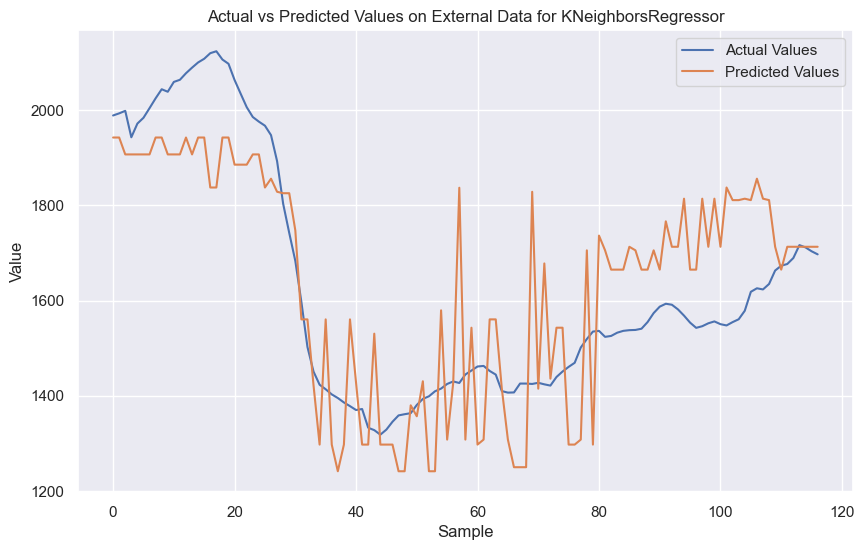

Model: KNeighborsRegressor
Train RMSE: 24.959673357591182 Train R2: 0.9897941932204526 Train MAE: 18.470588235294116
Test RMSE: 61.49673884759167 Test R2: 0.9328887569841819 Test MAE: 51.13333333333334
External RMSE: 150.6383904329776 External R2: 0.6256207257994733 External MAE: 127.36590205885147
--------------------------------------------------
Original Dataset - RMSE: 35.83493812883838, R2: 0.9788137651215014, MAE: 25.30697674418605
External Dataset - RMSE: 150.6383904329776, R2: 0.6256207257994733, MAE: 127.36590205885147


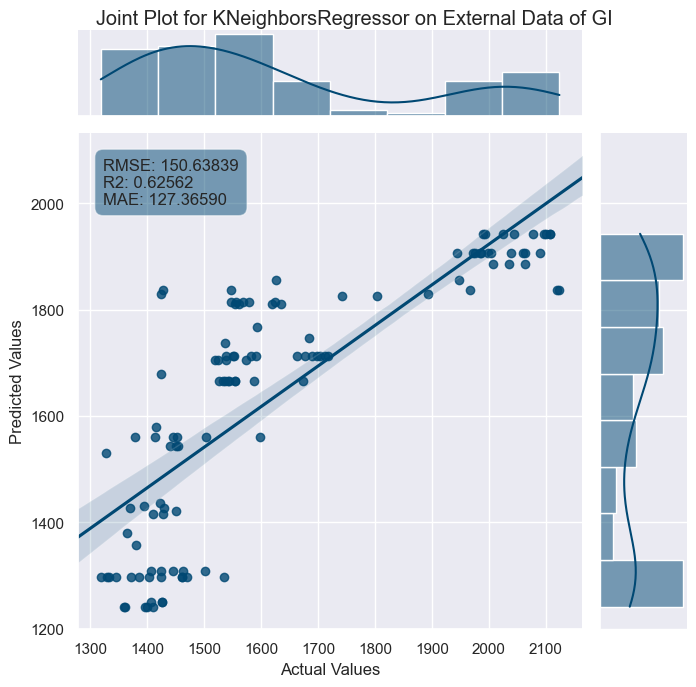

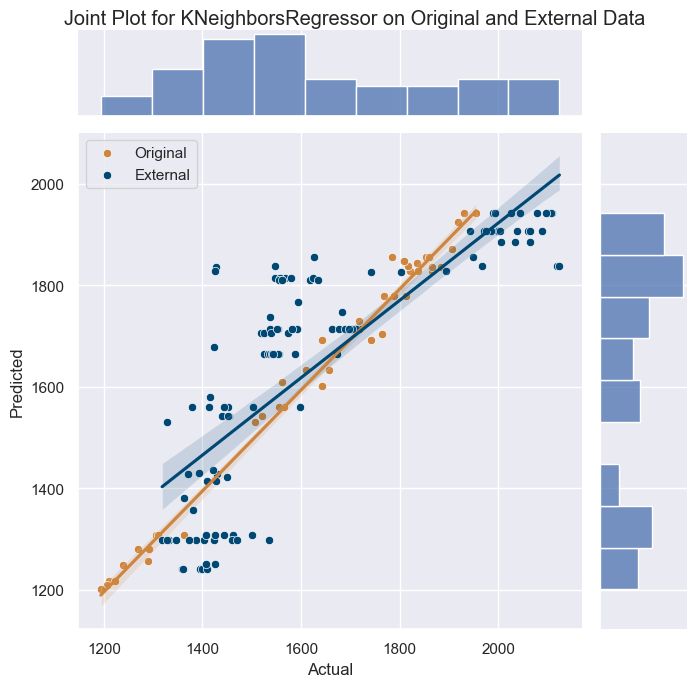

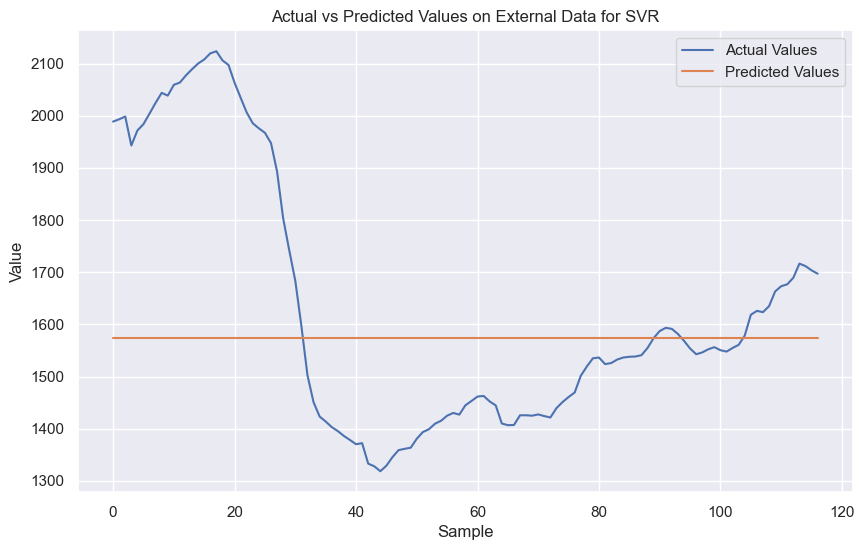

Model: SVR
Train RMSE: 250.5675029396505 Train R2: -0.028534909771196437 Train MAE: 220.26470588235293
Test RMSE: 257.3821283617027 Test R2: -0.1755683546587019 Test MAE: 250.31111111111113
External RMSE: 252.00906868141553 External R2: -0.047786512018375804 External MAE: 193.18741384027487
--------------------------------------------------
Original Dataset - RMSE: 252.00906868141556, R2: -0.047786512018375804, MAE: 226.553488372093
External Dataset - RMSE: 252.00906868141553, R2: -0.047786512018375804, MAE: 193.18741384027487


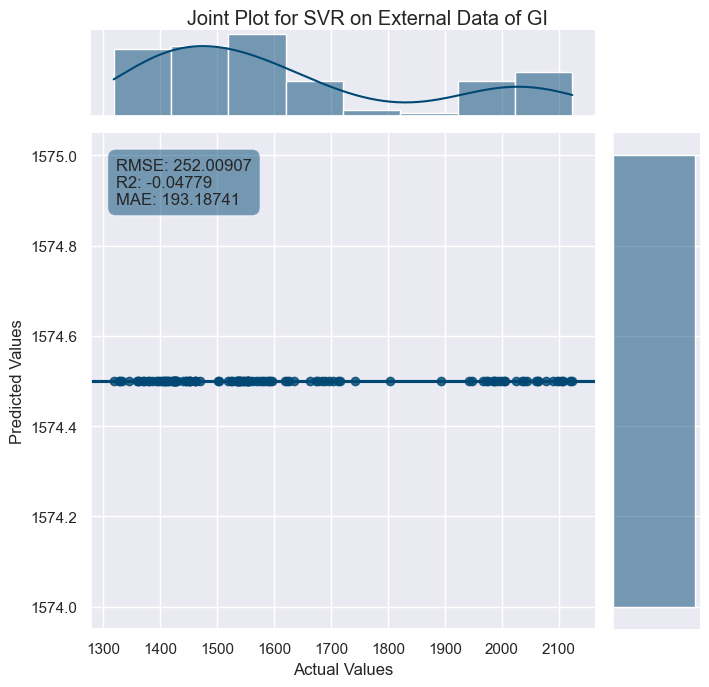

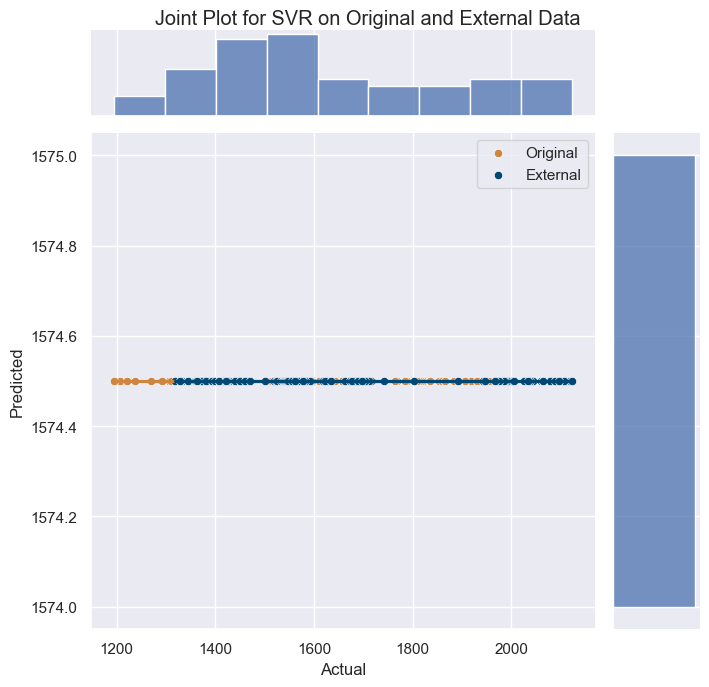

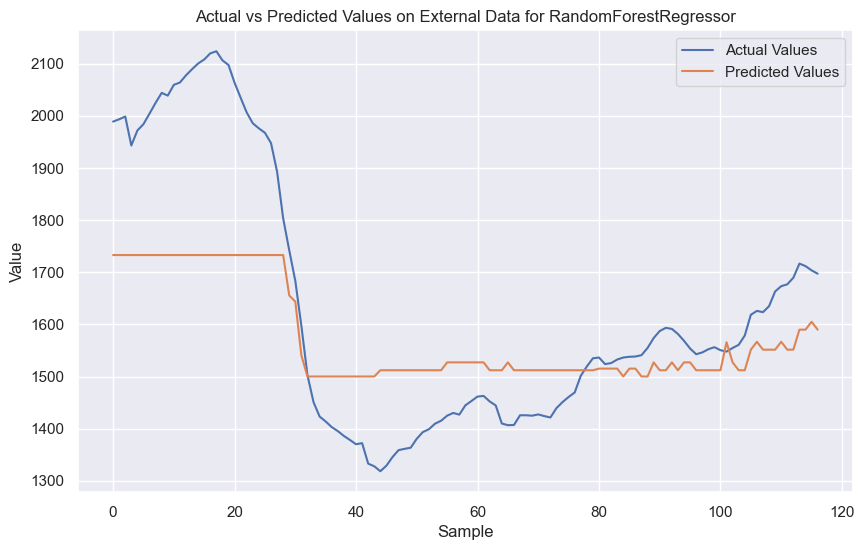

Model: RandomForestRegressor
Train RMSE: 155.12274510263634 Train R2: 0.6057964691461706 Train MAE: 123.2350711759745
Test RMSE: 134.84310503542787 Test R2: 0.6773374215942258 Test MAE: 119.88689030267973
External RMSE: 167.6937496787334 External R2: 0.5360467553048578 External MAE: 131.5073732341163
--------------------------------------------------
Original Dataset - RMSE: 151.10355392819216, R2: 0.6233050285787011, MAE: 122.53428913272673
External Dataset - RMSE: 167.6937496787334, R2: 0.5360467553048578, MAE: 131.5073732341163


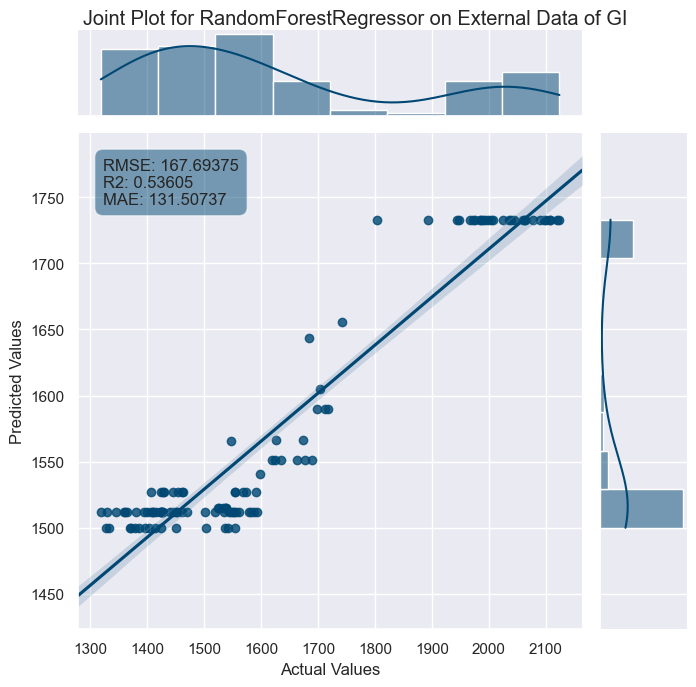

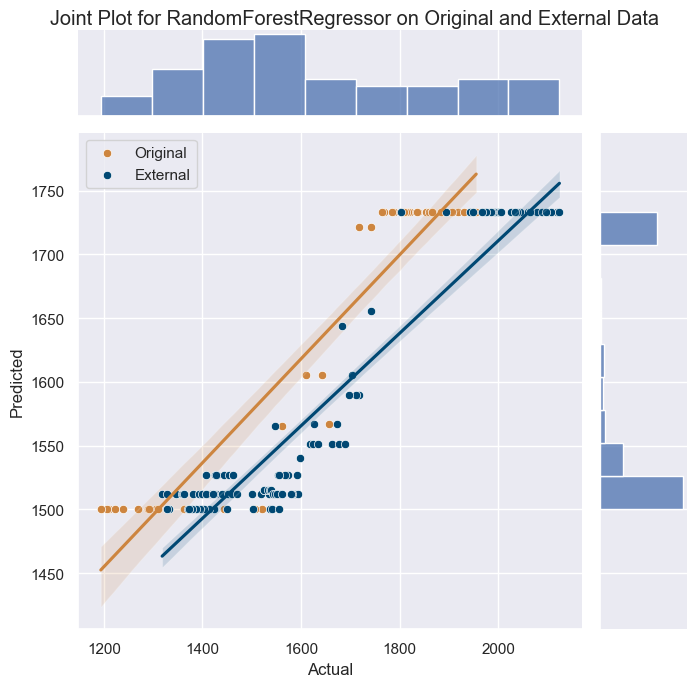

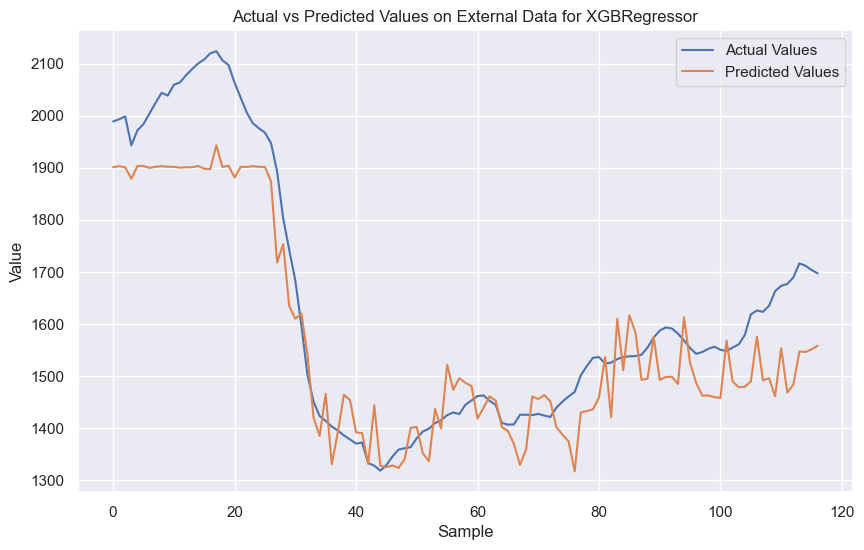

Model: XGBRegressor
Train RMSE: 0.12617715363583729 Train R2: 0.9999997391859403 Train MAE: 0.09493480009191177
Test RMSE: 48.03367481174006 Test R2: 0.9590567099387367 Test MAE: 42.39349500868055
External RMSE: 100.42203188109511 External R2: 0.833621013843584 External MAE: 82.64138589136
--------------------------------------------------
Original Dataset - RMSE: 21.975486631751973, R2: 0.9920325844888715, MAE: 8.948121820494185
External Dataset - RMSE: 100.42203188109511, R2: 0.833621013843584, MAE: 82.64138589136
[LightGBM] [Warning] There are no meaningful features which satisfy the provided configuration. Decreasing Dataset parameters min_data_in_bin or min_data_in_leaf and re-constructing Dataset might resolve this warning.
[LightGBM] [Info] Total Bins 0
[LightGBM] [Info] Number of data points in the train set: 34, number of used features: 0
[LightGBM] [Info] Start training from score -0.049080
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the s

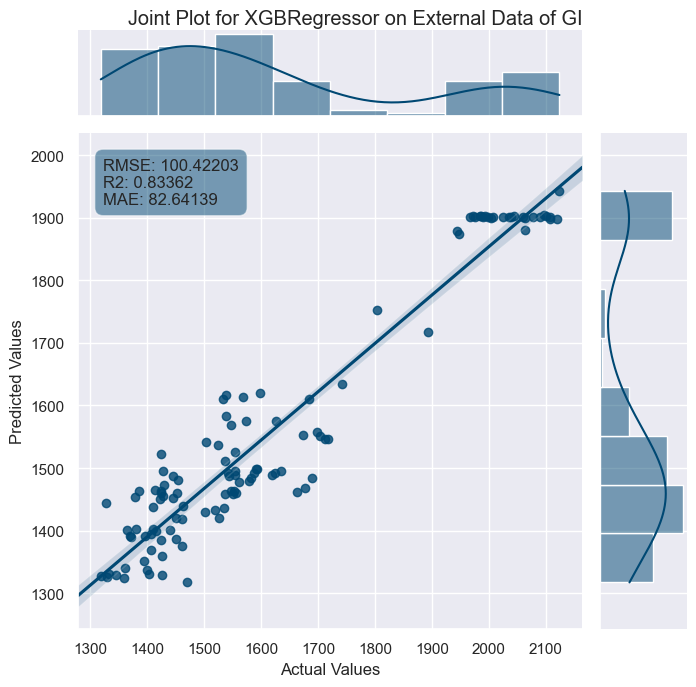

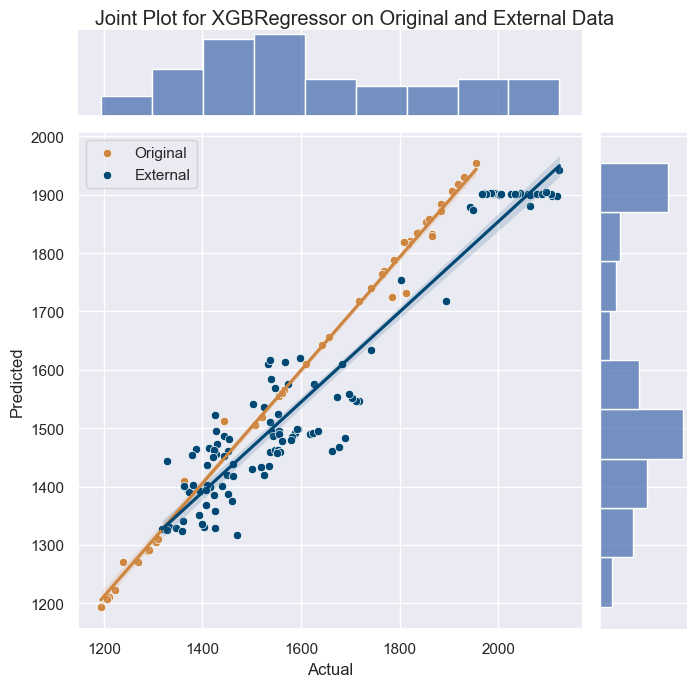

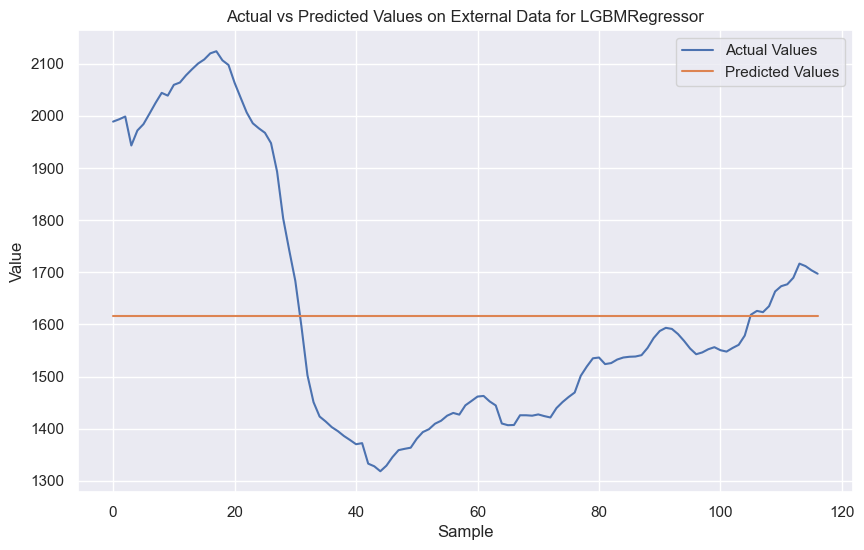

Model: LGBMRegressor
Train RMSE: 247.06727576578257 Train R2: 1.1102230246251565e-16 Train MAE: 213.26643603706708
Test RMSE: 244.3048375464118 Test R2: -0.05914457062035594 Test MAE: 236.39934654946785
External RMSE: 246.49165278966942 External R2: -0.0024088644887003685 External MAE: 202.8457667695911
--------------------------------------------------
Original Dataset - RMSE: 246.49165278966942, R2: -0.0024088644887001465, MAE: 218.1082080047789
External Dataset - RMSE: 246.49165278966942, R2: -0.0024088644887003685, MAE: 202.8457667695911


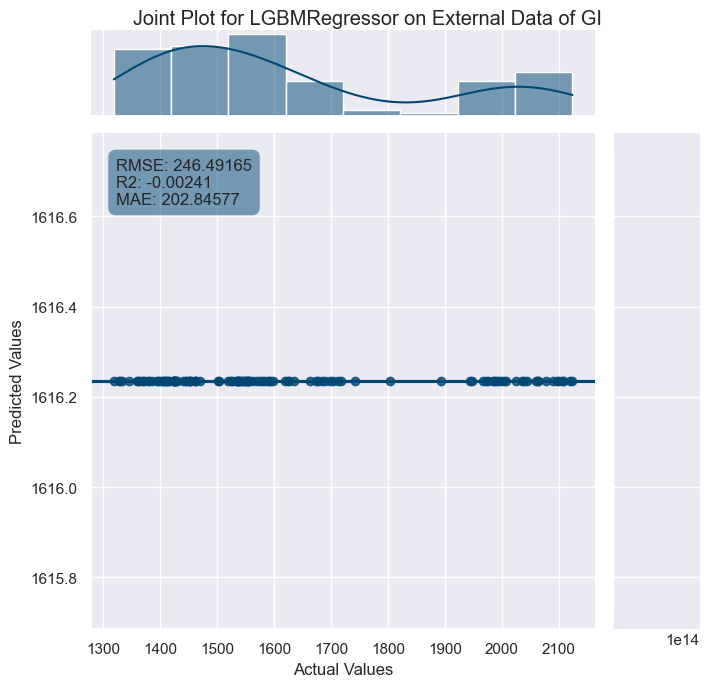

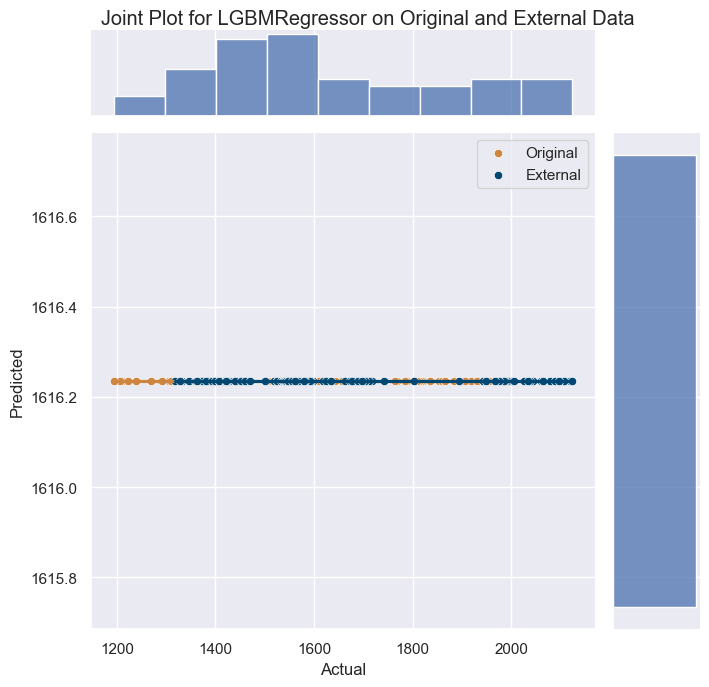

In [15]:
import pandas as pd
import numpy as np
import seaborn as sns
from sklearn.neighbors import KNeighborsRegressor
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from sklearn.preprocessing import StandardScaler
from skopt import BayesSearchCV
from skopt.space import Integer
import matplotlib.pyplot as plt
# Load datasets
data = pd.read_csv("C:\\Users\\Lenovo\\Desktop\\元学习\\BT(3)4-1.csv")
external_data = pd.read_csv("C:\\Users\\Lenovo\\Desktop\\元学习\\BT(3)4-2.csv")

# Normalization function
def normalize_data(data):
    scaler = StandardScaler()
    return scaler.fit_transform(data), scaler

# Normalize datasets
data_normalized, scaler = normalize_data(data)
external_data_normalized, _ = normalize_data(external_data)

# Split the dataset into features and target
X = data_normalized[:, :-1]
y = data_normalized[:, -1]
X_external = external_data_normalized[:, :-1]
y_external = external_data_normalized[:, -1]

# Fit a scaler for the features
feature_scaler = StandardScaler()
X_normalized = feature_scaler.fit_transform(data.drop('Biogas Production', axis=1))

# Fit a separate scaler for the target
target_scaler = StandardScaler()
y_normalized = target_scaler.fit_transform(data[['Biogas Production']])


# Split into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

# Define the hyperparameter space
param_grid = {'n_neighbors': Integer(1, 20)}

# Bayesian optimization
knn_search = BayesSearchCV(KNeighborsRegressor(), param_grid, n_iter=32, cv=5, n_jobs=-1, random_state=0)
knn_search.fit(X_train, y_train)

# Best model
knn_best = knn_search.best_estimator_

# Function to evaluate the model
def evaluate_model(model, X_train, y_train, X_test, y_test, X_external, y_external, target_scaler):
    y_pred_train = model.predict(X_train)
    y_pred_test = model.predict(X_test)
    y_pred_external = model.predict(X_external)

    # Denormalize target values and predictions
    y_train_denorm = target_scaler.inverse_transform(y_train.reshape(-1, 1)).flatten()
    y_test_denorm = target_scaler.inverse_transform(y_test.reshape(-1, 1)).flatten()
    y_external_denorm = target_scaler.inverse_transform(y_external.reshape(-1, 1)).flatten()
    y_pred_train_denorm = target_scaler.inverse_transform(y_pred_train.reshape(-1, 1)).flatten()
    y_pred_test_denorm = target_scaler.inverse_transform(y_pred_test.reshape(-1, 1)).flatten()
    y_pred_external_denorm = target_scaler.inverse_transform(y_pred_external.reshape(-1, 1)).flatten()

    # Visualization of predictions on external data
    plt.figure(figsize=(10, 6))
    plt.plot(y_external_denorm, label='Actual Values')
    plt.plot(y_pred_external_denorm, label='Predicted Values')
    plt.xlabel('Sample')
    plt.ylabel('Value')
    plt.title(f'Actual vs Predicted Values on External Data for {model.__class__.__name__}')
    plt.legend()
    plt.show()

    # Metrics for train and test sets
    train_rmse = mean_squared_error(y_train_denorm, y_pred_train_denorm, squared=False)
    test_rmse = mean_squared_error(y_test_denorm, y_pred_test_denorm, squared=False)
    train_r2 = r2_score(y_train_denorm, y_pred_train_denorm)
    test_r2 = r2_score(y_test_denorm, y_pred_test_denorm)
    train_mae = mean_absolute_error(y_train_denorm, y_pred_train_denorm)
    test_mae = mean_absolute_error(y_test_denorm, y_pred_test_denorm)

    # Metrics for external set
    external_rmse = mean_squared_error(y_external_denorm, y_pred_external_denorm, squared=False)
    external_r2 = r2_score(y_external_denorm, y_pred_external_denorm)
    external_mae = mean_absolute_error(y_external_denorm, y_pred_external_denorm)

    # Text for metrics
    metrics_text = f"RMSE: {external_rmse:.5f}\nR2: {external_r2:.5f}\nMAE: {external_mae:.5f}"

    # Create DataFrame for seaborn joint plot
    external_pred_df = pd.DataFrame({
        'Actual Values': y_external_denorm, 
        'Predicted Values': y_pred_external_denorm
    })

    # Set seaborn theme
    sns.set_theme(style="darkgrid")

    # Create the jointplot for external data with specified color
    g_external = sns.jointplot(x='Actual Values', y='Predicted Values', data=external_pred_df,
                               kind="reg", truncate=False,
                               color="#004873", height=7) 
    
    # Set title for the plot
    g_external.fig.suptitle(f"Joint Plot for {model.__class__.__name__} on External Data of GI")

    # Add metrics as text annotations
    plt.annotate(metrics_text, xy=(0.05, 0.95), xycoords='axes fraction', 
                 ha='left', va='top', bbox=dict(boxstyle='round,pad=0.5', fc="#004873", alpha=0.5))

    # Adjust layout
    g_external.fig.subplots_adjust(top=0.95)

    # Print metrics
    print(f"Model: {model.__class__.__name__}")
    print("Train RMSE:", train_rmse, "Train R2:", train_r2, "Train MAE:", train_mae)
    print("Test RMSE:", test_rmse, "Test R2:", test_r2, "Test MAE:", test_mae)
    print("External RMSE:", external_rmse, "External R2:", external_r2, "External MAE:", external_mae)
    print("--------------------------------------------------")

    # 评估模型并获取训练集和测试集的预测值
    y_pred_train_denorm = target_scaler.inverse_transform(model.predict(X_train).reshape(-1, 1)).flatten()
    y_pred_test_denorm = target_scaler.inverse_transform(model.predict(X_test).reshape(-1, 1)).flatten()

    # 合并训练集和测试集的数据
    original_data_actual = np.concatenate([y_train_denorm, y_test_denorm])
    original_data_predicted = np.concatenate([y_pred_train_denorm, y_pred_test_denorm])

    # 创建包含原始数据集和外部数据集的 DataFrame
    combined_df = pd.DataFrame({
        'Actual': np.concatenate([original_data_actual, y_external_denorm]),
        'Predicted': np.concatenate([original_data_predicted, y_pred_external_denorm]),
        'Dataset': ['Original'] * len(original_data_actual) + ['External'] * len(y_external_denorm)
    })

    # 创建基础 jointplot
    g_combined = sns.jointplot(x='Actual', y='Predicted', data=combined_df, kind="scatter", height=7)

    # 定义两个数据集的颜色
    colors = ['#CD853F', '#004873']

    # 为两个数据集添加不同颜色的散点图和线性回归线
    for dataset, color in zip(['Original', 'External'], colors):
        subset = combined_df[combined_df['Dataset'] == dataset]
        sns.scatterplot(x=subset['Actual'], y=subset['Predicted'], color=color, ax=g_combined.ax_joint, label=dataset)
        sns.regplot(x=subset['Actual'], y=subset['Predicted'], scatter=False, color=color, ax=g_combined.ax_joint)

    # 设置标题和布局
    g_combined.fig.suptitle(f"Joint Plot for {model.__class__.__name__} on Original and External Data")
    g_combined.fig.subplots_adjust(top=0.95)
    # 计算原始数据集的指标
    train_rmse = mean_squared_error(original_data_actual, original_data_predicted, squared=False)
    train_r2 = r2_score(original_data_actual, original_data_predicted)
    train_mae = mean_absolute_error(original_data_actual, original_data_predicted)

    # 计算外部数据集的指标
    external_rmse = mean_squared_error(y_external_denorm, y_pred_external_denorm, squared=False)
    external_r2 = r2_score(y_external_denorm, y_pred_external_denorm)
    external_mae = mean_absolute_error(y_external_denorm, y_pred_external_denorm)

    print(f"Original Dataset - RMSE: {train_rmse}, R2: {train_r2}, MAE: {train_mae}")
    print(f"External Dataset - RMSE: {external_rmse}, R2: {external_r2}, MAE: {external_mae}")

# Evaluate KNN model
evaluate_model(knn_best, X_train, y_train, X_test, y_test, X_external, y_external, target_scaler)

from sklearn.svm import SVR
from skopt.space import Real

# Define the hyperparameter space for SVM
param_grid_svm = {
    'C': Real(1e-15, 1e+1, prior='log-uniform'),
    'gamma': Real(1e-15, 1e+1, prior='log-uniform'),
    'epsilon': Real(1e-15, 1e+1, prior='log-uniform')
}

# Bayesian optimization
svm_search = BayesSearchCV(SVR(), param_grid_svm, n_iter=32, cv=5, n_jobs=-1, random_state=0)
svm_search.fit(X_train, y_train)

# Best model
svm_best = svm_search.best_estimator_

# Evaluate SVM model
evaluate_model(svm_best, X_train, y_train, X_test, y_test, X_external, y_external, target_scaler)

from sklearn.ensemble import RandomForestRegressor
from skopt.space import Integer, Real

# Define the hyperparameter space for Random Forest
param_grid_rf = {
    'n_estimators': Integer(10, 100),
    'max_depth': Integer(10, 30),
    'min_samples_split': Real(0.3, 0.8),
    'min_samples_leaf': Real(0.3, 0.8)
}

# Bayesian optimization
rf_search = BayesSearchCV(RandomForestRegressor(random_state=0), param_grid_rf, n_iter=32, cv=5, n_jobs=-1, random_state=0)
rf_search.fit(X_train, y_train)

# Best model
rf_best = rf_search.best_estimator_

# Evaluate Random Forest model
evaluate_model(rf_best, X_train, y_train, X_test, y_test, X_external, y_external, target_scaler)


import xgboost as xgb

# Define the hyperparameter space for XGBoost
param_grid_xgb = {
    'n_estimators': Integer(10, 100),
    'max_depth': Integer(10, 30),
    'learning_rate': Real(0.3, 0.8, 'log-uniform'),
    'subsample': Real(0.3, 0.8),
    'colsample_bytree': Real(0.3, 0.8)
}

# Bayesian optimization
xgb_search = BayesSearchCV(xgb.XGBRegressor(), param_grid_xgb, n_iter=32, cv=5, n_jobs=-1, random_state=0)
xgb_search.fit(X_train, y_train)

# Best model
xgb_best = xgb_search.best_estimator_

# Evaluate XGBoost model
evaluate_model(xgb_best, X_train, y_train, X_test, y_test, X_external, y_external, target_scaler)


import lightgbm as lgb

# Define the hyperparameter space for LightGBM
param_grid_lgb = {
    'n_estimators': Integer(10, 300),
    'max_depth': Integer(-1, 50),
    'learning_rate': Real(0.01, 1.0, 'log-uniform'),
    'num_leaves': Integer(20, 300),
    'subsample': Real(0.1, 1.0),
    'colsample_bytree': Real(0.1, 1.0)
}

# Bayesian optimization
lgb_search = BayesSearchCV(lgb.LGBMRegressor(), param_grid_lgb, n_iter=32, cv=5, n_jobs=-1, random_state=0)
lgb_search.fit(X_train, y_train)

# Best model
lgb_best = lgb_search.best_estimator_

# Evaluate LightGBM model
evaluate_model(lgb_best, X_train, y_train, X_test, y_test, X_external, y_external, target_scaler)

In [16]:
# 创建包含模型名称和其最优超参数的字典
model_hyperparams = {
    'KNN': knn_search.best_params_,
    'SVM': svm_search.best_params_,
    'RandomForest': rf_search.best_params_,
    'XGBoost': xgb_search.best_params_,
    'LightGBM': lgb_search.best_params_
}

# 转换为DataFrame
hyperparams_df = pd.DataFrame.from_dict(model_hyperparams, orient='index')

# 重置索引，使模型名称成为一列
hyperparams_df.reset_index(inplace=True)
hyperparams_df.rename(columns={'index': 'Model'}, inplace=True)

# 指定文件路径和名称，这里替换为你的目标路径
file_path = "C:\\Users\\Lenovo\\Desktop\\元学习\\传统模型超参数\\hyperparams_BT_3_4.csv"

# 保存为CSV文件
hyperparams_df.to_csv(file_path, index=False)